# Soil Moisture Prediction with XGBoost and Optuna

## Importing Necessary Libraries

In [30]:
# Cell 1: Import libraries
import pandas as pd
from sklearn.metrics import mean_squared_error, r2_score
import xgboost as xgb
import optuna
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import os

import numpy as np
import random

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Set random seeds for reproducibility
np.random.seed(42)
random.seed(42)

## 1. Data Loading and Initial Preprocessing

In [31]:
# Cell 2: Load and preprocess data
df = pd.read_excel('data.xlsx')
df = df.rename(columns={'Vreme': 'DateTime'})
df['DateTime'] = pd.to_datetime(df['DateTime'], dayfirst=True)
df.set_index('DateTime', inplace=True)
df = df.sort_index()

# Combine 'SM1' and 'SM2' into a new 'SM1' and drop unnecessary columns
df['SM1'] = df[['SM1', 'SM2']].mean(axis=1)
df.drop(columns=['SM2', 'SM3', 'SM4', 'SM5', 'SM6'], inplace=True)

In [32]:
fig = make_subplots(rows=len(df.columns), cols=1, shared_xaxes=True, subplot_titles=df.columns)

# Define colors for each plot
colors = ['red', 'blue', 'blue', 'green', 'orange', 'gray']

# Add traces (each variable as a separate subplot)
for i, col in enumerate(df.columns):
    fig.add_trace(go.Scatter(x=df.index, y=df[col], mode='lines', name=col, 
                 line=dict(color=colors[i % len(colors)])), row=i+1, col=1)

# Update layout for better readability
fig.update_layout(
    height=300 * len(df.columns),  # Adjust height based on the number of rows
    width=1000, 
    title_text="Time Series Plots of SM1 and Features",
    showlegend=False
)

# Add range slider to the last subplot with transparent background
fig.update_xaxes(
    rangeslider=dict(
        visible=True,
        thickness=0.1,
        bgcolor='rgba(0,0,0,0)'  # This makes the background transparent
    ), 
    row=len(df.columns), 
    col=1
)

# Show the plot
fig.show()

## 2. Time Aggregation and Feature Engineering

In [33]:
# Cell 3: Aggregate data by date and create time-based features
df_daily = df.resample('D').mean().reset_index()
df_daily['DateTime'] = pd.to_datetime(df_daily['DateTime'])
df_daily = df_daily.set_index('DateTime')

# Create time-based features
df_daily['weekofyear'] = df_daily.index.isocalendar().week
df_daily['dayofyear'] = df_daily.index.dayofyear
df_daily['month'] = df_daily.index.month

In [34]:
# Cell 4: Feature engineering - lagged features, rolling stats, harmonic features
# Lagged features using 'AT1'
df_daily['AT1_prev_month'] = df_daily['AT1'].shift(30)

# Rolling statistics
df_daily['rolling_mean_AT1_30d'] = df_daily['AT1'].rolling(window=30).mean()
df_daily['rolling_std_AT1_30d'] = df_daily['AT1'].rolling(window=30).std()

# Harmonic features
df_daily['week_sin'] = np.sin(2 * np.pi * df_daily['weekofyear'] / 52)
df_daily['day_sin'] = np.sin(2 * np.pi * df_daily['dayofyear'] / 365)
df_daily['month_sin'] = np.sin(2 * np.pi * df_daily['month'] / 12)

## 3. Advanced Feature Engineering

In [35]:
# Cell 5: Feature engineering - short-term changes, extreme weather, interactions
# Short-term change features
df_daily['AT1_diff1'] = df_daily['AT1'].diff(1)
df_daily['AT1_diff2'] = df_daily['AT1'].diff(2)
df_daily['PP1_diff1'] = df_daily['PP1'].diff(1)
df_daily['PP1_diff2'] = df_daily['PP1'].diff(2)
df_daily['AH1_diff1'] = df_daily['AH1'].diff(1)
df_daily['AH1_diff2'] = df_daily['AH1'].diff(2)

# Extreme weather indicators
df_daily['AT1_hot_day'] = (df_daily['AT1'] > df_daily['AT1'].quantile(0.95)).astype(int)
df_daily['AT1_cold_day'] = (df_daily['AT1'] < df_daily['AT1'].quantile(0.05)).astype(int)
df_daily['PP1_extreme_rain'] = (df_daily['PP1'] > df_daily['PP1'].quantile(0.95)).astype(int)
df_daily['PP1_dry_day'] = (df_daily['PP1'] < 1).astype(int)  # Alternative threshold

# Interaction features
df_daily['AT1_AH1_interaction'] = df_daily['AT1'] * df_daily['AH1']
df_daily['PP1_seasonal'] = df_daily['PP1'] * df_daily['month_sin']

# Momentum-based rolling features
df_daily['ewm_AT1_30d'] = df_daily['AT1'].ewm(span=30).mean()
df_daily['ewm_PP1_30d'] = df_daily['PP1'].ewm(span=30).mean()

df_daily.dropna(inplace=True)

## 4. Time Series Decomposition and Spell Duration Features

In [36]:
# Cell 6: Seasonal decomposition and dry/wet spell features
# Normalize time
df_daily['time'] = (df_daily.index - df_daily.index[0]).days
df_daily['time_norm'] = df_daily['time'] / df_daily['time'].max()

# Perform seasonal decomposition on 'AT1'
result = seasonal_decompose(df_daily['AT1'], model='additive', period=365)
df_daily['AT1_trend'] = result.trend
df_daily['AT1_residual'] = result.resid
df_daily.dropna(inplace=True)

# Dry/Wet Spell Duration
dry_threshold = 1  # Precipitation < 1 mm is considered dry
wet_threshold = 1  # Precipitation >= 1 mm is considered wet

df_daily['Dry_Spell_Duration'] = 0
df_daily['Wet_Spell_Duration'] = 0

# Calculate dry spell duration
dry_spell = 0
for i in range(len(df_daily)):
    if df_daily['PP1'].iloc[i] < dry_threshold:
        dry_spell += 1
    else:
        dry_spell = 0
    df_daily['Dry_Spell_Duration'].iloc[i] = dry_spell

# Calculate wet spell duration
wet_spell = 0
for i in range(len(df_daily)):
    if df_daily['PP1'].iloc[i] >= wet_threshold:
        wet_spell += 1
    else:
        wet_spell = 0
    df_daily['Wet_Spell_Duration'].iloc[i] = wet_spell

/tmp/ipykernel_67567/3007326463.py:26: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/tmp/ipykernel_67567/3007326463.py:26: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the d

## 5. Final Feature Selection and Data Preparation

In [37]:
# Cell 7: Final feature selection and scaling
# Final feature selection
df_features = df_daily[['time_norm', 'AT1', 'AT1_prev_month', 'rolling_mean_AT1_30d', 'rolling_std_AT1_30d', 
                        'week_sin', 'day_sin', 'month_sin', 'AT1_trend', 'AT1_residual', 'Dry_Spell_Duration', 
                        'Wet_Spell_Duration', 'AT1_diff1', 'AT1_diff2', 'PP1_diff1', 'PP1_diff2', 'AH1_diff1', 
                        'AH1_diff2', 'AT1_hot_day', 'AT1_cold_day', 'PP1_extreme_rain', 'PP1_dry_day', 
                        'AT1_AH1_interaction', 'PP1_seasonal', 'ewm_AT1_30d', 'ewm_PP1_30d']]


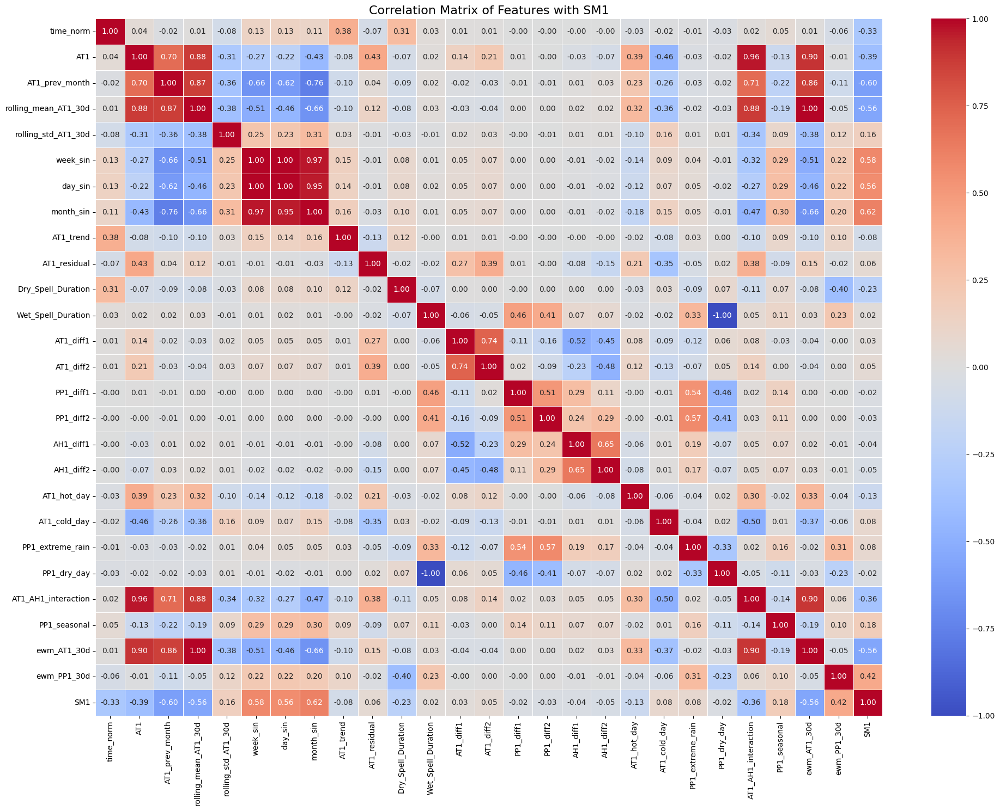

In [38]:
# Add 'SM1' to the features DataFrame
df_features_with_sm1 = df_features.copy()
df_features_with_sm1['SM1'] = df_daily['SM1']

# Calculate the correlation matrix
corr_matrix = df_features_with_sm1.corr()

# Set up the matplotlib figure
plt.figure(figsize=(20, 15))

# Draw the heatmap using seaborn
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', vmin=-1, vmax=1, linewidths=0.5)

# Add title and adjust layout
plt.title('Correlation Matrix of Features with SM1', fontsize=16)
plt.tight_layout()

# Show the plot
plt.show()

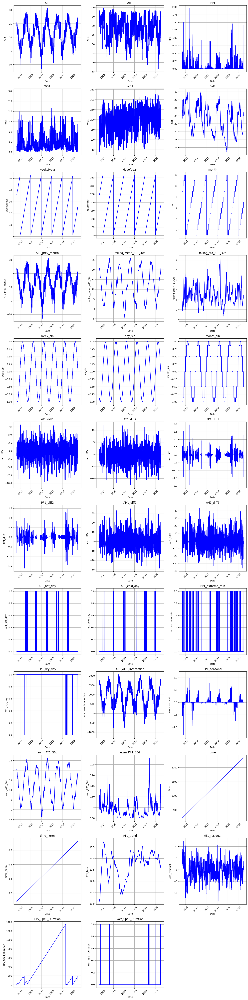

In [39]:
features=['AT1', 'AH1', 'PP1', 'WS1', 'WD1', 'SM1', 'weekofyear', 'dayofyear', 'month', 'AT1_prev_month', 'rolling_mean_AT1_30d', 'rolling_std_AT1_30d', 'week_sin', 'day_sin', 'month_sin', 'AT1_diff1', 'AT1_diff2', 'PP1_diff1', 'PP1_diff2', 'AH1_diff1', 'AH1_diff2', 'AT1_hot_day', 'AT1_cold_day', 'PP1_extreme_rain', 'PP1_dry_day', 'AT1_AH1_interaction', 'PP1_seasonal', 'ewm_AT1_30d', 'ewm_PP1_30d', 'time', 'time_norm', 'AT1_trend', 'AT1_residual', 'Dry_Spell_Duration', 'Wet_Spell_Duration']
n_features = len(features)
n_cols = 3  # Number of columns in the subplot grid
n_rows = (n_features + n_cols - 1) // n_cols  # Calculate rows needed

plt.figure(figsize=(15, 5 * n_rows))
for i, feature in enumerate(features):
    plt.subplot(n_rows, n_cols, i + 1)
    plt.plot(df_daily.index, df_daily[feature], label=feature, color='blue')
    plt.xlabel('Date')
    plt.ylabel(feature)
    plt.title(f'{feature}')
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()

plt.savefig('all_features_vs_date.png', dpi=300)
plt.show()

In [40]:
# Apply scaling
scaler = StandardScaler()
features_scaled = scaler.fit_transform(df_features)

# Split data
split_date = '2019-01-01'
train = features_scaled[df_daily.index < split_date]
test = features_scaled[df_daily.index >= split_date]
y_train = df_daily.loc[df_daily.index < split_date, 'SM1']
y_test = df_daily.loc[df_daily.index >= split_date, 'SM1']

## 6. Model Optimization with Optuna

In [41]:
# Cell 8: Define Optuna objective function
def objective(trial):
    params = {
        'objective': 'reg:squarederror',
        'max_depth': trial.suggest_int('max_depth', 2, 5),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.15),
        'n_estimators': trial.suggest_int('n_estimators', 100, 300),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 0.7),
        'subsample': trial.suggest_float('subsample', 0.5, 0.7),
        'alpha': trial.suggest_float('alpha', 0, 10),
        'lambda': trial.suggest_float('lambda', 0, 10),
    }
    dtrain = xgb.DMatrix(train, label=y_train)
    cv_results = xgb.cv(params, dtrain, num_boost_round=params['n_estimators'], nfold=5, early_stopping_rounds=25, metrics="rmse", as_pandas=True, seed=42)
    return cv_results['test-rmse-mean'].min()

## 7. Model Training and Evaluation

In [42]:
# Cell 9: Model training and optimization
# Directory to save models
model_dir = 'best_xgboost_model'
os.makedirs(model_dir, exist_ok=True)

# Track the best model
best_r2 = 0
best_model_path = None

for i in range(350):
    print(f"Iteration {i+1}/350")
    
    # Run Optuna optimization
    study = optuna.create_study(direction='minimize')
    study.optimize(objective, n_trials=7)
    
    # Train the model
    best_params = study.best_params
    dtrain = xgb.DMatrix(train, label=y_train)
    dtest = xgb.DMatrix(test, label=y_test)
    model = xgb.train(best_params, dtrain, num_boost_round=best_params['n_estimators'], early_stopping_rounds=40, evals=[(dtest, 'eval')])
    
    # Predictions
    y_train_pred = model.predict(dtrain)
    y_test_pred = model.predict(dtest)
    
    # Evaluation Metrics
    r2_train = r2_score(y_train, y_train_pred)
    r2_test = r2_score(y_test, y_test_pred)
    
    print(f'Training R2: {r2_train}')
    print(f'Testing R2: {r2_test}')
    
    # Save the model if R-squared is >= 0.8 and better than the previous best
    if r2_test >= 0.8 and r2_test > best_r2:
        # Delete the previous best model
        if best_model_path and os.path.exists(best_model_path):
            os.remove(best_model_path)
        
        # Save the new best model
        best_r2 = r2_test
        best_model_path = os.path.join(model_dir, f'best_model_r2_{r2_test:.4f}.model')
        model.save_model(best_model_path)
        print(f"New best model saved with R2: {r2_test} at {best_model_path}")

print("Process completed.")
print(f"Best R-squared: {best_r2}")

[I 2025-06-06 15:40:11,627] A new study created in memory with name: no-name-bd53aad6-72bc-4f73-a26c-88afa4cc60b6


Iteration 1/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:12,442] Trial 0 finished with value: 1.2456983685279108 and parameters: {'max_depth': 2, 'learning_rate': 0.042418402679628556, 'n_estimators': 158, 'colsample_bytree': 0.48203499847813813, 'subsample': 0.5582229204595928, 'alpha': 0.0436801697806799, 'lambda': 2.940469784040155}. Best is trial 0 with value: 1.2456983685279108.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:12,939] Trial 1 finished with value: 1.0201900157414445 and parameters: {'max_depth': 2, 'learning_rate': 0.055406181781213294, 'n_estimators': 200, 'colsample_bytree': 0.503041967909737, 'subsample': 0.6028352857113841, 'alpha': 1.6073645540692716, 'lambda': 3.8240

[0]	eval-rmse:2.91874
[1]	eval-rmse:2.96352
[2]	eval-rmse:2.84675
[3]	eval-rmse:2.77248
[4]	eval-rmse:2.65489
[5]	eval-rmse:2.56643
[6]	eval-rmse:2.43419
[7]	eval-rmse:2.40493
[8]	eval-rmse:2.32650
[9]	eval-rmse:2.24508
[10]	eval-rmse:2.19724
[11]	eval-rmse:2.14667
[12]	eval-rmse:2.12682
[13]	eval-rmse:2.12341
[14]	eval-rmse:2.14491
[15]	eval-rmse:2.13648
[16]	eval-rmse:2.12394
[17]	eval-rmse:2.10591
[18]	eval-rmse:2.09240
[19]	eval-rmse:2.06799
[20]	eval-rmse:2.04745
[21]	eval-rmse:2.04064
[22]	eval-rmse:2.03376
[23]	eval-rmse:1.94477
[24]	eval-rmse:1.91770
[25]	eval-rmse:1.91632
[26]	eval-rmse:1.91517
[27]	eval-rmse:1.87562
[28]	eval-rmse:1.86063
[29]	eval-rmse:1.84172
[30]	eval-rmse:1.83247
[31]	eval-rmse:1.82756
[32]	eval-rmse:1.82230
[33]	eval-rmse:1.82818
[34]	eval-rmse:1.82550
[35]	eval-rmse:1.81274
[36]	eval-rmse:1.80532
[37]	eval-rmse:1.77948
[38]	eval-rmse:1.77755
[39]	eval-rmse:1.76446
[40]	eval-rmse:1.74590
[41]	eval-rmse:1.72662
[42]	eval-rmse:1.72801
[43]	eval-rmse:1.7236

[I 2025-06-06 15:40:15,569] A new study created in memory with name: no-name-4d3ab16f-e64a-4c82-83a1-a9b989c1f921


Testing R2: 0.7616061087419557
Iteration 2/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:16,250] Trial 0 finished with value: 0.854676449832078 and parameters: {'max_depth': 3, 'learning_rate': 0.08492722560263753, 'n_estimators': 127, 'colsample_bytree': 0.4208149916055892, 'subsample': 0.5961025388494324, 'alpha': 6.7000759597389505, 'lambda': 9.012384526319513}. Best is trial 0 with value: 0.854676449832078.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:16,692] Trial 1 finished with value: 0.9379387856661353 and parameters: {'max_depth': 2, 'learning_rate': 0.09134156947159258, 'n_estimators': 211, 'colsample_bytree': 0.41858715618455133, 'subsample': 0.6043510564532041, 'alpha': 9.617482921236087, 'lambda': 7.64922988

[0]	eval-rmse:2.70498
[1]	eval-rmse:2.47114
[2]	eval-rmse:2.29634
[3]	eval-rmse:2.23752
[4]	eval-rmse:2.10301
[5]	eval-rmse:1.93071
[6]	eval-rmse:1.85770
[7]	eval-rmse:1.78584
[8]	eval-rmse:1.75001
[9]	eval-rmse:1.70067
[10]	eval-rmse:1.70261
[11]	eval-rmse:1.66797
[12]	eval-rmse:1.61478
[13]	eval-rmse:1.62086
[14]	eval-rmse:1.60657
[15]	eval-rmse:1.55288
[16]	eval-rmse:1.53396
[17]	eval-rmse:1.48916
[18]	eval-rmse:1.49050
[19]	eval-rmse:1.48097
[20]	eval-rmse:1.47856
[21]	eval-rmse:1.46548
[22]	eval-rmse:1.46243
[23]	eval-rmse:1.43696
[24]	eval-rmse:1.41124
[25]	eval-rmse:1.41405
[26]	eval-rmse:1.40775
[27]	eval-rmse:1.38041
[28]	eval-rmse:1.37446
[29]	eval-rmse:1.34979
[30]	eval-rmse:1.34756
[31]	eval-rmse:1.34955
[32]	eval-rmse:1.33287
[33]	eval-rmse:1.32776
[34]	eval-rmse:1.33146
[35]	eval-rmse:1.31295
[36]	eval-rmse:1.30161
[37]	eval-rmse:1.29460
[38]	eval-rmse:1.29454
[39]	eval-rmse:1.28828
[40]	eval-rmse:1.28768
[41]	eval-rmse:1.28591
[42]	eval-rmse:1.28775
[43]	eval-rmse:1.2878

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[45]	eval-rmse:1.28839
[46]	eval-rmse:1.28698
[47]	eval-rmse:1.28579
[48]	eval-rmse:1.28517
[49]	eval-rmse:1.28587
[50]	eval-rmse:1.27922
[51]	eval-rmse:1.27593
[52]	eval-rmse:1.27545
[53]	eval-rmse:1.27498
[54]	eval-rmse:1.27327
[55]	eval-rmse:1.26799
[56]	eval-rmse:1.26741
[57]	eval-rmse:1.26753
[58]	eval-rmse:1.26266
[59]	eval-rmse:1.26232
[60]	eval-rmse:1.25736
[61]	eval-rmse:1.25954
[62]	eval-rmse:1.25944
[63]	eval-rmse:1.25597
[64]	eval-rmse:1.25520
[65]	eval-rmse:1.25025
[66]	eval-rmse:1.24981
[67]	eval-rmse:1.24605
[68]	eval-rmse:1.24645
[69]	eval-rmse:1.24673
[70]	eval-rmse:1.24707
[71]	eval-rmse:1.24697
[72]	eval-rmse:1.24881
[73]	eval-rmse:1.24441
[74]	eval-rmse:1.24362
[75]	eval-rmse:1.24392
[76]	eval-rmse:1.24374
[77]	eval-rmse:1.24339
[78]	eval-rmse:1.24050
[79]	eval-rmse:1.23926
[80]	eval-rmse:1.24016
[81]	eval-rmse:1.23886
[82]	eval-rmse:1.23795
[83]	eval-rmse:1.23586
[84]	eval-rmse:1.23656
[85]	eval-rmse:1.23564
[86]	eval-rmse:1.23581
[87]	eval-rmse:1.23322
[88]	eval-r

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:21] WARNING: /workspace/src/c_api/c_api.cc:1374: Saving model in the UBJSON format as default.  You can use file extension: `json`, `ubj` or `deprecated` to choose between formats.

[I 2025-06-06 15:40:21,020] A new study created in memory with name: no-name-11effd96-38aa-4808-9f49-f5483bb86d98


New best model saved with R2: 0.8267293190171683 at best_xgboost_model/best_model_r2_0.8267.model
Iteration 3/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:23,192] Trial 0 finished with value: 0.6387434601605634 and parameters: {'max_depth': 5, 'learning_rate': 0.020334222510149904, 'n_estimators': 293, 'colsample_bytree': 0.44578272534011765, 'subsample': 0.577946881013103, 'alpha': 3.2042686188013505, 'lambda': 0.09847282483828046}. Best is trial 0 with value: 0.6387434601605634.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:24,102] Trial 1 finished with value: 0.7877036107508741 and parameters: {'max_depth': 3, 'learning_rate': 0.10891415114787334, 'n_estimators': 144, 'colsample_bytree': 0.40165432152116387, 'subsample': 0.6018623771783231, 'alpha': 9.41373394546012, 'lambda': 6.8663

[0]	eval-rmse:2.82377
[1]	eval-rmse:2.64611
[2]	eval-rmse:2.54360
[3]	eval-rmse:2.46391
[4]	eval-rmse:2.41980
[5]	eval-rmse:2.35710
[6]	eval-rmse:2.28358
[7]	eval-rmse:2.21212
[8]	eval-rmse:2.15942
[9]	eval-rmse:2.11534
[10]	eval-rmse:2.11534
[11]	eval-rmse:2.05296
[12]	eval-rmse:1.99959
[13]	eval-rmse:1.96941
[14]	eval-rmse:1.96941
[15]	eval-rmse:1.95866
[16]	eval-rmse:1.93309
[17]	eval-rmse:1.89141
[18]	eval-rmse:1.89564
[19]	eval-rmse:1.87806
[20]	eval-rmse:1.85216
[21]	eval-rmse:1.82635
[22]	eval-rmse:1.80854
[23]	eval-rmse:1.75250
[24]	eval-rmse:1.73922
[25]	eval-rmse:1.71736
[26]	eval-rmse:1.71736
[27]	eval-rmse:1.70518
[28]	eval-rmse:1.69242
[29]	eval-rmse:1.67441
[30]	eval-rmse:1.67190
[31]	eval-rmse:1.67190
[32]	eval-rmse:1.65973
[33]	eval-rmse:1.65973
[34]	eval-rmse:1.66888
[35]	eval-rmse:1.65471


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[36]	eval-rmse:1.65497
[37]	eval-rmse:1.65828
[38]	eval-rmse:1.65865
[39]	eval-rmse:1.65865
[40]	eval-rmse:1.66357
[41]	eval-rmse:1.65521
[42]	eval-rmse:1.65498
[43]	eval-rmse:1.65498
[44]	eval-rmse:1.65498
[45]	eval-rmse:1.65729
[46]	eval-rmse:1.65452
[47]	eval-rmse:1.65313
[48]	eval-rmse:1.65128
[49]	eval-rmse:1.65128
[50]	eval-rmse:1.65128
[51]	eval-rmse:1.65362
[52]	eval-rmse:1.65237
[53]	eval-rmse:1.65220
[54]	eval-rmse:1.65024
[55]	eval-rmse:1.64483
[56]	eval-rmse:1.64487
[57]	eval-rmse:1.64025
[58]	eval-rmse:1.63759
[59]	eval-rmse:1.63797
[60]	eval-rmse:1.63339
[61]	eval-rmse:1.63567
[62]	eval-rmse:1.63567
[63]	eval-rmse:1.63180
[64]	eval-rmse:1.62676
[65]	eval-rmse:1.62315
[66]	eval-rmse:1.62046
[67]	eval-rmse:1.61637
[68]	eval-rmse:1.61566
[69]	eval-rmse:1.61380
[70]	eval-rmse:1.61302
[71]	eval-rmse:1.61395
[72]	eval-rmse:1.61488
[73]	eval-rmse:1.60962
[74]	eval-rmse:1.61008
[75]	eval-rmse:1.60711
[76]	eval-rmse:1.60711
[77]	eval-rmse:1.60616
[78]	eval-rmse:1.60402
[79]	eval-r

[I 2025-06-06 15:40:32,066] A new study created in memory with name: no-name-edf480d2-8c7b-4003-812f-3d2a48d33e3d


Training R2: 0.9930700378941494
Testing R2: 0.7262645740034583
Iteration 4/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:34,153] Trial 0 finished with value: 0.7184832627799482 and parameters: {'max_depth': 3, 'learning_rate': 0.0709923318220009, 'n_estimators': 285, 'colsample_bytree': 0.532372623990458, 'subsample': 0.5505229372247444, 'alpha': 7.380057930362543, 'lambda': 7.02850457995987}. Best is trial 0 with value: 0.7184832627799482.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:35,322] Trial 1 finished with value: 1.179012231965538 and parameters: {'max_depth': 2, 'learning_rate': 0.03406134377003523, 'n_estimators': 242, 'colsample_bytree': 0.589932130497882, 'subsample': 0.6031217862711309, 'alpha': 5.567765467116212, 'lambda': 4.8953863454587

[0]	eval-rmse:2.76556
[1]	eval-rmse:2.52256
[2]	eval-rmse:2.39283
[3]	eval-rmse:2.26040
[4]	eval-rmse:2.27421
[5]	eval-rmse:2.35029
[6]	eval-rmse:2.23849
[7]	eval-rmse:2.17284
[8]	eval-rmse:2.14995
[9]	eval-rmse:2.07034
[10]	eval-rmse:2.04955
[11]	eval-rmse:2.00723
[12]	eval-rmse:1.98956
[13]	eval-rmse:1.94991
[14]	eval-rmse:1.92889
[15]	eval-rmse:1.91858
[16]	eval-rmse:1.90066
[17]	eval-rmse:1.86839
[18]	eval-rmse:1.86996
[19]	eval-rmse:1.85937
[20]	eval-rmse:1.84387
[21]	eval-rmse:1.82377
[22]	eval-rmse:1.81859
[23]	eval-rmse:1.79850
[24]	eval-rmse:1.79802
[25]	eval-rmse:1.79484


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.78104
[27]	eval-rmse:1.75885
[28]	eval-rmse:1.74021
[29]	eval-rmse:1.72862
[30]	eval-rmse:1.73110
[31]	eval-rmse:1.69464
[32]	eval-rmse:1.69219
[33]	eval-rmse:1.67335
[34]	eval-rmse:1.66384
[35]	eval-rmse:1.64122
[36]	eval-rmse:1.63599
[37]	eval-rmse:1.62632
[38]	eval-rmse:1.61308
[39]	eval-rmse:1.60613
[40]	eval-rmse:1.58955
[41]	eval-rmse:1.58480
[42]	eval-rmse:1.59217
[43]	eval-rmse:1.58526
[44]	eval-rmse:1.58526
[45]	eval-rmse:1.57918
[46]	eval-rmse:1.57689
[47]	eval-rmse:1.57272
[48]	eval-rmse:1.56761
[49]	eval-rmse:1.56761
[50]	eval-rmse:1.56519
[51]	eval-rmse:1.56356
[52]	eval-rmse:1.56097
[53]	eval-rmse:1.55896
[54]	eval-rmse:1.55620
[55]	eval-rmse:1.55728
[56]	eval-rmse:1.55430
[57]	eval-rmse:1.55226
[58]	eval-rmse:1.55407
[59]	eval-rmse:1.55228
[60]	eval-rmse:1.55043
[61]	eval-rmse:1.54974
[62]	eval-rmse:1.54810
[63]	eval-rmse:1.54774
[64]	eval-rmse:1.54916
[65]	eval-rmse:1.53938
[66]	eval-rmse:1.53676
[67]	eval-rmse:1.53231
[68]	eval-rmse:1.53254
[69]	eval-r

[I 2025-06-06 15:40:42,072] A new study created in memory with name: no-name-d7edbabe-36d2-41fb-b29a-a825d8542293


Training R2: 0.9910864280187501
Testing R2: 0.7404271750740679
Iteration 5/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:43,477] Trial 0 finished with value: 0.9337136629148557 and parameters: {'max_depth': 5, 'learning_rate': 0.018870553636197843, 'n_estimators': 229, 'colsample_bytree': 0.30729439077425164, 'subsample': 0.695459867928789, 'alpha': 4.36298484998539, 'lambda': 6.251284921055557}. Best is trial 0 with value: 0.9337136629148557.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:44,281] Trial 1 finished with value: 0.8406916978260007 and parameters: {'max_depth': 3, 'learning_rate': 0.04743018109369668, 'n_estimators': 223, 'colsample_bytree': 0.3194051522602416, 'subsample': 0.6388679004152495, 'alpha': 4.88037381772379, 'lambda': 4.166559147

[0]	eval-rmse:2.73714
[1]	eval-rmse:2.50273
[2]	eval-rmse:2.30672
[3]	eval-rmse:2.18775
[4]	eval-rmse:2.15214
[5]	eval-rmse:1.99719
[6]	eval-rmse:1.91682
[7]	eval-rmse:1.86309
[8]	eval-rmse:1.77200
[9]	eval-rmse:1.73960
[10]	eval-rmse:1.73537
[11]	eval-rmse:1.68851
[12]	eval-rmse:1.68968
[13]	eval-rmse:1.68678
[14]	eval-rmse:1.68481
[15]	eval-rmse:1.66710
[16]	eval-rmse:1.66089
[17]	eval-rmse:1.61077
[18]	eval-rmse:1.59254
[19]	eval-rmse:1.59551
[20]	eval-rmse:1.58735
[21]	eval-rmse:1.56872
[22]	eval-rmse:1.56415
[23]	eval-rmse:1.55836
[24]	eval-rmse:1.55798
[25]	eval-rmse:1.55803
[26]	eval-rmse:1.55779
[27]	eval-rmse:1.53705
[28]	eval-rmse:1.52842
[29]	eval-rmse:1.51598
[30]	eval-rmse:1.51743
[31]	eval-rmse:1.52298
[32]	eval-rmse:1.51629
[33]	eval-rmse:1.51604
[34]	eval-rmse:1.50566
[35]	eval-rmse:1.49152
[36]	eval-rmse:1.49209
[37]	eval-rmse:1.48004
[38]	eval-rmse:1.46657
[39]	eval-rmse:1.46726
[40]	eval-rmse:1.46412
[41]	eval-rmse:1.45496
[42]	eval-rmse:1.45662
[43]	eval-rmse:1.4576

[I 2025-06-06 15:40:51,714] A new study created in memory with name: no-name-d0de516f-009a-4501-89f0-988ee571cc79


Training R2: 0.9974075013872349
Testing R2: 0.7797618307107014
Iteration 6/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:53,110] Trial 0 finished with value: 0.7520248109301687 and parameters: {'max_depth': 4, 'learning_rate': 0.030589835900991458, 'n_estimators': 250, 'colsample_bytree': 0.6862737379329433, 'subsample': 0.5003791137731018, 'alpha': 8.219402746327106, 'lambda': 4.022101983718519}. Best is trial 0 with value: 0.7520248109301687.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:40:53,511] Trial 1 finished with value: 1.0788780130827063 and parameters: {'max_depth': 2, 'learning_rate': 0.10148144577336911, 'n_estimators': 112, 'colsample_bytree': 0.41430123794390916, 'subsample': 0.5066160512307913, 'alpha': 4.172182946182476, 'lambda': 3.799072

[0]	eval-rmse:2.83415
[1]	eval-rmse:2.63531
[2]	eval-rmse:2.51558
[3]	eval-rmse:2.37884
[4]	eval-rmse:2.34197
[5]	eval-rmse:2.17253
[6]	eval-rmse:2.17072
[7]	eval-rmse:2.09791
[8]	eval-rmse:2.06597
[9]	eval-rmse:2.02472
[10]	eval-rmse:1.93991
[11]	eval-rmse:1.90396
[12]	eval-rmse:1.90852
[13]	eval-rmse:1.90222
[14]	eval-rmse:1.87984
[15]	eval-rmse:1.87568
[16]	eval-rmse:1.83661
[17]	eval-rmse:1.81242
[18]	eval-rmse:1.81242
[19]	eval-rmse:1.81349
[20]	eval-rmse:1.81116
[21]	eval-rmse:1.78376
[22]	eval-rmse:1.77482
[23]	eval-rmse:1.77420
[24]	eval-rmse:1.77984
[25]	eval-rmse:1.77620
[26]	eval-rmse:1.77620
[27]	eval-rmse:1.76743
[28]	eval-rmse:1.75354
[29]	eval-rmse:1.74134
[30]	eval-rmse:1.73976
[31]	eval-rmse:1.72927
[32]	eval-rmse:1.72578
[33]	eval-rmse:1.71557
[34]	eval-rmse:1.70941
[35]	eval-rmse:1.69928
[36]	eval-rmse:1.68989
[37]	eval-rmse:1.68238
[38]	eval-rmse:1.67174
[39]	eval-rmse:1.66613
[40]	eval-rmse:1.66129
[41]	eval-rmse:1.66495
[42]	eval-rmse:1.66837
[43]	eval-rmse:1.6683

[I 2025-06-06 15:40:59,138] A new study created in memory with name: no-name-cb4f9778-b203-4d1e-8b4b-0c15ba11053b


Training R2: 0.9895985253514258
Testing R2: 0.727088628752674
Iteration 7/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:40:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:00,356] Trial 0 finished with value: 1.0493415804365438 and parameters: {'max_depth': 3, 'learning_rate': 0.022987439806958762, 'n_estimators': 241, 'colsample_bytree': 0.4953473212788975, 'subsample': 0.5655790701572156, 'alpha': 5.279781447375324, 'lambda': 7.211542226465795}. Best is trial 0 with value: 1.0493415804365438.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:01,199] Trial 1 finished with value: 1.184639013111088 and parameters: {'max_depth': 3, 'learning_rate': 0.01974911529321454, 'n_estimators': 203, 'colsample_bytree': 0.4045035646400541, 'subsample': 0.5612215726424457, 'alpha': 6.935505567165485, 'lambda': 2.02329517

[0]	eval-rmse:2.86800
[1]	eval-rmse:2.72708
[2]	eval-rmse:2.72356
[3]	eval-rmse:2.60875
[4]	eval-rmse:2.56469
[5]	eval-rmse:2.45191
[6]	eval-rmse:2.36711
[7]	eval-rmse:2.32420
[8]	eval-rmse:2.25343
[9]	eval-rmse:2.25363
[10]	eval-rmse:2.23457
[11]	eval-rmse:2.19810
[12]	eval-rmse:2.19906
[13]	eval-rmse:2.20020
[14]	eval-rmse:2.22394
[15]	eval-rmse:2.20504
[16]	eval-rmse:2.18558
[17]	eval-rmse:2.18292
[18]	eval-rmse:2.12500
[19]	eval-rmse:2.10493
[20]	eval-rmse:2.10534
[21]	eval-rmse:2.07034
[22]	eval-rmse:2.09855
[23]	eval-rmse:2.08967
[24]	eval-rmse:2.05174
[25]	eval-rmse:2.02968
[26]	eval-rmse:2.04106
[27]	eval-rmse:2.02872
[28]	eval-rmse:2.01996
[29]	eval-rmse:2.00050
[30]	eval-rmse:1.98467
[31]	eval-rmse:1.97273


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.96230
[33]	eval-rmse:1.96332
[34]	eval-rmse:1.95599
[35]	eval-rmse:1.94718
[36]	eval-rmse:1.94804
[37]	eval-rmse:1.94706
[38]	eval-rmse:1.92829
[39]	eval-rmse:1.93111
[40]	eval-rmse:1.91833
[41]	eval-rmse:1.91374
[42]	eval-rmse:1.91773
[43]	eval-rmse:1.91956
[44]	eval-rmse:1.90971
[45]	eval-rmse:1.91255
[46]	eval-rmse:1.90969
[47]	eval-rmse:1.90205
[48]	eval-rmse:1.89999
[49]	eval-rmse:1.89999
[50]	eval-rmse:1.89999
[51]	eval-rmse:1.89896
[52]	eval-rmse:1.89765
[53]	eval-rmse:1.89822
[54]	eval-rmse:1.89841
[55]	eval-rmse:1.89106
[56]	eval-rmse:1.88704
[57]	eval-rmse:1.88492
[58]	eval-rmse:1.88478
[59]	eval-rmse:1.87767
[60]	eval-rmse:1.86526
[61]	eval-rmse:1.86634
[62]	eval-rmse:1.85861
[63]	eval-rmse:1.85973
[64]	eval-rmse:1.85415
[65]	eval-rmse:1.85045
[66]	eval-rmse:1.84527
[67]	eval-rmse:1.84097
[68]	eval-rmse:1.83879
[69]	eval-rmse:1.83723
[70]	eval-rmse:1.83459
[71]	eval-rmse:1.83072
[72]	eval-rmse:1.82799
[73]	eval-rmse:1.82305
[74]	eval-rmse:1.82302
[75]	eval-r

[I 2025-06-06 15:41:07,583] A new study created in memory with name: no-name-0e3845b2-5ed6-4a0e-8ad3-87388bf6b401


Training R2: 0.9926276591778129
Testing R2: 0.65534173129206
Iteration 8/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:08,350] Trial 0 finished with value: 0.9541256572550234 and parameters: {'max_depth': 2, 'learning_rate': 0.0651473726377021, 'n_estimators': 232, 'colsample_bytree': 0.4864067701965451, 'subsample': 0.6933351956158882, 'alpha': 7.197556322212018, 'lambda': 4.072077043331164}. Best is trial 0 with value: 0.9541256572550234.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:09,168] Trial 1 finished with value: 0.8059391263350113 and parameters: {'max_depth': 3, 'learning_rate': 0.06564308724710535, 'n_estimators': 198, 'colsample_bytree': 0.4663728492292001, 'subsample': 0.6567910228752307, 'alpha': 9.038805537921226, 'lambda': 7.887790121

[0]	eval-rmse:2.76496
[1]	eval-rmse:2.55324
[2]	eval-rmse:2.42372
[3]	eval-rmse:2.27551
[4]	eval-rmse:2.27903
[5]	eval-rmse:2.09593
[6]	eval-rmse:2.09361
[7]	eval-rmse:2.01034
[8]	eval-rmse:1.98688
[9]	eval-rmse:1.95362
[10]	eval-rmse:1.88272
[11]	eval-rmse:1.83223
[12]	eval-rmse:1.78307
[13]	eval-rmse:1.75477
[14]	eval-rmse:1.74665
[15]	eval-rmse:1.74367
[16]	eval-rmse:1.72029
[17]	eval-rmse:1.68551
[18]	eval-rmse:1.67285
[19]	eval-rmse:1.66758
[20]	eval-rmse:1.65228
[21]	eval-rmse:1.65012
[22]	eval-rmse:1.63367
[23]	eval-rmse:1.64225
[24]	eval-rmse:1.62368
[25]	eval-rmse:1.62231
[26]	eval-rmse:1.61602
[27]	eval-rmse:1.59739
[28]	eval-rmse:1.57528
[29]	eval-rmse:1.54664
[30]	eval-rmse:1.54669
[31]	eval-rmse:1.56478
[32]	eval-rmse:1.55828
[33]	eval-rmse:1.55943
[34]	eval-rmse:1.55355
[35]	eval-rmse:1.52278
[36]	eval-rmse:1.51613
[37]	eval-rmse:1.50391
[38]	eval-rmse:1.49411
[39]	eval-rmse:1.49319
[40]	eval-rmse:1.48248
[41]	eval-rmse:1.47605
[42]	eval-rmse:1.47466
[43]	eval-rmse:1.4655

[I 2025-06-06 15:41:14,535] A new study created in memory with name: no-name-f3611c01-f2df-4f5b-a5d2-9ba8cfef1d4c


Training R2: 0.9879636195246987
Testing R2: 0.7725186767974652
Iteration 9/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:15,036] Trial 0 finished with value: 1.492734690909553 and parameters: {'max_depth': 3, 'learning_rate': 0.019751804560036022, 'n_estimators': 132, 'colsample_bytree': 0.3934746741574129, 'subsample': 0.5714119609520552, 'alpha': 7.42669344444416, 'lambda': 4.9755412706637445}. Best is trial 0 with value: 1.492734690909553.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:16,999] Trial 1 finished with value: 0.7750519708963431 and parameters: {'max_depth': 4, 'learning_rate': 0.027086153505462077, 'n_estimators': 226, 'colsample_bytree': 0.6031729590469301, 'subsample': 0.6602179188486329, 'alpha': 7.999320254505069, 'lambda': 4.34025705

[0]	eval-rmse:2.78485
[1]	eval-rmse:2.55842
[2]	eval-rmse:2.46051
[3]	eval-rmse:2.33605
[4]	eval-rmse:2.26972
[5]	eval-rmse:2.09332
[6]	eval-rmse:2.03325
[7]	eval-rmse:2.01313
[8]	eval-rmse:1.97249
[9]	eval-rmse:1.96437
[10]	eval-rmse:1.94734
[11]	eval-rmse:1.89010
[12]	eval-rmse:1.86494
[13]	eval-rmse:1.85721
[14]	eval-rmse:1.86376
[15]	eval-rmse:1.84361
[16]	eval-rmse:1.83550
[17]	eval-rmse:1.81421
[18]	eval-rmse:1.81432
[19]	eval-rmse:1.77526
[20]	eval-rmse:1.78077
[21]	eval-rmse:1.75723
[22]	eval-rmse:1.76533
[23]	eval-rmse:1.76758
[24]	eval-rmse:1.77540
[25]	eval-rmse:1.77259
[26]	eval-rmse:1.76975
[27]	eval-rmse:1.75673
[28]	eval-rmse:1.75218
[29]	eval-rmse:1.74581
[30]	eval-rmse:1.75079
[31]	eval-rmse:1.74832
[32]	eval-rmse:1.74301
[33]	eval-rmse:1.74061


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[34]	eval-rmse:1.72961
[35]	eval-rmse:1.72155
[36]	eval-rmse:1.71635
[37]	eval-rmse:1.71782
[38]	eval-rmse:1.71363
[39]	eval-rmse:1.70630
[40]	eval-rmse:1.70071
[41]	eval-rmse:1.70001
[42]	eval-rmse:1.70581
[43]	eval-rmse:1.70206
[44]	eval-rmse:1.70206
[45]	eval-rmse:1.70153
[46]	eval-rmse:1.70027
[47]	eval-rmse:1.69751
[48]	eval-rmse:1.70022
[49]	eval-rmse:1.70131
[50]	eval-rmse:1.69980
[51]	eval-rmse:1.70194
[52]	eval-rmse:1.70104
[53]	eval-rmse:1.69939
[54]	eval-rmse:1.69888
[55]	eval-rmse:1.69387
[56]	eval-rmse:1.69176
[57]	eval-rmse:1.69162
[58]	eval-rmse:1.69127
[59]	eval-rmse:1.68985
[60]	eval-rmse:1.68837
[61]	eval-rmse:1.68815
[62]	eval-rmse:1.68468
[63]	eval-rmse:1.68235
[64]	eval-rmse:1.68180
[65]	eval-rmse:1.67948
[66]	eval-rmse:1.67868
[67]	eval-rmse:1.67686
[68]	eval-rmse:1.67636
[69]	eval-rmse:1.67436
[70]	eval-rmse:1.67505
[71]	eval-rmse:1.67499
[72]	eval-rmse:1.66988
[73]	eval-rmse:1.66590
[74]	eval-rmse:1.66585
[75]	eval-rmse:1.66374
[76]	eval-rmse:1.66401
[77]	eval-r

[I 2025-06-06 15:41:23,202] A new study created in memory with name: no-name-5398e2f9-c9f1-402e-9651-5fc128c0c312


Training R2: 0.9929464989536219
Testing R2: 0.6958000986700101
Iteration 10/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:24,078] Trial 0 finished with value: 0.669651825588222 and parameters: {'max_depth': 5, 'learning_rate': 0.06331203533107815, 'n_estimators': 105, 'colsample_bytree': 0.6659439510613985, 'subsample': 0.5773330422398901, 'alpha': 3.758157689100925, 'lambda': 8.17173272945184}. Best is trial 0 with value: 0.669651825588222.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:25,459] Trial 1 finished with value: 0.6317906023860094 and parameters: {'max_depth': 4, 'learning_rate': 0.11590172906246961, 'n_estimators': 252, 'colsample_bytree': 0.667755211570092, 'subsample': 0.5204039955171949, 'alpha': 8.127884370844114, 'lambda': 0.191497691603

[0]	eval-rmse:2.85370
[1]	eval-rmse:2.64331
[2]	eval-rmse:2.51647
[3]	eval-rmse:2.35241
[4]	eval-rmse:2.28528
[5]	eval-rmse:2.11461
[6]	eval-rmse:2.11604
[7]	eval-rmse:2.07792
[8]	eval-rmse:2.02086
[9]	eval-rmse:1.99551
[10]	eval-rmse:1.96101
[11]	eval-rmse:1.90001
[12]	eval-rmse:1.89364
[13]	eval-rmse:1.89708
[14]	eval-rmse:1.89795
[15]	eval-rmse:1.90277
[16]	eval-rmse:1.86476
[17]	eval-rmse:1.83145
[18]	eval-rmse:1.82811
[19]	eval-rmse:1.82999
[20]	eval-rmse:1.81786
[21]	eval-rmse:1.79013
[22]	eval-rmse:1.78495
[23]	eval-rmse:1.78309
[24]	eval-rmse:1.78324
[25]	eval-rmse:1.77859
[26]	eval-rmse:1.77850
[27]	eval-rmse:1.76161
[28]	eval-rmse:1.74321
[29]	eval-rmse:1.72340
[30]	eval-rmse:1.72785
[31]	eval-rmse:1.72687
[32]	eval-rmse:1.72186
[33]	eval-rmse:1.71407
[34]	eval-rmse:1.69082
[35]	eval-rmse:1.67434
[36]	eval-rmse:1.67031
[37]	eval-rmse:1.65850
[38]	eval-rmse:1.65237
[39]	eval-rmse:1.65174
[40]	eval-rmse:1.64704
[41]	eval-rmse:1.63909
[42]	eval-rmse:1.63570
[43]	eval-rmse:1.6310

[I 2025-06-06 15:41:31,025] A new study created in memory with name: no-name-93acdf90-55b0-4cd0-a84d-1b8407a2f06f


Training R2: 0.992194328141832
Testing R2: 0.7340747347137909
Iteration 11/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:31,533] Trial 0 finished with value: 1.140897955818784 and parameters: {'max_depth': 2, 'learning_rate': 0.06684008556358143, 'n_estimators': 124, 'colsample_bytree': 0.5853841821224093, 'subsample': 0.6246750700947727, 'alpha': 3.3004576186984904, 'lambda': 1.396366272594728}. Best is trial 0 with value: 1.140897955818784.
[I 2025-06-06 15:41:32,005] Trial 1 finished with value: 0.9061404185069749 and parameters: {'max_depth': 3, 'learning_rate': 0.04911467709647739, 'n_estimators': 137, 'colsample_bytree': 0.4549129992338734, 'subsample': 0.6627824390450943, 'alpha': 1.703845976288304, 'lambda': 3.1115933463923904}. Best is trial 1 with value: 0.9061404185069749.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:32] WARNING: /workspace/src/learne

[0]	eval-rmse:2.90016
[1]	eval-rmse:2.79384
[2]	eval-rmse:2.79306
[3]	eval-rmse:2.70677
[4]	eval-rmse:2.68417
[5]	eval-rmse:2.59801
[6]	eval-rmse:2.53390
[7]	eval-rmse:2.49372
[8]	eval-rmse:2.45365
[9]	eval-rmse:2.40270
[10]	eval-rmse:2.38724
[11]	eval-rmse:2.34366
[12]	eval-rmse:2.33905
[13]	eval-rmse:2.32895
[14]	eval-rmse:2.32013
[15]	eval-rmse:2.31558
[16]	eval-rmse:2.29314
[17]	eval-rmse:2.24609
[18]	eval-rmse:2.23572
[19]	eval-rmse:2.19597
[20]	eval-rmse:2.17197
[21]	eval-rmse:2.15176
[22]	eval-rmse:2.13373
[23]	eval-rmse:2.12629
[24]	eval-rmse:2.12043
[25]	eval-rmse:2.08835


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:2.08410
[27]	eval-rmse:2.06171
[28]	eval-rmse:2.04227
[29]	eval-rmse:2.02515
[30]	eval-rmse:2.00804
[31]	eval-rmse:1.99046
[32]	eval-rmse:1.96991
[33]	eval-rmse:1.96676
[34]	eval-rmse:1.97353
[35]	eval-rmse:1.97688
[36]	eval-rmse:1.97242
[37]	eval-rmse:1.94360
[38]	eval-rmse:1.94765
[39]	eval-rmse:1.94826
[40]	eval-rmse:1.93845
[41]	eval-rmse:1.92149
[42]	eval-rmse:1.90803
[43]	eval-rmse:1.90722
[44]	eval-rmse:1.89901
[45]	eval-rmse:1.90420
[46]	eval-rmse:1.89607
[47]	eval-rmse:1.88965
[48]	eval-rmse:1.88640
[49]	eval-rmse:1.88640
[50]	eval-rmse:1.87204
[51]	eval-rmse:1.86890
[52]	eval-rmse:1.85529
[53]	eval-rmse:1.85529
[54]	eval-rmse:1.84866
[55]	eval-rmse:1.84866
[56]	eval-rmse:1.84198
[57]	eval-rmse:1.83258
[58]	eval-rmse:1.82839
[59]	eval-rmse:1.82507
[60]	eval-rmse:1.82636
[61]	eval-rmse:1.82586
[62]	eval-rmse:1.81696
[63]	eval-rmse:1.81576
[64]	eval-rmse:1.80998
[65]	eval-rmse:1.80729
[66]	eval-rmse:1.80703
[67]	eval-rmse:1.80338
[68]	eval-rmse:1.80379
[69]	eval-r

[I 2025-06-06 15:41:39,036] A new study created in memory with name: no-name-05c89f51-f7f1-49a6-80b6-9348b69d36f6


Training R2: 0.9902710491357662
Testing R2: 0.6830036811199087
Iteration 12/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:40,987] Trial 0 finished with value: 0.5546384020694066 and parameters: {'max_depth': 5, 'learning_rate': 0.09879846882979847, 'n_estimators': 166, 'colsample_bytree': 0.5614530416830027, 'subsample': 0.6297438742929581, 'alpha': 2.8593075916217137, 'lambda': 4.834532763075236}. Best is trial 0 with value: 0.5546384020694066.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:41,750] Trial 1 finished with value: 1.000727260708131 and parameters: {'max_depth': 3

[0]	eval-rmse:2.80264
[1]	eval-rmse:2.62209
[2]	eval-rmse:2.51477
[3]	eval-rmse:2.39449
[4]	eval-rmse:2.35966
[5]	eval-rmse:2.22808
[6]	eval-rmse:2.14364
[7]	eval-rmse:2.12194
[8]	eval-rmse:2.08452
[9]	eval-rmse:2.02933
[10]	eval-rmse:2.03454
[11]	eval-rmse:1.97174
[12]	eval-rmse:1.95225
[13]	eval-rmse:1.96587
[14]	eval-rmse:1.99869


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:1.98406
[16]	eval-rmse:1.95262
[17]	eval-rmse:1.91770
[18]	eval-rmse:1.90348
[19]	eval-rmse:1.86420
[20]	eval-rmse:1.87225
[21]	eval-rmse:1.84779
[22]	eval-rmse:1.84054
[23]	eval-rmse:1.82958
[24]	eval-rmse:1.83121
[25]	eval-rmse:1.83504
[26]	eval-rmse:1.82997
[27]	eval-rmse:1.81006
[28]	eval-rmse:1.80394
[29]	eval-rmse:1.79383
[30]	eval-rmse:1.79376
[31]	eval-rmse:1.77454
[32]	eval-rmse:1.77454
[33]	eval-rmse:1.77563
[34]	eval-rmse:1.77547
[35]	eval-rmse:1.76513
[36]	eval-rmse:1.75946
[37]	eval-rmse:1.75459
[38]	eval-rmse:1.74517
[39]	eval-rmse:1.73872
[40]	eval-rmse:1.73283
[41]	eval-rmse:1.72303
[42]	eval-rmse:1.71804
[43]	eval-rmse:1.71282
[44]	eval-rmse:1.70484
[45]	eval-rmse:1.70309
[46]	eval-rmse:1.70076
[47]	eval-rmse:1.69871
[48]	eval-rmse:1.69920
[49]	eval-rmse:1.69361
[50]	eval-rmse:1.69383
[51]	eval-rmse:1.69172
[52]	eval-rmse:1.69179
[53]	eval-rmse:1.69179
[54]	eval-rmse:1.69338
[55]	eval-rmse:1.68867
[56]	eval-rmse:1.68500
[57]	eval-rmse:1.68573
[58]	eval-r

[I 2025-06-06 15:41:48,186] A new study created in memory with name: no-name-ba3ecd71-7327-4c57-8863-88ee944518f8


Training R2: 0.9947382011999326
Testing R2: 0.7025017115549359
Iteration 13/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:49,592] Trial 0 finished with value: 0.591401162889348 and parameters: {'max_depth': 5, 'learning_rate': 0.066575194222769, 'n_estimators': 265, 'colsample_bytree': 0.42303859558632717, 'subsample': 0.5957685765435958, 'alpha': 3.386438446932829, 'lambda': 9.798324567261826}. Best is trial 0 with value: 0.591401162889348.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:50,353] Trial 1 finished with value: 0.620448318844664 and parameters: {'max_depth': 4, 'learning_rate': 0.12670753227041845, 'n_estimators': 177, 'colsample_bytree': 0.4859870085763097, 'subsample': 0.5783055081610122, 'alpha': 6.122108117580652, 'lambda': 6.573792632902

[0]	eval-rmse:2.90558
[1]	eval-rmse:2.79940
[2]	eval-rmse:2.72795
[3]	eval-rmse:2.65399
[4]	eval-rmse:2.59986
[5]	eval-rmse:2.52704
[6]	eval-rmse:2.46307
[7]	eval-rmse:2.42033
[8]	eval-rmse:2.36077
[9]	eval-rmse:2.34888
[10]	eval-rmse:2.35230
[11]	eval-rmse:2.28483
[12]	eval-rmse:2.23954
[13]	eval-rmse:2.20811
[14]	eval-rmse:2.20621


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:2.19888
[16]	eval-rmse:2.17316
[17]	eval-rmse:2.13809
[18]	eval-rmse:2.13785
[19]	eval-rmse:2.11786
[20]	eval-rmse:2.08117
[21]	eval-rmse:2.05076
[22]	eval-rmse:2.03043
[23]	eval-rmse:2.02540
[24]	eval-rmse:2.02620
[25]	eval-rmse:2.00293
[26]	eval-rmse:2.00452
[27]	eval-rmse:1.98832
[28]	eval-rmse:1.97341
[29]	eval-rmse:1.96165
[30]	eval-rmse:1.95514
[31]	eval-rmse:1.95557
[32]	eval-rmse:1.94564
[33]	eval-rmse:1.94739
[34]	eval-rmse:1.95809
[35]	eval-rmse:1.94258
[36]	eval-rmse:1.92550
[37]	eval-rmse:1.92774
[38]	eval-rmse:1.92813
[39]	eval-rmse:1.92473
[40]	eval-rmse:1.91870
[41]	eval-rmse:1.90932
[42]	eval-rmse:1.90245
[43]	eval-rmse:1.90269
[44]	eval-rmse:1.90269
[45]	eval-rmse:1.90130
[46]	eval-rmse:1.89212
[47]	eval-rmse:1.89102
[48]	eval-rmse:1.89121
[49]	eval-rmse:1.89121
[50]	eval-rmse:1.89121
[51]	eval-rmse:1.88506
[52]	eval-rmse:1.88300
[53]	eval-rmse:1.88300
[54]	eval-rmse:1.88200
[55]	eval-rmse:1.87759
[56]	eval-rmse:1.87515
[57]	eval-rmse:1.87205
[58]	eval-r

[I 2025-06-06 15:41:57,221] A new study created in memory with name: no-name-c72d16c1-ff13-4d28-befe-e00f377e6607



Testing R2: 0.6616492677545855
Iteration 14/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:57,991] Trial 0 finished with value: 0.8424256264498068 and parameters: {'max_depth': 2, 'learning_rate': 0.1196132463692163, 'n_estimators': 225, 'colsample_bytree': 0.6083962975259722, 'subsample': 0.5092242770126457, 'alpha': 8.88307862375409, 'lambda': 3.3716893377904866}. Best is trial 0 with value: 0.8424256264498068.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:41:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:41:58,539] Trial 1 finished with value: 0.9814967245669557 and parameters: {'max_depth': 4, 'learning_rate': 0.029379505962928022, 'n_estimators': 107, 'colsample_bytree': 0.5217173938093426, 'subsample': 0.5945396887492215, 'alpha': 0.8941654183261649, 'lambda': 3.6069879

[0]	eval-rmse:2.86731
[1]	eval-rmse:2.73679
[2]	eval-rmse:2.73513
[3]	eval-rmse:2.61899
[4]	eval-rmse:2.59702
[5]	eval-rmse:2.49271
[6]	eval-rmse:2.41083
[7]	eval-rmse:2.36414
[8]	eval-rmse:2.31535
[9]	eval-rmse:2.27870
[10]	eval-rmse:2.26004


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[11]	eval-rmse:2.19040
[12]	eval-rmse:2.18366
[13]	eval-rmse:2.17034
[14]	eval-rmse:2.16183
[15]	eval-rmse:2.15146
[16]	eval-rmse:2.12833
[17]	eval-rmse:2.07830
[18]	eval-rmse:2.08630
[19]	eval-rmse:2.05041
[20]	eval-rmse:2.05199
[21]	eval-rmse:2.01213
[22]	eval-rmse:1.99307
[23]	eval-rmse:1.98693
[24]	eval-rmse:1.96772
[25]	eval-rmse:1.94875
[26]	eval-rmse:1.94462
[27]	eval-rmse:1.92597
[28]	eval-rmse:1.91195
[29]	eval-rmse:1.89212
[30]	eval-rmse:1.87897
[31]	eval-rmse:1.86747
[32]	eval-rmse:1.86546
[33]	eval-rmse:1.86465
[34]	eval-rmse:1.87284
[35]	eval-rmse:1.85871
[36]	eval-rmse:1.85557
[37]	eval-rmse:1.83573
[38]	eval-rmse:1.83809
[39]	eval-rmse:1.83175
[40]	eval-rmse:1.82714
[41]	eval-rmse:1.80933
[42]	eval-rmse:1.81533
[43]	eval-rmse:1.81529
[44]	eval-rmse:1.81623
[45]	eval-rmse:1.81293
[46]	eval-rmse:1.80778
[47]	eval-rmse:1.80119
[48]	eval-rmse:1.79638
[49]	eval-rmse:1.79638
[50]	eval-rmse:1.79638
[51]	eval-rmse:1.79474
[52]	eval-rmse:1.78822
[53]	eval-rmse:1.77528
[54]	eval-r

[I 2025-06-06 15:42:05,185] A new study created in memory with name: no-name-40f81593-eb93-4a75-9fcb-991896ccdb0b



Testing R2: 0.6874982176414932
Iteration 15/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:06,380] Trial 0 finished with value: 0.5615220862483623 and parameters: {'max_depth': 5, 'learning_rate': 0.08478543782978203, 'n_estimators': 162, 'colsample_bytree': 0.4218986483774947, 'subsample': 0.5387295081828299, 'alpha': 0.4215272264145542, 'lambda': 0.40391731643091733}. Best is trial 0 with value: 0.5615220862483623.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:06,909] Trial 1 finished with value: 0.7534653024045505 and parameters: {'max_depth': 3, 'learning_rate': 0.11842443782189364, 'n_estimators': 123, 'colsample_bytree': 0.6346790945592778, 'subsample': 0.698636831870538, 'alpha': 9.189474106159832, 'lambda': 2.285990

[0]	eval-rmse:2.80514
[1]	eval-rmse:2.60441
[2]	eval-rmse:2.49655
[3]	eval-rmse:2.39386
[4]	eval-rmse:2.36913
[5]	eval-rmse:2.26858
[6]	eval-rmse:2.15151
[7]	eval-rmse:2.09669
[8]	eval-rmse:2.03911
[9]	eval-rmse:2.01183
[10]	eval-rmse:2.02606
[11]	eval-rmse:1.95986
[12]	eval-rmse:1.91112
[13]	eval-rmse:1.87003
[14]	eval-rmse:1.79363
[15]	eval-rmse:1.79530
[16]	eval-rmse:1.78340
[17]	eval-rmse:1.74669


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[18]	eval-rmse:1.74897
[19]	eval-rmse:1.73792
[20]	eval-rmse:1.72221
[21]	eval-rmse:1.70672
[22]	eval-rmse:1.69315
[23]	eval-rmse:1.66424
[24]	eval-rmse:1.65038
[25]	eval-rmse:1.63552
[26]	eval-rmse:1.61781
[27]	eval-rmse:1.61033
[28]	eval-rmse:1.59747
[29]	eval-rmse:1.57974
[30]	eval-rmse:1.58423
[31]	eval-rmse:1.55783
[32]	eval-rmse:1.55611
[33]	eval-rmse:1.54393
[34]	eval-rmse:1.54836
[35]	eval-rmse:1.53715
[36]	eval-rmse:1.52763
[37]	eval-rmse:1.52778
[38]	eval-rmse:1.53030
[39]	eval-rmse:1.53353
[40]	eval-rmse:1.53049
[41]	eval-rmse:1.52365
[42]	eval-rmse:1.52541
[43]	eval-rmse:1.52603
[44]	eval-rmse:1.53859
[45]	eval-rmse:1.54240
[46]	eval-rmse:1.53812
[47]	eval-rmse:1.53708
[48]	eval-rmse:1.53520
[49]	eval-rmse:1.51911
[50]	eval-rmse:1.51537
[51]	eval-rmse:1.51330
[52]	eval-rmse:1.50939
[53]	eval-rmse:1.50939
[54]	eval-rmse:1.50846
[55]	eval-rmse:1.50965
[56]	eval-rmse:1.50956
[57]	eval-rmse:1.50788
[58]	eval-rmse:1.50024
[59]	eval-rmse:1.49966
[60]	eval-rmse:1.49523
[61]	eval-r

[I 2025-06-06 15:42:13,229] A new study created in memory with name: no-name-c590e92f-d3e9-4741-a5f0-2d7d599f252a


Training R2: 0.9963428423993906
Testing R2: 0.7568645536206093
Iteration 16/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:15,400] Trial 0 finished with value: 0.684965235676188 and parameters: {'max_depth': 5, 'learning_rate': 0.021272958938944413, 'n_estimators': 296, 'colsample_bytree': 0.583776289324428, 'subsample': 0.6625774125020671, 'alpha': 8.317120264620751, 'lambda': 4.802095793448146}. Best is trial 0 with value: 0.684965235676188.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:15,960] Trial 1 finished with value: 1.6297028351385816 and parameters: {'max_depth': 3, 'learning_rate': 0.01692582385806747, 'n_estimators': 133, 'colsample_bytree': 0.3507560697787666, 'subsample': 0.5287961910831911, 'alpha': 4.140078053502016, 'lambda': 5.6996453409

[0]	eval-rmse:2.78135
[1]	eval-rmse:2.60874
[2]	eval-rmse:2.56503
[3]	eval-rmse:2.40893
[4]	eval-rmse:2.43969
[5]	eval-rmse:2.29424
[6]	eval-rmse:2.30189
[7]	eval-rmse:2.35619
[8]	eval-rmse:2.33259
[9]	eval-rmse:2.30960
[10]	eval-rmse:2.35499
[11]	eval-rmse:2.32861
[12]	eval-rmse:2.36363
[13]	eval-rmse:2.39617
[14]	eval-rmse:2.36684
[15]	eval-rmse:2.34203
[16]	eval-rmse:2.35856
[17]	eval-rmse:2.34898
[18]	eval-rmse:2.34441
[19]	eval-rmse:2.31415
[20]	eval-rmse:2.29204
[21]	eval-rmse:2.26889
[22]	eval-rmse:2.26198
[23]	eval-rmse:2.24138
[24]	eval-rmse:2.27141
[25]	eval-rmse:2.26667
[26]	eval-rmse:2.27264
[27]	eval-rmse:2.24207
[28]	eval-rmse:2.25294
[29]	eval-rmse:2.22310
[30]	eval-rmse:2.21489
[31]	eval-rmse:2.20732


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:2.19398
[33]	eval-rmse:2.19585
[34]	eval-rmse:2.19342
[35]	eval-rmse:2.16977
[36]	eval-rmse:2.18192
[37]	eval-rmse:2.16645
[38]	eval-rmse:2.15505
[39]	eval-rmse:2.15477
[40]	eval-rmse:2.14237
[41]	eval-rmse:2.12298
[42]	eval-rmse:2.11586
[43]	eval-rmse:2.11825
[44]	eval-rmse:2.11686
[45]	eval-rmse:2.11205
[46]	eval-rmse:2.10809
[47]	eval-rmse:2.10094
[48]	eval-rmse:2.09546
[49]	eval-rmse:2.10798
[50]	eval-rmse:2.10493
[51]	eval-rmse:2.10270
[52]	eval-rmse:2.10132
[53]	eval-rmse:2.09107
[54]	eval-rmse:2.09139
[55]	eval-rmse:2.08900
[56]	eval-rmse:2.08746
[57]	eval-rmse:2.08083
[58]	eval-rmse:2.08309
[59]	eval-rmse:2.08106
[60]	eval-rmse:2.08024
[61]	eval-rmse:2.08071
[62]	eval-rmse:2.08935
[63]	eval-rmse:2.07001
[64]	eval-rmse:2.07102
[65]	eval-rmse:2.06780
[66]	eval-rmse:2.07073
[67]	eval-rmse:2.06774
[68]	eval-rmse:2.06418
[69]	eval-rmse:2.06603
[70]	eval-rmse:2.06527
[71]	eval-rmse:2.06311
[72]	eval-rmse:2.06442
[73]	eval-rmse:2.06274
[74]	eval-rmse:2.06101
[75]	eval-r

[I 2025-06-06 15:42:22,219] A new study created in memory with name: no-name-e413ab4b-c06b-4617-b9df-44b28c288d15



Testing R2: 0.6081200224737798
Iteration 17/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:23,248] Trial 0 finished with value: 0.5820545885357221 and parameters: {'max_depth': 5, 'learning_rate': 0.09205124280380225, 'n_estimators': 148, 'colsample_bytree': 0.3979893201410675, 'subsample': 0.5459887241544263, 'alpha': 0.4469515704389704, 'lambda': 4.501818327837083}. Best is trial 0 with value: 0.5820545885357221.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:24,024] Trial 1 finished with value: 0.7440951933622384 and parameters: {'max_depth': 2, 'learning_rate': 0.1277230919553775, 'n_estimators': 250, 'colsample_bytree': 0.46539576836793023, 'subsample': 0.6249236556459538, 'alpha': 2.420218382313686, 'lambda': 5.5057895

[0]	eval-rmse:2.77825
[1]	eval-rmse:2.59129
[2]	eval-rmse:2.47924
[3]	eval-rmse:2.30575
[4]	eval-rmse:2.24438
[5]	eval-rmse:2.10800
[6]	eval-rmse:2.04966
[7]	eval-rmse:2.01013
[8]	eval-rmse:1.95554
[9]	eval-rmse:1.91514
[10]	eval-rmse:1.88497
[11]	eval-rmse:1.84443
[12]	eval-rmse:1.80860
[13]	eval-rmse:1.79972
[14]	eval-rmse:1.81629
[15]	eval-rmse:1.79411
[16]	eval-rmse:1.74603
[17]	eval-rmse:1.73326
[18]	eval-rmse:1.73526
[19]	eval-rmse:1.73249
[20]	eval-rmse:1.73036
[21]	eval-rmse:1.73021
[22]	eval-rmse:1.73609
[23]	eval-rmse:1.73264
[24]	eval-rmse:1.72624
[25]	eval-rmse:1.72688
[26]	eval-rmse:1.72849


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[27]	eval-rmse:1.70632
[28]	eval-rmse:1.68917
[29]	eval-rmse:1.66385
[30]	eval-rmse:1.67179
[31]	eval-rmse:1.66862
[32]	eval-rmse:1.66591
[33]	eval-rmse:1.66359
[34]	eval-rmse:1.65637
[35]	eval-rmse:1.63439
[36]	eval-rmse:1.61532
[37]	eval-rmse:1.61433
[38]	eval-rmse:1.61624
[39]	eval-rmse:1.60648
[40]	eval-rmse:1.59155
[41]	eval-rmse:1.59137
[42]	eval-rmse:1.58945
[43]	eval-rmse:1.58874
[44]	eval-rmse:1.58874
[45]	eval-rmse:1.59325
[46]	eval-rmse:1.59236
[47]	eval-rmse:1.58973
[48]	eval-rmse:1.58703
[49]	eval-rmse:1.58703
[50]	eval-rmse:1.58656
[51]	eval-rmse:1.58471
[52]	eval-rmse:1.57607
[53]	eval-rmse:1.56798
[54]	eval-rmse:1.56402
[55]	eval-rmse:1.55962
[56]	eval-rmse:1.55291
[57]	eval-rmse:1.55285
[58]	eval-rmse:1.54763
[59]	eval-rmse:1.54820
[60]	eval-rmse:1.54536
[61]	eval-rmse:1.54489
[62]	eval-rmse:1.54057
[63]	eval-rmse:1.54058
[64]	eval-rmse:1.54058
[65]	eval-rmse:1.53614
[66]	eval-rmse:1.53211
[67]	eval-rmse:1.53002
[68]	eval-rmse:1.52773
[69]	eval-rmse:1.52495
[70]	eval-r

[I 2025-06-06 15:42:31,337] A new study created in memory with name: no-name-f514650d-db06-427f-9a2f-182cc3602835


Training R2: 0.9956787320295354
Testing R2: 0.7675813558227982
Iteration 18/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:32,670] Trial 0 finished with value: 0.6465343029986353 and parameters: {'max_depth': 4, 'learning_rate': 0.12360271473866458, 'n_estimators': 287, 'colsample_bytree': 0.3957264933786595, 'subsample': 0.6091339380278197, 'alpha': 9.409518329306575, 'lambda': 5.68161351007247}. Best is trial 0 with value: 0.6465343029986353.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:33,852] Trial 1 finished with value: 0.5104954690033614 and parameters: {'max_depth': 5, 'learning_rate': 0.13546207908486016, 'n_estimators': 184, 'colsample_bytree': 0.6549573953805072, 'subsample': 0.6656420552960443, 'alpha': 0.17156177287976582, 'lambda': 7.0606075

[0]	eval-rmse:2.73308
[1]	eval-rmse:2.50955
[2]	eval-rmse:2.33798
[3]	eval-rmse:2.17871
[4]	eval-rmse:2.16967
[5]	eval-rmse:2.01327
[6]	eval-rmse:1.95958
[7]	eval-rmse:1.93710
[8]	eval-rmse:1.90297
[9]	eval-rmse:1.88019
[10]	eval-rmse:1.87072
[11]	eval-rmse:1.83196
[12]	eval-rmse:1.78866
[13]	eval-rmse:1.83719
[14]	eval-rmse:1.85999
[15]	eval-rmse:1.84993
[16]	eval-rmse:1.83813
[17]	eval-rmse:1.80415
[18]	eval-rmse:1.80805
[19]	eval-rmse:1.82209
[20]	eval-rmse:1.81813
[21]	eval-rmse:1.80012
[22]	eval-rmse:1.82599
[23]	eval-rmse:1.83271
[24]	eval-rmse:1.81488


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.81157
[26]	eval-rmse:1.81886
[27]	eval-rmse:1.81715
[28]	eval-rmse:1.80890
[29]	eval-rmse:1.79814
[30]	eval-rmse:1.80153
[31]	eval-rmse:1.79444
[32]	eval-rmse:1.79174
[33]	eval-rmse:1.80271
[34]	eval-rmse:1.82355
[35]	eval-rmse:1.81704
[36]	eval-rmse:1.81179
[37]	eval-rmse:1.80936
[38]	eval-rmse:1.81727
[39]	eval-rmse:1.80947
[40]	eval-rmse:1.80898
[41]	eval-rmse:1.80408
[42]	eval-rmse:1.80448
[43]	eval-rmse:1.81232
[44]	eval-rmse:1.78953
[45]	eval-rmse:1.78902
[46]	eval-rmse:1.78733
[47]	eval-rmse:1.78626
[48]	eval-rmse:1.78427
[49]	eval-rmse:1.78130
[50]	eval-rmse:1.78488
[51]	eval-rmse:1.78569
[52]	eval-rmse:1.78386
[53]	eval-rmse:1.78130
[54]	eval-rmse:1.78168
[55]	eval-rmse:1.78165
[56]	eval-rmse:1.77994
[57]	eval-rmse:1.78969
[58]	eval-rmse:1.79212
[59]	eval-rmse:1.79195
[60]	eval-rmse:1.79877
[61]	eval-rmse:1.80113
[62]	eval-rmse:1.79161
[63]	eval-rmse:1.79126
[64]	eval-rmse:1.79368
[65]	eval-rmse:1.80019
[66]	eval-rmse:1.79966
[67]	eval-rmse:1.79981
[68]	eval-r

[I 2025-06-06 15:42:39,566] A new study created in memory with name: no-name-0824e5c3-4731-4856-b33f-5cb7c8ae22b4


Training R2: 0.9949857279082085
Testing R2: 0.6105783155178154
Iteration 19/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:40,188] Trial 0 finished with value: 0.8525346707684716 and parameters: {'max_depth': 4, 'learning_rate': 0.043606760487526354, 'n_estimators': 108, 'colsample_bytree': 0.3675090752313388, 'subsample': 0.5680581724232349, 'alpha': 0.9811589159786616, 'lambda': 0.9571713402733051}. Best is trial 0 with value: 0.8525346707684716.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:41,193] Trial 1 finished with value: 0.5620259754537276 and parameters: {'max_depth': 5, 'learning_rate': 0.11719980362522603, 'n_estimators': 147, 'colsample_bytree': 0.6220994724133473, 'subsample': 0.6216218420247119, 'alpha': 1.6343894380767698, 'lambda': 4.8188

[0]	eval-rmse:2.76287
[1]	eval-rmse:2.54546
[2]	eval-rmse:2.48687
[3]	eval-rmse:2.34546
[4]	eval-rmse:2.37000
[5]	eval-rmse:2.19914
[6]	eval-rmse:2.11340
[7]	eval-rmse:2.08142
[8]	eval-rmse:2.02886


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[9]	eval-rmse:1.96261
[10]	eval-rmse:1.94332
[11]	eval-rmse:1.92240
[12]	eval-rmse:1.87740
[13]	eval-rmse:1.87491
[14]	eval-rmse:1.90943
[15]	eval-rmse:1.89575
[16]	eval-rmse:1.88175
[17]	eval-rmse:1.89149
[18]	eval-rmse:1.87983
[19]	eval-rmse:1.86497
[20]	eval-rmse:1.84536
[21]	eval-rmse:1.82337
[22]	eval-rmse:1.82406
[23]	eval-rmse:1.81799
[24]	eval-rmse:1.81283
[25]	eval-rmse:1.81617
[26]	eval-rmse:1.80874
[27]	eval-rmse:1.79937
[28]	eval-rmse:1.79158
[29]	eval-rmse:1.78157
[30]	eval-rmse:1.77806
[31]	eval-rmse:1.76384
[32]	eval-rmse:1.76116
[33]	eval-rmse:1.76585
[34]	eval-rmse:1.76214
[35]	eval-rmse:1.74752
[36]	eval-rmse:1.73580
[37]	eval-rmse:1.73882
[38]	eval-rmse:1.73273
[39]	eval-rmse:1.72617
[40]	eval-rmse:1.72387
[41]	eval-rmse:1.72484
[42]	eval-rmse:1.71369
[43]	eval-rmse:1.70751
[44]	eval-rmse:1.70751
[45]	eval-rmse:1.71059
[46]	eval-rmse:1.71084
[47]	eval-rmse:1.70721
[48]	eval-rmse:1.70657
[49]	eval-rmse:1.70583
[50]	eval-rmse:1.70542
[51]	eval-rmse:1.70603
[52]	eval-rm

[I 2025-06-06 15:42:47,802] A new study created in memory with name: no-name-345cf3ac-2e1d-42c2-bb50-c14b8ee0f99c



Testing R2: 0.6825859792726703
Iteration 20/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:48,656] Trial 0 finished with value: 1.1104546054397146 and parameters: {'max_depth': 3, 'learning_rate': 0.018082385496304698, 'n_estimators': 263, 'colsample_bytree': 0.408955244202301, 'subsample': 0.6914614803253571, 'alpha': 2.2849106174498326, 'lambda': 7.789618435497609}. Best is trial 0 with value: 1.1104546054397146.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:50,006] Trial 1 finished with value: 0.6105301775006462 and parameters: {'max_depth': 5, 'learning_rate': 0.08051966803724527, 'n_estimators': 261, 'colsample_bytree': 0.5291225242865972, 'subsample': 0.5574657610989008, 'alpha': 7.021828717051706, 'lambda': 5.8724135

[0]	eval-rmse:2.85309
[1]	eval-rmse:2.69490
[2]	eval-rmse:2.60929
[3]	eval-rmse:2.49232
[4]	eval-rmse:2.43725
[5]	eval-rmse:2.28810
[6]	eval-rmse:2.22834
[7]	eval-rmse:2.16909
[8]	eval-rmse:2.13330
[9]	eval-rmse:2.09111
[10]	eval-rmse:2.08991
[11]	eval-rmse:2.05281
[12]	eval-rmse:2.04232
[13]	eval-rmse:2.03397
[14]	eval-rmse:2.00680
[15]	eval-rmse:1.98924
[16]	eval-rmse:1.94803
[17]	eval-rmse:1.91506
[18]	eval-rmse:1.91157
[19]	eval-rmse:1.92236
[20]	eval-rmse:1.93082
[21]	eval-rmse:1.90319
[22]	eval-rmse:1.89179
[23]	eval-rmse:1.89155
[24]	eval-rmse:1.88988
[25]	eval-rmse:1.88195
[26]	eval-rmse:1.87388
[27]	eval-rmse:1.85855
[28]	eval-rmse:1.83873
[29]	eval-rmse:1.81977
[30]	eval-rmse:1.81951
[31]	eval-rmse:1.81835
[32]	eval-rmse:1.81395
[33]	eval-rmse:1.79837
[34]	eval-rmse:1.79970
[35]	eval-rmse:1.78312
[36]	eval-rmse:1.77070
[37]	eval-rmse:1.77117
[38]	eval-rmse:1.75743
[39]	eval-rmse:1.75071
[40]	eval-rmse:1.74231
[41]	eval-rmse:1.73984
[42]	eval-rmse:1.75057
[43]	eval-rmse:1.7505

[I 2025-06-06 15:42:56,961] A new study created in memory with name: no-name-7e065e77-ef10-4581-96e3-4961ce4fe004


Training R2: 0.991158496902789
Testing R2: 0.6920185206267064
Iteration 21/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:58,873] Trial 0 finished with value: 1.0764543833612261 and parameters: {'max_depth': 5, 'learning_rate': 0.010533682744368403, 'n_estimators': 262, 'colsample_bytree': 0.39659218471573204, 'subsample': 0.6984190241223431, 'alpha': 9.976201138996805, 'lambda': 4.133892146671326}. Best is trial 0 with value: 1.0764543833612261.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:42:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:42:59,685] Trial 1 finished with value: 0.7856504673379198 and parameters: {'max_depth': 4, 'learning_rate': 0.03146146414727952, 'n_estimators': 162, 'colsample_bytree': 0.42522695820618917, 'subsample': 0.5948108018781035, 'alpha': 0.9623219812856032, 'lambda': 3.7640

[0]	eval-rmse:2.85956
[1]	eval-rmse:2.66269
[2]	eval-rmse:2.57176
[3]	eval-rmse:2.43953
[4]	eval-rmse:2.36903
[5]	eval-rmse:2.20131
[6]	eval-rmse:2.20131
[7]	eval-rmse:2.14591
[8]	eval-rmse:2.07960
[9]	eval-rmse:2.03747
[10]	eval-rmse:2.03599
[11]	eval-rmse:2.00168
[12]	eval-rmse:1.95801
[13]	eval-rmse:1.89196
[14]	eval-rmse:1.88419
[15]	eval-rmse:1.88052
[16]	eval-rmse:1.86467
[17]	eval-rmse:1.83512
[18]	eval-rmse:1.83222
[19]	eval-rmse:1.81495
[20]	eval-rmse:1.78210
[21]	eval-rmse:1.75949
[22]	eval-rmse:1.74993
[23]	eval-rmse:1.75014
[24]	eval-rmse:1.74845
[25]	eval-rmse:1.75213
[26]	eval-rmse:1.75213
[27]	eval-rmse:1.73751


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.71935
[29]	eval-rmse:1.70261
[30]	eval-rmse:1.70587
[31]	eval-rmse:1.74468
[32]	eval-rmse:1.73286
[33]	eval-rmse:1.73051
[34]	eval-rmse:1.73668
[35]	eval-rmse:1.72501
[36]	eval-rmse:1.72324
[37]	eval-rmse:1.71915
[38]	eval-rmse:1.70794
[39]	eval-rmse:1.70794
[40]	eval-rmse:1.70434
[41]	eval-rmse:1.70078
[42]	eval-rmse:1.71077
[43]	eval-rmse:1.71077
[44]	eval-rmse:1.71077
[45]	eval-rmse:1.70980
[46]	eval-rmse:1.70560
[47]	eval-rmse:1.70432
[48]	eval-rmse:1.70531
[49]	eval-rmse:1.70531
[50]	eval-rmse:1.70272
[51]	eval-rmse:1.69994
[52]	eval-rmse:1.70041
[53]	eval-rmse:1.69950
[54]	eval-rmse:1.70089
[55]	eval-rmse:1.69626
[56]	eval-rmse:1.69641
[57]	eval-rmse:1.69771
[58]	eval-rmse:1.70552
[59]	eval-rmse:1.70583
[60]	eval-rmse:1.70147
[61]	eval-rmse:1.69963
[62]	eval-rmse:1.69963
[63]	eval-rmse:1.69963
[64]	eval-rmse:1.69757
[65]	eval-rmse:1.69925
[66]	eval-rmse:1.69881
[67]	eval-rmse:1.69008
[68]	eval-rmse:1.69052
[69]	eval-rmse:1.69145
[70]	eval-rmse:1.69027
[71]	eval-r

[I 2025-06-06 15:43:04,688] A new study created in memory with name: no-name-463c9d98-afdd-4c1e-9d1a-69f3a6ac134e


Training R2: 0.9892450851272818
Testing R2: 0.6953202592476082
Iteration 22/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:05,816] Trial 0 finished with value: 0.7157570640999801 and parameters: {'max_depth': 3, 'learning_rate': 0.05408790076732255, 'n_estimators': 259, 'colsample_bytree': 0.6330004680234635, 'subsample': 0.6701453611790229, 'alpha': 2.7856465486503623, 'lambda': 2.690986318523213}. Best is trial 0 with value: 0.7157570640999801.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:06,563] Trial 1 finished with value: 0.8907090185181159 and parameters: {'max_depth': 2, 'learning_rate': 0.07891779133494929, 'n_estimators': 256, 'colsample_bytree': 0.44646707372103456, 'subsample': 0.6031499528881887, 'alpha': 8.348300514917788, 'lambda': 3.070513

[0]	eval-rmse:2.72949
[1]	eval-rmse:2.49688
[2]	eval-rmse:2.47267
[3]	eval-rmse:2.29128
[4]	eval-rmse:2.28373
[5]	eval-rmse:2.11001
[6]	eval-rmse:2.05064
[7]	eval-rmse:1.99326
[8]	eval-rmse:1.95322
[9]	eval-rmse:1.88367
[10]	eval-rmse:1.86684
[11]	eval-rmse:1.81868
[12]	eval-rmse:1.81488
[13]	eval-rmse:1.82751
[14]	eval-rmse:1.83333
[15]	eval-rmse:1.80839
[16]	eval-rmse:1.78318
[17]	eval-rmse:1.76625
[18]	eval-rmse:1.75638
[19]	eval-rmse:1.75379
[20]	eval-rmse:1.73221
[21]	eval-rmse:1.71278


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[22]	eval-rmse:1.71276
[23]	eval-rmse:1.70725
[24]	eval-rmse:1.69216
[25]	eval-rmse:1.68054
[26]	eval-rmse:1.67642
[27]	eval-rmse:1.65534
[28]	eval-rmse:1.64941
[29]	eval-rmse:1.63361
[30]	eval-rmse:1.63683
[31]	eval-rmse:1.62558
[32]	eval-rmse:1.62659
[33]	eval-rmse:1.62695
[34]	eval-rmse:1.61505
[35]	eval-rmse:1.58755
[36]	eval-rmse:1.57885
[37]	eval-rmse:1.57858
[38]	eval-rmse:1.57655
[39]	eval-rmse:1.56945
[40]	eval-rmse:1.56595
[41]	eval-rmse:1.56392
[42]	eval-rmse:1.55399
[43]	eval-rmse:1.54676
[44]	eval-rmse:1.54676
[45]	eval-rmse:1.54679
[46]	eval-rmse:1.54458
[47]	eval-rmse:1.54217
[48]	eval-rmse:1.53774
[49]	eval-rmse:1.53805
[50]	eval-rmse:1.53446
[51]	eval-rmse:1.52625
[52]	eval-rmse:1.52415
[53]	eval-rmse:1.52287
[54]	eval-rmse:1.52350
[55]	eval-rmse:1.52517
[56]	eval-rmse:1.52242
[57]	eval-rmse:1.51983
[58]	eval-rmse:1.52156
[59]	eval-rmse:1.52051
[60]	eval-rmse:1.51775
[61]	eval-rmse:1.51603
[62]	eval-rmse:1.52518
[63]	eval-rmse:1.52163
[64]	eval-rmse:1.52278
[65]	eval-r

[I 2025-06-06 15:43:13,878] A new study created in memory with name: no-name-ada7465a-978e-4f5b-84a9-8853ba573ab3


Training R2: 0.9913812491531466
Testing R2: 0.7542917853649727
Iteration 23/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:14,586] Trial 0 finished with value: 0.8578741784040156 and parameters: {'max_depth': 2, 'learning_rate': 0.0924594638963848, 'n_estimators': 233, 'colsample_bytree': 0.4094128882263635, 'subsample': 0.6655516775176223, 'alpha': 6.735694340453734, 'lambda': 4.707091157378233}. Best is trial 0 with value: 0.8578741784040156.
[I 2025-06-06 15:43:15,277] Trial 1 finished with value: 0.6992376550123759 and parameters: {'max_depth': 3, 'learning_rate': 0.0744862339134507, 'n_estimators': 240, 'colsample_bytree': 0.36449127784898355, 'subsample': 0.6191673216824538, 'alpha': 2.6009595315445933, 'lambda': 4.80591324

[0]	eval-rmse:2.86948
[1]	eval-rmse:2.74049
[2]	eval-rmse:2.65139
[3]	eval-rmse:2.57145
[4]	eval-rmse:2.54764
[5]	eval-rmse:2.46727
[6]	eval-rmse:2.40304
[7]	eval-rmse:2.36677
[8]	eval-rmse:2.31207
[9]	eval-rmse:2.25313
[10]	eval-rmse:2.25330
[11]	eval-rmse:2.17696
[12]	eval-rmse:2.18403
[13]	eval-rmse:2.19651
[14]	eval-rmse:2.17632
[15]	eval-rmse:2.11545
[16]	eval-rmse:2.08546
[17]	eval-rmse:2.05979
[18]	eval-rmse:2.04281
[19]	eval-rmse:2.02512
[20]	eval-rmse:1.99868
[21]	eval-rmse:2.01549
[22]	eval-rmse:2.01010
[23]	eval-rmse:1.95926
[24]	eval-rmse:1.98006
[25]	eval-rmse:1.94356
[26]	eval-rmse:1.92041
[27]	eval-rmse:1.90678
[28]	eval-rmse:1.88844
[29]	eval-rmse:1.85598
[30]	eval-rmse:1.85013
[31]	eval-rmse:1.85052
[32]	eval-rmse:1.84250
[33]	eval-rmse:1.84250
[34]	eval-rmse:1.84971
[35]	eval-rmse:1.83534
[36]	eval-rmse:1.82121
[37]	eval-rmse:1.83668
[38]	eval-rmse:1.83800
[39]	eval-rmse:1.83800
[40]	eval-rmse:1.84250
[41]	eval-rmse:1.82959


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[42]	eval-rmse:1.82674
[43]	eval-rmse:1.82674
[44]	eval-rmse:1.82387
[45]	eval-rmse:1.82593
[46]	eval-rmse:1.82118
[47]	eval-rmse:1.81345
[48]	eval-rmse:1.81250
[49]	eval-rmse:1.81250
[50]	eval-rmse:1.81044
[51]	eval-rmse:1.80828
[52]	eval-rmse:1.80622
[53]	eval-rmse:1.80210
[54]	eval-rmse:1.79941
[55]	eval-rmse:1.79028
[56]	eval-rmse:1.78398
[57]	eval-rmse:1.78202
[58]	eval-rmse:1.77980
[59]	eval-rmse:1.78225
[60]	eval-rmse:1.77131
[61]	eval-rmse:1.77084
[62]	eval-rmse:1.77084
[63]	eval-rmse:1.76678
[64]	eval-rmse:1.76469
[65]	eval-rmse:1.75312
[66]	eval-rmse:1.74934
[67]	eval-rmse:1.74559
[68]	eval-rmse:1.74276
[69]	eval-rmse:1.73796
[70]	eval-rmse:1.73757
[71]	eval-rmse:1.73801
[72]	eval-rmse:1.73867
[73]	eval-rmse:1.73221
[74]	eval-rmse:1.73328
[75]	eval-rmse:1.72961
[76]	eval-rmse:1.72906
[77]	eval-rmse:1.72761
[78]	eval-rmse:1.72503
[79]	eval-rmse:1.72503
[80]	eval-rmse:1.72282
[81]	eval-rmse:1.72000
[82]	eval-rmse:1.71648
[83]	eval-rmse:1.71370
[84]	eval-rmse:1.71106
[85]	eval-r

[I 2025-06-06 15:43:21,331] A new study created in memory with name: no-name-405b27a3-e581-4808-a6d9-4b1123ec948e
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:21,722] Trial 0 finished with value: 1.0269676781904429 and parameters: {'max_depth': 2, 'learning_rate': 0.11725418017269922, 'n_estimators': 100, 'colsample_bytree': 0.49462126550196617, 'subsample': 0.6253518209959357, 'alpha': 5.819259899634971, 'lambda': 0.48593009994393865}. Best is trial 0 with value: 1.0269676781904429.
[I 2025-06-06 15:43:22,500] Trial 1 finished with value: 0.6239089688616083 and parameters: {'max_depth': 3, 'learning_rate': 0.12019302209822692, 'n_estimators': 197, 'colsample_bytree': 0.533664686633852, 'subsample': 0.6222332555462802, 'alpha': 0.0007236139420141452, 'lambda': 6.20672041190679}. Best is trial 1 with value: 0.6239089688616083.
/home

[0]	eval-rmse:2.75927
[1]	eval-rmse:2.59069
[2]	eval-rmse:2.46765
[3]	eval-rmse:2.31492
[4]	eval-rmse:2.33609
[5]	eval-rmse:2.28933
[6]	eval-rmse:2.29634
[7]	eval-rmse:2.28069
[8]	eval-rmse:2.26647
[9]	eval-rmse:2.26487
[10]	eval-rmse:2.23113
[11]	eval-rmse:2.15719
[12]	eval-rmse:2.16477
[13]	eval-rmse:2.16670
[14]	eval-rmse:2.14000
[15]	eval-rmse:2.13578
[16]	eval-rmse:2.10536
[17]	eval-rmse:2.07928
[18]	eval-rmse:2.07496
[19]	eval-rmse:2.04504
[20]	eval-rmse:2.03862
[21]	eval-rmse:2.03610
[22]	eval-rmse:2.04006
[23]	eval-rmse:2.02811
[24]	eval-rmse:1.99653
[25]	eval-rmse:1.99426
[26]	eval-rmse:1.99095
[27]	eval-rmse:1.97266
[28]	eval-rmse:1.96943
[29]	eval-rmse:1.95570
[30]	eval-rmse:1.96756
[31]	eval-rmse:2.01260
[32]	eval-rmse:2.01818
[33]	eval-rmse:2.01378
[34]	eval-rmse:2.00018
[35]	eval-rmse:1.96905
[36]	eval-rmse:1.96382
[37]	eval-rmse:1.95105
[38]	eval-rmse:1.94693
[39]	eval-rmse:1.93117
[40]	eval-rmse:1.92386
[41]	eval-rmse:1.91868
[42]	eval-rmse:1.89873
[43]	eval-rmse:1.9132

[I 2025-06-06 15:43:28,047] A new study created in memory with name: no-name-54e4585d-11d2-4f97-9931-3b5055144670


Training R2: 0.9860717182694517
Testing R2: 0.6330880547542447
Iteration 25/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:29,788] Trial 0 finished with value: 0.6631203923503196 and parameters: {'max_depth': 5, 'learning_rate': 0.029330363926775432, 'n_estimators': 253, 'colsample_bytree': 0.6713844197287663, 'subsample': 0.6182733031506719, 'alpha': 8.511713014831422, 'lambda': 2.8508591924917823}. Best is trial 0 with value: 0.6631203923503196.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:30,465] Trial 1 finished with value: 0.6345541197994508 and parameters: {'max_depth': 3, 'learning_rate': 0.1396973724231605, 'n_estimators': 154, 'colsample_bytree': 0.6625998032864273, 'subsample': 0.6658516484341006, 'alpha': 1.974901136158681, 'lambda': 1.1349534

[0]	eval-rmse:2.91981
[1]	eval-rmse:2.81067
[2]	eval-rmse:2.72871
[3]	eval-rmse:2.62973
[4]	eval-rmse:2.58487
[5]	eval-rmse:2.48579
[6]	eval-rmse:2.43404
[7]	eval-rmse:2.43005
[8]	eval-rmse:2.37567
[9]	eval-rmse:2.35705
[10]	eval-rmse:2.36179
[11]	eval-rmse:2.33084
[12]	eval-rmse:2.32938
[13]	eval-rmse:2.34308
[14]	eval-rmse:2.36145
[15]	eval-rmse:2.35543
[16]	eval-rmse:2.33190
[17]	eval-rmse:2.32285
[18]	eval-rmse:2.26219
[19]	eval-rmse:2.28181
[20]	eval-rmse:2.28059


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[21]	eval-rmse:2.27311
[22]	eval-rmse:2.26395
[23]	eval-rmse:2.25277
[24]	eval-rmse:2.21179
[25]	eval-rmse:2.19307
[26]	eval-rmse:2.18944
[27]	eval-rmse:2.18147
[28]	eval-rmse:2.17715
[29]	eval-rmse:2.16148
[30]	eval-rmse:2.16482
[31]	eval-rmse:2.12728
[32]	eval-rmse:2.11086
[33]	eval-rmse:2.10548
[34]	eval-rmse:2.08810
[35]	eval-rmse:2.08170
[36]	eval-rmse:2.07593
[37]	eval-rmse:2.06138
[38]	eval-rmse:2.04236
[39]	eval-rmse:2.03538
[40]	eval-rmse:2.02964
[41]	eval-rmse:2.02083
[42]	eval-rmse:2.01270
[43]	eval-rmse:2.01270
[44]	eval-rmse:2.01270
[45]	eval-rmse:2.01131
[46]	eval-rmse:2.00771
[47]	eval-rmse:2.00127
[48]	eval-rmse:1.99363
[49]	eval-rmse:1.99363
[50]	eval-rmse:1.98689
[51]	eval-rmse:1.98183
[52]	eval-rmse:1.97505
[53]	eval-rmse:1.97466
[54]	eval-rmse:1.97277
[55]	eval-rmse:1.96958
[56]	eval-rmse:1.96527
[57]	eval-rmse:1.96099
[58]	eval-rmse:1.95624
[59]	eval-rmse:1.94761
[60]	eval-rmse:1.94376
[61]	eval-rmse:1.94296
[62]	eval-rmse:1.93999
[63]	eval-rmse:1.93833
[64]	eval-r

[I 2025-06-06 15:43:40,215] A new study created in memory with name: no-name-a7bf7ee4-7747-4163-85fb-321ca9757325


Training R2: 0.9903679765765738
Testing R2: 0.6302469715665084
Iteration 26/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:41,991] Trial 0 finished with value: 0.6255274965436965 and parameters: {'max_depth': 5, 'learning_rate': 0.07216949001914527, 'n_estimators': 232, 'colsample_bytree': 0.49424448220416817, 'subsample': 0.6180841707050768, 'alpha': 8.248888241929894, 'lambda': 2.5236394747671254}. Best is trial 0 with value: 0.6255274965436965.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:43,744] Trial 1 finished with value: 0.5986728437964126 and parameters: {'max_depth':

[0]	eval-rmse:2.85465
[1]	eval-rmse:2.68248
[2]	eval-rmse:2.59353
[3]	eval-rmse:2.44196
[4]	eval-rmse:2.40372
[5]	eval-rmse:2.27171
[6]	eval-rmse:2.18747
[7]	eval-rmse:2.18270
[8]	eval-rmse:2.13670
[9]	eval-rmse:2.11527
[10]	eval-rmse:2.10491


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[11]	eval-rmse:2.05829
[12]	eval-rmse:2.04659
[13]	eval-rmse:2.06669
[14]	eval-rmse:2.07428
[15]	eval-rmse:2.05998
[16]	eval-rmse:2.03322
[17]	eval-rmse:2.03871
[18]	eval-rmse:2.03661
[19]	eval-rmse:2.00762
[20]	eval-rmse:2.01001
[21]	eval-rmse:1.99009
[22]	eval-rmse:1.98115
[23]	eval-rmse:1.96465
[24]	eval-rmse:1.93993
[25]	eval-rmse:1.92789
[26]	eval-rmse:1.94362
[27]	eval-rmse:1.93242
[28]	eval-rmse:1.92476
[29]	eval-rmse:1.91354
[30]	eval-rmse:1.90876
[31]	eval-rmse:1.89604
[32]	eval-rmse:1.89243
[33]	eval-rmse:1.89589
[34]	eval-rmse:1.88924
[35]	eval-rmse:1.88040
[36]	eval-rmse:1.87091
[37]	eval-rmse:1.86575
[38]	eval-rmse:1.86403
[39]	eval-rmse:1.85717
[40]	eval-rmse:1.85323
[41]	eval-rmse:1.85084
[42]	eval-rmse:1.84747
[43]	eval-rmse:1.84949
[44]	eval-rmse:1.83494
[45]	eval-rmse:1.83196
[46]	eval-rmse:1.82962
[47]	eval-rmse:1.82340
[48]	eval-rmse:1.82085
[49]	eval-rmse:1.81148
[50]	eval-rmse:1.81147
[51]	eval-rmse:1.80818
[52]	eval-rmse:1.80819
[53]	eval-rmse:1.80298
[54]	eval-r

[I 2025-06-06 15:43:51,436] A new study created in memory with name: no-name-3e88818b-8e18-42de-bebd-ec8018b4df3e


Training R2: 0.9939500868113709
Testing R2: 0.6440952483448241
Iteration 27/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:53,126] Trial 0 finished with value: 0.5723132266188924 and parameters: {'max_depth': 4, 'learning_rate': 0.07305898084528167, 'n_estimators': 245, 'colsample_bytree': 0.6049670663449864, 'subsample': 0.6567011997910572, 'alpha': 0.8021000087063412, 'lambda': 5.511850116772247}. Best is trial 0 with value: 0.5723132266188924.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:53,627] Trial 1 finished with value: 1.0221054822114781 and parameters: {'max_depth': 2, 'learning_rate': 0.06275903595437703, 'n_estimators': 197, 'colsample_bytree': 0.5601040349092316, 'subsample': 0.6838078226297877, 'alpha': 3.669283988087906, 'lambda': 8.8447819

[0]	eval-rmse:2.85250
[1]	eval-rmse:2.70817
[2]	eval-rmse:2.58902
[3]	eval-rmse:2.45906
[4]	eval-rmse:2.42664
[5]	eval-rmse:2.27502
[6]	eval-rmse:2.18398
[7]	eval-rmse:2.17956
[8]	eval-rmse:2.15012
[9]	eval-rmse:2.10076
[10]	eval-rmse:2.10664
[11]	eval-rmse:2.06420
[12]	eval-rmse:2.03932
[13]	eval-rmse:2.03764
[14]	eval-rmse:2.02341
[15]	eval-rmse:2.02279
[16]	eval-rmse:1.97985
[17]	eval-rmse:1.97131
[18]	eval-rmse:1.95788
[19]	eval-rmse:1.95554
[20]	eval-rmse:1.92249
[21]	eval-rmse:1.90439
[22]	eval-rmse:1.90031
[23]	eval-rmse:1.88934
[24]	eval-rmse:1.88899
[25]	eval-rmse:1.88393
[26]	eval-rmse:1.88721
[27]	eval-rmse:1.87162
[28]	eval-rmse:1.85766
[29]	eval-rmse:1.84202
[30]	eval-rmse:1.83439
[31]	eval-rmse:1.80345
[32]	eval-rmse:1.79497
[33]	eval-rmse:1.80090
[34]	eval-rmse:1.79945
[35]	eval-rmse:1.77172
[36]	eval-rmse:1.74894
[37]	eval-rmse:1.76735
[38]	eval-rmse:1.76453
[39]	eval-rmse:1.75661
[40]	eval-rmse:1.74628
[41]	eval-rmse:1.73318
[42]	eval-rmse:1.71264
[43]	eval-rmse:1.7094

[I 2025-06-06 15:43:58,856] A new study created in memory with name: no-name-e276dba5-fc9c-4b03-88d1-89e74f30f67f


Training R2: 0.989909181418976
Testing R2: 0.699392891948737
Iteration 28/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:43:59,653] Trial 0 finished with value: 0.7851219615223632 and parameters: {'max_depth': 2, 'learning_rate': 0.13227744948015088, 'n_estimators': 279, 'colsample_bytree': 0.5739611348191853, 'subsample': 0.5269776609201492, 'alpha': 8.657944532154385, 'lambda': 3.0656558851873283}. Best is trial 0 with value: 0.7851219615223632.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:43:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:00,029] Trial 1 finished with value: 1.1595505610955192 and parameters: {'max_depth': 2, 'learning_rate': 0.06834112765671939, 'n_estimators': 137, 'colsample_bytree': 0.5434148175902404, 'subsample': 0.633440962573835, 'alpha': 8.321503051969795, 'lambda': 7.28251020

[0]	eval-rmse:2.76618
[1]	eval-rmse:2.60110
[2]	eval-rmse:2.58907
[3]	eval-rmse:2.40602
[4]	eval-rmse:2.33898
[5]	eval-rmse:2.17781
[6]	eval-rmse:2.12378
[7]	eval-rmse:2.06178
[8]	eval-rmse:1.95933
[9]	eval-rmse:1.89714
[10]	eval-rmse:1.86991
[11]	eval-rmse:1.83805
[12]	eval-rmse:1.81483
[13]	eval-rmse:1.81870
[14]	eval-rmse:1.80878
[15]	eval-rmse:1.80341
[16]	eval-rmse:1.78124
[17]	eval-rmse:1.77848
[18]	eval-rmse:1.75923
[19]	eval-rmse:1.75751
[20]	eval-rmse:1.76840
[21]	eval-rmse:1.74330
[22]	eval-rmse:1.73390
[23]	eval-rmse:1.72794
[24]	eval-rmse:1.71153
[25]	eval-rmse:1.71017
[26]	eval-rmse:1.71192
[27]	eval-rmse:1.70230
[28]	eval-rmse:1.68760
[29]	eval-rmse:1.67500
[30]	eval-rmse:1.67255
[31]	eval-rmse:1.67087
[32]	eval-rmse:1.67384
[33]	eval-rmse:1.67390
[34]	eval-rmse:1.66888
[35]	eval-rmse:1.65691
[36]	eval-rmse:1.64658
[37]	eval-rmse:1.64695
[38]	eval-rmse:1.64062
[39]	eval-rmse:1.63700
[40]	eval-rmse:1.63078
[41]	eval-rmse:1.62839
[42]	eval-rmse:1.62828
[43]	eval-rmse:1.6282

[I 2025-06-06 15:44:06,479] A new study created in memory with name: no-name-d491a56d-0887-4118-8f2c-6532bea4c668


Training R2: 0.9881190760826889
Testing R2: 0.7336695699557417
Iteration 29/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:07,452] Trial 0 finished with value: 0.686186799648264 and parameters: {'max_depth': 5, 'learning_rate': 0.14592493265229106, 'n_estimators': 210, 'colsample_bytree': 0.33958695009993733, 'subsample': 0.5629270954442058, 'alpha': 8.296059509505216, 'lambda': 3.797956315334453}. Best is trial 0 with value: 0.686186799648264.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:08,435] Trial 1 finished with value: 0.5417184323117883 and parameters: {'max_depth': 5, 'learning_rate': 0.06737622989835866, 'n_estimators': 160, 'colsample_bytree': 0.6444361852529626, 'subsample': 0.5416369370051, 'alpha': 0.7473163042625752, 'lambda': 1.82733672454

[0]	eval-rmse:2.83643
[1]	eval-rmse:2.70184
[2]	eval-rmse:2.66910
[3]	eval-rmse:2.55458
[4]	eval-rmse:2.53651
[5]	eval-rmse:2.41878
[6]	eval-rmse:2.33111
[7]	eval-rmse:2.26631
[8]	eval-rmse:2.20739
[9]	eval-rmse:2.11608
[10]	eval-rmse:2.08610
[11]	eval-rmse:2.03321
[12]	eval-rmse:2.01826
[13]	eval-rmse:2.01482
[14]	eval-rmse:2.00899
[15]	eval-rmse:1.99709
[16]	eval-rmse:1.99473
[17]	eval-rmse:1.99782
[18]	eval-rmse:1.98543
[19]	eval-rmse:1.96597
[20]	eval-rmse:1.95493
[21]	eval-rmse:1.92255
[22]	eval-rmse:1.89545
[23]	eval-rmse:1.87608
[24]	eval-rmse:1.85649
[25]	eval-rmse:1.84072
[26]	eval-rmse:1.82723
[27]	eval-rmse:1.81135
[28]	eval-rmse:1.79431
[29]	eval-rmse:1.78293
[30]	eval-rmse:1.77433
[31]	eval-rmse:1.78077
[32]	eval-rmse:1.76747
[33]	eval-rmse:1.76263
[34]	eval-rmse:1.77554
[35]	eval-rmse:1.75770
[36]	eval-rmse:1.74988
[37]	eval-rmse:1.75429
[38]	eval-rmse:1.74087
[39]	eval-rmse:1.73793
[40]	eval-rmse:1.73175
[41]	eval-rmse:1.71686
[42]	eval-rmse:1.70898
[43]	eval-rmse:1.6963

[I 2025-06-06 15:44:14,534] A new study created in memory with name: no-name-173f2c23-429d-4231-965b-6b72e4701ae2


Training R2: 0.9950331159664582
Testing R2: 0.7003546045575549
Iteration 30/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:15,218] Trial 0 finished with value: 0.8521687584510627 and parameters: {'max_depth': 2, 'learning_rate': 0.11756200188656955, 'n_estimators': 247, 'colsample_bytree': 0.34418377176765813, 'subsample': 0.6278967041490202, 'alpha': 7.213199172441866, 'lambda': 7.723385337678911}. Best is trial 0 with value: 0.8521687584510627.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:16,032] Trial 1 finished with value: 0.7205218744977909 and parameters: {'max_depth': 3, 'learning_rate': 0.0632329451762048, 'n_estimators': 253, 'colsample_bytree': 0.5116667892693385, 'subsample': 0.5144263987839749, 'alpha': 2.9783998595212124, 'lambda': 5.6118602

[0]	eval-rmse:2.82445
[1]	eval-rmse:2.65326
[2]	eval-rmse:2.56188
[3]	eval-rmse:2.45430
[4]	eval-rmse:2.39369
[5]	eval-rmse:2.26186
[6]	eval-rmse:2.16294
[7]	eval-rmse:2.06036
[8]	eval-rmse:2.02664
[9]	eval-rmse:1.99154
[10]	eval-rmse:1.99436
[11]	eval-rmse:1.93250
[12]	eval-rmse:1.89078
[13]	eval-rmse:1.84713
[14]	eval-rmse:1.85159
[15]	eval-rmse:1.84425
[16]	eval-rmse:1.82015
[17]	eval-rmse:1.78991
[18]	eval-rmse:1.78365
[19]	eval-rmse:1.76983
[20]	eval-rmse:1.74626
[21]	eval-rmse:1.71913
[22]	eval-rmse:1.70293
[23]	eval-rmse:1.69488


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:1.69438
[25]	eval-rmse:1.68592
[26]	eval-rmse:1.66674
[27]	eval-rmse:1.63813
[28]	eval-rmse:1.61958
[29]	eval-rmse:1.59555
[30]	eval-rmse:1.59503
[31]	eval-rmse:1.59671
[32]	eval-rmse:1.59469
[33]	eval-rmse:1.58689
[34]	eval-rmse:1.58329
[35]	eval-rmse:1.57037
[36]	eval-rmse:1.56386
[37]	eval-rmse:1.55957
[38]	eval-rmse:1.55221
[39]	eval-rmse:1.55238
[40]	eval-rmse:1.54871
[41]	eval-rmse:1.53545
[42]	eval-rmse:1.53992
[43]	eval-rmse:1.53534
[44]	eval-rmse:1.53534
[45]	eval-rmse:1.52978
[46]	eval-rmse:1.52978
[47]	eval-rmse:1.52672
[48]	eval-rmse:1.52921
[49]	eval-rmse:1.52921
[50]	eval-rmse:1.52748
[51]	eval-rmse:1.52781
[52]	eval-rmse:1.52759
[53]	eval-rmse:1.52184
[54]	eval-rmse:1.52067
[55]	eval-rmse:1.51370
[56]	eval-rmse:1.51211
[57]	eval-rmse:1.50525
[58]	eval-rmse:1.51005
[59]	eval-rmse:1.50855
[60]	eval-rmse:1.50119
[61]	eval-rmse:1.49798
[62]	eval-rmse:1.49589
[63]	eval-rmse:1.49417
[64]	eval-rmse:1.49306
[65]	eval-rmse:1.48752
[66]	eval-rmse:1.48271
[67]	eval-r

[I 2025-06-06 15:44:21,573] A new study created in memory with name: no-name-021d7542-6053-458c-b308-90a60533a3a9



Testing R2: 0.7609457361603379
Iteration 31/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:22,090] Trial 0 finished with value: 0.9213690140444589 and parameters: {'max_depth': 2, 'learning_rate': 0.14810575635031145, 'n_estimators': 102, 'colsample_bytree': 0.4839727316597281, 'subsample': 0.6203225988015131, 'alpha': 4.379082215886445, 'lambda': 1.485853030607941}. Best is trial 0 with value: 0.9213690140444589.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:23,046] Trial 1 finished with value: 0.6785753041419091 and parameters: {'max_depth': 3, 'learning_rate': 0.054224088733180506, 'n_estimators': 292, 'colsample_bytree': 0.6746220037856924, 'subsample': 0.6071000939698573, 'alpha': 3.1672586992510388, 'lambda': 1.583649

[0]	eval-rmse:2.84492
[1]	eval-rmse:2.71771
[2]	eval-rmse:2.71060
[3]	eval-rmse:2.56839
[4]	eval-rmse:2.51782
[5]	eval-rmse:2.36121
[6]	eval-rmse:2.29937
[7]	eval-rmse:2.26780
[8]	eval-rmse:2.22999
[9]	eval-rmse:2.16504
[10]	eval-rmse:2.15024
[11]	eval-rmse:2.10910
[12]	eval-rmse:2.11246
[13]	eval-rmse:2.09913
[14]	eval-rmse:2.12779
[15]	eval-rmse:2.11190
[16]	eval-rmse:2.10373
[17]	eval-rmse:2.10151
[18]	eval-rmse:2.06100
[19]	eval-rmse:2.04089
[20]	eval-rmse:2.04209
[21]	eval-rmse:2.01410
[22]	eval-rmse:2.00275
[23]	eval-rmse:1.99598
[24]	eval-rmse:1.96984
[25]	eval-rmse:1.95690
[26]	eval-rmse:1.94920
[27]	eval-rmse:1.94207
[28]	eval-rmse:1.92863
[29]	eval-rmse:1.91166
[30]	eval-rmse:1.90909
[31]	eval-rmse:1.90138
[32]	eval-rmse:1.89910
[33]	eval-rmse:1.89180
[34]	eval-rmse:1.88956
[35]	eval-rmse:1.87391
[36]	eval-rmse:1.86330
[37]	eval-rmse:1.86258
[38]	eval-rmse:1.86545
[39]	eval-rmse:1.86545
[40]	eval-rmse:1.85047
[41]	eval-rmse:1.84519
[42]	eval-rmse:1.83874
[43]	eval-rmse:1.8387

[I 2025-06-06 15:44:31,055] A new study created in memory with name: no-name-0f09f72e-6ef1-496a-bc33-adecb7f95ffd


Training R2: 0.9904407944074691
Testing R2: 0.6748441242866717
Iteration 32/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:31,449] Trial 0 finished with value: 1.5325774541816073 and parameters: {'max_depth': 2, 'learning_rate': 0.032411196502737674, 'n_estimators': 121, 'colsample_bytree': 0.5333744329814389, 'subsample': 0.5043681381672334, 'alpha': 1.0145727869729082, 'lambda': 4.248145411039169}. Best is trial 0 with value: 1.5325774541816073.
[I 2025-06-06 15:44:32,337] Trial 1 finished with value: 0.6762854127236402 and parameters: {'max_depth': 4, 'learning_rate': 0.043762609505343025, 'n_estimators': 217, 'colsample_bytree': 0.6535521380645741, 'subsample': 0.5859162455017671, 'alpha': 2.932371577936017, 'lambda': 9.67649020873625}. Best is trial 1 with value: 0.6762854127236402.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:32] WARNING: /workspace/src/lear

[0]	eval-rmse:2.82573
[1]	eval-rmse:2.62723
[2]	eval-rmse:2.56678
[3]	eval-rmse:2.41935
[4]	eval-rmse:2.38212
[5]	eval-rmse:2.20651
[6]	eval-rmse:2.14408
[7]	eval-rmse:2.11161
[8]	eval-rmse:2.05385
[9]	eval-rmse:2.01957
[10]	eval-rmse:2.01539


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[11]	eval-rmse:1.95680
[12]	eval-rmse:1.93096
[13]	eval-rmse:1.92850
[14]	eval-rmse:1.96399
[15]	eval-rmse:1.94287
[16]	eval-rmse:1.93901
[17]	eval-rmse:1.91780
[18]	eval-rmse:1.91659
[19]	eval-rmse:1.91659
[20]	eval-rmse:1.90825
[21]	eval-rmse:1.88692
[22]	eval-rmse:1.89133
[23]	eval-rmse:1.89296
[24]	eval-rmse:1.87998
[25]	eval-rmse:1.88066
[26]	eval-rmse:1.88017
[27]	eval-rmse:1.87016
[28]	eval-rmse:1.86411
[29]	eval-rmse:1.85587
[30]	eval-rmse:1.85575
[31]	eval-rmse:1.85571
[32]	eval-rmse:1.84231
[33]	eval-rmse:1.84154
[34]	eval-rmse:1.83999
[35]	eval-rmse:1.82213
[36]	eval-rmse:1.81613
[37]	eval-rmse:1.81023
[38]	eval-rmse:1.80616
[39]	eval-rmse:1.80107
[40]	eval-rmse:1.79625
[41]	eval-rmse:1.79349
[42]	eval-rmse:1.79043
[43]	eval-rmse:1.79035
[44]	eval-rmse:1.79035
[45]	eval-rmse:1.78965
[46]	eval-rmse:1.78749
[47]	eval-rmse:1.78445
[48]	eval-rmse:1.78267
[49]	eval-rmse:1.78131
[50]	eval-rmse:1.77975
[51]	eval-rmse:1.77931
[52]	eval-rmse:1.77832
[53]	eval-rmse:1.77446
[54]	eval-r

[I 2025-06-06 15:44:40,448] A new study created in memory with name: no-name-cecd9a80-6463-40c4-a21f-ae2ca1815d6a


Training R2: 0.9951097298912687
Testing R2: 0.6626500973510605
Iteration 33/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:42,782] Trial 0 finished with value: 0.5984038762991081 and parameters: {'max_depth': 5, 'learning_rate': 0.1370058109093427, 'n_estimators': 160, 'colsample_bytree': 0.37232809380448706, 'subsample': 0.6961560792818711, 'alpha': 1.7222857651626833, 'lambda': 2.9850459146077224}. Best is trial 0 with value: 0.5984038762991081.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:43] WARNING: /w

[0]	eval-rmse:2.71560
[1]	eval-rmse:2.48885
[2]	eval-rmse:2.33569
[3]	eval-rmse:2.26182
[4]	eval-rmse:2.18809
[5]	eval-rmse:2.02580
[6]	eval-rmse:1.95895
[7]	eval-rmse:1.84380
[8]	eval-rmse:1.80182
[9]	eval-rmse:1.76612
[10]	eval-rmse:1.76820


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[11]	eval-rmse:1.72694
[12]	eval-rmse:1.66146
[13]	eval-rmse:1.61512
[14]	eval-rmse:1.61599
[15]	eval-rmse:1.61560
[16]	eval-rmse:1.59819
[17]	eval-rmse:1.56509
[18]	eval-rmse:1.56509
[19]	eval-rmse:1.55240
[20]	eval-rmse:1.53890
[21]	eval-rmse:1.52607
[22]	eval-rmse:1.52031
[23]	eval-rmse:1.50271
[24]	eval-rmse:1.46942
[25]	eval-rmse:1.46356
[26]	eval-rmse:1.45482
[27]	eval-rmse:1.43855
[28]	eval-rmse:1.43313
[29]	eval-rmse:1.41904
[30]	eval-rmse:1.41758
[31]	eval-rmse:1.41795
[32]	eval-rmse:1.40442
[33]	eval-rmse:1.40513
[34]	eval-rmse:1.40936
[35]	eval-rmse:1.40078
[36]	eval-rmse:1.40245
[37]	eval-rmse:1.39986
[38]	eval-rmse:1.39886
[39]	eval-rmse:1.39886
[40]	eval-rmse:1.39795
[41]	eval-rmse:1.39464
[42]	eval-rmse:1.39628
[43]	eval-rmse:1.39628
[44]	eval-rmse:1.39553
[45]	eval-rmse:1.39238
[46]	eval-rmse:1.39187
[47]	eval-rmse:1.39255
[48]	eval-rmse:1.39176
[49]	eval-rmse:1.38936
[50]	eval-rmse:1.38743
[51]	eval-rmse:1.38662
[52]	eval-rmse:1.38676
[53]	eval-rmse:1.38569
[54]	eval-r

[I 2025-06-06 15:44:51,183] A new study created in memory with name: no-name-70f3b200-a8ac-4af9-a06c-397b572b707f


Training R2: 0.9965731698351942
Testing R2: 0.7949569018411805
Iteration 34/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:53,136] Trial 0 finished with value: 0.9935115596379225 and parameters: {'max_depth': 2, 'learning_rate': 0.1343790532510791, 'n_estimators': 118, 'colsample_bytree': 0.3732843692837488, 'subsample': 0.50654832594384, 'alpha': 6.050515622446518, 'lambda': 3.898045976467829}. Best is trial 0 with value: 0.9935115596379225.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:44:53,486] Trial 1 finished with value: 0.8853593699930103 and parameters: {'max_depth': 3, 'learning_rate': 0.12820656559172477, 'n_estimators': 102, 'colsample_bytree': 0.30286618561006984, 'subsample': 0.5180321627044606, 'alpha': 8.30202756225043, 'lambda': 1.92345821767

[0]	eval-rmse:2.77039
[1]	eval-rmse:2.56945
[2]	eval-rmse:2.41116
[3]	eval-rmse:2.31413
[4]	eval-rmse:2.20352
[5]	eval-rmse:2.05404
[6]	eval-rmse:1.97512
[7]	eval-rmse:1.90897
[8]	eval-rmse:1.87256
[9]	eval-rmse:1.82274
[10]	eval-rmse:1.82330
[11]	eval-rmse:1.79166
[12]	eval-rmse:1.79718
[13]	eval-rmse:1.77819
[14]	eval-rmse:1.77845
[15]	eval-rmse:1.76477
[16]	eval-rmse:1.75043
[17]	eval-rmse:1.71039
[18]	eval-rmse:1.71039
[19]	eval-rmse:1.69982
[20]	eval-rmse:1.69010
[21]	eval-rmse:1.66955
[22]	eval-rmse:1.65768
[23]	eval-rmse:1.62156
[24]	eval-rmse:1.59605
[25]	eval-rmse:1.58984
[26]	eval-rmse:1.58984
[27]	eval-rmse:1.57478
[28]	eval-rmse:1.56875
[29]	eval-rmse:1.55001
[30]	eval-rmse:1.54841
[31]	eval-rmse:1.54958
[32]	eval-rmse:1.54595
[33]	eval-rmse:1.54595
[34]	eval-rmse:1.53015
[35]	eval-rmse:1.51488
[36]	eval-rmse:1.51028
[37]	eval-rmse:1.50432
[38]	eval-rmse:1.50524
[39]	eval-rmse:1.50524
[40]	eval-rmse:1.50687
[41]	eval-rmse:1.49875
[42]	eval-rmse:1.49969
[43]	eval-rmse:1.4996

[I 2025-06-06 15:44:59,487] A new study created in memory with name: no-name-3395072e-f03e-4d6e-a336-4102fc31ff32


Training R2: 0.9945920127962672
Testing R2: 0.7715058046366942
Iteration 35/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:44:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:00,518] Trial 0 finished with value: 0.5789614822072875 and parameters: {'max_depth': 5, 'learning_rate': 0.14763320499978155, 'n_estimators': 155, 'colsample_bytree': 0.4314256190984832, 'subsample': 0.605897371738761, 'alpha': 4.243392523647684, 'lambda': 4.640374809724255}. Best is trial 0 with value: 0.5789614822072875.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:01,653] Trial 1 finished with value: 0.538590258024929 and parameters: {'max_depth': 4, 'learning_rate': 0.12611455697960855, 'n_estimators': 253, 'colsample_bytree': 0.5531411897076617, 'subsample': 0.5149121680719306, 'alpha': 0.12791740378170657, 'lambda': 2.12459658

[0]	eval-rmse:2.70673
[1]	eval-rmse:2.51195
[2]	eval-rmse:2.40819
[3]	eval-rmse:2.25577
[4]	eval-rmse:2.17433
[5]	eval-rmse:2.03469
[6]	eval-rmse:1.98393
[7]	eval-rmse:1.88936
[8]	eval-rmse:1.84977
[9]	eval-rmse:1.83032
[10]	eval-rmse:1.82296
[11]	eval-rmse:1.80647
[12]	eval-rmse:1.82139
[13]	eval-rmse:1.80099
[14]	eval-rmse:1.79196
[15]	eval-rmse:1.78876
[16]	eval-rmse:1.77890
[17]	eval-rmse:1.74800
[18]	eval-rmse:1.73681
[19]	eval-rmse:1.73825
[20]	eval-rmse:1.73613
[21]	eval-rmse:1.74260
[22]	eval-rmse:1.74329
[23]	eval-rmse:1.73588
[24]	eval-rmse:1.71002
[25]	eval-rmse:1.71294
[26]	eval-rmse:1.71271
[27]	eval-rmse:1.69292
[28]	eval-rmse:1.69123
[29]	eval-rmse:1.66579
[30]	eval-rmse:1.66702
[31]	eval-rmse:1.66271
[32]	eval-rmse:1.66049
[33]	eval-rmse:1.65911
[34]	eval-rmse:1.64294
[35]	eval-rmse:1.62852
[36]	eval-rmse:1.62368
[37]	eval-rmse:1.61413
[38]	eval-rmse:1.59959
[39]	eval-rmse:1.59874


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[40]	eval-rmse:1.58586
[41]	eval-rmse:1.58095
[42]	eval-rmse:1.58098
[43]	eval-rmse:1.58291
[44]	eval-rmse:1.58582
[45]	eval-rmse:1.58814
[46]	eval-rmse:1.58929
[47]	eval-rmse:1.58763
[48]	eval-rmse:1.58573
[49]	eval-rmse:1.58171
[50]	eval-rmse:1.58201
[51]	eval-rmse:1.58215
[52]	eval-rmse:1.58113
[53]	eval-rmse:1.57011
[54]	eval-rmse:1.56711
[55]	eval-rmse:1.56097
[56]	eval-rmse:1.55906
[57]	eval-rmse:1.55890
[58]	eval-rmse:1.56625
[59]	eval-rmse:1.56389
[60]	eval-rmse:1.56322
[61]	eval-rmse:1.56284
[62]	eval-rmse:1.56209
[63]	eval-rmse:1.55993
[64]	eval-rmse:1.55558
[65]	eval-rmse:1.55194
[66]	eval-rmse:1.55067
[67]	eval-rmse:1.55058
[68]	eval-rmse:1.54929
[69]	eval-rmse:1.54834
[70]	eval-rmse:1.54866
[71]	eval-rmse:1.54888
[72]	eval-rmse:1.54652
[73]	eval-rmse:1.54075
[74]	eval-rmse:1.53986
[75]	eval-rmse:1.53569
[76]	eval-rmse:1.53616
[77]	eval-rmse:1.53464
[78]	eval-rmse:1.53387
[79]	eval-rmse:1.53562
[80]	eval-rmse:1.53580
[81]	eval-rmse:1.53698
[82]	eval-rmse:1.53802
[83]	eval-r

[I 2025-06-06 15:45:06,783] A new study created in memory with name: no-name-b988f383-40d1-41b6-b543-6802dea5f50c


Training R2: 0.9931849097701057
Testing R2: 0.7348044924059963
Iteration 36/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:07,529] Trial 0 finished with value: 0.6453415244447587 and parameters: {'max_depth': 4, 'learning_rate': 0.11138222187016017, 'n_estimators': 110, 'colsample_bytree': 0.4281925037304206, 'subsample': 0.5406858134681168, 'alpha': 1.1591489734909555, 'lambda': 7.434227541002364}. Best is trial 0 with value: 0.6453415244447587.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:09,136] Trial 1 finished with value: 1.1070186214964601 and parameters: {'max_depth': 5, 'learning_rate': 0.014225655113822734, 'n_estimators': 204, 'colsample_bytree': 0.4365847866228151, 'subsample': 0.5874759374032341, 'alpha': 9.508562482024471, 'lambda': 8.278348

[0]	eval-rmse:2.75761
[1]	eval-rmse:2.53152
[2]	eval-rmse:2.47467
[3]	eval-rmse:2.30735
[4]	eval-rmse:2.33466
[5]	eval-rmse:2.16743
[6]	eval-rmse:2.08150
[7]	eval-rmse:2.06391
[8]	eval-rmse:2.01709
[9]	eval-rmse:1.99289
[10]	eval-rmse:1.97388
[11]	eval-rmse:1.94422
[12]	eval-rmse:1.90234
[13]	eval-rmse:1.92096
[14]	eval-rmse:1.92947
[15]	eval-rmse:1.91529
[16]	eval-rmse:1.89746
[17]	eval-rmse:1.89338
[18]	eval-rmse:1.86908
[19]	eval-rmse:1.85987
[20]	eval-rmse:1.85052
[21]	eval-rmse:1.82580
[22]	eval-rmse:1.83158
[23]	eval-rmse:1.83271
[24]	eval-rmse:1.82029
[25]	eval-rmse:1.82093
[26]	eval-rmse:1.82128
[27]	eval-rmse:1.80444
[28]	eval-rmse:1.80610
[29]	eval-rmse:1.79508
[30]	eval-rmse:1.79322
[31]	eval-rmse:1.78607
[32]	eval-rmse:1.78157
[33]	eval-rmse:1.77625
[34]	eval-rmse:1.77137
[35]	eval-rmse:1.76265
[36]	eval-rmse:1.75281
[37]	eval-rmse:1.75230
[38]	eval-rmse:1.75230
[39]	eval-rmse:1.74969
[40]	eval-rmse:1.74748
[41]	eval-rmse:1.74331
[42]	eval-rmse:1.74019
[43]	eval-rmse:1.7367

[I 2025-06-06 15:45:16,347] A new study created in memory with name: no-name-96b5278c-8d22-4c1c-a7eb-9c583d3c7397


Training R2: 0.9963674766438275
Testing R2: 0.6822439452943707
Iteration 37/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:16,987] Trial 0 finished with value: 0.8699401627829969 and parameters: {'max_depth': 2, 'learning_rate': 0.1411483742119521, 'n_estimators': 127, 'colsample_bytree': 0.511070234588398, 'subsample': 0.5589530199143936, 'alpha': 2.1484465566350783, 'lambda': 3.8785815367911014}. Best is trial 0 with value: 0.8699401627829969.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:17,583] Trial 1 finished with value: 0.9254730302082216 and parameters: {'max_depth': 2, 'learning_rate': 0.12749668311734444, 'n_estimators': 157, 'colsample_bytree': 0.5782907061244088, 'subsample': 0.6157664663624741, 'alpha': 8.760958341116426, 'lambda': 7.87277241

[0]	eval-rmse:2.83155
[1]	eval-rmse:2.63505
[2]	eval-rmse:2.44728
[3]	eval-rmse:2.27919
[4]	eval-rmse:2.26551
[5]	eval-rmse:2.11974
[6]	eval-rmse:2.04374
[7]	eval-rmse:2.02048
[8]	eval-rmse:1.93920
[9]	eval-rmse:1.88604
[10]	eval-rmse:1.87712
[11]	eval-rmse:1.83728
[12]	eval-rmse:1.80882
[13]	eval-rmse:1.80293
[14]	eval-rmse:1.79482
[15]	eval-rmse:1.78565
[16]	eval-rmse:1.77487
[17]	eval-rmse:1.75387
[18]	eval-rmse:1.75441
[19]	eval-rmse:1.74812
[20]	eval-rmse:1.74699
[21]	eval-rmse:1.73165
[22]	eval-rmse:1.73289
[23]	eval-rmse:1.72285
[24]	eval-rmse:1.72399
[25]	eval-rmse:1.72907
[26]	eval-rmse:1.72415
[27]	eval-rmse:1.71371
[28]	eval-rmse:1.70904
[29]	eval-rmse:1.68950
[30]	eval-rmse:1.68909
[31]	eval-rmse:1.67945
[32]	eval-rmse:1.67201
[33]	eval-rmse:1.67690
[34]	eval-rmse:1.67768
[35]	eval-rmse:1.65900
[36]	eval-rmse:1.65107
[37]	eval-rmse:1.65310
[38]	eval-rmse:1.64876
[39]	eval-rmse:1.64328
[40]	eval-rmse:1.63891
[41]	eval-rmse:1.63949
[42]	eval-rmse:1.63375
[43]	eval-rmse:1.6320

[I 2025-06-06 15:45:22,655] A new study created in memory with name: no-name-f9346f8a-6c9a-404c-b5f8-32019f5fa70c


Training R2: 0.9904632560389998
Testing R2: 0.7190054665275839
Iteration 38/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:24,151] Trial 0 finished with value: 0.6265376755567171 and parameters: {'max_depth': 4, 'learning_rate': 0.048384068288955286, 'n_estimators': 259, 'colsample_bytree': 0.6339195289874643, 'subsample': 0.6935999930930752, 'alpha': 4.790493560873317, 'lambda': 2.7077621579428666}. Best is trial 0 with value: 0.6265376755567171.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:24,818] Trial 1 finished with value: 0.8736675554509057 and parameters: {'max_depth': 2, 'learning_rate': 0.0855484928574823, 'n_estimators': 190, 'colsample_bytree': 0.4471364751499538, 'subsample': 0.6238369750550558, 'alpha': 0.9495110787044914, 'lambda': 1.951842

[0]	eval-rmse:2.89958
[1]	eval-rmse:2.79425
[2]	eval-rmse:2.77454
[3]	eval-rmse:2.67752
[4]	eval-rmse:2.68638
[5]	eval-rmse:2.57358
[6]	eval-rmse:2.49974
[7]	eval-rmse:2.46790
[8]	eval-rmse:2.43762
[9]	eval-rmse:2.36633
[10]	eval-rmse:2.35135
[11]	eval-rmse:2.30146
[12]	eval-rmse:2.29931
[13]	eval-rmse:2.31095
[14]	eval-rmse:2.31638
[15]	eval-rmse:2.31914
[16]	eval-rmse:2.28640
[17]	eval-rmse:2.28836
[18]	eval-rmse:2.28398
[19]	eval-rmse:2.25011
[20]	eval-rmse:2.23144
[21]	eval-rmse:2.20274
[22]	eval-rmse:2.19875
[23]	eval-rmse:2.19636
[24]	eval-rmse:2.17776
[25]	eval-rmse:2.15411
[26]	eval-rmse:2.15341
[27]	eval-rmse:2.12654
[28]	eval-rmse:2.10195
[29]	eval-rmse:2.07971
[30]	eval-rmse:2.06130
[31]	eval-rmse:2.06069
[32]	eval-rmse:2.04802
[33]	eval-rmse:2.04291
[34]	eval-rmse:2.07546
[35]	eval-rmse:2.06247
[36]	eval-rmse:2.04181
[37]	eval-rmse:2.02514
[38]	eval-rmse:2.02224
[39]	eval-rmse:2.00905
[40]	eval-rmse:1.99725
[41]	eval-rmse:1.98249
[42]	eval-rmse:1.97409
[43]	eval-rmse:1.9537

[I 2025-06-06 15:45:29,751] A new study created in memory with name: no-name-f4f0e976-8e5b-4174-8afb-2f72fb4b7f3e


Training R2: 0.9837944649345469
Testing R2: 0.6362555654653679
Iteration 39/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:30,865] Trial 0 finished with value: 0.9012051100531376 and parameters: {'max_depth': 4, 'learning_rate': 0.025409099205191986, 'n_estimators': 212, 'colsample_bytree': 0.32832041420642555, 'subsample': 0.6803588697664169, 'alpha': 8.132902444931776, 'lambda': 1.315101271650333}. Best is trial 0 with value: 0.9012051100531376.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:32,420] Trial 1 finished with value: 0.8141566331192471 and parameters: {'max_depth': 5, 'learning_rate': 0.02088859689863555, 'n_estimators': 247, 'colsample_bytree': 0.3211683440871519, 'subsample': 0.5379590103052524, 'alpha': 6.262946306999158, 'lambda': 0.337093

[0]	eval-rmse:2.84399
[1]	eval-rmse:2.65010
[2]	eval-rmse:2.54043
[3]	eval-rmse:2.39264
[4]	eval-rmse:2.34186
[5]	eval-rmse:2.17387
[6]	eval-rmse:2.17387
[7]	eval-rmse:2.13667
[8]	eval-rmse:2.08893
[9]	eval-rmse:2.06288
[10]	eval-rmse:2.02888
[11]	eval-rmse:1.95683
[12]	eval-rmse:1.96311
[13]	eval-rmse:1.95996
[14]	eval-rmse:1.96690
[15]	eval-rmse:1.96842
[16]	eval-rmse:1.92815
[17]	eval-rmse:1.90468
[18]	eval-rmse:1.90692
[19]	eval-rmse:1.91954
[20]	eval-rmse:1.93556
[21]	eval-rmse:1.92960
[22]	eval-rmse:1.92469
[23]	eval-rmse:1.90872
[24]	eval-rmse:1.91233
[25]	eval-rmse:1.90537
[26]	eval-rmse:1.90927
[27]	eval-rmse:1.88915
[28]	eval-rmse:1.87684
[29]	eval-rmse:1.86013
[30]	eval-rmse:1.85795
[31]	eval-rmse:1.82036
[32]	eval-rmse:1.81139


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[33]	eval-rmse:1.81546
[34]	eval-rmse:1.79914
[35]	eval-rmse:1.77759
[36]	eval-rmse:1.76573
[37]	eval-rmse:1.75787
[38]	eval-rmse:1.74570
[39]	eval-rmse:1.73751
[40]	eval-rmse:1.73435
[41]	eval-rmse:1.72629
[42]	eval-rmse:1.72823
[43]	eval-rmse:1.73026
[44]	eval-rmse:1.70900
[45]	eval-rmse:1.70529
[46]	eval-rmse:1.70341
[47]	eval-rmse:1.70027
[48]	eval-rmse:1.69907
[49]	eval-rmse:1.69567
[50]	eval-rmse:1.69580
[51]	eval-rmse:1.69542
[52]	eval-rmse:1.69489
[53]	eval-rmse:1.68662
[54]	eval-rmse:1.68682
[55]	eval-rmse:1.67524
[56]	eval-rmse:1.67109
[57]	eval-rmse:1.66445
[58]	eval-rmse:1.68388
[59]	eval-rmse:1.68324
[60]	eval-rmse:1.67745
[61]	eval-rmse:1.67281
[62]	eval-rmse:1.67610
[63]	eval-rmse:1.67670
[64]	eval-rmse:1.67299
[65]	eval-rmse:1.67533
[66]	eval-rmse:1.67324
[67]	eval-rmse:1.66870
[68]	eval-rmse:1.67036
[69]	eval-rmse:1.66708
[70]	eval-rmse:1.66266
[71]	eval-rmse:1.66201
[72]	eval-rmse:1.65875
[73]	eval-rmse:1.65299
[74]	eval-rmse:1.65187
[75]	eval-rmse:1.65128
[76]	eval-r

[I 2025-06-06 15:45:40,172] A new study created in memory with name: no-name-c19f5c1e-e741-4ab6-9289-9f5f6a469be3


Training R2: 0.9923273593058121
Testing R2: 0.7144511554163853
Iteration 40/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:41,127] Trial 0 finished with value: 1.3869636552527416 and parameters: {'max_depth': 2, 'learning_rate': 0.023828857527921014, 'n_estimators': 229, 'colsample_bytree': 0.6562255603038462, 'subsample': 0.6279734332635828, 'alpha': 6.522035043457035, 'lambda': 8.056899526652286}. Best is trial 0 with value: 1.3869636552527416.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:42,270] Trial 1 finished with value: 0.6402687710021994 and parameters: {'max_depth': 3, 'learning_rate': 0.1397502086866712, 'n_estimators': 293, 'colsample_bytree': 0.5899597026449483, 'subsample': 0.537294828354593, 'alpha': 4.300112484041821, 'lambda': 9.956501339

[0]	eval-rmse:2.93933
[1]	eval-rmse:2.86749
[2]	eval-rmse:2.83019
[3]	eval-rmse:2.78465
[4]	eval-rmse:2.76235
[5]	eval-rmse:2.71546
[6]	eval-rmse:2.65709
[7]	eval-rmse:2.62975
[8]	eval-rmse:2.58985
[9]	eval-rmse:2.57130
[10]	eval-rmse:2.51264
[11]	eval-rmse:2.47597
[12]	eval-rmse:2.45309
[13]	eval-rmse:2.44075
[14]	eval-rmse:2.41275
[15]	eval-rmse:2.40845
[16]	eval-rmse:2.38244
[17]	eval-rmse:2.35482
[18]	eval-rmse:2.35492
[19]	eval-rmse:2.33438
[20]	eval-rmse:2.30903
[21]	eval-rmse:2.29102
[22]	eval-rmse:2.27396
[23]	eval-rmse:2.27545
[24]	eval-rmse:2.26393
[25]	eval-rmse:2.23517
[26]	eval-rmse:2.23168
[27]	eval-rmse:2.21620


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:2.19490
[29]	eval-rmse:2.17185
[30]	eval-rmse:2.15545
[31]	eval-rmse:2.11785
[32]	eval-rmse:2.10468
[33]	eval-rmse:2.10703
[34]	eval-rmse:2.10404
[35]	eval-rmse:2.09263
[36]	eval-rmse:2.08751
[37]	eval-rmse:2.08600
[38]	eval-rmse:2.08682
[39]	eval-rmse:2.08379
[40]	eval-rmse:2.07730
[41]	eval-rmse:2.06484
[42]	eval-rmse:2.05212
[43]	eval-rmse:2.05472
[44]	eval-rmse:2.05643
[45]	eval-rmse:2.05576
[46]	eval-rmse:2.03944
[47]	eval-rmse:2.03188
[48]	eval-rmse:2.01846
[49]	eval-rmse:2.02010
[50]	eval-rmse:2.02220
[51]	eval-rmse:2.01053
[52]	eval-rmse:2.00542
[53]	eval-rmse:2.00661
[54]	eval-rmse:1.99430
[55]	eval-rmse:1.99085
[56]	eval-rmse:1.98491
[57]	eval-rmse:1.96887
[58]	eval-rmse:1.95443
[59]	eval-rmse:1.95122
[60]	eval-rmse:1.92908
[61]	eval-rmse:1.92487
[62]	eval-rmse:1.92537
[63]	eval-rmse:1.92684
[64]	eval-rmse:1.91934
[65]	eval-rmse:1.91349
[66]	eval-rmse:1.90911
[67]	eval-rmse:1.91022
[68]	eval-rmse:1.90574
[69]	eval-rmse:1.89793
[70]	eval-rmse:1.89972
[71]	eval-r

[I 2025-06-06 15:45:51,250] A new study created in memory with name: no-name-fc2c72fa-2949-44c5-ad0f-90f11386c274


Training R2: 0.987839862650567
Testing R2: 0.6796282244118526
Iteration 41/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:52,562] Trial 0 finished with value: 0.6247763395598163 and parameters: {'max_depth': 4, 'learning_rate': 0.041311750729052694, 'n_estimators': 265, 'colsample_bytree': 0.5052946502788904, 'subsample': 0.6521579868770154, 'alpha': 2.2240816190573964, 'lambda': 3.758891455813277}. Best is trial 0 with value: 0.6247763395598163.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:45:53,354] Trial 1 finished with value: 0.670834072806124 and parameters: {'max_depth': 3, 'learning_rate': 0.09737908336836423, 'n_estimators': 226, 'colsample_bytree': 0.5471225118490068, 'subsample': 0.6450755756305919, 'alpha': 5.026601176951022, 'lambda': 5.4179232

[0]	eval-rmse:2.83566
[1]	eval-rmse:2.65868
[2]	eval-rmse:2.56378
[3]	eval-rmse:2.49400
[4]	eval-rmse:2.44505
[5]	eval-rmse:2.36533
[6]	eval-rmse:2.25720
[7]	eval-rmse:2.20932
[8]	eval-rmse:2.15277
[9]	eval-rmse:2.12296
[10]	eval-rmse:2.13162
[11]	eval-rmse:2.07894
[12]	eval-rmse:2.02836
[13]	eval-rmse:2.02134
[14]	eval-rmse:2.02359


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:45:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:2.00688
[16]	eval-rmse:1.98277
[17]	eval-rmse:1.95418
[18]	eval-rmse:1.96133
[19]	eval-rmse:1.94574
[20]	eval-rmse:1.92373
[21]	eval-rmse:1.89410
[22]	eval-rmse:1.87664
[23]	eval-rmse:1.84250
[24]	eval-rmse:1.81999
[25]	eval-rmse:1.79983
[26]	eval-rmse:1.80310
[27]	eval-rmse:1.78738
[28]	eval-rmse:1.77811
[29]	eval-rmse:1.75538
[30]	eval-rmse:1.75295
[31]	eval-rmse:1.75979
[32]	eval-rmse:1.74990
[33]	eval-rmse:1.74986
[34]	eval-rmse:1.74748
[35]	eval-rmse:1.73742
[36]	eval-rmse:1.72852
[37]	eval-rmse:1.72388
[38]	eval-rmse:1.71755
[39]	eval-rmse:1.69097
[40]	eval-rmse:1.69048
[41]	eval-rmse:1.68216
[42]	eval-rmse:1.67702
[43]	eval-rmse:1.67907
[44]	eval-rmse:1.68107
[45]	eval-rmse:1.68136
[46]	eval-rmse:1.67460
[47]	eval-rmse:1.67272
[48]	eval-rmse:1.67018
[49]	eval-rmse:1.63744
[50]	eval-rmse:1.63756
[51]	eval-rmse:1.63249
[52]	eval-rmse:1.63278
[53]	eval-rmse:1.63295
[54]	eval-rmse:1.63074
[55]	eval-rmse:1.62918
[56]	eval-rmse:1.62701
[57]	eval-rmse:1.61808
[58]	eval-r

[I 2025-06-06 15:46:00,401] A new study created in memory with name: no-name-46ec7567-dc91-4ad8-8f6b-187bd326093f


Training R2: 0.9966604552841056
Testing R2: 0.7153670679807721
Iteration 42/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:01,349] Trial 0 finished with value: 1.1087668527835555 and parameters: {'max_depth': 2, 'learning_rate': 0.08271375343851844, 'n_estimators': 117, 'colsample_bytree': 0.6102987851188515, 'subsample': 0.5909240676462395, 'alpha': 1.3221883182033922, 'lambda': 9.769350322232086}. Best is trial 0 with value: 1.1087668527835555.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:03,449] Trial 1 finished with value: 1.060363482958986 and parameters: {'max_depth': 5, 'learning_rate': 0.011653748349994435, 'n_estimators': 229, 'colsample_bytree': 0.5137636145901522, 'subsample': 0.5688903872151003, 'alpha': 6.217050613791844, 'lambda': 6.1404816

[0]	eval-rmse:2.79363
[1]	eval-rmse:2.60063
[2]	eval-rmse:2.55783
[3]	eval-rmse:2.41737
[4]	eval-rmse:2.37600
[5]	eval-rmse:2.24089
[6]	eval-rmse:2.15492
[7]	eval-rmse:2.13344
[8]	eval-rmse:2.08353
[9]	eval-rmse:2.07144
[10]	eval-rmse:2.06821
[11]	eval-rmse:2.01748
[12]	eval-rmse:1.97832
[13]	eval-rmse:1.97580
[14]	eval-rmse:1.98523
[15]	eval-rmse:1.97065
[16]	eval-rmse:1.95047
[17]	eval-rmse:1.92624
[18]	eval-rmse:1.90745
[19]	eval-rmse:1.90971
[20]	eval-rmse:1.92058
[21]	eval-rmse:1.89875
[22]	eval-rmse:1.90049
[23]	eval-rmse:1.90760
[24]	eval-rmse:1.90462
[25]	eval-rmse:1.90806
[26]	eval-rmse:1.90367


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[27]	eval-rmse:1.88909
[28]	eval-rmse:1.88556
[29]	eval-rmse:1.87370
[30]	eval-rmse:1.87774
[31]	eval-rmse:1.85465
[32]	eval-rmse:1.85093
[33]	eval-rmse:1.84255
[34]	eval-rmse:1.83888
[35]	eval-rmse:1.82815
[36]	eval-rmse:1.82155
[37]	eval-rmse:1.82374
[38]	eval-rmse:1.81928
[39]	eval-rmse:1.81579
[40]	eval-rmse:1.81536
[41]	eval-rmse:1.81536
[42]	eval-rmse:1.81863
[43]	eval-rmse:1.81945
[44]	eval-rmse:1.81738
[45]	eval-rmse:1.81588
[46]	eval-rmse:1.81411
[47]	eval-rmse:1.81188
[48]	eval-rmse:1.81231
[49]	eval-rmse:1.81216
[50]	eval-rmse:1.81086
[51]	eval-rmse:1.81017
[52]	eval-rmse:1.80579
[53]	eval-rmse:1.80454
[54]	eval-rmse:1.80351
[55]	eval-rmse:1.80156
[56]	eval-rmse:1.79851
[57]	eval-rmse:1.79797
[58]	eval-rmse:1.79817
[59]	eval-rmse:1.79705
[60]	eval-rmse:1.80229
[61]	eval-rmse:1.80127
[62]	eval-rmse:1.81127
[63]	eval-rmse:1.80881
[64]	eval-rmse:1.80599
[65]	eval-rmse:1.80433
[66]	eval-rmse:1.80283
[67]	eval-rmse:1.79649
[68]	eval-rmse:1.79489
[69]	eval-rmse:1.79176
[70]	eval-r

[I 2025-06-06 15:46:11,004] A new study created in memory with name: no-name-53e27e2c-38f3-4941-9008-147bba39b837


Training R2: 0.9940372392552163
Testing R2: 0.6518875950588044
Iteration 43/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:12,217] Trial 0 finished with value: 0.6410225274480248 and parameters: {'max_depth': 5, 'learning_rate': 0.09969746454814388, 'n_estimators': 230, 'colsample_bytree': 0.3679020597643822, 'subsample': 0.6697256407163995, 'alpha': 7.222509442879593, 'lambda': 4.357011833762767}. Best is trial 0 with value: 0.6410225274480248.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:12,849] Trial 1 finished with value: 0.7932762803976225 and parameters: {'max_depth': 2, 'learning_rate': 0.08973175611377167, 'n_estimators': 240, 'colsample_bytree': 0.6628965676438916, 'subsample': 0.5565952066064526, 'alpha': 2.2902350347056855, 'lambda': 1.6474822

[0]	eval-rmse:2.76002
[1]	eval-rmse:2.53436
[2]	eval-rmse:2.42138
[3]	eval-rmse:2.27184
[4]	eval-rmse:2.25655
[5]	eval-rmse:2.25776
[6]	eval-rmse:2.25768
[7]	eval-rmse:2.18142
[8]	eval-rmse:2.14187
[9]	eval-rmse:2.09305
[10]	eval-rmse:2.09706
[11]	eval-rmse:2.04317
[12]	eval-rmse:2.03459
[13]	eval-rmse:2.03776
[14]	eval-rmse:2.04486
[15]	eval-rmse:2.04827
[16]	eval-rmse:2.02609
[17]	eval-rmse:2.00272
[18]	eval-rmse:2.00557
[19]	eval-rmse:1.99830
[20]	eval-rmse:1.97262
[21]	eval-rmse:1.94093
[22]	eval-rmse:1.93097
[23]	eval-rmse:1.89325
[24]	eval-rmse:1.89461
[25]	eval-rmse:1.89152
[26]	eval-rmse:1.89423
[27]	eval-rmse:1.87774
[28]	eval-rmse:1.86158
[29]	eval-rmse:1.85086
[30]	eval-rmse:1.85002
[31]	eval-rmse:1.85198


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.84952
[33]	eval-rmse:1.85234
[34]	eval-rmse:1.85126
[35]	eval-rmse:1.83618
[36]	eval-rmse:1.82212
[37]	eval-rmse:1.81608
[38]	eval-rmse:1.80427
[39]	eval-rmse:1.79739
[40]	eval-rmse:1.79757
[41]	eval-rmse:1.79462
[42]	eval-rmse:1.79379
[43]	eval-rmse:1.78805
[44]	eval-rmse:1.78805
[45]	eval-rmse:1.78330
[46]	eval-rmse:1.77943
[47]	eval-rmse:1.77791
[48]	eval-rmse:1.77582
[49]	eval-rmse:1.77442
[50]	eval-rmse:1.77442
[51]	eval-rmse:1.77390
[52]	eval-rmse:1.77228
[53]	eval-rmse:1.77237
[54]	eval-rmse:1.76914
[55]	eval-rmse:1.76933
[56]	eval-rmse:1.76722
[57]	eval-rmse:1.76108
[58]	eval-rmse:1.76090
[59]	eval-rmse:1.76209
[60]	eval-rmse:1.76047
[61]	eval-rmse:1.75972
[62]	eval-rmse:1.76091
[63]	eval-rmse:1.75931
[64]	eval-rmse:1.75693
[65]	eval-rmse:1.74856
[66]	eval-rmse:1.74654
[67]	eval-rmse:1.74380
[68]	eval-rmse:1.74473
[69]	eval-rmse:1.74595
[70]	eval-rmse:1.74483
[71]	eval-rmse:1.74482
[72]	eval-rmse:1.74395
[73]	eval-rmse:1.73526
[74]	eval-rmse:1.73382
[75]	eval-r

[I 2025-06-06 15:46:17,313] A new study created in memory with name: no-name-eb6e6aae-406e-41dc-9552-d16bf27457a5


Training R2: 0.9935399520792115
Testing R2: 0.6538815723047708
Iteration 44/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:18,250] Trial 0 finished with value: 1.1612039745686151 and parameters: {'max_depth': 2, 'learning_rate': 0.029825740711053712, 'n_estimators': 282, 'colsample_bytree': 0.6602958516438692, 'subsample': 0.6676383923267117, 'alpha': 3.1631167441495602, 'lambda': 6.39852243364425}. Best is trial 0 with value: 1.1612039745686151.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:18,897] Trial 1 finished with value: 1.4135738435572367 and parameters: {'max_depth': 2, 'learning_rate': 0.02235399212336235, 'n_estimators': 233, 'colsample_bytree': 0.6169217662107616, 'subsample': 0.626324689863517, 'alpha': 5.826906686935425, 'lambda': 7.99720445

[0]	eval-rmse:2.77365
[1]	eval-rmse:2.54008
[2]	eval-rmse:2.43364
[3]	eval-rmse:2.32622
[4]	eval-rmse:2.27230
[5]	eval-rmse:2.19665
[6]	eval-rmse:2.20448
[7]	eval-rmse:2.15006
[8]	eval-rmse:2.07769
[9]	eval-rmse:2.06294
[10]	eval-rmse:2.00837
[11]	eval-rmse:1.92284
[12]	eval-rmse:1.91634
[13]	eval-rmse:1.87161
[14]	eval-rmse:1.84083
[15]	eval-rmse:1.81750
[16]	eval-rmse:1.79393
[17]	eval-rmse:1.76057
[18]	eval-rmse:1.76266
[19]	eval-rmse:1.74366
[20]	eval-rmse:1.71686
[21]	eval-rmse:1.70814
[22]	eval-rmse:1.69942
[23]	eval-rmse:1.71281
[24]	eval-rmse:1.71327
[25]	eval-rmse:1.71204
[26]	eval-rmse:1.72088
[27]	eval-rmse:1.71168
[28]	eval-rmse:1.69482
[29]	eval-rmse:1.67753
[30]	eval-rmse:1.68017
[31]	eval-rmse:1.66773
[32]	eval-rmse:1.66603
[33]	eval-rmse:1.67771
[34]	eval-rmse:1.67784
[35]	eval-rmse:1.66376
[36]	eval-rmse:1.67085
[37]	eval-rmse:1.66194
[38]	eval-rmse:1.65807
[39]	eval-rmse:1.64998
[40]	eval-rmse:1.64310
[41]	eval-rmse:1.63511
[42]	eval-rmse:1.63632
[43]	eval-rmse:1.6453

[I 2025-06-06 15:46:23,926] A new study created in memory with name: no-name-7ec4b723-655a-490a-b39c-757daf3c13b3



Testing R2: 0.7439758185697171
Iteration 45/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:24,915] Trial 0 finished with value: 0.805893280330751 and parameters: {'max_depth': 2, 'learning_rate': 0.10241177884433446, 'n_estimators': 285, 'colsample_bytree': 0.31301310982077996, 'subsample': 0.5164786790487665, 'alpha': 4.196833044924548, 'lambda': 1.8743226494488496}. Best is trial 0 with value: 0.805893280330751.
[I 2025-06-06 15:46:26,067] Trial 1 finished with value: 0.5813732375599211 and parameters: {'max_depth': 4, 'learning_rate': 0.10638432666463637, 'n_estimators': 251, 'colsample_bytree': 0.42790545523011925, 'subsample': 0.6856931936385693, 'alpha': 2.957531513733546, 'lambda': 9.2116224

[0]	eval-rmse:2.84440
[1]	eval-rmse:2.63790
[2]	eval-rmse:2.53376
[3]	eval-rmse:2.40396
[4]	eval-rmse:2.40560
[5]	eval-rmse:2.49037
[6]	eval-rmse:2.37812
[7]	eval-rmse:2.34446
[8]	eval-rmse:2.27364
[9]	eval-rmse:2.24662
[10]	eval-rmse:2.20242
[11]	eval-rmse:2.15848
[12]	eval-rmse:2.17121
[13]	eval-rmse:2.13543
[14]	eval-rmse:2.15133
[15]	eval-rmse:2.13371
[16]	eval-rmse:2.10968
[17]	eval-rmse:2.08006
[18]	eval-rmse:2.08627
[19]	eval-rmse:2.07713
[20]	eval-rmse:2.05323
[21]	eval-rmse:2.04493
[22]	eval-rmse:2.03346
[23]	eval-rmse:2.00537
[24]	eval-rmse:2.02997
[25]	eval-rmse:2.01478
[26]	eval-rmse:2.01587
[27]	eval-rmse:1.99945
[28]	eval-rmse:1.97950
[29]	eval-rmse:1.96554
[30]	eval-rmse:1.96500
[31]	eval-rmse:1.97334
[32]	eval-rmse:1.95006
[33]	eval-rmse:1.95798
[34]	eval-rmse:1.96450
[35]	eval-rmse:1.95176
[36]	eval-rmse:1.94361
[37]	eval-rmse:1.93908
[38]	eval-rmse:1.92715
[39]	eval-rmse:1.92094
[40]	eval-rmse:1.90679
[41]	eval-rmse:1.89972
[42]	eval-rmse:1.90188
[43]	eval-rmse:1.9069

[I 2025-06-06 15:46:33,202] A new study created in memory with name: no-name-11bcb3e4-7dc8-490e-b09e-fea77ac36fcc


Training R2: 0.9916188690534311
Testing R2: 0.6291528939533444
Iteration 46/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:34,623] Trial 0 finished with value: 0.6248739637542016 and parameters: {'max_depth': 5, 'learning_rate': 0.11425236825152461, 'n_estimators': 211, 'colsample_bytree': 0.3766248049408159, 'subsample': 0.5080626574900728, 'alpha': 2.699043737149961, 'lambda': 2.5706472822081086}. Best is trial 0 with value: 0.6248739637542016.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:35,178] Trial 1 finished with value: 1.4407432632511148 and parameters: {'max_depth': 2, 'learning_rate': 0.031569976810416164, 'n_estimators': 147, 'colsample_bytree': 0.6953333784305271, 'subsample': 0.5851504371496361, 'alpha': 6.050304157307924, 'lambda': 2.032198

[0]	eval-rmse:2.72245
[1]	eval-rmse:2.48870
[2]	eval-rmse:2.37934
[3]	eval-rmse:2.23665
[4]	eval-rmse:2.15946
[5]	eval-rmse:1.99187
[6]	eval-rmse:1.93716
[7]	eval-rmse:1.85880
[8]	eval-rmse:1.80780


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[9]	eval-rmse:1.79182
[10]	eval-rmse:1.78517
[11]	eval-rmse:1.75614
[12]	eval-rmse:1.74906
[13]	eval-rmse:1.74353
[14]	eval-rmse:1.72406
[15]	eval-rmse:1.70764
[16]	eval-rmse:1.69294
[17]	eval-rmse:1.67587
[18]	eval-rmse:1.67639
[19]	eval-rmse:1.67361
[20]	eval-rmse:1.65003
[21]	eval-rmse:1.64467
[22]	eval-rmse:1.64222
[23]	eval-rmse:1.64004
[24]	eval-rmse:1.63426
[25]	eval-rmse:1.63684
[26]	eval-rmse:1.63464
[27]	eval-rmse:1.61950
[28]	eval-rmse:1.61467
[29]	eval-rmse:1.60871
[30]	eval-rmse:1.61057
[31]	eval-rmse:1.60853
[32]	eval-rmse:1.60853
[33]	eval-rmse:1.60613
[34]	eval-rmse:1.59770
[35]	eval-rmse:1.58681
[36]	eval-rmse:1.58339
[37]	eval-rmse:1.57686
[38]	eval-rmse:1.56967
[39]	eval-rmse:1.56967
[40]	eval-rmse:1.57050
[41]	eval-rmse:1.56605
[42]	eval-rmse:1.56314
[43]	eval-rmse:1.56314
[44]	eval-rmse:1.56314
[45]	eval-rmse:1.56124
[46]	eval-rmse:1.56137
[47]	eval-rmse:1.55998
[48]	eval-rmse:1.55755
[49]	eval-rmse:1.55861
[50]	eval-rmse:1.55826
[51]	eval-rmse:1.55637
[52]	eval-rm

[I 2025-06-06 15:46:43,755] A new study created in memory with name: no-name-04d30401-d959-4cb8-942b-103de323ede7


Training R2: 0.9920792127676428
Testing R2: 0.7530781716996037
Iteration 47/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:44,633] Trial 0 finished with value: 1.0249047797649218 and parameters: {'max_depth': 2, 'learning_rate': 0.06686477648884656, 'n_estimators': 175, 'colsample_bytree': 0.37287716921778086, 'subsample': 0.6703549816784853, 'alpha': 1.9269515729215125, 'lambda': 2.4296420565095134}. Best is trial 0 with value: 1.0249047797649218.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:45,262] Trial 1 finished with value: 1.0760176678807718 and parameters: {'max_depth': 3, 'learning_rate': 0.035854416087797346, 'n_estimators': 151, 'colsample_bytree': 0.4884051600780055, 'subsample': 0.5220227494210686, 'alpha': 3.835461961010307, 'lambda': 8.5377

[0]	eval-rmse:2.74892
[1]	eval-rmse:2.45693
[2]	eval-rmse:2.32070
[3]	eval-rmse:2.18092
[4]	eval-rmse:2.14765
[5]	eval-rmse:2.00247
[6]	eval-rmse:2.00719
[7]	eval-rmse:1.95360
[8]	eval-rmse:1.92024


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[9]	eval-rmse:1.90671
[10]	eval-rmse:1.84023
[11]	eval-rmse:1.79531
[12]	eval-rmse:1.78037
[13]	eval-rmse:1.78965
[14]	eval-rmse:1.81724
[15]	eval-rmse:1.81171
[16]	eval-rmse:1.79835
[17]	eval-rmse:1.77614
[18]	eval-rmse:1.77279
[19]	eval-rmse:1.77284
[20]	eval-rmse:1.75937
[21]	eval-rmse:1.73729
[22]	eval-rmse:1.73301
[23]	eval-rmse:1.73055
[24]	eval-rmse:1.71163
[25]	eval-rmse:1.70147
[26]	eval-rmse:1.70017
[27]	eval-rmse:1.69576
[28]	eval-rmse:1.68274
[29]	eval-rmse:1.67368
[30]	eval-rmse:1.67319
[31]	eval-rmse:1.67319
[32]	eval-rmse:1.67319
[33]	eval-rmse:1.67132
[34]	eval-rmse:1.66704
[35]	eval-rmse:1.65628
[36]	eval-rmse:1.65080
[37]	eval-rmse:1.65075
[38]	eval-rmse:1.64551
[39]	eval-rmse:1.64155
[40]	eval-rmse:1.63942
[41]	eval-rmse:1.63691
[42]	eval-rmse:1.63578
[43]	eval-rmse:1.62832
[44]	eval-rmse:1.62562
[45]	eval-rmse:1.62466
[46]	eval-rmse:1.62315
[47]	eval-rmse:1.62047
[48]	eval-rmse:1.62061
[49]	eval-rmse:1.61621
[50]	eval-rmse:1.61219
[51]	eval-rmse:1.61033
[52]	eval-rm

[I 2025-06-06 15:46:53,714] A new study created in memory with name: no-name-dadc592b-16df-4ea2-90e4-28c2608ad77d


Training R2: 0.995464677344818
Testing R2: 0.7032649220461424
Iteration 48/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:54,698] Trial 0 finished with value: 0.7389301530584962 and parameters: {'max_depth': 4, 'learning_rate': 0.08337697742758297, 'n_estimators': 228, 'colsample_bytree': 0.31388868841140455, 'subsample': 0.5066643845457435, 'alpha': 9.775763047468873, 'lambda': 5.378058782449457}. Best is trial 0 with value: 0.7389301530584962.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:46:55,124] Trial 1 finished with value: 1.8796110725229727 and parameters: {'max_depth': 3, 'learning_rate': 0.013803629237477235, 'n_estimators': 120, 'colsample_bytree': 0.3204726293526655, 'subsample': 0.5019801052731673, 'alpha': 1.8310150172400785, 'lambda': 3.49162

[0]	eval-rmse:2.83934
[1]	eval-rmse:2.66127
[2]	eval-rmse:2.66438
[3]	eval-rmse:2.51644
[4]	eval-rmse:2.46419
[5]	eval-rmse:2.30923
[6]	eval-rmse:2.23939
[7]	eval-rmse:2.26596
[8]	eval-rmse:2.19743
[9]	eval-rmse:2.14529
[10]	eval-rmse:2.10178
[11]	eval-rmse:2.03567
[12]	eval-rmse:2.03375
[13]	eval-rmse:2.02553
[14]	eval-rmse:2.02946
[15]	eval-rmse:2.01935
[16]	eval-rmse:1.97942
[17]	eval-rmse:1.95471
[18]	eval-rmse:1.95697
[19]	eval-rmse:1.99208
[20]	eval-rmse:1.98690
[21]	eval-rmse:1.97124
[22]	eval-rmse:1.96434


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:46:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[23]	eval-rmse:1.95597
[24]	eval-rmse:1.94065
[25]	eval-rmse:1.94588
[26]	eval-rmse:1.94114
[27]	eval-rmse:1.92387
[28]	eval-rmse:1.91470
[29]	eval-rmse:1.89374
[30]	eval-rmse:1.89335
[31]	eval-rmse:1.90010
[32]	eval-rmse:1.90321
[33]	eval-rmse:1.90937
[34]	eval-rmse:1.88865
[35]	eval-rmse:1.86675
[36]	eval-rmse:1.85911
[37]	eval-rmse:1.85600
[38]	eval-rmse:1.85128
[39]	eval-rmse:1.84244
[40]	eval-rmse:1.83220
[41]	eval-rmse:1.82679
[42]	eval-rmse:1.82275
[43]	eval-rmse:1.82892
[44]	eval-rmse:1.81855
[45]	eval-rmse:1.81737
[46]	eval-rmse:1.81625
[47]	eval-rmse:1.81446
[48]	eval-rmse:1.81531
[49]	eval-rmse:1.82542
[50]	eval-rmse:1.81967
[51]	eval-rmse:1.80915
[52]	eval-rmse:1.80860
[53]	eval-rmse:1.80182
[54]	eval-rmse:1.79151
[55]	eval-rmse:1.81054
[56]	eval-rmse:1.80440
[57]	eval-rmse:1.80260
[58]	eval-rmse:1.80069
[59]	eval-rmse:1.79969
[60]	eval-rmse:1.79768
[61]	eval-rmse:1.79374
[62]	eval-rmse:1.79608
[63]	eval-rmse:1.79536
[64]	eval-rmse:1.78636
[65]	eval-rmse:1.78330
[66]	eval-r

[I 2025-06-06 15:47:00,877] A new study created in memory with name: no-name-a8cddc0f-be4d-4353-810e-2c190872505a


Training R2: 0.9824709090134829
Testing R2: 0.6682326320269153
Iteration 49/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:02,175] Trial 0 finished with value: 0.6235052888300568 and parameters: {'max_depth': 4, 'learning_rate': 0.13115919463412537, 'n_estimators': 104, 'colsample_bytree': 0.5512770601261849, 'subsample': 0.6483054103166552, 'alpha': 0.8765622976001142, 'lambda': 8.830549639505474}. Best is trial 0 with value: 0.6235052888300568.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:03,968] Trial 1 finished with value: 0.6120085359725151 and parameters: {'max_depth': 5, 'learning_rate': 0.08853706996756433, 'n_estimators': 296, 'colsample_bytree': 0.3359371145717187, 'subsample': 0.5406670342023034, 'alpha': 1.5411239708943503, 'lambda': 9.691020

[0]	eval-rmse:2.87882
[1]	eval-rmse:2.70434
[2]	eval-rmse:2.60631
[3]	eval-rmse:2.51619
[4]	eval-rmse:2.41933
[5]	eval-rmse:2.32269
[6]	eval-rmse:2.25355
[7]	eval-rmse:2.19455
[8]	eval-rmse:2.13925
[9]	eval-rmse:2.09086
[10]	eval-rmse:2.09389
[11]	eval-rmse:2.02416
[12]	eval-rmse:1.97556
[13]	eval-rmse:1.93786
[14]	eval-rmse:1.94292
[15]	eval-rmse:1.91038
[16]	eval-rmse:1.88126
[17]	eval-rmse:1.84720
[18]	eval-rmse:1.85057
[19]	eval-rmse:1.83720
[20]	eval-rmse:1.82766
[21]	eval-rmse:1.82263
[22]	eval-rmse:1.81380
[23]	eval-rmse:1.76008
[24]	eval-rmse:1.76388
[25]	eval-rmse:1.73893
[26]	eval-rmse:1.74095
[27]	eval-rmse:1.73455
[28]	eval-rmse:1.71485
[29]	eval-rmse:1.68927
[30]	eval-rmse:1.68264
[31]	eval-rmse:1.68578
[32]	eval-rmse:1.68065
[33]	eval-rmse:1.68278
[34]	eval-rmse:1.68792
[35]	eval-rmse:1.67428
[36]	eval-rmse:1.66660
[37]	eval-rmse:1.67460
[38]	eval-rmse:1.67396
[39]	eval-rmse:1.66705
[40]	eval-rmse:1.66771
[41]	eval-rmse:1.65952
[42]	eval-rmse:1.65660
[43]	eval-rmse:1.6565

[I 2025-06-06 15:47:11,160] A new study created in memory with name: no-name-bf9e321d-3ad8-47c0-92fe-8e239eb8ef96


Training R2: 0.9961146912007393
Testing R2: 0.7405305015917443
Iteration 50/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:11,938] Trial 0 finished with value: 0.6689246827254165 and parameters: {'max_depth': 5, 'learning_rate': 0.11280463397702874, 'n_estimators': 122, 'colsample_bytree': 0.43755683550769015, 'subsample': 0.5515801215370546, 'alpha': 8.95986441017486, 'lambda': 6.308744266659434}. Best is trial 0 with value: 0.6689246827254165.
[I 2025-06-06 15:47:13,055] Trial 1 finished with value: 0.637302139453826 and parameters: {'max_depth': 5, 'learning_rate': 0.10356538557910863, 'n_estimators': 212, 'colsample_bytree': 0.3210976804932248, 'subsample': 0.572808433688822, 'alpha': 3.759530244000323, 'lambda': 0.12030369780019479}. Best is trial 1 with value: 0.637302139453826.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:13] WARNING: /workspace/src/learner

[0]	eval-rmse:2.82331
[1]	eval-rmse:2.64715
[2]	eval-rmse:2.53790
[3]	eval-rmse:2.40988
[4]	eval-rmse:2.33862
[5]	eval-rmse:2.17891
[6]	eval-rmse:2.17891
[7]	eval-rmse:2.10968
[8]	eval-rmse:2.04212
[9]	eval-rmse:2.00093
[10]	eval-rmse:1.94034
[11]	eval-rmse:1.88686
[12]	eval-rmse:1.87869
[13]	eval-rmse:1.85359
[14]	eval-rmse:1.86735
[15]	eval-rmse:1.85255
[16]	eval-rmse:1.83801
[17]	eval-rmse:1.81312
[18]	eval-rmse:1.81689
[19]	eval-rmse:1.80516
[20]	eval-rmse:1.78692
[21]	eval-rmse:1.76757
[22]	eval-rmse:1.75251
[23]	eval-rmse:1.74730
[24]	eval-rmse:1.73053
[25]	eval-rmse:1.72654
[26]	eval-rmse:1.72654
[27]	eval-rmse:1.70613
[28]	eval-rmse:1.68886


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.66564
[30]	eval-rmse:1.66849
[31]	eval-rmse:1.66656
[32]	eval-rmse:1.66026
[33]	eval-rmse:1.66026
[34]	eval-rmse:1.66051
[35]	eval-rmse:1.65127
[36]	eval-rmse:1.64611
[37]	eval-rmse:1.64436
[38]	eval-rmse:1.63130
[39]	eval-rmse:1.63167
[40]	eval-rmse:1.63141
[41]	eval-rmse:1.62361
[42]	eval-rmse:1.62933
[43]	eval-rmse:1.62933
[44]	eval-rmse:1.62933
[45]	eval-rmse:1.62946
[46]	eval-rmse:1.62946
[47]	eval-rmse:1.62583
[48]	eval-rmse:1.62362
[49]	eval-rmse:1.61635
[50]	eval-rmse:1.61635
[51]	eval-rmse:1.61331
[52]	eval-rmse:1.61045
[53]	eval-rmse:1.60525
[54]	eval-rmse:1.60644
[55]	eval-rmse:1.60258
[56]	eval-rmse:1.60133
[57]	eval-rmse:1.60189
[58]	eval-rmse:1.60503
[59]	eval-rmse:1.60502
[60]	eval-rmse:1.60193
[61]	eval-rmse:1.60130
[62]	eval-rmse:1.60310
[63]	eval-rmse:1.60009
[64]	eval-rmse:1.59974
[65]	eval-rmse:1.59965
[66]	eval-rmse:1.59697
[67]	eval-rmse:1.59087
[68]	eval-rmse:1.58999
[69]	eval-rmse:1.58503
[70]	eval-rmse:1.58335
[71]	eval-rmse:1.58431
[72]	eval-r

[I 2025-06-06 15:47:20,749] A new study created in memory with name: no-name-831edd3a-f3e6-4522-a653-a411dd19798a


Training R2: 0.993593817805832
Testing R2: 0.733657985749391
Iteration 51/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:22,192] Trial 0 finished with value: 0.5706416656891917 and parameters: {'max_depth': 5, 'learning_rate': 0.11101499228740887, 'n_estimators': 181, 'colsample_bytree': 0.5737464620421264, 'subsample': 0.6268309071578608, 'alpha': 3.9269926176391126, 'lambda': 9.735529730993802}. Best is trial 0 with value: 0.5706416656891917.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:22,943] Trial 1 finished with value: 0.7951538371759459 and parameters: {'max_depth': 3, 'learning_rate': 0.05385354657849147, 'n_estimators': 155, 'colsample_bytree': 0.6773477989889827, 'subsample': 0.5394977570016852, 'alpha': 1.292550583956501, 'lambda': 0.3736309

[0]	eval-rmse:2.84212
[1]	eval-rmse:2.65796
[2]	eval-rmse:2.60386
[3]	eval-rmse:2.46319
[4]	eval-rmse:2.41035
[5]	eval-rmse:2.24059
[6]	eval-rmse:2.15134
[7]	eval-rmse:2.14703
[8]	eval-rmse:2.08149
[9]	eval-rmse:2.07095
[10]	eval-rmse:2.07586
[11]	eval-rmse:2.01573
[12]	eval-rmse:1.99196
[13]	eval-rmse:1.97296
[14]	eval-rmse:1.98603
[15]	eval-rmse:1.97097
[16]	eval-rmse:1.95592
[17]	eval-rmse:1.93296
[18]	eval-rmse:1.93366
[19]	eval-rmse:1.93572
[20]	eval-rmse:1.92431
[21]	eval-rmse:1.90199
[22]	eval-rmse:1.90607
[23]	eval-rmse:1.91044
[24]	eval-rmse:1.92140
[25]	eval-rmse:1.91917
[26]	eval-rmse:1.91553
[27]	eval-rmse:1.89917
[28]	eval-rmse:1.89147
[29]	eval-rmse:1.87315


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[30]	eval-rmse:1.87470
[31]	eval-rmse:1.85462
[32]	eval-rmse:1.85462
[33]	eval-rmse:1.85349
[34]	eval-rmse:1.84212
[35]	eval-rmse:1.83184
[36]	eval-rmse:1.82166
[37]	eval-rmse:1.81826
[38]	eval-rmse:1.81370
[39]	eval-rmse:1.80615
[40]	eval-rmse:1.80051
[41]	eval-rmse:1.79069
[42]	eval-rmse:1.79161
[43]	eval-rmse:1.79253
[44]	eval-rmse:1.79143
[45]	eval-rmse:1.79050
[46]	eval-rmse:1.78862
[47]	eval-rmse:1.78455
[48]	eval-rmse:1.78286
[49]	eval-rmse:1.78376
[50]	eval-rmse:1.78369
[51]	eval-rmse:1.77977
[52]	eval-rmse:1.77672
[53]	eval-rmse:1.76646
[54]	eval-rmse:1.76891
[55]	eval-rmse:1.76282
[56]	eval-rmse:1.75992
[57]	eval-rmse:1.75680
[58]	eval-rmse:1.75514
[59]	eval-rmse:1.75411
[60]	eval-rmse:1.75234
[61]	eval-rmse:1.74847
[62]	eval-rmse:1.74815
[63]	eval-rmse:1.74512
[64]	eval-rmse:1.74639
[65]	eval-rmse:1.74389
[66]	eval-rmse:1.74315
[67]	eval-rmse:1.74228
[68]	eval-rmse:1.74168
[69]	eval-rmse:1.73942
[70]	eval-rmse:1.73939
[71]	eval-rmse:1.73551
[72]	eval-rmse:1.73216
[73]	eval-r

[I 2025-06-06 15:47:30,634] A new study created in memory with name: no-name-78dc498a-4e4c-4eb8-b8e2-4ce1889823d7


Training R2: 0.9942513421323699
Testing R2: 0.6803007294840391
Iteration 52/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:31,324] Trial 0 finished with value: 0.7330186071453724 and parameters: {'max_depth': 4, 'learning_rate': 0.12856063703776996, 'n_estimators': 110, 'colsample_bytree': 0.40342125999223793, 'subsample': 0.5619230185717429, 'alpha': 8.96893578911942, 'lambda': 7.356041754411262}. Best is trial 0 with value: 0.7330186071453724.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:32,702] Trial 1 finished with value: 1.2824256312111084 and parameters: {'max_depth': 5, 'learning_rate': 0.01117343649913028, 'n_estimators': 188, 'colsample_bytree': 0.39289704136549, 'subsample': 0.6951225355019889, 'alpha': 5.154748161755221, 'lambda': 7.4088037448

[0]	eval-rmse:2.82993
[1]	eval-rmse:2.63703
[2]	eval-rmse:2.50594
[3]	eval-rmse:2.38119
[4]	eval-rmse:2.39657
[5]	eval-rmse:2.36474
[6]	eval-rmse:2.27485
[7]	eval-rmse:2.25658
[8]	eval-rmse:2.22203
[9]	eval-rmse:2.17168
[10]	eval-rmse:2.19542
[11]	eval-rmse:2.12444
[12]	eval-rmse:2.11052
[13]	eval-rmse:2.11258
[14]	eval-rmse:2.07094
[15]	eval-rmse:2.08311
[16]	eval-rmse:2.04345
[17]	eval-rmse:2.00515
[18]	eval-rmse:1.99852
[19]	eval-rmse:1.98757
[20]	eval-rmse:2.02837


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[21]	eval-rmse:2.06231
[22]	eval-rmse:2.03903
[23]	eval-rmse:2.06195
[24]	eval-rmse:2.06924
[25]	eval-rmse:2.06282
[26]	eval-rmse:2.06876
[27]	eval-rmse:2.04335
[28]	eval-rmse:2.04422
[29]	eval-rmse:2.00816
[30]	eval-rmse:2.01030
[31]	eval-rmse:1.99991
[32]	eval-rmse:1.99114
[33]	eval-rmse:1.98647
[34]	eval-rmse:1.96949
[35]	eval-rmse:1.94068
[36]	eval-rmse:1.93440
[37]	eval-rmse:1.92235
[38]	eval-rmse:1.92068
[39]	eval-rmse:1.90412
[40]	eval-rmse:1.87570
[41]	eval-rmse:1.86600
[42]	eval-rmse:1.84978
[43]	eval-rmse:1.84637
[44]	eval-rmse:1.84637
[45]	eval-rmse:1.84290
[46]	eval-rmse:1.84458
[47]	eval-rmse:1.83953
[48]	eval-rmse:1.83679
[49]	eval-rmse:1.82955
[50]	eval-rmse:1.82955
[51]	eval-rmse:1.80327
[52]	eval-rmse:1.79984
[53]	eval-rmse:1.79179
[54]	eval-rmse:1.78964
[55]	eval-rmse:1.79950
[56]	eval-rmse:1.79480
[57]	eval-rmse:1.79053
[58]	eval-rmse:1.79481
[59]	eval-rmse:1.79629
[60]	eval-rmse:1.79213
[61]	eval-rmse:1.79157
[62]	eval-rmse:1.79157
[63]	eval-rmse:1.78625
[64]	eval-r

[I 2025-06-06 15:47:37,874] A new study created in memory with name: no-name-97e01b50-ef31-420b-8fb7-95c6e909687a


Training R2: 0.9824125803977206
Testing R2: 0.7083145108889466
Iteration 53/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:38,890] Trial 0 finished with value: 0.620320764587904 and parameters: {'max_depth': 4, 'learning_rate': 0.12589670268249692, 'n_estimators': 199, 'colsample_bytree': 0.37250287950115757, 'subsample': 0.6845936784429895, 'alpha': 3.8665353667423985, 'lambda': 6.7468548311366945}. Best is trial 0 with value: 0.620320764587904.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:39,470] Trial 1 finished with value: 0.7940283012329582 and parameters: {'max_depth': 2, 'learning_rate': 0.12719760537715422, 'n_estimators': 210, 'colsample_bytree': 0.32204350803848386, 'subsample': 0.5020110235682956, 'alpha': 2.1068500643192123, 'lambda': 0.12343

[0]	eval-rmse:2.75944
[1]	eval-rmse:2.51819
[2]	eval-rmse:2.38032
[3]	eval-rmse:2.26760
[4]	eval-rmse:2.24508
[5]	eval-rmse:2.13390


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[6]	eval-rmse:2.06470
[7]	eval-rmse:2.00380
[8]	eval-rmse:1.95665
[9]	eval-rmse:1.93010
[10]	eval-rmse:1.93010
[11]	eval-rmse:1.85769
[12]	eval-rmse:1.85352
[13]	eval-rmse:1.85057
[14]	eval-rmse:1.85057
[15]	eval-rmse:1.85057
[16]	eval-rmse:1.83739
[17]	eval-rmse:1.80616
[18]	eval-rmse:1.80616
[19]	eval-rmse:1.79535
[20]	eval-rmse:1.77122
[21]	eval-rmse:1.77110
[22]	eval-rmse:1.76334
[23]	eval-rmse:1.73821
[24]	eval-rmse:1.73791
[25]	eval-rmse:1.72036
[26]	eval-rmse:1.70293
[27]	eval-rmse:1.69156
[28]	eval-rmse:1.67756
[29]	eval-rmse:1.65663
[30]	eval-rmse:1.66053
[31]	eval-rmse:1.66053
[32]	eval-rmse:1.64815
[33]	eval-rmse:1.64815
[34]	eval-rmse:1.63900
[35]	eval-rmse:1.61922
[36]	eval-rmse:1.61103
[37]	eval-rmse:1.61018
[38]	eval-rmse:1.62147
[39]	eval-rmse:1.61110
[40]	eval-rmse:1.61090
[41]	eval-rmse:1.60325
[42]	eval-rmse:1.61114
[43]	eval-rmse:1.61114
[44]	eval-rmse:1.60672
[45]	eval-rmse:1.59924
[46]	eval-rmse:1.59654
[47]	eval-rmse:1.59310
[48]	eval-rmse:1.59373
[49]	eval-rmse:

[I 2025-06-06 15:47:46,087] A new study created in memory with name: no-name-36da8fc4-e2e0-4de8-af09-651d7289eb00


Training R2: 0.9857389948614713
Testing R2: 0.7362892860365862
Iteration 54/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:47,709] Trial 0 finished with value: 0.5663199768063387 and parameters: {'max_depth': 5, 'learning_rate': 0.11671824775564454, 'n_estimators': 245, 'colsample_bytree': 0.5432915565063888, 'subsample': 0.5628750765627593, 'alpha': 5.38858085741288, 'lambda': 6.253704508211905}. Best is trial 0 with value: 0.5663199768063387.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:49,680] Trial 1 finished with value: 0.5349406589798162 and parameters: {'max_depth': 5, 'learning_rate': 0.05577288813050851, 'n_estimators': 292, 'colsample_bytree': 0.6230880074066949, 'subsample': 0.6936786662124804, 'alpha': 3.0296143799335185, 'lambda': 7.83278185

[0]	eval-rmse:2.89912
[1]	eval-rmse:2.79217
[2]	eval-rmse:2.78708
[3]	eval-rmse:2.67937
[4]	eval-rmse:2.65732
[5]	eval-rmse:2.55781
[6]	eval-rmse:2.48067
[7]	eval-rmse:2.46667
[8]	eval-rmse:2.42632
[9]	eval-rmse:2.34903
[10]	eval-rmse:2.35405
[11]	eval-rmse:2.31182
[12]	eval-rmse:2.29931
[13]	eval-rmse:2.31197
[14]	eval-rmse:2.32266
[15]	eval-rmse:2.31602
[16]	eval-rmse:2.27765
[17]	eval-rmse:2.26724
[18]	eval-rmse:2.25843
[19]	eval-rmse:2.21115
[20]	eval-rmse:2.18527
[21]	eval-rmse:2.17031
[22]	eval-rmse:2.16789
[23]	eval-rmse:2.17102
[24]	eval-rmse:2.15124
[25]	eval-rmse:2.12184
[26]	eval-rmse:2.12654
[27]	eval-rmse:2.10053
[28]	eval-rmse:2.07932
[29]	eval-rmse:2.05591
[30]	eval-rmse:2.04663
[31]	eval-rmse:2.04787
[32]	eval-rmse:2.03574
[33]	eval-rmse:2.03678
[34]	eval-rmse:2.04255
[35]	eval-rmse:2.03574
[36]	eval-rmse:2.03601
[37]	eval-rmse:2.01244
[38]	eval-rmse:2.01586
[39]	eval-rmse:2.00845
[40]	eval-rmse:2.00941
[41]	eval-rmse:1.99826
[42]	eval-rmse:1.99998
[43]	eval-rmse:1.9800

[I 2025-06-06 15:47:56,464] A new study created in memory with name: no-name-7e0e83cc-d81f-4125-9af4-870d584940ca


Training R2: 0.9950127470767358
Testing R2: 0.6453002378524884
Iteration 55/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:57,387] Trial 0 finished with value: 0.903518000887923 and parameters: {'max_depth': 3, 'learning_rate': 0.04229564452702248, 'n_estimators': 221, 'colsample_bytree': 0.3393466066028664, 'subsample': 0.6132708551834893, 'alpha': 9.058545614947496, 'lambda': 0.8531577217086694}. Best is trial 0 with value: 0.903518000887923.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:47:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:47:57,906] Trial 1 finished with value: 1.1153618348246437 and parameters: {'max_depth': 4, 'learning_rate': 0.026508409736720355, 'n_estimators': 100, 'colsample_bytree': 0.5001920999008773, 'subsample': 0.602493762154463, 'alpha': 0.6078030297623194, 'lambda': 5.15994470

[0]	eval-rmse:2.85346
[1]	eval-rmse:2.70984
[2]	eval-rmse:2.62721
[3]	eval-rmse:2.49982
[4]	eval-rmse:2.50770
[5]	eval-rmse:2.40643
[6]	eval-rmse:2.31025
[7]	eval-rmse:2.23918
[8]	eval-rmse:2.20914
[9]	eval-rmse:2.15957
[10]	eval-rmse:2.15884
[11]	eval-rmse:2.09780
[12]	eval-rmse:2.05672
[13]	eval-rmse:2.05189
[14]	eval-rmse:2.05974
[15]	eval-rmse:2.05655
[16]	eval-rmse:2.02156
[17]	eval-rmse:1.98838
[18]	eval-rmse:1.98173
[19]	eval-rmse:1.96234
[20]	eval-rmse:1.93245
[21]	eval-rmse:1.90798
[22]	eval-rmse:1.88938
[23]	eval-rmse:1.88313
[24]	eval-rmse:1.87613
[25]	eval-rmse:1.86334
[26]	eval-rmse:1.85940
[27]	eval-rmse:1.84232
[28]	eval-rmse:1.82408
[29]	eval-rmse:1.79560
[30]	eval-rmse:1.78831
[31]	eval-rmse:1.78922
[32]	eval-rmse:1.78299
[33]	eval-rmse:1.78368
[34]	eval-rmse:1.79055
[35]	eval-rmse:1.77262
[36]	eval-rmse:1.77337
[37]	eval-rmse:1.77243
[38]	eval-rmse:1.77496
[39]	eval-rmse:1.76590
[40]	eval-rmse:1.75877
[41]	eval-rmse:1.74917
[42]	eval-rmse:1.74121
[43]	eval-rmse:1.7412

[I 2025-06-06 15:48:03,626] A new study created in memory with name: no-name-a94940f4-ecb2-45e5-9a6a-b400511b5ded


Training R2: 0.9892645858048875
Testing R2: 0.702283223320582
Iteration 56/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:04,624] Trial 0 finished with value: 1.1714111664798117 and parameters: {'max_depth': 5, 'learning_rate': 0.02105801454454987, 'n_estimators': 107, 'colsample_bytree': 0.6428653936673672, 'subsample': 0.650294218184437, 'alpha': 7.298837882231018, 'lambda': 9.074166182185447}. Best is trial 0 with value: 1.1714111664798117.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:05,631] Trial 1 finished with value: 0.7712329225945036 and parameters: {'max_depth': 4, 'learning_rate': 0.04337420256080186, 'n_estimators': 203, 'colsample_bytree': 0.3650293244024636, 'subsample': 0.649590192140402, 'alpha': 9.932992706157957, 'lambda': 0.7500464960

[0]	eval-rmse:2.83614
[1]	eval-rmse:2.64107
[2]	eval-rmse:2.64073
[3]	eval-rmse:2.48141
[4]	eval-rmse:2.41022
[5]	eval-rmse:2.24503
[6]	eval-rmse:2.18468
[7]	eval-rmse:2.16292
[8]	eval-rmse:2.08983
[9]	eval-rmse:2.04587
[10]	eval-rmse:2.04181


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[11]	eval-rmse:1.99992
[12]	eval-rmse:1.96992
[13]	eval-rmse:1.96484
[14]	eval-rmse:1.95127
[15]	eval-rmse:1.93038
[16]	eval-rmse:1.90897
[17]	eval-rmse:1.89967
[18]	eval-rmse:1.87486
[19]	eval-rmse:1.84204
[20]	eval-rmse:1.84431
[21]	eval-rmse:1.81992
[22]	eval-rmse:1.81116
[23]	eval-rmse:1.80137
[24]	eval-rmse:1.79767
[25]	eval-rmse:1.78613
[26]	eval-rmse:1.78156
[27]	eval-rmse:1.77311
[28]	eval-rmse:1.76166
[29]	eval-rmse:1.74965
[30]	eval-rmse:1.74888
[31]	eval-rmse:1.74691
[32]	eval-rmse:1.74035
[33]	eval-rmse:1.73406
[34]	eval-rmse:1.73218
[35]	eval-rmse:1.72192
[36]	eval-rmse:1.72219
[37]	eval-rmse:1.72161
[38]	eval-rmse:1.71456
[39]	eval-rmse:1.71132
[40]	eval-rmse:1.70614
[41]	eval-rmse:1.70131
[42]	eval-rmse:1.69877
[43]	eval-rmse:1.69877
[44]	eval-rmse:1.69877
[45]	eval-rmse:1.69840
[46]	eval-rmse:1.69572
[47]	eval-rmse:1.69450
[48]	eval-rmse:1.69259
[49]	eval-rmse:1.69126
[50]	eval-rmse:1.69004
[51]	eval-rmse:1.68439
[52]	eval-rmse:1.67988
[53]	eval-rmse:1.67786
[54]	eval-r

[I 2025-06-06 15:48:13,182] A new study created in memory with name: no-name-b22b09d1-b2ad-49e0-94a2-e451d2e4b281


Training R2: 0.9914519764356733
Testing R2: 0.7173861246245951
Iteration 57/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:13,928] Trial 0 finished with value: 1.139352752177868 and parameters: {'max_depth': 2, 'learning_rate': 0.073746093403228, 'n_estimators': 149, 'colsample_bytree': 0.3423482386162977, 'subsample': 0.5395528641394797, 'alpha': 2.0654517903377356, 'lambda': 8.467608328404056}. Best is trial 0 with value: 1.139352752177868.
[I 2025-06-06 15:48:14,559] Trial 1 finished with value: 0.8260904117623902 and parameters: {'max_depth': 3, 'learning_rate': 0.06363122589540207, 'n_estimators': 142, 'colsample_bytree': 0.5902151269587146, 'subsample': 0.5317849244144109, 'alpha': 0.6473263688516817, 'lambda': 6.219134155126426}. Best is trial 1 with value: 0.8260904117623902.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:14] WARNING: /workspace/src/learner.

[0]	eval-rmse:2.84638
[1]	eval-rmse:2.65883
[2]	eval-rmse:2.66695
[3]	eval-rmse:2.49719
[4]	eval-rmse:2.44904
[5]	eval-rmse:2.27438
[6]	eval-rmse:2.18530
[7]	eval-rmse:2.17814
[8]	eval-rmse:2.13883
[9]	eval-rmse:2.13140
[10]	eval-rmse:2.10911
[11]	eval-rmse:2.08228
[12]	eval-rmse:2.04230
[13]	eval-rmse:2.06591
[14]	eval-rmse:2.05014
[15]	eval-rmse:2.03125
[16]	eval-rmse:2.03745
[17]	eval-rmse:2.03707
[18]	eval-rmse:2.01831
[19]	eval-rmse:1.97186
[20]	eval-rmse:1.96377
[21]	eval-rmse:1.95102
[22]	eval-rmse:1.94984
[23]	eval-rmse:1.95106
[24]	eval-rmse:1.92335
[25]	eval-rmse:1.91569


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.91881
[27]	eval-rmse:1.90380
[28]	eval-rmse:1.90482
[29]	eval-rmse:1.88986
[30]	eval-rmse:1.89148
[31]	eval-rmse:1.87693
[32]	eval-rmse:1.87469
[33]	eval-rmse:1.87422
[34]	eval-rmse:1.86938
[35]	eval-rmse:1.86028
[36]	eval-rmse:1.84845
[37]	eval-rmse:1.84540
[38]	eval-rmse:1.84533
[39]	eval-rmse:1.84237
[40]	eval-rmse:1.84092
[41]	eval-rmse:1.83895
[42]	eval-rmse:1.83410
[43]	eval-rmse:1.83398
[44]	eval-rmse:1.82854
[45]	eval-rmse:1.82376
[46]	eval-rmse:1.82095
[47]	eval-rmse:1.81593
[48]	eval-rmse:1.81584
[49]	eval-rmse:1.81584
[50]	eval-rmse:1.81573
[51]	eval-rmse:1.80610
[52]	eval-rmse:1.80436
[53]	eval-rmse:1.80164
[54]	eval-rmse:1.80206
[55]	eval-rmse:1.80164
[56]	eval-rmse:1.79962
[57]	eval-rmse:1.79830
[58]	eval-rmse:1.79798
[59]	eval-rmse:1.79729
[60]	eval-rmse:1.79540
[61]	eval-rmse:1.79418
[62]	eval-rmse:1.80155
[63]	eval-rmse:1.80728
[64]	eval-rmse:1.80648
[65]	eval-rmse:1.80336
[66]	eval-rmse:1.80048
[67]	eval-rmse:1.79404
[68]	eval-rmse:1.79339
[69]	eval-r

[I 2025-06-06 15:48:19,308] A new study created in memory with name: no-name-b2a9fad2-f63c-4717-912f-f7f3b1a1fc11



Testing R2: 0.6439424221263739
Iteration 58/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:20,068] Trial 0 finished with value: 0.938174293089636 and parameters: {'max_depth': 2, 'learning_rate': 0.08692928632000728, 'n_estimators': 200, 'colsample_bytree': 0.31885039950178556, 'subsample': 0.5741635076635945, 'alpha': 2.56170457454977, 'lambda': 6.847581536847671}. Best is trial 0 with value: 0.938174293089636.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:22,118] Trial 1 finished with value: 0.5218511404739593 and parameters: {'max_depth': 5, 'learning_rate': 0.14789480900110208, 'n_estimators': 250, 'colsample_bytree': 0.42378049308404786, 'subsample': 0.6649227841217494, 'alpha': 1.5145812567688266, 'lambda': 2.40579913

[0]	eval-rmse:2.68871
[1]	eval-rmse:2.45931
[2]	eval-rmse:2.28638
[3]	eval-rmse:2.10188
[4]	eval-rmse:1.98808
[5]	eval-rmse:1.98429
[6]	eval-rmse:1.98679
[7]	eval-rmse:1.95258
[8]	eval-rmse:1.88272
[9]	eval-rmse:1.80804
[10]	eval-rmse:1.75564
[11]	eval-rmse:1.73573
[12]	eval-rmse:1.69184
[13]	eval-rmse:1.69037
[14]	eval-rmse:1.68709
[15]	eval-rmse:1.66399
[16]	eval-rmse:1.64348
[17]	eval-rmse:1.61247
[18]	eval-rmse:1.61590
[19]	eval-rmse:1.61952
[20]	eval-rmse:1.62016
[21]	eval-rmse:1.61721
[22]	eval-rmse:1.60584
[23]	eval-rmse:1.60915
[24]	eval-rmse:1.59571
[25]	eval-rmse:1.59789
[26]	eval-rmse:1.59700
[27]	eval-rmse:1.57467
[28]	eval-rmse:1.56651
[29]	eval-rmse:1.55096
[30]	eval-rmse:1.55073
[31]	eval-rmse:1.55957
[32]	eval-rmse:1.55126
[33]	eval-rmse:1.53373
[34]	eval-rmse:1.52443
[35]	eval-rmse:1.51059
[36]	eval-rmse:1.50180
[37]	eval-rmse:1.49832
[38]	eval-rmse:1.48949
[39]	eval-rmse:1.48754
[40]	eval-rmse:1.48414
[41]	eval-rmse:1.47359
[42]	eval-rmse:1.47576
[43]	eval-rmse:1.4725

[I 2025-06-06 15:48:27,090] A new study created in memory with name: no-name-2d0d22af-b11a-4167-8121-0e2865d6816b


Training R2: 0.9962831360640515
Testing R2: 0.764559962757667
Iteration 59/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:27,932] Trial 0 finished with value: 0.9308593531053223 and parameters: {'max_depth': 2, 'learning_rate': 0.08087156987446933, 'n_estimators': 203, 'colsample_bytree': 0.6355898161642279, 'subsample': 0.6621084319827564, 'alpha': 5.873170168018648, 'lambda': 7.133162620903088}. Best is trial 0 with value: 0.9308593531053223.
[I 2025-06-06 15:48:29,738] Trial 1 finished with value: 0.5551913809647517 and parameters: {'max_depth': 5, 'learning_rate': 0.06421721097433011, 'n_estimators': 272, 'colsample_bytree': 0.5891547998046571, 'subsample': 0.6528025908534616, 'alpha': 3.0344891330040547, 'lambda': 6.873773078460329}. Best is trial 1 with value: 0.5551913809647517.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:29] WARNING: /workspace/src/learn

[0]	eval-rmse:2.87736
[1]	eval-rmse:2.75855
[2]	eval-rmse:2.65446
[3]	eval-rmse:2.53297
[4]	eval-rmse:2.48345
[5]	eval-rmse:2.37829
[6]	eval-rmse:2.29785
[7]	eval-rmse:2.27298
[8]	eval-rmse:2.23740
[9]	eval-rmse:2.17588
[10]	eval-rmse:2.18213
[11]	eval-rmse:2.14180
[12]	eval-rmse:2.13314
[13]	eval-rmse:2.14194
[14]	eval-rmse:2.16243
[15]	eval-rmse:2.14654
[16]	eval-rmse:2.10572
[17]	eval-rmse:2.08425
[18]	eval-rmse:2.07559
[19]	eval-rmse:2.03383
[20]	eval-rmse:2.00975


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[21]	eval-rmse:1.99284
[22]	eval-rmse:1.98134
[23]	eval-rmse:1.98608
[24]	eval-rmse:2.00489
[25]	eval-rmse:1.99422
[26]	eval-rmse:1.99037
[27]	eval-rmse:1.97694
[28]	eval-rmse:1.95873
[29]	eval-rmse:1.94365
[30]	eval-rmse:1.93977
[31]	eval-rmse:1.91140
[32]	eval-rmse:1.90200
[33]	eval-rmse:1.90299
[34]	eval-rmse:1.91346
[35]	eval-rmse:1.89503
[36]	eval-rmse:1.89583
[37]	eval-rmse:1.87824
[38]	eval-rmse:1.86508
[39]	eval-rmse:1.86569
[40]	eval-rmse:1.85489
[41]	eval-rmse:1.83815
[42]	eval-rmse:1.82462
[43]	eval-rmse:1.82664
[44]	eval-rmse:1.82504
[45]	eval-rmse:1.81902
[46]	eval-rmse:1.80957
[47]	eval-rmse:1.80490
[48]	eval-rmse:1.80468
[49]	eval-rmse:1.80419
[50]	eval-rmse:1.79887
[51]	eval-rmse:1.79609
[52]	eval-rmse:1.78500
[53]	eval-rmse:1.78171
[54]	eval-rmse:1.78249
[55]	eval-rmse:1.78210
[56]	eval-rmse:1.77715
[57]	eval-rmse:1.77526
[58]	eval-rmse:1.77108
[59]	eval-rmse:1.76862
[60]	eval-rmse:1.76875
[61]	eval-rmse:1.76798
[62]	eval-rmse:1.75644
[63]	eval-rmse:1.74572
[64]	eval-r

[I 2025-06-06 15:48:38,167] A new study created in memory with name: no-name-42c94e76-aada-441b-aa34-bdbc58b54800


Training R2: 0.9942316988397728
Testing R2: 0.6859509620657558
Iteration 60/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:41,030] Trial 0 finished with value: 0.5965734555661507 and parameters: {'max_depth': 5, 'learning_rate': 0.0910917967333525, 'n_estimators': 276, 'colsample_bytree': 0.4383078442631812, 'subsample': 0.53576610472649, 'alpha': 5.67332136726861, 'lambda': 3.30344773791209}. Best is trial 0 with value: 0.5965734555661507.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:41,896] Trial 1 finished with value: 0.6140440992319649 and parameters: {'max_depth': 3, 'learning_rate': 0.12141303980375881, 'n_estimators': 208, 'colsample_bytree': 0.6013514711170904, 'subsample': 0.5185674512625496, 'alpha': 0.21391531526545826, 'lambda': 4.04472999424

[0]	eval-rmse:2.82252
[1]	eval-rmse:2.60932
[2]	eval-rmse:2.48841
[3]	eval-rmse:2.35078
[4]	eval-rmse:2.25878
[5]	eval-rmse:2.09347
[6]	eval-rmse:2.09347
[7]	eval-rmse:2.03282
[8]	eval-rmse:1.96066
[9]	eval-rmse:1.92180
[10]	eval-rmse:1.92203
[11]	eval-rmse:1.87183
[12]	eval-rmse:1.83878
[13]	eval-rmse:1.83913
[14]	eval-rmse:1.82578
[15]	eval-rmse:1.81197
[16]	eval-rmse:1.79962
[17]	eval-rmse:1.77597
[18]	eval-rmse:1.77694
[19]	eval-rmse:1.77342
[20]	eval-rmse:1.75346
[21]	eval-rmse:1.73154
[22]	eval-rmse:1.72328
[23]	eval-rmse:1.69425
[24]	eval-rmse:1.69010
[25]	eval-rmse:1.69151
[26]	eval-rmse:1.69151
[27]	eval-rmse:1.67702
[28]	eval-rmse:1.66608
[29]	eval-rmse:1.64556
[30]	eval-rmse:1.64917
[31]	eval-rmse:1.67808
[32]	eval-rmse:1.67181
[33]	eval-rmse:1.67005
[34]	eval-rmse:1.65407
[35]	eval-rmse:1.63657
[36]	eval-rmse:1.63670
[37]	eval-rmse:1.63330
[38]	eval-rmse:1.62434
[39]	eval-rmse:1.62469
[40]	eval-rmse:1.62580
[41]	eval-rmse:1.62383
[42]	eval-rmse:1.62041
[43]	eval-rmse:1.6204

[I 2025-06-06 15:48:53,352] A new study created in memory with name: no-name-404a1b7a-9ac6-47f0-95c1-7b6989c75dc0


Training R2: 0.9905643581466896
Testing R2: 0.7196634097922682
Iteration 61/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:55,142] Trial 0 finished with value: 0.582138791881784 and parameters: {'max_depth': 5, 'learning_rate': 0.12286271529754005, 'n_estimators': 282, 'colsample_bytree': 0.47351082227133207, 'subsample': 0.5531552263859822, 'alpha': 5.82748650533079, 'lambda': 8.58512773188778}. Best is trial 0 with value: 0.582138791881784.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:48:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:48:56,109] Trial 1 finished with value: 0.8054171752612632 and parameters: {'max_depth': 2, 'learning_rate': 0.08113842242668687, 'n_estimators': 295, 'colsample_bytree': 0.4986607207974672, 'subsample': 0.5834226482321286, 'alpha': 2.7272243791004867, 'lambda': 4.0498182126

[0]	eval-rmse:2.83066
[1]	eval-rmse:2.62544
[2]	eval-rmse:2.52430
[3]	eval-rmse:2.36887
[4]	eval-rmse:2.28468
[5]	eval-rmse:2.12357
[6]	eval-rmse:2.11574
[7]	eval-rmse:2.04797
[8]	eval-rmse:2.02126
[9]	eval-rmse:1.97922
[10]	eval-rmse:1.98480
[11]	eval-rmse:1.93808
[12]	eval-rmse:1.93801
[13]	eval-rmse:1.94269
[14]	eval-rmse:1.94321
[15]	eval-rmse:1.92859
[16]	eval-rmse:1.91000
[17]	eval-rmse:1.88215
[18]	eval-rmse:1.88660
[19]	eval-rmse:1.88767
[20]	eval-rmse:1.86959
[21]	eval-rmse:1.84099
[22]	eval-rmse:1.82681
[23]	eval-rmse:1.80608
[24]	eval-rmse:1.78679
[25]	eval-rmse:1.78648


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.79061
[27]	eval-rmse:1.77337
[28]	eval-rmse:1.76019
[29]	eval-rmse:1.73635
[30]	eval-rmse:1.73773
[31]	eval-rmse:1.74112
[32]	eval-rmse:1.74205
[33]	eval-rmse:1.72569
[34]	eval-rmse:1.71756
[35]	eval-rmse:1.70170
[36]	eval-rmse:1.70426
[37]	eval-rmse:1.69569
[38]	eval-rmse:1.69195
[39]	eval-rmse:1.68838
[40]	eval-rmse:1.68903
[41]	eval-rmse:1.68246
[42]	eval-rmse:1.67989
[43]	eval-rmse:1.68254
[44]	eval-rmse:1.68254
[45]	eval-rmse:1.67997
[46]	eval-rmse:1.67338
[47]	eval-rmse:1.67227
[48]	eval-rmse:1.67150
[49]	eval-rmse:1.67259
[50]	eval-rmse:1.67259
[51]	eval-rmse:1.67083
[52]	eval-rmse:1.67010
[53]	eval-rmse:1.67192
[54]	eval-rmse:1.67436
[55]	eval-rmse:1.67022
[56]	eval-rmse:1.66898
[57]	eval-rmse:1.67171
[58]	eval-rmse:1.68223
[59]	eval-rmse:1.68298
[60]	eval-rmse:1.68131
[61]	eval-rmse:1.67852
[62]	eval-rmse:1.67906
[63]	eval-rmse:1.67499
[64]	eval-rmse:1.67536
[65]	eval-rmse:1.67321
[66]	eval-rmse:1.67351
[67]	eval-rmse:1.66759
[68]	eval-rmse:1.66571
[69]	eval-r

[I 2025-06-06 15:49:04,954] A new study created in memory with name: no-name-ed224b54-ec5d-4959-986b-2ce992d4a627
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:05,510] Trial 0 finished with value: 1.0052394075154094 and parameters: {'max_depth': 2, 'learning_rate': 0.10053437144004874, 'n_estimators': 117, 'colsample_bytree': 0.6886473750832838, 'subsample': 0.6911709522498003, 'alpha': 0.7408555320819155, 'lambda': 8.613386227416735}. Best is trial 0 with value: 1.0052394075154094.
[I 2025-06-06 15:49:06,526] Trial 1 finished with value: 0.6792183299787973 and parameters: {'max_depth': 3, 'learning_rate': 0.08328881120065386, 'n_estimators': 299, 'colsa

[0]	eval-rmse:2.79738
[1]	eval-rmse:2.59941
[2]	eval-rmse:2.46407
[3]	eval-rmse:2.32243
[4]	eval-rmse:2.26903
[5]	eval-rmse:2.13075
[6]	eval-rmse:2.13256
[7]	eval-rmse:2.08677
[8]	eval-rmse:2.03101
[9]	eval-rmse:1.99875
[10]	eval-rmse:1.90845
[11]	eval-rmse:1.84955
[12]	eval-rmse:1.83605
[13]	eval-rmse:1.83778
[14]	eval-rmse:1.84792
[15]	eval-rmse:1.82820
[16]	eval-rmse:1.79178
[17]	eval-rmse:1.76128
[18]	eval-rmse:1.76379
[19]	eval-rmse:1.77589
[20]	eval-rmse:1.75986
[21]	eval-rmse:1.75962
[22]	eval-rmse:1.75451
[23]	eval-rmse:1.71713
[24]	eval-rmse:1.71751
[25]	eval-rmse:1.71361
[26]	eval-rmse:1.70681
[27]	eval-rmse:1.68569
[28]	eval-rmse:1.68133
[29]	eval-rmse:1.66628
[30]	eval-rmse:1.66819
[31]	eval-rmse:1.63971


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.62502
[33]	eval-rmse:1.62471
[34]	eval-rmse:1.62775
[35]	eval-rmse:1.59983
[36]	eval-rmse:1.58509
[37]	eval-rmse:1.58076
[38]	eval-rmse:1.57794
[39]	eval-rmse:1.57121
[40]	eval-rmse:1.57021
[41]	eval-rmse:1.56166
[42]	eval-rmse:1.55800
[43]	eval-rmse:1.55942
[44]	eval-rmse:1.55773
[45]	eval-rmse:1.54915
[46]	eval-rmse:1.54757
[47]	eval-rmse:1.54492
[48]	eval-rmse:1.54548
[49]	eval-rmse:1.54529
[50]	eval-rmse:1.54529
[51]	eval-rmse:1.53493
[52]	eval-rmse:1.53052
[53]	eval-rmse:1.52761
[54]	eval-rmse:1.52828
[55]	eval-rmse:1.54111
[56]	eval-rmse:1.53443
[57]	eval-rmse:1.52899
[58]	eval-rmse:1.52672
[59]	eval-rmse:1.52575
[60]	eval-rmse:1.52081
[61]	eval-rmse:1.52007
[62]	eval-rmse:1.51684
[63]	eval-rmse:1.51340
[64]	eval-rmse:1.51518
[65]	eval-rmse:1.51330
[66]	eval-rmse:1.51250
[67]	eval-rmse:1.50899
[68]	eval-rmse:1.50959
[69]	eval-rmse:1.50671
[70]	eval-rmse:1.50430
[71]	eval-rmse:1.50470
[72]	eval-rmse:1.50147
[73]	eval-rmse:1.49194
[74]	eval-rmse:1.49208
[75]	eval-r

[I 2025-06-06 15:49:12,806] A new study created in memory with name: no-name-faf8d264-e24d-4c70-b289-05d825bf6397


Training R2: 0.9932317060098874
Testing R2: 0.7606709383993567
Iteration 63/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:13,589] Trial 0 finished with value: 1.6970783373544154 and parameters: {'max_depth': 3, 'learning_rate': 0.010411734790289512, 'n_estimators': 182, 'colsample_bytree': 0.6061949789768323, 'subsample': 0.6151509510364188, 'alpha': 8.403257530764172, 'lambda': 9.55184616018921}. Best is trial 0 with value: 1.6970783373544154.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:15,506] Trial 1 finished with value: 0.6684819874139996 and parameters: {'max_depth': 5, 'learning_rate': 0.01644607642511342, 'n_estimators': 299, 'colsample_bytree': 0.6938827534170043, 'subsample': 0.6004237380333567, 'alpha': 4.020678472973791, 'lambda': 3.32569722

[0]	eval-rmse:2.96713
[1]	eval-rmse:2.92169
[2]	eval-rmse:2.91861
[3]	eval-rmse:2.87029
[4]	eval-rmse:2.84759
[5]	eval-rmse:2.79521
[6]	eval-rmse:2.75303
[7]	eval-rmse:2.74306
[8]	eval-rmse:2.71709
[9]	eval-rmse:2.71222
[10]	eval-rmse:2.71382
[11]	eval-rmse:2.69281
[12]	eval-rmse:2.68759
[13]	eval-rmse:2.68447
[14]	eval-rmse:2.69394
[15]	eval-rmse:2.69024
[16]	eval-rmse:2.67176
[17]	eval-rmse:2.66044
[18]	eval-rmse:2.64960
[19]	eval-rmse:2.62198
[20]	eval-rmse:2.59919


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[21]	eval-rmse:2.58173
[22]	eval-rmse:2.57536
[23]	eval-rmse:2.57083
[24]	eval-rmse:2.55336
[25]	eval-rmse:2.53236
[26]	eval-rmse:2.51635
[27]	eval-rmse:2.49373
[28]	eval-rmse:2.48447
[29]	eval-rmse:2.46544
[30]	eval-rmse:2.44462
[31]	eval-rmse:2.41133
[32]	eval-rmse:2.41130
[33]	eval-rmse:2.40601
[34]	eval-rmse:2.40589
[35]	eval-rmse:2.39183
[36]	eval-rmse:2.37807
[37]	eval-rmse:2.36002
[38]	eval-rmse:2.34396
[39]	eval-rmse:2.34880
[40]	eval-rmse:2.34780
[41]	eval-rmse:2.34391
[42]	eval-rmse:2.33167
[43]	eval-rmse:2.32209
[44]	eval-rmse:2.31168
[45]	eval-rmse:2.30531
[46]	eval-rmse:2.29044
[47]	eval-rmse:2.27926
[48]	eval-rmse:2.25484
[49]	eval-rmse:2.23213
[50]	eval-rmse:2.21061
[51]	eval-rmse:2.19850
[52]	eval-rmse:2.19881
[53]	eval-rmse:2.18682
[54]	eval-rmse:2.17654
[55]	eval-rmse:2.16074
[56]	eval-rmse:2.16356
[57]	eval-rmse:2.17122
[58]	eval-rmse:2.15164
[59]	eval-rmse:2.15139
[60]	eval-rmse:2.13068
[61]	eval-rmse:2.12315
[62]	eval-rmse:2.10959
[63]	eval-rmse:2.10473
[64]	eval-r

[I 2025-06-06 15:49:22,748] A new study created in memory with name: no-name-b3b4a0f5-c646-4509-871b-5297930e0717


Training R2: 0.9862122591218498
Testing R2: 0.6411340712312734
Iteration 64/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:23,863] Trial 0 finished with value: 0.5917003415372443 and parameters: {'max_depth': 4, 'learning_rate': 0.13861244511658916, 'n_estimators': 182, 'colsample_bytree': 0.5647356477105587, 'subsample': 0.6384022186908774, 'alpha': 5.147820553165063, 'lambda': 3.150808888667662}. Best is trial 0 with value: 0.5917003415372443.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:24,574] Trial 1 finished with value: 0.6727591466874511 and parameters: {'max_depth': 4, 'learning_rate': 0.09242536422729301, 'n_estimators': 138, 'colsample_bytree': 0.6931590913609658, 'subsample': 0.6833957145930395, 'alpha': 7.31843946747882, 'lambda': 5.059363907

[0]	eval-rmse:2.73327
[1]	eval-rmse:2.50926
[2]	eval-rmse:2.40060
[3]	eval-rmse:2.27825
[4]	eval-rmse:2.26921
[5]	eval-rmse:2.22021
[6]	eval-rmse:2.18135
[7]	eval-rmse:2.13671
[8]	eval-rmse:2.06664
[9]	eval-rmse:2.00700
[10]	eval-rmse:2.00154
[11]	eval-rmse:1.95127
[12]	eval-rmse:1.94674
[13]	eval-rmse:1.95707
[14]	eval-rmse:1.95033
[15]	eval-rmse:1.91607
[16]	eval-rmse:1.90074
[17]	eval-rmse:1.88445
[18]	eval-rmse:1.87558
[19]	eval-rmse:1.86821
[20]	eval-rmse:1.86323
[21]	eval-rmse:1.85142
[22]	eval-rmse:1.84930
[23]	eval-rmse:1.83968
[24]	eval-rmse:1.84833
[25]	eval-rmse:1.85316
[26]	eval-rmse:1.85115
[27]	eval-rmse:1.83209


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.82240
[29]	eval-rmse:1.80215
[30]	eval-rmse:1.81727
[31]	eval-rmse:1.80836
[32]	eval-rmse:1.80248
[33]	eval-rmse:1.79639
[34]	eval-rmse:1.78062
[35]	eval-rmse:1.77158
[36]	eval-rmse:1.77387
[37]	eval-rmse:1.77253
[38]	eval-rmse:1.76488
[39]	eval-rmse:1.75613
[40]	eval-rmse:1.74238
[41]	eval-rmse:1.74131
[42]	eval-rmse:1.73411
[43]	eval-rmse:1.72474
[44]	eval-rmse:1.72419
[45]	eval-rmse:1.71935
[46]	eval-rmse:1.71938
[47]	eval-rmse:1.71594
[48]	eval-rmse:1.71522
[49]	eval-rmse:1.71466
[50]	eval-rmse:1.71416
[51]	eval-rmse:1.71568
[52]	eval-rmse:1.70959
[53]	eval-rmse:1.70397
[54]	eval-rmse:1.70374
[55]	eval-rmse:1.69793
[56]	eval-rmse:1.69549
[57]	eval-rmse:1.69252
[58]	eval-rmse:1.68900
[59]	eval-rmse:1.68727
[60]	eval-rmse:1.68358
[61]	eval-rmse:1.68410
[62]	eval-rmse:1.68584
[63]	eval-rmse:1.68597
[64]	eval-rmse:1.68325
[65]	eval-rmse:1.68067
[66]	eval-rmse:1.67745
[67]	eval-rmse:1.66913
[68]	eval-rmse:1.66744
[69]	eval-rmse:1.66787
[70]	eval-rmse:1.66600
[71]	eval-r

[I 2025-06-06 15:49:28,685] A new study created in memory with name: no-name-8747ea79-7ab3-4c47-8c8f-092452ce1b2a


Training R2: 0.992103001060383
Testing R2: 0.7052477505708894
Iteration 65/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:29,569] Trial 0 finished with value: 0.803926859113233 and parameters: {'max_depth': 2, 'learning_rate': 0.14967788383134434, 'n_estimators': 247, 'colsample_bytree': 0.5321398141315903, 'subsample': 0.5635105293306663, 'alpha': 9.480155388259341, 'lambda': 6.190778777739588}. Best is trial 0 with value: 0.803926859113233.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:30,960] Trial 1 finished with value: 0.8740643014862167 and parameters: {'max_depth': 5, 'learning_rate': 0.013977806684792475, 'n_estimators': 203, 'colsample_bytree': 0.6702640773851742, 'subsample': 0.5472121907703527, 'alpha': 3.003636208966296, 'lambda': 2.512566356

[0]	eval-rmse:2.83345
[1]	eval-rmse:2.69929
[2]	eval-rmse:2.59866
[3]	eval-rmse:2.47916
[4]	eval-rmse:2.44349
[5]	eval-rmse:2.28573
[6]	eval-rmse:2.19853
[7]	eval-rmse:2.14861
[8]	eval-rmse:2.10772
[9]	eval-rmse:2.06294
[10]	eval-rmse:2.06578
[11]	eval-rmse:2.01778
[12]	eval-rmse:2.00752
[13]	eval-rmse:2.00735
[14]	eval-rmse:1.98751
[15]	eval-rmse:1.97032
[16]	eval-rmse:1.93132
[17]	eval-rmse:1.89484
[18]	eval-rmse:1.89353
[19]	eval-rmse:1.90547
[20]	eval-rmse:1.90298
[21]	eval-rmse:1.87658
[22]	eval-rmse:1.85589
[23]	eval-rmse:1.82291
[24]	eval-rmse:1.83239
[25]	eval-rmse:1.82007
[26]	eval-rmse:1.82175
[27]	eval-rmse:1.80442
[28]	eval-rmse:1.78797


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.77117
[30]	eval-rmse:1.77800
[31]	eval-rmse:1.76242
[32]	eval-rmse:1.75524
[33]	eval-rmse:1.75282
[34]	eval-rmse:1.73750
[35]	eval-rmse:1.72370
[36]	eval-rmse:1.71172
[37]	eval-rmse:1.71210
[38]	eval-rmse:1.70557
[39]	eval-rmse:1.70623
[40]	eval-rmse:1.69663
[41]	eval-rmse:1.69052
[42]	eval-rmse:1.68737
[43]	eval-rmse:1.68925
[44]	eval-rmse:1.69033
[45]	eval-rmse:1.68986
[46]	eval-rmse:1.68035
[47]	eval-rmse:1.67989
[48]	eval-rmse:1.68637
[49]	eval-rmse:1.68637
[50]	eval-rmse:1.68637
[51]	eval-rmse:1.68269
[52]	eval-rmse:1.67956
[53]	eval-rmse:1.67203
[54]	eval-rmse:1.67022
[55]	eval-rmse:1.66132
[56]	eval-rmse:1.65419
[57]	eval-rmse:1.65309
[58]	eval-rmse:1.64728
[59]	eval-rmse:1.64740
[60]	eval-rmse:1.63927
[61]	eval-rmse:1.63893
[62]	eval-rmse:1.63940
[63]	eval-rmse:1.64110
[64]	eval-rmse:1.63988
[65]	eval-rmse:1.63717
[66]	eval-rmse:1.63602
[67]	eval-rmse:1.63034
[68]	eval-rmse:1.62920
[69]	eval-rmse:1.62841
[70]	eval-rmse:1.62812
[71]	eval-rmse:1.62718
[72]	eval-r

[I 2025-06-06 15:49:37,213] A new study created in memory with name: no-name-a4438a05-f137-4e82-9faa-77d9a476d170


Training R2: 0.9941331188597486
Testing R2: 0.7223841996134279
Iteration 66/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:38,215] Trial 0 finished with value: 0.7892096376543309 and parameters: {'max_depth': 2, 'learning_rate': 0.10873790641085956, 'n_estimators': 270, 'colsample_bytree': 0.42251278559347966, 'subsample': 0.5263010822799212, 'alpha': 2.0067898773687984, 'lambda': 8.786802549946739}. Best is trial 0 with value: 0.7892096376543309.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:38,778] Trial 1 finished with value: 1.6315748496643234 and parameters: {'max_depth': 2, 'learning_rate': 0.017973236147615822, 'n_estimators': 175, 'colsample_bytree': 0.6125961428699633, 'subsample': 0.6892640502523387, 'alpha': 4.561325349854366, 'lambda': 2.89325

[0]	eval-rmse:2.87368
[1]	eval-rmse:2.75302
[2]	eval-rmse:2.64661
[3]	eval-rmse:2.53244
[4]	eval-rmse:2.48248
[5]	eval-rmse:2.37544
[6]	eval-rmse:2.29654
[7]	eval-rmse:2.27154
[8]	eval-rmse:2.23162
[9]	eval-rmse:2.14988
[10]	eval-rmse:2.15551
[11]	eval-rmse:2.11610
[12]	eval-rmse:2.11072
[13]	eval-rmse:2.12128
[14]	eval-rmse:2.14361
[15]	eval-rmse:2.12774
[16]	eval-rmse:2.10199
[17]	eval-rmse:2.08085
[18]	eval-rmse:2.07250
[19]	eval-rmse:2.03124
[20]	eval-rmse:2.01114
[21]	eval-rmse:1.98069
[22]	eval-rmse:1.96793
[23]	eval-rmse:1.98066
[24]	eval-rmse:1.97656
[25]	eval-rmse:1.96557
[26]	eval-rmse:1.96267
[27]	eval-rmse:1.94839
[28]	eval-rmse:1.93071
[29]	eval-rmse:1.91693
[30]	eval-rmse:1.91223
[31]	eval-rmse:1.88533
[32]	eval-rmse:1.87300
[33]	eval-rmse:1.87252
[34]	eval-rmse:1.87822
[35]	eval-rmse:1.85857
[36]	eval-rmse:1.84564
[37]	eval-rmse:1.84094
[38]	eval-rmse:1.83220
[39]	eval-rmse:1.82261
[40]	eval-rmse:1.82000
[41]	eval-rmse:1.80490
[42]	eval-rmse:1.79120
[43]	eval-rmse:1.7914

[I 2025-06-06 15:49:44,832] A new study created in memory with name: no-name-e7365e42-835e-4dff-b5ac-735e777b0d6b


Training R2: 0.9921034004437015
Testing R2: 0.6911844605605364
Iteration 67/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:45,587] Trial 0 finished with value: 0.8128640503544577 and parameters: {'max_depth': 2, 'learning_rate': 0.1346351762877893, 'n_estimators': 199, 'colsample_bytree': 0.36693628025697866, 'subsample': 0.5713861466308354, 'alpha': 6.488638304615363, 'lambda': 0.8302717496759415}. Best is trial 0 with value: 0.8128640503544577.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:46,064] Trial 1 finished with value: 0.9568292854503104 and parameters: {'max_depth': 2, 'learning_rate': 0.09536800349342715, 'n_estimators': 152, 'colsample_bytree': 0.5314623676928512, 'subsample': 0.609400482309282, 'alpha': 3.298315342659751, 'lambda': 7.07925494

[0]	eval-rmse:2.77189
[1]	eval-rmse:2.55934
[2]	eval-rmse:2.43347
[3]	eval-rmse:2.31615
[4]	eval-rmse:2.27969
[5]	eval-rmse:2.12442
[6]	eval-rmse:2.12451
[7]	eval-rmse:2.06068
[8]	eval-rmse:1.98426
[9]	eval-rmse:1.95980
[10]	eval-rmse:1.89401
[11]	eval-rmse:1.86557
[12]	eval-rmse:1.84118
[13]	eval-rmse:1.83346
[14]	eval-rmse:1.86537
[15]	eval-rmse:1.85450
[16]	eval-rmse:1.83324
[17]	eval-rmse:1.80160
[18]	eval-rmse:1.80366
[19]	eval-rmse:1.79566
[20]	eval-rmse:1.78028
[21]	eval-rmse:1.76190


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[22]	eval-rmse:1.75414
[23]	eval-rmse:1.75725
[24]	eval-rmse:1.75752
[25]	eval-rmse:1.75579
[26]	eval-rmse:1.75767
[27]	eval-rmse:1.74077
[28]	eval-rmse:1.72920
[29]	eval-rmse:1.70913
[30]	eval-rmse:1.70768
[31]	eval-rmse:1.69690
[32]	eval-rmse:1.69690
[33]	eval-rmse:1.69690
[34]	eval-rmse:1.68671
[35]	eval-rmse:1.67052
[36]	eval-rmse:1.66654
[37]	eval-rmse:1.66175
[38]	eval-rmse:1.65103
[39]	eval-rmse:1.65002
[40]	eval-rmse:1.65099
[41]	eval-rmse:1.64477
[42]	eval-rmse:1.64375
[43]	eval-rmse:1.64375
[44]	eval-rmse:1.64375
[45]	eval-rmse:1.64074
[46]	eval-rmse:1.63886
[47]	eval-rmse:1.63960
[48]	eval-rmse:1.63825
[49]	eval-rmse:1.63824
[50]	eval-rmse:1.63818
[51]	eval-rmse:1.63784
[52]	eval-rmse:1.63654
[53]	eval-rmse:1.63417
[54]	eval-rmse:1.63555
[55]	eval-rmse:1.63400
[56]	eval-rmse:1.63420
[57]	eval-rmse:1.63209
[58]	eval-rmse:1.62908
[59]	eval-rmse:1.62887
[60]	eval-rmse:1.62673
[61]	eval-rmse:1.62621
[62]	eval-rmse:1.62621
[63]	eval-rmse:1.62621
[64]	eval-rmse:1.62426
[65]	eval-r

[I 2025-06-06 15:49:52,167] A new study created in memory with name: no-name-99a9606c-7b15-4990-b469-0a375341101d


Training R2: 0.9944310537150842
Testing R2: 0.7259783791711212
Iteration 68/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:49:52,890] Trial 0 finished with value: 1.0758097485753235 and parameters: {'max_depth': 2, 'learning_rate': 0.07087967732268452, 'n_estimators': 154, 'colsample_bytree': 0.3855497374534518, 'subsample': 0.670615623620267, 'alpha': 9.330659349139236, 'lambda': 0.7662778937109882}. Best is trial 0 with value: 1.0758097485753235.
[I 2025-06-06 15:49:53,398] Trial 1 finished with value: 0.8711130497299651 and parameters: {'max_depth': 3, 'learning_rate': 0.07405876521354303, 'n_estimators': 110, 'colsample_bytree': 0.5008759977750672, 'subsample': 0.611760401646201, 'alpha': 2.3612155409676374, 'lambda': 6.687030484891137}. Best is trial 1 with value: 0.8711130497299651.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:53] WARNING: /workspace/src/learne

[0]	eval-rmse:2.92479
[1]	eval-rmse:2.82672
[2]	eval-rmse:2.77272
[3]	eval-rmse:2.71580
[4]	eval-rmse:2.66818
[5]	eval-rmse:2.61862
[6]	eval-rmse:2.56522
[7]	eval-rmse:2.52500
[8]	eval-rmse:2.48572
[9]	eval-rmse:2.44071
[10]	eval-rmse:2.44329
[11]	eval-rmse:2.38388
[12]	eval-rmse:2.36828
[13]	eval-rmse:2.34387
[14]	eval-rmse:2.32920
[15]	eval-rmse:2.32302
[16]	eval-rmse:2.28811
[17]	eval-rmse:2.25954
[18]	eval-rmse:2.25954
[19]	eval-rmse:2.23569
[20]	eval-rmse:2.19245
[21]	eval-rmse:2.17597
[22]	eval-rmse:2.15897
[23]	eval-rmse:2.17638


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:49:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:2.16439
[25]	eval-rmse:2.13392
[26]	eval-rmse:2.12816
[27]	eval-rmse:2.11129
[28]	eval-rmse:2.08461
[29]	eval-rmse:2.06002
[30]	eval-rmse:2.04857
[31]	eval-rmse:2.04932
[32]	eval-rmse:2.04379
[33]	eval-rmse:2.04537
[34]	eval-rmse:2.06100
[35]	eval-rmse:2.05249
[36]	eval-rmse:2.04943
[37]	eval-rmse:2.06522
[38]	eval-rmse:2.06805
[39]	eval-rmse:2.06824
[40]	eval-rmse:2.07131
[41]	eval-rmse:2.05892
[42]	eval-rmse:2.04570
[43]	eval-rmse:2.04570
[44]	eval-rmse:2.04570
[45]	eval-rmse:2.04258
[46]	eval-rmse:2.03496
[47]	eval-rmse:2.02898
[48]	eval-rmse:2.01628
[49]	eval-rmse:2.01628
[50]	eval-rmse:2.01628
[51]	eval-rmse:2.00610
[52]	eval-rmse:2.00169
[53]	eval-rmse:1.99840
[54]	eval-rmse:1.98705
[55]	eval-rmse:1.98545
[56]	eval-rmse:1.98078
[57]	eval-rmse:1.95528
[58]	eval-rmse:1.94324
[59]	eval-rmse:1.94073
[60]	eval-rmse:1.93796
[61]	eval-rmse:1.93708
[62]	eval-rmse:1.93708
[63]	eval-rmse:1.93708
[64]	eval-rmse:1.93708
[65]	eval-rmse:1.93945
[66]	eval-rmse:1.93945
[67]	eval-r

[I 2025-06-06 15:50:02,594] A new study created in memory with name: no-name-46698339-f5da-434c-adf8-a592c796e0af


Training R2: 0.9868959990077959
Testing R2: 0.6652561247731557
Iteration 69/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:04,175] Trial 0 finished with value: 0.6119953718597919 and parameters: {'max_depth': 5, 'learning_rate': 0.09153472562095066, 'n_estimators': 244, 'colsample_bytree': 0.3783093911969959, 'subsample': 0.5429955913295774, 'alpha': 2.2016328806284804, 'lambda': 7.530920645164576}. Best is trial 0 with value: 0.6119953718597919.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:05,134] Trial 1 finished with value: 0.629460375389118 and parameters: {'max_depth': 4, 'learning_rate': 0.13448909660842856, 'n_estimators': 195, 'colsample_bytree': 0.5955100683233436, 'subsample': 0.5373698581911097, 'alpha': 6.945786140044406, 'lambda': 6.33210337

[0]	eval-rmse:2.72534
[1]	eval-rmse:2.47570
[2]	eval-rmse:2.32936
[3]	eval-rmse:2.23396
[4]	eval-rmse:2.19745
[5]	eval-rmse:2.09532
[6]	eval-rmse:2.03923
[7]	eval-rmse:1.94333
[8]	eval-rmse:1.89632
[9]	eval-rmse:1.86007
[10]	eval-rmse:1.86475
[11]	eval-rmse:1.80490
[12]	eval-rmse:1.80166
[13]	eval-rmse:1.79879
[14]	eval-rmse:1.80679
[15]	eval-rmse:1.78960
[16]	eval-rmse:1.77492
[17]	eval-rmse:1.74532
[18]	eval-rmse:1.75392
[19]	eval-rmse:1.74766
[20]	eval-rmse:1.72952
[21]	eval-rmse:1.73909
[22]	eval-rmse:1.72680
[23]	eval-rmse:1.67182
[24]	eval-rmse:1.65864
[25]	eval-rmse:1.64092
[26]	eval-rmse:1.62817
[27]	eval-rmse:1.60377
[28]	eval-rmse:1.58653
[29]	eval-rmse:1.57339
[30]	eval-rmse:1.57914
[31]	eval-rmse:1.58371
[32]	eval-rmse:1.57037
[33]	eval-rmse:1.55832
[34]	eval-rmse:1.58373
[35]	eval-rmse:1.56986
[36]	eval-rmse:1.54365
[37]	eval-rmse:1.55186
[38]	eval-rmse:1.56332
[39]	eval-rmse:1.54935
[40]	eval-rmse:1.54002
[41]	eval-rmse:1.53841
[42]	eval-rmse:1.54149
[43]	eval-rmse:1.5399

[I 2025-06-06 15:50:12,339] A new study created in memory with name: no-name-77f59fd3-5f49-47ce-977a-60e0d4e7aa16


Training R2: 0.9951251645538819
Testing R2: 0.7664532255768683
Iteration 70/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:13,259] Trial 0 finished with value: 0.63231490573348 and parameters: {'max_depth': 5, 'learning_rate': 0.09149873957726297, 'n_estimators': 133, 'colsample_bytree': 0.3530853279721255, 'subsample': 0.6779162741526324, 'alpha': 2.8082835994077984, 'lambda': 4.402381098705551}. Best is trial 0 with value: 0.63231490573348.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:13,711] Trial 1 finished with value: 0.8709573756860444 and parameters: {'max_depth': 2, 'learning_rate': 0.12529879841938135, 'n_estimators': 135, 'colsample_bytree': 0.48830047030824775, 'subsample': 0.6831411837249484, 'alpha': 1.2902363966934016, 'lambda': 2.376132592

[0]	eval-rmse:2.81364
[1]	eval-rmse:2.61868
[2]	eval-rmse:2.51182
[3]	eval-rmse:2.42407
[4]	eval-rmse:2.38028
[5]	eval-rmse:2.28927
[6]	eval-rmse:2.22053
[7]	eval-rmse:2.15238
[8]	eval-rmse:2.10774
[9]	eval-rmse:2.06171
[10]	eval-rmse:2.06726
[11]	eval-rmse:2.00536
[12]	eval-rmse:1.95300
[13]	eval-rmse:1.92333
[14]	eval-rmse:1.92637
[15]	eval-rmse:1.91249
[16]	eval-rmse:1.88707
[17]	eval-rmse:1.85164
[18]	eval-rmse:1.85681
[19]	eval-rmse:1.84269
[20]	eval-rmse:1.81155
[21]	eval-rmse:1.78754
[22]	eval-rmse:1.76668
[23]	eval-rmse:1.76680


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:1.75022
[25]	eval-rmse:1.73360
[26]	eval-rmse:1.73609
[27]	eval-rmse:1.72224
[28]	eval-rmse:1.70834
[29]	eval-rmse:1.68478
[30]	eval-rmse:1.68406
[31]	eval-rmse:1.68444
[32]	eval-rmse:1.67256
[33]	eval-rmse:1.67281
[34]	eval-rmse:1.68096
[35]	eval-rmse:1.66900
[36]	eval-rmse:1.66935
[37]	eval-rmse:1.67891
[38]	eval-rmse:1.67347
[39]	eval-rmse:1.67347
[40]	eval-rmse:1.67095
[41]	eval-rmse:1.66118
[42]	eval-rmse:1.66144
[43]	eval-rmse:1.66144
[44]	eval-rmse:1.66144
[45]	eval-rmse:1.66247
[46]	eval-rmse:1.65784
[47]	eval-rmse:1.65529
[48]	eval-rmse:1.65547
[49]	eval-rmse:1.63654
[50]	eval-rmse:1.63654
[51]	eval-rmse:1.63337
[52]	eval-rmse:1.63200
[53]	eval-rmse:1.63087
[54]	eval-rmse:1.62936
[55]	eval-rmse:1.62491
[56]	eval-rmse:1.62458
[57]	eval-rmse:1.61927
[58]	eval-rmse:1.60300
[59]	eval-rmse:1.60448
[60]	eval-rmse:1.60129
[61]	eval-rmse:1.59907
[62]	eval-rmse:1.59907
[63]	eval-rmse:1.59425
[64]	eval-rmse:1.59062
[65]	eval-rmse:1.58709
[66]	eval-rmse:1.58491
[67]	eval-r

[I 2025-06-06 15:50:19,083] A new study created in memory with name: no-name-e9fe4d88-017e-499a-a727-8b4a4a0e0352


Training R2: 0.9916734151968195
Testing R2: 0.7362616685052897
Iteration 71/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:20,315] Trial 0 finished with value: 0.6624624826245245 and parameters: {'max_depth': 4, 'learning_rate': 0.05547801514192684, 'n_estimators': 191, 'colsample_bytree': 0.6764443596606253, 'subsample': 0.6707669040446322, 'alpha': 4.845299562540665, 'lambda': 4.808091407922671}. Best is trial 0 with value: 0.6624624826245245.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:21,644] Trial 1 finished with value: 0.6678846249504502 and parameters: {'max_depth': 5, 'learning_rate': 0.13493515995794889, 'n_estimators': 287, 'colsample_bytree': 0.31761610693081366, 'subsample': 0.5904093802725526, 'alpha': 8.80348639924831, 'lambda': 2.29669267

[0]	eval-rmse:2.72921
[1]	eval-rmse:2.50270
[2]	eval-rmse:2.34138
[3]	eval-rmse:2.25597
[4]	eval-rmse:2.19540
[5]	eval-rmse:2.07043
[6]	eval-rmse:1.99448
[7]	eval-rmse:1.90820
[8]	eval-rmse:1.86095
[9]	eval-rmse:1.80509
[10]	eval-rmse:1.73413
[11]	eval-rmse:1.71341
[12]	eval-rmse:1.71781
[13]	eval-rmse:1.70955
[14]	eval-rmse:1.70955
[15]	eval-rmse:1.72838
[16]	eval-rmse:1.70853
[17]	eval-rmse:1.65892
[18]	eval-rmse:1.65892
[19]	eval-rmse:1.64830
[20]	eval-rmse:1.64138
[21]	eval-rmse:1.64505
[22]	eval-rmse:1.64730
[23]	eval-rmse:1.64648
[24]	eval-rmse:1.62191
[25]	eval-rmse:1.62664
[26]	eval-rmse:1.62215
[27]	eval-rmse:1.58701
[28]	eval-rmse:1.58287
[29]	eval-rmse:1.54823
[30]	eval-rmse:1.54782
[31]	eval-rmse:1.54782
[32]	eval-rmse:1.54494
[33]	eval-rmse:1.54979
[34]	eval-rmse:1.53946
[35]	eval-rmse:1.51373
[36]	eval-rmse:1.50891
[37]	eval-rmse:1.49311
[38]	eval-rmse:1.49893
[39]	eval-rmse:1.49893
[40]	eval-rmse:1.48759
[41]	eval-rmse:1.48513
[42]	eval-rmse:1.48553
[43]	eval-rmse:1.4895

[I 2025-06-06 15:50:27,759] A new study created in memory with name: no-name-9fb6d99a-7c30-4f70-b657-226143466cbc


Training R2: 0.9938102296260379
Testing R2: 0.7949832721755051
Iteration 72/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:28,749] Trial 0 finished with value: 0.7106849890717202 and parameters: {'max_depth': 3, 'learning_rate': 0.1121348269861184, 'n_estimators': 189, 'colsample_bytree': 0.3205598024582615, 'subsample': 0.659625571062003, 'alpha': 3.3327197828094057, 'lambda': 6.04050579713406}. Best is trial 0 with value: 0.7106849890717202.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:29,498] Trial 1 finished with value: 0.7119897249395719 and parameters: {'max_depth': 3, 'learning_rate': 0.0962202126736402, 'n_estimators': 174, 'colsample_bytree': 0.5034988986886206, 'subsample': 0.5516392561125145, 'alpha': 3.4538069348817846, 'lambda': 4.2218702702

[0]	eval-rmse:2.79361
[1]	eval-rmse:2.59330
[2]	eval-rmse:2.47836
[3]	eval-rmse:2.40284
[4]	eval-rmse:2.29326
[5]	eval-rmse:2.17845
[6]	eval-rmse:2.09714
[7]	eval-rmse:2.02671
[8]	eval-rmse:1.98065
[9]	eval-rmse:1.93736
[10]	eval-rmse:1.93736
[11]	eval-rmse:1.87746
[12]	eval-rmse:1.83101
[13]	eval-rmse:1.79069
[14]	eval-rmse:1.79069
[15]	eval-rmse:1.76114
[16]	eval-rmse:1.73484
[17]	eval-rmse:1.70247
[18]	eval-rmse:1.70247
[19]	eval-rmse:1.69154
[20]	eval-rmse:1.68157
[21]	eval-rmse:1.68959
[22]	eval-rmse:1.67774
[23]	eval-rmse:1.63757
[24]	eval-rmse:1.63964
[25]	eval-rmse:1.62809


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.62809
[27]	eval-rmse:1.61552
[28]	eval-rmse:1.60491
[29]	eval-rmse:1.58180
[30]	eval-rmse:1.58032
[31]	eval-rmse:1.58032
[32]	eval-rmse:1.56906
[33]	eval-rmse:1.56906
[34]	eval-rmse:1.58217
[35]	eval-rmse:1.57153
[36]	eval-rmse:1.56053
[37]	eval-rmse:1.56665
[38]	eval-rmse:1.56019
[39]	eval-rmse:1.55727
[40]	eval-rmse:1.56197
[41]	eval-rmse:1.55955
[42]	eval-rmse:1.56270
[43]	eval-rmse:1.56270
[44]	eval-rmse:1.55930
[45]	eval-rmse:1.55490
[46]	eval-rmse:1.55078
[47]	eval-rmse:1.54886
[48]	eval-rmse:1.54938
[49]	eval-rmse:1.54938
[50]	eval-rmse:1.54938
[51]	eval-rmse:1.55124
[52]	eval-rmse:1.55138
[53]	eval-rmse:1.55053
[54]	eval-rmse:1.54994
[55]	eval-rmse:1.54596
[56]	eval-rmse:1.54495
[57]	eval-rmse:1.53953
[58]	eval-rmse:1.53318
[59]	eval-rmse:1.53440
[60]	eval-rmse:1.53183
[61]	eval-rmse:1.53577
[62]	eval-rmse:1.53550
[63]	eval-rmse:1.53550
[64]	eval-rmse:1.52541
[65]	eval-rmse:1.51840
[66]	eval-rmse:1.51641
[67]	eval-rmse:1.50987
[68]	eval-rmse:1.50912
[69]	eval-r

[I 2025-06-06 15:50:35,899] A new study created in memory with name: no-name-76254103-9cdc-4733-9a63-4d4d735df2f9


Training R2: 0.9917738631314251
Testing R2: 0.760028509123408
Iteration 73/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:36,755] Trial 0 finished with value: 0.8486313488381596 and parameters: {'max_depth': 3, 'learning_rate': 0.05677421331801495, 'n_estimators': 185, 'colsample_bytree': 0.6020602766267694, 'subsample': 0.5781392095947044, 'alpha': 9.867478821030044, 'lambda': 4.2370405662264226}. Best is trial 0 with value: 0.8486313488381596.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:37,934] Trial 1 finished with value: 0.5667415367491475 and parameters: {'max_depth': 5, 'learning_rate': 0.06615522179664932, 'n_estimators': 193, 'colsample_bytree': 0.46642525272486746, 'subsample': 0.6340859058582937, 'alpha': 0.44449040141718577, 'lambda': 7.5700

[0]	eval-rmse:2.87183
[1]	eval-rmse:2.73426
[2]	eval-rmse:2.65615
[3]	eval-rmse:2.56373
[4]	eval-rmse:2.51417
[5]	eval-rmse:2.41317
[6]	eval-rmse:2.32933
[7]	eval-rmse:2.26800
[8]	eval-rmse:2.23483
[9]	eval-rmse:2.18998
[10]	eval-rmse:2.19544
[11]	eval-rmse:2.14438
[12]	eval-rmse:2.12784
[13]	eval-rmse:2.09953


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[14]	eval-rmse:2.12133
[15]	eval-rmse:2.11501
[16]	eval-rmse:2.09225
[17]	eval-rmse:2.06344
[18]	eval-rmse:2.06150
[19]	eval-rmse:2.04371
[20]	eval-rmse:2.01143
[21]	eval-rmse:1.97560
[22]	eval-rmse:1.96119
[23]	eval-rmse:1.97719
[24]	eval-rmse:1.99355
[25]	eval-rmse:1.97474
[26]	eval-rmse:1.97822
[27]	eval-rmse:1.95266
[28]	eval-rmse:1.93012
[29]	eval-rmse:1.91395
[30]	eval-rmse:1.91140
[31]	eval-rmse:1.91721
[32]	eval-rmse:1.91903
[33]	eval-rmse:1.91844
[34]	eval-rmse:1.93027
[35]	eval-rmse:1.91812
[36]	eval-rmse:1.92067
[37]	eval-rmse:1.92089
[38]	eval-rmse:1.92460
[39]	eval-rmse:1.92670
[40]	eval-rmse:1.92408
[41]	eval-rmse:1.91452
[42]	eval-rmse:1.90278
[43]	eval-rmse:1.90595
[44]	eval-rmse:1.90914
[45]	eval-rmse:1.90690
[46]	eval-rmse:1.90674
[47]	eval-rmse:1.90584
[48]	eval-rmse:1.90176
[49]	eval-rmse:1.90458
[50]	eval-rmse:1.90810
[51]	eval-rmse:1.91196
[52]	eval-rmse:1.91188
[53]	eval-rmse:1.91312
[54]	eval-rmse:1.91081
[55]	eval-rmse:1.91434
[56]	eval-rmse:1.91276
[57]	eval-r

[I 2025-06-06 15:50:45,628] A new study created in memory with name: no-name-f6647fcb-56f0-453c-875a-cd60d1163c51


Training R2: 0.9945037861621872
Testing R2: 0.6243979459647399
Iteration 74/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:47,632] Trial 0 finished with value: 0.7037475653716383 and parameters: {'max_depth': 5, 'learning_rate': 0.025196634456513683, 'n_estimators': 239, 'colsample_bytree': 0.5340356902398656, 'subsample': 0.6346729820458837, 'alpha': 7.513205740250651, 'lambda': 3.988461504025161}. Best is trial 0 with value: 0.7037475653716383.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:48,411] Trial 1 finished with value: 0.8551505001720002 and parameters: {'max_depth': 

[0]	eval-rmse:2.79776
[1]	eval-rmse:2.61233
[2]	eval-rmse:2.61469
[3]	eval-rmse:2.46195
[4]	eval-rmse:2.40685
[5]	eval-rmse:2.24056
[6]	eval-rmse:2.15536
[7]	eval-rmse:2.13387
[8]	eval-rmse:2.08185
[9]	eval-rmse:2.03239
[10]	eval-rmse:2.00287
[11]	eval-rmse:1.96803
[12]	eval-rmse:1.92257
[13]	eval-rmse:1.91046
[14]	eval-rmse:1.91046
[15]	eval-rmse:1.89092
[16]	eval-rmse:1.86360
[17]	eval-rmse:1.84066
[18]	eval-rmse:1.83800
[19]	eval-rmse:1.80245
[20]	eval-rmse:1.80488
[21]	eval-rmse:1.78010
[22]	eval-rmse:1.77141
[23]	eval-rmse:1.76327
[24]	eval-rmse:1.75724


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.76352
[26]	eval-rmse:1.75848
[27]	eval-rmse:1.73758
[28]	eval-rmse:1.72701
[29]	eval-rmse:1.71286
[30]	eval-rmse:1.71392
[31]	eval-rmse:1.70498
[32]	eval-rmse:1.70354
[33]	eval-rmse:1.69669
[34]	eval-rmse:1.70573
[35]	eval-rmse:1.68161
[36]	eval-rmse:1.67290
[37]	eval-rmse:1.68109
[38]	eval-rmse:1.67309
[39]	eval-rmse:1.66656
[40]	eval-rmse:1.66056
[41]	eval-rmse:1.65804
[42]	eval-rmse:1.65246
[43]	eval-rmse:1.65192
[44]	eval-rmse:1.65192
[45]	eval-rmse:1.65204
[46]	eval-rmse:1.64977
[47]	eval-rmse:1.64674
[48]	eval-rmse:1.64634
[49]	eval-rmse:1.64649
[50]	eval-rmse:1.64692
[51]	eval-rmse:1.64484
[52]	eval-rmse:1.64255
[53]	eval-rmse:1.63607
[54]	eval-rmse:1.63558
[55]	eval-rmse:1.63070
[56]	eval-rmse:1.62887
[57]	eval-rmse:1.62874
[58]	eval-rmse:1.62630
[59]	eval-rmse:1.62387
[60]	eval-rmse:1.62053
[61]	eval-rmse:1.62015
[62]	eval-rmse:1.62388
[63]	eval-rmse:1.62254
[64]	eval-rmse:1.62190
[65]	eval-rmse:1.61812
[66]	eval-rmse:1.61558
[67]	eval-rmse:1.61365
[68]	eval-r

[I 2025-06-06 15:50:55,606] A new study created in memory with name: no-name-3d021e55-81e5-442c-ae69-cff1c8901194


Training R2: 0.9950463419348332
Testing R2: 0.7247063422179787
Iteration 75/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:58,719] Trial 0 finished with value: 0.649287812361554 and parameters: {'max_depth': 4, 'learning_rate': 0.077231921389422, 'n_estimators': 226, 'colsample_bytree': 0.6843113746776699, 'subsample': 0.6502456634506225, 'alpha': 9.475536562570118, 'lambda': 0.6975505434314155}. Best is trial 0 with value: 0.649287812361554.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:50:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:50:59,324] Trial 1 finished with value: 0.6704455278139818 and parameters: {'max_depth': 4, 'learning_rate': 0.13101369976629426, 'n_estimators': 130, 'colsample_bytree': 0.32093881743073155, 'subsample': 0.6772641937746076, 'alpha': 1.4054219755824005, 'lambda': 6.739102843

[0]	eval-rmse:2.82105
[1]	eval-rmse:2.60755
[2]	eval-rmse:2.47404
[3]	eval-rmse:2.37680
[4]	eval-rmse:2.30331
[5]	eval-rmse:2.22550
[6]	eval-rmse:2.22605
[7]	eval-rmse:2.16344
[8]	eval-rmse:2.10039
[9]	eval-rmse:2.07844
[10]	eval-rmse:2.08279
[11]	eval-rmse:2.01408
[12]	eval-rmse:2.01022
[13]	eval-rmse:1.97124
[14]	eval-rmse:1.97353
[15]	eval-rmse:1.95571
[16]	eval-rmse:1.93275
[17]	eval-rmse:1.89389
[18]	eval-rmse:1.86842
[19]	eval-rmse:1.84993
[20]	eval-rmse:1.82424
[21]	eval-rmse:1.81908
[22]	eval-rmse:1.80893
[23]	eval-rmse:1.78460
[24]	eval-rmse:1.76862
[25]	eval-rmse:1.76919
[26]	eval-rmse:1.76437
[27]	eval-rmse:1.74713
[28]	eval-rmse:1.73815
[29]	eval-rmse:1.71624
[30]	eval-rmse:1.71651
[31]	eval-rmse:1.71823
[32]	eval-rmse:1.71119
[33]	eval-rmse:1.69578
[34]	eval-rmse:1.71136
[35]	eval-rmse:1.69789
[36]	eval-rmse:1.69746
[37]	eval-rmse:1.68453
[38]	eval-rmse:1.67738
[39]	eval-rmse:1.66980
[40]	eval-rmse:1.66178
[41]	eval-rmse:1.65397
[42]	eval-rmse:1.65455
[43]	eval-rmse:1.6450

[I 2025-06-06 15:51:04,235] A new study created in memory with name: no-name-86db0f7d-0e95-43d3-8a2f-c13f6492fb08


Training R2: 0.9877105035707808
Testing R2: 0.7183362827168605
Iteration 76/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:05,414] Trial 0 finished with value: 0.6755927057621909 and parameters: {'max_depth': 4, 'learning_rate': 0.06671385270699708, 'n_estimators': 202, 'colsample_bytree': 0.6719890514156462, 'subsample': 0.6043707502587073, 'alpha': 8.001750879313555, 'lambda': 9.875798623772166}. Best is trial 0 with value: 0.6755927057621909.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:06,334] Trial 1 finished with value: 0.6514032552560707 and parameters: {'max_depth': 4, 'learning_rate': 0.07433641030894997, 'n_estimators': 209, 'colsample_bytree': 0.4671021576566511, 'subsample': 0.5160945823523093, 'alpha': 4.571508286457206, 'lambda': 7.77991908

[0]	eval-rmse:2.70121
[1]	eval-rmse:2.50830
[2]	eval-rmse:2.45440
[3]	eval-rmse:2.29180
[4]	eval-rmse:2.21419
[5]	eval-rmse:2.05992
[6]	eval-rmse:1.98099
[7]	eval-rmse:1.87720
[8]	eval-rmse:1.80648
[9]	eval-rmse:1.76658
[10]	eval-rmse:1.73544
[11]	eval-rmse:1.71599
[12]	eval-rmse:1.67719
[13]	eval-rmse:1.66808
[14]	eval-rmse:1.66435
[15]	eval-rmse:1.66475
[16]	eval-rmse:1.66876
[17]	eval-rmse:1.66256
[18]	eval-rmse:1.65328
[19]	eval-rmse:1.65251
[20]	eval-rmse:1.67746
[21]	eval-rmse:1.66173
[22]	eval-rmse:1.64673
[23]	eval-rmse:1.62545
[24]	eval-rmse:1.61238
[25]	eval-rmse:1.61625


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.60982
[27]	eval-rmse:1.59513
[28]	eval-rmse:1.58765
[29]	eval-rmse:1.56629
[30]	eval-rmse:1.56926
[31]	eval-rmse:1.56863
[32]	eval-rmse:1.56587
[33]	eval-rmse:1.55483
[34]	eval-rmse:1.54586
[35]	eval-rmse:1.53437
[36]	eval-rmse:1.52490
[37]	eval-rmse:1.52828
[38]	eval-rmse:1.52371
[39]	eval-rmse:1.52560
[40]	eval-rmse:1.52566
[41]	eval-rmse:1.52376
[42]	eval-rmse:1.52024
[43]	eval-rmse:1.51548
[44]	eval-rmse:1.51450
[45]	eval-rmse:1.51520
[46]	eval-rmse:1.51532
[47]	eval-rmse:1.51543
[48]	eval-rmse:1.50992
[49]	eval-rmse:1.50834
[50]	eval-rmse:1.50924
[51]	eval-rmse:1.51098
[52]	eval-rmse:1.51406
[53]	eval-rmse:1.50801
[54]	eval-rmse:1.50641
[55]	eval-rmse:1.50645
[56]	eval-rmse:1.50629
[57]	eval-rmse:1.50538
[58]	eval-rmse:1.50453
[59]	eval-rmse:1.50716
[60]	eval-rmse:1.50367
[61]	eval-rmse:1.50378
[62]	eval-rmse:1.50319
[63]	eval-rmse:1.50275
[64]	eval-rmse:1.49603
[65]	eval-rmse:1.50722
[66]	eval-rmse:1.50934
[67]	eval-rmse:1.50811
[68]	eval-rmse:1.50775
[69]	eval-r

[I 2025-06-06 15:51:12,629] A new study created in memory with name: no-name-60819c11-5ae2-4ee2-aeec-3b1b23ed02c0


Training R2: 0.9960677699992946
Testing R2: 0.7428825560512067
Iteration 77/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:13,258] Trial 0 finished with value: 1.1550154089108688 and parameters: {'max_depth': 2, 'learning_rate': 0.08095755113932089, 'n_estimators': 119, 'colsample_bytree': 0.4076849391647842, 'subsample': 0.5220023636742411, 'alpha': 4.428424979228639, 'lambda': 6.944214591106342}. Best is trial 0 with value: 1.1550154089108688.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:14,720] Trial 1 finished with value: 0.56500670227037 and parameters: {'max_depth': 4, 'learning_rate': 0.14464594752282572, 'n_estimators': 198, 'colsample_bytree': 0.6050755066889382, 'subsample': 0.5045076665813113, 'alpha': 0.5830155902037559, 'lambda': 8.957160846

[0]	eval-rmse:2.78614
[1]	eval-rmse:2.55396
[2]	eval-rmse:2.57696
[3]	eval-rmse:2.37236
[4]	eval-rmse:2.39023
[5]	eval-rmse:2.23214
[6]	eval-rmse:2.12725
[7]	eval-rmse:2.09123
[8]	eval-rmse:2.00767
[9]	eval-rmse:1.98858
[10]	eval-rmse:1.96670
[11]	eval-rmse:1.92504
[12]	eval-rmse:1.91709
[13]	eval-rmse:1.93269
[14]	eval-rmse:1.91484
[15]	eval-rmse:1.89463
[16]	eval-rmse:1.89184
[17]	eval-rmse:1.87616


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[18]	eval-rmse:1.88650
[19]	eval-rmse:1.91332
[20]	eval-rmse:1.89505
[21]	eval-rmse:1.88870
[22]	eval-rmse:1.88724
[23]	eval-rmse:1.91580
[24]	eval-rmse:1.91218
[25]	eval-rmse:1.90996
[26]	eval-rmse:1.91037
[27]	eval-rmse:1.89793
[28]	eval-rmse:1.88489
[29]	eval-rmse:1.87239
[30]	eval-rmse:1.87407
[31]	eval-rmse:1.86324
[32]	eval-rmse:1.86424
[33]	eval-rmse:1.86176
[34]	eval-rmse:1.86269
[35]	eval-rmse:1.84427
[36]	eval-rmse:1.84179
[37]	eval-rmse:1.83851
[38]	eval-rmse:1.82868
[39]	eval-rmse:1.82415
[40]	eval-rmse:1.80771
[41]	eval-rmse:1.80433
[42]	eval-rmse:1.78520
[43]	eval-rmse:1.78687
[44]	eval-rmse:1.78773
[45]	eval-rmse:1.79301
[46]	eval-rmse:1.79193
[47]	eval-rmse:1.78830
[48]	eval-rmse:1.78838
[49]	eval-rmse:1.78615
[50]	eval-rmse:1.78529
[51]	eval-rmse:1.78610
[52]	eval-rmse:1.78599
[53]	eval-rmse:1.77934
[54]	eval-rmse:1.77564
[55]	eval-rmse:1.77096
[56]	eval-rmse:1.76837
[57]	eval-rmse:1.76543
[58]	eval-rmse:1.77678
[59]	eval-rmse:1.77660
[60]	eval-rmse:1.76989
[61]	eval-r

[I 2025-06-06 15:51:19,362] A new study created in memory with name: no-name-501b566c-4015-48a4-b9e9-891981e0b0be


Training R2: 0.9949751673738257
Testing R2: 0.67694750873415
Iteration 78/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:20,551] Trial 0 finished with value: 0.5160645144732542 and parameters: {'max_depth': 5, 'learning_rate': 0.14165486633871882, 'n_estimators': 162, 'colsample_bytree': 0.5168692388298379, 'subsample': 0.6431803357548678, 'alpha': 0.5091581639153842, 'lambda': 4.224512549839579}. Best is trial 0 with value: 0.5160645144732542.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:21,713] Trial 1 finished with value: 0.6150551610420518 and parameters: {'max_depth': 4, 'learning_rate': 0.07745933042553238, 'n_estimators': 209, 'colsample_bytree': 0.34978445672633635, 'subsample': 0.6071154043047501, 'alpha': 0.7293781396757193, 'lambda': 1.77049

[0]	eval-rmse:2.70269
[1]	eval-rmse:2.44081
[2]	eval-rmse:2.28090
[3]	eval-rmse:2.14349
[4]	eval-rmse:2.06863


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[5]	eval-rmse:1.99371
[6]	eval-rmse:1.99647
[7]	eval-rmse:1.94284
[8]	eval-rmse:1.91398
[9]	eval-rmse:1.87706
[10]	eval-rmse:1.81103
[11]	eval-rmse:1.78862
[12]	eval-rmse:1.73464
[13]	eval-rmse:1.70323
[14]	eval-rmse:1.70120
[15]	eval-rmse:1.68166
[16]	eval-rmse:1.66718
[17]	eval-rmse:1.63726
[18]	eval-rmse:1.63733
[19]	eval-rmse:1.62970
[20]	eval-rmse:1.64383
[21]	eval-rmse:1.61707
[22]	eval-rmse:1.62209
[23]	eval-rmse:1.61177
[24]	eval-rmse:1.60581
[25]	eval-rmse:1.60077
[26]	eval-rmse:1.59267
[27]	eval-rmse:1.58423
[28]	eval-rmse:1.57322
[29]	eval-rmse:1.55931
[30]	eval-rmse:1.56531
[31]	eval-rmse:1.56680
[32]	eval-rmse:1.55499
[33]	eval-rmse:1.55460
[34]	eval-rmse:1.54398
[35]	eval-rmse:1.53387
[36]	eval-rmse:1.52418
[37]	eval-rmse:1.52234
[38]	eval-rmse:1.51615
[39]	eval-rmse:1.51431
[40]	eval-rmse:1.51368
[41]	eval-rmse:1.50315
[42]	eval-rmse:1.50074
[43]	eval-rmse:1.50009
[44]	eval-rmse:1.49993
[45]	eval-rmse:1.50264
[46]	eval-rmse:1.50256
[47]	eval-rmse:1.50044
[48]	eval-rmse:1

[I 2025-06-06 15:51:27,746] A new study created in memory with name: no-name-56736922-2aa1-44f6-82c4-ef0f515f66d1


Training R2: 0.9982038697945824
Testing R2: 0.7573332072431493
Iteration 79/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:28,571] Trial 0 finished with value: 1.7462783171410767 and parameters: {'max_depth': 3, 'learning_rate': 0.014786174277638089, 'n_estimators': 148, 'colsample_bytree': 0.3397221798709055, 'subsample': 0.591154145343981, 'alpha': 4.440815514934943, 'lambda': 9.727256810473168}. Best is trial 0 with value: 1.7462783171410767.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:29,738] Trial 1 finished with value: 0.9165433393363924 and parameters: {'max_depth': 4, 'learning_rate': 0.016725470486180272, 'n_estimators': 218, 'colsample_bytree': 0.5380148472689865, 'subsample': 0.6146934188126721, 'alpha': 2.1979142828059075, 'lambda': 4.390297

[0]	eval-rmse:2.73289
[1]	eval-rmse:2.54357
[2]	eval-rmse:2.45024
[3]	eval-rmse:2.28990
[4]	eval-rmse:2.20680
[5]	eval-rmse:2.04845
[6]	eval-rmse:2.00205
[7]	eval-rmse:1.91539
[8]	eval-rmse:1.87507
[9]	eval-rmse:1.83929
[10]	eval-rmse:1.82657
[11]	eval-rmse:1.80874
[12]	eval-rmse:1.81606
[13]	eval-rmse:1.79183
[14]	eval-rmse:1.77779
[15]	eval-rmse:1.76239
[16]	eval-rmse:1.74794
[17]	eval-rmse:1.72222
[18]	eval-rmse:1.72289
[19]	eval-rmse:1.72163
[20]	eval-rmse:1.73012
[21]	eval-rmse:1.73006
[22]	eval-rmse:1.72171
[23]	eval-rmse:1.71047
[24]	eval-rmse:1.70397
[25]	eval-rmse:1.70617
[26]	eval-rmse:1.70780
[27]	eval-rmse:1.69373
[28]	eval-rmse:1.68433
[29]	eval-rmse:1.66647
[30]	eval-rmse:1.67160
[31]	eval-rmse:1.66740
[32]	eval-rmse:1.65821
[33]	eval-rmse:1.65656
[34]	eval-rmse:1.64396
[35]	eval-rmse:1.62816
[36]	eval-rmse:1.62706
[37]	eval-rmse:1.62015
[38]	eval-rmse:1.60186
[39]	eval-rmse:1.60003


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[40]	eval-rmse:1.58949
[41]	eval-rmse:1.58335
[42]	eval-rmse:1.58634
[43]	eval-rmse:1.58526
[44]	eval-rmse:1.58157
[45]	eval-rmse:1.57876
[46]	eval-rmse:1.57925
[47]	eval-rmse:1.57887
[48]	eval-rmse:1.57784
[49]	eval-rmse:1.57802
[50]	eval-rmse:1.57763
[51]	eval-rmse:1.57492
[52]	eval-rmse:1.57789
[53]	eval-rmse:1.57179
[54]	eval-rmse:1.57395
[55]	eval-rmse:1.57327
[56]	eval-rmse:1.56422
[57]	eval-rmse:1.55955
[58]	eval-rmse:1.56939
[59]	eval-rmse:1.56967
[60]	eval-rmse:1.56943
[61]	eval-rmse:1.56581
[62]	eval-rmse:1.55853
[63]	eval-rmse:1.55995
[64]	eval-rmse:1.55918
[65]	eval-rmse:1.55660
[66]	eval-rmse:1.55775
[67]	eval-rmse:1.55110
[68]	eval-rmse:1.55145
[69]	eval-rmse:1.54901
[70]	eval-rmse:1.54676
[71]	eval-rmse:1.54721
[72]	eval-rmse:1.54604
[73]	eval-rmse:1.54392
[74]	eval-rmse:1.54351
[75]	eval-rmse:1.54084
[76]	eval-rmse:1.53918
[77]	eval-rmse:1.53785
[78]	eval-rmse:1.53641
[79]	eval-rmse:1.53667
[80]	eval-rmse:1.53200
[81]	eval-rmse:1.53441
[82]	eval-rmse:1.53364
[83]	eval-r

[I 2025-06-06 15:51:38,156] A new study created in memory with name: no-name-a2dbbab8-5404-45f9-97fc-64064ca4793c


Training R2: 0.9958657869112207
Testing R2: 0.7529343790642344
Iteration 80/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:39,897] Trial 0 finished with value: 0.6151956643097505 and parameters: {'max_depth': 3, 'learning_rate': 0.14000833642171945, 'n_estimators': 180, 'colsample_bytree': 0.41058004543758053, 'subsample': 0.6964295457755403, 'alpha': 1.7278541368271705, 'lambda': 2.5489357132955623}. Best is trial 0 with value: 0.6151956643097505.
[I 2025-06-06 15:51:41,566] Trial 1 finished with value: 0.8068451656304868 and parameters: {'max_depth': 5, 'learning_rate': 0.017512076802786887, 'n_estimators': 253, 'colsample_bytree': 0.6212329826259351, 'subsample': 0.5286618082713909, 'alpha': 8.397237717222401, 'lambda': 4.3976

[0]	eval-rmse:2.78511
[1]	eval-rmse:2.54683
[2]	eval-rmse:2.38208
[3]	eval-rmse:2.30097
[4]	eval-rmse:2.16539
[5]	eval-rmse:2.17436
[6]	eval-rmse:2.08547
[7]	eval-rmse:2.01540
[8]	eval-rmse:1.93032
[9]	eval-rmse:1.88243
[10]	eval-rmse:1.91015
[11]	eval-rmse:1.85611
[12]	eval-rmse:1.83904
[13]	eval-rmse:1.82012
[14]	eval-rmse:1.82282
[15]	eval-rmse:1.84223
[16]	eval-rmse:1.81895
[17]	eval-rmse:1.77854
[18]	eval-rmse:1.75614
[19]	eval-rmse:1.73864
[20]	eval-rmse:1.72784
[21]	eval-rmse:1.72879
[22]	eval-rmse:1.72485
[23]	eval-rmse:1.72763
[24]	eval-rmse:1.70932
[25]	eval-rmse:1.71328
[26]	eval-rmse:1.71499


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[27]	eval-rmse:1.67942
[28]	eval-rmse:1.67362
[29]	eval-rmse:1.63643
[30]	eval-rmse:1.63476
[31]	eval-rmse:1.62929
[32]	eval-rmse:1.61528
[33]	eval-rmse:1.61544
[34]	eval-rmse:1.59810
[35]	eval-rmse:1.56512
[36]	eval-rmse:1.55688
[37]	eval-rmse:1.54708
[38]	eval-rmse:1.54154
[39]	eval-rmse:1.54400
[40]	eval-rmse:1.52603
[41]	eval-rmse:1.52037
[42]	eval-rmse:1.51136
[43]	eval-rmse:1.50928
[44]	eval-rmse:1.50781
[45]	eval-rmse:1.49880
[46]	eval-rmse:1.48366
[47]	eval-rmse:1.47862
[48]	eval-rmse:1.47680
[49]	eval-rmse:1.46568
[50]	eval-rmse:1.46506
[51]	eval-rmse:1.46374
[52]	eval-rmse:1.46331
[53]	eval-rmse:1.46425
[54]	eval-rmse:1.46281
[55]	eval-rmse:1.45653
[56]	eval-rmse:1.45181
[57]	eval-rmse:1.45332
[58]	eval-rmse:1.45500
[59]	eval-rmse:1.45334
[60]	eval-rmse:1.45228
[61]	eval-rmse:1.44874
[62]	eval-rmse:1.48076
[63]	eval-rmse:1.48115
[64]	eval-rmse:1.46904
[65]	eval-rmse:1.46234
[66]	eval-rmse:1.46118
[67]	eval-rmse:1.44797
[68]	eval-rmse:1.44955
[69]	eval-rmse:1.44159
[70]	eval-r

[I 2025-06-06 15:51:47,054] A new study created in memory with name: no-name-cf763ca9-b2ea-4741-b57e-a9c95e5c50dc



Testing R2: 0.7792763166932776
Iteration 81/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:47,740] Trial 0 finished with value: 1.889959320036977 and parameters: {'max_depth': 2, 'learning_rate': 0.015225038745722952, 'n_estimators': 163, 'colsample_bytree': 0.30214569838354616, 'subsample': 0.6077958221697977, 'alpha': 1.7178097073826937, 'lambda': 0.45565772502231705}. Best is trial 0 with value: 1.889959320036977.
[I 2025-06-06 15:51:48,989] Trial 1 finished with value: 0.6115676498271393 and parameters: {'max_depth': 5, 'learning_rate': 0.11604409551191532, 'n_estimators': 153, 'colsample_bytree': 0.5933750909547073, 'subsample': 0.684883453258167, 'alpha': 8.53887550146634, 'lambda': 4.947869848657853}. Best is trial 1 with value: 0.6115676498271393.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:48] WARNING: /workspace/src/learn

[0]	eval-rmse:2.81223
[1]	eval-rmse:2.58854
[2]	eval-rmse:2.48143
[3]	eval-rmse:2.33786
[4]	eval-rmse:2.27629
[5]	eval-rmse:2.14188
[6]	eval-rmse:2.12805
[7]	eval-rmse:2.08525
[8]	eval-rmse:2.04248
[9]	eval-rmse:2.03202
[10]	eval-rmse:2.01876
[11]	eval-rmse:1.97642
[12]	eval-rmse:1.92080
[13]	eval-rmse:1.93588
[14]	eval-rmse:1.97678
[15]	eval-rmse:1.96107
[16]	eval-rmse:1.94711
[17]	eval-rmse:1.93890
[18]	eval-rmse:1.92787
[19]	eval-rmse:1.92061
[20]	eval-rmse:1.92061
[21]	eval-rmse:1.89752
[22]	eval-rmse:1.87975
[23]	eval-rmse:1.87689
[24]	eval-rmse:1.87394
[25]	eval-rmse:1.87042
[26]	eval-rmse:1.85617
[27]	eval-rmse:1.84556
[28]	eval-rmse:1.84645
[29]	eval-rmse:1.84083
[30]	eval-rmse:1.84693
[31]	eval-rmse:1.83937
[32]	eval-rmse:1.84175
[33]	eval-rmse:1.84528
[34]	eval-rmse:1.86238
[35]	eval-rmse:1.84703
[36]	eval-rmse:1.84457
[37]	eval-rmse:1.84824
[38]	eval-rmse:1.84355
[39]	eval-rmse:1.84053
[40]	eval-rmse:1.83548
[41]	eval-rmse:1.83555
[42]	eval-rmse:1.83440
[43]	eval-rmse:1.8382

[I 2025-06-06 15:51:57,428] A new study created in memory with name: no-name-06de0b67-1662-400b-a70c-ed9449abcfc9


Training R2: 0.997507748837372
Testing R2: 0.6406123546698386
Iteration 82/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:58,573] Trial 0 finished with value: 0.7870773845617505 and parameters: {'max_depth': 2, 'learning_rate': 0.13975317474498092, 'n_estimators': 290, 'colsample_bytree': 0.3363413540374948, 'subsample': 0.5116016279378547, 'alpha': 5.370951220499624, 'lambda': 5.597001577731603}. Best is trial 0 with value: 0.7870773845617505.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:51:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:51:59,935] Trial 1 finished with value: 0.6387534159310789 and parameters: {'max_depth': 4, 'learning_rate': 0.112414138878891, 'n_estimators': 212, 'colsample_bytree': 0.6326267579985472, 'subsample': 0.6232013186096615, 'alpha': 8.758328406285669, 'lambda': 4.0709078226

[0]	eval-rmse:2.79135
[1]	eval-rmse:2.59968
[2]	eval-rmse:2.60058
[3]	eval-rmse:2.43001
[4]	eval-rmse:2.38154
[5]	eval-rmse:2.21905
[6]	eval-rmse:2.15643
[7]	eval-rmse:2.12061
[8]	eval-rmse:2.08526
[9]	eval-rmse:2.02447
[10]	eval-rmse:2.00993
[11]	eval-rmse:1.95233
[12]	eval-rmse:1.94538
[13]	eval-rmse:1.93955
[14]	eval-rmse:1.95668
[15]	eval-rmse:1.95595
[16]	eval-rmse:1.93464
[17]	eval-rmse:1.88879
[18]	eval-rmse:1.88141
[19]	eval-rmse:1.85790
[20]	eval-rmse:1.85790
[21]	eval-rmse:1.83725
[22]	eval-rmse:1.80825
[23]	eval-rmse:1.79185
[24]	eval-rmse:1.77345
[25]	eval-rmse:1.77069
[26]	eval-rmse:1.77140
[27]	eval-rmse:1.75248
[28]	eval-rmse:1.74117
[29]	eval-rmse:1.73317
[30]	eval-rmse:1.73011
[31]	eval-rmse:1.72229
[32]	eval-rmse:1.71913
[33]	eval-rmse:1.71273
[34]	eval-rmse:1.69958
[35]	eval-rmse:1.67991
[36]	eval-rmse:1.66797
[37]	eval-rmse:1.67909
[38]	eval-rmse:1.67909
[39]	eval-rmse:1.67272
[40]	eval-rmse:1.65912
[41]	eval-rmse:1.65810
[42]	eval-rmse:1.65151
[43]	eval-rmse:1.6515

[I 2025-06-06 15:52:11,957] A new study created in memory with name: no-name-442c17cc-cf96-42b0-be6f-f530e9fa4ad6


Training R2: 0.9885219728608489
Testing R2: 0.7347462817535391
Iteration 83/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:17,737] Trial 0 finished with value: 0.9017590436734967 and parameters: {'max_depth': 3, 'learning_rate': 0.04237238521607826, 'n_estimators': 223, 'colsample_bytree': 0.39582337169445553, 'subsample': 0.5113750168411888, 'alpha': 6.684570274979576, 'lambda': 9.024529981321324}. Best is trial 0 with value: 0.9017590436734967.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:18,510] Trial 1 finished with value: 0.790001943126369 and parameters: {'max_depth': 2

[0]	eval-rmse:2.76698
[1]	eval-rmse:2.55647
[2]	eval-rmse:2.50408
[3]	eval-rmse:2.32071
[4]	eval-rmse:2.29592
[5]	eval-rmse:2.15423
[6]	eval-rmse:2.09025
[7]	eval-rmse:2.09182
[8]	eval-rmse:2.00698
[9]	eval-rmse:1.97693
[10]	eval-rmse:1.95927
[11]	eval-rmse:1.93777
[12]	eval-rmse:1.90830
[13]	eval-rmse:1.93128
[14]	eval-rmse:1.94052
[15]	eval-rmse:1.94137
[16]	eval-rmse:1.91743
[17]	eval-rmse:1.87001
[18]	eval-rmse:1.86968
[19]	eval-rmse:1.85968
[20]	eval-rmse:1.84950
[21]	eval-rmse:1.83529
[22]	eval-rmse:1.80981
[23]	eval-rmse:1.80493
[24]	eval-rmse:1.77543
[25]	eval-rmse:1.77186
[26]	eval-rmse:1.76962
[27]	eval-rmse:1.75189
[28]	eval-rmse:1.73966
[29]	eval-rmse:1.72250
[30]	eval-rmse:1.72773
[31]	eval-rmse:1.69413
[32]	eval-rmse:1.69115
[33]	eval-rmse:1.68584


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[34]	eval-rmse:1.67996
[35]	eval-rmse:1.66944
[36]	eval-rmse:1.66003
[37]	eval-rmse:1.67404
[38]	eval-rmse:1.67404
[39]	eval-rmse:1.66722
[40]	eval-rmse:1.66542
[41]	eval-rmse:1.66443
[42]	eval-rmse:1.65807
[43]	eval-rmse:1.66167
[44]	eval-rmse:1.66139
[45]	eval-rmse:1.66186
[46]	eval-rmse:1.65849
[47]	eval-rmse:1.65106
[48]	eval-rmse:1.64878
[49]	eval-rmse:1.64764
[50]	eval-rmse:1.64664
[51]	eval-rmse:1.64593
[52]	eval-rmse:1.64662
[53]	eval-rmse:1.64441
[54]	eval-rmse:1.64367
[55]	eval-rmse:1.64550
[56]	eval-rmse:1.64472
[57]	eval-rmse:1.64530
[58]	eval-rmse:1.64370
[59]	eval-rmse:1.64343
[60]	eval-rmse:1.64376
[61]	eval-rmse:1.64319
[62]	eval-rmse:1.64095
[63]	eval-rmse:1.63999
[64]	eval-rmse:1.63743
[65]	eval-rmse:1.63688
[66]	eval-rmse:1.63410
[67]	eval-rmse:1.62996
[68]	eval-rmse:1.63063
[69]	eval-rmse:1.62856
[70]	eval-rmse:1.62667
[71]	eval-rmse:1.62221
[72]	eval-rmse:1.62113
[73]	eval-rmse:1.61678
[74]	eval-rmse:1.61479
[75]	eval-rmse:1.61415
[76]	eval-rmse:1.62296
[77]	eval-r

[I 2025-06-06 15:52:25,926] A new study created in memory with name: no-name-c758bf17-d4d4-4df0-9c83-39e01bf5e4df


Training R2: 0.9919290536787844
Testing R2: 0.7065806754020292
Iteration 84/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:27,633] Trial 0 finished with value: 0.6584128973929064 and parameters: {'max_depth': 4, 'learning_rate': 0.05278403952222538, 'n_estimators': 197, 'colsample_bytree': 0.49837491022148944, 'subsample': 0.6721979208783596, 'alpha': 3.1075216213513523, 'lambda': 5.37577090148655}. Best is trial 0 with value: 0.6584128973929064.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:28,231] Trial 1 finished with value: 1.518265399019199 and parameters: {'max_depth': 2

[0]	eval-rmse:2.84639
[1]	eval-rmse:2.68431
[2]	eval-rmse:2.57229
[3]	eval-rmse:2.43716
[4]	eval-rmse:2.39513
[5]	eval-rmse:2.22104
[6]	eval-rmse:2.21939
[7]	eval-rmse:2.13604
[8]	eval-rmse:2.07061
[9]	eval-rmse:2.02566
[10]	eval-rmse:2.02657
[11]	eval-rmse:1.95826
[12]	eval-rmse:1.95658
[13]	eval-rmse:1.95785
[14]	eval-rmse:1.97188
[15]	eval-rmse:1.96798
[16]	eval-rmse:1.95444
[17]	eval-rmse:1.91581
[18]	eval-rmse:1.91383
[19]	eval-rmse:1.90399
[20]	eval-rmse:1.87282
[21]	eval-rmse:1.86093
[22]	eval-rmse:1.84877
[23]	eval-rmse:1.88067
[24]	eval-rmse:1.89479
[25]	eval-rmse:1.88991
[26]	eval-rmse:1.88991
[27]	eval-rmse:1.87706


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.86170
[29]	eval-rmse:1.84458
[30]	eval-rmse:1.84680
[31]	eval-rmse:1.82070
[32]	eval-rmse:1.81011
[33]	eval-rmse:1.80592
[34]	eval-rmse:1.80149
[35]	eval-rmse:1.78694
[36]	eval-rmse:1.78187
[37]	eval-rmse:1.77401
[38]	eval-rmse:1.76327
[39]	eval-rmse:1.76201
[40]	eval-rmse:1.76144
[41]	eval-rmse:1.75501
[42]	eval-rmse:1.75691
[43]	eval-rmse:1.75691
[44]	eval-rmse:1.75691
[45]	eval-rmse:1.75455
[46]	eval-rmse:1.75181
[47]	eval-rmse:1.75132
[48]	eval-rmse:1.74909
[49]	eval-rmse:1.73763
[50]	eval-rmse:1.73763
[51]	eval-rmse:1.74308
[52]	eval-rmse:1.74293
[53]	eval-rmse:1.74320
[54]	eval-rmse:1.74041
[55]	eval-rmse:1.73267
[56]	eval-rmse:1.73101
[57]	eval-rmse:1.73231
[58]	eval-rmse:1.73876
[59]	eval-rmse:1.73890
[60]	eval-rmse:1.73460
[61]	eval-rmse:1.73337
[62]	eval-rmse:1.73200
[63]	eval-rmse:1.73200
[64]	eval-rmse:1.73197
[65]	eval-rmse:1.72855
[66]	eval-rmse:1.72579
[67]	eval-rmse:1.72023
[68]	eval-rmse:1.71958
[69]	eval-rmse:1.71872
[70]	eval-rmse:1.71895
[71]	eval-r

[I 2025-06-06 15:52:33,053] A new study created in memory with name: no-name-866bd3eb-15ba-4ac5-ae72-7b055a734591


Training R2: 0.9902555567834427
Testing R2: 0.6816461246392109
Iteration 85/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:34,458] Trial 0 finished with value: 0.7641464239786326 and parameters: {'max_depth': 2, 'learning_rate': 0.14067280047252248, 'n_estimators': 235, 'colsample_bytree': 0.6053467969076238, 'subsample': 0.5895072828103601, 'alpha': 4.3598331089456135, 'lambda': 8.477442474979114}. Best is trial 0 with value: 0.7641464239786326.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:35,058] Trial 1 finished with value: 0.9545549056690159 and parameters: {'max_depth': 3, 'learning_rate': 0.058737660167973285, 'n_estimators': 126, 'colsample_bytree': 0.30178831936468026, 'subsample': 0.5933429505342122, 'alpha': 0.7589701902425927, 'lambda': 1.4362

[0]	eval-rmse:2.78623
[1]	eval-rmse:2.55107
[2]	eval-rmse:2.56523
[3]	eval-rmse:2.41911
[4]	eval-rmse:2.41512
[5]	eval-rmse:2.29369
[6]	eval-rmse:2.19546
[7]	eval-rmse:2.13702
[8]	eval-rmse:2.10370
[9]	eval-rmse:2.04525
[10]	eval-rmse:2.03707
[11]	eval-rmse:2.02047
[12]	eval-rmse:2.00815
[13]	eval-rmse:2.02535
[14]	eval-rmse:2.02705
[15]	eval-rmse:1.98667
[16]	eval-rmse:1.97876
[17]	eval-rmse:1.95850
[18]	eval-rmse:1.96055
[19]	eval-rmse:1.94264
[20]	eval-rmse:1.91652
[21]	eval-rmse:1.91426
[22]	eval-rmse:1.91640
[23]	eval-rmse:1.91197
[24]	eval-rmse:1.90053
[25]	eval-rmse:1.90427
[26]	eval-rmse:1.89091
[27]	eval-rmse:1.88657
[28]	eval-rmse:1.87595
[29]	eval-rmse:1.86468


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[30]	eval-rmse:1.86195
[31]	eval-rmse:1.85701
[32]	eval-rmse:1.85448
[33]	eval-rmse:1.85882
[34]	eval-rmse:1.87770
[35]	eval-rmse:1.86214
[36]	eval-rmse:1.85731
[37]	eval-rmse:1.86767
[38]	eval-rmse:1.86555
[39]	eval-rmse:1.85385
[40]	eval-rmse:1.85015
[41]	eval-rmse:1.84908
[42]	eval-rmse:1.84668
[43]	eval-rmse:1.84522
[44]	eval-rmse:1.84092
[45]	eval-rmse:1.83964
[46]	eval-rmse:1.83543
[47]	eval-rmse:1.84181
[48]	eval-rmse:1.84070
[49]	eval-rmse:1.83610
[50]	eval-rmse:1.83566
[51]	eval-rmse:1.83584
[52]	eval-rmse:1.83658
[53]	eval-rmse:1.83471
[54]	eval-rmse:1.83497
[55]	eval-rmse:1.83918
[56]	eval-rmse:1.83473
[57]	eval-rmse:1.83324
[58]	eval-rmse:1.84916
[59]	eval-rmse:1.84822
[60]	eval-rmse:1.84533
[61]	eval-rmse:1.84580
[62]	eval-rmse:1.84339
[63]	eval-rmse:1.84431
[64]	eval-rmse:1.84438
[65]	eval-rmse:1.84029
[66]	eval-rmse:1.84258
[67]	eval-rmse:1.83936
[68]	eval-rmse:1.83411
[69]	eval-rmse:1.83778
[70]	eval-rmse:1.84026
[71]	eval-rmse:1.83716
[72]	eval-rmse:1.83714
[73]	eval-r

[I 2025-06-06 15:52:41,829] A new study created in memory with name: no-name-b0f84b71-8605-4643-a3af-14fa79ac5022


Training R2: 0.9937510627157665
Testing R2: 0.6284313186738317
Iteration 86/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:42,995] Trial 0 finished with value: 0.6981555850021903 and parameters: {'max_depth': 3, 'learning_rate': 0.0620282770739921, 'n_estimators': 225, 'colsample_bytree': 0.4482511531696221, 'subsample': 0.5927916454324337, 'alpha': 1.4129954624807106, 'lambda': 2.629085353325198}. Best is trial 0 with value: 0.6981555850021903.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:44,444] Trial 1 finished with value: 0.5598998077831314 and parameters: {'max_depth': 5

[0]	eval-rmse:2.78728
[1]	eval-rmse:2.58882
[2]	eval-rmse:2.48215
[3]	eval-rmse:2.33837
[4]	eval-rmse:2.29895
[5]	eval-rmse:2.18253
[6]	eval-rmse:2.18326
[7]	eval-rmse:2.10559
[8]	eval-rmse:2.02906
[9]	eval-rmse:1.98409
[10]	eval-rmse:1.90696
[11]	eval-rmse:1.85994
[12]	eval-rmse:1.86003
[13]	eval-rmse:1.86082
[14]	eval-rmse:1.85999
[15]	eval-rmse:1.84592
[16]	eval-rmse:1.82335
[17]	eval-rmse:1.79623
[18]	eval-rmse:1.79397
[19]	eval-rmse:1.78061
[20]	eval-rmse:1.76121
[21]	eval-rmse:1.73341
[22]	eval-rmse:1.72328


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[23]	eval-rmse:1.70539
[24]	eval-rmse:1.70431
[25]	eval-rmse:1.70216
[26]	eval-rmse:1.70341
[27]	eval-rmse:1.68128
[28]	eval-rmse:1.66825
[29]	eval-rmse:1.64779
[30]	eval-rmse:1.64774
[31]	eval-rmse:1.63344
[32]	eval-rmse:1.62870
[33]	eval-rmse:1.61833
[34]	eval-rmse:1.61584
[35]	eval-rmse:1.60341
[36]	eval-rmse:1.60370
[37]	eval-rmse:1.59526
[38]	eval-rmse:1.58465
[39]	eval-rmse:1.58178
[40]	eval-rmse:1.58239
[41]	eval-rmse:1.57509
[42]	eval-rmse:1.58043
[43]	eval-rmse:1.58043
[44]	eval-rmse:1.58043
[45]	eval-rmse:1.57420
[46]	eval-rmse:1.57150
[47]	eval-rmse:1.57085
[48]	eval-rmse:1.57004
[49]	eval-rmse:1.56408
[50]	eval-rmse:1.56408
[51]	eval-rmse:1.56418
[52]	eval-rmse:1.56277
[53]	eval-rmse:1.56091
[54]	eval-rmse:1.56385
[55]	eval-rmse:1.56274
[56]	eval-rmse:1.56061
[57]	eval-rmse:1.56126
[58]	eval-rmse:1.56870
[59]	eval-rmse:1.56757
[60]	eval-rmse:1.56610
[61]	eval-rmse:1.56441
[62]	eval-rmse:1.56441
[63]	eval-rmse:1.56215
[64]	eval-rmse:1.56002
[65]	eval-rmse:1.55808
[66]	eval-r

[I 2025-06-06 15:52:53,020] A new study created in memory with name: no-name-f2d0da04-3ea2-4596-ae08-b70e488337d2
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:54,130] Trial 0 finished with value: 0.6582875962723955 and parameters: {'max_depth': 3, 'learning_rate': 0.1390212977560249, 'n_estimators': 262, 'colsample_bytree': 0.36133657841008787, 'subsample': 0.679202233427259, 'alpha': 6.781027475236194, 'lambda': 0.0708309824799036}. Best is trial 0 with value: 0.6582875962723955.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:52:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:52:54,860] Trial 1 finished with value: 0.9889618905941407 and parameters: {'max_depth': 2, 'learning_rate': 0.06942987687352467, 'n_estimators': 225, 'colsam

[0]	eval-rmse:2.71795
[1]	eval-rmse:2.50105
[2]	eval-rmse:2.46429
[3]	eval-rmse:2.29516
[4]	eval-rmse:2.31185
[5]	eval-rmse:2.15337
[6]	eval-rmse:2.09819
[7]	eval-rmse:2.09877
[8]	eval-rmse:2.04888
[9]	eval-rmse:2.00795
[10]	eval-rmse:1.98440
[11]	eval-rmse:1.95862
[12]	eval-rmse:1.90718
[13]	eval-rmse:1.90277
[14]	eval-rmse:1.93769
[15]	eval-rmse:1.92238
[16]	eval-rmse:1.92294
[17]	eval-rmse:1.90865
[18]	eval-rmse:1.90199
[19]	eval-rmse:1.89986
[20]	eval-rmse:1.90155
[21]	eval-rmse:1.87250
[22]	eval-rmse:1.86993
[23]	eval-rmse:1.86208
[24]	eval-rmse:1.86545
[25]	eval-rmse:1.87019
[26]	eval-rmse:1.86735
[27]	eval-rmse:1.85774
[28]	eval-rmse:1.84806
[29]	eval-rmse:1.83336
[30]	eval-rmse:1.83474
[31]	eval-rmse:1.82601
[32]	eval-rmse:1.82390
[33]	eval-rmse:1.81978
[34]	eval-rmse:1.81657
[35]	eval-rmse:1.80243
[36]	eval-rmse:1.79442
[37]	eval-rmse:1.79598
[38]	eval-rmse:1.79209
[39]	eval-rmse:1.78736
[40]	eval-rmse:1.78230
[41]	eval-rmse:1.78049
[42]	eval-rmse:1.77771
[43]	eval-rmse:1.7754

[I 2025-06-06 15:53:01,227] A new study created in memory with name: no-name-bce25547-c012-4987-a00e-a38164b8635a


Training R2: 0.9931178813342608
Testing R2: 0.6546642846685451
Iteration 88/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:02,372] Trial 0 finished with value: 0.8532595722855015 and parameters: {'max_depth': 2, 'learning_rate': 0.10613571369076896, 'n_estimators': 197, 'colsample_bytree': 0.39797072205483847, 'subsample': 0.6787778283172541, 'alpha': 2.475083554984867, 'lambda': 9.8417087543801}. Best is trial 0 with value: 0.8532595722855015.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:03,869] Trial 1 finished with value: 0.7149168061778965 and parameters: {'max_depth': 4, 'learning_rate': 0.03476698905644919, 'n_estimators': 292, 'colsample_bytree': 0.4078658902325058, 'subsample': 0.5758749118142908, 'alpha': 7.370759323590857, 'lambda': 2.250390566

[0]	eval-rmse:2.87527
[1]	eval-rmse:2.72959
[2]	eval-rmse:2.65310
[3]	eval-rmse:2.54329
[4]	eval-rmse:2.52784
[5]	eval-rmse:2.38472
[6]	eval-rmse:2.38723
[7]	eval-rmse:2.32600
[8]	eval-rmse:2.28117
[9]	eval-rmse:2.24521
[10]	eval-rmse:2.25065
[11]	eval-rmse:2.20317
[12]	eval-rmse:2.19318
[13]	eval-rmse:2.13644
[14]	eval-rmse:2.14299
[15]	eval-rmse:2.13970
[16]	eval-rmse:2.10695
[17]	eval-rmse:2.07148
[18]	eval-rmse:2.06155
[19]	eval-rmse:2.04490
[20]	eval-rmse:2.02241
[21]	eval-rmse:2.01532
[22]	eval-rmse:1.99959
[23]	eval-rmse:1.98356
[24]	eval-rmse:1.98513
[25]	eval-rmse:1.97295
[26]	eval-rmse:1.96054
[27]	eval-rmse:1.94244
[28]	eval-rmse:1.92123
[29]	eval-rmse:1.90515
[30]	eval-rmse:1.90648
[31]	eval-rmse:1.90485


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.89856
[33]	eval-rmse:1.90139
[34]	eval-rmse:1.90894
[35]	eval-rmse:1.87640
[36]	eval-rmse:1.86661
[37]	eval-rmse:1.85526
[38]	eval-rmse:1.84071
[39]	eval-rmse:1.84375
[40]	eval-rmse:1.84587
[41]	eval-rmse:1.83370
[42]	eval-rmse:1.83022
[43]	eval-rmse:1.83263
[44]	eval-rmse:1.83263
[45]	eval-rmse:1.83133
[46]	eval-rmse:1.82673
[47]	eval-rmse:1.82319
[48]	eval-rmse:1.82111
[49]	eval-rmse:1.82111
[50]	eval-rmse:1.80712
[51]	eval-rmse:1.81353
[52]	eval-rmse:1.80679
[53]	eval-rmse:1.78152
[54]	eval-rmse:1.78057
[55]	eval-rmse:1.77793
[56]	eval-rmse:1.77407
[57]	eval-rmse:1.77172
[58]	eval-rmse:1.75323
[59]	eval-rmse:1.75402
[60]	eval-rmse:1.74975
[61]	eval-rmse:1.74996
[62]	eval-rmse:1.75056
[63]	eval-rmse:1.75362
[64]	eval-rmse:1.75112
[65]	eval-rmse:1.75255
[66]	eval-rmse:1.74635
[67]	eval-rmse:1.74851
[68]	eval-rmse:1.74472
[69]	eval-rmse:1.74336
[70]	eval-rmse:1.74524
[71]	eval-rmse:1.74473
[72]	eval-rmse:1.74678
[73]	eval-rmse:1.73810
[74]	eval-rmse:1.73851
[75]	eval-r

[I 2025-06-06 15:53:10,499] A new study created in memory with name: no-name-f528ea22-1cf7-4b3a-b459-3027f5c642d0


Training R2: 0.9857719058591269
Testing R2: 0.6941981887304027
Iteration 89/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:12,342] Trial 0 finished with value: 0.5517247377765664 and parameters: {'max_depth': 5, 'learning_rate': 0.05597200694923849, 'n_estimators': 287, 'colsample_bytree': 0.6107139502310015, 'subsample': 0.5395059344545128, 'alpha': 3.2578267009767226, 'lambda': 5.178122951077727}. Best is trial 0 with value: 0.5517247377765664.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:13,698] Trial 1 finished with value: 0.7489352804412704 and parameters: {'max_depth': 3, 'learning_rate': 0.06118283084926703, 'n_estimators': 263, 'colsample_bytree': 0.5605981343616326, 'subsample': 0.640113657257229, 'alpha': 7.327417119269261, 'lambda': 7.25836273

[0]	eval-rmse:2.88881
[1]	eval-rmse:2.78686
[2]	eval-rmse:2.78457
[3]	eval-rmse:2.67989
[4]	eval-rmse:2.66033
[5]	eval-rmse:2.56774
[6]	eval-rmse:2.49209
[7]	eval-rmse:2.47029
[8]	eval-rmse:2.42188
[9]	eval-rmse:2.36136
[10]	eval-rmse:2.34286
[11]	eval-rmse:2.29602
[12]	eval-rmse:2.29390
[13]	eval-rmse:2.29196
[14]	eval-rmse:2.27847
[15]	eval-rmse:2.26732
[16]	eval-rmse:2.25073
[17]	eval-rmse:2.20580
[18]	eval-rmse:2.19818
[19]	eval-rmse:2.15351
[20]	eval-rmse:2.14336
[21]	eval-rmse:2.10064
[22]	eval-rmse:2.08124
[23]	eval-rmse:2.08222
[24]	eval-rmse:2.04282
[25]	eval-rmse:2.01353
[26]	eval-rmse:1.99657
[27]	eval-rmse:1.97650
[28]	eval-rmse:1.95633
[29]	eval-rmse:1.92833
[30]	eval-rmse:1.91241
[31]	eval-rmse:1.89861
[32]	eval-rmse:1.88488
[33]	eval-rmse:1.87624
[34]	eval-rmse:1.87877
[35]	eval-rmse:1.87630
[36]	eval-rmse:1.87691
[37]	eval-rmse:1.87765
[38]	eval-rmse:1.88229
[39]	eval-rmse:1.87389
[40]	eval-rmse:1.88030
[41]	eval-rmse:1.85992
[42]	eval-rmse:1.86985
[43]	eval-rmse:1.8661

[I 2025-06-06 15:53:25,681] A new study created in memory with name: no-name-e16f57e1-77f7-4ca8-85e8-9b40b8e6b41f


Training R2: 0.9939752060979551
Testing R2: 0.6961498377043711
Iteration 90/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:26,964] Trial 0 finished with value: 0.7741248394319701 and parameters: {'max_depth': 2, 'learning_rate': 0.08666374632749908, 'n_estimators': 281, 'colsample_bytree': 0.5668521289288577, 'subsample': 0.5063059532064441, 'alpha': 0.169732496409416, 'lambda': 4.329304785939451}. Best is trial 0 with value: 0.7741248394319701.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:27,750] Trial 1 finished with value: 1.5975028981996762 and parameters: {'max_depth': 2, 'learning_rate': 0.018721192897443326, 'n_estimators': 204, 'colsample_bytree': 0.4738792499132892, 'subsample': 0.6426845195289829, 'alpha': 6.938786401599825, 'lambda': 8.4031788

[0]	eval-rmse:2.81657
[1]	eval-rmse:2.64699
[2]	eval-rmse:2.60523
[3]	eval-rmse:2.46559
[4]	eval-rmse:2.48082
[5]	eval-rmse:2.36153
[6]	eval-rmse:2.26982
[7]	eval-rmse:2.23627
[8]	eval-rmse:2.18086
[9]	eval-rmse:2.10647
[10]	eval-rmse:2.08879
[11]	eval-rmse:2.04358
[12]	eval-rmse:2.03708
[13]	eval-rmse:2.05474
[14]	eval-rmse:2.06567
[15]	eval-rmse:2.05704
[16]	eval-rmse:2.05014
[17]	eval-rmse:2.02166
[18]	eval-rmse:1.98473
[19]	eval-rmse:1.98312
[20]	eval-rmse:1.96198
[21]	eval-rmse:1.92427
[22]	eval-rmse:1.89743
[23]	eval-rmse:1.89394
[24]	eval-rmse:1.86362
[25]	eval-rmse:1.84913
[26]	eval-rmse:1.85550
[27]	eval-rmse:1.84207


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.82819
[29]	eval-rmse:1.81891
[30]	eval-rmse:1.81413
[31]	eval-rmse:1.80917
[32]	eval-rmse:1.80466
[33]	eval-rmse:1.79620
[34]	eval-rmse:1.78739
[35]	eval-rmse:1.77149
[36]	eval-rmse:1.76307
[37]	eval-rmse:1.76707
[38]	eval-rmse:1.75864
[39]	eval-rmse:1.75332
[40]	eval-rmse:1.74657
[41]	eval-rmse:1.75204
[42]	eval-rmse:1.74735
[43]	eval-rmse:1.74476
[44]	eval-rmse:1.73801
[45]	eval-rmse:1.73904
[46]	eval-rmse:1.73890
[47]	eval-rmse:1.73226
[48]	eval-rmse:1.72580
[49]	eval-rmse:1.72580
[50]	eval-rmse:1.72580
[51]	eval-rmse:1.71942
[52]	eval-rmse:1.71831
[53]	eval-rmse:1.71160
[54]	eval-rmse:1.71226
[55]	eval-rmse:1.71151
[56]	eval-rmse:1.71093
[57]	eval-rmse:1.70736
[58]	eval-rmse:1.71788
[59]	eval-rmse:1.71757
[60]	eval-rmse:1.71377
[61]	eval-rmse:1.71392
[62]	eval-rmse:1.71229
[63]	eval-rmse:1.71071
[64]	eval-rmse:1.71250
[65]	eval-rmse:1.71172
[66]	eval-rmse:1.71001
[67]	eval-rmse:1.70999
[68]	eval-rmse:1.70689
[69]	eval-rmse:1.70448
[70]	eval-rmse:1.70212
[71]	eval-r

[I 2025-06-06 15:53:36,509] A new study created in memory with name: no-name-430c68c2-48fb-4b6b-98d9-0728180e74ee


Training R2: 0.99358054073809
Testing R2: 0.6785376921465953
Iteration 91/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:37,940] Trial 0 finished with value: 0.7983263138622945 and parameters: {'max_depth': 4, 'learning_rate': 0.02004537424109461, 'n_estimators': 293, 'colsample_bytree': 0.5588055606659821, 'subsample': 0.5174466323658061, 'alpha': 7.365921599232462, 'lambda': 3.2126659638333956}. Best is trial 0 with value: 0.7983263138622945.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:39,414] Trial 1 finished with value: 0.745435613246026 and parameters: {'max_depth': 4, 'learning_rate': 0.03210223893427151, 'n_estimators': 223, 'colsample_bytree': 0.6915543367068403, 'subsample': 0.5316242507425031, 'alpha': 8.475528259305516, 'lambda': 1.88598022

[0]	eval-rmse:2.72722
[1]	eval-rmse:2.49805
[2]	eval-rmse:2.34691
[3]	eval-rmse:2.22148
[4]	eval-rmse:2.15040
[5]	eval-rmse:1.98450
[6]	eval-rmse:1.98450
[7]	eval-rmse:1.95170
[8]	eval-rmse:1.88928
[9]	eval-rmse:1.86652
[10]	eval-rmse:1.85148
[11]	eval-rmse:1.81836
[12]	eval-rmse:1.80163
[13]	eval-rmse:1.80163
[14]	eval-rmse:1.83296
[15]	eval-rmse:1.80564
[16]	eval-rmse:1.78825
[17]	eval-rmse:1.77172
[18]	eval-rmse:1.76176
[19]	eval-rmse:1.75544


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[20]	eval-rmse:1.74696
[21]	eval-rmse:1.73018
[22]	eval-rmse:1.72794
[23]	eval-rmse:1.72547
[24]	eval-rmse:1.72388
[25]	eval-rmse:1.72733
[26]	eval-rmse:1.72847
[27]	eval-rmse:1.71629
[28]	eval-rmse:1.70127
[29]	eval-rmse:1.68878
[30]	eval-rmse:1.69211
[31]	eval-rmse:1.71691
[32]	eval-rmse:1.71457
[33]	eval-rmse:1.71192
[34]	eval-rmse:1.70557
[35]	eval-rmse:1.68149
[36]	eval-rmse:1.67424
[37]	eval-rmse:1.66304
[38]	eval-rmse:1.66179
[39]	eval-rmse:1.66183
[40]	eval-rmse:1.66040
[41]	eval-rmse:1.65776
[42]	eval-rmse:1.65814
[43]	eval-rmse:1.65812
[44]	eval-rmse:1.65812
[45]	eval-rmse:1.65849
[46]	eval-rmse:1.65689
[47]	eval-rmse:1.65339
[48]	eval-rmse:1.65005
[49]	eval-rmse:1.64675
[50]	eval-rmse:1.64329
[51]	eval-rmse:1.63951
[52]	eval-rmse:1.63956
[53]	eval-rmse:1.63801
[54]	eval-rmse:1.63780
[55]	eval-rmse:1.63745
[56]	eval-rmse:1.63606
[57]	eval-rmse:1.63647
[58]	eval-rmse:1.63901
[59]	eval-rmse:1.63805
[60]	eval-rmse:1.63733
[61]	eval-rmse:1.63572
[62]	eval-rmse:1.63744
[63]	eval-r

[I 2025-06-06 15:53:51,576] A new study created in memory with name: no-name-8d42d940-c864-4ac6-abf4-34812e975072


Training R2: 0.9895655358613198
Testing R2: 0.7238741922136593
Iteration 92/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:52,526] Trial 0 finished with value: 1.8255636073802735 and parameters: {'max_depth': 5, 'learning_rate': 0.010800885536960602, 'n_estimators': 108, 'colsample_bytree': 0.47270303295289146, 'subsample': 0.5517497694832365, 'alpha': 3.0021585258492256, 'lambda': 6.7722536553346515}. Best is trial 0 with value: 1.8255636073802735.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:53,249] Trial 1 finished with value: 0.8598210374233577 and parameters: {'max_depth': 3, 'learning_rate': 0.06570510722674323, 'n_estimators': 142, 'colsample_bytree': 0.6029688469404282, 'subsample': 0.6119832542523589, 'alpha': 6.590405518849856, 'lambda': 5.4439

[0]	eval-rmse:2.80604
[1]	eval-rmse:2.62425
[2]	eval-rmse:2.50228
[3]	eval-rmse:2.41360
[4]	eval-rmse:2.34720
[5]	eval-rmse:2.27160
[6]	eval-rmse:2.16470
[7]	eval-rmse:2.09838
[8]	eval-rmse:2.02607
[9]	eval-rmse:2.00477
[10]	eval-rmse:1.90435
[11]	eval-rmse:1.84177
[12]	eval-rmse:1.83493
[13]	eval-rmse:1.82679
[14]	eval-rmse:1.80923
[15]	eval-rmse:1.77464
[16]	eval-rmse:1.74824
[17]	eval-rmse:1.70966
[18]	eval-rmse:1.70071
[19]	eval-rmse:1.68610
[20]	eval-rmse:1.65966
[21]	eval-rmse:1.65953
[22]	eval-rmse:1.64887
[23]	eval-rmse:1.61263
[24]	eval-rmse:1.59559
[25]	eval-rmse:1.58489
[26]	eval-rmse:1.58363
[27]	eval-rmse:1.56511
[28]	eval-rmse:1.56207
[29]	eval-rmse:1.54178
[30]	eval-rmse:1.54130
[31]	eval-rmse:1.54130
[32]	eval-rmse:1.53269
[33]	eval-rmse:1.53269
[34]	eval-rmse:1.52450
[35]	eval-rmse:1.50450
[36]	eval-rmse:1.49636


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[37]	eval-rmse:1.48408
[38]	eval-rmse:1.49014
[39]	eval-rmse:1.48670
[40]	eval-rmse:1.48766
[41]	eval-rmse:1.47742
[42]	eval-rmse:1.48039
[43]	eval-rmse:1.48039
[44]	eval-rmse:1.48039
[45]	eval-rmse:1.47548
[46]	eval-rmse:1.47051
[47]	eval-rmse:1.46794
[48]	eval-rmse:1.46732
[49]	eval-rmse:1.46846
[50]	eval-rmse:1.46518
[51]	eval-rmse:1.46368
[52]	eval-rmse:1.46219
[53]	eval-rmse:1.46219
[54]	eval-rmse:1.46316
[55]	eval-rmse:1.45361
[56]	eval-rmse:1.45199
[57]	eval-rmse:1.44432
[58]	eval-rmse:1.45265
[59]	eval-rmse:1.45406
[60]	eval-rmse:1.45233
[61]	eval-rmse:1.44913
[62]	eval-rmse:1.44913
[63]	eval-rmse:1.45488
[64]	eval-rmse:1.45488
[65]	eval-rmse:1.45338
[66]	eval-rmse:1.45212
[67]	eval-rmse:1.45218
[68]	eval-rmse:1.45238
[69]	eval-rmse:1.44942
[70]	eval-rmse:1.44814
[71]	eval-rmse:1.44804
[72]	eval-rmse:1.44874
[73]	eval-rmse:1.44170
[74]	eval-rmse:1.43894
[75]	eval-rmse:1.43521
[76]	eval-rmse:1.43426
[77]	eval-rmse:1.43320
[78]	eval-rmse:1.43043
[79]	eval-rmse:1.43561
[80]	eval-r

[I 2025-06-06 15:53:58,445] A new study created in memory with name: no-name-27f14ac2-f06c-4fca-a5e5-3ae767e1932c


Training R2: 0.9860094371553154
Testing R2: 0.7801830522339408
Iteration 93/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:59,354] Trial 0 finished with value: 0.7612948527171641 and parameters: {'max_depth': 3, 'learning_rate': 0.13994404652468503, 'n_estimators': 178, 'colsample_bytree': 0.38199349068074295, 'subsample': 0.5232296038082486, 'alpha': 9.520282054916562, 'lambda': 3.289329476147117}. Best is trial 0 with value: 0.7612948527171641.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:53:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:53:59,945] Trial 1 finished with value: 0.846404817225987 and parameters: {'max_depth': 3, 'learning_rate': 0.11643185955256104, 'n_estimators': 122, 'colsample_bytree': 0.33929205376868077, 'subsample': 0.517912271593982, 'alpha': 5.864656140691825, 'lambda': 7.86838125

[0]	eval-rmse:2.94292
[1]	eval-rmse:2.88985
[2]	eval-rmse:2.84315
[3]	eval-rmse:2.75180
[4]	eval-rmse:2.74828
[5]	eval-rmse:2.64516
[6]	eval-rmse:2.59729
[7]	eval-rmse:2.58414
[8]	eval-rmse:2.56382


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[9]	eval-rmse:2.52044
[10]	eval-rmse:2.52328
[11]	eval-rmse:2.47661
[12]	eval-rmse:2.47184
[13]	eval-rmse:2.48166
[14]	eval-rmse:2.48924
[15]	eval-rmse:2.49306
[16]	eval-rmse:2.47991
[17]	eval-rmse:2.44404
[18]	eval-rmse:2.42858
[19]	eval-rmse:2.38034
[20]	eval-rmse:2.35612
[21]	eval-rmse:2.33566
[22]	eval-rmse:2.31614
[23]	eval-rmse:2.31632
[24]	eval-rmse:2.32127
[25]	eval-rmse:2.30156
[26]	eval-rmse:2.30461
[27]	eval-rmse:2.28225
[28]	eval-rmse:2.25049
[29]	eval-rmse:2.22967
[30]	eval-rmse:2.21574
[31]	eval-rmse:2.17980
[32]	eval-rmse:2.17300
[33]	eval-rmse:2.16785
[34]	eval-rmse:2.17209
[35]	eval-rmse:2.15325
[36]	eval-rmse:2.15413
[37]	eval-rmse:2.12866
[38]	eval-rmse:2.13090
[39]	eval-rmse:2.12932
[40]	eval-rmse:2.13787
[41]	eval-rmse:2.12401
[42]	eval-rmse:2.10862
[43]	eval-rmse:2.10862
[44]	eval-rmse:2.10862
[45]	eval-rmse:2.11069
[46]	eval-rmse:2.09870
[47]	eval-rmse:2.09061
[48]	eval-rmse:2.08444
[49]	eval-rmse:2.08444
[50]	eval-rmse:2.06291
[51]	eval-rmse:2.06042
[52]	eval-rm

[I 2025-06-06 15:54:06,089] A new study created in memory with name: no-name-df6aeddc-23f3-4307-a65d-c919866f8420


Training R2: 0.9789529876026586
Testing R2: 0.6335042235336119
Iteration 94/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:07,545] Trial 0 finished with value: 0.8483256402776884 and parameters: {'max_depth': 3, 'learning_rate': 0.03182720914584542, 'n_estimators': 268, 'colsample_bytree': 0.5931432134288886, 'subsample': 0.6237961182938826, 'alpha': 5.27611661503265, 'lambda': 2.5062614110353665}. Best is trial 0 with value: 0.8483256402776884.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:08,555] Trial 1 finished with value: 0.6278759098078751 and parameters: {'max_depth': 4, 'learning_rate': 0.12195233413899263, 'n_estimators': 189, 'colsample_bytree': 0.47954516863527163, 'subsample': 0.6978357879680883, 'alpha': 7.57501373606821, 'lambda': 8.90003176

[0]	eval-rmse:2.76203
[1]	eval-rmse:2.55492
[2]	eval-rmse:2.42686
[3]	eval-rmse:2.30298
[4]	eval-rmse:2.23853
[5]	eval-rmse:2.11771
[6]	eval-rmse:2.11771
[7]	eval-rmse:2.04198
[8]	eval-rmse:1.96316
[9]	eval-rmse:1.89633
[10]	eval-rmse:1.90014
[11]	eval-rmse:1.85179
[12]	eval-rmse:1.84869
[13]	eval-rmse:1.79683
[14]	eval-rmse:1.79455


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:1.78081
[16]	eval-rmse:1.75789
[17]	eval-rmse:1.72988
[18]	eval-rmse:1.72486
[19]	eval-rmse:1.72186
[20]	eval-rmse:1.70555
[21]	eval-rmse:1.68253
[22]	eval-rmse:1.66976
[23]	eval-rmse:1.67031
[24]	eval-rmse:1.65597
[25]	eval-rmse:1.65005
[26]	eval-rmse:1.64567
[27]	eval-rmse:1.62781
[28]	eval-rmse:1.61658
[29]	eval-rmse:1.59638
[30]	eval-rmse:1.59772
[31]	eval-rmse:1.58761
[32]	eval-rmse:1.58059
[33]	eval-rmse:1.57549
[34]	eval-rmse:1.57381
[35]	eval-rmse:1.57157
[36]	eval-rmse:1.56769
[37]	eval-rmse:1.56182
[38]	eval-rmse:1.55028
[39]	eval-rmse:1.55013
[40]	eval-rmse:1.54719
[41]	eval-rmse:1.53908
[42]	eval-rmse:1.53494
[43]	eval-rmse:1.53494
[44]	eval-rmse:1.53547
[45]	eval-rmse:1.53079
[46]	eval-rmse:1.52980
[47]	eval-rmse:1.52670
[48]	eval-rmse:1.52638
[49]	eval-rmse:1.52638
[50]	eval-rmse:1.52461
[51]	eval-rmse:1.52447
[52]	eval-rmse:1.52230
[53]	eval-rmse:1.52161
[54]	eval-rmse:1.52250
[55]	eval-rmse:1.52111
[56]	eval-rmse:1.52069
[57]	eval-rmse:1.52003
[58]	eval-r

[I 2025-06-06 15:54:18,278] A new study created in memory with name: no-name-6c5d0162-854d-4d46-9e2a-165b6f3bcb64


Training R2: 0.9935850050333515
Testing R2: 0.7576092157937828
Iteration 95/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:19,146] Trial 0 finished with value: 0.7843209871312478 and parameters: {'max_depth': 2, 'learning_rate': 0.14770137926687324, 'n_estimators': 198, 'colsample_bytree': 0.6187683366568419, 'subsample': 0.5181369110403329, 'alpha': 5.07993194827017, 'lambda': 3.631059379868695}. Best is trial 0 with value: 0.7843209871312478.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:20,674] Trial 1 finished with value: 0.5982738372255552 and parameters: {'max_depth': 5, 'learning_rate': 0.030101997992764154, 'n_estimators': 245, 'colsample_bytree': 0.5325544533668917, 'subsample': 0.6740041371299776, 'alpha': 2.238152525077235, 'lambda': 4.03912898

[0]	eval-rmse:2.93806
[1]	eval-rmse:2.86670
[2]	eval-rmse:2.82844
[3]	eval-rmse:2.77655
[4]	eval-rmse:2.75390
[5]	eval-rmse:2.69684
[6]	eval-rmse:2.64082
[7]	eval-rmse:2.59912
[8]	eval-rmse:2.57442
[9]	eval-rmse:2.55164
[10]	eval-rmse:2.49686
[11]	eval-rmse:2.45729
[12]	eval-rmse:2.43509
[13]	eval-rmse:2.44292
[14]	eval-rmse:2.45261
[15]	eval-rmse:2.44754
[16]	eval-rmse:2.41974
[17]	eval-rmse:2.39251
[18]	eval-rmse:2.38348
[19]	eval-rmse:2.36705
[20]	eval-rmse:2.34787
[21]	eval-rmse:2.32956
[22]	eval-rmse:2.31421
[23]	eval-rmse:2.30513
[24]	eval-rmse:2.31544
[25]	eval-rmse:2.29436
[26]	eval-rmse:2.29052
[27]	eval-rmse:2.26525
[28]	eval-rmse:2.24568
[29]	eval-rmse:2.22435
[30]	eval-rmse:2.20678
[31]	eval-rmse:2.17156
[32]	eval-rmse:2.16560
[33]	eval-rmse:2.16420
[34]	eval-rmse:2.15816
[35]	eval-rmse:2.14722
[36]	eval-rmse:2.14444
[37]	eval-rmse:2.14390
[38]	eval-rmse:2.14654


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[39]	eval-rmse:2.14294
[40]	eval-rmse:2.12972
[41]	eval-rmse:2.11747
[42]	eval-rmse:2.10960
[43]	eval-rmse:2.11140
[44]	eval-rmse:2.10906
[45]	eval-rmse:2.10225
[46]	eval-rmse:2.09357
[47]	eval-rmse:2.08584
[48]	eval-rmse:2.07031
[49]	eval-rmse:2.06871
[50]	eval-rmse:2.05540
[51]	eval-rmse:2.04173
[52]	eval-rmse:2.02527
[53]	eval-rmse:2.02060
[54]	eval-rmse:2.00942
[55]	eval-rmse:2.00071
[56]	eval-rmse:1.98908
[57]	eval-rmse:1.97642
[58]	eval-rmse:1.97612
[59]	eval-rmse:1.97000
[60]	eval-rmse:1.96678
[61]	eval-rmse:1.96605
[62]	eval-rmse:1.96605
[63]	eval-rmse:1.96452
[64]	eval-rmse:1.96205
[65]	eval-rmse:1.95884
[66]	eval-rmse:1.94884
[67]	eval-rmse:1.94624
[68]	eval-rmse:1.94036
[69]	eval-rmse:1.93267
[70]	eval-rmse:1.93342
[71]	eval-rmse:1.92700
[72]	eval-rmse:1.92380
[73]	eval-rmse:1.91936
[74]	eval-rmse:1.91458
[75]	eval-rmse:1.91014
[76]	eval-rmse:1.90319
[77]	eval-rmse:1.89171
[78]	eval-rmse:1.88881
[79]	eval-rmse:1.88881
[80]	eval-rmse:1.88670
[81]	eval-rmse:1.88187
[82]	eval-r

[I 2025-06-06 15:54:25,754] A new study created in memory with name: no-name-d4a024bd-40f5-41f4-bddb-5495042a6488


Training R2: 0.9895781605719993
Testing R2: 0.6654833356322954
Iteration 96/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:27,436] Trial 0 finished with value: 1.0673011384413165 and parameters: {'max_depth': 5, 'learning_rate': 0.010701242002119802, 'n_estimators': 230, 'colsample_bytree': 0.5087725353123189, 'subsample': 0.659284480583653, 'alpha': 8.26492472717873, 'lambda': 3.075793950998278}. Best is trial 0 with value: 1.0673011384413165.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:28,012] Trial 1 finished with value: 0.6941760379106043 and parameters: {'max_depth': 4, 'learning_rate': 0.08336167820728617, 'n_estimators': 114, 'colsample_bytree': 0.49528826627363204, 'subsample': 0.6776798371410246, 'alpha': 5.5976053949408335, 'lambda': 3.2700822

[0]	eval-rmse:2.77446
[1]	eval-rmse:2.62492
[2]	eval-rmse:2.47448
[3]	eval-rmse:2.33056
[4]	eval-rmse:2.35794
[5]	eval-rmse:2.25787
[6]	eval-rmse:2.26537
[7]	eval-rmse:2.19086
[8]	eval-rmse:2.17317
[9]	eval-rmse:2.10976
[10]	eval-rmse:2.13808
[11]	eval-rmse:2.08019
[12]	eval-rmse:2.07131
[13]	eval-rmse:2.13011
[14]	eval-rmse:2.13012
[15]	eval-rmse:2.10170
[16]	eval-rmse:2.07007
[17]	eval-rmse:2.04518
[18]	eval-rmse:2.04877
[19]	eval-rmse:2.04186
[20]	eval-rmse:2.02179
[21]	eval-rmse:1.99610
[22]	eval-rmse:1.98392
[23]	eval-rmse:1.98133
[24]	eval-rmse:1.92733
[25]	eval-rmse:1.91345
[26]	eval-rmse:1.91845
[27]	eval-rmse:1.89650
[28]	eval-rmse:1.87024
[29]	eval-rmse:1.83604
[30]	eval-rmse:1.83677
[31]	eval-rmse:1.82194
[32]	eval-rmse:1.82060
[33]	eval-rmse:1.81791
[34]	eval-rmse:1.79774
[35]	eval-rmse:1.76695
[36]	eval-rmse:1.76212
[37]	eval-rmse:1.73238
[38]	eval-rmse:1.73516
[39]	eval-rmse:1.75412
[40]	eval-rmse:1.76759
[41]	eval-rmse:1.75493
[42]	eval-rmse:1.75406
[43]	eval-rmse:1.7539

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[69]	eval-rmse:1.69531
[70]	eval-rmse:1.68727
[71]	eval-rmse:1.68645
[72]	eval-rmse:1.68516
[73]	eval-rmse:1.67979
[74]	eval-rmse:1.67370
[75]	eval-rmse:1.67370
[76]	eval-rmse:1.67505
[77]	eval-rmse:1.65710
[78]	eval-rmse:1.65778
[79]	eval-rmse:1.65279
[80]	eval-rmse:1.63616
[81]	eval-rmse:1.63495
[82]	eval-rmse:1.63536
[83]	eval-rmse:1.63680
[84]	eval-rmse:1.63710
[85]	eval-rmse:1.63478
[86]	eval-rmse:1.63418
[87]	eval-rmse:1.63820
[88]	eval-rmse:1.63746
[89]	eval-rmse:1.63389
[90]	eval-rmse:1.63282
[91]	eval-rmse:1.63286
[92]	eval-rmse:1.64485
[93]	eval-rmse:1.64923
[94]	eval-rmse:1.64418
[95]	eval-rmse:1.64428
[96]	eval-rmse:1.64149
[97]	eval-rmse:1.64216
[98]	eval-rmse:1.64372
[99]	eval-rmse:1.64646
[100]	eval-rmse:1.64226
[101]	eval-rmse:1.62982
[102]	eval-rmse:1.62825
[103]	eval-rmse:1.62789
[104]	eval-rmse:1.62672
[105]	eval-rmse:1.62680
[106]	eval-rmse:1.62721
[107]	eval-rmse:1.62527
[108]	eval-rmse:1.62245
[109]	eval-rmse:1.62229
[110]	eval-rmse:1.62479
[111]	eval-rmse:1.62358

[I 2025-06-06 15:54:35,052] A new study created in memory with name: no-name-e5148c8e-8b51-4957-878e-27b9b4be49f6


Testing R2: 0.7258709538327894
Iteration 97/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:36,366] Trial 0 finished with value: 0.6193512609705396 and parameters: {'max_depth': 4, 'learning_rate': 0.1082173053903413, 'n_estimators': 237, 'colsample_bytree': 0.6502943466400872, 'subsample': 0.6045700382912957, 'alpha': 7.501236404476267, 'lambda': 6.5166313747548585}. Best is trial 0 with value: 0.6193512609705396.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:37,078] Trial 1 finished with value: 0.8518967569977537 and parameters: {'max_depth': 2, 'learning_rate': 0.09519508844868797, 'n_estimators': 237, 'colsample_bytree': 0.5778132274674286, 'subsample': 0.6492853636524718, 'alpha': 7.844672684746588, 'lambda': 5.48515670

[0]	eval-rmse:2.74890
[1]	eval-rmse:2.51419
[2]	eval-rmse:2.38499
[3]	eval-rmse:2.25257
[4]	eval-rmse:2.16444
[5]	eval-rmse:1.99069
[6]	eval-rmse:1.99412
[7]	eval-rmse:1.93485
[8]	eval-rmse:1.85805
[9]	eval-rmse:1.83736
[10]	eval-rmse:1.84504
[11]	eval-rmse:1.79566
[12]	eval-rmse:1.80857
[13]	eval-rmse:1.84587
[14]	eval-rmse:1.89034
[15]	eval-rmse:1.88778
[16]	eval-rmse:1.86480
[17]	eval-rmse:1.84945
[18]	eval-rmse:1.85775
[19]	eval-rmse:1.86494
[20]	eval-rmse:1.84672
[21]	eval-rmse:1.82010
[22]	eval-rmse:1.81169
[23]	eval-rmse:1.79422
[24]	eval-rmse:1.79376
[25]	eval-rmse:1.79630
[26]	eval-rmse:1.79150
[27]	eval-rmse:1.78461
[28]	eval-rmse:1.77215
[29]	eval-rmse:1.76063
[30]	eval-rmse:1.76236
[31]	eval-rmse:1.77549
[32]	eval-rmse:1.76520
[33]	eval-rmse:1.76538
[34]	eval-rmse:1.75826
[35]	eval-rmse:1.74898
[36]	eval-rmse:1.74102
[37]	eval-rmse:1.73394
[38]	eval-rmse:1.72866
[39]	eval-rmse:1.72328
[40]	eval-rmse:1.71872
[41]	eval-rmse:1.71533
[42]	eval-rmse:1.71523
[43]	eval-rmse:1.7145

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[46]	eval-rmse:1.71837
[47]	eval-rmse:1.71663
[48]	eval-rmse:1.71588
[49]	eval-rmse:1.71578
[50]	eval-rmse:1.71636
[51]	eval-rmse:1.71171
[52]	eval-rmse:1.71179
[53]	eval-rmse:1.70699
[54]	eval-rmse:1.70339
[55]	eval-rmse:1.70419
[56]	eval-rmse:1.70296
[57]	eval-rmse:1.70273
[58]	eval-rmse:1.70248
[59]	eval-rmse:1.70137
[60]	eval-rmse:1.69661
[61]	eval-rmse:1.69544
[62]	eval-rmse:1.69398
[63]	eval-rmse:1.69460
[64]	eval-rmse:1.69480
[65]	eval-rmse:1.69745
[66]	eval-rmse:1.69526
[67]	eval-rmse:1.68730
[68]	eval-rmse:1.68747
[69]	eval-rmse:1.68757
[70]	eval-rmse:1.68743
[71]	eval-rmse:1.68746
[72]	eval-rmse:1.68478
[73]	eval-rmse:1.68197
[74]	eval-rmse:1.68014
[75]	eval-rmse:1.68236
[76]	eval-rmse:1.68224
[77]	eval-rmse:1.68248
[78]	eval-rmse:1.68020
[79]	eval-rmse:1.67975
[80]	eval-rmse:1.67864
[81]	eval-rmse:1.67947
[82]	eval-rmse:1.68002
[83]	eval-rmse:1.68126
[84]	eval-rmse:1.68091
[85]	eval-rmse:1.68250
[86]	eval-rmse:1.68468
[87]	eval-rmse:1.68503
[88]	eval-rmse:1.68349
[89]	eval-r

[I 2025-06-06 15:54:43,788] A new study created in memory with name: no-name-4e54a3f9-905a-4afb-b9e6-d071c90bc111


Training R2: 0.9958385595008376
Testing R2: 0.6911351332050911
Iteration 98/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:47,959] Trial 0 finished with value: 0.6442269992337375 and parameters: {'max_depth': 5, 'learning_rate': 0.030547219947292717, 'n_estimators': 210, 'colsample_bytree': 0.6493668713735862, 'subsample': 0.5676320137251836, 'alpha': 3.9980663952483777, 'lambda': 3.7870724448630364}. Best is trial 0 with value: 0.6442269992337375.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:48,825] Trial 1 finished with value: 0.7516558618528422 and parameters: {'max_depth'

[0]	eval-rmse:2.88434
[1]	eval-rmse:2.75612
[2]	eval-rmse:2.67181
[3]	eval-rmse:2.59284
[4]	eval-rmse:2.57218
[5]	eval-rmse:2.45060
[6]	eval-rmse:2.37117
[7]	eval-rmse:2.30915
[8]	eval-rmse:2.27651
[9]	eval-rmse:2.23432
[10]	eval-rmse:2.23893
[11]	eval-rmse:2.18918
[12]	eval-rmse:2.16707
[13]	eval-rmse:2.10234
[14]	eval-rmse:2.09976
[15]	eval-rmse:2.09243
[16]	eval-rmse:2.06249


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[17]	eval-rmse:2.02741
[18]	eval-rmse:2.02019
[19]	eval-rmse:2.00353
[20]	eval-rmse:1.96212
[21]	eval-rmse:1.94205
[22]	eval-rmse:1.92573
[23]	eval-rmse:1.92320
[24]	eval-rmse:1.93847
[25]	eval-rmse:1.91406
[26]	eval-rmse:1.89311
[27]	eval-rmse:1.86960
[28]	eval-rmse:1.85038
[29]	eval-rmse:1.82640
[30]	eval-rmse:1.82259
[31]	eval-rmse:1.82627
[32]	eval-rmse:1.83302
[33]	eval-rmse:1.83637
[34]	eval-rmse:1.84447
[35]	eval-rmse:1.82778
[36]	eval-rmse:1.83149
[37]	eval-rmse:1.83122
[38]	eval-rmse:1.81913
[39]	eval-rmse:1.82158
[40]	eval-rmse:1.82317
[41]	eval-rmse:1.81525
[42]	eval-rmse:1.82086
[43]	eval-rmse:1.82424
[44]	eval-rmse:1.81518
[45]	eval-rmse:1.81080
[46]	eval-rmse:1.80233
[47]	eval-rmse:1.79893
[48]	eval-rmse:1.79073
[49]	eval-rmse:1.79198
[50]	eval-rmse:1.78497
[51]	eval-rmse:1.78172
[52]	eval-rmse:1.78024
[53]	eval-rmse:1.77834
[54]	eval-rmse:1.77429
[55]	eval-rmse:1.76274
[56]	eval-rmse:1.76059
[57]	eval-rmse:1.75862
[58]	eval-rmse:1.76265
[59]	eval-rmse:1.76227
[60]	eval-r

[I 2025-06-06 15:54:56,378] A new study created in memory with name: no-name-38f655ac-1458-4db5-a7e8-e8adc6031dad


Training R2: 0.9954859726732936
Testing R2: 0.6896038741866185
Iteration 99/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:54:56,952] Trial 0 finished with value: 1.1255490808768236 and parameters: {'max_depth': 3, 'learning_rate': 0.026367312217903054, 'n_estimators': 184, 'colsample_bytree': 0.4567640246207075, 'subsample': 0.5173124616881307, 'alpha': 7.258633333877469, 'lambda': 5.467488934394997}. Best is trial 0 with value: 1.1255490808768236.
[I 2025-06-06 15:54:57,656] Trial 1 finished with value: 0.7647326136382656 and parameters: {'max_depth': 5, 'learning_rate': 0.051126001752076454, 'n_estimators': 121, 'colsample_bytree': 0.5590364373385688, 'subsample': 0.5021590489005123, 'alpha': 9.81649427604141, 'lambda': 3.4028651045444924}. Best is trial 1 with value: 0.7647326136382656.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:54:57] WARNING: /workspace/src/lear

[0]	eval-rmse:2.87070
[1]	eval-rmse:2.74064
[2]	eval-rmse:2.70903
[3]	eval-rmse:2.61335
[4]	eval-rmse:2.59604
[5]	eval-rmse:2.47727
[6]	eval-rmse:2.39238
[7]	eval-rmse:2.37616
[8]	eval-rmse:2.33199
[9]	eval-rmse:2.29200
[10]	eval-rmse:2.29186
[11]	eval-rmse:2.27260
[12]	eval-rmse:2.27747
[13]	eval-rmse:2.28251
[14]	eval-rmse:2.25643


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:2.24624
[16]	eval-rmse:2.22366
[17]	eval-rmse:2.21101
[18]	eval-rmse:2.20650
[19]	eval-rmse:2.16273
[20]	eval-rmse:2.11458
[21]	eval-rmse:2.09629
[22]	eval-rmse:2.09914
[23]	eval-rmse:2.09514
[24]	eval-rmse:2.08059
[25]	eval-rmse:2.07021
[26]	eval-rmse:2.05354
[27]	eval-rmse:2.02810
[28]	eval-rmse:2.00767
[29]	eval-rmse:1.99092
[30]	eval-rmse:1.97600
[31]	eval-rmse:1.95625
[32]	eval-rmse:1.93725
[33]	eval-rmse:1.92551
[34]	eval-rmse:1.93596
[35]	eval-rmse:1.92467
[36]	eval-rmse:1.90451
[37]	eval-rmse:1.89895
[38]	eval-rmse:1.89209
[39]	eval-rmse:1.88683
[40]	eval-rmse:1.87859
[41]	eval-rmse:1.87837
[42]	eval-rmse:1.87277
[43]	eval-rmse:1.87341
[44]	eval-rmse:1.87060
[45]	eval-rmse:1.86096
[46]	eval-rmse:1.85550
[47]	eval-rmse:1.84662
[48]	eval-rmse:1.85329
[49]	eval-rmse:1.85412
[50]	eval-rmse:1.84562
[51]	eval-rmse:1.84351
[52]	eval-rmse:1.83219
[53]	eval-rmse:1.81805
[54]	eval-rmse:1.81160
[55]	eval-rmse:1.80677
[56]	eval-rmse:1.79519
[57]	eval-rmse:1.78781
[58]	eval-r

[I 2025-06-06 15:55:03,924] A new study created in memory with name: no-name-be7092d2-07e6-49c1-a86f-a1630644ed91


Training R2: 0.9910387113383144
Testing R2: 0.661073459069816
Iteration 100/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:05,020] Trial 0 finished with value: 0.7151530638740622 and parameters: {'max_depth': 4, 'learning_rate': 0.11885971391732066, 'n_estimators': 216, 'colsample_bytree': 0.3275748343595544, 'subsample': 0.5592205144858504, 'alpha': 8.752018978075968, 'lambda': 7.685951651423494}. Best is trial 0 with value: 0.7151530638740622.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:05,526] Trial 1 finished with value: 0.8967969341549387 and parameters: {'max_depth': 2

[0]	eval-rmse:2.85571
[1]	eval-rmse:2.67069
[2]	eval-rmse:2.55989
[3]	eval-rmse:2.41042
[4]	eval-rmse:2.39166
[5]	eval-rmse:2.33773
[6]	eval-rmse:2.29083
[7]	eval-rmse:2.24977
[8]	eval-rmse:2.21002
[9]	eval-rmse:2.16054
[10]	eval-rmse:2.18096
[11]	eval-rmse:2.10372
[12]	eval-rmse:2.13433
[13]	eval-rmse:2.13058
[14]	eval-rmse:2.11430
[15]	eval-rmse:2.11580
[16]	eval-rmse:2.07238
[17]	eval-rmse:2.03708
[18]	eval-rmse:2.07296
[19]	eval-rmse:2.07236
[20]	eval-rmse:2.05453
[21]	eval-rmse:2.01913
[22]	eval-rmse:2.00939
[23]	eval-rmse:2.00077
[24]	eval-rmse:1.99077
[25]	eval-rmse:1.97758
[26]	eval-rmse:2.01521
[27]	eval-rmse:1.99365
[28]	eval-rmse:1.97837
[29]	eval-rmse:1.94933
[30]	eval-rmse:1.93443
[31]	eval-rmse:1.93983
[32]	eval-rmse:1.96932
[33]	eval-rmse:1.95031
[34]	eval-rmse:1.94277
[35]	eval-rmse:1.92607
[36]	eval-rmse:1.92874
[37]	eval-rmse:1.92891
[38]	eval-rmse:1.89207
[39]	eval-rmse:1.87339
[40]	eval-rmse:1.83949
[41]	eval-rmse:1.83040
[42]	eval-rmse:1.79406
[43]	eval-rmse:1.7970

[I 2025-06-06 15:55:09,487] A new study created in memory with name: no-name-772148a4-4da9-407c-b1c2-c0bf6ec28635


Training R2: 0.9802284252287504
Testing R2: 0.7438701850461868
Iteration 101/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:09,875] Trial 0 finished with value: 0.8646619581042486 and parameters: {'max_depth': 3, 'learning_rate': 0.07368693596896791, 'n_estimators': 113, 'colsample_bytree': 0.46035436210659303, 'subsample': 0.6355183357195335, 'alpha': 4.629375418671376, 'lambda': 2.88472373284671}. Best is trial 0 with value: 0.8646619581042486.
[I 2025-06-06 15:55:10,376] Trial 1 finished with value: 0.833077195576772 and parameters: {'max_depth': 2, 'learning_rate': 0.1144582413873786, 'n_estimators': 189, 'colsample_bytree': 0.6155941074488749, 'subsample': 0.5778338134796476, 'alpha': 2.507118999386514, 'lambda': 7.421254481756748}. Best is trial 1 with value: 0.833077195576772.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:10] WARNING: /workspace/src/learner.c

[0]	eval-rmse:2.90649
[1]	eval-rmse:2.78738
[2]	eval-rmse:2.68119
[3]	eval-rmse:2.56063
[4]	eval-rmse:2.52897
[5]	eval-rmse:2.41973
[6]	eval-rmse:2.33847
[7]	eval-rmse:2.31367
[8]	eval-rmse:2.26026
[9]	eval-rmse:2.23690
[10]	eval-rmse:2.21817
[11]	eval-rmse:2.18604
[12]	eval-rmse:2.18382
[13]	eval-rmse:2.18068
[14]	eval-rmse:2.19135
[15]	eval-rmse:2.17414
[16]	eval-rmse:2.15824
[17]	eval-rmse:2.14407
[18]	eval-rmse:2.13609
[19]	eval-rmse:2.10365
[20]	eval-rmse:2.10526
[21]	eval-rmse:2.06676
[22]	eval-rmse:2.06649
[23]	eval-rmse:2.07055
[24]	eval-rmse:2.03413
[25]	eval-rmse:2.02707
[26]	eval-rmse:2.02355
[27]	eval-rmse:2.00771
[28]	eval-rmse:2.00682
[29]	eval-rmse:1.99114
[30]	eval-rmse:1.98367
[31]	eval-rmse:1.95466
[32]	eval-rmse:1.94772
[33]	eval-rmse:1.94721
[34]	eval-rmse:1.93782
[35]	eval-rmse:1.92761
[36]	eval-rmse:1.91297
[37]	eval-rmse:1.89874
[38]	eval-rmse:1.90684
[39]	eval-rmse:1.90641
[40]	eval-rmse:1.89532
[41]	eval-rmse:1.89064
[42]	eval-rmse:1.87654
[43]	eval-rmse:1.8704

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[45]	eval-rmse:1.86855
[46]	eval-rmse:1.86411
[47]	eval-rmse:1.85828
[48]	eval-rmse:1.84826
[49]	eval-rmse:1.84826
[50]	eval-rmse:1.83750
[51]	eval-rmse:1.83089
[52]	eval-rmse:1.82596
[53]	eval-rmse:1.82095
[54]	eval-rmse:1.82045
[55]	eval-rmse:1.81844
[56]	eval-rmse:1.81453
[57]	eval-rmse:1.81327
[58]	eval-rmse:1.81045
[59]	eval-rmse:1.80743
[60]	eval-rmse:1.80500
[61]	eval-rmse:1.80360
[62]	eval-rmse:1.79530
[63]	eval-rmse:1.79394
[64]	eval-rmse:1.79394
[65]	eval-rmse:1.78704
[66]	eval-rmse:1.78253
[67]	eval-rmse:1.77956
[68]	eval-rmse:1.77732
[69]	eval-rmse:1.77601
[70]	eval-rmse:1.77448
[71]	eval-rmse:1.77064
[72]	eval-rmse:1.77003
[73]	eval-rmse:1.76882
[74]	eval-rmse:1.76703
[75]	eval-rmse:1.76790
[76]	eval-rmse:1.76681
[77]	eval-rmse:1.76421
[78]	eval-rmse:1.76007
[79]	eval-rmse:1.75650
[80]	eval-rmse:1.75571
[81]	eval-rmse:1.75340
[82]	eval-rmse:1.75160
[83]	eval-rmse:1.74919
[84]	eval-rmse:1.74870
[85]	eval-rmse:1.74862
[86]	eval-rmse:1.74322
[87]	eval-rmse:1.74169
[88]	eval-r

[I 2025-06-06 15:55:20,301] A new study created in memory with name: no-name-25294eb0-5e3e-4420-9589-480b1afd1343


Training R2: 0.9952244684231092
Testing R2: 0.6753717594344525
Iteration 102/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:21,345] Trial 0 finished with value: 0.6326407397496828 and parameters: {'max_depth': 5, 'learning_rate': 0.12532901310451716, 'n_estimators': 146, 'colsample_bytree': 0.5957428766729456, 'subsample': 0.5677758201934718, 'alpha': 9.554460871780382, 'lambda': 4.547751204446966}. Best is trial 0 with value: 0.6326407397496828.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:22,002] Trial 1 finished with value: 0.7556003230139393 and parameters: {'max_depth': 3, 'learning_rate': 0.08253819059370804, 'n_estimators': 225, 'colsample_bytree': 0.41763959705536435, 'subsample': 0.527032205431901, 'alpha': 9.574528891000906, 'lambda': 3.00816744

[0]	eval-rmse:2.82766
[1]	eval-rmse:2.61731
[2]	eval-rmse:2.61440
[3]	eval-rmse:2.43027
[4]	eval-rmse:2.35622
[5]	eval-rmse:2.18590
[6]	eval-rmse:2.10114
[7]	eval-rmse:2.06897
[8]	eval-rmse:2.02947
[9]	eval-rmse:1.98375
[10]	eval-rmse:1.98310
[11]	eval-rmse:1.93138
[12]	eval-rmse:1.92408
[13]	eval-rmse:1.91220
[14]	eval-rmse:1.90458
[15]	eval-rmse:1.89328
[16]	eval-rmse:1.86640
[17]	eval-rmse:1.85447
[18]	eval-rmse:1.85142
[19]	eval-rmse:1.84053
[20]	eval-rmse:1.85263
[21]	eval-rmse:1.82642
[22]	eval-rmse:1.81758
[23]	eval-rmse:1.81057
[24]	eval-rmse:1.80612
[25]	eval-rmse:1.80516


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.80516
[27]	eval-rmse:1.78795
[28]	eval-rmse:1.77430
[29]	eval-rmse:1.76379
[30]	eval-rmse:1.75679
[31]	eval-rmse:1.75593
[32]	eval-rmse:1.75132
[33]	eval-rmse:1.74706
[34]	eval-rmse:1.73796
[35]	eval-rmse:1.73079
[36]	eval-rmse:1.72012
[37]	eval-rmse:1.72084
[38]	eval-rmse:1.71508
[39]	eval-rmse:1.70794
[40]	eval-rmse:1.69907
[41]	eval-rmse:1.69634
[42]	eval-rmse:1.69990
[43]	eval-rmse:1.69955
[44]	eval-rmse:1.69955
[45]	eval-rmse:1.69698
[46]	eval-rmse:1.69578
[47]	eval-rmse:1.69476
[48]	eval-rmse:1.69456
[49]	eval-rmse:1.69456
[50]	eval-rmse:1.69375
[51]	eval-rmse:1.69076
[52]	eval-rmse:1.68844
[53]	eval-rmse:1.68223
[54]	eval-rmse:1.68032
[55]	eval-rmse:1.67986
[56]	eval-rmse:1.67860
[57]	eval-rmse:1.67975
[58]	eval-rmse:1.67976
[59]	eval-rmse:1.67795
[60]	eval-rmse:1.67795
[61]	eval-rmse:1.67642
[62]	eval-rmse:1.67277
[63]	eval-rmse:1.67095
[64]	eval-rmse:1.67095
[65]	eval-rmse:1.67035
[66]	eval-rmse:1.66926
[67]	eval-rmse:1.66551
[68]	eval-rmse:1.66532
[69]	eval-r

[I 2025-06-06 15:55:26,188] A new study created in memory with name: no-name-e52c4460-7785-40b8-a32b-f6b694f90ee2


Training R2: 0.9892285753412408
Testing R2: 0.7045208291900174
Iteration 103/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:27,244] Trial 0 finished with value: 0.6477174593704133 and parameters: {'max_depth': 3, 'learning_rate': 0.14070196003769347, 'n_estimators': 209, 'colsample_bytree': 0.5760844481136718, 'subsample': 0.6221011145307731, 'alpha': 6.6609637081874995, 'lambda': 0.8102732889858721}. Best is trial 0 with value: 0.6477174593704133.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:27,802] Trial 1 finished with value: 1.1592847685115757 and parameters: {'max_depth': 2, 'learning_rate': 0.03717511833412215, 'n_estimators': 223, 'colsample_bytree': 0.548351269238408, 'subsample': 0.6960468496583468, 'alpha': 3.8738849454021906, 'lambda': 4.836926

[0]	eval-rmse:2.77453
[1]	eval-rmse:2.56565
[2]	eval-rmse:2.61091
[3]	eval-rmse:2.42864
[4]	eval-rmse:2.46851
[5]	eval-rmse:2.45077
[6]	eval-rmse:2.41139
[7]	eval-rmse:2.41980
[8]	eval-rmse:2.39758
[9]	eval-rmse:2.36164
[10]	eval-rmse:2.38579
[11]	eval-rmse:2.32504
[12]	eval-rmse:2.26849
[13]	eval-rmse:2.28023
[14]	eval-rmse:2.24281
[15]	eval-rmse:2.25595
[16]	eval-rmse:2.23681
[17]	eval-rmse:2.22995
[18]	eval-rmse:2.23945
[19]	eval-rmse:2.23866
[20]	eval-rmse:2.20530
[21]	eval-rmse:2.18603
[22]	eval-rmse:2.18465
[23]	eval-rmse:2.17741
[24]	eval-rmse:2.19414
[25]	eval-rmse:2.19563
[26]	eval-rmse:2.19831
[27]	eval-rmse:2.18053
[28]	eval-rmse:2.17805
[29]	eval-rmse:2.16248
[30]	eval-rmse:2.16928
[31]	eval-rmse:2.15156
[32]	eval-rmse:2.14469
[33]	eval-rmse:2.14116
[34]	eval-rmse:2.12823
[35]	eval-rmse:2.10252
[36]	eval-rmse:2.09046
[37]	eval-rmse:2.07257
[38]	eval-rmse:2.07323
[39]	eval-rmse:2.05915
[40]	eval-rmse:2.03355
[41]	eval-rmse:2.02864
[42]	eval-rmse:2.03582
[43]	eval-rmse:2.0360

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[59]	eval-rmse:2.04509
[60]	eval-rmse:2.02963
[61]	eval-rmse:2.02821
[62]	eval-rmse:2.02690
[63]	eval-rmse:2.02255
[64]	eval-rmse:2.02255
[65]	eval-rmse:2.02113
[66]	eval-rmse:2.01909
[67]	eval-rmse:2.01225
[68]	eval-rmse:2.01189
[69]	eval-rmse:2.00813
[70]	eval-rmse:2.00772
[71]	eval-rmse:2.00686
[72]	eval-rmse:2.00559
[73]	eval-rmse:1.99828
[74]	eval-rmse:1.99283
[75]	eval-rmse:1.99344
[76]	eval-rmse:1.98520
[77]	eval-rmse:1.97811
[78]	eval-rmse:1.97702
[79]	eval-rmse:1.97821
[80]	eval-rmse:1.97748
[81]	eval-rmse:1.98025
[82]	eval-rmse:1.98021
[83]	eval-rmse:1.97801
[84]	eval-rmse:1.97821
[85]	eval-rmse:1.97688
[86]	eval-rmse:1.97569
[87]	eval-rmse:1.96678
[88]	eval-rmse:1.96812
[89]	eval-rmse:1.96803
[90]	eval-rmse:1.96774
[91]	eval-rmse:1.96921
[92]	eval-rmse:1.96474
[93]	eval-rmse:1.96652
[94]	eval-rmse:1.96604
[95]	eval-rmse:1.96335
[96]	eval-rmse:1.96250
[97]	eval-rmse:1.96148
[98]	eval-rmse:1.96114
[99]	eval-rmse:1.95318
[100]	eval-rmse:1.95155
[101]	eval-rmse:1.95099
[102]	eva

[I 2025-06-06 15:55:32,507] A new study created in memory with name: no-name-91cd6168-976c-4104-889f-eb31d341afd8


Training R2: 0.9836255817096407
Testing R2: 0.5923580693623637
Iteration 104/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:33,801] Trial 0 finished with value: 0.6799145220108216 and parameters: {'max_depth': 4, 'learning_rate': 0.05371604322274274, 'n_estimators': 286, 'colsample_bytree': 0.47911495083048244, 'subsample': 0.611446926598837, 'alpha': 8.348913699652964, 'lambda': 8.72281603406573}. Best is trial 0 with value: 0.6799145220108216.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:34,801] Trial 1 finished with value: 0.6425097751803324 and parameters: {'max_depth': 4, 'learning_rate': 0.1384567656027298, 'n_estimators': 205, 'colsample_bytree': 0.3522617178092611, 'subsample': 0.6989407577444885, 'alpha': 6.301158658943908, 'lambda': 3.5286845954

[0]	eval-rmse:2.82767
[1]	eval-rmse:2.62501
[2]	eval-rmse:2.44655
[3]	eval-rmse:2.29480
[4]	eval-rmse:2.24015
[5]	eval-rmse:2.10686
[6]	eval-rmse:2.10742
[7]	eval-rmse:2.06805
[8]	eval-rmse:2.01398
[9]	eval-rmse:1.98862
[10]	eval-rmse:1.96727
[11]	eval-rmse:1.89779
[12]	eval-rmse:1.90416
[13]	eval-rmse:1.90283
[14]	eval-rmse:1.90990
[15]	eval-rmse:1.90781
[16]	eval-rmse:1.86890
[17]	eval-rmse:1.84390
[18]	eval-rmse:1.84836
[19]	eval-rmse:1.86064
[20]	eval-rmse:1.87347
[21]	eval-rmse:1.86117
[22]	eval-rmse:1.86262
[23]	eval-rmse:1.85446
[24]	eval-rmse:1.83886
[25]	eval-rmse:1.83868
[26]	eval-rmse:1.82199
[27]	eval-rmse:1.80400
[28]	eval-rmse:1.79493
[29]	eval-rmse:1.77651
[30]	eval-rmse:1.78369
[31]	eval-rmse:1.78725
[32]	eval-rmse:1.77359
[33]	eval-rmse:1.77139
[34]	eval-rmse:1.75553
[35]	eval-rmse:1.73943
[36]	eval-rmse:1.73606
[37]	eval-rmse:1.72841
[38]	eval-rmse:1.71651
[39]	eval-rmse:1.70639
[40]	eval-rmse:1.70157
[41]	eval-rmse:1.69744
[42]	eval-rmse:1.69212
[43]	eval-rmse:1.6799

[I 2025-06-06 15:55:39,512] A new study created in memory with name: no-name-8ade5f91-72f9-4b99-acf2-933f85b30aa3


Training R2: 0.9907204793251764
Testing R2: 0.7110302094147523
Iteration 105/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:40,582] Trial 0 finished with value: 0.9713667525512365 and parameters: {'max_depth': 3, 'learning_rate': 0.03289840126824019, 'n_estimators': 212, 'colsample_bytree': 0.5227309137275907, 'subsample': 0.5512806461879423, 'alpha': 6.034065748594701, 'lambda': 9.512473862551044}. Best is trial 0 with value: 0.9713667525512365.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:40,982] Trial 1 finished with value: 1.3031568481945666 and parameters: {'max_depth': 3, 'learning_rate': 0.0330945411539486, 'n_estimators': 100, 'colsample_bytree': 0.5479440076185718, 'subsample': 0.5033702121420229, 'alpha': 6.501713811752124, 'lambda': 5.909983142

[0]	eval-rmse:2.80211
[1]	eval-rmse:2.60062
[2]	eval-rmse:2.49058
[3]	eval-rmse:2.37200
[4]	eval-rmse:2.36553
[5]	eval-rmse:2.36738
[6]	eval-rmse:2.37156
[7]	eval-rmse:2.33347
[8]	eval-rmse:2.27614
[9]	eval-rmse:2.23443
[10]	eval-rmse:2.23467
[11]	eval-rmse:2.18608
[12]	eval-rmse:2.17063
[13]	eval-rmse:2.17469
[14]	eval-rmse:2.19411
[15]	eval-rmse:2.17683
[16]	eval-rmse:2.15281
[17]	eval-rmse:2.11663
[18]	eval-rmse:2.12146
[19]	eval-rmse:2.10687
[20]	eval-rmse:2.06938
[21]	eval-rmse:2.02937
[22]	eval-rmse:2.01389
[23]	eval-rmse:1.96207
[24]	eval-rmse:1.97877
[25]	eval-rmse:1.97187
[26]	eval-rmse:1.96370
[27]	eval-rmse:1.94647


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.92414
[29]	eval-rmse:1.89274
[30]	eval-rmse:1.89064
[31]	eval-rmse:1.89256
[32]	eval-rmse:1.89284
[33]	eval-rmse:1.89729
[34]	eval-rmse:1.90227
[35]	eval-rmse:1.87542
[36]	eval-rmse:1.85375
[37]	eval-rmse:1.84539
[38]	eval-rmse:1.83312
[39]	eval-rmse:1.83155
[40]	eval-rmse:1.82612
[41]	eval-rmse:1.81775
[42]	eval-rmse:1.81953
[43]	eval-rmse:1.81504
[44]	eval-rmse:1.79450
[45]	eval-rmse:1.78435
[46]	eval-rmse:1.78150
[47]	eval-rmse:1.77724
[48]	eval-rmse:1.77347
[49]	eval-rmse:1.77003
[50]	eval-rmse:1.75702
[51]	eval-rmse:1.75263
[52]	eval-rmse:1.75004
[53]	eval-rmse:1.74530
[54]	eval-rmse:1.74637
[55]	eval-rmse:1.74411
[56]	eval-rmse:1.74063
[57]	eval-rmse:1.74023
[58]	eval-rmse:1.73615
[59]	eval-rmse:1.73519
[60]	eval-rmse:1.73391
[61]	eval-rmse:1.73238
[62]	eval-rmse:1.73558
[63]	eval-rmse:1.73405
[64]	eval-rmse:1.73130
[65]	eval-rmse:1.72620
[66]	eval-rmse:1.72104
[67]	eval-rmse:1.71729
[68]	eval-rmse:1.71888
[69]	eval-rmse:1.71547
[70]	eval-rmse:1.71757
[71]	eval-r

[I 2025-06-06 15:55:46,488] A new study created in memory with name: no-name-0df500e4-2dd7-40f2-b925-45c099c6e1b8


Training R2: 0.9920233950719017
Testing R2: 0.6759110725484241
Iteration 106/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:47,977] Trial 0 finished with value: 0.8528723765324315 and parameters: {'max_depth': 2, 'learning_rate': 0.14462716372843148, 'n_estimators': 137, 'colsample_bytree': 0.6211472652517999, 'subsample': 0.5770902200289912, 'alpha': 2.6272012923238206, 'lambda': 5.188591697744641}. Best is trial 0 with value: 0.8528723765324315.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:48,993] Trial 1 finished with value: 0.9428404579675614 and parameters: {'max_depth': 5, 'learning_rate': 0.015532377836088983, 'n_estimators': 192, 'colsample_bytree': 0.44753281836985837, 'subsample': 0.6514947478296833, 'alpha': 0.9887070378924756, 'lambda': 7.6155

[0]	eval-rmse:2.77429
[1]	eval-rmse:2.58066
[2]	eval-rmse:2.45042
[3]	eval-rmse:2.36478
[4]	eval-rmse:2.24410
[5]	eval-rmse:2.08354
[6]	eval-rmse:2.00740
[7]	eval-rmse:1.91266
[8]	eval-rmse:1.87139
[9]	eval-rmse:1.81601
[10]	eval-rmse:1.81601
[11]	eval-rmse:1.78132
[12]	eval-rmse:1.78634
[13]	eval-rmse:1.73507
[14]	eval-rmse:1.73507
[15]	eval-rmse:1.69077
[16]	eval-rmse:1.67028
[17]	eval-rmse:1.63929
[18]	eval-rmse:1.63929
[19]	eval-rmse:1.62931
[20]	eval-rmse:1.62327
[21]	eval-rmse:1.62154
[22]	eval-rmse:1.60674
[23]	eval-rmse:1.56373
[24]	eval-rmse:1.53949
[25]	eval-rmse:1.53920
[26]	eval-rmse:1.53920
[27]	eval-rmse:1.52354
[28]	eval-rmse:1.51281
[29]	eval-rmse:1.49258
[30]	eval-rmse:1.49550
[31]	eval-rmse:1.49550
[32]	eval-rmse:1.49261
[33]	eval-rmse:1.48709
[34]	eval-rmse:1.48286
[35]	eval-rmse:1.47207
[36]	eval-rmse:1.46297
[37]	eval-rmse:1.45663
[38]	eval-rmse:1.45059
[39]	eval-rmse:1.45051
[40]	eval-rmse:1.45315
[41]	eval-rmse:1.44637
[42]	eval-rmse:1.44922
[43]	eval-rmse:1.4492

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[58]	eval-rmse:1.42888
[59]	eval-rmse:1.42941
[60]	eval-rmse:1.42753
[61]	eval-rmse:1.42735
[62]	eval-rmse:1.42790
[63]	eval-rmse:1.42836
[64]	eval-rmse:1.42844
[65]	eval-rmse:1.42610
[66]	eval-rmse:1.42480
[67]	eval-rmse:1.41664
[68]	eval-rmse:1.41657
[69]	eval-rmse:1.41313
[70]	eval-rmse:1.41268
[71]	eval-rmse:1.41192
[72]	eval-rmse:1.41243
[73]	eval-rmse:1.40957
[74]	eval-rmse:1.40888
[75]	eval-rmse:1.40856
[76]	eval-rmse:1.41009
[77]	eval-rmse:1.40936
[78]	eval-rmse:1.40689
[79]	eval-rmse:1.40908
[80]	eval-rmse:1.40902
[81]	eval-rmse:1.40849
[82]	eval-rmse:1.41045
[83]	eval-rmse:1.40580
[84]	eval-rmse:1.40637
[85]	eval-rmse:1.40594
[86]	eval-rmse:1.40551
[87]	eval-rmse:1.40508
[88]	eval-rmse:1.40488
[89]	eval-rmse:1.40539
[90]	eval-rmse:1.40384
[91]	eval-rmse:1.40339
[92]	eval-rmse:1.40092
[93]	eval-rmse:1.40126
[94]	eval-rmse:1.40187
[95]	eval-rmse:1.40370
[96]	eval-rmse:1.40369
[97]	eval-rmse:1.40288
[98]	eval-rmse:1.40228
[99]	eval-rmse:1.40413
[100]	eval-rmse:1.40413
[101]	eval

[I 2025-06-06 15:55:54,082] A new study created in memory with name: no-name-19d02509-4395-4649-971b-94dc6e87f661


Training R2: 0.9915941738506165
Testing R2: 0.7887119223960508
Iteration 107/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:55,413] Trial 0 finished with value: 0.6125867588981109 and parameters: {'max_depth': 5, 'learning_rate': 0.06924920707740453, 'n_estimators': 134, 'colsample_bytree': 0.4546882862615762, 'subsample': 0.5610466581906963, 'alpha': 2.4205945533925908, 'lambda': 3.286220110973858}. Best is trial 0 with value: 0.6125867588981109.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:55:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:55:57,105] Trial 1 finished with value: 0.7000303704080107 and parameters: {'max_depth': 5, 'learning_rate': 0.02235134790480181, 'n_estimators': 219, 'colsample_bytree': 0.6591234685710196, 'subsample': 0.6255711587480616, 'alpha': 5.031653112274919, 'lambda': 5.4712450

[0]	eval-rmse:2.87017
[1]	eval-rmse:2.70958
[2]	eval-rmse:2.62386
[3]	eval-rmse:2.52571
[4]	eval-rmse:2.49647
[5]	eval-rmse:2.35886
[6]	eval-rmse:2.26941
[7]	eval-rmse:2.22704
[8]	eval-rmse:2.18514
[9]	eval-rmse:2.14089
[10]	eval-rmse:2.14605
[11]	eval-rmse:2.10794
[12]	eval-rmse:2.08481
[13]	eval-rmse:2.07641
[14]	eval-rmse:2.13863
[15]	eval-rmse:2.13699
[16]	eval-rmse:2.11037
[17]	eval-rmse:2.07292
[18]	eval-rmse:2.05650
[19]	eval-rmse:2.04118
[20]	eval-rmse:2.01515
[21]	eval-rmse:1.98608
[22]	eval-rmse:1.96935
[23]	eval-rmse:1.97589
[24]	eval-rmse:1.98049
[25]	eval-rmse:1.96434
[26]	eval-rmse:1.96070
[27]	eval-rmse:1.94438
[28]	eval-rmse:1.93340
[29]	eval-rmse:1.91227
[30]	eval-rmse:1.91359
[31]	eval-rmse:1.91749
[32]	eval-rmse:1.92462
[33]	eval-rmse:1.92906
[34]	eval-rmse:1.94088
[35]	eval-rmse:1.92430
[36]	eval-rmse:1.91510
[37]	eval-rmse:1.91114
[38]	eval-rmse:1.90011
[39]	eval-rmse:1.89910
[40]	eval-rmse:1.90286
[41]	eval-rmse:1.89904
[42]	eval-rmse:1.88989
[43]	eval-rmse:1.8826

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[54]	eval-rmse:1.86013
[55]	eval-rmse:1.85313
[56]	eval-rmse:1.85273
[57]	eval-rmse:1.84653
[58]	eval-rmse:1.84231
[59]	eval-rmse:1.84167
[60]	eval-rmse:1.83657
[61]	eval-rmse:1.83654
[62]	eval-rmse:1.83000
[63]	eval-rmse:1.83036
[64]	eval-rmse:1.82517
[65]	eval-rmse:1.82690
[66]	eval-rmse:1.82694
[67]	eval-rmse:1.82070
[68]	eval-rmse:1.81880
[69]	eval-rmse:1.81542
[70]	eval-rmse:1.81600
[71]	eval-rmse:1.81695
[72]	eval-rmse:1.81706
[73]	eval-rmse:1.81401
[74]	eval-rmse:1.81270
[75]	eval-rmse:1.81175
[76]	eval-rmse:1.81102
[77]	eval-rmse:1.80877
[78]	eval-rmse:1.80591
[79]	eval-rmse:1.80858
[80]	eval-rmse:1.80856
[81]	eval-rmse:1.80911
[82]	eval-rmse:1.80803
[83]	eval-rmse:1.80847
[84]	eval-rmse:1.81053
[85]	eval-rmse:1.81029
[86]	eval-rmse:1.80987
[87]	eval-rmse:1.80459
[88]	eval-rmse:1.80459
[89]	eval-rmse:1.80544
[90]	eval-rmse:1.80463
[91]	eval-rmse:1.80456
[92]	eval-rmse:1.80393
[93]	eval-rmse:1.80493
[94]	eval-rmse:1.80435
[95]	eval-rmse:1.80372
[96]	eval-rmse:1.80203
[97]	eval-r

[I 2025-06-06 15:56:00,884] A new study created in memory with name: no-name-bdbe8d77-de89-4a97-817a-e0e97525eddf



Testing R2: 0.6411086520639914
Iteration 108/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:01,632] Trial 0 finished with value: 0.7264297958730745 and parameters: {'max_depth': 4, 'learning_rate': 0.06426782118283529, 'n_estimators': 146, 'colsample_bytree': 0.506351108167651, 'subsample': 0.659140931053814, 'alpha': 9.37989197370916, 'lambda': 4.419113213843554}. Best is trial 0 with value: 0.7264297958730745.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:02,405] Trial 1 finished with value: 0.6562106765877369 and parameters: {'max_depth': 5, 'learning_rate': 0.08527173434733033, 'n_estimators': 118, 'colsample_bytree': 0.5705768299287308, 'subsample': 0.5392094275853794, 'alpha': 7.125315582169945, 'lambda': 4.34108527215

[0]	eval-rmse:2.77243
[1]	eval-rmse:2.57120
[2]	eval-rmse:2.46191
[3]	eval-rmse:2.30678
[4]	eval-rmse:2.33025
[5]	eval-rmse:2.16933
[6]	eval-rmse:2.09614
[7]	eval-rmse:2.07023
[8]	eval-rmse:2.01893
[9]	eval-rmse:1.97372
[10]	eval-rmse:1.95778
[11]	eval-rmse:1.91483
[12]	eval-rmse:1.88228


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[13]	eval-rmse:1.86138
[14]	eval-rmse:1.87281
[15]	eval-rmse:1.85387
[16]	eval-rmse:1.85626
[17]	eval-rmse:1.83357
[18]	eval-rmse:1.82907
[19]	eval-rmse:1.81083
[20]	eval-rmse:1.80501
[21]	eval-rmse:1.79181
[22]	eval-rmse:1.78230
[23]	eval-rmse:1.76208
[24]	eval-rmse:1.74542
[25]	eval-rmse:1.74250
[26]	eval-rmse:1.73923
[27]	eval-rmse:1.71594
[28]	eval-rmse:1.70270
[29]	eval-rmse:1.67601
[30]	eval-rmse:1.67757
[31]	eval-rmse:1.67690
[32]	eval-rmse:1.67078
[33]	eval-rmse:1.67200
[34]	eval-rmse:1.67571
[35]	eval-rmse:1.65467
[36]	eval-rmse:1.64792
[37]	eval-rmse:1.65253
[38]	eval-rmse:1.65457
[39]	eval-rmse:1.65053
[40]	eval-rmse:1.65286
[41]	eval-rmse:1.65003
[42]	eval-rmse:1.65023
[43]	eval-rmse:1.65071
[44]	eval-rmse:1.63696
[45]	eval-rmse:1.63343
[46]	eval-rmse:1.63279
[47]	eval-rmse:1.62764
[48]	eval-rmse:1.62765
[49]	eval-rmse:1.62432
[50]	eval-rmse:1.62084
[51]	eval-rmse:1.61494
[52]	eval-rmse:1.61235
[53]	eval-rmse:1.60543
[54]	eval-rmse:1.60482
[55]	eval-rmse:1.59950
[56]	eval-r

[I 2025-06-06 15:56:07,990] A new study created in memory with name: no-name-b6c27309-3623-45e7-b162-07d4987d96cc


Training R2: 0.9893838281517752
Testing R2: 0.7185104814176673
Iteration 109/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:09,459] Trial 0 finished with value: 0.5826153223108408 and parameters: {'max_depth': 4, 'learning_rate': 0.07420608515050797, 'n_estimators': 255, 'colsample_bytree': 0.6811773793221927, 'subsample': 0.5696272813547713, 'alpha': 2.1130870436943603, 'lambda': 2.4710880116456444}. Best is trial 0 with value: 0.5826153223108408.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:10,512] Trial 1 finished with value: 0.6968940941072638 and parameters: {'max_depth':

[0]	eval-rmse:2.83062
[1]	eval-rmse:2.66224
[2]	eval-rmse:2.60289
[3]	eval-rmse:2.47619
[4]	eval-rmse:2.48691
[5]	eval-rmse:2.32797
[6]	eval-rmse:2.24515
[7]	eval-rmse:2.23638
[8]	eval-rmse:2.20420
[9]	eval-rmse:2.18110
[10]	eval-rmse:2.16710
[11]	eval-rmse:2.09688
[12]	eval-rmse:2.03944
[13]	eval-rmse:2.04121
[14]	eval-rmse:2.05134
[15]	eval-rmse:2.03706
[16]	eval-rmse:1.99602
[17]	eval-rmse:1.96523
[18]	eval-rmse:1.96589
[19]	eval-rmse:1.94635
[20]	eval-rmse:1.92837
[21]	eval-rmse:1.92347
[22]	eval-rmse:1.91508
[23]	eval-rmse:1.90462
[24]	eval-rmse:1.90098
[25]	eval-rmse:1.88510
[26]	eval-rmse:1.87505
[27]	eval-rmse:1.85646
[28]	eval-rmse:1.84344
[29]	eval-rmse:1.82065
[30]	eval-rmse:1.82218
[31]	eval-rmse:1.79360
[32]	eval-rmse:1.78514
[33]	eval-rmse:1.78368
[34]	eval-rmse:1.79132
[35]	eval-rmse:1.77305
[36]	eval-rmse:1.76123
[37]	eval-rmse:1.75175
[38]	eval-rmse:1.73749
[39]	eval-rmse:1.73211
[40]	eval-rmse:1.71865
[41]	eval-rmse:1.70693
[42]	eval-rmse:1.71486
[43]	eval-rmse:1.7163

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[56]	eval-rmse:1.67739
[57]	eval-rmse:1.66950
[58]	eval-rmse:1.67993
[59]	eval-rmse:1.67859
[60]	eval-rmse:1.67442
[61]	eval-rmse:1.67256
[62]	eval-rmse:1.68402
[63]	eval-rmse:1.68011
[64]	eval-rmse:1.68036
[65]	eval-rmse:1.67686
[66]	eval-rmse:1.67397
[67]	eval-rmse:1.67026
[68]	eval-rmse:1.67123
[69]	eval-rmse:1.66609
[70]	eval-rmse:1.66566
[71]	eval-rmse:1.66369
[72]	eval-rmse:1.65693
[73]	eval-rmse:1.65521
[74]	eval-rmse:1.65526
[75]	eval-rmse:1.65288
[76]	eval-rmse:1.64924
[77]	eval-rmse:1.64511
[78]	eval-rmse:1.64401
[79]	eval-rmse:1.64406
[80]	eval-rmse:1.64219
[81]	eval-rmse:1.64241
[82]	eval-rmse:1.64103
[83]	eval-rmse:1.64286
[84]	eval-rmse:1.64234
[85]	eval-rmse:1.64294
[86]	eval-rmse:1.64088
[87]	eval-rmse:1.63975
[88]	eval-rmse:1.63926
[89]	eval-rmse:1.63961
[90]	eval-rmse:1.63769
[91]	eval-rmse:1.63631
[92]	eval-rmse:1.63665
[93]	eval-rmse:1.63713
[94]	eval-rmse:1.63644
[95]	eval-rmse:1.63733
[96]	eval-rmse:1.63467
[97]	eval-rmse:1.63317
[98]	eval-rmse:1.62960
[99]	eval-r

[I 2025-06-06 15:56:19,586] A new study created in memory with name: no-name-bfaf7f81-d7a9-41e2-a6fa-4bb88a406606


Training R2: 0.9921643761953038
Testing R2: 0.7178214066826587
Iteration 110/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:20,836] Trial 0 finished with value: 0.6253892594827601 and parameters: {'max_depth': 4, 'learning_rate': 0.08832027545578734, 'n_estimators': 295, 'colsample_bytree': 0.3762017656412481, 'subsample': 0.5555228238264601, 'alpha': 4.833084274620694, 'lambda': 0.9131030733656964}. Best is trial 0 with value: 0.6253892594827601.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:21,377] Trial 1 finished with value: 0.9178836847535864 and parameters: {'max_depth': 2, 'learning_rate': 0.09436617161070202, 'n_estimators': 246, 'colsample_bytree': 0.3264959845790423, 'subsample': 0.6609951172788211, 'alpha': 9.697743462299764, 'lambda': 8.4596175

[0]	eval-rmse:2.90043
[1]	eval-rmse:2.77118
[2]	eval-rmse:2.73403
[3]	eval-rmse:2.62814
[4]	eval-rmse:2.59435
[5]	eval-rmse:2.45697
[6]	eval-rmse:2.39465
[7]	eval-rmse:2.39249
[8]	eval-rmse:2.36208
[9]	eval-rmse:2.34179
[10]	eval-rmse:2.32642
[11]	eval-rmse:2.25025
[12]	eval-rmse:2.22545
[13]	eval-rmse:2.24263
[14]	eval-rmse:2.25835
[15]	eval-rmse:2.25225
[16]	eval-rmse:2.20665
[17]	eval-rmse:2.17976
[18]	eval-rmse:2.16882
[19]	eval-rmse:2.17288
[20]	eval-rmse:2.19453
[21]	eval-rmse:2.17037
[22]	eval-rmse:2.15692
[23]	eval-rmse:2.14864
[24]	eval-rmse:2.15734
[25]	eval-rmse:2.13911
[26]	eval-rmse:2.11343
[27]	eval-rmse:2.08672
[28]	eval-rmse:2.06473
[29]	eval-rmse:2.04676
[30]	eval-rmse:2.05311
[31]	eval-rmse:2.00882
[32]	eval-rmse:2.01014
[33]	eval-rmse:1.99426
[34]	eval-rmse:1.99663
[35]	eval-rmse:1.97862
[36]	eval-rmse:1.96432
[37]	eval-rmse:1.95882
[38]	eval-rmse:1.95748
[39]	eval-rmse:1.93545
[40]	eval-rmse:1.93135
[41]	eval-rmse:1.91518
[42]	eval-rmse:1.92670
[43]	eval-rmse:1.9295

[I 2025-06-06 15:56:26,732] A new study created in memory with name: no-name-d52e9937-1def-42f6-ba6f-5ff71a25f805


Training R2: 0.9897348598403888
Testing R2: 0.6459191289121741
Iteration 111/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:27,596] Trial 0 finished with value: 0.5924072174285928 and parameters: {'max_depth': 5, 'learning_rate': 0.14903250471421098, 'n_estimators': 123, 'colsample_bytree': 0.5054720550864459, 'subsample': 0.5146419063938901, 'alpha': 3.349087933853072, 'lambda': 9.830452414491212}. Best is trial 0 with value: 0.5924072174285928.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:28,777] Trial 1 finished with value: 0.5624918388575981 and parameters: {'max_depth': 5, 'learning_rate': 0.07606492204546618, 'n_estimators': 188, 'colsample_bytree': 0.5358226871870236, 'subsample': 0.5438885924831071, 'alpha': 0.12227670857372863, 'lambda': 9.687937

[0]	eval-rmse:2.64476
[1]	eval-rmse:2.34297
[2]	eval-rmse:2.19424
[3]	eval-rmse:2.07171
[4]	eval-rmse:2.06151
[5]	eval-rmse:1.92028
[6]	eval-rmse:1.92013
[7]	eval-rmse:1.89886
[8]	eval-rmse:1.87168
[9]	eval-rmse:1.83964
[10]	eval-rmse:1.83234
[11]	eval-rmse:1.78534
[12]	eval-rmse:1.75104
[13]	eval-rmse:1.76378
[14]	eval-rmse:1.73581
[15]	eval-rmse:1.74081
[16]	eval-rmse:1.72552
[17]	eval-rmse:1.70077
[18]	eval-rmse:1.71071
[19]	eval-rmse:1.70603
[20]	eval-rmse:1.69113
[21]	eval-rmse:1.66529


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[22]	eval-rmse:1.66780
[23]	eval-rmse:1.67036
[24]	eval-rmse:1.66504
[25]	eval-rmse:1.65399
[26]	eval-rmse:1.64619
[27]	eval-rmse:1.63943
[28]	eval-rmse:1.63990
[29]	eval-rmse:1.63248
[30]	eval-rmse:1.63152
[31]	eval-rmse:1.62979
[32]	eval-rmse:1.61857
[33]	eval-rmse:1.61671
[34]	eval-rmse:1.61301
[35]	eval-rmse:1.60708
[36]	eval-rmse:1.60516
[37]	eval-rmse:1.60250
[38]	eval-rmse:1.59333
[39]	eval-rmse:1.58525
[40]	eval-rmse:1.58130
[41]	eval-rmse:1.58253
[42]	eval-rmse:1.58264
[43]	eval-rmse:1.58757
[44]	eval-rmse:1.58743
[45]	eval-rmse:1.58820
[46]	eval-rmse:1.58817
[47]	eval-rmse:1.58537
[48]	eval-rmse:1.58542
[49]	eval-rmse:1.58383
[50]	eval-rmse:1.58230
[51]	eval-rmse:1.58074
[52]	eval-rmse:1.58112
[53]	eval-rmse:1.57740
[54]	eval-rmse:1.57494
[55]	eval-rmse:1.57541
[56]	eval-rmse:1.57492
[57]	eval-rmse:1.57566
[58]	eval-rmse:1.57620
[59]	eval-rmse:1.57398
[60]	eval-rmse:1.57699
[61]	eval-rmse:1.57840
[62]	eval-rmse:1.57845
[63]	eval-rmse:1.57772
[64]	eval-rmse:1.57355
[65]	eval-r

[I 2025-06-06 15:56:32,850] A new study created in memory with name: no-name-fb486fd3-bb48-41f3-a75b-d2ecc2a90fe6


Training R2: 0.9975756846722342
Testing R2: 0.7278087207797568
Iteration 112/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:34,242] Trial 0 finished with value: 0.6648635454569932 and parameters: {'max_depth': 5, 'learning_rate': 0.14212780000455782, 'n_estimators': 235, 'colsample_bytree': 0.3700087661801174, 'subsample': 0.6014945565406374, 'alpha': 8.667487192059598, 'lambda': 6.428006298995471}. Best is trial 0 with value: 0.6648635454569932.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:34,573] Trial 1 finished with value: 1.136276881388969 and parameters: {'max_depth': 2, 'learning_rate': 0.07972152965251968, 'n_estimators': 141, 'colsample_bytree': 0.31679753683871914, 'subsample': 0.6988397197023931, 'alpha': 4.902709349644096, 'lambda': 8.61040421

[0]	eval-rmse:2.79052
[1]	eval-rmse:2.56635
[2]	eval-rmse:2.53336
[3]	eval-rmse:2.39657
[4]	eval-rmse:2.32120
[5]	eval-rmse:2.25413
[6]	eval-rmse:2.17866
[7]	eval-rmse:2.20491
[8]	eval-rmse:2.16651
[9]	eval-rmse:2.08494
[10]	eval-rmse:2.08487
[11]	eval-rmse:2.04006
[12]	eval-rmse:2.02227
[13]	eval-rmse:2.01313
[14]	eval-rmse:2.01682
[15]	eval-rmse:2.00625
[16]	eval-rmse:1.95581
[17]	eval-rmse:1.92185
[18]	eval-rmse:1.92410
[19]	eval-rmse:1.92618
[20]	eval-rmse:1.91673
[21]	eval-rmse:1.89400
[22]	eval-rmse:1.89425
[23]	eval-rmse:1.87533
[24]	eval-rmse:1.86938
[25]	eval-rmse:1.86683
[26]	eval-rmse:1.87945
[27]	eval-rmse:1.87597
[28]	eval-rmse:1.87554
[29]	eval-rmse:1.85612
[30]	eval-rmse:1.85739
[31]	eval-rmse:1.85476
[32]	eval-rmse:1.83609
[33]	eval-rmse:1.86505
[34]	eval-rmse:1.86871
[35]	eval-rmse:1.84062
[36]	eval-rmse:1.83037
[37]	eval-rmse:1.80239
[38]	eval-rmse:1.78593
[39]	eval-rmse:1.76526
[40]	eval-rmse:1.74159
[41]	eval-rmse:1.73728
[42]	eval-rmse:1.73937
[43]	eval-rmse:1.7371

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[61]	eval-rmse:1.72596
[62]	eval-rmse:1.72530
[63]	eval-rmse:1.72487
[64]	eval-rmse:1.71721
[65]	eval-rmse:1.71905
[66]	eval-rmse:1.71370
[67]	eval-rmse:1.71006
[68]	eval-rmse:1.70599
[69]	eval-rmse:1.70676
[70]	eval-rmse:1.70433
[71]	eval-rmse:1.70177
[72]	eval-rmse:1.70003
[73]	eval-rmse:1.69871
[74]	eval-rmse:1.69604
[75]	eval-rmse:1.69288
[76]	eval-rmse:1.71295
[77]	eval-rmse:1.71340
[78]	eval-rmse:1.71514
[79]	eval-rmse:1.71464
[80]	eval-rmse:1.71290
[81]	eval-rmse:1.71057
[82]	eval-rmse:1.70867
[83]	eval-rmse:1.70898
[84]	eval-rmse:1.70455
[85]	eval-rmse:1.70436
[86]	eval-rmse:1.71043
[87]	eval-rmse:1.70161
[88]	eval-rmse:1.70036
[89]	eval-rmse:1.70207
[90]	eval-rmse:1.70341
[91]	eval-rmse:1.75411
[92]	eval-rmse:1.75588
[93]	eval-rmse:1.75640
[94]	eval-rmse:1.75647
[95]	eval-rmse:1.75293
[96]	eval-rmse:1.75253
[97]	eval-rmse:1.75063
[98]	eval-rmse:1.75150
[99]	eval-rmse:1.77924
[100]	eval-rmse:1.77824
[101]	eval-rmse:1.77574
[102]	eval-rmse:1.77762
[103]	eval-rmse:1.77476
[104]	e

[I 2025-06-06 15:56:38,914] A new study created in memory with name: no-name-db88a67a-70f2-442a-b594-176b43c8dfa2


Training R2: 0.9817098177866084
Testing R2: 0.6269788490504404
Iteration 113/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:40,464] Trial 0 finished with value: 0.7142164687576954 and parameters: {'max_depth': 3, 'learning_rate': 0.13213278507111437, 'n_estimators': 159, 'colsample_bytree': 0.6571764365611306, 'subsample': 0.5775266318408283, 'alpha': 7.936011799686485, 'lambda': 2.3809986808942005}. Best is trial 0 with value: 0.7142164687576954.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:42,390] Trial 1 finished with value: 0.723054157034166 and parameters: {'max_depth': 3, 'learning_rate': 0.06983140236620618, 'n_estimators': 286, 'colsample_bytree': 0.3174288547226079, 'subsample': 0.6261798648925676, 'alpha': 5.352288708374523, 'lambda': 6.51951807

[0]	eval-rmse:2.74579
[1]	eval-rmse:2.52950
[2]	eval-rmse:2.39404
[3]	eval-rmse:2.26998
[4]	eval-rmse:2.21917
[5]	eval-rmse:2.11413
[6]	eval-rmse:2.04203
[7]	eval-rmse:1.97364
[8]	eval-rmse:1.94057
[9]	eval-rmse:1.89556
[10]	eval-rmse:1.90072
[11]	eval-rmse:1.85299
[12]	eval-rmse:1.81168
[13]	eval-rmse:1.79879
[14]	eval-rmse:1.79849
[15]	eval-rmse:1.78058
[16]	eval-rmse:1.75908
[17]	eval-rmse:1.73284
[18]	eval-rmse:1.72043
[19]	eval-rmse:1.72075
[20]	eval-rmse:1.69726
[21]	eval-rmse:1.67823
[22]	eval-rmse:1.66979
[23]	eval-rmse:1.65202
[24]	eval-rmse:1.65121
[25]	eval-rmse:1.64706
[26]	eval-rmse:1.64398
[27]	eval-rmse:1.62812
[28]	eval-rmse:1.61999
[29]	eval-rmse:1.59731
[30]	eval-rmse:1.59778
[31]	eval-rmse:1.59286
[32]	eval-rmse:1.59012
[33]	eval-rmse:1.58754
[34]	eval-rmse:1.58594
[35]	eval-rmse:1.57966
[36]	eval-rmse:1.57461
[37]	eval-rmse:1.57291
[38]	eval-rmse:1.56812
[39]	eval-rmse:1.56396
[40]	eval-rmse:1.55846
[41]	eval-rmse:1.55520
[42]	eval-rmse:1.55484
[43]	eval-rmse:1.5449

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[62]	eval-rmse:1.52297
[63]	eval-rmse:1.52145
[64]	eval-rmse:1.52022
[65]	eval-rmse:1.51857
[66]	eval-rmse:1.51789
[67]	eval-rmse:1.51154
[68]	eval-rmse:1.51086
[69]	eval-rmse:1.50826
[70]	eval-rmse:1.50763
[71]	eval-rmse:1.50812
[72]	eval-rmse:1.50759
[73]	eval-rmse:1.50575
[74]	eval-rmse:1.50485
[75]	eval-rmse:1.50280
[76]	eval-rmse:1.50863
[77]	eval-rmse:1.50726
[78]	eval-rmse:1.50688
[79]	eval-rmse:1.50646
[80]	eval-rmse:1.50508
[81]	eval-rmse:1.50541
[82]	eval-rmse:1.50501
[83]	eval-rmse:1.50455
[84]	eval-rmse:1.50497
[85]	eval-rmse:1.50720
[86]	eval-rmse:1.50703
[87]	eval-rmse:1.50389
[88]	eval-rmse:1.50386
[89]	eval-rmse:1.50389
[90]	eval-rmse:1.50017
[91]	eval-rmse:1.50101
[92]	eval-rmse:1.49982
[93]	eval-rmse:1.49933
[94]	eval-rmse:1.49786
[95]	eval-rmse:1.49807
[96]	eval-rmse:1.49751
[97]	eval-rmse:1.49767
[98]	eval-rmse:1.49734
[99]	eval-rmse:1.49701
[100]	eval-rmse:1.49681
[101]	eval-rmse:1.49625
[102]	eval-rmse:1.49558
[103]	eval-rmse:1.49533
[104]	eval-rmse:1.49539
[105]	

[I 2025-06-06 15:56:47,487] A new study created in memory with name: no-name-631c4dda-6547-49a0-a447-9e91fb6f2c71


Training R2: 0.9950279991767815
Testing R2: 0.7528270335406475
Iteration 114/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:48,911] Trial 0 finished with value: 1.0519239344842923 and parameters: {'max_depth': 5, 'learning_rate': 0.012007861953696873, 'n_estimators': 214, 'colsample_bytree': 0.531193097800772, 'subsample': 0.5062501952292198, 'alpha': 0.49103815731289413, 'lambda': 7.596020870710685}. Best is trial 0 with value: 1.0519239344842923.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:49,295] Trial 1 finished with value: 0.8807138883952804 and parameters: {'max_depth': 2, 'learning_rate': 0.13251363512483003, 'n_estimators': 147, 'colsample_bytree': 0.46630179591794474, 'subsample': 0.5595303493299523, 'alpha': 3.68457854414625, 'lambda': 4.276181

[0]	eval-rmse:2.87043
[1]	eval-rmse:2.74214
[2]	eval-rmse:2.66650
[3]	eval-rmse:2.57773
[4]	eval-rmse:2.53372
[5]	eval-rmse:2.44222
[6]	eval-rmse:2.36414
[7]	eval-rmse:2.29982
[8]	eval-rmse:2.26716
[9]	eval-rmse:2.22210
[10]	eval-rmse:2.15439
[11]	eval-rmse:2.10701
[12]	eval-rmse:2.08337
[13]	eval-rmse:2.09006
[14]	eval-rmse:2.12036
[15]	eval-rmse:2.11678
[16]	eval-rmse:2.07070
[17]	eval-rmse:2.03916
[18]	eval-rmse:2.03090
[19]	eval-rmse:2.00728
[20]	eval-rmse:2.00214
[21]	eval-rmse:1.98289
[22]	eval-rmse:1.96748
[23]	eval-rmse:1.96785
[24]	eval-rmse:1.96654
[25]	eval-rmse:1.94211
[26]	eval-rmse:1.93893
[27]	eval-rmse:1.91122
[28]	eval-rmse:1.89255
[29]	eval-rmse:1.86657
[30]	eval-rmse:1.85496
[31]	eval-rmse:1.82809
[32]	eval-rmse:1.82431
[33]	eval-rmse:1.82170
[34]	eval-rmse:1.83223
[35]	eval-rmse:1.81362
[36]	eval-rmse:1.81398
[37]	eval-rmse:1.81738
[38]	eval-rmse:1.82031
[39]	eval-rmse:1.81960
[40]	eval-rmse:1.81712
[41]	eval-rmse:1.80903
[42]	eval-rmse:1.79577
[43]	eval-rmse:1.7957

[I 2025-06-06 15:56:56,020] A new study created in memory with name: no-name-8c85d9b9-9287-46ea-813e-aa7f7c0c8bc9


Training R2: 0.9913549395377549
Testing R2: 0.7073560657185769
Iteration 115/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:56:56,921] Trial 0 finished with value: 1.4539400152544126 and parameters: {'max_depth': 3, 'learning_rate': 0.012956488650544327, 'n_estimators': 206, 'colsample_bytree': 0.45041331761657893, 'subsample': 0.5254087985689319, 'alpha': 1.8896574613405182, 'lambda': 7.8378247601899345}. Best is trial 0 with value: 1.4539400152544126.
[I 2025-06-06 15:56:58,351] Trial 1 finished with value: 0.596463610980692 and parameters: {'max_depth': 5, 'learning_rate': 0.08470393979192878, 'n_estimators': 214, 'colsample_bytree': 0.6544964472747595, 'subsample': 0.6217991698870485, 'alpha': 6.784688065578475, 'lambda': 9.547594422923458}. Best is trial 1 with value: 0.596463610980692.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:56:58] WARNING: /workspace/src/lear

[0]	eval-rmse:2.88358
[1]	eval-rmse:2.75148
[2]	eval-rmse:2.75042
[3]	eval-rmse:2.62311
[4]	eval-rmse:2.57456
[5]	eval-rmse:2.45224
[6]	eval-rmse:2.39127
[7]	eval-rmse:2.38690
[8]	eval-rmse:2.32460
[9]	eval-rmse:2.32026
[10]	eval-rmse:2.31589
[11]	eval-rmse:2.27499
[12]	eval-rmse:2.27585
[13]	eval-rmse:2.27968
[14]	eval-rmse:2.24205
[15]	eval-rmse:2.21807
[16]	eval-rmse:2.19840
[17]	eval-rmse:2.19472
[18]	eval-rmse:2.18436
[19]	eval-rmse:2.12867
[20]	eval-rmse:2.09423
[21]	eval-rmse:2.06437
[22]	eval-rmse:2.04569
[23]	eval-rmse:2.04174
[24]	eval-rmse:2.00886
[25]	eval-rmse:1.99743
[26]	eval-rmse:1.98967
[27]	eval-rmse:1.97318
[28]	eval-rmse:1.95340
[29]	eval-rmse:1.93981
[30]	eval-rmse:1.93949
[31]	eval-rmse:1.92940
[32]	eval-rmse:1.92315
[33]	eval-rmse:1.92145


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[34]	eval-rmse:1.91696
[35]	eval-rmse:1.90015
[36]	eval-rmse:1.88760
[37]	eval-rmse:1.89061
[38]	eval-rmse:1.88803
[39]	eval-rmse:1.87762
[40]	eval-rmse:1.87696
[41]	eval-rmse:1.87350
[42]	eval-rmse:1.86762
[43]	eval-rmse:1.86762
[44]	eval-rmse:1.86762
[45]	eval-rmse:1.87016
[46]	eval-rmse:1.86363
[47]	eval-rmse:1.85632
[48]	eval-rmse:1.85584
[49]	eval-rmse:1.85584
[50]	eval-rmse:1.85584
[51]	eval-rmse:1.84736
[52]	eval-rmse:1.84464
[53]	eval-rmse:1.84468
[54]	eval-rmse:1.84499
[55]	eval-rmse:1.83998
[56]	eval-rmse:1.83717
[57]	eval-rmse:1.82922
[58]	eval-rmse:1.82785
[59]	eval-rmse:1.82626
[60]	eval-rmse:1.82125
[61]	eval-rmse:1.82205
[62]	eval-rmse:1.81849
[63]	eval-rmse:1.81414
[64]	eval-rmse:1.81414
[65]	eval-rmse:1.82093
[66]	eval-rmse:1.81834
[67]	eval-rmse:1.81724
[68]	eval-rmse:1.81571
[69]	eval-rmse:1.81306
[70]	eval-rmse:1.80998
[71]	eval-rmse:1.80230
[72]	eval-rmse:1.80072
[73]	eval-rmse:1.79371
[74]	eval-rmse:1.79277
[75]	eval-rmse:1.79032
[76]	eval-rmse:1.78940
[77]	eval-r

[I 2025-06-06 15:57:04,285] A new study created in memory with name: no-name-1dc46376-cf30-4799-9c44-6fc0217d8b3e
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:06,015] Trial 0 finished with value: 0.6065736100871313 and parameters: {'max_depth': 4, 'learning_rate': 0.12962165480713614, 'n_estimators': 203, 'colsample_bytree': 0.6475812705580888, 'subsample': 0.6743295545321711, 'alpha': 5.706428609308318, 'lambda': 4.951232862343236}. Best is trial 0 with value: 0.6065736100871313.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:07,196] Trial 1 finished with value: 0.6072689758667635 and parameters: {'max_depth': 4, 'learning_rate': 0.14249809539282557, 'n_estimators': 197, 'colsam

[0]	eval-rmse:2.74976
[1]	eval-rmse:2.53123
[2]	eval-rmse:2.53917
[3]	eval-rmse:2.34341
[4]	eval-rmse:2.32760
[5]	eval-rmse:2.21258
[6]	eval-rmse:2.15025
[7]	eval-rmse:2.10742
[8]	eval-rmse:2.06878
[9]	eval-rmse:2.03733
[10]	eval-rmse:2.01769
[11]	eval-rmse:1.97776
[12]	eval-rmse:1.95517
[13]	eval-rmse:1.95847
[14]	eval-rmse:1.96002
[15]	eval-rmse:1.92916
[16]	eval-rmse:1.90615
[17]	eval-rmse:1.85357
[18]	eval-rmse:1.84322
[19]	eval-rmse:1.83000
[20]	eval-rmse:1.82713
[21]	eval-rmse:1.79877
[22]	eval-rmse:1.79637
[23]	eval-rmse:1.79198
[24]	eval-rmse:1.76852
[25]	eval-rmse:1.76580
[26]	eval-rmse:1.76485
[27]	eval-rmse:1.74859
[28]	eval-rmse:1.74096
[29]	eval-rmse:1.72793
[30]	eval-rmse:1.72501
[31]	eval-rmse:1.72007
[32]	eval-rmse:1.71862
[33]	eval-rmse:1.71377
[34]	eval-rmse:1.70054
[35]	eval-rmse:1.69529
[36]	eval-rmse:1.68623
[37]	eval-rmse:1.68366
[38]	eval-rmse:1.68366
[39]	eval-rmse:1.67599
[40]	eval-rmse:1.67230


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[41]	eval-rmse:1.66945
[42]	eval-rmse:1.66860
[43]	eval-rmse:1.66880
[44]	eval-rmse:1.66968
[45]	eval-rmse:1.66490
[46]	eval-rmse:1.66334
[47]	eval-rmse:1.65827
[48]	eval-rmse:1.65605
[49]	eval-rmse:1.65376
[50]	eval-rmse:1.65330
[51]	eval-rmse:1.64899
[52]	eval-rmse:1.64725
[53]	eval-rmse:1.64566
[54]	eval-rmse:1.64575
[55]	eval-rmse:1.64557
[56]	eval-rmse:1.64364
[57]	eval-rmse:1.64412
[58]	eval-rmse:1.64582
[59]	eval-rmse:1.64374
[60]	eval-rmse:1.63955
[61]	eval-rmse:1.63965
[62]	eval-rmse:1.63966
[63]	eval-rmse:1.64168
[64]	eval-rmse:1.63800
[65]	eval-rmse:1.63521
[66]	eval-rmse:1.63363
[67]	eval-rmse:1.62905
[68]	eval-rmse:1.62967
[69]	eval-rmse:1.62911
[70]	eval-rmse:1.62773
[71]	eval-rmse:1.62477
[72]	eval-rmse:1.62350
[73]	eval-rmse:1.62374
[74]	eval-rmse:1.62421
[75]	eval-rmse:1.62402
[76]	eval-rmse:1.62206
[77]	eval-rmse:1.62537
[78]	eval-rmse:1.61821
[79]	eval-rmse:1.61836
[80]	eval-rmse:1.61539
[81]	eval-rmse:1.61298
[82]	eval-rmse:1.61378
[83]	eval-rmse:1.61245
[84]	eval-r

[I 2025-06-06 15:57:14,296] A new study created in memory with name: no-name-caa72ee3-d7f5-4a78-89c6-dc15b8cb8ba7


Training R2: 0.9920853312294287
Testing R2: 0.7189496123844685
Iteration 117/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:14,794] Trial 0 finished with value: 0.8143956312124307 and parameters: {'max_depth': 3, 'learning_rate': 0.08041665830940886, 'n_estimators': 135, 'colsample_bytree': 0.38529980567445077, 'subsample': 0.6121819654335643, 'alpha': 3.2150920129504437, 'lambda': 8.166287022363406}. Best is trial 0 with value: 0.8143956312124307.
[I 2025-06-06 15:57:15,762] Trial 1 finished with value: 0.596991387917852 and parameters: {'max_depth': 5, 'learning_rate': 0.0949954214476671, 'n_estimators': 103, 'colsample_bytree': 0.4285377589740904, 'subsample': 0.6481506954012387, 'alpha': 1.850109868682438, 'lambda': 6.828764383435645}. Best is trial 1 with value: 0.596991387917852.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:15] WARNING: /workspace/src/learner

[0]	eval-rmse:2.81555
[1]	eval-rmse:2.63850
[2]	eval-rmse:2.54481
[3]	eval-rmse:2.40366
[4]	eval-rmse:2.34140
[5]	eval-rmse:2.18903
[6]	eval-rmse:2.19249
[7]	eval-rmse:2.12030
[8]	eval-rmse:2.09337
[9]	eval-rmse:2.04959
[10]	eval-rmse:2.05391
[11]	eval-rmse:2.00189
[12]	eval-rmse:2.00463
[13]	eval-rmse:2.00206
[14]	eval-rmse:2.04432
[15]	eval-rmse:2.02631
[16]	eval-rmse:2.00228
[17]	eval-rmse:1.97128
[18]	eval-rmse:1.97459
[19]	eval-rmse:1.96228
[20]	eval-rmse:1.94434
[21]	eval-rmse:1.91506
[22]	eval-rmse:1.89791
[23]	eval-rmse:1.87150
[24]	eval-rmse:1.84752
[25]	eval-rmse:1.83639
[26]	eval-rmse:1.83913
[27]	eval-rmse:1.82173
[28]	eval-rmse:1.81060
[29]	eval-rmse:1.78712
[30]	eval-rmse:1.78356
[31]	eval-rmse:1.78625
[32]	eval-rmse:1.78625
[33]	eval-rmse:1.78959
[34]	eval-rmse:1.78435
[35]	eval-rmse:1.76538
[36]	eval-rmse:1.75758
[37]	eval-rmse:1.75767
[38]	eval-rmse:1.75310
[39]	eval-rmse:1.74559
[40]	eval-rmse:1.74166
[41]	eval-rmse:1.73634
[42]	eval-rmse:1.73580
[43]	eval-rmse:1.7379

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[56]	eval-rmse:1.69163
[57]	eval-rmse:1.69313
[58]	eval-rmse:1.70704
[59]	eval-rmse:1.70619
[60]	eval-rmse:1.70421
[61]	eval-rmse:1.70187
[62]	eval-rmse:1.70314
[63]	eval-rmse:1.69947
[64]	eval-rmse:1.69800
[65]	eval-rmse:1.69354
[66]	eval-rmse:1.68993
[67]	eval-rmse:1.68243
[68]	eval-rmse:1.68235
[69]	eval-rmse:1.68123
[70]	eval-rmse:1.67842
[71]	eval-rmse:1.67851
[72]	eval-rmse:1.67883
[73]	eval-rmse:1.67787
[74]	eval-rmse:1.67501
[75]	eval-rmse:1.67263
[76]	eval-rmse:1.68389
[77]	eval-rmse:1.68440
[78]	eval-rmse:1.68274
[79]	eval-rmse:1.68274
[80]	eval-rmse:1.68038
[81]	eval-rmse:1.67975
[82]	eval-rmse:1.67878
[83]	eval-rmse:1.67870
[84]	eval-rmse:1.67921
[85]	eval-rmse:1.67757
[86]	eval-rmse:1.67402
[87]	eval-rmse:1.67206
[88]	eval-rmse:1.67189
[89]	eval-rmse:1.67332
[90]	eval-rmse:1.66916
[91]	eval-rmse:1.66908
[92]	eval-rmse:1.66750
[93]	eval-rmse:1.66680
[94]	eval-rmse:1.66690
[95]	eval-rmse:1.66868
[96]	eval-rmse:1.66780
[97]	eval-rmse:1.66477
[98]	eval-rmse:1.66420
[99]	eval-r

[I 2025-06-06 15:57:21,400] A new study created in memory with name: no-name-f80586c3-afc9-4d88-bd3f-e3e6a142f6f9


Training R2: 0.9908953822234439
Testing R2: 0.6889453330702064
Iteration 118/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:22,330] Trial 0 finished with value: 0.8066780326240783 and parameters: {'max_depth': 3, 'learning_rate': 0.057081659938071315, 'n_estimators': 235, 'colsample_bytree': 0.5145690729066661, 'subsample': 0.500693080979195, 'alpha': 9.280154596436038, 'lambda': 3.6949918058039852}. Best is trial 0 with value: 0.8066780326240783.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:23,528] Trial 1 finished with value: 0.5727102349566009 and parameters: {'max_depth': 4, 'learning_rate': 0.07400916114025702, 'n_estimators': 259, 'colsample_bytree': 0.47548248286700445, 'subsample': 0.5671305519252239, 'alpha': 1.767630334962158, 'lambda': 1.093710

[0]	eval-rmse:2.83605
[1]	eval-rmse:2.67288
[2]	eval-rmse:2.57838
[3]	eval-rmse:2.45542
[4]	eval-rmse:2.44550
[5]	eval-rmse:2.29299
[6]	eval-rmse:2.19830
[7]	eval-rmse:2.15381
[8]	eval-rmse:2.12843
[9]	eval-rmse:2.11219
[10]	eval-rmse:2.11501
[11]	eval-rmse:2.04668
[12]	eval-rmse:2.01060
[13]	eval-rmse:1.97188
[14]	eval-rmse:1.98288
[15]	eval-rmse:1.97641
[16]	eval-rmse:1.94513
[17]	eval-rmse:1.90599
[18]	eval-rmse:1.89750
[19]	eval-rmse:1.88242
[20]	eval-rmse:1.85342
[21]	eval-rmse:1.84547
[22]	eval-rmse:1.82671
[23]	eval-rmse:1.80687
[24]	eval-rmse:1.77841
[25]	eval-rmse:1.76481
[26]	eval-rmse:1.75366
[27]	eval-rmse:1.74420
[28]	eval-rmse:1.71796
[29]	eval-rmse:1.68483
[30]	eval-rmse:1.68532
[31]	eval-rmse:1.67449
[32]	eval-rmse:1.67914
[33]	eval-rmse:1.67780
[34]	eval-rmse:1.67299
[35]	eval-rmse:1.63321
[36]	eval-rmse:1.61106


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[37]	eval-rmse:1.59546
[38]	eval-rmse:1.59396
[39]	eval-rmse:1.59710
[40]	eval-rmse:1.59812
[41]	eval-rmse:1.58029
[42]	eval-rmse:1.58815
[43]	eval-rmse:1.58729
[44]	eval-rmse:1.58783
[45]	eval-rmse:1.59064
[46]	eval-rmse:1.58839
[47]	eval-rmse:1.58410
[48]	eval-rmse:1.58011
[49]	eval-rmse:1.58062
[50]	eval-rmse:1.57721
[51]	eval-rmse:1.56724
[52]	eval-rmse:1.56465
[53]	eval-rmse:1.55450
[54]	eval-rmse:1.55215
[55]	eval-rmse:1.56411
[56]	eval-rmse:1.56344
[57]	eval-rmse:1.56099
[58]	eval-rmse:1.56899
[59]	eval-rmse:1.56876
[60]	eval-rmse:1.55491
[61]	eval-rmse:1.55388
[62]	eval-rmse:1.54966
[63]	eval-rmse:1.55031
[64]	eval-rmse:1.54900
[65]	eval-rmse:1.54324
[66]	eval-rmse:1.54567
[67]	eval-rmse:1.54495
[68]	eval-rmse:1.54481
[69]	eval-rmse:1.54315
[70]	eval-rmse:1.54430
[71]	eval-rmse:1.54504
[72]	eval-rmse:1.54590
[73]	eval-rmse:1.54194
[74]	eval-rmse:1.54045
[75]	eval-rmse:1.53926
[76]	eval-rmse:1.54732
[77]	eval-rmse:1.54526
[78]	eval-rmse:1.53849
[79]	eval-rmse:1.54583
[80]	eval-r

[I 2025-06-06 15:57:29,099] A new study created in memory with name: no-name-f3bebedc-0811-4bae-a70a-15b1d99f1ed3


Training R2: 0.992241744816676
Testing R2: 0.7524509028674415
Iteration 119/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:30,103] Trial 0 finished with value: 0.7176480935530982 and parameters: {'max_depth': 3, 'learning_rate': 0.060064817877264254, 'n_estimators': 296, 'colsample_bytree': 0.6947434521812982, 'subsample': 0.6804164646784703, 'alpha': 6.708018149039994, 'lambda': 8.182395939589899}. Best is trial 0 with value: 0.7176480935530982.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:30,611] Trial 1 finished with value: 0.7287711497463042 and parameters: {'max_depth': 4, 'learning_rate': 0.0793201333660088, 'n_estimators': 123, 'colsample_bytree': 0.3646800226634084, 'subsample': 0.6047614688510958, 'alpha': 2.664376788942089, 'lambda': 3.31556773

[0]	eval-rmse:2.87253
[1]	eval-rmse:2.73339
[2]	eval-rmse:2.72399
[3]	eval-rmse:2.59832
[4]	eval-rmse:2.53973
[5]	eval-rmse:2.36917
[6]	eval-rmse:2.30238
[7]	eval-rmse:2.30347
[8]	eval-rmse:2.24360
[9]	eval-rmse:2.23003
[10]	eval-rmse:2.21638
[11]	eval-rmse:2.14190
[12]	eval-rmse:2.10824
[13]	eval-rmse:2.14114
[14]	eval-rmse:2.15472
[15]	eval-rmse:2.13269
[16]	eval-rmse:2.09223
[17]	eval-rmse:2.06489
[18]	eval-rmse:2.06575
[19]	eval-rmse:2.06842
[20]	eval-rmse:2.06349
[21]	eval-rmse:2.05902
[22]	eval-rmse:2.05724
[23]	eval-rmse:2.06436
[24]	eval-rmse:2.06210
[25]	eval-rmse:2.05255
[26]	eval-rmse:2.04280
[27]	eval-rmse:2.02406
[28]	eval-rmse:2.01229
[29]	eval-rmse:1.99519
[30]	eval-rmse:2.00560
[31]	eval-rmse:1.97105
[32]	eval-rmse:1.96173
[33]	eval-rmse:1.95004
[34]	eval-rmse:1.95794
[35]	eval-rmse:1.93071
[36]	eval-rmse:1.91771
[37]	eval-rmse:1.91175
[38]	eval-rmse:1.90257
[39]	eval-rmse:1.89488
[40]	eval-rmse:1.89002
[41]	eval-rmse:1.88535
[42]	eval-rmse:1.89600
[43]	eval-rmse:1.8967

[I 2025-06-06 15:57:36,448] A new study created in memory with name: no-name-63c297c8-fb97-4a1e-bab1-5324d54dd4fe


Training R2: 0.9876186809081523
Testing R2: 0.6640740085544345
Iteration 120/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:38,075] Trial 0 finished with value: 0.5897756026551988 and parameters: {'max_depth': 4, 'learning_rate': 0.08369647834721693, 'n_estimators': 204, 'colsample_bytree': 0.5922906483408048, 'subsample': 0.6104805837935856, 'alpha': 2.255784253626488, 'lambda': 5.825513571207404}. Best is trial 0 with value: 0.5897756026551988.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:40,106] Trial 1 finished with value: 0.5399990066610003 and parameters: {'max_depth': 4, 'learning_rate': 0.13700757371509206, 'n_estimators': 285, 'colsample_bytree': 0.45397061260428867, 'subsample': 0.6932462854734035, 'alpha': 1.9027207892685682, 'lambda': 9.704777

[0]	eval-rmse:2.79845
[1]	eval-rmse:2.54372
[2]	eval-rmse:2.42315
[3]	eval-rmse:2.27886
[4]	eval-rmse:2.28755
[5]	eval-rmse:2.29193
[6]	eval-rmse:2.21961
[7]	eval-rmse:2.17710
[8]	eval-rmse:2.14605
[9]	eval-rmse:2.11573
[10]	eval-rmse:2.08079
[11]	eval-rmse:2.04436
[12]	eval-rmse:1.97863
[13]	eval-rmse:1.98456
[14]	eval-rmse:1.99093
[15]	eval-rmse:1.99350
[16]	eval-rmse:1.97768
[17]	eval-rmse:1.94720
[18]	eval-rmse:1.95182
[19]	eval-rmse:1.94823


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[20]	eval-rmse:1.91864
[21]	eval-rmse:1.91280
[22]	eval-rmse:1.90254
[23]	eval-rmse:1.88854
[24]	eval-rmse:1.86980
[25]	eval-rmse:1.86360
[26]	eval-rmse:1.85083
[27]	eval-rmse:1.83951
[28]	eval-rmse:1.81871
[29]	eval-rmse:1.81086
[30]	eval-rmse:1.81581
[31]	eval-rmse:1.82612
[32]	eval-rmse:1.80271
[33]	eval-rmse:1.81303
[34]	eval-rmse:1.80260
[35]	eval-rmse:1.80606
[36]	eval-rmse:1.79436
[37]	eval-rmse:1.78777
[38]	eval-rmse:1.77651
[39]	eval-rmse:1.76781
[40]	eval-rmse:1.76542
[41]	eval-rmse:1.76163
[42]	eval-rmse:1.75811
[43]	eval-rmse:1.75353
[44]	eval-rmse:1.75054
[45]	eval-rmse:1.75863
[46]	eval-rmse:1.75575
[47]	eval-rmse:1.75559
[48]	eval-rmse:1.75618
[49]	eval-rmse:1.72647
[50]	eval-rmse:1.73151
[51]	eval-rmse:1.73016
[52]	eval-rmse:1.73271
[53]	eval-rmse:1.73180
[54]	eval-rmse:1.72991
[55]	eval-rmse:1.73117
[56]	eval-rmse:1.72692
[57]	eval-rmse:1.73072
[58]	eval-rmse:1.73475
[59]	eval-rmse:1.73298
[60]	eval-rmse:1.72479
[61]	eval-rmse:1.72383
[62]	eval-rmse:1.71925
[63]	eval-r

[I 2025-06-06 15:57:45,570] A new study created in memory with name: no-name-74f208c1-af96-431e-ab93-714bed000bc7


Training R2: 0.9925102706458223
Testing R2: 0.687865351841729
Iteration 121/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:46,715] Trial 0 finished with value: 0.7435165362755645 and parameters: {'max_depth': 2, 'learning_rate': 0.0939910601435853, 'n_estimators': 282, 'colsample_bytree': 0.568087677057613, 'subsample': 0.6846630138848554, 'alpha': 0.0999640807883384, 'lambda': 6.170732148453425}. Best is trial 0 with value: 0.7435165362755645.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:48,036] Trial 1 finished with value: 0.5751034854522425 and parameters: {'max_depth': 4, 'learning_rate': 0.10246343727443508, 'n_estimators': 204, 'colsample_bytree': 0.6267583023742165, 'subsample': 0.6940875065903368, 'alpha': 2.391843453883482, 'lambda': 2.414622607

[0]	eval-rmse:2.78265
[1]	eval-rmse:2.55156
[2]	eval-rmse:2.46785
[3]	eval-rmse:2.30232
[4]	eval-rmse:2.28514
[5]	eval-rmse:2.12536
[6]	eval-rmse:2.04774
[7]	eval-rmse:2.01314
[8]	eval-rmse:1.96386
[9]	eval-rmse:1.91476
[10]	eval-rmse:1.89641
[11]	eval-rmse:1.83532
[12]	eval-rmse:1.80617
[13]	eval-rmse:1.79136
[14]	eval-rmse:1.81644
[15]	eval-rmse:1.80138
[16]	eval-rmse:1.80281
[17]	eval-rmse:1.80954
[18]	eval-rmse:1.79043
[19]	eval-rmse:1.78550
[20]	eval-rmse:1.78417
[21]	eval-rmse:1.79264
[22]	eval-rmse:1.76773
[23]	eval-rmse:1.75759
[24]	eval-rmse:1.79227
[25]	eval-rmse:1.78022
[26]	eval-rmse:1.78443
[27]	eval-rmse:1.75980
[28]	eval-rmse:1.75772
[29]	eval-rmse:1.75121
[30]	eval-rmse:1.74617
[31]	eval-rmse:1.73800
[32]	eval-rmse:1.73576
[33]	eval-rmse:1.73555
[34]	eval-rmse:1.73981
[35]	eval-rmse:1.71261
[36]	eval-rmse:1.69914
[37]	eval-rmse:1.71365
[38]	eval-rmse:1.71407
[39]	eval-rmse:1.70978
[40]	eval-rmse:1.69105
[41]	eval-rmse:1.68953
[42]	eval-rmse:1.68042
[43]	eval-rmse:1.6777

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[55]	eval-rmse:1.63662
[56]	eval-rmse:1.63596
[57]	eval-rmse:1.63380
[58]	eval-rmse:1.63136
[59]	eval-rmse:1.63138
[60]	eval-rmse:1.62928
[61]	eval-rmse:1.62925
[62]	eval-rmse:1.62723
[63]	eval-rmse:1.62512
[64]	eval-rmse:1.62005
[65]	eval-rmse:1.62707
[66]	eval-rmse:1.62730
[67]	eval-rmse:1.62445
[68]	eval-rmse:1.61857
[69]	eval-rmse:1.61577
[70]	eval-rmse:1.61473
[71]	eval-rmse:1.61449
[72]	eval-rmse:1.61431
[73]	eval-rmse:1.61020
[74]	eval-rmse:1.61012
[75]	eval-rmse:1.61075
[76]	eval-rmse:1.60978
[77]	eval-rmse:1.60806
[78]	eval-rmse:1.60851
[79]	eval-rmse:1.60542
[80]	eval-rmse:1.60392
[81]	eval-rmse:1.60330
[82]	eval-rmse:1.60349
[83]	eval-rmse:1.60255
[84]	eval-rmse:1.60422
[85]	eval-rmse:1.60494
[86]	eval-rmse:1.60385
[87]	eval-rmse:1.60361
[88]	eval-rmse:1.60443
[89]	eval-rmse:1.60343
[90]	eval-rmse:1.60383
[91]	eval-rmse:1.60392
[92]	eval-rmse:1.60367
[93]	eval-rmse:1.60254
[94]	eval-rmse:1.60411
[95]	eval-rmse:1.60248
[96]	eval-rmse:1.60148
[97]	eval-rmse:1.60194
[98]	eval-r

[I 2025-06-06 15:57:54,147] A new study created in memory with name: no-name-ce4e0d10-4b87-4b52-9003-28a385659474


Training R2: 0.9940385629539165
Testing R2: 0.7105350619568306
Iteration 122/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:55,298] Trial 0 finished with value: 0.5749707691549057 and parameters: {'max_depth': 4, 'learning_rate': 0.13618909332983137, 'n_estimators': 179, 'colsample_bytree': 0.5755318982396369, 'subsample': 0.639053018858149, 'alpha': 3.6357029971849975, 'lambda': 1.0452482942522545}. Best is trial 0 with value: 0.5749707691549057.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:57:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:57:57,002] Trial 1 finished with value: 0.6172962018072148 and parameters: {'max_depth': 5, 'learning_rate': 0.12395674120159546, 'n_estimators': 186, 'colsample_bytree': 0.6942510600198571, 'subsample': 0.5378688798329716, 'alpha': 8.394580309126559, 'lambda': 8.4317174

[0]	eval-rmse:2.86570
[1]	eval-rmse:2.74515
[2]	eval-rmse:2.70717
[3]	eval-rmse:2.61188
[4]	eval-rmse:2.58219
[5]	eval-rmse:2.46307
[6]	eval-rmse:2.37665
[7]	eval-rmse:2.36750
[8]	eval-rmse:2.31489
[9]	eval-rmse:2.29600
[10]	eval-rmse:2.28925
[11]	eval-rmse:2.24812
[12]	eval-rmse:2.22881
[13]	eval-rmse:2.23770
[14]	eval-rmse:2.24687
[15]	eval-rmse:2.24554
[16]	eval-rmse:2.19907
[17]	eval-rmse:2.17585
[18]	eval-rmse:2.17771
[19]	eval-rmse:2.12576
[20]	eval-rmse:2.13097
[21]	eval-rmse:2.10926
[22]	eval-rmse:2.09692
[23]	eval-rmse:2.09077
[24]	eval-rmse:2.09331
[25]	eval-rmse:2.07060
[26]	eval-rmse:2.06430
[27]	eval-rmse:2.03933
[28]	eval-rmse:2.02138
[29]	eval-rmse:2.00532
[30]	eval-rmse:2.00700
[31]	eval-rmse:1.99527
[32]	eval-rmse:1.99744
[33]	eval-rmse:1.99775
[34]	eval-rmse:2.00288
[35]	eval-rmse:1.98116
[36]	eval-rmse:1.97016
[37]	eval-rmse:1.97420
[38]	eval-rmse:1.97997
[39]	eval-rmse:1.98383
[40]	eval-rmse:1.98112
[41]	eval-rmse:1.97159
[42]	eval-rmse:1.96835
[43]	eval-rmse:1.9737

[I 2025-06-06 15:58:01,746] A new study created in memory with name: no-name-98078d90-d4c5-4893-9608-9bfd14635f40



Testing R2: 0.5952051767706522
Iteration 123/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:03,382] Trial 0 finished with value: 1.0841523823313455 and parameters: {'max_depth': 5, 'learning_rate': 0.013100895119182113, 'n_estimators': 171, 'colsample_bytree': 0.6026063626803834, 'subsample': 0.6001529972762852, 'alpha': 0.1291691629902325, 'lambda': 7.622473587692566}. Best is trial 0 with value: 1.0841523823313455.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:04,395] Trial 1 finished with value: 0.7615195556204755 and parameters: {'max_depth': 3, 'learning_rate': 0.06992340190765492, 'n_estimators': 228, 'colsample_bytree': 0.5430031910696518, 'subsample': 0.680539524484417, 'alpha': 7.01997824655677, 'lambda': 9.36952888

[0]	eval-rmse:2.81176
[1]	eval-rmse:2.63381
[2]	eval-rmse:2.50604
[3]	eval-rmse:2.42471
[4]	eval-rmse:2.36924
[5]	eval-rmse:2.27290
[6]	eval-rmse:2.19945
[7]	eval-rmse:2.12755
[8]	eval-rmse:2.07346
[9]	eval-rmse:2.02033
[10]	eval-rmse:2.02759
[11]	eval-rmse:1.97300
[12]	eval-rmse:1.91674
[13]	eval-rmse:1.87192
[14]	eval-rmse:1.87812
[15]	eval-rmse:1.87950
[16]	eval-rmse:1.85579
[17]	eval-rmse:1.81440
[18]	eval-rmse:1.81805
[19]	eval-rmse:1.79985
[20]	eval-rmse:1.76982
[21]	eval-rmse:1.74666
[22]	eval-rmse:1.72328
[23]	eval-rmse:1.68576
[24]	eval-rmse:1.67802
[25]	eval-rmse:1.66095
[26]	eval-rmse:1.65289
[27]	eval-rmse:1.63447
[28]	eval-rmse:1.62320
[29]	eval-rmse:1.60077
[30]	eval-rmse:1.59811
[31]	eval-rmse:1.60087
[32]	eval-rmse:1.58935
[33]	eval-rmse:1.57994
[34]	eval-rmse:1.58280
[35]	eval-rmse:1.56780
[36]	eval-rmse:1.56303
[37]	eval-rmse:1.56631
[38]	eval-rmse:1.55954
[39]	eval-rmse:1.55963
[40]	eval-rmse:1.55685
[41]	eval-rmse:1.54766
[42]	eval-rmse:1.54219
[43]	eval-rmse:1.5421

[I 2025-06-06 15:58:09,622] A new study created in memory with name: no-name-b3cbeaba-7a94-4f84-9c15-43fb5e35d695



Testing R2: 0.7560455604640939
Iteration 124/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:10,244] Trial 0 finished with value: 0.88075663556564 and parameters: {'max_depth': 3, 'learning_rate': 0.09316965798738562, 'n_estimators': 103, 'colsample_bytree': 0.6391516788339919, 'subsample': 0.5540954011497722, 'alpha': 8.931703438446302, 'lambda': 9.313878689079734}. Best is trial 0 with value: 0.88075663556564.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:11,273] Trial 1 finished with value: 0.6197171866610228 and parameters: {'max_depth': 5, 'learning_rate': 0.06417672282919003, 'n_estimators': 135, 'colsample_bytree': 0.44074984928906796, 'subsample': 0.6791666097830846, 'alpha': 5.586522802800199, 'lambda': 0.34544266481

[0]	eval-rmse:2.82680
[1]	eval-rmse:2.67878
[2]	eval-rmse:2.64288
[3]	eval-rmse:2.51380
[4]	eval-rmse:2.49133
[5]	eval-rmse:2.34225
[6]	eval-rmse:2.25851
[7]	eval-rmse:2.19419
[8]	eval-rmse:2.13411
[9]	eval-rmse:2.09654
[10]	eval-rmse:2.08306
[11]	eval-rmse:2.01999
[12]	eval-rmse:2.00396
[13]	eval-rmse:1.99755
[14]	eval-rmse:2.02448
[15]	eval-rmse:2.01296
[16]	eval-rmse:2.00293
[17]	eval-rmse:1.96349
[18]	eval-rmse:1.95561
[19]	eval-rmse:1.93621
[20]	eval-rmse:1.90168
[21]	eval-rmse:1.86892
[22]	eval-rmse:1.84834
[23]	eval-rmse:1.83406
[24]	eval-rmse:1.82931
[25]	eval-rmse:1.81576
[26]	eval-rmse:1.82100
[27]	eval-rmse:1.80431
[28]	eval-rmse:1.78644
[29]	eval-rmse:1.77243
[30]	eval-rmse:1.76856
[31]	eval-rmse:1.76935
[32]	eval-rmse:1.75925
[33]	eval-rmse:1.75737
[34]	eval-rmse:1.76429
[35]	eval-rmse:1.74927
[36]	eval-rmse:1.73861
[37]	eval-rmse:1.74102
[38]	eval-rmse:1.73040
[39]	eval-rmse:1.72309
[40]	eval-rmse:1.71273


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[41]	eval-rmse:1.69629
[42]	eval-rmse:1.70069
[43]	eval-rmse:1.68878
[44]	eval-rmse:1.68542
[45]	eval-rmse:1.68723
[46]	eval-rmse:1.68311
[47]	eval-rmse:1.67754
[48]	eval-rmse:1.67695
[49]	eval-rmse:1.67648
[50]	eval-rmse:1.67138
[51]	eval-rmse:1.66495
[52]	eval-rmse:1.66043
[53]	eval-rmse:1.65414
[54]	eval-rmse:1.65529
[55]	eval-rmse:1.65350
[56]	eval-rmse:1.65219
[57]	eval-rmse:1.65001
[58]	eval-rmse:1.65802
[59]	eval-rmse:1.65776
[60]	eval-rmse:1.65301
[61]	eval-rmse:1.65412
[62]	eval-rmse:1.65865
[63]	eval-rmse:1.65458
[64]	eval-rmse:1.66328
[65]	eval-rmse:1.65905
[66]	eval-rmse:1.65731
[67]	eval-rmse:1.65617
[68]	eval-rmse:1.65455
[69]	eval-rmse:1.65317
[70]	eval-rmse:1.65192
[71]	eval-rmse:1.65186
[72]	eval-rmse:1.64886
[73]	eval-rmse:1.64831
[74]	eval-rmse:1.64825
[75]	eval-rmse:1.64772
[76]	eval-rmse:1.64706
[77]	eval-rmse:1.64548
[78]	eval-rmse:1.64319
[79]	eval-rmse:1.64261
[80]	eval-rmse:1.64054
[81]	eval-rmse:1.63928
[82]	eval-rmse:1.63832
[83]	eval-rmse:1.63716
[84]	eval-r

[I 2025-06-06 15:58:17,059] A new study created in memory with name: no-name-614c5e64-533d-4644-8c7d-035c8e161732


Training R2: 0.9953034216377827
Testing R2: 0.7094784357093322
Iteration 125/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:17,754] Trial 0 finished with value: 0.8092601048545891 and parameters: {'max_depth': 2, 'learning_rate': 0.11622457107388616, 'n_estimators': 261, 'colsample_bytree': 0.45999741076861167, 'subsample': 0.5087098503892845, 'alpha': 6.6579056330015085, 'lambda': 3.6007410405478835}. Best is trial 0 with value: 0.8092601048545891.
[I 2025-06-06 15:58:18,452] Trial 1 finished with value: 0.8241134501770423 and parameters: {'max_depth': 2, 'learning_rate': 0.0991841540083239, 'n_estimators': 287, 'colsample_bytree': 0.32723606729807486, 'subsample': 0.5254419080841203, 'alpha': 5.9062495322724065, 'lambda': 2.126161661689748}. Best is trial 0 with value: 0.8092601048545891.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:18] WARNING: /workspace/src/le

[0]	eval-rmse:2.88795
[1]	eval-rmse:2.76990
[2]	eval-rmse:2.68538
[3]	eval-rmse:2.60797
[4]	eval-rmse:2.58176
[5]	eval-rmse:2.46844
[6]	eval-rmse:2.38536
[7]	eval-rmse:2.32943
[8]	eval-rmse:2.30407
[9]	eval-rmse:2.26770
[10]	eval-rmse:2.20178
[11]	eval-rmse:2.15573
[12]	eval-rmse:2.14490
[13]	eval-rmse:2.09161
[14]	eval-rmse:2.08159
[15]	eval-rmse:2.07078
[16]	eval-rmse:2.03967
[17]	eval-rmse:2.00438
[18]	eval-rmse:1.99092
[19]	eval-rmse:1.97234
[20]	eval-rmse:1.94761
[21]	eval-rmse:1.93875
[22]	eval-rmse:1.92187
[23]	eval-rmse:1.91518
[24]	eval-rmse:1.92535
[25]	eval-rmse:1.89592
[26]	eval-rmse:1.88551
[27]	eval-rmse:1.85866
[28]	eval-rmse:1.83047
[29]	eval-rmse:1.80572
[30]	eval-rmse:1.80139
[31]	eval-rmse:1.80149
[32]	eval-rmse:1.79502
[33]	eval-rmse:1.79337
[34]	eval-rmse:1.78365
[35]	eval-rmse:1.77631
[36]	eval-rmse:1.77542
[37]	eval-rmse:1.77433
[38]	eval-rmse:1.77114
[39]	eval-rmse:1.75151
[40]	eval-rmse:1.75172
[41]	eval-rmse:1.74137
[42]	eval-rmse:1.74856
[43]	eval-rmse:1.7420

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[60]	eval-rmse:1.67943
[61]	eval-rmse:1.67342
[62]	eval-rmse:1.66723
[63]	eval-rmse:1.66833
[64]	eval-rmse:1.66552
[65]	eval-rmse:1.66174
[66]	eval-rmse:1.65711
[67]	eval-rmse:1.64961
[68]	eval-rmse:1.64743
[69]	eval-rmse:1.64123
[70]	eval-rmse:1.64123
[71]	eval-rmse:1.64206
[72]	eval-rmse:1.64360
[73]	eval-rmse:1.64102
[74]	eval-rmse:1.63320
[75]	eval-rmse:1.62844
[76]	eval-rmse:1.62740
[77]	eval-rmse:1.62529
[78]	eval-rmse:1.61774
[79]	eval-rmse:1.61774
[80]	eval-rmse:1.60716
[81]	eval-rmse:1.60409
[82]	eval-rmse:1.59843
[83]	eval-rmse:1.60056
[84]	eval-rmse:1.59552
[85]	eval-rmse:1.59479
[86]	eval-rmse:1.59206
[87]	eval-rmse:1.59349
[88]	eval-rmse:1.58918
[89]	eval-rmse:1.58795
[90]	eval-rmse:1.57952
[91]	eval-rmse:1.57952
[92]	eval-rmse:1.57894
[93]	eval-rmse:1.57701
[94]	eval-rmse:1.57239
[95]	eval-rmse:1.57073
[96]	eval-rmse:1.56948
[97]	eval-rmse:1.56737
[98]	eval-rmse:1.56639
[99]	eval-rmse:1.56469
[100]	eval-rmse:1.56344
[101]	eval-rmse:1.55913
[102]	eval-rmse:1.55661
[103]	ev

[I 2025-06-06 15:58:23,542] A new study created in memory with name: no-name-2d65c561-d57c-4b13-ada9-b77b3746b07c


Training R2: 0.9888910234041807
Testing R2: 0.7552155574770292
Iteration 126/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:24,146] Trial 0 finished with value: 1.0241283441784763 and parameters: {'max_depth': 2, 'learning_rate': 0.13805642845247057, 'n_estimators': 107, 'colsample_bytree': 0.3559097635837878, 'subsample': 0.5105270729645112, 'alpha': 6.072959528896903, 'lambda': 5.638987514478919}. Best is trial 0 with value: 1.0241283441784763.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:24,622] Trial 1 finished with value: 1.234976859999641 and parameters: {'max_depth': 3, 'learning_rate': 0.03433313034654806, 'n_estimators': 117, 'colsample_bytree': 0.5857348543936252, 'subsample': 0.5357936451021025, 'alpha': 8.64187343849623, 'lambda': 9.9393039674

[0]	eval-rmse:2.80321
[1]	eval-rmse:2.58267
[2]	eval-rmse:2.46426
[3]	eval-rmse:2.36022
[4]	eval-rmse:2.27430
[5]	eval-rmse:2.16394
[6]	eval-rmse:2.09077
[7]	eval-rmse:2.02850
[8]	eval-rmse:1.98219
[9]	eval-rmse:1.93307
[10]	eval-rmse:1.93412
[11]	eval-rmse:1.87306
[12]	eval-rmse:1.88090
[13]	eval-rmse:1.84942
[14]	eval-rmse:1.84942
[15]	eval-rmse:1.85501
[16]	eval-rmse:1.84495
[17]	eval-rmse:1.81211
[18]	eval-rmse:1.81211
[19]	eval-rmse:1.79482
[20]	eval-rmse:1.78126
[21]	eval-rmse:1.75994
[22]	eval-rmse:1.74394
[23]	eval-rmse:1.71079
[24]	eval-rmse:1.68676
[25]	eval-rmse:1.67465
[26]	eval-rmse:1.67465
[27]	eval-rmse:1.66596
[28]	eval-rmse:1.65086
[29]	eval-rmse:1.63481
[30]	eval-rmse:1.63091
[31]	eval-rmse:1.63091
[32]	eval-rmse:1.62133
[33]	eval-rmse:1.62133
[34]	eval-rmse:1.62512
[35]	eval-rmse:1.61224
[36]	eval-rmse:1.61248
[37]	eval-rmse:1.60648
[38]	eval-rmse:1.59870
[39]	eval-rmse:1.59870
[40]	eval-rmse:1.59913
[41]	eval-rmse:1.59516
[42]	eval-rmse:1.59107
[43]	eval-rmse:1.5910

[I 2025-06-06 15:58:30,029] A new study created in memory with name: no-name-3c98c481-0c41-4c05-ac47-66d8cd22ffbb


Training R2: 0.996339483899799
Testing R2: 0.739764340910386
Iteration 127/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:30,881] Trial 0 finished with value: 0.8154867435632991 and parameters: {'max_depth': 2, 'learning_rate': 0.07869904134193988, 'n_estimators': 274, 'colsample_bytree': 0.4217652825965394, 'subsample': 0.6117773716985653, 'alpha': 2.7331536452300953, 'lambda': 3.0260877115797657}. Best is trial 0 with value: 0.8154867435632991.
[I 2025-06-06 15:58:31,441] Trial 1 finished with value: 0.8227333891912499 and parameters: {'max_depth': 2, 'learning_rate': 0.08628132100967051, 'n_estimators': 245, 'colsample_bytree': 0.43081468502478804, 'subsample': 0.6169989968922056, 'alpha': 1.4923545271505878, 'lambda': 5.535547663349939}. Best is trial 0 with value: 0.8154867435632991.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:31] WARNING: /workspace/src/le

[0]	eval-rmse:2.90639
[1]	eval-rmse:2.80299
[2]	eval-rmse:2.73630
[3]	eval-rmse:2.68486
[4]	eval-rmse:2.66535
[5]	eval-rmse:2.60843
[6]	eval-rmse:2.55601
[7]	eval-rmse:2.50965
[8]	eval-rmse:2.47066
[9]	eval-rmse:2.42696
[10]	eval-rmse:2.42985
[11]	eval-rmse:2.37393
[12]	eval-rmse:2.36346
[13]	eval-rmse:2.35526
[14]	eval-rmse:2.35693
[15]	eval-rmse:2.36148
[16]	eval-rmse:2.33239
[17]	eval-rmse:2.30205
[18]	eval-rmse:2.30506
[19]	eval-rmse:2.28412
[20]	eval-rmse:2.24995
[21]	eval-rmse:2.23348
[22]	eval-rmse:2.22491
[23]	eval-rmse:2.21129
[24]	eval-rmse:2.20430
[25]	eval-rmse:2.17281
[26]	eval-rmse:2.16336
[27]	eval-rmse:2.14628
[28]	eval-rmse:2.12061
[29]	eval-rmse:2.09554
[30]	eval-rmse:2.08519
[31]	eval-rmse:2.08784
[32]	eval-rmse:2.08528
[33]	eval-rmse:2.08528
[34]	eval-rmse:2.10666
[35]	eval-rmse:2.10137
[36]	eval-rmse:2.11089
[37]	eval-rmse:2.12939
[38]	eval-rmse:2.12835
[39]	eval-rmse:2.12924
[40]	eval-rmse:2.13130
[41]	eval-rmse:2.12086
[42]	eval-rmse:2.10838
[43]	eval-rmse:2.1083

[I 2025-06-06 15:58:37,031] A new study created in memory with name: no-name-5c7ddaba-5960-465b-b60f-603d46305c96
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:37,851] Trial 0 finished with value: 0.7376657303746983 and parameters: {'max_depth': 4, 'learning_rate': 0.045697857002191096, 'n_estimators': 189, 'colsample_bytree': 0.5842901913283582, 'subsample': 0.5913600759386652, 'alpha': 7.750368191739271, 'lambda': 8.986379288513994}. Best is trial 0 with value: 0.7376657303746983.
[I 2025-06-06 15:58:38,543] Trial 1 finished with value: 0.7439206216252071 and parameters: {'max_depth': 4, 'learning_rate': 0.10257487631664264, 'n_estimators': 174, 'colsample_bytree': 0.32408225234268334, 'subsample': 0.5504519196406379, 'alpha': 8.89385078981898, 'lambda': 7.274724342249935}. Best is trial 0 with value: 0.7376657303746983.
/home/mar

[0]	eval-rmse:2.92333
[1]	eval-rmse:2.83523
[2]	eval-rmse:2.78564
[3]	eval-rmse:2.72074
[4]	eval-rmse:2.68672
[5]	eval-rmse:2.61734
[6]	eval-rmse:2.55361
[7]	eval-rmse:2.50492
[8]	eval-rmse:2.47673
[9]	eval-rmse:2.45909
[10]	eval-rmse:2.39734
[11]	eval-rmse:2.35487
[12]	eval-rmse:2.33027
[13]	eval-rmse:2.27922
[14]	eval-rmse:2.28790
[15]	eval-rmse:2.28350
[16]	eval-rmse:2.25371
[17]	eval-rmse:2.22212
[18]	eval-rmse:2.21301
[19]	eval-rmse:2.19513
[20]	eval-rmse:2.16919
[21]	eval-rmse:2.15029
[22]	eval-rmse:2.13470
[23]	eval-rmse:2.13552
[24]	eval-rmse:2.14526
[25]	eval-rmse:2.12397
[26]	eval-rmse:2.11977
[27]	eval-rmse:2.08966
[28]	eval-rmse:2.06839
[29]	eval-rmse:2.04549
[30]	eval-rmse:2.03244
[31]	eval-rmse:2.04085
[32]	eval-rmse:2.03357
[33]	eval-rmse:2.03429


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[34]	eval-rmse:2.02549
[35]	eval-rmse:2.01090
[36]	eval-rmse:2.01381
[37]	eval-rmse:2.01035
[38]	eval-rmse:2.01395
[39]	eval-rmse:2.01145
[40]	eval-rmse:2.00710
[41]	eval-rmse:1.99694
[42]	eval-rmse:1.98264
[43]	eval-rmse:1.98306
[44]	eval-rmse:1.98306
[45]	eval-rmse:1.97785
[46]	eval-rmse:1.95825
[47]	eval-rmse:1.94899
[48]	eval-rmse:1.93710
[49]	eval-rmse:1.93710
[50]	eval-rmse:1.93710
[51]	eval-rmse:1.92489
[52]	eval-rmse:1.91692
[53]	eval-rmse:1.91692
[54]	eval-rmse:1.90817
[55]	eval-rmse:1.88945
[56]	eval-rmse:1.88305
[57]	eval-rmse:1.86334
[58]	eval-rmse:1.85356
[59]	eval-rmse:1.84808
[60]	eval-rmse:1.85095
[61]	eval-rmse:1.84729
[62]	eval-rmse:1.84908
[63]	eval-rmse:1.84704
[64]	eval-rmse:1.84183
[65]	eval-rmse:1.84003
[66]	eval-rmse:1.83242
[67]	eval-rmse:1.82647
[68]	eval-rmse:1.82158
[69]	eval-rmse:1.81747
[70]	eval-rmse:1.81747
[71]	eval-rmse:1.81226
[72]	eval-rmse:1.81286
[73]	eval-rmse:1.81058
[74]	eval-rmse:1.80053
[75]	eval-rmse:1.79661
[76]	eval-rmse:1.79238
[77]	eval-r

[I 2025-06-06 15:58:44,790] A new study created in memory with name: no-name-8b69d2b1-aed9-423f-a5bf-79913e144de3


Training R2: 0.9915645469366603
Testing R2: 0.6962091445128921
Iteration 129/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:45,341] Trial 0 finished with value: 0.857946107274803 and parameters: {'max_depth': 2, 'learning_rate': 0.08545131931869977, 'n_estimators': 208, 'colsample_bytree': 0.45819864457488024, 'subsample': 0.6455701095612087, 'alpha': 3.1690540815497767, 'lambda': 1.2857387678746757}. Best is trial 0 with value: 0.857946107274803.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:46,320] Trial 1 finished with value: 0.6331484784646412 and parameters: {'max_depth': 4, 'learning_rate': 0.11492977476920348, 'n_estimators': 270, 'colsample_bytree': 0.4321860565783713, 'subsample': 0.6943487191526537, 'alpha': 9.964133796671124, 'lambda': 7.0218878

[0]	eval-rmse:2.84273
[1]	eval-rmse:2.63109
[2]	eval-rmse:2.51381
[3]	eval-rmse:2.37361
[4]	eval-rmse:2.38533
[5]	eval-rmse:2.47335
[6]	eval-rmse:2.40434
[7]	eval-rmse:2.36911
[8]	eval-rmse:2.34234
[9]	eval-rmse:2.32465
[10]	eval-rmse:2.29122
[11]	eval-rmse:2.21602
[12]	eval-rmse:2.21150
[13]	eval-rmse:2.17727
[14]	eval-rmse:2.19949
[15]	eval-rmse:2.20688
[16]	eval-rmse:2.17616
[17]	eval-rmse:2.13812
[18]	eval-rmse:2.13928
[19]	eval-rmse:2.12927
[20]	eval-rmse:2.09858
[21]	eval-rmse:2.09092
[22]	eval-rmse:2.07755
[23]	eval-rmse:2.04823
[24]	eval-rmse:2.08149
[25]	eval-rmse:2.05876
[26]	eval-rmse:2.05262
[27]	eval-rmse:2.03763
[28]	eval-rmse:2.01918
[29]	eval-rmse:2.00710
[30]	eval-rmse:2.00334
[31]	eval-rmse:2.00334
[32]	eval-rmse:2.00334
[33]	eval-rmse:2.00334
[34]	eval-rmse:2.00613
[35]	eval-rmse:1.98424


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[36]	eval-rmse:1.97735
[37]	eval-rmse:1.97466
[38]	eval-rmse:1.97346
[39]	eval-rmse:1.97142
[40]	eval-rmse:1.97252
[41]	eval-rmse:1.96732
[42]	eval-rmse:1.96220
[43]	eval-rmse:1.95711
[44]	eval-rmse:1.95711
[45]	eval-rmse:1.95287
[46]	eval-rmse:1.94656
[47]	eval-rmse:1.94572
[48]	eval-rmse:1.94208
[49]	eval-rmse:1.94224
[50]	eval-rmse:1.93738
[51]	eval-rmse:1.93721
[52]	eval-rmse:1.93607
[53]	eval-rmse:1.93343
[54]	eval-rmse:1.93149
[55]	eval-rmse:1.92389
[56]	eval-rmse:1.92142
[57]	eval-rmse:1.92138
[58]	eval-rmse:1.93582
[59]	eval-rmse:1.93391
[60]	eval-rmse:1.92604
[61]	eval-rmse:1.92492
[62]	eval-rmse:1.92065
[63]	eval-rmse:1.91879
[64]	eval-rmse:1.93263
[65]	eval-rmse:1.93308
[66]	eval-rmse:1.92895
[67]	eval-rmse:1.92704
[68]	eval-rmse:1.92782
[69]	eval-rmse:1.92604
[70]	eval-rmse:1.92125
[71]	eval-rmse:1.92131
[72]	eval-rmse:1.92228
[73]	eval-rmse:1.90986
[74]	eval-rmse:1.91072
[75]	eval-rmse:1.90647
[76]	eval-rmse:1.90701
[77]	eval-rmse:1.90240
[78]	eval-rmse:1.90301
[79]	eval-r

[I 2025-06-06 15:58:49,937] A new study created in memory with name: no-name-1e77034e-ae33-4875-b953-48559e44105c



Testing R2: 0.6057690597167698
Iteration 130/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:50,357] Trial 0 finished with value: 0.8433557631986662 and parameters: {'max_depth': 2, 'learning_rate': 0.1387154381149046, 'n_estimators': 166, 'colsample_bytree': 0.686681923535574, 'subsample': 0.6743759538134179, 'alpha': 9.356770188748685, 'lambda': 4.732958797328717}. Best is trial 0 with value: 0.8433557631986662.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:51,119] Trial 1 finished with value: 0.7499020913501415 and parameters: {'max_depth': 3, 'learning_rate': 0.040587536568100914, 'n_estimators': 272, 'colsample_bytree': 0.3903525228026358, 'subsample': 0.5169511079352317, 'alpha': 2.2234383120387538, 'lambda': 0.67503199

[0]	eval-rmse:2.80265
[1]	eval-rmse:2.61096
[2]	eval-rmse:2.50061
[3]	eval-rmse:2.41319
[4]	eval-rmse:2.35107
[5]	eval-rmse:2.25598
[6]	eval-rmse:2.14762
[7]	eval-rmse:2.08031
[8]	eval-rmse:2.01695
[9]	eval-rmse:1.99550
[10]	eval-rmse:1.90251
[11]	eval-rmse:1.84859
[12]	eval-rmse:1.84604
[13]	eval-rmse:1.83615
[14]	eval-rmse:1.82875
[15]	eval-rmse:1.81378
[16]	eval-rmse:1.80009
[17]	eval-rmse:1.76876
[18]	eval-rmse:1.76253
[19]	eval-rmse:1.74676
[20]	eval-rmse:1.72210
[21]	eval-rmse:1.72494
[22]	eval-rmse:1.71388
[23]	eval-rmse:1.67149
[24]	eval-rmse:1.65043
[25]	eval-rmse:1.63581
[26]	eval-rmse:1.63614
[27]	eval-rmse:1.62008
[28]	eval-rmse:1.62105
[29]	eval-rmse:1.60080
[30]	eval-rmse:1.60273
[31]	eval-rmse:1.60301
[32]	eval-rmse:1.59540
[33]	eval-rmse:1.59561
[34]	eval-rmse:1.60098
[35]	eval-rmse:1.58056
[36]	eval-rmse:1.57091
[37]	eval-rmse:1.57010
[38]	eval-rmse:1.57285
[39]	eval-rmse:1.55832
[40]	eval-rmse:1.56009
[41]	eval-rmse:1.54764
[42]	eval-rmse:1.55017
[43]	eval-rmse:1.5501

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[63]	eval-rmse:1.54155
[64]	eval-rmse:1.53886
[65]	eval-rmse:1.53902
[66]	eval-rmse:1.53488
[67]	eval-rmse:1.52757
[68]	eval-rmse:1.52741
[69]	eval-rmse:1.52216
[70]	eval-rmse:1.52195
[71]	eval-rmse:1.52196
[72]	eval-rmse:1.52104
[73]	eval-rmse:1.51583
[74]	eval-rmse:1.51525
[75]	eval-rmse:1.51128
[76]	eval-rmse:1.51146
[77]	eval-rmse:1.51142
[78]	eval-rmse:1.50795
[79]	eval-rmse:1.50331
[80]	eval-rmse:1.50254
[81]	eval-rmse:1.50203
[82]	eval-rmse:1.49931
[83]	eval-rmse:1.49449
[84]	eval-rmse:1.49302
[85]	eval-rmse:1.49267
[86]	eval-rmse:1.49220
[87]	eval-rmse:1.48606
[88]	eval-rmse:1.48657
[89]	eval-rmse:1.48671
[90]	eval-rmse:1.48785
[91]	eval-rmse:1.48770
[92]	eval-rmse:1.48601
[93]	eval-rmse:1.48511
[94]	eval-rmse:1.48717
[95]	eval-rmse:1.48788
[96]	eval-rmse:1.48692
[97]	eval-rmse:1.48694
[98]	eval-rmse:1.48553
[99]	eval-rmse:1.48879
[100]	eval-rmse:1.48750
[101]	eval-rmse:1.48703
[102]	eval-rmse:1.48739
[103]	eval-rmse:1.48526
[104]	eval-rmse:1.48482
[105]	eval-rmse:1.48415
[106]

[I 2025-06-06 15:58:54,928] A new study created in memory with name: no-name-db9e270f-de2d-4c33-9680-2664b7e0022e


Training R2: 0.988043074437621
Testing R2: 0.7543410410379313
Iteration 131/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:58:57,571] Trial 0 finished with value: 0.767126939700301 and parameters: {'max_depth': 4, 'learning_rate': 0.036645196087130544, 'n_estimators': 182, 'colsample_bytree': 0.41391914021207277, 'subsample': 0.6774532673377162, 'alpha': 4.061613546240116, 'lambda': 5.514228252781686}. Best is trial 0 with value: 0.767126939700301.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:58:57] WARNING: /wor

[0]	eval-rmse:2.81719
[1]	eval-rmse:2.60822
[2]	eval-rmse:2.61549
[3]	eval-rmse:2.43021
[4]	eval-rmse:2.39651
[5]	eval-rmse:2.21433
[6]	eval-rmse:2.12865
[7]	eval-rmse:2.12329
[8]	eval-rmse:2.08018
[9]	eval-rmse:2.04420
[10]	eval-rmse:2.03142
[11]	eval-rmse:1.99231
[12]	eval-rmse:1.95112
[13]	eval-rmse:1.94765
[14]	eval-rmse:1.93479
[15]	eval-rmse:1.93023
[16]	eval-rmse:1.91873
[17]	eval-rmse:1.92371
[18]	eval-rmse:1.90852
[19]	eval-rmse:1.91039
[20]	eval-rmse:1.88599
[21]	eval-rmse:1.87630
[22]	eval-rmse:1.87496
[23]	eval-rmse:1.86927
[24]	eval-rmse:1.86167
[25]	eval-rmse:1.86489
[26]	eval-rmse:1.85289
[27]	eval-rmse:1.84526
[28]	eval-rmse:1.84863
[29]	eval-rmse:1.83905
[30]	eval-rmse:1.83923
[31]	eval-rmse:1.81883
[32]	eval-rmse:1.81516
[33]	eval-rmse:1.81408
[34]	eval-rmse:1.80805
[35]	eval-rmse:1.80010
[36]	eval-rmse:1.79082
[37]	eval-rmse:1.79297
[38]	eval-rmse:1.79297
[39]	eval-rmse:1.79349
[40]	eval-rmse:1.79404
[41]	eval-rmse:1.79207
[42]	eval-rmse:1.79361
[43]	eval-rmse:1.7948

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[49]	eval-rmse:1.77299
[50]	eval-rmse:1.77349
[51]	eval-rmse:1.77155
[52]	eval-rmse:1.76776
[53]	eval-rmse:1.76451
[54]	eval-rmse:1.76217
[55]	eval-rmse:1.76216
[56]	eval-rmse:1.76086
[57]	eval-rmse:1.76033
[58]	eval-rmse:1.77283
[59]	eval-rmse:1.77233
[60]	eval-rmse:1.76869
[61]	eval-rmse:1.76893
[62]	eval-rmse:1.76975
[63]	eval-rmse:1.76984
[64]	eval-rmse:1.76697
[65]	eval-rmse:1.76903
[66]	eval-rmse:1.76858
[67]	eval-rmse:1.76364
[68]	eval-rmse:1.76396
[69]	eval-rmse:1.76178
[70]	eval-rmse:1.75803
[71]	eval-rmse:1.75961
[72]	eval-rmse:1.75846
[73]	eval-rmse:1.75060
[74]	eval-rmse:1.75043
[75]	eval-rmse:1.75012
[76]	eval-rmse:1.74894
[77]	eval-rmse:1.74584
[78]	eval-rmse:1.74747
[79]	eval-rmse:1.74512
[80]	eval-rmse:1.74414
[81]	eval-rmse:1.74385
[82]	eval-rmse:1.74344
[83]	eval-rmse:1.74202
[84]	eval-rmse:1.74222
[85]	eval-rmse:1.74439
[86]	eval-rmse:1.75428
[87]	eval-rmse:1.75436
[88]	eval-rmse:1.75457
[89]	eval-rmse:1.75449
[90]	eval-rmse:1.75422
[91]	eval-rmse:1.75376
[92]	eval-r

[I 2025-06-06 15:59:03,717] A new study created in memory with name: no-name-50fc5483-516b-42dc-8f11-c04753d714c8


Training R2: 0.9917755777360323
Testing R2: 0.6502337935638182
Iteration 132/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:05,797] Trial 0 finished with value: 0.6540557430876152 and parameters: {'max_depth': 5, 'learning_rate': 0.14737103567134105, 'n_estimators': 173, 'colsample_bytree': 0.32686394762524934, 'subsample': 0.655501376773651, 'alpha': 6.172922751908764, 'lambda': 2.3375760006104063}. Best is trial 0 with value: 0.6540557430876152.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:06,910] Trial 1 finished with value: 0.5478689178156547 and parameters: {'max_depth': 4, 'learning_rate': 0.12387081010461883, 'n_estimators': 284, 'colsample_bytree': 0.5769363481861165, 'subsample': 0.6313647183031941, 'alpha': 1.7450037351277903, 'lambda': 6.061975

[0]	eval-rmse:2.75738
[1]	eval-rmse:2.54736
[2]	eval-rmse:2.41068
[3]	eval-rmse:2.22019
[4]	eval-rmse:2.23531
[5]	eval-rmse:2.06932
[6]	eval-rmse:1.97687
[7]	eval-rmse:1.93891
[8]	eval-rmse:1.89816
[9]	eval-rmse:1.84604
[10]	eval-rmse:1.82819
[11]	eval-rmse:1.77959
[12]	eval-rmse:1.77765
[13]	eval-rmse:1.78804
[14]	eval-rmse:1.78045
[15]	eval-rmse:1.75891
[16]	eval-rmse:1.72880
[17]	eval-rmse:1.71459
[18]	eval-rmse:1.69565
[19]	eval-rmse:1.69838
[20]	eval-rmse:1.70955
[21]	eval-rmse:1.70632
[22]	eval-rmse:1.70590
[23]	eval-rmse:1.71361
[24]	eval-rmse:1.70767
[25]	eval-rmse:1.70816
[26]	eval-rmse:1.69908
[27]	eval-rmse:1.68271
[28]	eval-rmse:1.67489
[29]	eval-rmse:1.64818
[30]	eval-rmse:1.65412
[31]	eval-rmse:1.67856
[32]	eval-rmse:1.67217
[33]	eval-rmse:1.67332
[34]	eval-rmse:1.65964
[35]	eval-rmse:1.64409
[36]	eval-rmse:1.62992
[37]	eval-rmse:1.64809
[38]	eval-rmse:1.63923
[39]	eval-rmse:1.63679
[40]	eval-rmse:1.62970
[41]	eval-rmse:1.62661
[42]	eval-rmse:1.62063
[43]	eval-rmse:1.6148

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[51]	eval-rmse:1.60108
[52]	eval-rmse:1.60045
[53]	eval-rmse:1.59286
[54]	eval-rmse:1.59386
[55]	eval-rmse:1.59235
[56]	eval-rmse:1.58680
[57]	eval-rmse:1.58710
[58]	eval-rmse:1.58643
[59]	eval-rmse:1.58657
[60]	eval-rmse:1.58705
[61]	eval-rmse:1.58665
[62]	eval-rmse:1.58630
[63]	eval-rmse:1.58578
[64]	eval-rmse:1.58622
[65]	eval-rmse:1.58345
[66]	eval-rmse:1.57983
[67]	eval-rmse:1.57599
[68]	eval-rmse:1.57940
[69]	eval-rmse:1.57661
[70]	eval-rmse:1.57435
[71]	eval-rmse:1.57299
[72]	eval-rmse:1.56806
[73]	eval-rmse:1.55455
[74]	eval-rmse:1.55488
[75]	eval-rmse:1.55175
[76]	eval-rmse:1.55145
[77]	eval-rmse:1.54761
[78]	eval-rmse:1.54718
[79]	eval-rmse:1.55068
[80]	eval-rmse:1.55057
[81]	eval-rmse:1.55081
[82]	eval-rmse:1.55064
[83]	eval-rmse:1.54912
[84]	eval-rmse:1.54865
[85]	eval-rmse:1.55040
[86]	eval-rmse:1.55062
[87]	eval-rmse:1.54697
[88]	eval-rmse:1.55207
[89]	eval-rmse:1.55386
[90]	eval-rmse:1.55244
[91]	eval-rmse:1.55184
[92]	eval-rmse:1.55399
[93]	eval-rmse:1.55513
[94]	eval-r

[I 2025-06-06 15:59:12,428] A new study created in memory with name: no-name-23c38967-4b4d-4531-9f68-46b45721ac98


Training R2: 0.994283918512235
Testing R2: 0.731747086949771
Iteration 133/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:13,713] Trial 0 finished with value: 0.5533515748479397 and parameters: {'max_depth': 5, 'learning_rate': 0.12596198692075214, 'n_estimators': 177, 'colsample_bytree': 0.5230778949826365, 'subsample': 0.6947322917407961, 'alpha': 4.064874491948799, 'lambda': 2.2372183327896766}. Best is trial 0 with value: 0.5533515748479397.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:14,383] Trial 1 finished with value: 0.6546349456198334 and parameters: {'max_depth': 4, 'learning_rate': 0.09637338237581124, 'n_estimators': 169, 'colsample_bytree': 0.49135626844883207, 'subsample': 0.6829752646087448, 'alpha': 7.6659914785426375, 'lambda': 9.45480

[0]	eval-rmse:2.73944
[1]	eval-rmse:2.53026
[2]	eval-rmse:2.38810
[3]	eval-rmse:2.24696
[4]	eval-rmse:2.26258
[5]	eval-rmse:2.26258
[6]	eval-rmse:2.26030
[7]	eval-rmse:2.19692
[8]	eval-rmse:2.14806
[9]	eval-rmse:2.09618
[10]	eval-rmse:2.09679
[11]	eval-rmse:2.05171
[12]	eval-rmse:2.00202
[13]	eval-rmse:1.98167
[14]	eval-rmse:1.95063
[15]	eval-rmse:1.92620
[16]	eval-rmse:1.89537
[17]	eval-rmse:1.86305
[18]	eval-rmse:1.86143
[19]	eval-rmse:1.85775
[20]	eval-rmse:1.84661
[21]	eval-rmse:1.82486
[22]	eval-rmse:1.81699
[23]	eval-rmse:1.80090
[24]	eval-rmse:1.79359
[25]	eval-rmse:1.78944
[26]	eval-rmse:1.77823
[27]	eval-rmse:1.76071
[28]	eval-rmse:1.75046
[29]	eval-rmse:1.74784
[30]	eval-rmse:1.74710
[31]	eval-rmse:1.73275
[32]	eval-rmse:1.73178
[33]	eval-rmse:1.72827
[34]	eval-rmse:1.72191
[35]	eval-rmse:1.70468
[36]	eval-rmse:1.69619
[37]	eval-rmse:1.69212
[38]	eval-rmse:1.68409
[39]	eval-rmse:1.68299
[40]	eval-rmse:1.68127
[41]	eval-rmse:1.67805
[42]	eval-rmse:1.67790
[43]	eval-rmse:1.6651

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[50]	eval-rmse:1.65434
[51]	eval-rmse:1.65323
[52]	eval-rmse:1.65317
[53]	eval-rmse:1.64974
[54]	eval-rmse:1.64883
[55]	eval-rmse:1.64978
[56]	eval-rmse:1.64551
[57]	eval-rmse:1.64567
[58]	eval-rmse:1.64787
[59]	eval-rmse:1.64871
[60]	eval-rmse:1.65192
[61]	eval-rmse:1.65089
[62]	eval-rmse:1.65101
[63]	eval-rmse:1.65323
[64]	eval-rmse:1.65269
[65]	eval-rmse:1.65324
[66]	eval-rmse:1.65289
[67]	eval-rmse:1.64687
[68]	eval-rmse:1.64675
[69]	eval-rmse:1.64597
[70]	eval-rmse:1.64457
[71]	eval-rmse:1.64553
[72]	eval-rmse:1.64496
[73]	eval-rmse:1.64417
[74]	eval-rmse:1.64466
[75]	eval-rmse:1.64483
[76]	eval-rmse:1.64446
[77]	eval-rmse:1.64273
[78]	eval-rmse:1.64258
[79]	eval-rmse:1.64375
[80]	eval-rmse:1.64433
[81]	eval-rmse:1.64405
[82]	eval-rmse:1.64402
[83]	eval-rmse:1.64305
[84]	eval-rmse:1.64379
[85]	eval-rmse:1.64543
[86]	eval-rmse:1.64583
[87]	eval-rmse:1.64535
[88]	eval-rmse:1.64401
[89]	eval-rmse:1.64386
[90]	eval-rmse:1.64357
[91]	eval-rmse:1.64468
[92]	eval-rmse:1.64485
[93]	eval-r

[I 2025-06-06 15:59:18,159] A new study created in memory with name: no-name-6bc449f7-dab5-45fe-8e30-17a09135d6f4


Training R2: 0.99537717716823
Testing R2: 0.6970958998156825
Iteration 134/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:20,001] Trial 0 finished with value: 0.5764666763340767 and parameters: {'max_depth': 5, 'learning_rate': 0.037235571767285876, 'n_estimators': 298, 'colsample_bytree': 0.4413228769862964, 'subsample': 0.6816852703579077, 'alpha': 4.096076671920693, 'lambda': 0.6158116562541416}. Best is trial 0 with value: 0.5764666763340767.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:20,352] Trial 1 finished with value: 1.0722629921968305 and parameters: {'max_depth': 2, 'learning_rate': 0.08258911383806085, 'n_estimators': 134, 'colsample_bytree': 0.5975644352349647, 'subsample': 0.6913853436821995, 'alpha': 9.794872518165697, 'lambda': 3.634965

[0]	eval-rmse:2.76015
[1]	eval-rmse:2.55158
[2]	eval-rmse:2.41435
[3]	eval-rmse:2.28468
[4]	eval-rmse:2.29451
[5]	eval-rmse:2.13726
[6]	eval-rmse:2.13573
[7]	eval-rmse:2.08661
[8]	eval-rmse:2.05908
[9]	eval-rmse:2.03419
[10]	eval-rmse:2.01924
[11]	eval-rmse:1.95871
[12]	eval-rmse:1.93926
[13]	eval-rmse:1.90296
[14]	eval-rmse:1.82752
[15]	eval-rmse:1.82100
[16]	eval-rmse:1.79061
[17]	eval-rmse:1.75650
[18]	eval-rmse:1.75256
[19]	eval-rmse:1.74743
[20]	eval-rmse:1.72538
[21]	eval-rmse:1.71898
[22]	eval-rmse:1.71314
[23]	eval-rmse:1.69028
[24]	eval-rmse:1.67089
[25]	eval-rmse:1.66385
[26]	eval-rmse:1.65061
[27]	eval-rmse:1.61735
[28]	eval-rmse:1.59022
[29]	eval-rmse:1.56754
[30]	eval-rmse:1.56235
[31]	eval-rmse:1.55909
[32]	eval-rmse:1.54817
[33]	eval-rmse:1.54695
[34]	eval-rmse:1.54169
[35]	eval-rmse:1.51599
[36]	eval-rmse:1.50288
[37]	eval-rmse:1.49059
[38]	eval-rmse:1.47182
[39]	eval-rmse:1.47110
[40]	eval-rmse:1.45710
[41]	eval-rmse:1.44768
[42]	eval-rmse:1.44242
[43]	eval-rmse:1.4410

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[68]	eval-rmse:1.36591
[69]	eval-rmse:1.36415
[70]	eval-rmse:1.36118
[71]	eval-rmse:1.36150
[72]	eval-rmse:1.36186
[73]	eval-rmse:1.35817
[74]	eval-rmse:1.35792
[75]	eval-rmse:1.35447
[76]	eval-rmse:1.35297
[77]	eval-rmse:1.35256
[78]	eval-rmse:1.35091
[79]	eval-rmse:1.34827
[80]	eval-rmse:1.34850
[81]	eval-rmse:1.34829
[82]	eval-rmse:1.34604
[83]	eval-rmse:1.34653
[84]	eval-rmse:1.34802
[85]	eval-rmse:1.34810
[86]	eval-rmse:1.34696
[87]	eval-rmse:1.34002
[88]	eval-rmse:1.33923
[89]	eval-rmse:1.33789
[90]	eval-rmse:1.33742
[91]	eval-rmse:1.33780
[92]	eval-rmse:1.33757
[93]	eval-rmse:1.33823
[94]	eval-rmse:1.33730
[95]	eval-rmse:1.33560
[96]	eval-rmse:1.33422
[97]	eval-rmse:1.33393
[98]	eval-rmse:1.33480
[99]	eval-rmse:1.33565
[100]	eval-rmse:1.33480
[101]	eval-rmse:1.33401
[102]	eval-rmse:1.33432
[103]	eval-rmse:1.33341
[104]	eval-rmse:1.33356
[105]	eval-rmse:1.33164
[106]	eval-rmse:1.33243
[107]	eval-rmse:1.32895
[108]	eval-rmse:1.32844
[109]	eval-rmse:1.32810
[110]	eval-rmse:1.32730


[I 2025-06-06 15:59:25,651] A new study created in memory with name: no-name-4039a382-bfb4-47c8-8879-623b7c9a939b


Training R2: 0.9961170002366568
Testing R2: 0.8129804215381738
Iteration 135/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:26,794] Trial 0 finished with value: 0.6452874562413407 and parameters: {'max_depth': 4, 'learning_rate': 0.08028475290314116, 'n_estimators': 266, 'colsample_bytree': 0.49019252414830305, 'subsample': 0.6096501261366571, 'alpha': 7.065536654243369, 'lambda': 7.741412593795393}. Best is trial 0 with value: 0.6452874562413407.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:27,354] Trial 1 finished with value: 1.5239884441713984 and parameters: {'max_depth': 3, 'learning_rate': 0.010923629864984154, 'n_estimators': 186, 'colsample_bytree': 0.4693457000076675, 'subsample': 0.5936085534033824, 'alpha': 0.6647235422922682, 'lambda': 0.28207

[0]	eval-rmse:2.88606
[1]	eval-rmse:2.75786
[2]	eval-rmse:2.77144
[3]	eval-rmse:2.69104
[4]	eval-rmse:2.71856
[5]	eval-rmse:2.59493
[6]	eval-rmse:2.51742
[7]	eval-rmse:2.47799
[8]	eval-rmse:2.44363
[9]	eval-rmse:2.36488
[10]	eval-rmse:2.36585
[11]	eval-rmse:2.32183
[12]	eval-rmse:2.31346
[13]	eval-rmse:2.34058
[14]	eval-rmse:2.35632
[15]	eval-rmse:2.34144
[16]	eval-rmse:2.31274
[17]	eval-rmse:2.28907
[18]	eval-rmse:2.27978
[19]	eval-rmse:2.22768
[20]	eval-rmse:2.26499
[21]	eval-rmse:2.24320
[22]	eval-rmse:2.24226
[23]	eval-rmse:2.23751
[24]	eval-rmse:2.21502
[25]	eval-rmse:2.20141
[26]	eval-rmse:2.20800
[27]	eval-rmse:2.18742
[28]	eval-rmse:2.16394
[29]	eval-rmse:2.14961
[30]	eval-rmse:2.13194
[31]	eval-rmse:2.10036
[32]	eval-rmse:2.09035
[33]	eval-rmse:2.08936
[34]	eval-rmse:2.08479
[35]	eval-rmse:2.07417
[36]	eval-rmse:2.07091
[37]	eval-rmse:2.06200
[38]	eval-rmse:2.05884
[39]	eval-rmse:2.04834
[40]	eval-rmse:2.04448
[41]	eval-rmse:2.03822
[42]	eval-rmse:2.03606
[43]	eval-rmse:2.0169

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[48]	eval-rmse:1.97223
[49]	eval-rmse:1.96249
[50]	eval-rmse:1.95643
[51]	eval-rmse:1.95056
[52]	eval-rmse:1.94077
[53]	eval-rmse:1.93651
[54]	eval-rmse:1.92884
[55]	eval-rmse:1.92182
[56]	eval-rmse:1.91279
[57]	eval-rmse:1.90693
[58]	eval-rmse:1.90693
[59]	eval-rmse:1.90192
[60]	eval-rmse:1.89687
[61]	eval-rmse:1.89711
[62]	eval-rmse:1.89738
[63]	eval-rmse:1.89719
[64]	eval-rmse:1.89461
[65]	eval-rmse:1.89316
[66]	eval-rmse:1.89015
[67]	eval-rmse:1.88655
[68]	eval-rmse:1.88038
[69]	eval-rmse:1.87558
[70]	eval-rmse:1.86900
[71]	eval-rmse:1.86843
[72]	eval-rmse:1.86698
[73]	eval-rmse:1.86018
[74]	eval-rmse:1.85818
[75]	eval-rmse:1.85402
[76]	eval-rmse:1.85659
[77]	eval-rmse:1.85830
[78]	eval-rmse:1.85223
[79]	eval-rmse:1.85829
[80]	eval-rmse:1.85534
[81]	eval-rmse:1.85487
[82]	eval-rmse:1.85303
[83]	eval-rmse:1.85671
[84]	eval-rmse:1.85471
[85]	eval-rmse:1.85341
[86]	eval-rmse:1.85911
[87]	eval-rmse:1.85645
[88]	eval-rmse:1.85425
[89]	eval-rmse:1.85313
[90]	eval-rmse:1.85379
[91]	eval-r

[I 2025-06-06 15:59:32,037] A new study created in memory with name: no-name-3282cbf5-36f0-4797-bf31-ffa537ecbbdb


Training R2: 0.9903056515829518
Testing R2: 0.6255738460471807
Iteration 136/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:35,002] Trial 0 finished with value: 0.6318013746021871 and parameters: {'max_depth': 5, 'learning_rate': 0.048593787063525885, 'n_estimators': 245, 'colsample_bytree': 0.39277194994911613, 'subsample': 0.6226218238447303, 'alpha': 4.3647688290877396, 'lambda': 8.8170265737856}. Best is trial 0 with value: 0.6318013746021871.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:36,065] Trial 1 finished with value: 0.6949541714909329 and parameters: {'max_depth': 5, 'learning_rate': 0.03806865849525713, 'n_estimators': 212, 'colsample_bytree': 0.36588769969363577, 'subsample': 0.646248718317228, 'alpha': 3.44505491796815, 'lambda': 9.50584838

[0]	eval-rmse:2.90033
[1]	eval-rmse:2.79501
[2]	eval-rmse:2.73703
[3]	eval-rmse:2.65939
[4]	eval-rmse:2.62452
[5]	eval-rmse:2.51035
[6]	eval-rmse:2.43572
[7]	eval-rmse:2.38079
[8]	eval-rmse:2.34385
[9]	eval-rmse:2.30242
[10]	eval-rmse:2.30580
[11]	eval-rmse:2.26300
[12]	eval-rmse:2.24474
[13]	eval-rmse:2.25325
[14]	eval-rmse:2.25218
[15]	eval-rmse:2.24552
[16]	eval-rmse:2.20392
[17]	eval-rmse:2.17197
[18]	eval-rmse:2.16906
[19]	eval-rmse:2.14434
[20]	eval-rmse:2.13732
[21]	eval-rmse:2.10696
[22]	eval-rmse:2.09125
[23]	eval-rmse:2.09287
[24]	eval-rmse:2.09532
[25]	eval-rmse:2.06374
[26]	eval-rmse:2.06652
[27]	eval-rmse:2.04343
[28]	eval-rmse:2.02086
[29]	eval-rmse:2.00081
[30]	eval-rmse:1.99406
[31]	eval-rmse:1.95462
[32]	eval-rmse:1.94218
[33]	eval-rmse:1.94435
[34]	eval-rmse:1.95169
[35]	eval-rmse:1.93909
[36]	eval-rmse:1.93859
[37]	eval-rmse:1.93349
[38]	eval-rmse:1.92365
[39]	eval-rmse:1.92701
[40]	eval-rmse:1.92430
[41]	eval-rmse:1.91378
[42]	eval-rmse:1.90499
[43]	eval-rmse:1.9089

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[45]	eval-rmse:1.90496
[46]	eval-rmse:1.90878
[47]	eval-rmse:1.90428
[48]	eval-rmse:1.90197
[49]	eval-rmse:1.90429
[50]	eval-rmse:1.90625
[51]	eval-rmse:1.90806
[52]	eval-rmse:1.89375
[53]	eval-rmse:1.89684
[54]	eval-rmse:1.89351
[55]	eval-rmse:1.88371
[56]	eval-rmse:1.87795
[57]	eval-rmse:1.87391
[58]	eval-rmse:1.86531
[59]	eval-rmse:1.86197
[60]	eval-rmse:1.86125
[61]	eval-rmse:1.86062
[62]	eval-rmse:1.86311
[63]	eval-rmse:1.86597
[64]	eval-rmse:1.86795
[65]	eval-rmse:1.87402
[66]	eval-rmse:1.87643
[67]	eval-rmse:1.87705
[68]	eval-rmse:1.87363
[69]	eval-rmse:1.86857
[70]	eval-rmse:1.85623
[71]	eval-rmse:1.85479
[72]	eval-rmse:1.85172
[73]	eval-rmse:1.84584
[74]	eval-rmse:1.84464
[75]	eval-rmse:1.84236
[76]	eval-rmse:1.84547
[77]	eval-rmse:1.84666
[78]	eval-rmse:1.84229
[79]	eval-rmse:1.84270
[80]	eval-rmse:1.83833
[81]	eval-rmse:1.83684
[82]	eval-rmse:1.83296
[83]	eval-rmse:1.83511
[84]	eval-rmse:1.83302
[85]	eval-rmse:1.83160
[86]	eval-rmse:1.83287
[87]	eval-rmse:1.82400
[88]	eval-r

[I 2025-06-06 15:59:41,799] A new study created in memory with name: no-name-1e9c0b91-28c8-4f02-a034-2bed50ce3087



Testing R2: 0.6384592941472
Iteration 137/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:42,764] Trial 0 finished with value: 0.6026158486586035 and parameters: {'max_depth': 4, 'learning_rate': 0.12272080038825965, 'n_estimators': 175, 'colsample_bytree': 0.4784588285211081, 'subsample': 0.6057584156151853, 'alpha': 3.326845769607937, 'lambda': 3.4037445399431165}. Best is trial 0 with value: 0.6026158486586035.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:45,100] Trial 1 finished with value: 0.9134568626075774 and parameters: {'max_depth': 3, 'learning_rate': 0.045299202164051824, 'n_estimators': 193, 'colsample_bytree': 0.3342320204602699, 'subsample': 0.5325833474080723, 'alpha': 5.239205345075781, 'lambda': 3.480052

[0]	eval-rmse:2.95609
[1]	eval-rmse:2.90621
[2]	eval-rmse:2.90692
[3]	eval-rmse:2.87036
[4]	eval-rmse:2.85823
[5]	eval-rmse:2.80320
[6]	eval-rmse:2.76041
[7]	eval-rmse:2.75119
[8]	eval-rmse:2.73237
[9]	eval-rmse:2.68868
[10]	eval-rmse:2.68879
[11]	eval-rmse:2.66137
[12]	eval-rmse:2.65591
[13]	eval-rmse:2.66229
[14]	eval-rmse:2.62531
[15]	eval-rmse:2.62038
[16]	eval-rmse:2.59783
[17]	eval-rmse:2.57787
[18]	eval-rmse:2.57197
[19]	eval-rmse:2.53502
[20]	eval-rmse:2.52003
[21]	eval-rmse:2.50357
[22]	eval-rmse:2.48038
[23]	eval-rmse:2.47947
[24]	eval-rmse:2.46921
[25]	eval-rmse:2.45025
[26]	eval-rmse:2.43632


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[27]	eval-rmse:2.41211
[28]	eval-rmse:2.39118
[29]	eval-rmse:2.37778
[30]	eval-rmse:2.36045
[31]	eval-rmse:2.33007
[32]	eval-rmse:2.30163
[33]	eval-rmse:2.29903
[34]	eval-rmse:2.27229
[35]	eval-rmse:2.26523
[36]	eval-rmse:2.26495
[37]	eval-rmse:2.24222
[38]	eval-rmse:2.21992
[39]	eval-rmse:2.21567
[40]	eval-rmse:2.22062
[41]	eval-rmse:2.22120
[42]	eval-rmse:2.20403
[43]	eval-rmse:2.19563
[44]	eval-rmse:2.18713
[45]	eval-rmse:2.17951
[46]	eval-rmse:2.15685
[47]	eval-rmse:2.14657
[48]	eval-rmse:2.13297
[49]	eval-rmse:2.11587
[50]	eval-rmse:2.09565
[51]	eval-rmse:2.08445
[52]	eval-rmse:2.08431
[53]	eval-rmse:2.07231
[54]	eval-rmse:2.05893
[55]	eval-rmse:2.05136
[56]	eval-rmse:2.03517
[57]	eval-rmse:2.03518
[58]	eval-rmse:2.03486
[59]	eval-rmse:2.03002
[60]	eval-rmse:2.02501
[61]	eval-rmse:2.01588
[62]	eval-rmse:2.01513
[63]	eval-rmse:2.00861
[64]	eval-rmse:2.00935
[65]	eval-rmse:1.99650
[66]	eval-rmse:1.99616
[67]	eval-rmse:1.98896
[68]	eval-rmse:1.97669
[69]	eval-rmse:1.96824
[70]	eval-r

[I 2025-06-06 15:59:54,690] A new study created in memory with name: no-name-9f9bb70c-1d7e-4368-8469-5542311fff7b


Training R2: 0.9897407174900352
Testing R2: 0.7067993585823727
Iteration 138/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:55,667] Trial 0 finished with value: 0.7568880977901736 and parameters: {'max_depth': 3, 'learning_rate': 0.05644860931757286, 'n_estimators': 249, 'colsample_bytree': 0.39148219572787707, 'subsample': 0.5470587360423753, 'alpha': 5.443088098451721, 'lambda': 3.399396972110277}. Best is trial 0 with value: 0.7568880977901736.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[15:59:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 15:59:57,953] Trial 1 finished with value: 0.7049146559402155 and parameters: {'max_depth': 5, 'learning_rate': 0.021646333216936094, 'n_estimators': 257, 'colsample_bytree': 0.46489063534953745, 'subsample': 0.5459166605638514, 'alpha': 3.4279936797303803, 'lambda': 5.3541

[0]	eval-rmse:2.68825
[1]	eval-rmse:2.44207
[2]	eval-rmse:2.29547
[3]	eval-rmse:2.11977
[4]	eval-rmse:2.07153
[5]	eval-rmse:2.06727
[6]	eval-rmse:2.02297
[7]	eval-rmse:1.97989
[8]	eval-rmse:1.93910
[9]	eval-rmse:1.89089
[10]	eval-rmse:1.83564
[11]	eval-rmse:1.80818
[12]	eval-rmse:1.78356
[13]	eval-rmse:1.77746
[14]	eval-rmse:1.78020
[15]	eval-rmse:1.76195
[16]	eval-rmse:1.73835
[17]	eval-rmse:1.73115
[18]	eval-rmse:1.69601
[19]	eval-rmse:1.69766
[20]	eval-rmse:1.68699


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[21]	eval-rmse:1.67621
[22]	eval-rmse:1.66059
[23]	eval-rmse:1.68302
[24]	eval-rmse:1.68795
[25]	eval-rmse:1.68860
[26]	eval-rmse:1.68655
[27]	eval-rmse:1.67309
[28]	eval-rmse:1.66267
[29]	eval-rmse:1.63785
[30]	eval-rmse:1.64559
[31]	eval-rmse:1.64451
[32]	eval-rmse:1.64102
[33]	eval-rmse:1.63620
[34]	eval-rmse:1.63737
[35]	eval-rmse:1.62134
[36]	eval-rmse:1.61528
[37]	eval-rmse:1.61252
[38]	eval-rmse:1.61252
[39]	eval-rmse:1.60725
[40]	eval-rmse:1.60208
[41]	eval-rmse:1.59934
[42]	eval-rmse:1.59515
[43]	eval-rmse:1.59590
[44]	eval-rmse:1.59142
[45]	eval-rmse:1.58888
[46]	eval-rmse:1.58770
[47]	eval-rmse:1.58238
[48]	eval-rmse:1.58296
[49]	eval-rmse:1.58514
[50]	eval-rmse:1.58485
[51]	eval-rmse:1.58185
[52]	eval-rmse:1.58088
[53]	eval-rmse:1.57831
[54]	eval-rmse:1.57718
[55]	eval-rmse:1.57592
[56]	eval-rmse:1.57286
[57]	eval-rmse:1.57057
[58]	eval-rmse:1.57122
[59]	eval-rmse:1.57051
[60]	eval-rmse:1.57009
[61]	eval-rmse:1.56892
[62]	eval-rmse:1.56934
[63]	eval-rmse:1.56736
[64]	eval-r

[I 2025-06-06 16:00:05,199] A new study created in memory with name: no-name-d002cef5-8be2-4192-87e7-0201dc80ffee


Training R2: 0.993676504422337
Testing R2: 0.7388548685607249
Iteration 139/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:06,016] Trial 0 finished with value: 0.9093332914791963 and parameters: {'max_depth': 2, 'learning_rate': 0.07127868067400414, 'n_estimators': 236, 'colsample_bytree': 0.431438655796767, 'subsample': 0.5904862433174338, 'alpha': 1.1491963547192041, 'lambda': 6.207678519322495}. Best is trial 0 with value: 0.9093332914791963.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:06,765] Trial 1 finished with value: 0.7312797079038177 and parameters: {'max_depth': 2, 'learning_rate': 0.14697199016282336, 'n_estimators': 243, 'colsample_bytree': 0.4447153968680507, 'subsample': 0.6766244991171595, 'alpha': 3.33234291829665, 'lambda': 4.462032787

[0]	eval-rmse:2.83740
[1]	eval-rmse:2.67418
[2]	eval-rmse:2.58171
[3]	eval-rmse:2.50125
[4]	eval-rmse:2.41453
[5]	eval-rmse:2.31475
[6]	eval-rmse:2.24688
[7]	eval-rmse:2.18715
[8]	eval-rmse:2.13028
[9]	eval-rmse:2.07698
[10]	eval-rmse:2.07698
[11]	eval-rmse:2.01042
[12]	eval-rmse:2.00467
[13]	eval-rmse:1.98236
[14]	eval-rmse:1.98236
[15]	eval-rmse:1.94908
[16]	eval-rmse:1.91732
[17]	eval-rmse:1.88561
[18]	eval-rmse:1.88561
[19]	eval-rmse:1.86724
[20]	eval-rmse:1.85342
[21]	eval-rmse:1.85298
[22]	eval-rmse:1.84270
[23]	eval-rmse:1.79709
[24]	eval-rmse:1.80328
[25]	eval-rmse:1.78061
[26]	eval-rmse:1.77381
[27]	eval-rmse:1.75744
[28]	eval-rmse:1.73794
[29]	eval-rmse:1.70242
[30]	eval-rmse:1.70210
[31]	eval-rmse:1.70210
[32]	eval-rmse:1.69928
[33]	eval-rmse:1.69463
[34]	eval-rmse:1.68588
[35]	eval-rmse:1.66732
[36]	eval-rmse:1.65691
[37]	eval-rmse:1.64778
[38]	eval-rmse:1.64529
[39]	eval-rmse:1.63831
[40]	eval-rmse:1.64116
[41]	eval-rmse:1.63143
[42]	eval-rmse:1.62695
[43]	eval-rmse:1.6269

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[46]	eval-rmse:1.62055
[47]	eval-rmse:1.61869
[48]	eval-rmse:1.61787
[49]	eval-rmse:1.61787
[50]	eval-rmse:1.61787
[51]	eval-rmse:1.61289
[52]	eval-rmse:1.61353
[53]	eval-rmse:1.61366
[54]	eval-rmse:1.61156
[55]	eval-rmse:1.60417
[56]	eval-rmse:1.60530
[57]	eval-rmse:1.59026
[58]	eval-rmse:1.58229
[59]	eval-rmse:1.58306
[60]	eval-rmse:1.57884
[61]	eval-rmse:1.58023
[62]	eval-rmse:1.57906
[63]	eval-rmse:1.57906
[64]	eval-rmse:1.56827
[65]	eval-rmse:1.55823
[66]	eval-rmse:1.55531
[67]	eval-rmse:1.55363
[68]	eval-rmse:1.55428
[69]	eval-rmse:1.55190
[70]	eval-rmse:1.54743
[71]	eval-rmse:1.54888
[72]	eval-rmse:1.54948
[73]	eval-rmse:1.53802
[74]	eval-rmse:1.53654
[75]	eval-rmse:1.53564
[76]	eval-rmse:1.53481
[77]	eval-rmse:1.53516
[78]	eval-rmse:1.53340
[79]	eval-rmse:1.52940
[80]	eval-rmse:1.52877
[81]	eval-rmse:1.52862
[82]	eval-rmse:1.52463
[83]	eval-rmse:1.52348
[84]	eval-rmse:1.52553
[85]	eval-rmse:1.52668
[86]	eval-rmse:1.52545
[87]	eval-rmse:1.52297
[88]	eval-rmse:1.52297
[89]	eval-r

[I 2025-06-06 16:00:11,338] A new study created in memory with name: no-name-eb20c877-3447-4e15-91bf-87f64d3ff7b4


Training R2: 0.9861216292901768
Testing R2: 0.759982397594402
Iteration 140/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:12,838] Trial 0 finished with value: 0.5435816792578333 and parameters: {'max_depth': 4, 'learning_rate': 0.06843790693464294, 'n_estimators': 269, 'colsample_bytree': 0.5351230272871367, 'subsample': 0.6819001954343584, 'alpha': 0.19791650768011704, 'lambda': 1.87518089116967}. Best is trial 0 with value: 0.5435816792578333.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:13,357] Trial 1 finished with value: 0.7409086106313303 and parameters: {'max_depth': 3, 'learning_rate': 0.06854442773757427, 'n_estimators': 180, 'colsample_bytree': 0.5201035511957448, 'subsample': 0.657250003945304, 'alpha': 0.1888688987894105, 'lambda': 5.3111456

[0]	eval-rmse:2.83425
[1]	eval-rmse:2.66896
[2]	eval-rmse:2.58918
[3]	eval-rmse:2.49494
[4]	eval-rmse:2.49879
[5]	eval-rmse:2.35182
[6]	eval-rmse:2.26112
[7]	eval-rmse:2.21659
[8]	eval-rmse:2.18557
[9]	eval-rmse:2.15161
[10]	eval-rmse:2.15580
[11]	eval-rmse:2.08235
[12]	eval-rmse:2.03326
[13]	eval-rmse:2.04388
[14]	eval-rmse:2.05119
[15]	eval-rmse:2.04705
[16]	eval-rmse:2.00529
[17]	eval-rmse:1.97444
[18]	eval-rmse:1.96349
[19]	eval-rmse:1.98536
[20]	eval-rmse:1.97601
[21]	eval-rmse:1.95315
[22]	eval-rmse:1.93395
[23]	eval-rmse:1.92733
[24]	eval-rmse:1.93999
[25]	eval-rmse:1.91587
[26]	eval-rmse:1.90514
[27]	eval-rmse:1.87417
[28]	eval-rmse:1.85792
[29]	eval-rmse:1.82888
[30]	eval-rmse:1.82412
[31]	eval-rmse:1.80994
[32]	eval-rmse:1.80825
[33]	eval-rmse:1.80308
[34]	eval-rmse:1.78844
[35]	eval-rmse:1.75627
[36]	eval-rmse:1.73019
[37]	eval-rmse:1.73267
[38]	eval-rmse:1.73003
[39]	eval-rmse:1.72251
[40]	eval-rmse:1.71980
[41]	eval-rmse:1.70571
[42]	eval-rmse:1.70101
[43]	eval-rmse:1.7055

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[63]	eval-rmse:1.65641
[64]	eval-rmse:1.66960
[65]	eval-rmse:1.65902
[66]	eval-rmse:1.65070
[67]	eval-rmse:1.64083
[68]	eval-rmse:1.64134
[69]	eval-rmse:1.63442
[70]	eval-rmse:1.63982
[71]	eval-rmse:1.64078
[72]	eval-rmse:1.63389
[73]	eval-rmse:1.63281
[74]	eval-rmse:1.63239
[75]	eval-rmse:1.62929
[76]	eval-rmse:1.62260
[77]	eval-rmse:1.62168
[78]	eval-rmse:1.61830
[79]	eval-rmse:1.61748
[80]	eval-rmse:1.61373
[81]	eval-rmse:1.61453
[82]	eval-rmse:1.61180
[83]	eval-rmse:1.61139
[84]	eval-rmse:1.60764
[85]	eval-rmse:1.60615
[86]	eval-rmse:1.61427
[87]	eval-rmse:1.61379
[88]	eval-rmse:1.61738
[89]	eval-rmse:1.61692
[90]	eval-rmse:1.61480
[91]	eval-rmse:1.61517
[92]	eval-rmse:1.61486
[93]	eval-rmse:1.61287
[94]	eval-rmse:1.61218
[95]	eval-rmse:1.61203
[96]	eval-rmse:1.61089
[97]	eval-rmse:1.61067
[98]	eval-rmse:1.61107
[99]	eval-rmse:1.60973
[100]	eval-rmse:1.60634
[101]	eval-rmse:1.60644
[102]	eval-rmse:1.60375
[103]	eval-rmse:1.60103
[104]	eval-rmse:1.60070
[105]	eval-rmse:1.59869
[106]

[I 2025-06-06 16:00:16,976] A new study created in memory with name: no-name-0f36bdac-3c56-47de-8f5e-5727fb26c623


Training R2: 0.9909910452286901
Testing R2: 0.7153526141457858
Iteration 141/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:18,357] Trial 0 finished with value: 1.0012561978214756 and parameters: {'max_depth': 2, 'learning_rate': 0.06950251850663187, 'n_estimators': 165, 'colsample_bytree': 0.633362360133847, 'subsample': 0.6195725893347284, 'alpha': 3.6086758587803036, 'lambda': 1.8902409349798155}. Best is trial 0 with value: 1.0012561978214756.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:18,851] Trial 1 finished with value: 1.6618974359480791 and parameters: {'max_depth': 

[0]	eval-rmse:2.90792
[1]	eval-rmse:2.81408
[2]	eval-rmse:2.81244
[3]	eval-rmse:2.73551
[4]	eval-rmse:2.72207
[5]	eval-rmse:2.64606
[6]	eval-rmse:2.58223
[7]	eval-rmse:2.56581
[8]	eval-rmse:2.52513
[9]	eval-rmse:2.50608
[10]	eval-rmse:2.50226
[11]	eval-rmse:2.46470
[12]	eval-rmse:2.45617
[13]	eval-rmse:2.45742
[14]	eval-rmse:2.44794
[15]	eval-rmse:2.44139
[16]	eval-rmse:2.40857
[17]	eval-rmse:2.37869
[18]	eval-rmse:2.36790
[19]	eval-rmse:2.34706
[20]	eval-rmse:2.32979
[21]	eval-rmse:2.29010
[22]	eval-rmse:2.26048
[23]	eval-rmse:2.25018
[24]	eval-rmse:2.23161
[25]	eval-rmse:2.19986
[26]	eval-rmse:2.20661
[27]	eval-rmse:2.18280
[28]	eval-rmse:2.16716
[29]	eval-rmse:2.14791
[30]	eval-rmse:2.12371
[31]	eval-rmse:2.10090
[32]	eval-rmse:2.07390
[33]	eval-rmse:2.07111
[34]	eval-rmse:2.07093
[35]	eval-rmse:2.05456
[36]	eval-rmse:2.04817
[37]	eval-rmse:2.03409
[38]	eval-rmse:2.02347
[39]	eval-rmse:2.01749
[40]	eval-rmse:2.01423
[41]	eval-rmse:1.99172
[42]	eval-rmse:1.99788
[43]	eval-rmse:1.9952

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[51]	eval-rmse:1.92617
[52]	eval-rmse:1.92565
[53]	eval-rmse:1.91689
[54]	eval-rmse:1.90812
[55]	eval-rmse:1.90123
[56]	eval-rmse:1.89582
[57]	eval-rmse:1.88686
[58]	eval-rmse:1.88170
[59]	eval-rmse:1.87859
[60]	eval-rmse:1.87020
[61]	eval-rmse:1.86932
[62]	eval-rmse:1.87137
[63]	eval-rmse:1.86854
[64]	eval-rmse:1.86396
[65]	eval-rmse:1.85944
[66]	eval-rmse:1.85981
[67]	eval-rmse:1.85220
[68]	eval-rmse:1.84976
[69]	eval-rmse:1.84265
[70]	eval-rmse:1.83462
[71]	eval-rmse:1.83284
[72]	eval-rmse:1.82853
[73]	eval-rmse:1.82470
[74]	eval-rmse:1.82167
[75]	eval-rmse:1.81879
[76]	eval-rmse:1.81167
[77]	eval-rmse:1.80945
[78]	eval-rmse:1.80478
[79]	eval-rmse:1.80015
[80]	eval-rmse:1.79528
[81]	eval-rmse:1.79427
[82]	eval-rmse:1.79396
[83]	eval-rmse:1.79649
[84]	eval-rmse:1.79732
[85]	eval-rmse:1.79472
[86]	eval-rmse:1.79737
[87]	eval-rmse:1.79141
[88]	eval-rmse:1.78923
[89]	eval-rmse:1.78865
[90]	eval-rmse:1.78759
[91]	eval-rmse:1.78238
[92]	eval-rmse:1.78184
[93]	eval-rmse:1.78052
[94]	eval-r

[I 2025-06-06 16:00:30,666] A new study created in memory with name: no-name-d8fab76d-d32d-48bc-99f0-65a838d4dd17


Training R2: 0.9906468459991687
Testing R2: 0.6695881029526514
Iteration 142/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:31,979] Trial 0 finished with value: 0.6029714458119084 and parameters: {'max_depth': 3, 'learning_rate': 0.12843837753185278, 'n_estimators': 276, 'colsample_bytree': 0.3750036205124733, 'subsample': 0.6539254280232054, 'alpha': 1.2551415665293686, 'lambda': 2.6051823499757845}. Best is trial 0 with value: 0.6029714458119084.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:32,453] Trial 1 finished with value: 0.8277313583159287 and parameters: {'max_depth': 2, 'learning_rate': 0.08700429567330568, 'n_estimators': 191, 'colsample_bytree': 0.5960124236605111, 'subsample': 0.6741079437217918, 'alpha': 0.4852966855828744, 'lambda': 0.98972

[0]	eval-rmse:2.94124
[1]	eval-rmse:2.88244
[2]	eval-rmse:2.84386
[3]	eval-rmse:2.78787
[4]	eval-rmse:2.76027
[5]	eval-rmse:2.69548
[6]	eval-rmse:2.64396
[7]	eval-rmse:2.62616
[8]	eval-rmse:2.59952
[9]	eval-rmse:2.55965
[10]	eval-rmse:2.56203
[11]	eval-rmse:2.52345
[12]	eval-rmse:2.51516
[13]	eval-rmse:2.51083
[14]	eval-rmse:2.52045
[15]	eval-rmse:2.51532
[16]	eval-rmse:2.49622
[17]	eval-rmse:2.47460
[18]	eval-rmse:2.46806
[19]	eval-rmse:2.42761
[20]	eval-rmse:2.39748
[21]	eval-rmse:2.37922
[22]	eval-rmse:2.35993
[23]	eval-rmse:2.35187
[24]	eval-rmse:2.35946
[25]	eval-rmse:2.33927
[26]	eval-rmse:2.34835
[27]	eval-rmse:2.32024
[28]	eval-rmse:2.29583
[29]	eval-rmse:2.27162
[30]	eval-rmse:2.25350
[31]	eval-rmse:2.21572
[32]	eval-rmse:2.20303
[33]	eval-rmse:2.19911
[34]	eval-rmse:2.19404
[35]	eval-rmse:2.17969
[36]	eval-rmse:2.17747


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[37]	eval-rmse:2.14617
[38]	eval-rmse:2.15050
[39]	eval-rmse:2.14746
[40]	eval-rmse:2.14622
[41]	eval-rmse:2.14207
[42]	eval-rmse:2.13741
[43]	eval-rmse:2.11648
[44]	eval-rmse:2.10675
[45]	eval-rmse:2.10099
[46]	eval-rmse:2.09057
[47]	eval-rmse:2.08272
[48]	eval-rmse:2.07769
[49]	eval-rmse:2.06206
[50]	eval-rmse:2.03904
[51]	eval-rmse:2.02921
[52]	eval-rmse:2.03533
[53]	eval-rmse:2.03134
[54]	eval-rmse:2.02577
[55]	eval-rmse:2.00837
[56]	eval-rmse:1.99947
[57]	eval-rmse:1.98268
[58]	eval-rmse:1.97296
[59]	eval-rmse:1.96693
[60]	eval-rmse:1.96926
[61]	eval-rmse:1.96466
[62]	eval-rmse:1.96693
[63]	eval-rmse:1.96317
[64]	eval-rmse:1.96410
[65]	eval-rmse:1.95883
[66]	eval-rmse:1.95307
[67]	eval-rmse:1.95172
[68]	eval-rmse:1.94742
[69]	eval-rmse:1.94090
[70]	eval-rmse:1.93093
[71]	eval-rmse:1.92754
[72]	eval-rmse:1.92632
[73]	eval-rmse:1.92634
[74]	eval-rmse:1.92345
[75]	eval-rmse:1.91758
[76]	eval-rmse:1.90577
[77]	eval-rmse:1.90497
[78]	eval-rmse:1.89945
[79]	eval-rmse:1.89938
[80]	eval-r

[I 2025-06-06 16:00:39,831] A new study created in memory with name: no-name-e312af7b-f0cd-44dd-bb96-3d006993c234


Training R2: 0.9914042109726601
Testing R2: 0.650762462340871
Iteration 143/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:40,786] Trial 0 finished with value: 0.9648826069358657 and parameters: {'max_depth': 2, 'learning_rate': 0.060976728321267826, 'n_estimators': 243, 'colsample_bytree': 0.6454298549009613, 'subsample': 0.5317285818750404, 'alpha': 1.9069747671319526, 'lambda': 9.502795402779562}. Best is trial 0 with value: 0.9648826069358657.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:42,134] Trial 1 finished with value: 0.6108101820009365 and parameters: {'max_depth': 5, 'learning_rate': 0.1036332869581807, 'n_estimators': 222, 'colsample_bytree': 0.3359966339586027, 'subsample': 0.655518914215129, 'alpha': 2.31148801575133, 'lambda': 4.722113898

[0]	eval-rmse:2.81077
[1]	eval-rmse:2.63211
[2]	eval-rmse:2.49575
[3]	eval-rmse:2.34999
[4]	eval-rmse:2.27853
[5]	eval-rmse:2.12463
[6]	eval-rmse:2.04231
[7]	eval-rmse:2.01954
[8]	eval-rmse:1.96132
[9]	eval-rmse:1.91541
[10]	eval-rmse:1.88727
[11]	eval-rmse:1.83375
[12]	eval-rmse:1.81235
[13]	eval-rmse:1.82774
[14]	eval-rmse:1.86221
[15]	eval-rmse:1.84887
[16]	eval-rmse:1.82825
[17]	eval-rmse:1.79230
[18]	eval-rmse:1.77767
[19]	eval-rmse:1.76613
[20]	eval-rmse:1.76698
[21]	eval-rmse:1.72547
[22]	eval-rmse:1.69388
[23]	eval-rmse:1.69200
[24]	eval-rmse:1.67151
[25]	eval-rmse:1.65853
[26]	eval-rmse:1.65161
[27]	eval-rmse:1.63309
[28]	eval-rmse:1.61878
[29]	eval-rmse:1.59655
[30]	eval-rmse:1.59279
[31]	eval-rmse:1.58223
[32]	eval-rmse:1.57734
[33]	eval-rmse:1.57225
[34]	eval-rmse:1.58616
[35]	eval-rmse:1.57274
[36]	eval-rmse:1.55739
[37]	eval-rmse:1.55508
[38]	eval-rmse:1.54675
[39]	eval-rmse:1.54730
[40]	eval-rmse:1.53998
[41]	eval-rmse:1.54537
[42]	eval-rmse:1.54513
[43]	eval-rmse:1.5392

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[52]	eval-rmse:1.52275
[53]	eval-rmse:1.51738
[54]	eval-rmse:1.51658
[55]	eval-rmse:1.51863
[56]	eval-rmse:1.51707
[57]	eval-rmse:1.51601
[58]	eval-rmse:1.51566
[59]	eval-rmse:1.51330
[60]	eval-rmse:1.51327
[61]	eval-rmse:1.51540
[62]	eval-rmse:1.51533
[63]	eval-rmse:1.51366
[64]	eval-rmse:1.51122
[65]	eval-rmse:1.50813
[66]	eval-rmse:1.50726
[67]	eval-rmse:1.50540
[68]	eval-rmse:1.50374
[69]	eval-rmse:1.50068
[70]	eval-rmse:1.49800
[71]	eval-rmse:1.49903
[72]	eval-rmse:1.49771
[73]	eval-rmse:1.49804
[74]	eval-rmse:1.49841
[75]	eval-rmse:1.49807
[76]	eval-rmse:1.49855
[77]	eval-rmse:1.49973
[78]	eval-rmse:1.49759
[79]	eval-rmse:1.49741
[80]	eval-rmse:1.49494
[81]	eval-rmse:1.49508
[82]	eval-rmse:1.49459
[83]	eval-rmse:1.49333
[84]	eval-rmse:1.49238
[85]	eval-rmse:1.49295
[86]	eval-rmse:1.49167
[87]	eval-rmse:1.49052
[88]	eval-rmse:1.49052
[89]	eval-rmse:1.49038
[90]	eval-rmse:1.48978
[91]	eval-rmse:1.49062
[92]	eval-rmse:1.49099
[93]	eval-rmse:1.49177
[94]	eval-rmse:1.49048
[95]	eval-r

[I 2025-06-06 16:00:49,534] A new study created in memory with name: no-name-a7d2e971-0cf6-4cd3-8d17-1bb4bbbfbcac


Training R2: 0.9972901878797753
Testing R2: 0.7522799153686338
Iteration 144/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:51,339] Trial 0 finished with value: 0.7919489247112029 and parameters: {'max_depth': 5, 'learning_rate': 0.017979470060259774, 'n_estimators': 284, 'colsample_bytree': 0.3640707964743747, 'subsample': 0.5938658575777225, 'alpha': 2.2959761650607655, 'lambda': 9.543520081704607}. Best is trial 0 with value: 0.7919489247112029.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:52,498] Trial 1 finished with value: 0.6543005558311512 and parameters: {'max_depth': 5, 'learning_rate': 0.07047709949049945, 'n_estimators': 183, 'colsample_bytree': 0.3220365962640227, 'subsample': 0.6843807012548131, 'alpha': 3.3619086015986044, 'lambda': 2.02287

[0]	eval-rmse:2.71717
[1]	eval-rmse:2.48321
[2]	eval-rmse:2.47082
[3]	eval-rmse:2.33372
[4]	eval-rmse:2.39113
[5]	eval-rmse:2.23313
[6]	eval-rmse:2.18066
[7]	eval-rmse:2.21388
[8]	eval-rmse:2.15562
[9]	eval-rmse:2.11226
[10]	eval-rmse:2.16498
[11]	eval-rmse:2.10305
[12]	eval-rmse:2.08851
[13]	eval-rmse:2.13672
[14]	eval-rmse:2.11203
[15]	eval-rmse:2.07577
[16]	eval-rmse:2.04953
[17]	eval-rmse:2.03833
[18]	eval-rmse:2.04603
[19]	eval-rmse:2.05193
[20]	eval-rmse:2.03721
[21]	eval-rmse:2.02932
[22]	eval-rmse:2.02506
[23]	eval-rmse:2.03022
[24]	eval-rmse:2.00423
[25]	eval-rmse:2.00106
[26]	eval-rmse:2.00344
[27]	eval-rmse:1.98438
[28]	eval-rmse:1.96635
[29]	eval-rmse:1.94826
[30]	eval-rmse:1.94984
[31]	eval-rmse:1.93795
[32]	eval-rmse:1.93760
[33]	eval-rmse:1.91818
[34]	eval-rmse:1.90747
[35]	eval-rmse:1.90720
[36]	eval-rmse:1.90116
[37]	eval-rmse:1.90456
[38]	eval-rmse:1.89867
[39]	eval-rmse:1.88369
[40]	eval-rmse:1.88226
[41]	eval-rmse:1.88084
[42]	eval-rmse:1.87092
[43]	eval-rmse:1.8612

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[71]	eval-rmse:1.80520
[72]	eval-rmse:1.79677
[73]	eval-rmse:1.79533
[74]	eval-rmse:1.79180
[75]	eval-rmse:1.78635
[76]	eval-rmse:1.79120
[77]	eval-rmse:1.78622
[78]	eval-rmse:1.78577
[79]	eval-rmse:1.78734
[80]	eval-rmse:1.78639
[81]	eval-rmse:1.78836
[82]	eval-rmse:1.78646
[83]	eval-rmse:1.78576
[84]	eval-rmse:1.78544
[85]	eval-rmse:1.78562
[86]	eval-rmse:1.78287
[87]	eval-rmse:1.76862
[88]	eval-rmse:1.76711
[89]	eval-rmse:1.76657
[90]	eval-rmse:1.75668
[91]	eval-rmse:1.75702
[92]	eval-rmse:1.75715
[93]	eval-rmse:1.75549
[94]	eval-rmse:1.75268
[95]	eval-rmse:1.75346
[96]	eval-rmse:1.75343
[97]	eval-rmse:1.75434
[98]	eval-rmse:1.75478
[99]	eval-rmse:1.75661
[100]	eval-rmse:1.75961
[101]	eval-rmse:1.76347
[102]	eval-rmse:1.75773
[103]	eval-rmse:1.75876
[104]	eval-rmse:1.75972
[105]	eval-rmse:1.75917
[106]	eval-rmse:1.75844
[107]	eval-rmse:1.76066
[108]	eval-rmse:1.76053
[109]	eval-rmse:1.75780
[110]	eval-rmse:1.75512
[111]	eval-rmse:1.75522
[112]	eval-rmse:1.75091
[113]	eval-rmse:1.750

[I 2025-06-06 16:00:57,549] A new study created in memory with name: no-name-30fc9e12-3396-4082-baa0-59394a93b84c


Training R2: 0.9892777924421748
Testing R2: 0.6644930453746675
Iteration 145/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:59,142] Trial 0 finished with value: 0.7091570667858591 and parameters: {'max_depth': 4, 'learning_rate': 0.13178460093271718, 'n_estimators': 293, 'colsample_bytree': 0.3029135266394465, 'subsample': 0.5425336760741446, 'alpha': 9.755821275038185, 'lambda': 5.699591639319324}. Best is trial 0 with value: 0.7091570667858591.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:00:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:00:59,741] Trial 1 finished with value: 0.5933923850313356 and parameters: {'max_depth': 5, 'learning_rate': 0.09372031872266406, 'n_estimators': 100, 'colsample_bytree': 0.6733340221441535, 'subsample': 0.6564895205330755, 'alpha': 4.001405203829957, 'lambda': 2.45604721

[0]	eval-rmse:2.80388
[1]	eval-rmse:2.62330
[2]	eval-rmse:2.54579
[3]	eval-rmse:2.39499
[4]	eval-rmse:2.32518
[5]	eval-rmse:2.20359
[6]	eval-rmse:2.12916
[7]	eval-rmse:2.10869
[8]	eval-rmse:2.04847
[9]	eval-rmse:2.01762
[10]	eval-rmse:2.01407
[11]	eval-rmse:1.98547
[12]	eval-rmse:1.95275
[13]	eval-rmse:1.95086
[14]	eval-rmse:1.99743
[15]	eval-rmse:1.97907
[16]	eval-rmse:1.95461
[17]	eval-rmse:1.94274
[18]	eval-rmse:1.92595
[19]	eval-rmse:1.88797
[20]	eval-rmse:1.87729
[21]	eval-rmse:1.84149
[22]	eval-rmse:1.81578
[23]	eval-rmse:1.81138
[24]	eval-rmse:1.78542
[25]	eval-rmse:1.77778
[26]	eval-rmse:1.78355
[27]	eval-rmse:1.76179
[28]	eval-rmse:1.74774
[29]	eval-rmse:1.73602
[30]	eval-rmse:1.73242
[31]	eval-rmse:1.71794
[32]	eval-rmse:1.71180
[33]	eval-rmse:1.70803
[34]	eval-rmse:1.69941
[35]	eval-rmse:1.69148
[36]	eval-rmse:1.68127
[37]	eval-rmse:1.69846
[38]	eval-rmse:1.69687
[39]	eval-rmse:1.69054
[40]	eval-rmse:1.68758
[41]	eval-rmse:1.68815
[42]	eval-rmse:1.69071
[43]	eval-rmse:1.6879

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[53]	eval-rmse:1.66145
[54]	eval-rmse:1.66044
[55]	eval-rmse:1.65804
[56]	eval-rmse:1.65563
[57]	eval-rmse:1.65467
[58]	eval-rmse:1.65427
[59]	eval-rmse:1.65386
[60]	eval-rmse:1.65230
[61]	eval-rmse:1.65142
[62]	eval-rmse:1.65151
[63]	eval-rmse:1.65115
[64]	eval-rmse:1.65013
[65]	eval-rmse:1.64895
[66]	eval-rmse:1.64646
[67]	eval-rmse:1.64560
[68]	eval-rmse:1.64318
[69]	eval-rmse:1.63974
[70]	eval-rmse:1.63777
[71]	eval-rmse:1.63622
[72]	eval-rmse:1.63802
[73]	eval-rmse:1.63672
[74]	eval-rmse:1.63488
[75]	eval-rmse:1.63435
[76]	eval-rmse:1.63350
[77]	eval-rmse:1.63200
[78]	eval-rmse:1.63260
[79]	eval-rmse:1.63252
[80]	eval-rmse:1.63098
[81]	eval-rmse:1.63076
[82]	eval-rmse:1.63003
[83]	eval-rmse:1.63076
[84]	eval-rmse:1.63015
[85]	eval-rmse:1.63063
[86]	eval-rmse:1.63107
[87]	eval-rmse:1.62735
[88]	eval-rmse:1.62695
[89]	eval-rmse:1.62843
[90]	eval-rmse:1.62594
[91]	eval-rmse:1.62524
[92]	eval-rmse:1.62374
[93]	eval-rmse:1.62449
[94]	eval-rmse:1.62485
[95]	eval-rmse:1.62539
[96]	eval-r

[I 2025-06-06 16:01:04,335] A new study created in memory with name: no-name-78f4b29a-efa3-4c73-a518-ea5a9e1340e1
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:05,504] Trial 0 finished with value: 0.5678282184322917 and parameters: {'max_depth': 5, 'learning_rate': 0.06660090611542188, 'n_estimators': 189, 'colsample_bytree': 0.6408939026261377, 'subsample': 0.6042253995850589, 'alpha': 2.8495794617551007, 'lambda': 6.101445177660988}. Best is trial 0 with value: 0.5678282184322917.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:06,055] Trial 1 finished with value: 0.604964737839884 and parameters: {'max_depth': 4, 'learning_rate': 0.09492140139008602, 'n_estimators': 122, 'colsam

[0]	eval-rmse:2.87097
[1]	eval-rmse:2.75481
[2]	eval-rmse:2.75726
[3]	eval-rmse:2.64635
[4]	eval-rmse:2.60186
[5]	eval-rmse:2.49137
[6]	eval-rmse:2.40976
[7]	eval-rmse:2.39309
[8]	eval-rmse:2.34307
[9]	eval-rmse:2.28330
[10]	eval-rmse:2.26562
[11]	eval-rmse:2.19619
[12]	eval-rmse:2.19892
[13]	eval-rmse:2.22575
[14]	eval-rmse:2.27656
[15]	eval-rmse:2.26933
[16]	eval-rmse:2.24516
[17]	eval-rmse:2.21959
[18]	eval-rmse:2.21053
[19]	eval-rmse:2.16034
[20]	eval-rmse:2.15134
[21]	eval-rmse:2.11999
[22]	eval-rmse:2.10778
[23]	eval-rmse:2.11549
[24]	eval-rmse:2.07549
[25]	eval-rmse:2.05144
[26]	eval-rmse:2.04831
[27]	eval-rmse:2.02909
[28]	eval-rmse:2.00800
[29]	eval-rmse:1.99479
[30]	eval-rmse:1.98634
[31]	eval-rmse:1.97903
[32]	eval-rmse:1.98037
[33]	eval-rmse:1.97100


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[34]	eval-rmse:1.96152
[35]	eval-rmse:1.93947
[36]	eval-rmse:1.93911
[37]	eval-rmse:1.92330
[38]	eval-rmse:1.91400
[39]	eval-rmse:1.91434
[40]	eval-rmse:1.91596
[41]	eval-rmse:1.89755
[42]	eval-rmse:1.88250
[43]	eval-rmse:1.88443
[44]	eval-rmse:1.88268
[45]	eval-rmse:1.88212
[46]	eval-rmse:1.87636
[47]	eval-rmse:1.87205
[48]	eval-rmse:1.87058
[49]	eval-rmse:1.86902
[50]	eval-rmse:1.86607
[51]	eval-rmse:1.86754
[52]	eval-rmse:1.85979
[53]	eval-rmse:1.85095
[54]	eval-rmse:1.85085
[55]	eval-rmse:1.84680
[56]	eval-rmse:1.84175
[57]	eval-rmse:1.84029
[58]	eval-rmse:1.84085
[59]	eval-rmse:1.83797
[60]	eval-rmse:1.83872
[61]	eval-rmse:1.83824
[62]	eval-rmse:1.84750
[63]	eval-rmse:1.85378
[64]	eval-rmse:1.85269
[65]	eval-rmse:1.84976
[66]	eval-rmse:1.84910
[67]	eval-rmse:1.84778
[68]	eval-rmse:1.84566
[69]	eval-rmse:1.84191
[70]	eval-rmse:1.83954
[71]	eval-rmse:1.84050
[72]	eval-rmse:1.83742
[73]	eval-rmse:1.83642
[74]	eval-rmse:1.83570
[75]	eval-rmse:1.83248
[76]	eval-rmse:1.83157
[77]	eval-r

[I 2025-06-06 16:01:11,355] A new study created in memory with name: no-name-e13c91e4-1444-4e4d-b53b-25b6bec9f350


Training R2: 0.9932933074319357
Testing R2: 0.6380473683506052
Iteration 147/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:12,447] Trial 0 finished with value: 0.5363128253558049 and parameters: {'max_depth': 5, 'learning_rate': 0.14939288906011405, 'n_estimators': 175, 'colsample_bytree': 0.6764590933387279, 'subsample': 0.6411061058169023, 'alpha': 1.9848769101624963, 'lambda': 7.6744238274897665}. Best is trial 0 with value: 0.5363128253558049.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:13,265] Trial 1 finished with value: 0.6424326995657024 and parameters: {'max_depth': 4, 'learning_rate': 0.09781094719437965, 'n_estimators': 203, 'colsample_bytree': 0.43201804329530874, 'subsample': 0.5328729758684179, 'alpha': 5.0997456027331936, 'lambda': 9.3368

[0]	eval-rmse:2.77865
[1]	eval-rmse:2.54790
[2]	eval-rmse:2.53327
[3]	eval-rmse:2.32982
[4]	eval-rmse:2.27990
[5]	eval-rmse:2.09649
[6]	eval-rmse:2.01309
[7]	eval-rmse:1.96621
[8]	eval-rmse:1.88881
[9]	eval-rmse:1.84356
[10]	eval-rmse:1.84843
[11]	eval-rmse:1.79321
[12]	eval-rmse:1.77459
[13]	eval-rmse:1.78664
[14]	eval-rmse:1.78403
[15]	eval-rmse:1.76366
[16]	eval-rmse:1.74272
[17]	eval-rmse:1.71422
[18]	eval-rmse:1.70675
[19]	eval-rmse:1.70741
[20]	eval-rmse:1.70988
[21]	eval-rmse:1.69914


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[22]	eval-rmse:1.69547
[23]	eval-rmse:1.68875
[24]	eval-rmse:1.68087
[25]	eval-rmse:1.67670
[26]	eval-rmse:1.66879
[27]	eval-rmse:1.66205
[28]	eval-rmse:1.66185
[29]	eval-rmse:1.65447
[30]	eval-rmse:1.66161
[31]	eval-rmse:1.66037
[32]	eval-rmse:1.65548
[33]	eval-rmse:1.65639
[34]	eval-rmse:1.65451
[35]	eval-rmse:1.64198
[36]	eval-rmse:1.63392
[37]	eval-rmse:1.64466
[38]	eval-rmse:1.63977
[39]	eval-rmse:1.63707
[40]	eval-rmse:1.63551
[41]	eval-rmse:1.64474
[42]	eval-rmse:1.64356
[43]	eval-rmse:1.64276
[44]	eval-rmse:1.64288
[45]	eval-rmse:1.64402
[46]	eval-rmse:1.64084
[47]	eval-rmse:1.63732
[48]	eval-rmse:1.63946
[49]	eval-rmse:1.63568
[50]	eval-rmse:1.63510
[51]	eval-rmse:1.63478
[52]	eval-rmse:1.63049
[53]	eval-rmse:1.62679
[54]	eval-rmse:1.62653
[55]	eval-rmse:1.62755
[56]	eval-rmse:1.62893
[57]	eval-rmse:1.62833
[58]	eval-rmse:1.62829
[59]	eval-rmse:1.62572
[60]	eval-rmse:1.62320
[61]	eval-rmse:1.62247
[62]	eval-rmse:1.61758
[63]	eval-rmse:1.61941
[64]	eval-rmse:1.61625
[65]	eval-r

[I 2025-06-06 16:01:17,459] A new study created in memory with name: no-name-df5e7e9b-1a97-4d1d-a44c-936b6cb7aff9


Training R2: 0.9952860613991722
Testing R2: 0.7052081693559215
Iteration 148/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:18,186] Trial 0 finished with value: 0.6711166493413205 and parameters: {'max_depth': 3, 'learning_rate': 0.11964873246039223, 'n_estimators': 156, 'colsample_bytree': 0.6902950382066317, 'subsample': 0.5191491935792402, 'alpha': 1.7529834630570373, 'lambda': 3.4446946903266316}. Best is trial 0 with value: 0.6711166493413205.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:19,227] Trial 1 finished with value: 0.6076792925313632 and parameters: {'max_depth': 3, 'learning_rate': 0.1314066172987024, 'n_estimators': 268, 'colsample_bytree': 0.5438222080803403, 'subsample': 0.5209265612762837, 'alpha': 0.5427983036995176, 'lambda': 5.476618

[0]	eval-rmse:2.77965
[1]	eval-rmse:2.56322
[2]	eval-rmse:2.60599
[3]	eval-rmse:2.42772
[4]	eval-rmse:2.32433
[5]	eval-rmse:2.15352
[6]	eval-rmse:2.09565
[7]	eval-rmse:2.13829
[8]	eval-rmse:2.11545
[9]	eval-rmse:2.11770
[10]	eval-rmse:2.11858
[11]	eval-rmse:2.07050
[12]	eval-rmse:2.05761
[13]	eval-rmse:2.08449
[14]	eval-rmse:2.11912
[15]	eval-rmse:2.16446
[16]	eval-rmse:2.13711
[17]	eval-rmse:2.10885
[18]	eval-rmse:2.10679
[19]	eval-rmse:2.11121
[20]	eval-rmse:2.14170
[21]	eval-rmse:2.10483
[22]	eval-rmse:2.11451
[23]	eval-rmse:2.13068
[24]	eval-rmse:2.10724
[25]	eval-rmse:2.09969
[26]	eval-rmse:2.10384
[27]	eval-rmse:2.10294
[28]	eval-rmse:2.09824
[29]	eval-rmse:2.09203
[30]	eval-rmse:2.07984
[31]	eval-rmse:2.05479
[32]	eval-rmse:2.04462
[33]	eval-rmse:2.02334
[34]	eval-rmse:2.01000
[35]	eval-rmse:1.95866
[36]	eval-rmse:1.94687
[37]	eval-rmse:1.90673
[38]	eval-rmse:1.91550
[39]	eval-rmse:1.90942
[40]	eval-rmse:1.88054
[41]	eval-rmse:1.87774
[42]	eval-rmse:1.89388
[43]	eval-rmse:1.8764

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[45]	eval-rmse:1.87683
[46]	eval-rmse:1.87640
[47]	eval-rmse:1.87237
[48]	eval-rmse:1.86874
[49]	eval-rmse:1.86997
[50]	eval-rmse:1.87793
[51]	eval-rmse:1.87444
[52]	eval-rmse:1.85875
[53]	eval-rmse:1.85918
[54]	eval-rmse:1.85116
[55]	eval-rmse:1.87197
[56]	eval-rmse:1.86068
[57]	eval-rmse:1.85697
[58]	eval-rmse:1.85852
[59]	eval-rmse:1.85860
[60]	eval-rmse:1.85346
[61]	eval-rmse:1.85441
[62]	eval-rmse:1.85539
[63]	eval-rmse:1.85426
[64]	eval-rmse:1.85467
[65]	eval-rmse:1.85467
[66]	eval-rmse:1.85393
[67]	eval-rmse:1.85345
[68]	eval-rmse:1.85095
[69]	eval-rmse:1.85081
[70]	eval-rmse:1.85139
[71]	eval-rmse:1.85396
[72]	eval-rmse:1.85298
[73]	eval-rmse:1.84139
[74]	eval-rmse:1.84252
[75]	eval-rmse:1.83157
[76]	eval-rmse:1.83725
[77]	eval-rmse:1.82840
[78]	eval-rmse:1.82348
[79]	eval-rmse:1.82368
[80]	eval-rmse:1.80797
[81]	eval-rmse:1.80568
[82]	eval-rmse:1.80282
[83]	eval-rmse:1.78604
[84]	eval-rmse:1.78504
[85]	eval-rmse:1.78465
[86]	eval-rmse:1.79070
[87]	eval-rmse:1.79098
[88]	eval-r

[I 2025-06-06 16:01:25,056] A new study created in memory with name: no-name-6eaa8433-61b5-4414-a61f-068a9272e1d9


Training R2: 0.9920367054499212
Testing R2: 0.677647253662816
Iteration 149/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:26,811] Trial 0 finished with value: 0.6108327563071067 and parameters: {'max_depth': 5, 'learning_rate': 0.03466607547892946, 'n_estimators': 235, 'colsample_bytree': 0.6629524488499342, 'subsample': 0.5282752553482225, 'alpha': 3.0018546552720693, 'lambda': 6.634524645702051}. Best is trial 0 with value: 0.6108327563071067.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:27,382] Trial 1 finished with value: 1.2079222970617158 and parameters: {'max_depth': 2, 'learning_rate': 0.046156073848773335, 'n_estimators': 160, 'colsample_bytree': 0.48683373680691144, 'subsample': 0.6410254804320359, 'alpha': 1.8897324959480988, 'lambda': 0.6019

[0]	eval-rmse:2.73688
[1]	eval-rmse:2.52223
[2]	eval-rmse:2.43397
[3]	eval-rmse:2.30705
[4]	eval-rmse:2.30744
[5]	eval-rmse:2.24068
[6]	eval-rmse:2.17167
[7]	eval-rmse:2.15789
[8]	eval-rmse:2.11308
[9]	eval-rmse:2.04666
[10]	eval-rmse:2.04368
[11]	eval-rmse:2.00344
[12]	eval-rmse:1.98803
[13]	eval-rmse:1.98275
[14]	eval-rmse:1.98082
[15]	eval-rmse:1.97840
[16]	eval-rmse:1.95091
[17]	eval-rmse:1.92129
[18]	eval-rmse:1.92218
[19]	eval-rmse:1.92497
[20]	eval-rmse:1.93461
[21]	eval-rmse:1.91802
[22]	eval-rmse:1.91334
[23]	eval-rmse:1.91207
[24]	eval-rmse:1.89869
[25]	eval-rmse:1.88836
[26]	eval-rmse:1.87692
[27]	eval-rmse:1.86257
[28]	eval-rmse:1.85680
[29]	eval-rmse:1.83442
[30]	eval-rmse:1.83830
[31]	eval-rmse:1.82571
[32]	eval-rmse:1.81167
[33]	eval-rmse:1.80442
[34]	eval-rmse:1.80440
[35]	eval-rmse:1.79147
[36]	eval-rmse:1.78276
[37]	eval-rmse:1.77859
[38]	eval-rmse:1.78380
[39]	eval-rmse:1.77807
[40]	eval-rmse:1.76561
[41]	eval-rmse:1.76131
[42]	eval-rmse:1.75530
[43]	eval-rmse:1.7542

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[71]	eval-rmse:1.68357
[72]	eval-rmse:1.68328
[73]	eval-rmse:1.67451
[74]	eval-rmse:1.67416
[75]	eval-rmse:1.67522
[76]	eval-rmse:1.67484
[77]	eval-rmse:1.67381
[78]	eval-rmse:1.67260
[79]	eval-rmse:1.67323
[80]	eval-rmse:1.66924
[81]	eval-rmse:1.66984
[82]	eval-rmse:1.67000
[83]	eval-rmse:1.67138
[84]	eval-rmse:1.67009
[85]	eval-rmse:1.67159
[86]	eval-rmse:1.67082
[87]	eval-rmse:1.66884
[88]	eval-rmse:1.66953
[89]	eval-rmse:1.66841
[90]	eval-rmse:1.66967
[91]	eval-rmse:1.66244
[92]	eval-rmse:1.65882
[93]	eval-rmse:1.65848
[94]	eval-rmse:1.65982
[95]	eval-rmse:1.65684
[96]	eval-rmse:1.65753
[97]	eval-rmse:1.65620
[98]	eval-rmse:1.65806
[99]	eval-rmse:1.65773
[100]	eval-rmse:1.65643
[101]	eval-rmse:1.65642
[102]	eval-rmse:1.65362
[103]	eval-rmse:1.65378
[104]	eval-rmse:1.65363
[105]	eval-rmse:1.65453
[106]	eval-rmse:1.65454
[107]	eval-rmse:1.65319
[108]	eval-rmse:1.65141
[109]	eval-rmse:1.64903
[110]	eval-rmse:1.64926
[111]	eval-rmse:1.64990
[112]	eval-rmse:1.64741
[113]	eval-rmse:1.644

[I 2025-06-06 16:01:32,749] A new study created in memory with name: no-name-bd4da7f2-6c23-4752-bc34-566bdf9b09d9


Training R2: 0.9921438203697075
Testing R2: 0.7012853743669611
Iteration 150/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:33,682] Trial 0 finished with value: 0.706354343782794 and parameters: {'max_depth': 3, 'learning_rate': 0.10416020504798588, 'n_estimators': 265, 'colsample_bytree': 0.3124663485404378, 'subsample': 0.6624633620323528, 'alpha': 8.174237275340118, 'lambda': 8.498123774362295}. Best is trial 0 with value: 0.706354343782794.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:34,536] Trial 1 finished with value: 0.5584197936523994 and parameters: {'max_depth': 4, 'learning_rate': 0.09074167919042618, 'n_estimators': 226, 'colsample_bytree': 0.48867725159947956, 'subsample': 0.6370282718191576, 'alpha': 0.3199669877385791, 'lambda': 3.41088564

[0]	eval-rmse:2.80419
[1]	eval-rmse:2.61223
[2]	eval-rmse:2.50309
[3]	eval-rmse:2.36733
[4]	eval-rmse:2.31022
[5]	eval-rmse:2.18681
[6]	eval-rmse:2.19304
[7]	eval-rmse:2.15137
[8]	eval-rmse:2.09854
[9]	eval-rmse:2.06327
[10]	eval-rmse:1.96695
[11]	eval-rmse:1.90661
[12]	eval-rmse:1.89717
[13]	eval-rmse:1.90464
[14]	eval-rmse:1.92262
[15]	eval-rmse:1.91125
[16]	eval-rmse:1.88940
[17]	eval-rmse:1.85623
[18]	eval-rmse:1.85876
[19]	eval-rmse:1.84804
[20]	eval-rmse:1.83024
[21]	eval-rmse:1.82719
[22]	eval-rmse:1.80989
[23]	eval-rmse:1.78565
[24]	eval-rmse:1.78887
[25]	eval-rmse:1.78065
[26]	eval-rmse:1.77385
[27]	eval-rmse:1.74800
[28]	eval-rmse:1.72451
[29]	eval-rmse:1.70228
[30]	eval-rmse:1.71767
[31]	eval-rmse:1.72580
[32]	eval-rmse:1.72991
[33]	eval-rmse:1.72968
[34]	eval-rmse:1.73846
[35]	eval-rmse:1.70263
[36]	eval-rmse:1.68089
[37]	eval-rmse:1.67886
[38]	eval-rmse:1.66802
[39]	eval-rmse:1.64670
[40]	eval-rmse:1.64326
[41]	eval-rmse:1.63033
[42]	eval-rmse:1.63924
[43]	eval-rmse:1.6440

[I 2025-06-06 16:01:39,515] A new study created in memory with name: no-name-749c855b-14cf-486a-b6d3-9b19f120fd58



Testing R2: 0.7381212635514615
Iteration 151/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:40,874] Trial 0 finished with value: 0.6412939849124998 and parameters: {'max_depth': 4, 'learning_rate': 0.10048258585554254, 'n_estimators': 242, 'colsample_bytree': 0.5350772196276423, 'subsample': 0.6248644998184205, 'alpha': 9.908982102693914, 'lambda': 1.2013653602786356}. Best is trial 0 with value: 0.6412939849124998.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:41,942] Trial 1 finished with value: 0.7465920596487821 and parameters: {'max_depth': 3, 'learning_rate': 0.05611661406361732, 'n_estimators': 280, 'colsample_bytree': 0.45665922958101113, 'subsample': 0.670951028693459, 'alpha': 6.299562563578672, 'lambda': 6.5768494

[0]	eval-rmse:2.84071
[1]	eval-rmse:2.64739
[2]	eval-rmse:2.53965
[3]	eval-rmse:2.38915
[4]	eval-rmse:2.33617
[5]	eval-rmse:2.16994
[6]	eval-rmse:2.17252


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[7]	eval-rmse:2.13384
[8]	eval-rmse:2.08365
[9]	eval-rmse:2.05689
[10]	eval-rmse:2.06245
[11]	eval-rmse:1.99020
[12]	eval-rmse:1.97416
[13]	eval-rmse:1.90291
[14]	eval-rmse:1.90703
[15]	eval-rmse:1.90891
[16]	eval-rmse:1.88925
[17]	eval-rmse:1.86043
[18]	eval-rmse:1.86260
[19]	eval-rmse:1.85911
[20]	eval-rmse:1.83132
[21]	eval-rmse:1.83190
[22]	eval-rmse:1.82267
[23]	eval-rmse:1.83093
[24]	eval-rmse:1.80914
[25]	eval-rmse:1.80192
[26]	eval-rmse:1.80492
[27]	eval-rmse:1.78517
[28]	eval-rmse:1.76567
[29]	eval-rmse:1.74260
[30]	eval-rmse:1.74254
[31]	eval-rmse:1.79986
[32]	eval-rmse:1.78365
[33]	eval-rmse:1.78352
[34]	eval-rmse:1.76269
[35]	eval-rmse:1.73747
[36]	eval-rmse:1.73045
[37]	eval-rmse:1.72038
[38]	eval-rmse:1.70729
[39]	eval-rmse:1.70683
[40]	eval-rmse:1.70506
[41]	eval-rmse:1.70132
[42]	eval-rmse:1.70504
[43]	eval-rmse:1.70653
[44]	eval-rmse:1.70812
[45]	eval-rmse:1.70788
[46]	eval-rmse:1.70494
[47]	eval-rmse:1.70264
[48]	eval-rmse:1.69755
[49]	eval-rmse:1.69421
[50]	eval-rmse

[I 2025-06-06 16:01:49,732] A new study created in memory with name: no-name-c9da2c4c-bb68-4ebf-b6ac-3a3c410245aa



Testing R2: 0.7008704811189808
Iteration 152/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:50,321] Trial 0 finished with value: 1.0776547839381019 and parameters: {'max_depth': 2, 'learning_rate': 0.11662865494807784, 'n_estimators': 100, 'colsample_bytree': 0.5150377405590816, 'subsample': 0.6251676033459257, 'alpha': 8.529423579192281, 'lambda': 9.787988125580613}. Best is trial 0 with value: 1.0776547839381019.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:51,083] Trial 1 finished with value: 0.724111813617542 and parameters: {'max_depth': 2, 'learning_rate': 0.13190309812714238, 'n_estimators': 225, 'colsample_bytree': 0.5069114611355939, 'subsample': 0.5608965301970595, 'alpha': 1.977141825822778, 'lambda': 0.846389276

[0]	eval-rmse:2.87296
[1]	eval-rmse:2.68457
[2]	eval-rmse:2.57919
[3]	eval-rmse:2.45655
[4]	eval-rmse:2.41737
[5]	eval-rmse:2.25893
[6]	eval-rmse:2.19372
[7]	eval-rmse:2.12019
[8]	eval-rmse:2.07826
[9]	eval-rmse:2.04821
[10]	eval-rmse:2.04842
[11]	eval-rmse:1.98441
[12]	eval-rmse:1.96778
[13]	eval-rmse:1.96892
[14]	eval-rmse:1.97058
[15]	eval-rmse:1.95043
[16]	eval-rmse:1.92361
[17]	eval-rmse:1.90455
[18]	eval-rmse:1.90455
[19]	eval-rmse:1.90336
[20]	eval-rmse:1.88563
[21]	eval-rmse:1.88307
[22]	eval-rmse:1.86355
[23]	eval-rmse:1.86997
[24]	eval-rmse:1.84912
[25]	eval-rmse:1.84561
[26]	eval-rmse:1.84561
[27]	eval-rmse:1.83079
[28]	eval-rmse:1.81121
[29]	eval-rmse:1.79463
[30]	eval-rmse:1.79154
[31]	eval-rmse:1.83658
[32]	eval-rmse:1.82681
[33]	eval-rmse:1.82410
[34]	eval-rmse:1.80897
[35]	eval-rmse:1.79465
[36]	eval-rmse:1.79443
[37]	eval-rmse:1.78762
[38]	eval-rmse:1.77492
[39]	eval-rmse:1.77511
[40]	eval-rmse:1.76880
[41]	eval-rmse:1.75773
[42]	eval-rmse:1.76274
[43]	eval-rmse:1.7627

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[59]	eval-rmse:1.71451
[60]	eval-rmse:1.71066
[61]	eval-rmse:1.71140
[62]	eval-rmse:1.70865
[63]	eval-rmse:1.70865
[64]	eval-rmse:1.71502
[65]	eval-rmse:1.71367
[66]	eval-rmse:1.71155
[67]	eval-rmse:1.70308
[68]	eval-rmse:1.70149
[69]	eval-rmse:1.70042
[70]	eval-rmse:1.69976
[71]	eval-rmse:1.69723
[72]	eval-rmse:1.69631
[73]	eval-rmse:1.68226
[74]	eval-rmse:1.68056
[75]	eval-rmse:1.67817
[76]	eval-rmse:1.67076
[77]	eval-rmse:1.67051
[78]	eval-rmse:1.66873
[79]	eval-rmse:1.66881
[80]	eval-rmse:1.66877
[81]	eval-rmse:1.66839
[82]	eval-rmse:1.66766
[83]	eval-rmse:1.66655
[84]	eval-rmse:1.66510
[85]	eval-rmse:1.66457
[86]	eval-rmse:1.66457
[87]	eval-rmse:1.66077
[88]	eval-rmse:1.66077
[89]	eval-rmse:1.66156
[90]	eval-rmse:1.65981
[91]	eval-rmse:1.65958
[92]	eval-rmse:1.66128
[93]	eval-rmse:1.65923
[94]	eval-rmse:1.66007
[95]	eval-rmse:1.66426
[96]	eval-rmse:1.66448
[97]	eval-rmse:1.66483
[98]	eval-rmse:1.66546
[99]	eval-rmse:1.65886
[100]	eval-rmse:1.65839
[101]	eval-rmse:1.64784
[102]	eva

[I 2025-06-06 16:01:55,325] A new study created in memory with name: no-name-be9789cb-fd75-4c32-86bd-a6fdbd01c846


Training R2: 0.9878434164840575
Testing R2: 0.7063981307136982
Iteration 153/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:55,998] Trial 0 finished with value: 1.7151449777075132 and parameters: {'max_depth': 2, 'learning_rate': 0.0158472913837539, 'n_estimators': 180, 'colsample_bytree': 0.6950496088727569, 'subsample': 0.5838751876250793, 'alpha': 7.960909850687809, 'lambda': 8.383762105429348}. Best is trial 0 with value: 1.7151449777075132.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:01:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:01:56,867] Trial 1 finished with value: 0.644024831034158 and parameters: {'max_depth': 4, 'learning_rate': 0.08699275228080523, 'n_estimators': 146, 'colsample_bytree': 0.5312831011808103, 'subsample': 0.5846557588718231, 'alpha': 3.605286342634235, 'lambda': 3.5447835196

[0]	eval-rmse:2.76171
[1]	eval-rmse:2.51562
[2]	eval-rmse:2.47256
[3]	eval-rmse:2.31123
[4]	eval-rmse:2.23719
[5]	eval-rmse:2.08383
[6]	eval-rmse:2.00551
[7]	eval-rmse:1.97000
[8]	eval-rmse:1.88612
[9]	eval-rmse:1.78753
[10]	eval-rmse:1.76543
[11]	eval-rmse:1.72077
[12]	eval-rmse:1.69852
[13]	eval-rmse:1.71201
[14]	eval-rmse:1.73075
[15]	eval-rmse:1.69518
[16]	eval-rmse:1.67346
[17]	eval-rmse:1.64013
[18]	eval-rmse:1.63362
[19]	eval-rmse:1.62288
[20]	eval-rmse:1.63364
[21]	eval-rmse:1.62100
[22]	eval-rmse:1.60923
[23]	eval-rmse:1.60085
[24]	eval-rmse:1.59562
[25]	eval-rmse:1.59155
[26]	eval-rmse:1.59920
[27]	eval-rmse:1.59102
[28]	eval-rmse:1.58759
[29]	eval-rmse:1.57289
[30]	eval-rmse:1.57656
[31]	eval-rmse:1.56925
[32]	eval-rmse:1.56096
[33]	eval-rmse:1.55512
[34]	eval-rmse:1.54001
[35]	eval-rmse:1.52796
[36]	eval-rmse:1.54122
[37]	eval-rmse:1.54222
[38]	eval-rmse:1.53405
[39]	eval-rmse:1.56137
[40]	eval-rmse:1.55997
[41]	eval-rmse:1.55599
[42]	eval-rmse:1.56112
[43]	eval-rmse:1.5571

[I 2025-06-06 16:02:01,648] A new study created in memory with name: no-name-bb3dffac-4d42-463c-9dc2-ef0e48974699


Training R2: 0.9888195573396197
Testing R2: 0.7268786306739115
Iteration 154/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:02,945] Trial 0 finished with value: 0.7386438775394748 and parameters: {'max_depth': 5, 'learning_rate': 0.038608177153653674, 'n_estimators': 159, 'colsample_bytree': 0.6601056556743673, 'subsample': 0.5522672030935937, 'alpha': 8.214606706383982, 'lambda': 9.694435192567273}. Best is trial 0 with value: 0.7386438775394748.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:03,590] Trial 1 finished with value: 1.0896505730859347 and parameters: {'max_depth': 3, 'learning_rate': 0.02874123450845365, 'n_estimators': 173, 'colsample_bytree': 0.39855666521295957, 'subsample': 0.6905576112578244, 'alpha': 3.764730632870723, 'lambda': 4.025692

[0]	eval-rmse:2.75234
[1]	eval-rmse:2.52082
[2]	eval-rmse:2.46360
[3]	eval-rmse:2.29937
[4]	eval-rmse:2.24854
[5]	eval-rmse:2.07667
[6]	eval-rmse:1.99220
[7]	eval-rmse:1.97363
[8]	eval-rmse:1.93870
[9]	eval-rmse:1.91942
[10]	eval-rmse:1.90389
[11]	eval-rmse:1.89191
[12]	eval-rmse:1.84751
[13]	eval-rmse:1.84900


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[14]	eval-rmse:1.88960
[15]	eval-rmse:1.86828
[16]	eval-rmse:1.84427
[17]	eval-rmse:1.84738
[18]	eval-rmse:1.83615
[19]	eval-rmse:1.79421
[20]	eval-rmse:1.77622
[21]	eval-rmse:1.74860
[22]	eval-rmse:1.76389
[23]	eval-rmse:1.77124
[24]	eval-rmse:1.76169
[25]	eval-rmse:1.76446
[26]	eval-rmse:1.76443
[27]	eval-rmse:1.75618
[28]	eval-rmse:1.74460
[29]	eval-rmse:1.73135
[30]	eval-rmse:1.73433
[31]	eval-rmse:1.72206
[32]	eval-rmse:1.71504
[33]	eval-rmse:1.71212
[34]	eval-rmse:1.70865
[35]	eval-rmse:1.70209
[36]	eval-rmse:1.69865
[37]	eval-rmse:1.69937
[38]	eval-rmse:1.70068
[39]	eval-rmse:1.69424
[40]	eval-rmse:1.68702
[41]	eval-rmse:1.68808
[42]	eval-rmse:1.68151
[43]	eval-rmse:1.68425
[44]	eval-rmse:1.67027
[45]	eval-rmse:1.67329
[46]	eval-rmse:1.67239
[47]	eval-rmse:1.66992
[48]	eval-rmse:1.67300
[49]	eval-rmse:1.67297
[50]	eval-rmse:1.67226
[51]	eval-rmse:1.66703
[52]	eval-rmse:1.66692
[53]	eval-rmse:1.66312
[54]	eval-rmse:1.66385
[55]	eval-rmse:1.66411
[56]	eval-rmse:1.66169
[57]	eval-r

[I 2025-06-06 16:02:12,471] A new study created in memory with name: no-name-d5514456-27c5-4ab6-9d06-a5394e8e0d28


Training R2: 0.9968531576980633
Testing R2: 0.6951302236141463
Iteration 155/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:13,292] Trial 0 finished with value: 1.031832291385518 and parameters: {'max_depth': 2, 'learning_rate': 0.048409752537000195, 'n_estimators': 280, 'colsample_bytree': 0.33848412137003786, 'subsample': 0.6565443861298651, 'alpha': 7.453103318452252, 'lambda': 4.43784398552162}. Best is trial 0 with value: 1.031832291385518.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:13,728] Trial 1 finished with value: 0.8294571162486264 and parameters: {'max_depth': 2, 'learning_rate': 0.13526547947760967, 'n_estimators': 188, 'colsample_bytree': 0.6768248260189651, 'subsample': 0.5652820122605227, 'alpha': 5.789261359759261, 'lambda': 4.729236011

[0]	eval-rmse:2.75883
[1]	eval-rmse:2.54412
[2]	eval-rmse:2.56556
[3]	eval-rmse:2.39139
[4]	eval-rmse:2.39631
[5]	eval-rmse:2.23111
[6]	eval-rmse:2.17316
[7]	eval-rmse:2.12908
[8]	eval-rmse:2.03991
[9]	eval-rmse:1.98920
[10]	eval-rmse:1.98282
[11]	eval-rmse:1.94987
[12]	eval-rmse:1.93146
[13]	eval-rmse:1.92039
[14]	eval-rmse:1.90905
[15]	eval-rmse:1.87653
[16]	eval-rmse:1.86842
[17]	eval-rmse:1.86497
[18]	eval-rmse:1.83893
[19]	eval-rmse:1.84830
[20]	eval-rmse:1.89363
[21]	eval-rmse:1.89174
[22]	eval-rmse:1.87971
[23]	eval-rmse:1.86069
[24]	eval-rmse:1.86026
[25]	eval-rmse:1.86175
[26]	eval-rmse:1.86153
[27]	eval-rmse:1.83912
[28]	eval-rmse:1.84308
[29]	eval-rmse:1.83192
[30]	eval-rmse:1.83729
[31]	eval-rmse:1.84086
[32]	eval-rmse:1.83367
[33]	eval-rmse:1.83177
[34]	eval-rmse:1.83449
[35]	eval-rmse:1.82451
[36]	eval-rmse:1.81423
[37]	eval-rmse:1.82783
[38]	eval-rmse:1.81837
[39]	eval-rmse:1.80844
[40]	eval-rmse:1.79637


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[41]	eval-rmse:1.79933
[42]	eval-rmse:1.79533
[43]	eval-rmse:1.79533
[44]	eval-rmse:1.79533
[45]	eval-rmse:1.78852
[46]	eval-rmse:1.78886
[47]	eval-rmse:1.78408
[48]	eval-rmse:1.78352
[49]	eval-rmse:1.78352
[50]	eval-rmse:1.78418
[51]	eval-rmse:1.78460
[52]	eval-rmse:1.78214
[53]	eval-rmse:1.77549
[54]	eval-rmse:1.77514
[55]	eval-rmse:1.76937
[56]	eval-rmse:1.76976
[57]	eval-rmse:1.76936
[58]	eval-rmse:1.77665
[59]	eval-rmse:1.78032
[60]	eval-rmse:1.77926
[61]	eval-rmse:1.77877
[62]	eval-rmse:1.77983
[63]	eval-rmse:1.77983
[64]	eval-rmse:1.77548
[65]	eval-rmse:1.77389
[66]	eval-rmse:1.76870
[67]	eval-rmse:1.76389
[68]	eval-rmse:1.76097
[69]	eval-rmse:1.76125
[70]	eval-rmse:1.76032
[71]	eval-rmse:1.75965
[72]	eval-rmse:1.75534
[73]	eval-rmse:1.75152
[74]	eval-rmse:1.75010
[75]	eval-rmse:1.74672
[76]	eval-rmse:1.74784
[77]	eval-rmse:1.74337
[78]	eval-rmse:1.73738
[79]	eval-rmse:1.73652
[80]	eval-rmse:1.73577
[81]	eval-rmse:1.73736
[82]	eval-rmse:1.73683
[83]	eval-rmse:1.73435
[84]	eval-r

[I 2025-06-06 16:02:18,400] A new study created in memory with name: no-name-73166cb2-2bc3-4b42-be98-702eb48b8a97


Training R2: 0.9914233482703063
Testing R2: 0.6853072212942726
Iteration 156/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:19,043] Trial 0 finished with value: 0.8470588618860331 and parameters: {'max_depth': 3, 'learning_rate': 0.07979390190019156, 'n_estimators': 158, 'colsample_bytree': 0.3276139924462879, 'subsample': 0.6975708535634049, 'alpha': 8.927142109760997, 'lambda': 5.242852683185778}. Best is trial 0 with value: 0.8470588618860331.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:19,833] Trial 1 finished with value: 0.8768484719368447 and parameters: {'max_depth': 3, 'learning_rate': 0.039741739590357636, 'n_estimators': 247, 'colsample_bytree': 0.3361300369066167, 'subsample': 0.5240786517444614, 'alpha': 0.25851193490072033, 'lambda': 8.45314

[0]	eval-rmse:2.81262
[1]	eval-rmse:2.62082
[2]	eval-rmse:2.62073
[3]	eval-rmse:2.44741
[4]	eval-rmse:2.47437
[5]	eval-rmse:2.37349
[6]	eval-rmse:2.37349
[7]	eval-rmse:2.44089
[8]	eval-rmse:2.37841
[9]	eval-rmse:2.34984
[10]	eval-rmse:2.33623
[11]	eval-rmse:2.26275
[12]	eval-rmse:2.26431
[13]	eval-rmse:2.26054
[14]	eval-rmse:2.28564
[15]	eval-rmse:2.28345
[16]	eval-rmse:2.25119
[17]	eval-rmse:2.23575
[18]	eval-rmse:2.23930


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[19]	eval-rmse:2.24221
[20]	eval-rmse:2.23324
[21]	eval-rmse:2.22350
[22]	eval-rmse:2.22169
[23]	eval-rmse:2.22324
[24]	eval-rmse:2.19797
[25]	eval-rmse:2.19966
[26]	eval-rmse:2.19208
[27]	eval-rmse:2.18529
[28]	eval-rmse:2.18194
[29]	eval-rmse:2.17275
[30]	eval-rmse:2.16819
[31]	eval-rmse:2.16659
[32]	eval-rmse:2.17886
[33]	eval-rmse:2.17187
[34]	eval-rmse:2.15192
[35]	eval-rmse:2.13364
[36]	eval-rmse:2.12053
[37]	eval-rmse:2.09900
[38]	eval-rmse:2.10298
[39]	eval-rmse:2.08968
[40]	eval-rmse:2.06615
[41]	eval-rmse:2.06892
[42]	eval-rmse:2.07332
[43]	eval-rmse:2.07014
[44]	eval-rmse:2.07509
[45]	eval-rmse:2.06513
[46]	eval-rmse:2.06519
[47]	eval-rmse:2.05616
[48]	eval-rmse:2.05429
[49]	eval-rmse:2.05282
[50]	eval-rmse:2.05673
[51]	eval-rmse:2.04848
[52]	eval-rmse:2.04831
[53]	eval-rmse:2.05158
[54]	eval-rmse:2.04698
[55]	eval-rmse:2.05357
[56]	eval-rmse:2.04968
[57]	eval-rmse:2.03962
[58]	eval-rmse:2.05528
[59]	eval-rmse:2.05207
[60]	eval-rmse:2.04454
[61]	eval-rmse:2.04374
[62]	eval-r

[I 2025-06-06 16:02:25,018] A new study created in memory with name: no-name-58ae2997-cc68-4ac6-8044-9a87e21cdcb5


Training R2: 0.9854767058229105
Testing R2: 0.6180076676505165
Iteration 157/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:26,093] Trial 0 finished with value: 0.9140114757945215 and parameters: {'max_depth': 3, 'learning_rate': 0.02569524662443113, 'n_estimators': 300, 'colsample_bytree': 0.3645912863438109, 'subsample': 0.6102058447451895, 'alpha': 1.243657633859423, 'lambda': 7.853222427059694}. Best is trial 0 with value: 0.9140114757945215.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:26,485] Trial 1 finished with value: 1.2067802767597704 and parameters: {'max_depth': 2, 'learning_rate': 0.04572806394886932, 'n_estimators': 177, 'colsample_bytree': 0.42656074019927726, 'subsample': 0.6396713266337176, 'alpha': 8.100551584443759, 'lambda': 0.4966309

[0]	eval-rmse:2.85166
[1]	eval-rmse:2.66440
[2]	eval-rmse:2.57659
[3]	eval-rmse:2.44028
[4]	eval-rmse:2.41685
[5]	eval-rmse:2.26187
[6]	eval-rmse:2.16769
[7]	eval-rmse:2.12933
[8]	eval-rmse:2.09523
[9]	eval-rmse:2.06547
[10]	eval-rmse:2.08214
[11]	eval-rmse:2.02180
[12]	eval-rmse:2.00186
[13]	eval-rmse:1.97418
[14]	eval-rmse:1.96933
[15]	eval-rmse:1.97201
[16]	eval-rmse:1.93981
[17]	eval-rmse:1.91905
[18]	eval-rmse:1.90409
[19]	eval-rmse:1.88622
[20]	eval-rmse:1.86999
[21]	eval-rmse:1.85787
[22]	eval-rmse:1.83651
[23]	eval-rmse:1.82094
[24]	eval-rmse:1.84986
[25]	eval-rmse:1.83217
[26]	eval-rmse:1.83134
[27]	eval-rmse:1.80110
[28]	eval-rmse:1.76187
[29]	eval-rmse:1.73059


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[30]	eval-rmse:1.72757
[31]	eval-rmse:1.72635
[32]	eval-rmse:1.73582
[33]	eval-rmse:1.71669
[34]	eval-rmse:1.70471
[35]	eval-rmse:1.66641
[36]	eval-rmse:1.66247
[37]	eval-rmse:1.62666
[38]	eval-rmse:1.61809
[39]	eval-rmse:1.61651
[40]	eval-rmse:1.60269
[41]	eval-rmse:1.60285
[42]	eval-rmse:1.61640
[43]	eval-rmse:1.61764
[44]	eval-rmse:1.61544
[45]	eval-rmse:1.61204
[46]	eval-rmse:1.61253
[47]	eval-rmse:1.60572
[48]	eval-rmse:1.59854
[49]	eval-rmse:1.59758
[50]	eval-rmse:1.59701
[51]	eval-rmse:1.58600
[52]	eval-rmse:1.58479
[53]	eval-rmse:1.57028
[54]	eval-rmse:1.57226
[55]	eval-rmse:1.57288
[56]	eval-rmse:1.56927
[57]	eval-rmse:1.56820
[58]	eval-rmse:1.58069
[59]	eval-rmse:1.57975
[60]	eval-rmse:1.56538
[61]	eval-rmse:1.56727
[62]	eval-rmse:1.56209
[63]	eval-rmse:1.56200
[64]	eval-rmse:1.55086
[65]	eval-rmse:1.54544
[66]	eval-rmse:1.54488
[67]	eval-rmse:1.53962
[68]	eval-rmse:1.53873
[69]	eval-rmse:1.53393
[70]	eval-rmse:1.53202
[71]	eval-rmse:1.53271
[72]	eval-rmse:1.53397
[73]	eval-r

[I 2025-06-06 16:02:32,400] A new study created in memory with name: no-name-4ec90a6b-7c89-44e6-bba7-7d90ee172d52


Training R2: 0.9880110090540326
Testing R2: 0.7817637435230306
Iteration 158/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:33,995] Trial 0 finished with value: 0.7176603663141249 and parameters: {'max_depth': 4, 'learning_rate': 0.0910534503376186, 'n_estimators': 287, 'colsample_bytree': 0.30673703073068326, 'subsample': 0.5484957173320857, 'alpha': 9.834846095262876, 'lambda': 1.315716664198413}. Best is trial 0 with value: 0.7176603663141249.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:35,147] Trial 1 finished with value: 0.7576405566545779 and parameters: {'max_depth': 2

[0]	eval-rmse:2.87434
[1]	eval-rmse:2.70666
[2]	eval-rmse:2.62517
[3]	eval-rmse:2.49506
[4]	eval-rmse:2.46805
[5]	eval-rmse:2.31255
[6]	eval-rmse:2.31477
[7]	eval-rmse:2.24835
[8]	eval-rmse:2.18332
[9]	eval-rmse:2.14100
[10]	eval-rmse:2.14148
[11]	eval-rmse:2.08641
[12]	eval-rmse:2.05439
[13]	eval-rmse:2.00095
[14]	eval-rmse:2.00202
[15]	eval-rmse:1.98359
[16]	eval-rmse:1.95549
[17]	eval-rmse:1.92460
[18]	eval-rmse:1.92578
[19]	eval-rmse:1.91785
[20]	eval-rmse:1.88622
[21]	eval-rmse:1.88204
[22]	eval-rmse:1.87136
[23]	eval-rmse:1.83223
[24]	eval-rmse:1.83563
[25]	eval-rmse:1.82954
[26]	eval-rmse:1.82067
[27]	eval-rmse:1.79697
[28]	eval-rmse:1.78495
[29]	eval-rmse:1.76264
[30]	eval-rmse:1.76246
[31]	eval-rmse:1.76603
[32]	eval-rmse:1.74954
[33]	eval-rmse:1.75360
[34]	eval-rmse:1.75562
[35]	eval-rmse:1.72877
[36]	eval-rmse:1.71973
[37]	eval-rmse:1.70324
[38]	eval-rmse:1.69059
[39]	eval-rmse:1.69175
[40]	eval-rmse:1.68840
[41]	eval-rmse:1.67721
[42]	eval-rmse:1.66625
[43]	eval-rmse:1.6698

[I 2025-06-06 16:02:41,825] A new study created in memory with name: no-name-a4c975b2-8ddd-4dde-a192-95ec3fe63903



Testing R2: 0.7496289972001509
Iteration 159/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:42,671] Trial 0 finished with value: 1.0361781424690246 and parameters: {'max_depth': 2, 'learning_rate': 0.05210440352187992, 'n_estimators': 200, 'colsample_bytree': 0.5494303841264097, 'subsample': 0.5159834880001398, 'alpha': 0.3281495995039152, 'lambda': 3.144103783603734}. Best is trial 0 with value: 1.0361781424690246.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:42,996] Trial 1 finished with value: 0.9107037199612134 and parameters: {'max_depth': 2, 'learning_rate': 0.13300858612057595, 'n_estimators': 126, 'colsample_bytree': 0.590904319606457, 'subsample': 0.6691855924608686, 'alpha': 1.4684586694320423, 'lambda': 7.3243179

[0]	eval-rmse:2.74504
[1]	eval-rmse:2.53327
[2]	eval-rmse:2.38935
[3]	eval-rmse:2.24235
[4]	eval-rmse:2.16667
[5]	eval-rmse:2.01130
[6]	eval-rmse:1.96121
[7]	eval-rmse:1.89499
[8]	eval-rmse:1.82057
[9]	eval-rmse:1.79300
[10]	eval-rmse:1.80520
[11]	eval-rmse:1.76963
[12]	eval-rmse:1.77288
[13]	eval-rmse:1.76408
[14]	eval-rmse:1.79831
[15]	eval-rmse:1.75753
[16]	eval-rmse:1.73753
[17]	eval-rmse:1.69427
[18]	eval-rmse:1.69167
[19]	eval-rmse:1.69019
[20]	eval-rmse:1.68340
[21]	eval-rmse:1.66234
[22]	eval-rmse:1.65436
[23]	eval-rmse:1.65823
[24]	eval-rmse:1.65106
[25]	eval-rmse:1.65593
[26]	eval-rmse:1.64928
[27]	eval-rmse:1.62633
[28]	eval-rmse:1.62527
[29]	eval-rmse:1.59687
[30]	eval-rmse:1.59226
[31]	eval-rmse:1.59211
[32]	eval-rmse:1.58610
[33]	eval-rmse:1.58376
[34]	eval-rmse:1.56189
[35]	eval-rmse:1.54807
[36]	eval-rmse:1.52234
[37]	eval-rmse:1.51465
[38]	eval-rmse:1.50085
[39]	eval-rmse:1.49930
[40]	eval-rmse:1.48306
[41]	eval-rmse:1.48047
[42]	eval-rmse:1.48218
[43]	eval-rmse:1.4827

[I 2025-06-06 16:02:47,472] A new study created in memory with name: no-name-a8836dfa-8de1-424a-a51c-332186e62587


Training R2: 0.9883091527912795
Testing R2: 0.7786033652438598
Iteration 160/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:48,546] Trial 0 finished with value: 0.8947403359773345 and parameters: {'max_depth': 2, 'learning_rate': 0.0782251249816642, 'n_estimators': 238, 'colsample_bytree': 0.4137641506298765, 'subsample': 0.6279058040509105, 'alpha': 4.776295120754091, 'lambda': 6.762677713725143}. Best is trial 0 with value: 0.8947403359773345.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:02:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:02:49,899] Trial 1 finished with value: 1.0531291622917203 and parameters: {'max_depth': 2, 'learning_rate': 0.040912169482601166, 'n_estimators': 284, 'colsample_bytree': 0.48930347407589647, 'subsample': 0.6612147846881783, 'alpha': 7.490631727232992, 'lambda': 4.9109178

[0]	eval-rmse:2.83400
[1]	eval-rmse:2.68713
[2]	eval-rmse:2.59991
[3]	eval-rmse:2.54589
[4]	eval-rmse:2.45818
[5]	eval-rmse:2.38071
[6]	eval-rmse:2.31014
[7]	eval-rmse:2.25042
[8]	eval-rmse:2.20458
[9]	eval-rmse:2.15748
[10]	eval-rmse:2.16021
[11]	eval-rmse:2.10206
[12]	eval-rmse:2.08919
[13]	eval-rmse:2.06007
[14]	eval-rmse:2.06043
[15]	eval-rmse:2.01360
[16]	eval-rmse:1.98634
[17]	eval-rmse:1.95190
[18]	eval-rmse:1.95190
[19]	eval-rmse:1.93747
[20]	eval-rmse:1.92372
[21]	eval-rmse:1.90487
[22]	eval-rmse:1.89280
[23]	eval-rmse:1.82979
[24]	eval-rmse:1.82688
[25]	eval-rmse:1.80474
[26]	eval-rmse:1.80474
[27]	eval-rmse:1.77922
[28]	eval-rmse:1.75788
[29]	eval-rmse:1.73023
[30]	eval-rmse:1.72414
[31]	eval-rmse:1.72414
[32]	eval-rmse:1.70704
[33]	eval-rmse:1.70704
[34]	eval-rmse:1.71891
[35]	eval-rmse:1.70437
[36]	eval-rmse:1.69216
[37]	eval-rmse:1.70541
[38]	eval-rmse:1.69497
[39]	eval-rmse:1.68755
[40]	eval-rmse:1.67846
[41]	eval-rmse:1.67076
[42]	eval-rmse:1.66394
[43]	eval-rmse:1.6639

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[50]	eval-rmse:1.64113
[51]	eval-rmse:1.63565
[52]	eval-rmse:1.63398
[53]	eval-rmse:1.63283
[54]	eval-rmse:1.62553
[55]	eval-rmse:1.61754
[56]	eval-rmse:1.61464
[57]	eval-rmse:1.60949
[58]	eval-rmse:1.60150
[59]	eval-rmse:1.60312
[60]	eval-rmse:1.59978
[61]	eval-rmse:1.60502
[62]	eval-rmse:1.60317
[63]	eval-rmse:1.60317
[64]	eval-rmse:1.59483
[65]	eval-rmse:1.58347
[66]	eval-rmse:1.57714
[67]	eval-rmse:1.57064
[68]	eval-rmse:1.57319
[69]	eval-rmse:1.57014
[70]	eval-rmse:1.57014
[71]	eval-rmse:1.57110
[72]	eval-rmse:1.57213
[73]	eval-rmse:1.56735
[74]	eval-rmse:1.55952
[75]	eval-rmse:1.55726
[76]	eval-rmse:1.55307
[77]	eval-rmse:1.55295
[78]	eval-rmse:1.55026
[79]	eval-rmse:1.55216
[80]	eval-rmse:1.55211
[81]	eval-rmse:1.54966
[82]	eval-rmse:1.54673
[83]	eval-rmse:1.54428
[84]	eval-rmse:1.54471
[85]	eval-rmse:1.54344
[86]	eval-rmse:1.54273
[87]	eval-rmse:1.53968
[88]	eval-rmse:1.53968
[89]	eval-rmse:1.54005
[90]	eval-rmse:1.54038
[91]	eval-rmse:1.53895
[92]	eval-rmse:1.53509
[93]	eval-r

[I 2025-06-06 16:03:01,537] A new study created in memory with name: no-name-2a034415-c226-4158-8575-7907938e1ddc


Training R2: 0.993239953532332
Testing R2: 0.7548416442181265
Iteration 161/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:02,881] Trial 0 finished with value: 0.6341541092925352 and parameters: {'max_depth': 5, 'learning_rate': 0.12289018035068987, 'n_estimators': 234, 'colsample_bytree': 0.34269326294436264, 'subsample': 0.6979420107803633, 'alpha': 5.7822076162823794, 'lambda': 1.316258591685333}. Best is trial 0 with value: 0.6341541092925352.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:03,631] Trial 1 finished with value: 1.21170029203568 and parameters: {'max_depth': 4, 'learning_rate': 0.014404989136208607, 'n_estimators': 180, 'colsample_bytree': 0.547642309337141, 'subsample': 0.6406013551340443, 'alpha': 9.715391254591287, 'lambda': 6.27360591

[0]	eval-rmse:2.74208
[1]	eval-rmse:2.51046
[2]	eval-rmse:2.39659
[3]	eval-rmse:2.24970
[4]	eval-rmse:2.23823
[5]	eval-rmse:2.06744
[6]	eval-rmse:2.00738
[7]	eval-rmse:1.96173
[8]	eval-rmse:1.87213
[9]	eval-rmse:1.85283
[10]	eval-rmse:1.81392
[11]	eval-rmse:1.78195
[12]	eval-rmse:1.74560
[13]	eval-rmse:1.72665
[14]	eval-rmse:1.73988
[15]	eval-rmse:1.72347
[16]	eval-rmse:1.68532
[17]	eval-rmse:1.66957
[18]	eval-rmse:1.66694
[19]	eval-rmse:1.66298
[20]	eval-rmse:1.64522
[21]	eval-rmse:1.64595
[22]	eval-rmse:1.64015
[23]	eval-rmse:1.62657
[24]	eval-rmse:1.62332
[25]	eval-rmse:1.62257
[26]	eval-rmse:1.61944
[27]	eval-rmse:1.61086
[28]	eval-rmse:1.59454
[29]	eval-rmse:1.57720
[30]	eval-rmse:1.58477
[31]	eval-rmse:1.59349
[32]	eval-rmse:1.59230
[33]	eval-rmse:1.59130
[34]	eval-rmse:1.58352
[35]	eval-rmse:1.57454
[36]	eval-rmse:1.56433
[37]	eval-rmse:1.56777
[38]	eval-rmse:1.56899
[39]	eval-rmse:1.56682
[40]	eval-rmse:1.55910
[41]	eval-rmse:1.56137
[42]	eval-rmse:1.55883
[43]	eval-rmse:1.5638

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[50]	eval-rmse:1.54073
[51]	eval-rmse:1.53684
[52]	eval-rmse:1.52975
[53]	eval-rmse:1.52289
[54]	eval-rmse:1.52252
[55]	eval-rmse:1.52202
[56]	eval-rmse:1.52123
[57]	eval-rmse:1.51939
[58]	eval-rmse:1.51344
[59]	eval-rmse:1.51217
[60]	eval-rmse:1.51018
[61]	eval-rmse:1.50941
[62]	eval-rmse:1.51007
[63]	eval-rmse:1.50828
[64]	eval-rmse:1.50361
[65]	eval-rmse:1.49589
[66]	eval-rmse:1.49800
[67]	eval-rmse:1.49677
[68]	eval-rmse:1.49697
[69]	eval-rmse:1.49796
[70]	eval-rmse:1.49687
[71]	eval-rmse:1.49072
[72]	eval-rmse:1.48151
[73]	eval-rmse:1.47858
[74]	eval-rmse:1.47694
[75]	eval-rmse:1.47474
[76]	eval-rmse:1.47414
[77]	eval-rmse:1.47065
[78]	eval-rmse:1.46884
[79]	eval-rmse:1.46889
[80]	eval-rmse:1.46632
[81]	eval-rmse:1.46561
[82]	eval-rmse:1.46549
[83]	eval-rmse:1.46364
[84]	eval-rmse:1.46352
[85]	eval-rmse:1.46326
[86]	eval-rmse:1.46188
[87]	eval-rmse:1.45895
[88]	eval-rmse:1.45998
[89]	eval-rmse:1.46150
[90]	eval-rmse:1.46016
[91]	eval-rmse:1.46007
[92]	eval-rmse:1.45957
[93]	eval-r

[I 2025-06-06 16:03:08,899] A new study created in memory with name: no-name-5c760f9a-1afc-4a9d-8a06-ba6d53480c08


Training R2: 0.9974260683061493
Testing R2: 0.7695684578147273
Iteration 162/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:09,988] Trial 0 finished with value: 0.7437984657171068 and parameters: {'max_depth': 3, 'learning_rate': 0.10705557255653846, 'n_estimators': 126, 'colsample_bytree': 0.5261911253029957, 'subsample': 0.6450897429277116, 'alpha': 3.4471521801122504, 'lambda': 9.09135410298734}. Best is trial 0 with value: 0.7437984657171068.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:11,016] Trial 1 finished with value: 0.6044845014941572 and parameters: {'max_depth': 5

[0]	eval-rmse:2.84928
[1]	eval-rmse:2.70356
[2]	eval-rmse:2.60928
[3]	eval-rmse:2.50428
[4]	eval-rmse:2.45369
[5]	eval-rmse:2.34959
[6]	eval-rmse:2.26670
[7]	eval-rmse:2.20125
[8]	eval-rmse:2.17691
[9]	eval-rmse:2.13381
[10]	eval-rmse:2.13618
[11]	eval-rmse:2.07216
[12]	eval-rmse:2.05264
[13]	eval-rmse:2.03524
[14]	eval-rmse:2.06971
[15]	eval-rmse:2.05785
[16]	eval-rmse:2.03096
[17]	eval-rmse:2.00157
[18]	eval-rmse:1.99707
[19]	eval-rmse:1.98094
[20]	eval-rmse:1.95490
[21]	eval-rmse:1.92471
[22]	eval-rmse:1.91314
[23]	eval-rmse:1.90841
[24]	eval-rmse:1.91912
[25]	eval-rmse:1.90565
[26]	eval-rmse:1.90512
[27]	eval-rmse:1.88649
[28]	eval-rmse:1.86966
[29]	eval-rmse:1.84640
[30]	eval-rmse:1.84643
[31]	eval-rmse:1.82195
[32]	eval-rmse:1.81592
[33]	eval-rmse:1.81592
[34]	eval-rmse:1.82535
[35]	eval-rmse:1.81600
[36]	eval-rmse:1.81663
[37]	eval-rmse:1.81381
[38]	eval-rmse:1.80436
[39]	eval-rmse:1.80427
[40]	eval-rmse:1.80284
[41]	eval-rmse:1.79789
[42]	eval-rmse:1.80097
[43]	eval-rmse:1.7966

[I 2025-06-06 16:03:14,786] A new study created in memory with name: no-name-11c99eb9-1752-4fab-a56a-fcc2f3f541a2



Testing R2: 0.6896970110755098
Iteration 163/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:15,894] Trial 0 finished with value: 0.6314608535127297 and parameters: {'max_depth': 4, 'learning_rate': 0.04732794430413518, 'n_estimators': 192, 'colsample_bytree': 0.6449547053752622, 'subsample': 0.6679130862039699, 'alpha': 2.1304096662626684, 'lambda': 1.8800565082279397}. Best is trial 0 with value: 0.6314608535127297.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:16,486] Trial 1 finished with value: 0.8925073177866839 and parameters: {'max_depth': 3, 'learning_rate': 0.044896468014303435, 'n_estimators': 159, 'colsample_bytree': 0.5840298461955076, 'subsample': 0.5719110934070128, 'alpha': 5.318024294637134, 'lambda': 2.25033

[0]	eval-rmse:2.73416
[1]	eval-rmse:2.51527
[2]	eval-rmse:2.36941
[3]	eval-rmse:2.23230
[4]	eval-rmse:2.23932
[5]	eval-rmse:2.06427
[6]	eval-rmse:2.06008
[7]	eval-rmse:1.95418
[8]	eval-rmse:1.88038
[9]	eval-rmse:1.83491
[10]	eval-rmse:1.83358
[11]	eval-rmse:1.79268
[12]	eval-rmse:1.74749
[13]	eval-rmse:1.74775
[14]	eval-rmse:1.74813
[15]	eval-rmse:1.73256


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[16]	eval-rmse:1.71138
[17]	eval-rmse:1.69087
[18]	eval-rmse:1.69258
[19]	eval-rmse:1.68910
[20]	eval-rmse:1.66723
[21]	eval-rmse:1.66325
[22]	eval-rmse:1.66110
[23]	eval-rmse:1.65950
[24]	eval-rmse:1.63388
[25]	eval-rmse:1.63011
[26]	eval-rmse:1.63136
[27]	eval-rmse:1.60997
[28]	eval-rmse:1.58845
[29]	eval-rmse:1.56763
[30]	eval-rmse:1.57074
[31]	eval-rmse:1.56481
[32]	eval-rmse:1.56452
[33]	eval-rmse:1.56450
[34]	eval-rmse:1.54749
[35]	eval-rmse:1.52913
[36]	eval-rmse:1.51200
[37]	eval-rmse:1.50707
[38]	eval-rmse:1.50097
[39]	eval-rmse:1.50231
[40]	eval-rmse:1.50171
[41]	eval-rmse:1.49981
[42]	eval-rmse:1.49148
[43]	eval-rmse:1.49227
[44]	eval-rmse:1.47761
[45]	eval-rmse:1.47603
[46]	eval-rmse:1.47551
[47]	eval-rmse:1.47494
[48]	eval-rmse:1.47352
[49]	eval-rmse:1.47129
[50]	eval-rmse:1.46894
[51]	eval-rmse:1.46796
[52]	eval-rmse:1.46923
[53]	eval-rmse:1.46676
[54]	eval-rmse:1.46700
[55]	eval-rmse:1.46274
[56]	eval-rmse:1.46141
[57]	eval-rmse:1.46160
[58]	eval-rmse:1.46331
[59]	eval-r

[I 2025-06-06 16:03:24,031] A new study created in memory with name: no-name-27db64c5-1e1a-47b1-8c98-a2e38cde8298


Training R2: 0.997295163556714
Testing R2: 0.7668449504533525
Iteration 164/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:25,066] Trial 0 finished with value: 0.6101574967852503 and parameters: {'max_depth': 3, 'learning_rate': 0.11533496392672633, 'n_estimators': 282, 'colsample_bytree': 0.6336520402373607, 'subsample': 0.6748967590354163, 'alpha': 2.4666086681767507, 'lambda': 6.886455172687736}. Best is trial 0 with value: 0.6101574967852503.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:25,654] Trial 1 finished with value: 1.030143355789354 and parameters: {'max_depth': 2, 'learning_rate': 0.0737663983688047, 'n_estimators': 151, 'colsample_bytree': 0.6325129990805094, 'subsample': 0.6725642785810133, 'alpha': 3.1348670953799274, 'lambda': 4.74118744

[0]	eval-rmse:2.80232
[1]	eval-rmse:2.60735
[2]	eval-rmse:2.47432
[3]	eval-rmse:2.36536
[4]	eval-rmse:2.30857
[5]	eval-rmse:2.17617
[6]	eval-rmse:2.07733
[7]	eval-rmse:2.01968
[8]	eval-rmse:1.99104
[9]	eval-rmse:1.94509
[10]	eval-rmse:1.86622
[11]	eval-rmse:1.80674
[12]	eval-rmse:1.79118
[13]	eval-rmse:1.77951
[14]	eval-rmse:1.81225
[15]	eval-rmse:1.80523
[16]	eval-rmse:1.79127
[17]	eval-rmse:1.76863
[18]	eval-rmse:1.76844
[19]	eval-rmse:1.75837
[20]	eval-rmse:1.73847
[21]	eval-rmse:1.70936
[22]	eval-rmse:1.69644
[23]	eval-rmse:1.68873
[24]	eval-rmse:1.69199
[25]	eval-rmse:1.68173
[26]	eval-rmse:1.68079
[27]	eval-rmse:1.65239
[28]	eval-rmse:1.63726
[29]	eval-rmse:1.61280
[30]	eval-rmse:1.62090
[31]	eval-rmse:1.62477
[32]	eval-rmse:1.62707
[33]	eval-rmse:1.62717
[34]	eval-rmse:1.61920
[35]	eval-rmse:1.60552
[36]	eval-rmse:1.60714
[37]	eval-rmse:1.59584
[38]	eval-rmse:1.57954
[39]	eval-rmse:1.57196
[40]	eval-rmse:1.56866
[41]	eval-rmse:1.56049
[42]	eval-rmse:1.55544
[43]	eval-rmse:1.5561

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[53]	eval-rmse:1.52853
[54]	eval-rmse:1.52827
[55]	eval-rmse:1.52707
[56]	eval-rmse:1.52653
[57]	eval-rmse:1.51948
[58]	eval-rmse:1.51872
[59]	eval-rmse:1.51850
[60]	eval-rmse:1.51657
[61]	eval-rmse:1.51526
[62]	eval-rmse:1.51041
[63]	eval-rmse:1.50838
[64]	eval-rmse:1.50693
[65]	eval-rmse:1.50056
[66]	eval-rmse:1.49844
[67]	eval-rmse:1.48986
[68]	eval-rmse:1.49013
[69]	eval-rmse:1.48642
[70]	eval-rmse:1.48573
[71]	eval-rmse:1.48652
[72]	eval-rmse:1.48832
[73]	eval-rmse:1.48582
[74]	eval-rmse:1.48216
[75]	eval-rmse:1.48050
[76]	eval-rmse:1.47941
[77]	eval-rmse:1.47889
[78]	eval-rmse:1.47646
[79]	eval-rmse:1.47596
[80]	eval-rmse:1.47464
[81]	eval-rmse:1.47383
[82]	eval-rmse:1.47206
[83]	eval-rmse:1.46990
[84]	eval-rmse:1.46962
[85]	eval-rmse:1.46876
[86]	eval-rmse:1.46848
[87]	eval-rmse:1.46678
[88]	eval-rmse:1.46650
[89]	eval-rmse:1.46678
[90]	eval-rmse:1.46536
[91]	eval-rmse:1.46493
[92]	eval-rmse:1.46364
[93]	eval-rmse:1.46312
[94]	eval-rmse:1.46397
[95]	eval-rmse:1.46398
[96]	eval-r

[I 2025-06-06 16:03:32,090] A new study created in memory with name: no-name-5a188877-2310-41b0-9ccf-01abb38c9688


Training R2: 0.9961934292905109
Testing R2: 0.7570092413222579
Iteration 165/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:33,660] Trial 0 finished with value: 0.5941090757236711 and parameters: {'max_depth': 5, 'learning_rate': 0.113582223662061, 'n_estimators': 268, 'colsample_bytree': 0.4809055229898241, 'subsample': 0.5470660768984337, 'alpha': 7.17306978002103, 'lambda': 1.9398361211562887}. Best is trial 0 with value: 0.5941090757236711.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:34,608] Trial 1 finished with value: 0.7751646327614181 and parameters: {'max_depth': 3, 'learning_rate': 0.049173920965712596, 'n_estimators': 272, 'colsample_bytree': 0.4218648424355449, 'subsample': 0.5513427863993317, 'alpha': 6.421678162998212, 'lambda': 1.992964658

[0]	eval-rmse:2.74652
[1]	eval-rmse:2.53523
[2]	eval-rmse:2.46382
[3]	eval-rmse:2.34122
[4]	eval-rmse:2.32661
[5]	eval-rmse:2.21798
[6]	eval-rmse:2.14322
[7]	eval-rmse:2.12394
[8]	eval-rmse:2.04195
[9]	eval-rmse:1.99274
[10]	eval-rmse:1.98386
[11]	eval-rmse:1.92636
[12]	eval-rmse:1.89183
[13]	eval-rmse:1.88407
[14]	eval-rmse:1.89859
[15]	eval-rmse:1.88738
[16]	eval-rmse:1.85382
[17]	eval-rmse:1.82846
[18]	eval-rmse:1.81690
[19]	eval-rmse:1.80610
[20]	eval-rmse:1.80725
[21]	eval-rmse:1.77654
[22]	eval-rmse:1.77350
[23]	eval-rmse:1.76671
[24]	eval-rmse:1.76612
[25]	eval-rmse:1.75653
[26]	eval-rmse:1.75233
[27]	eval-rmse:1.73862
[28]	eval-rmse:1.73041
[29]	eval-rmse:1.71148
[30]	eval-rmse:1.71269
[31]	eval-rmse:1.70114
[32]	eval-rmse:1.69558
[33]	eval-rmse:1.69253
[34]	eval-rmse:1.68863
[35]	eval-rmse:1.67141
[36]	eval-rmse:1.66546
[37]	eval-rmse:1.65640
[38]	eval-rmse:1.65279
[39]	eval-rmse:1.64950


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[40]	eval-rmse:1.64295
[41]	eval-rmse:1.64200
[42]	eval-rmse:1.63882
[43]	eval-rmse:1.63866
[44]	eval-rmse:1.63975
[45]	eval-rmse:1.63926
[46]	eval-rmse:1.63816
[47]	eval-rmse:1.63694
[48]	eval-rmse:1.63626
[49]	eval-rmse:1.63686
[50]	eval-rmse:1.63732
[51]	eval-rmse:1.63546
[52]	eval-rmse:1.63548
[53]	eval-rmse:1.62666
[54]	eval-rmse:1.62793
[55]	eval-rmse:1.62496
[56]	eval-rmse:1.62095
[57]	eval-rmse:1.62253
[58]	eval-rmse:1.62013
[59]	eval-rmse:1.62017
[60]	eval-rmse:1.61959
[61]	eval-rmse:1.61774
[62]	eval-rmse:1.61811
[63]	eval-rmse:1.61743
[64]	eval-rmse:1.61833
[65]	eval-rmse:1.61578
[66]	eval-rmse:1.61543
[67]	eval-rmse:1.61274
[68]	eval-rmse:1.61264
[69]	eval-rmse:1.61019
[70]	eval-rmse:1.60975
[71]	eval-rmse:1.60884
[72]	eval-rmse:1.60839
[73]	eval-rmse:1.60649
[74]	eval-rmse:1.60626
[75]	eval-rmse:1.60566
[76]	eval-rmse:1.60632
[77]	eval-rmse:1.60094
[78]	eval-rmse:1.59783
[79]	eval-rmse:1.59800
[80]	eval-rmse:1.59675
[81]	eval-rmse:1.59784
[82]	eval-rmse:1.59992
[83]	eval-r

[I 2025-06-06 16:03:40,627] A new study created in memory with name: no-name-da3fca66-43c2-4e80-942a-bcc13efbc945


Training R2: 0.9957124005371885
Testing R2: 0.7171031678275221
Iteration 166/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:42,003] Trial 0 finished with value: 0.6576370165402528 and parameters: {'max_depth': 5, 'learning_rate': 0.059011324477724704, 'n_estimators': 222, 'colsample_bytree': 0.3188601365819113, 'subsample': 0.6006750453436477, 'alpha': 4.5709164938564975, 'lambda': 1.023456586315159}. Best is trial 0 with value: 0.6576370165402528.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:42,639] Trial 1 finished with value: 0.7310609311051379 and parameters: {'max_depth': 3, 'learning_rate': 0.12961729243652748, 'n_estimators': 158, 'colsample_bytree': 0.4298552436902318, 'subsample': 0.5481737154072744, 'alpha': 8.94966666848423, 'lambda': 1.1595986

[0]	eval-rmse:2.81760
[1]	eval-rmse:2.59973
[2]	eval-rmse:2.48189
[3]	eval-rmse:2.38444
[4]	eval-rmse:2.30160
[5]	eval-rmse:2.19089
[6]	eval-rmse:2.10767
[7]	eval-rmse:2.04454
[8]	eval-rmse:1.99293
[9]	eval-rmse:1.93807
[10]	eval-rmse:1.93807
[11]	eval-rmse:1.87917
[12]	eval-rmse:1.89897
[13]	eval-rmse:1.85462
[14]	eval-rmse:1.85462
[15]	eval-rmse:1.81766
[16]	eval-rmse:1.80016
[17]	eval-rmse:1.76876
[18]	eval-rmse:1.76876
[19]	eval-rmse:1.75815
[20]	eval-rmse:1.74795
[21]	eval-rmse:1.73577
[22]	eval-rmse:1.72828
[23]	eval-rmse:1.68861
[24]	eval-rmse:1.69642


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.67985
[26]	eval-rmse:1.67985
[27]	eval-rmse:1.67015
[28]	eval-rmse:1.65204
[29]	eval-rmse:1.63279
[30]	eval-rmse:1.62780
[31]	eval-rmse:1.62780
[32]	eval-rmse:1.62009
[33]	eval-rmse:1.62009
[34]	eval-rmse:1.62939
[35]	eval-rmse:1.61291
[36]	eval-rmse:1.60523
[37]	eval-rmse:1.60374
[38]	eval-rmse:1.60291
[39]	eval-rmse:1.59736
[40]	eval-rmse:1.59577
[41]	eval-rmse:1.59264
[42]	eval-rmse:1.59576
[43]	eval-rmse:1.59576
[44]	eval-rmse:1.59352
[45]	eval-rmse:1.59244
[46]	eval-rmse:1.58893
[47]	eval-rmse:1.58794
[48]	eval-rmse:1.58756
[49]	eval-rmse:1.58756
[50]	eval-rmse:1.58756
[51]	eval-rmse:1.58437
[52]	eval-rmse:1.58556
[53]	eval-rmse:1.58517
[54]	eval-rmse:1.58351
[55]	eval-rmse:1.58350
[56]	eval-rmse:1.58386
[57]	eval-rmse:1.58465
[58]	eval-rmse:1.57960
[59]	eval-rmse:1.58028
[60]	eval-rmse:1.57836
[61]	eval-rmse:1.58135
[62]	eval-rmse:1.58191
[63]	eval-rmse:1.58191
[64]	eval-rmse:1.57295
[65]	eval-rmse:1.56663
[66]	eval-rmse:1.56663
[67]	eval-rmse:1.56206
[68]	eval-r

[I 2025-06-06 16:03:47,178] A new study created in memory with name: no-name-f133452c-1dc5-4e64-99b0-a223dfe67f9a


Training R2: 0.9910905628095066
Testing R2: 0.732462700130998
Iteration 167/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:48,048] Trial 0 finished with value: 1.1220701892113845 and parameters: {'max_depth': 2, 'learning_rate': 0.03454546862924877, 'n_estimators': 297, 'colsample_bytree': 0.5367521537328837, 'subsample': 0.5324377975108874, 'alpha': 3.7858802859335805, 'lambda': 9.790973007062343}. Best is trial 0 with value: 1.1220701892113845.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:52,040] Trial 1 finished with value: 0.6415301034441365 and parameters: {'max_depth': 

[0]	eval-rmse:2.77128
[1]	eval-rmse:2.58880
[2]	eval-rmse:2.42655
[3]	eval-rmse:2.30245
[4]	eval-rmse:2.27028
[5]	eval-rmse:2.10309
[6]	eval-rmse:2.03610
[7]	eval-rmse:1.99222
[8]	eval-rmse:1.90113
[9]	eval-rmse:1.86173
[10]	eval-rmse:1.83487
[11]	eval-rmse:1.79174
[12]	eval-rmse:1.76655
[13]	eval-rmse:1.75792
[14]	eval-rmse:1.72571
[15]	eval-rmse:1.72333
[16]	eval-rmse:1.70629
[17]	eval-rmse:1.68530
[18]	eval-rmse:1.69054
[19]	eval-rmse:1.69299
[20]	eval-rmse:1.69149
[21]	eval-rmse:1.69655
[22]	eval-rmse:1.68419
[23]	eval-rmse:1.66693
[24]	eval-rmse:1.65309
[25]	eval-rmse:1.65575
[26]	eval-rmse:1.65575
[27]	eval-rmse:1.63718
[28]	eval-rmse:1.63393
[29]	eval-rmse:1.61799
[30]	eval-rmse:1.62005
[31]	eval-rmse:1.61991
[32]	eval-rmse:1.61991
[33]	eval-rmse:1.61818
[34]	eval-rmse:1.60460
[35]	eval-rmse:1.59153
[36]	eval-rmse:1.58778
[37]	eval-rmse:1.57584
[38]	eval-rmse:1.56675
[39]	eval-rmse:1.56498
[40]	eval-rmse:1.56416
[41]	eval-rmse:1.55807
[42]	eval-rmse:1.56341
[43]	eval-rmse:1.5631

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[52]	eval-rmse:1.55537
[53]	eval-rmse:1.54780
[54]	eval-rmse:1.54713
[55]	eval-rmse:1.53897
[56]	eval-rmse:1.53560
[57]	eval-rmse:1.53534
[58]	eval-rmse:1.53490
[59]	eval-rmse:1.53534
[60]	eval-rmse:1.52883
[61]	eval-rmse:1.52764
[62]	eval-rmse:1.52764
[63]	eval-rmse:1.52764
[64]	eval-rmse:1.52781
[65]	eval-rmse:1.53136
[66]	eval-rmse:1.53250
[67]	eval-rmse:1.52806
[68]	eval-rmse:1.52642
[69]	eval-rmse:1.52222
[70]	eval-rmse:1.52225
[71]	eval-rmse:1.52160
[72]	eval-rmse:1.51865
[73]	eval-rmse:1.51272
[74]	eval-rmse:1.51127
[75]	eval-rmse:1.50844
[76]	eval-rmse:1.50692
[77]	eval-rmse:1.50556
[78]	eval-rmse:1.50173
[79]	eval-rmse:1.50183
[80]	eval-rmse:1.50344
[81]	eval-rmse:1.50298
[82]	eval-rmse:1.50216
[83]	eval-rmse:1.50503
[84]	eval-rmse:1.50452
[85]	eval-rmse:1.50554
[86]	eval-rmse:1.50535
[87]	eval-rmse:1.50275
[88]	eval-rmse:1.50211
[89]	eval-rmse:1.50180
[90]	eval-rmse:1.49967
[91]	eval-rmse:1.49959
[92]	eval-rmse:1.50018
[93]	eval-rmse:1.50122
[94]	eval-rmse:1.50241
[95]	eval-r

[I 2025-06-06 16:03:58,724] A new study created in memory with name: no-name-881906f4-996a-475f-9529-ca753740c8c4



Testing R2: 0.753806048892131
Iteration 168/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:03:59,630] Trial 0 finished with value: 0.6802088870970525 and parameters: {'max_depth': 5, 'learning_rate': 0.09697251456489903, 'n_estimators': 141, 'colsample_bytree': 0.3111695053946432, 'subsample': 0.5377829778224555, 'alpha': 4.513688974343209, 'lambda': 0.0025147985010076646}. Best is trial 0 with value: 0.6802088870970525.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:03:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:00,439] Trial 1 finished with value: 0.6911590292312173 and parameters: {'max_depth': 3, 'learning_rate': 0.10035470799968937, 'n_estimators': 266, 'colsample_bytree': 0.4020435798013423, 'subsample': 0.6323601016384612, 'alpha': 9.575616021147571, 'lambda': 1.9155

[0]	eval-rmse:2.73168
[1]	eval-rmse:2.56216
[2]	eval-rmse:2.42500
[3]	eval-rmse:2.23481
[4]	eval-rmse:2.20487
[5]	eval-rmse:2.10101
[6]	eval-rmse:2.10101
[7]	eval-rmse:2.08691
[8]	eval-rmse:2.08547
[9]	eval-rmse:2.09484
[10]	eval-rmse:2.05507
[11]	eval-rmse:1.99093
[12]	eval-rmse:2.00705
[13]	eval-rmse:2.00016
[14]	eval-rmse:2.01168
[15]	eval-rmse:2.01488
[16]	eval-rmse:1.99321
[17]	eval-rmse:1.96394
[18]	eval-rmse:1.96030
[19]	eval-rmse:1.93465
[20]	eval-rmse:1.94795
[21]	eval-rmse:1.94884
[22]	eval-rmse:1.95053
[23]	eval-rmse:1.94986
[24]	eval-rmse:1.92804
[25]	eval-rmse:1.90497
[26]	eval-rmse:1.90297
[27]	eval-rmse:1.88364
[28]	eval-rmse:1.89308
[29]	eval-rmse:1.88341
[30]	eval-rmse:1.89197
[31]	eval-rmse:1.92898
[32]	eval-rmse:1.92893
[33]	eval-rmse:1.92197
[34]	eval-rmse:1.90727
[35]	eval-rmse:1.88814
[36]	eval-rmse:1.88024
[37]	eval-rmse:1.86467
[38]	eval-rmse:1.86889
[39]	eval-rmse:1.85419
[40]	eval-rmse:1.85259
[41]	eval-rmse:1.84634
[42]	eval-rmse:1.84363
[43]	eval-rmse:1.8403

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[59]	eval-rmse:1.79669
[60]	eval-rmse:1.79330
[61]	eval-rmse:1.79127
[62]	eval-rmse:1.78701
[63]	eval-rmse:1.78843
[64]	eval-rmse:1.78659
[65]	eval-rmse:1.78222
[66]	eval-rmse:1.78063
[67]	eval-rmse:1.77825
[68]	eval-rmse:1.77985
[69]	eval-rmse:1.78028
[70]	eval-rmse:1.77365
[71]	eval-rmse:1.77810
[72]	eval-rmse:1.77588
[73]	eval-rmse:1.76326
[74]	eval-rmse:1.76401
[75]	eval-rmse:1.75779
[76]	eval-rmse:1.76952
[77]	eval-rmse:1.76739
[78]	eval-rmse:1.76653
[79]	eval-rmse:1.76747
[80]	eval-rmse:1.76566
[81]	eval-rmse:1.76561
[82]	eval-rmse:1.76646
[83]	eval-rmse:1.74850
[84]	eval-rmse:1.74659
[85]	eval-rmse:1.74613
[86]	eval-rmse:1.74143
[87]	eval-rmse:1.72349
[88]	eval-rmse:1.72358
[89]	eval-rmse:1.72436
[90]	eval-rmse:1.72287
[91]	eval-rmse:1.72291
[92]	eval-rmse:1.72451
[93]	eval-rmse:1.72699
[94]	eval-rmse:1.72381
[95]	eval-rmse:1.72322
[96]	eval-rmse:1.72016
[97]	eval-rmse:1.71961
[98]	eval-rmse:1.72057
[99]	eval-rmse:1.72239
[100]	eval-rmse:1.71780
[101]	eval-rmse:1.71551
[102]	eva

[I 2025-06-06 16:04:04,523] A new study created in memory with name: no-name-58cf6451-8aad-4086-a522-858ff63decb8


Training R2: 0.9843107433331254
Testing R2: 0.6786002822324808
Iteration 169/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:05,576] Trial 0 finished with value: 0.6034749212520192 and parameters: {'max_depth': 5, 'learning_rate': 0.13366791969211714, 'n_estimators': 140, 'colsample_bytree': 0.546566741691315, 'subsample': 0.6655643936131489, 'alpha': 9.12492253727268, 'lambda': 1.1038171065811242}. Best is trial 0 with value: 0.6034749212520192.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:06,402] Trial 1 finished with value: 0.7901930528887248 and parameters: {'max_depth': 2, 'learning_rate': 0.13256277012270937, 'n_estimators': 251, 'colsample_bytree': 0.6281694366205504, 'subsample': 0.608779263278236, 'alpha': 8.34379477910967, 'lambda': 6.75685056737

[0]	eval-rmse:2.70993
[1]	eval-rmse:2.48837
[2]	eval-rmse:2.43004
[3]	eval-rmse:2.28241
[4]	eval-rmse:2.22420
[5]	eval-rmse:2.05267
[6]	eval-rmse:2.06092
[7]	eval-rmse:2.02034
[8]	eval-rmse:1.96035
[9]	eval-rmse:1.90431
[10]	eval-rmse:1.89534
[11]	eval-rmse:1.88415
[12]	eval-rmse:1.84225
[13]	eval-rmse:1.84015
[14]	eval-rmse:1.84604
[15]	eval-rmse:1.83112
[16]	eval-rmse:1.79816
[17]	eval-rmse:1.77389
[18]	eval-rmse:1.76772
[19]	eval-rmse:1.76904
[20]	eval-rmse:1.75127
[21]	eval-rmse:1.72655
[22]	eval-rmse:1.71597
[23]	eval-rmse:1.71246
[24]	eval-rmse:1.69043
[25]	eval-rmse:1.68555
[26]	eval-rmse:1.68222
[27]	eval-rmse:1.67438
[28]	eval-rmse:1.67131
[29]	eval-rmse:1.65817
[30]	eval-rmse:1.65648
[31]	eval-rmse:1.64561
[32]	eval-rmse:1.64087
[33]	eval-rmse:1.64200
[34]	eval-rmse:1.63407
[35]	eval-rmse:1.62464
[36]	eval-rmse:1.62153
[37]	eval-rmse:1.62136
[38]	eval-rmse:1.61772
[39]	eval-rmse:1.61490
[40]	eval-rmse:1.61641
[41]	eval-rmse:1.61538
[42]	eval-rmse:1.61434
[43]	eval-rmse:1.6115

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[45]	eval-rmse:1.61430
[46]	eval-rmse:1.61426
[47]	eval-rmse:1.61507
[48]	eval-rmse:1.61609
[49]	eval-rmse:1.61324
[50]	eval-rmse:1.61237
[51]	eval-rmse:1.61177
[52]	eval-rmse:1.60804
[53]	eval-rmse:1.60510
[54]	eval-rmse:1.60515
[55]	eval-rmse:1.60454
[56]	eval-rmse:1.60181
[57]	eval-rmse:1.61098
[58]	eval-rmse:1.61129
[59]	eval-rmse:1.61050
[60]	eval-rmse:1.60815
[61]	eval-rmse:1.60688
[62]	eval-rmse:1.60631
[63]	eval-rmse:1.60529
[64]	eval-rmse:1.60478
[65]	eval-rmse:1.60663
[66]	eval-rmse:1.60605
[67]	eval-rmse:1.60549
[68]	eval-rmse:1.60487
[69]	eval-rmse:1.60253
[70]	eval-rmse:1.59989
[71]	eval-rmse:1.60171
[72]	eval-rmse:1.59925
[73]	eval-rmse:1.59791
[74]	eval-rmse:1.59812
[75]	eval-rmse:1.60108
[76]	eval-rmse:1.60101
[77]	eval-rmse:1.60105
[78]	eval-rmse:1.60034
[79]	eval-rmse:1.59997
[80]	eval-rmse:1.59961
[81]	eval-rmse:1.59948
[82]	eval-rmse:1.59826
[83]	eval-rmse:1.59631
[84]	eval-rmse:1.59559
[85]	eval-rmse:1.59533
[86]	eval-rmse:1.59418
[87]	eval-rmse:1.59289
[88]	eval-r

[I 2025-06-06 16:04:11,617] A new study created in memory with name: no-name-ae9501ed-84e6-4ab8-861b-79db3036a06c


Training R2: 0.9956647838789604
Testing R2: 0.7117005364499821
Iteration 170/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:12,573] Trial 0 finished with value: 0.7647949373702584 and parameters: {'max_depth': 2, 'learning_rate': 0.10214369810298464, 'n_estimators': 299, 'colsample_bytree': 0.6904544257555699, 'subsample': 0.6557758756917744, 'alpha': 3.2409361833700654, 'lambda': 9.432872547375567}. Best is trial 0 with value: 0.7647949373702584.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:13,414] Trial 1 finished with value: 0.622061423576897 and parameters: {'max_depth': 5, 'learning_rate': 0.07654528893352507, 'n_estimators': 143, 'colsample_bytree': 0.5707928259911059, 'subsample': 0.6045707759762049, 'alpha': 5.376918930454465, 'lambda': 7.48426231

[0]	eval-rmse:2.83905
[1]	eval-rmse:2.67921
[2]	eval-rmse:2.59309
[3]	eval-rmse:2.49311
[4]	eval-rmse:2.47522
[5]	eval-rmse:2.33351
[6]	eval-rmse:2.25286
[7]	eval-rmse:2.14908
[8]	eval-rmse:2.10391
[9]	eval-rmse:2.05771
[10]	eval-rmse:2.05874
[11]	eval-rmse:1.99253
[12]	eval-rmse:1.97645
[13]	eval-rmse:1.99172
[14]	eval-rmse:2.00130
[15]	eval-rmse:1.99162
[16]	eval-rmse:1.95011
[17]	eval-rmse:1.91323
[18]	eval-rmse:1.90634
[19]	eval-rmse:1.90745
[20]	eval-rmse:1.89461
[21]	eval-rmse:1.85468
[22]	eval-rmse:1.84029
[23]	eval-rmse:1.83187
[24]	eval-rmse:1.82353
[25]	eval-rmse:1.80785
[26]	eval-rmse:1.80165
[27]	eval-rmse:1.77643
[28]	eval-rmse:1.76260
[29]	eval-rmse:1.73522
[30]	eval-rmse:1.72339
[31]	eval-rmse:1.70522
[32]	eval-rmse:1.69975
[33]	eval-rmse:1.69670
[34]	eval-rmse:1.70412
[35]	eval-rmse:1.68567
[36]	eval-rmse:1.68645
[37]	eval-rmse:1.68051
[38]	eval-rmse:1.66979
[39]	eval-rmse:1.65975
[40]	eval-rmse:1.65608
[41]	eval-rmse:1.64655
[42]	eval-rmse:1.63683
[43]	eval-rmse:1.6457

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[56]	eval-rmse:1.60301
[57]	eval-rmse:1.59467
[58]	eval-rmse:1.60899
[59]	eval-rmse:1.60728
[60]	eval-rmse:1.60902
[61]	eval-rmse:1.60809
[62]	eval-rmse:1.61207
[63]	eval-rmse:1.60890
[64]	eval-rmse:1.60647
[65]	eval-rmse:1.60394
[66]	eval-rmse:1.60240
[67]	eval-rmse:1.59810
[68]	eval-rmse:1.59662
[69]	eval-rmse:1.59311
[70]	eval-rmse:1.59244
[71]	eval-rmse:1.59085
[72]	eval-rmse:1.59016
[73]	eval-rmse:1.58972
[74]	eval-rmse:1.58965
[75]	eval-rmse:1.58913
[76]	eval-rmse:1.59125
[77]	eval-rmse:1.58926
[78]	eval-rmse:1.58496
[79]	eval-rmse:1.58490
[80]	eval-rmse:1.58213
[81]	eval-rmse:1.58191
[82]	eval-rmse:1.58150
[83]	eval-rmse:1.58156
[84]	eval-rmse:1.58092
[85]	eval-rmse:1.58129
[86]	eval-rmse:1.58019
[87]	eval-rmse:1.58136
[88]	eval-rmse:1.58052
[89]	eval-rmse:1.58044
[90]	eval-rmse:1.57943
[91]	eval-rmse:1.57945
[92]	eval-rmse:1.58000
[93]	eval-rmse:1.58049
[94]	eval-rmse:1.57811
[95]	eval-rmse:1.57841
[96]	eval-rmse:1.57812
[97]	eval-rmse:1.57697
[98]	eval-rmse:1.57676
[99]	eval-r

[I 2025-06-06 16:04:17,978] A new study created in memory with name: no-name-f3dbdae0-e547-499c-b387-25ecf32cbe14
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:18,828] Trial 0 finished with value: 0.8154580417277357 and parameters: {'max_depth': 2, 'learning_rate': 0.1128238348315922, 'n_estimators': 228, 'colsample_bytree': 0.5213818651288692, 'subsample': 0.6926470195351301, 'alpha': 8.161685275307839, 'lambda': 3.0432358886952504}. Best is trial 0 with value: 0.8154580417277357.
[I 2025-06-06 16:04:19,914] Trial 1 finished with value: 0.6767798239585368 and parameters: {'max_depth': 3, 'learning_rate': 0.08699890477431406, 'n_estimators': 281, 'colsample_bytree': 0.38357821267538034, 'subsample': 0.6205814472086668, 'alpha': 4.246507904235857, 'lambda': 7.448800650612251}. Best is trial 1 with value: 0.6767798239585368.
/home/mar

[0]	eval-rmse:2.64593
[1]	eval-rmse:2.36128
[2]	eval-rmse:2.29965
[3]	eval-rmse:2.12449
[4]	eval-rmse:2.06525
[5]	eval-rmse:1.93517
[6]	eval-rmse:1.87432
[7]	eval-rmse:1.83188
[8]	eval-rmse:1.80320
[9]	eval-rmse:1.73583
[10]	eval-rmse:1.66620
[11]	eval-rmse:1.63355
[12]	eval-rmse:1.62000
[13]	eval-rmse:1.61295
[14]	eval-rmse:1.59361
[15]	eval-rmse:1.57637
[16]	eval-rmse:1.54449
[17]	eval-rmse:1.52889
[18]	eval-rmse:1.49252
[19]	eval-rmse:1.49223
[20]	eval-rmse:1.51482
[21]	eval-rmse:1.48504
[22]	eval-rmse:1.45272
[23]	eval-rmse:1.47977
[24]	eval-rmse:1.46183
[25]	eval-rmse:1.46571
[26]	eval-rmse:1.46493
[27]	eval-rmse:1.46052
[28]	eval-rmse:1.45116
[29]	eval-rmse:1.44682
[30]	eval-rmse:1.45061
[31]	eval-rmse:1.44807
[32]	eval-rmse:1.44330
[33]	eval-rmse:1.45295
[34]	eval-rmse:1.45103
[35]	eval-rmse:1.44741
[36]	eval-rmse:1.44123
[37]	eval-rmse:1.44178
[38]	eval-rmse:1.45827
[39]	eval-rmse:1.45753
[40]	eval-rmse:1.45454
[41]	eval-rmse:1.45443
[42]	eval-rmse:1.45499
[43]	eval-rmse:1.4560

[I 2025-06-06 16:04:23,647] A new study created in memory with name: no-name-961cc37a-3594-403d-9461-b470206eb722


Training R2: 0.9928809981906347
Testing R2: 0.7271389613103785
Iteration 172/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:25,428] Trial 0 finished with value: 0.7349194998390984 and parameters: {'max_depth': 5, 'learning_rate': 0.09344670838802442, 'n_estimators': 151, 'colsample_bytree': 0.3347131134626854, 'subsample': 0.5392399295416765, 'alpha': 7.659933172843544, 'lambda': 7.169128315628022}. Best is trial 0 with value: 0.7349194998390984.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:25,745] Trial 1 finished with value: 1.1555720507715097 and parameters: {'max_depth': 2

[0]	eval-rmse:2.89610
[1]	eval-rmse:2.75889
[2]	eval-rmse:2.67110
[3]	eval-rmse:2.59549
[4]	eval-rmse:2.56045
[5]	eval-rmse:2.48731
[6]	eval-rmse:2.41897
[7]	eval-rmse:2.36168


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[8]	eval-rmse:2.30103
[9]	eval-rmse:2.27993
[10]	eval-rmse:2.28105
[11]	eval-rmse:2.20316
[12]	eval-rmse:2.20881
[13]	eval-rmse:2.17195
[14]	eval-rmse:2.17202
[15]	eval-rmse:2.16678
[16]	eval-rmse:2.13558
[17]	eval-rmse:2.10226
[18]	eval-rmse:2.10498
[19]	eval-rmse:2.08188
[20]	eval-rmse:2.04539
[21]	eval-rmse:2.04239
[22]	eval-rmse:2.02470
[23]	eval-rmse:1.97071
[24]	eval-rmse:1.96423
[25]	eval-rmse:1.93611
[26]	eval-rmse:1.93623
[27]	eval-rmse:1.91560
[28]	eval-rmse:1.90007
[29]	eval-rmse:1.87458
[30]	eval-rmse:1.86703
[31]	eval-rmse:1.82684
[32]	eval-rmse:1.81080
[33]	eval-rmse:1.80233
[34]	eval-rmse:1.82361
[35]	eval-rmse:1.79775
[36]	eval-rmse:1.79787
[37]	eval-rmse:1.79916
[38]	eval-rmse:1.79722
[39]	eval-rmse:1.79630
[40]	eval-rmse:1.79865
[41]	eval-rmse:1.78886
[42]	eval-rmse:1.78384
[43]	eval-rmse:1.78384
[44]	eval-rmse:1.78384
[45]	eval-rmse:1.78101
[46]	eval-rmse:1.77138
[47]	eval-rmse:1.76756
[48]	eval-rmse:1.76615
[49]	eval-rmse:1.76615
[50]	eval-rmse:1.76615
[51]	eval-rms

[I 2025-06-06 16:04:36,871] A new study created in memory with name: no-name-6073bca8-59d3-4948-83e0-7edb54c0ef32


Training R2: 0.989021779292289
Testing R2: 0.7313411368967033
Iteration 173/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:37,698] Trial 0 finished with value: 0.6244002034386378 and parameters: {'max_depth': 5, 'learning_rate': 0.11857761523170425, 'n_estimators': 151, 'colsample_bytree': 0.32570305714978287, 'subsample': 0.6108488556012633, 'alpha': 0.3287325650247175, 'lambda': 5.231881126571524}. Best is trial 0 with value: 0.6244002034386378.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:38,419] Trial 1 finished with value: 0.6074785856108443 and parameters: {'max_depth': 4, 'learning_rate': 0.06647296382404769, 'n_estimators': 172, 'colsample_bytree': 0.5475993999963531, 'subsample': 0.6229281700541521, 'alpha': 2.3446980692449393, 'lambda': 1.70814

[0]	eval-rmse:2.85423
[1]	eval-rmse:2.70930
[2]	eval-rmse:2.66601
[3]	eval-rmse:2.55167
[4]	eval-rmse:2.54203
[5]	eval-rmse:2.39924
[6]	eval-rmse:2.31291
[7]	eval-rmse:2.30316
[8]	eval-rmse:2.26747
[9]	eval-rmse:2.23545
[10]	eval-rmse:2.21664
[11]	eval-rmse:2.14883
[12]	eval-rmse:2.12011
[13]	eval-rmse:2.12955
[14]	eval-rmse:2.14032
[15]	eval-rmse:2.13277
[16]	eval-rmse:2.08303
[17]	eval-rmse:2.05422
[18]	eval-rmse:2.04139
[19]	eval-rmse:2.00282


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[20]	eval-rmse:1.99376
[21]	eval-rmse:1.97441
[22]	eval-rmse:1.95374
[23]	eval-rmse:1.94453
[24]	eval-rmse:1.95123
[25]	eval-rmse:1.94006
[26]	eval-rmse:1.94076
[27]	eval-rmse:1.91295
[28]	eval-rmse:1.89078
[29]	eval-rmse:1.87831
[30]	eval-rmse:1.87116
[31]	eval-rmse:1.91526
[32]	eval-rmse:1.91381
[33]	eval-rmse:1.89509
[34]	eval-rmse:1.88119
[35]	eval-rmse:1.85972
[36]	eval-rmse:1.83384
[37]	eval-rmse:1.83488
[38]	eval-rmse:1.83265
[39]	eval-rmse:1.81695
[40]	eval-rmse:1.81610
[41]	eval-rmse:1.81070
[42]	eval-rmse:1.79870
[43]	eval-rmse:1.80236
[44]	eval-rmse:1.80236
[45]	eval-rmse:1.80676
[46]	eval-rmse:1.80093
[47]	eval-rmse:1.79428
[48]	eval-rmse:1.79056
[49]	eval-rmse:1.79213
[50]	eval-rmse:1.78755
[51]	eval-rmse:1.77309
[52]	eval-rmse:1.76644
[53]	eval-rmse:1.75495
[54]	eval-rmse:1.75433
[55]	eval-rmse:1.75307
[56]	eval-rmse:1.74625
[57]	eval-rmse:1.73158
[58]	eval-rmse:1.74557
[59]	eval-rmse:1.74577
[60]	eval-rmse:1.73984
[61]	eval-rmse:1.74306
[62]	eval-rmse:1.73910
[63]	eval-r

[I 2025-06-06 16:04:42,843] A new study created in memory with name: no-name-37fcfdee-48df-4c1f-ad6d-1410e275d5c8



Testing R2: 0.6868179427586594
Iteration 174/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:43,517] Trial 0 finished with value: 1.1729316268978414 and parameters: {'max_depth': 2, 'learning_rate': 0.04249707394272836, 'n_estimators': 212, 'colsample_bytree': 0.3536815684092903, 'subsample': 0.6153057119154763, 'alpha': 5.080495764036774, 'lambda': 3.3811447649625115}. Best is trial 0 with value: 1.1729316268978414.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:44,757] Trial 1 finished with value: 0.5588412579648102 and parameters: {'max_depth': 5, 'learning_rate': 0.04049499369227523, 'n_estimators': 214, 'colsample_bytree': 0.6757876198396251, 'subsample': 0.6254183076705946, 'alpha': 0.22726329253629274, 'lambda': 6.41519

[0]	eval-rmse:2.92042
[1]	eval-rmse:2.84345
[2]	eval-rmse:2.83794
[3]	eval-rmse:2.76552
[4]	eval-rmse:2.73448
[5]	eval-rmse:2.65586
[6]	eval-rmse:2.59024
[7]	eval-rmse:2.57612
[8]	eval-rmse:2.52882
[9]	eval-rmse:2.51148
[10]	eval-rmse:2.51742
[11]	eval-rmse:2.48988
[12]	eval-rmse:2.48207
[13]	eval-rmse:2.49283
[14]	eval-rmse:2.46413
[15]	eval-rmse:2.45673
[16]	eval-rmse:2.44311
[17]	eval-rmse:2.43648
[18]	eval-rmse:2.42771
[19]	eval-rmse:2.39390
[20]	eval-rmse:2.38350
[21]	eval-rmse:2.35691
[22]	eval-rmse:2.32744
[23]	eval-rmse:2.31853
[24]	eval-rmse:2.28195
[25]	eval-rmse:2.26784
[26]	eval-rmse:2.26530
[27]	eval-rmse:2.23796
[28]	eval-rmse:2.22368
[29]	eval-rmse:2.19865
[30]	eval-rmse:2.18607
[31]	eval-rmse:2.14916
[32]	eval-rmse:2.13728
[33]	eval-rmse:2.13396
[34]	eval-rmse:2.10736
[35]	eval-rmse:2.09746
[36]	eval-rmse:2.10227
[37]	eval-rmse:2.07634
[38]	eval-rmse:2.05465
[39]	eval-rmse:2.05419
[40]	eval-rmse:2.05108
[41]	eval-rmse:2.04916
[42]	eval-rmse:2.03386
[43]	eval-rmse:2.0341

[I 2025-06-06 16:04:51,243] A new study created in memory with name: no-name-be4e08bd-77a6-4e49-9694-9bf01bdbcd9b


Training R2: 0.9915953703054253
Testing R2: 0.6122936422158348
Iteration 175/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:52,003] Trial 0 finished with value: 1.119536744127567 and parameters: {'max_depth': 3, 'learning_rate': 0.019236893937426166, 'n_estimators': 212, 'colsample_bytree': 0.6275299407035639, 'subsample': 0.5725209134325134, 'alpha': 4.305556294961753, 'lambda': 4.852018687981349}. Best is trial 0 with value: 1.119536744127567.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:52,922] Trial 1 finished with value: 0.717331304455741 and parameters: {'max_depth': 4, 'learning_rate': 0.040950700735652594, 'n_estimators': 260, 'colsample_bytree': 0.4057299606858051, 'subsample': 0.6675401359263768, 'alpha': 9.14287647650531, 'lambda': 2.0157222559

[0]	eval-rmse:2.81096
[1]	eval-rmse:2.61969
[2]	eval-rmse:2.51217
[3]	eval-rmse:2.42428
[4]	eval-rmse:2.37536
[5]	eval-rmse:2.28461
[6]	eval-rmse:2.21069
[7]	eval-rmse:2.13888
[8]	eval-rmse:2.09050
[9]	eval-rmse:2.04337
[10]	eval-rmse:2.05103
[11]	eval-rmse:1.98928
[12]	eval-rmse:1.93911
[13]	eval-rmse:1.89465
[14]	eval-rmse:1.90075
[15]	eval-rmse:1.88623
[16]	eval-rmse:1.86083
[17]	eval-rmse:1.82823
[18]	eval-rmse:1.83247
[19]	eval-rmse:1.82145
[20]	eval-rmse:1.80249
[21]	eval-rmse:1.78088
[22]	eval-rmse:1.76414
[23]	eval-rmse:1.72686
[24]	eval-rmse:1.72589
[25]	eval-rmse:1.70706
[26]	eval-rmse:1.71122
[27]	eval-rmse:1.69948
[28]	eval-rmse:1.68789
[29]	eval-rmse:1.66626
[30]	eval-rmse:1.66775
[31]	eval-rmse:1.67218
[32]	eval-rmse:1.66277
[33]	eval-rmse:1.66651
[34]	eval-rmse:1.67579
[35]	eval-rmse:1.65599
[36]	eval-rmse:1.65715
[37]	eval-rmse:1.65497
[38]	eval-rmse:1.64819
[39]	eval-rmse:1.64842
[40]	eval-rmse:1.64763
[41]	eval-rmse:1.64163
[42]	eval-rmse:1.63931
[43]	eval-rmse:1.6393

[I 2025-06-06 16:04:57,656] A new study created in memory with name: no-name-d2c1f06f-a192-48d4-aa3c-1f30c5112e66


Training R2: 0.9955568282652298
Testing R2: 0.7321075240254642
Iteration 176/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:04:59,700] Trial 0 finished with value: 0.6144926324110063 and parameters: {'max_depth': 5, 'learning_rate': 0.08160073775913841, 'n_estimators': 174, 'colsample_bytree': 0.5133834150419435, 'subsample': 0.6411277158570583, 'alpha': 6.7447893076012395, 'lambda': 7.736702157681278}. Best is trial 0 with value: 0.6144926324110063.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:04:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:00,388] Trial 1 finished with value: 0.8464291382278937 and parameters: {'max_depth': 2, 'learning_rate': 0.0911365561411653, 'n_estimators': 293, 'colsample_bytree': 0.4505668996512372, 'subsample': 0.5953034668925974, 'alpha': 7.568969791716311, 'lambda': 8.05010371

[0]	eval-rmse:2.88617
[1]	eval-rmse:2.73854
[2]	eval-rmse:2.65169
[3]	eval-rmse:2.53041
[4]	eval-rmse:2.47597
[5]	eval-rmse:2.36230
[6]	eval-rmse:2.36230
[7]	eval-rmse:2.29495
[8]	eval-rmse:2.25868
[9]	eval-rmse:2.21417
[10]	eval-rmse:2.21563
[11]	eval-rmse:2.14403
[12]	eval-rmse:2.13396
[13]	eval-rmse:2.12920
[14]	eval-rmse:2.16512
[15]	eval-rmse:2.14089
[16]	eval-rmse:2.09458
[17]	eval-rmse:2.06384
[18]	eval-rmse:2.05755
[19]	eval-rmse:2.07125
[20]	eval-rmse:2.05399
[21]	eval-rmse:2.02445
[22]	eval-rmse:2.01339
[23]	eval-rmse:2.00300
[24]	eval-rmse:2.01713
[25]	eval-rmse:2.00402
[26]	eval-rmse:1.99382
[27]	eval-rmse:1.98157
[28]	eval-rmse:1.97034
[29]	eval-rmse:1.94697
[30]	eval-rmse:1.93888
[31]	eval-rmse:1.93353
[32]	eval-rmse:1.93550
[33]	eval-rmse:1.92527
[34]	eval-rmse:1.93849
[35]	eval-rmse:1.92461
[36]	eval-rmse:1.90990
[37]	eval-rmse:1.90416
[38]	eval-rmse:1.89745
[39]	eval-rmse:1.88834
[40]	eval-rmse:1.88907
[41]	eval-rmse:1.88098
[42]	eval-rmse:1.87565
[43]	eval-rmse:1.8756

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[46]	eval-rmse:1.87084
[47]	eval-rmse:1.86624
[48]	eval-rmse:1.86911
[49]	eval-rmse:1.86911
[50]	eval-rmse:1.86911
[51]	eval-rmse:1.86970
[52]	eval-rmse:1.86431
[53]	eval-rmse:1.86365
[54]	eval-rmse:1.86325
[55]	eval-rmse:1.85974
[56]	eval-rmse:1.85497
[57]	eval-rmse:1.85309
[58]	eval-rmse:1.84876
[59]	eval-rmse:1.84821
[60]	eval-rmse:1.84337
[61]	eval-rmse:1.84222
[62]	eval-rmse:1.84274
[63]	eval-rmse:1.84783
[64]	eval-rmse:1.85116
[65]	eval-rmse:1.84680
[66]	eval-rmse:1.84530
[67]	eval-rmse:1.84074
[68]	eval-rmse:1.84084
[69]	eval-rmse:1.83938
[70]	eval-rmse:1.83938
[71]	eval-rmse:1.83836
[72]	eval-rmse:1.83509
[73]	eval-rmse:1.82803
[74]	eval-rmse:1.82797
[75]	eval-rmse:1.82576
[76]	eval-rmse:1.82457
[77]	eval-rmse:1.82243
[78]	eval-rmse:1.82011
[79]	eval-rmse:1.82611
[80]	eval-rmse:1.82354
[81]	eval-rmse:1.82534
[82]	eval-rmse:1.82542
[83]	eval-rmse:1.82542
[84]	eval-rmse:1.82500
[85]	eval-rmse:1.82550
[86]	eval-rmse:1.82231
[87]	eval-rmse:1.82206
[88]	eval-rmse:1.82092
[89]	eval-r

[I 2025-06-06 16:05:05,037] A new study created in memory with name: no-name-537d0434-2d21-47ec-be67-fca302a5a6fe


Training R2: 0.9900084567672451
Testing R2: 0.6358310254302584
Iteration 177/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:06,341] Trial 0 finished with value: 0.8432728164107648 and parameters: {'max_depth': 4, 'learning_rate': 0.020825189059094203, 'n_estimators': 281, 'colsample_bytree': 0.45040646643808624, 'subsample': 0.630495383859955, 'alpha': 6.836774593248069, 'lambda': 9.721372395906403}. Best is trial 0 with value: 0.8432728164107648.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:07,772] Trial 1 finished with value: 0.5742624600957871 and parameters: {'max_depth': 5, 'learning_rate': 0.11879276512696088, 'n_estimators': 282, 'colsample_bytree': 0.5818740715540291, 'subsample': 0.639695960472776, 'alpha': 7.858955984088345, 'lambda': 0.62851677

[0]	eval-rmse:2.74293
[1]	eval-rmse:2.53040
[2]	eval-rmse:2.44676
[3]	eval-rmse:2.27741
[4]	eval-rmse:2.22596
[5]	eval-rmse:2.07239
[6]	eval-rmse:2.00117
[7]	eval-rmse:2.02416
[8]	eval-rmse:1.98696
[9]	eval-rmse:1.94572
[10]	eval-rmse:1.93467
[11]	eval-rmse:1.88755
[12]	eval-rmse:1.85379
[13]	eval-rmse:1.86061
[14]	eval-rmse:1.87352
[15]	eval-rmse:1.85626
[16]	eval-rmse:1.83819
[17]	eval-rmse:1.82305
[18]	eval-rmse:1.81479
[19]	eval-rmse:1.80700
[20]	eval-rmse:1.81104
[21]	eval-rmse:1.79734
[22]	eval-rmse:1.78974
[23]	eval-rmse:1.79024
[24]	eval-rmse:1.78627
[25]	eval-rmse:1.78181
[26]	eval-rmse:1.77810
[27]	eval-rmse:1.76113
[28]	eval-rmse:1.75118
[29]	eval-rmse:1.73548
[30]	eval-rmse:1.73567
[31]	eval-rmse:1.73061
[32]	eval-rmse:1.72523
[33]	eval-rmse:1.72334
[34]	eval-rmse:1.71622
[35]	eval-rmse:1.70809
[36]	eval-rmse:1.70033
[37]	eval-rmse:1.69880
[38]	eval-rmse:1.69031
[39]	eval-rmse:1.68688
[40]	eval-rmse:1.68714
[41]	eval-rmse:1.68526
[42]	eval-rmse:1.68675
[43]	eval-rmse:1.6867

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[52]	eval-rmse:1.68047
[53]	eval-rmse:1.67615
[54]	eval-rmse:1.67556
[55]	eval-rmse:1.67609
[56]	eval-rmse:1.67648
[57]	eval-rmse:1.67524
[58]	eval-rmse:1.67569
[59]	eval-rmse:1.67537
[60]	eval-rmse:1.67446
[61]	eval-rmse:1.67359
[62]	eval-rmse:1.67471
[63]	eval-rmse:1.67001
[64]	eval-rmse:1.67013
[65]	eval-rmse:1.66861
[66]	eval-rmse:1.66919
[67]	eval-rmse:1.66248
[68]	eval-rmse:1.66246
[69]	eval-rmse:1.66067
[70]	eval-rmse:1.65989
[71]	eval-rmse:1.65966
[72]	eval-rmse:1.65692
[73]	eval-rmse:1.65653
[74]	eval-rmse:1.65496
[75]	eval-rmse:1.65199
[76]	eval-rmse:1.65474
[77]	eval-rmse:1.65350
[78]	eval-rmse:1.65435
[79]	eval-rmse:1.65442
[80]	eval-rmse:1.65252
[81]	eval-rmse:1.65392
[82]	eval-rmse:1.65213
[83]	eval-rmse:1.65282
[84]	eval-rmse:1.65232
[85]	eval-rmse:1.65293
[86]	eval-rmse:1.65083
[87]	eval-rmse:1.64686
[88]	eval-rmse:1.64741
[89]	eval-rmse:1.64849
[90]	eval-rmse:1.64793
[91]	eval-rmse:1.64804
[92]	eval-rmse:1.65113
[93]	eval-rmse:1.64963
[94]	eval-rmse:1.65012
[95]	eval-r

[I 2025-06-06 16:05:14,795] A new study created in memory with name: no-name-b7c066b8-bbde-4516-87b8-112df9ff46b3


Training R2: 0.9937470843708692
Testing R2: 0.7028920385822379
Iteration 178/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:15,473] Trial 0 finished with value: 0.9883634778141331 and parameters: {'max_depth': 4, 'learning_rate': 0.021859330203910888, 'n_estimators': 131, 'colsample_bytree': 0.5838285033553323, 'subsample': 0.6855338343836579, 'alpha': 3.3556176838431906, 'lambda': 1.6222184431589803}. Best is trial 0 with value: 0.9883634778141331.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:15,918] Trial 1 finished with value: 1.005232174448245 and parameters: {'max_depth': 2, 'learning_rate': 0.08340496335380168, 'n_estimators': 159, 'colsample_bytree': 0.36656217362280197, 'subsample': 0.6063411738192893, 'alpha': 5.1212723712413375, 'lambda': 1.2172

[0]	eval-rmse:2.81332
[1]	eval-rmse:2.59469
[2]	eval-rmse:2.44743
[3]	eval-rmse:2.30911
[4]	eval-rmse:2.32885
[5]	eval-rmse:2.27737
[6]	eval-rmse:2.27100
[7]	eval-rmse:2.20707
[8]	eval-rmse:2.17135
[9]	eval-rmse:2.12865
[10]	eval-rmse:2.04605
[11]	eval-rmse:1.97770
[12]	eval-rmse:1.96291
[13]	eval-rmse:2.00271
[14]	eval-rmse:2.00856
[15]	eval-rmse:2.05919
[16]	eval-rmse:2.01337
[17]	eval-rmse:1.98244
[18]	eval-rmse:1.94144
[19]	eval-rmse:1.91829
[20]	eval-rmse:1.89853
[21]	eval-rmse:1.90234
[22]	eval-rmse:1.87517
[23]	eval-rmse:1.86254
[24]	eval-rmse:1.88588
[25]	eval-rmse:1.88750
[26]	eval-rmse:1.89429
[27]	eval-rmse:1.86043
[28]	eval-rmse:1.84357
[29]	eval-rmse:1.81856
[30]	eval-rmse:1.80769
[31]	eval-rmse:1.80960
[32]	eval-rmse:1.80568
[33]	eval-rmse:1.80810
[34]	eval-rmse:1.78908
[35]	eval-rmse:1.73682
[36]	eval-rmse:1.72601
[37]	eval-rmse:1.68500
[38]	eval-rmse:1.67590
[39]	eval-rmse:1.69202
[40]	eval-rmse:1.66579
[41]	eval-rmse:1.65602
[42]	eval-rmse:1.63189


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[43]	eval-rmse:1.63497
[44]	eval-rmse:1.65847
[45]	eval-rmse:1.65680
[46]	eval-rmse:1.64975
[47]	eval-rmse:1.64504
[48]	eval-rmse:1.64424
[49]	eval-rmse:1.63803
[50]	eval-rmse:1.63616
[51]	eval-rmse:1.62611
[52]	eval-rmse:1.62506
[53]	eval-rmse:1.61718
[54]	eval-rmse:1.61404
[55]	eval-rmse:1.59680
[56]	eval-rmse:1.59331
[57]	eval-rmse:1.59198
[58]	eval-rmse:1.59509
[59]	eval-rmse:1.59490
[60]	eval-rmse:1.58679
[61]	eval-rmse:1.58974
[62]	eval-rmse:1.58586
[63]	eval-rmse:1.58520
[64]	eval-rmse:1.58658
[65]	eval-rmse:1.57809
[66]	eval-rmse:1.57810
[67]	eval-rmse:1.57478
[68]	eval-rmse:1.57383
[69]	eval-rmse:1.56977
[70]	eval-rmse:1.57503
[71]	eval-rmse:1.57273
[72]	eval-rmse:1.57264
[73]	eval-rmse:1.56644
[74]	eval-rmse:1.55969
[75]	eval-rmse:1.56271
[76]	eval-rmse:1.54254
[77]	eval-rmse:1.54071
[78]	eval-rmse:1.53369
[79]	eval-rmse:1.53380
[80]	eval-rmse:1.53374
[81]	eval-rmse:1.53414
[82]	eval-rmse:1.53414
[83]	eval-rmse:1.53424
[84]	eval-rmse:1.52736
[85]	eval-rmse:1.52655
[86]	eval-r

[I 2025-06-06 16:05:19,012] A new study created in memory with name: no-name-601ba14f-f80f-49b5-9126-513a1fb96e5c


Training R2: 0.9834747161336663
Testing R2: 0.7696391902519147
Iteration 179/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:20,253] Trial 0 finished with value: 0.6113820981195188 and parameters: {'max_depth': 5, 'learning_rate': 0.12463715004652727, 'n_estimators': 182, 'colsample_bytree': 0.41235290398204283, 'subsample': 0.6006983476388174, 'alpha': 4.566508851417323, 'lambda': 7.862462794298129}. Best is trial 0 with value: 0.6113820981195188.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:20,913] Trial 1 finished with value: 0.6148905509179798 and parameters: {'max_depth': 5, 'learning_rate': 0.14166310350009956, 'n_estimators': 110, 'colsample_bytree': 0.6571295725219486, 'subsample': 0.6872973248375857, 'alpha': 8.070629577428209, 'lambda': 5.8058418

[0]	eval-rmse:2.75592
[1]	eval-rmse:2.56819
[2]	eval-rmse:2.43016
[3]	eval-rmse:2.33534
[4]	eval-rmse:2.19902
[5]	eval-rmse:2.13684
[6]	eval-rmse:2.13727
[7]	eval-rmse:2.06673
[8]	eval-rmse:2.00129
[9]	eval-rmse:1.97416
[10]	eval-rmse:1.97657
[11]	eval-rmse:1.92127
[12]	eval-rmse:1.92593
[13]	eval-rmse:1.87176
[14]	eval-rmse:1.87526
[15]	eval-rmse:1.87963
[16]	eval-rmse:1.86219
[17]	eval-rmse:1.83637
[18]	eval-rmse:1.82904
[19]	eval-rmse:1.82756
[20]	eval-rmse:1.80765
[21]	eval-rmse:1.78852
[22]	eval-rmse:1.77946
[23]	eval-rmse:1.74004
[24]	eval-rmse:1.72390
[25]	eval-rmse:1.72776
[26]	eval-rmse:1.72991
[27]	eval-rmse:1.71693
[28]	eval-rmse:1.70874
[29]	eval-rmse:1.69683
[30]	eval-rmse:1.69652
[31]	eval-rmse:1.68808
[32]	eval-rmse:1.68109
[33]	eval-rmse:1.68169
[34]	eval-rmse:1.66981
[35]	eval-rmse:1.65865
[36]	eval-rmse:1.65172
[37]	eval-rmse:1.64365
[38]	eval-rmse:1.63506
[39]	eval-rmse:1.63151
[40]	eval-rmse:1.61897
[41]	eval-rmse:1.61626
[42]	eval-rmse:1.61685
[43]	eval-rmse:1.6168

[I 2025-06-06 16:05:27,816] A new study created in memory with name: no-name-8bab5b5c-f9a6-4342-970d-7c2120c42909



Testing R2: 0.7256163483764484
Iteration 180/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:28,348] Trial 0 finished with value: 1.7785331948179617 and parameters: {'max_depth': 2, 'learning_rate': 0.020420768535179587, 'n_estimators': 146, 'colsample_bytree': 0.3226460601897197, 'subsample': 0.5046045882677628, 'alpha': 1.2589049554179166, 'lambda': 5.351725742759262}. Best is trial 0 with value: 1.7785331948179617.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:29,333] Trial 1 finished with value: 0.5882421216662223 and parameters: {'max_depth': 4, 'learning_rate': 0.09774430018471797, 'n_estimators': 239, 'colsample_bytree': 0.6787654293210681, 'subsample': 0.6377639548785655, 'alpha': 3.6948165105844346, 'lambda': 4.60805

[0]	eval-rmse:2.80682
[1]	eval-rmse:2.62884
[2]	eval-rmse:2.42674
[3]	eval-rmse:2.28200
[4]	eval-rmse:2.29786
[5]	eval-rmse:2.14710
[6]	eval-rmse:2.08113
[7]	eval-rmse:2.04798
[8]	eval-rmse:2.00537
[9]	eval-rmse:1.98006
[10]	eval-rmse:1.96727
[11]	eval-rmse:1.92170
[12]	eval-rmse:1.89709
[13]	eval-rmse:1.88461
[14]	eval-rmse:1.90162
[15]	eval-rmse:1.89479
[16]	eval-rmse:1.88279
[17]	eval-rmse:1.87817
[18]	eval-rmse:1.87284
[19]	eval-rmse:1.85916
[20]	eval-rmse:1.90033
[21]	eval-rmse:1.89568
[22]	eval-rmse:1.86997
[23]	eval-rmse:1.85766
[24]	eval-rmse:1.84315
[25]	eval-rmse:1.84530
[26]	eval-rmse:1.84249
[27]	eval-rmse:1.81954
[28]	eval-rmse:1.80888
[29]	eval-rmse:1.79235
[30]	eval-rmse:1.79587
[31]	eval-rmse:1.76288
[32]	eval-rmse:1.75143
[33]	eval-rmse:1.74896
[34]	eval-rmse:1.74385
[35]	eval-rmse:1.71337
[36]	eval-rmse:1.71103
[37]	eval-rmse:1.72565
[38]	eval-rmse:1.72264
[39]	eval-rmse:1.71745
[40]	eval-rmse:1.72255
[41]	eval-rmse:1.72157
[42]	eval-rmse:1.71513
[43]	eval-rmse:1.7130

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[55]	eval-rmse:1.67926
[56]	eval-rmse:1.67724
[57]	eval-rmse:1.67372
[58]	eval-rmse:1.67219
[59]	eval-rmse:1.67393
[60]	eval-rmse:1.67226
[61]	eval-rmse:1.67239
[62]	eval-rmse:1.66496
[63]	eval-rmse:1.66268
[64]	eval-rmse:1.66277
[65]	eval-rmse:1.65910
[66]	eval-rmse:1.66069
[67]	eval-rmse:1.65602
[68]	eval-rmse:1.65528
[69]	eval-rmse:1.65065
[70]	eval-rmse:1.64474
[71]	eval-rmse:1.64588
[72]	eval-rmse:1.64392
[73]	eval-rmse:1.64933
[74]	eval-rmse:1.65004
[75]	eval-rmse:1.64721
[76]	eval-rmse:1.64524
[77]	eval-rmse:1.64308
[78]	eval-rmse:1.63951
[79]	eval-rmse:1.64313
[80]	eval-rmse:1.64198
[81]	eval-rmse:1.64336
[82]	eval-rmse:1.64280
[83]	eval-rmse:1.64115
[84]	eval-rmse:1.64002
[85]	eval-rmse:1.63978
[86]	eval-rmse:1.63950
[87]	eval-rmse:1.63652
[88]	eval-rmse:1.63855
[89]	eval-rmse:1.64151
[90]	eval-rmse:1.63990
[91]	eval-rmse:1.63841
[92]	eval-rmse:1.63480
[93]	eval-rmse:1.63693
[94]	eval-rmse:1.63704
[95]	eval-rmse:1.63709
[96]	eval-rmse:1.63604
[97]	eval-rmse:1.63642
[98]	eval-r

[I 2025-06-06 16:05:33,050] A new study created in memory with name: no-name-1fde6ff8-0e5c-48f8-81fc-b22a34dd4a2c



Testing R2: 0.7113498162758383
Iteration 181/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:34,393] Trial 0 finished with value: 0.6274790985598917 and parameters: {'max_depth': 4, 'learning_rate': 0.14965382253893686, 'n_estimators': 271, 'colsample_bytree': 0.47144350857198103, 'subsample': 0.6168071482175265, 'alpha': 9.376992728826307, 'lambda': 5.417665324553827}. Best is trial 0 with value: 0.6274790985598917.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:35,145] Trial 1 finished with value: 0.7377180520299478 and parameters: {'max_depth': 3, 'learning_rate': 0.0794894431414221, 'n_estimators': 213, 'colsample_bytree': 0.3256678407850864, 'subsample': 0.6725995770402198, 'alpha': 6.2112789415478495, 'lambda': 2.2747490

[0]	eval-rmse:2.79650
[1]	eval-rmse:2.56559
[2]	eval-rmse:2.41338
[3]	eval-rmse:2.24797
[4]	eval-rmse:2.18959
[5]	eval-rmse:2.01690
[6]	eval-rmse:2.01690
[7]	eval-rmse:1.99112
[8]	eval-rmse:1.97899
[9]	eval-rmse:1.96048
[10]	eval-rmse:1.94605
[11]	eval-rmse:1.89884
[12]	eval-rmse:1.89022
[13]	eval-rmse:1.87632
[14]	eval-rmse:1.87038
[15]	eval-rmse:1.85309
[16]	eval-rmse:1.82952
[17]	eval-rmse:1.80667
[18]	eval-rmse:1.80084
[19]	eval-rmse:1.80184
[20]	eval-rmse:1.79958
[21]	eval-rmse:1.77607
[22]	eval-rmse:1.77089
[23]	eval-rmse:1.76651
[24]	eval-rmse:1.75539
[25]	eval-rmse:1.75558
[26]	eval-rmse:1.74418
[27]	eval-rmse:1.72583
[28]	eval-rmse:1.70984
[29]	eval-rmse:1.69337
[30]	eval-rmse:1.70256
[31]	eval-rmse:1.72506
[32]	eval-rmse:1.71777
[33]	eval-rmse:1.71442
[34]	eval-rmse:1.71091
[35]	eval-rmse:1.67654
[36]	eval-rmse:1.67051
[37]	eval-rmse:1.66367
[38]	eval-rmse:1.66229
[39]	eval-rmse:1.66215
[40]	eval-rmse:1.65860
[41]	eval-rmse:1.65096
[42]	eval-rmse:1.65096
[43]	eval-rmse:1.6479

[I 2025-06-06 16:05:40,789] A new study created in memory with name: no-name-6ede0fc2-a175-4b55-9a7e-e94e37420d6f


Training R2: 0.9899594312113998
Testing R2: 0.7299213760787091
Iteration 182/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:41,552] Trial 0 finished with value: 0.6557256014804964 and parameters: {'max_depth': 4, 'learning_rate': 0.1402600187507659, 'n_estimators': 144, 'colsample_bytree': 0.46980487361916723, 'subsample': 0.5900710929179539, 'alpha': 8.97952115308342, 'lambda': 0.1266691119327057}. Best is trial 0 with value: 0.6557256014804964.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:42,386] Trial 1 finished with value: 0.6303605360173405 and parameters: {'max_depth': 4, 'learning_rate': 0.1339618226265428, 'n_estimators': 198, 'colsample_bytree': 0.6281740519218451, 'subsample': 0.5778197578751592, 'alpha': 7.121621938483914, 'lambda': 2.535957693

[0]	eval-rmse:2.74715
[1]	eval-rmse:2.51402
[2]	eval-rmse:2.44437
[3]	eval-rmse:2.26944
[4]	eval-rmse:2.21155
[5]	eval-rmse:2.04682
[6]	eval-rmse:2.01163
[7]	eval-rmse:1.96565
[8]	eval-rmse:1.89977
[9]	eval-rmse:1.84573
[10]	eval-rmse:1.78380
[11]	eval-rmse:1.73545
[12]	eval-rmse:1.74291
[13]	eval-rmse:1.72758
[14]	eval-rmse:1.69861
[15]	eval-rmse:1.68409
[16]	eval-rmse:1.65703
[17]	eval-rmse:1.65667
[18]	eval-rmse:1.66029
[19]	eval-rmse:1.65313
[20]	eval-rmse:1.65313
[21]	eval-rmse:1.65021
[22]	eval-rmse:1.64247
[23]	eval-rmse:1.64325
[24]	eval-rmse:1.63933
[25]	eval-rmse:1.63922
[26]	eval-rmse:1.63860
[27]	eval-rmse:1.62584
[28]	eval-rmse:1.61954
[29]	eval-rmse:1.61030
[30]	eval-rmse:1.61240
[31]	eval-rmse:1.60847
[32]	eval-rmse:1.59647
[33]	eval-rmse:1.59161
[34]	eval-rmse:1.59301
[35]	eval-rmse:1.58193
[36]	eval-rmse:1.58306
[37]	eval-rmse:1.58306
[38]	eval-rmse:1.57587
[39]	eval-rmse:1.56886
[40]	eval-rmse:1.56785
[41]	eval-rmse:1.56350
[42]	eval-rmse:1.55840
[43]	eval-rmse:1.5584

[I 2025-06-06 16:05:46,427] A new study created in memory with name: no-name-6bf7b239-6320-42fb-ada4-f681e91d58f4


Training R2: 0.9903802518081266
Testing R2: 0.7518087686582126
Iteration 183/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:47,166] Trial 0 finished with value: 0.9980124320646274 and parameters: {'max_depth': 5, 'learning_rate': 0.03261207640805142, 'n_estimators': 123, 'colsample_bytree': 0.31931115234017043, 'subsample': 0.5081510567767988, 'alpha': 4.824037904920406, 'lambda': 7.341893072158509}. Best is trial 0 with value: 0.9980124320646274.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:47,491] Trial 1 finished with value: 0.7325035538471114 and parameters: {'max_depth': 3, 'learning_rate': 0.13781654303036772, 'n_estimators': 100, 'colsample_bytree': 0.586861213311697, 'subsample': 0.603102189953575, 'alpha': 3.846414557942366, 'lambda': 3.088078327

[0]	eval-rmse:2.86970
[1]	eval-rmse:2.70265
[2]	eval-rmse:2.59924
[3]	eval-rmse:2.51767
[4]	eval-rmse:2.42475
[5]	eval-rmse:2.34364
[6]	eval-rmse:2.27364
[7]	eval-rmse:2.21216
[8]	eval-rmse:2.15193
[9]	eval-rmse:2.10628
[10]	eval-rmse:2.10757
[11]	eval-rmse:2.03851
[12]	eval-rmse:2.03209
[13]	eval-rmse:2.02335
[14]	eval-rmse:2.02385
[15]	eval-rmse:1.99052
[16]	eval-rmse:1.96017
[17]	eval-rmse:1.92616
[18]	eval-rmse:1.92623
[19]	eval-rmse:1.90999
[20]	eval-rmse:1.89474
[21]	eval-rmse:1.90470
[22]	eval-rmse:1.89856
[23]	eval-rmse:1.83075
[24]	eval-rmse:1.82709
[25]	eval-rmse:1.80064
[26]	eval-rmse:1.80157
[27]	eval-rmse:1.79270
[28]	eval-rmse:1.77164


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.74217
[30]	eval-rmse:1.74657
[31]	eval-rmse:1.74657
[32]	eval-rmse:1.74434
[33]	eval-rmse:1.72190
[34]	eval-rmse:1.72813
[35]	eval-rmse:1.71105
[36]	eval-rmse:1.70110
[37]	eval-rmse:1.72359
[38]	eval-rmse:1.72101
[39]	eval-rmse:1.71621
[40]	eval-rmse:1.71860
[41]	eval-rmse:1.70778
[42]	eval-rmse:1.70596
[43]	eval-rmse:1.70587
[44]	eval-rmse:1.70223
[45]	eval-rmse:1.69947
[46]	eval-rmse:1.69562
[47]	eval-rmse:1.69322
[48]	eval-rmse:1.69084
[49]	eval-rmse:1.69084
[50]	eval-rmse:1.69084
[51]	eval-rmse:1.68719
[52]	eval-rmse:1.68893
[53]	eval-rmse:1.68739
[54]	eval-rmse:1.68406
[55]	eval-rmse:1.68374
[56]	eval-rmse:1.68009
[57]	eval-rmse:1.67992
[58]	eval-rmse:1.67271
[59]	eval-rmse:1.67412
[60]	eval-rmse:1.66688
[61]	eval-rmse:1.67013
[62]	eval-rmse:1.66609
[63]	eval-rmse:1.66671
[64]	eval-rmse:1.65438
[65]	eval-rmse:1.65340
[66]	eval-rmse:1.64256
[67]	eval-rmse:1.63980
[68]	eval-rmse:1.63944
[69]	eval-rmse:1.63937
[70]	eval-rmse:1.63937
[71]	eval-rmse:1.64174
[72]	eval-r

[I 2025-06-06 16:05:53,691] A new study created in memory with name: no-name-bfa4000b-dac3-4227-8877-8e89011fc624


Training R2: 0.9890140000443085
Testing R2: 0.7049010450103501
Iteration 184/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:55,125] Trial 0 finished with value: 0.6525438976329466 and parameters: {'max_depth': 4, 'learning_rate': 0.04979822332016715, 'n_estimators': 258, 'colsample_bytree': 0.5322849162835982, 'subsample': 0.5924166258821529, 'alpha': 5.916089350438684, 'lambda': 3.550626215905466}. Best is trial 0 with value: 0.6525438976329466.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:05:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:05:55,563] Trial 1 finished with value: 0.6413524728587695 and parameters: {'max_depth': 4, 'learning_rate': 0.1395660433366033, 'n_estimators': 105, 'colsample_bytree': 0.5951262408889215, 'subsample': 0.5848384584948051, 'alpha': 4.998672158294967, 'lambda': 3.873962801

[0]	eval-rmse:2.76889
[1]	eval-rmse:2.55649
[2]	eval-rmse:2.43700
[3]	eval-rmse:2.34266
[4]	eval-rmse:2.22364
[5]	eval-rmse:2.11571
[6]	eval-rmse:2.04336
[7]	eval-rmse:1.97839
[8]	eval-rmse:1.92775
[9]	eval-rmse:1.88937
[10]	eval-rmse:1.89264
[11]	eval-rmse:1.83301
[12]	eval-rmse:1.83457
[13]	eval-rmse:1.80708
[14]	eval-rmse:1.80968
[15]	eval-rmse:1.76389
[16]	eval-rmse:1.73810
[17]	eval-rmse:1.70949
[18]	eval-rmse:1.70939
[19]	eval-rmse:1.70249
[20]	eval-rmse:1.69652
[21]	eval-rmse:1.69908
[22]	eval-rmse:1.69471
[23]	eval-rmse:1.65888
[24]	eval-rmse:1.62982
[25]	eval-rmse:1.62432
[26]	eval-rmse:1.62605
[27]	eval-rmse:1.60566
[28]	eval-rmse:1.58800
[29]	eval-rmse:1.56363
[30]	eval-rmse:1.56467
[31]	eval-rmse:1.56645
[32]	eval-rmse:1.55627
[33]	eval-rmse:1.55975
[34]	eval-rmse:1.55642
[35]	eval-rmse:1.54076
[36]	eval-rmse:1.53218
[37]	eval-rmse:1.52201
[38]	eval-rmse:1.51971
[39]	eval-rmse:1.51628
[40]	eval-rmse:1.51680
[41]	eval-rmse:1.51458
[42]	eval-rmse:1.51587
[43]	eval-rmse:1.5183

[I 2025-06-06 16:06:00,814] A new study created in memory with name: no-name-45f65f5b-895f-4276-a8bd-21407124d4e5


Training R2: 0.9932221727380248
Testing R2: 0.7719684502886478
Iteration 185/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:01,854] Trial 0 finished with value: 1.461818025030469 and parameters: {'max_depth': 2, 'learning_rate': 0.016787173849732148, 'n_estimators': 284, 'colsample_bytree': 0.6027878545553934, 'subsample': 0.5753870792009315, 'alpha': 7.143674382623191, 'lambda': 7.3040529051547844}. Best is trial 0 with value: 1.461818025030469.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:03,346] Trial 1 finished with value: 0.6513120292847427 and parameters: {'max_depth': 4, 'learning_rate': 0.040019134694678216, 'n_estimators': 288, 'colsample_bytree': 0.5134637075983709, 'subsample': 0.6399984866583832, 'alpha': 6.482386563539457, 'lambda': 1.3130571

[0]	eval-rmse:2.73020
[1]	eval-rmse:2.50532
[2]	eval-rmse:2.41287
[3]	eval-rmse:2.24919
[4]	eval-rmse:2.19742
[5]	eval-rmse:2.03179
[6]	eval-rmse:1.97350
[7]	eval-rmse:1.95922
[8]	eval-rmse:1.91349
[9]	eval-rmse:1.89454
[10]	eval-rmse:1.89135
[11]	eval-rmse:1.87720
[12]	eval-rmse:1.82615
[13]	eval-rmse:1.83475
[14]	eval-rmse:1.83698
[15]	eval-rmse:1.82494
[16]	eval-rmse:1.81242
[17]	eval-rmse:1.81383
[18]	eval-rmse:1.79871
[19]	eval-rmse:1.79252
[20]	eval-rmse:1.78045
[21]	eval-rmse:1.75349
[22]	eval-rmse:1.73283
[23]	eval-rmse:1.72791
[24]	eval-rmse:1.72181
[25]	eval-rmse:1.71893
[26]	eval-rmse:1.71844
[27]	eval-rmse:1.70538
[28]	eval-rmse:1.70426
[29]	eval-rmse:1.69636
[30]	eval-rmse:1.70386
[31]	eval-rmse:1.70238
[32]	eval-rmse:1.69791
[33]	eval-rmse:1.70112
[34]	eval-rmse:1.70075
[35]	eval-rmse:1.68616
[36]	eval-rmse:1.67674
[37]	eval-rmse:1.68131
[38]	eval-rmse:1.67581
[39]	eval-rmse:1.67130
[40]	eval-rmse:1.66976
[41]	eval-rmse:1.68152
[42]	eval-rmse:1.68174
[43]	eval-rmse:1.6741

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[51]	eval-rmse:1.66936
[52]	eval-rmse:1.66823
[53]	eval-rmse:1.66552
[54]	eval-rmse:1.66537
[55]	eval-rmse:1.66416
[56]	eval-rmse:1.66312
[57]	eval-rmse:1.66194
[58]	eval-rmse:1.66242
[59]	eval-rmse:1.66288
[60]	eval-rmse:1.66191
[61]	eval-rmse:1.66193
[62]	eval-rmse:1.66304
[63]	eval-rmse:1.66298
[64]	eval-rmse:1.66153
[65]	eval-rmse:1.65786
[66]	eval-rmse:1.65568
[67]	eval-rmse:1.65396
[68]	eval-rmse:1.65493
[69]	eval-rmse:1.65448
[70]	eval-rmse:1.65276
[71]	eval-rmse:1.65274
[72]	eval-rmse:1.65306
[73]	eval-rmse:1.65054
[74]	eval-rmse:1.64797
[75]	eval-rmse:1.64540
[76]	eval-rmse:1.64452
[77]	eval-rmse:1.65027
[78]	eval-rmse:1.64891
[79]	eval-rmse:1.64862
[80]	eval-rmse:1.64690
[81]	eval-rmse:1.64727
[82]	eval-rmse:1.64621
[83]	eval-rmse:1.64832
[84]	eval-rmse:1.64640
[85]	eval-rmse:1.64691
[86]	eval-rmse:1.65566
[87]	eval-rmse:1.65326
[88]	eval-rmse:1.65390
[89]	eval-rmse:1.65438
[90]	eval-rmse:1.65414
[91]	eval-rmse:1.65527
[92]	eval-rmse:1.65522
[93]	eval-rmse:1.65346
[94]	eval-r

[I 2025-06-06 16:06:08,744] A new study created in memory with name: no-name-b1dc140b-3f38-405f-b086-e1a40670eeaa


Training R2: 0.9933653186782714
Testing R2: 0.6895720097154006
Iteration 186/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:09,187] Trial 0 finished with value: 1.2342685801391562 and parameters: {'max_depth': 3, 'learning_rate': 0.046225131353539, 'n_estimators': 101, 'colsample_bytree': 0.32034189147943054, 'subsample': 0.6247286143466421, 'alpha': 9.994382650191941, 'lambda': 2.989550821195718}. Best is trial 0 with value: 1.2342685801391562.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:09,677] Trial 1 finished with value: 0.7609460892625637 and parameters: {'max_depth': 3, 'learning_rate': 0.12832899883127055, 'n_estimators': 132, 'colsample_bytree': 0.3580189524485249, 'subsample': 0.6902332392096038, 'alpha': 7.903910205380951, 'lambda': 5.435944451

[0]	eval-rmse:2.86047
[1]	eval-rmse:2.71925
[2]	eval-rmse:2.64853
[3]	eval-rmse:2.54868
[4]	eval-rmse:2.50312
[5]	eval-rmse:2.37921
[6]	eval-rmse:2.29430
[7]	eval-rmse:2.21081
[8]	eval-rmse:2.18040
[9]	eval-rmse:2.15886
[10]	eval-rmse:2.16268
[11]	eval-rmse:2.10134
[12]	eval-rmse:2.06091
[13]	eval-rmse:2.05574
[14]	eval-rmse:2.06585
[15]	eval-rmse:2.06132


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[16]	eval-rmse:2.02937
[17]	eval-rmse:1.99665
[18]	eval-rmse:1.99579
[19]	eval-rmse:1.97765
[20]	eval-rmse:1.94357
[21]	eval-rmse:1.92531
[22]	eval-rmse:1.90639
[23]	eval-rmse:1.90069
[24]	eval-rmse:1.90498
[25]	eval-rmse:1.87963
[26]	eval-rmse:1.86641
[27]	eval-rmse:1.84887
[28]	eval-rmse:1.82723
[29]	eval-rmse:1.80368
[30]	eval-rmse:1.79251
[31]	eval-rmse:1.79289
[32]	eval-rmse:1.79869
[33]	eval-rmse:1.79869
[34]	eval-rmse:1.81006
[35]	eval-rmse:1.79704
[36]	eval-rmse:1.79773
[37]	eval-rmse:1.79988
[38]	eval-rmse:1.80132
[39]	eval-rmse:1.79088
[40]	eval-rmse:1.78361
[41]	eval-rmse:1.77782
[42]	eval-rmse:1.76702
[43]	eval-rmse:1.76220
[44]	eval-rmse:1.76191
[45]	eval-rmse:1.76154
[46]	eval-rmse:1.75402
[47]	eval-rmse:1.75093
[48]	eval-rmse:1.74186
[49]	eval-rmse:1.73476
[50]	eval-rmse:1.71814
[51]	eval-rmse:1.71158
[52]	eval-rmse:1.71043
[53]	eval-rmse:1.70911
[54]	eval-rmse:1.70489
[55]	eval-rmse:1.69780
[56]	eval-rmse:1.69675
[57]	eval-rmse:1.68490
[58]	eval-rmse:1.67888
[59]	eval-r

[I 2025-06-06 16:06:16,472] A new study created in memory with name: no-name-aa8173fa-3d7d-4323-b4c4-6815840b0b97



Testing R2: 0.7246786679666943
Iteration 187/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:16,992] Trial 0 finished with value: 0.7192799717393029 and parameters: {'max_depth': 3, 'learning_rate': 0.11656235983299035, 'n_estimators': 157, 'colsample_bytree': 0.5982544269820146, 'subsample': 0.6272539414717093, 'alpha': 6.275950587964151, 'lambda': 4.698596793604633}. Best is trial 0 with value: 0.7192799717393029.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:17,863] Trial 1 finished with value: 0.7125924808294128 and parameters: {'max_depth': 4, 'learning_rate': 0.04799037692992437, 'n_estimators': 233, 'colsample_bytree': 0.31993982377109015, 'subsample': 0.6220475028284577, 'alpha': 4.0857334998708685, 'lambda': 3.363360

[0]	eval-rmse:2.88438
[1]	eval-rmse:2.76628
[2]	eval-rmse:2.69521
[3]	eval-rmse:2.59542
[4]	eval-rmse:2.55005
[5]	eval-rmse:2.45341
[6]	eval-rmse:2.37680
[7]	eval-rmse:2.31958
[8]	eval-rmse:2.29555
[9]	eval-rmse:2.25284
[10]	eval-rmse:2.25284
[11]	eval-rmse:2.18773
[12]	eval-rmse:2.15258
[13]	eval-rmse:2.09847
[14]	eval-rmse:2.10419
[15]	eval-rmse:2.10169
[16]	eval-rmse:2.06970
[17]	eval-rmse:2.03767
[18]	eval-rmse:2.03573
[19]	eval-rmse:2.02199
[20]	eval-rmse:1.98612
[21]	eval-rmse:1.95494
[22]	eval-rmse:1.93567
[23]	eval-rmse:1.93869
[24]	eval-rmse:1.95976
[25]	eval-rmse:1.94063
[26]	eval-rmse:1.93765
[27]	eval-rmse:1.91949
[28]	eval-rmse:1.89612
[29]	eval-rmse:1.87321
[30]	eval-rmse:1.87069
[31]	eval-rmse:1.87069
[32]	eval-rmse:1.86194
[33]	eval-rmse:1.86194
[34]	eval-rmse:1.87182
[35]	eval-rmse:1.85691
[36]	eval-rmse:1.85722
[37]	eval-rmse:1.85184
[38]	eval-rmse:1.85356
[39]	eval-rmse:1.85351


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[40]	eval-rmse:1.85093
[41]	eval-rmse:1.83982
[42]	eval-rmse:1.84327
[43]	eval-rmse:1.84327
[44]	eval-rmse:1.84327
[45]	eval-rmse:1.83787
[46]	eval-rmse:1.83787
[47]	eval-rmse:1.83150
[48]	eval-rmse:1.82960
[49]	eval-rmse:1.82960
[50]	eval-rmse:1.82037
[51]	eval-rmse:1.81979
[52]	eval-rmse:1.81811
[53]	eval-rmse:1.81857
[54]	eval-rmse:1.81829
[55]	eval-rmse:1.81829
[56]	eval-rmse:1.81545
[57]	eval-rmse:1.81372
[58]	eval-rmse:1.81364
[59]	eval-rmse:1.81273
[60]	eval-rmse:1.80567
[61]	eval-rmse:1.80358
[62]	eval-rmse:1.80448
[63]	eval-rmse:1.80404
[64]	eval-rmse:1.80404
[65]	eval-rmse:1.80445
[66]	eval-rmse:1.80475
[67]	eval-rmse:1.79547
[68]	eval-rmse:1.79401
[69]	eval-rmse:1.79072
[70]	eval-rmse:1.79072
[71]	eval-rmse:1.78936
[72]	eval-rmse:1.78970
[73]	eval-rmse:1.78547
[74]	eval-rmse:1.78163
[75]	eval-rmse:1.77886
[76]	eval-rmse:1.77768
[77]	eval-rmse:1.77583
[78]	eval-rmse:1.77181
[79]	eval-rmse:1.77284
[80]	eval-rmse:1.77031
[81]	eval-rmse:1.76997
[82]	eval-rmse:1.76693
[83]	eval-r

[I 2025-06-06 16:06:23,478] A new study created in memory with name: no-name-06f3b6d1-c0af-471f-8c11-6f35a39b3091


Training R2: 0.9871203368966605
Testing R2: 0.677028916151803
Iteration 188/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:24,456] Trial 0 finished with value: 0.7637443867755728 and parameters: {'max_depth': 3, 'learning_rate': 0.06867001808019862, 'n_estimators': 220, 'colsample_bytree': 0.5817679373044043, 'subsample': 0.5489208883315013, 'alpha': 7.9269747217011055, 'lambda': 6.74651972196202}. Best is trial 0 with value: 0.7637443867755728.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:25,490] Trial 1 finished with value: 0.6787851850884259 and parameters: {'max_depth': 5, 'learning_rate': 0.03996987722781471, 'n_estimators': 184, 'colsample_bytree': 0.3262071845872993, 'subsample': 0.543534346837772, 'alpha': 0.629744894613401, 'lambda': 3.183651361

[0]	eval-rmse:2.90703
[1]	eval-rmse:2.81850
[2]	eval-rmse:2.81744
[3]	eval-rmse:2.72938
[4]	eval-rmse:2.70654
[5]	eval-rmse:2.61927
[6]	eval-rmse:2.55077
[7]	eval-rmse:2.53202
[8]	eval-rmse:2.48903
[9]	eval-rmse:2.42467
[10]	eval-rmse:2.43106
[11]	eval-rmse:2.38211
[12]	eval-rmse:2.37724
[13]	eval-rmse:2.38009
[14]	eval-rmse:2.38386
[15]	eval-rmse:2.37850
[16]	eval-rmse:2.36667
[17]	eval-rmse:2.35100
[18]	eval-rmse:2.34106
[19]	eval-rmse:2.30731
[20]	eval-rmse:2.29071
[21]	eval-rmse:2.24863
[22]	eval-rmse:2.24483
[23]	eval-rmse:2.23737
[24]	eval-rmse:2.19305
[25]	eval-rmse:2.16064
[26]	eval-rmse:2.15412
[27]	eval-rmse:2.13110
[28]	eval-rmse:2.10627
[29]	eval-rmse:2.09075
[30]	eval-rmse:2.07166
[31]	eval-rmse:2.05427
[32]	eval-rmse:2.03745
[33]	eval-rmse:2.03336
[34]	eval-rmse:2.05321
[35]	eval-rmse:2.05261
[36]	eval-rmse:2.04926
[37]	eval-rmse:2.01819
[38]	eval-rmse:2.00003
[39]	eval-rmse:1.99772
[40]	eval-rmse:2.00364
[41]	eval-rmse:1.98260
[42]	eval-rmse:1.97617
[43]	eval-rmse:1.9773

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[58]	eval-rmse:1.86118
[59]	eval-rmse:1.85049
[60]	eval-rmse:1.84489
[61]	eval-rmse:1.84689
[62]	eval-rmse:1.85250
[63]	eval-rmse:1.84546
[64]	eval-rmse:1.84124
[65]	eval-rmse:1.83938
[66]	eval-rmse:1.83600
[67]	eval-rmse:1.82907
[68]	eval-rmse:1.83103
[69]	eval-rmse:1.82743
[70]	eval-rmse:1.82592
[71]	eval-rmse:1.82055
[72]	eval-rmse:1.81752
[73]	eval-rmse:1.81138
[74]	eval-rmse:1.80852
[75]	eval-rmse:1.80602
[76]	eval-rmse:1.80154
[77]	eval-rmse:1.79828
[78]	eval-rmse:1.79575
[79]	eval-rmse:1.80001
[80]	eval-rmse:1.79492
[81]	eval-rmse:1.79447
[82]	eval-rmse:1.79349
[83]	eval-rmse:1.79043
[84]	eval-rmse:1.79087
[85]	eval-rmse:1.78996
[86]	eval-rmse:1.78679
[87]	eval-rmse:1.78379
[88]	eval-rmse:1.78305
[89]	eval-rmse:1.78288
[90]	eval-rmse:1.77853
[91]	eval-rmse:1.77122
[92]	eval-rmse:1.77109
[93]	eval-rmse:1.76899
[94]	eval-rmse:1.76787
[95]	eval-rmse:1.76673
[96]	eval-rmse:1.76673
[97]	eval-rmse:1.76471
[98]	eval-rmse:1.76432
[99]	eval-rmse:1.76899
[100]	eval-rmse:1.76164
[101]	eval

[I 2025-06-06 16:06:31,165] A new study created in memory with name: no-name-c7a8fc73-e2ce-46cd-b289-af9140f80969


Training R2: 0.9908573693635218
Testing R2: 0.6812771745770281
Iteration 189/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:32,001] Trial 0 finished with value: 0.6934851257251491 and parameters: {'max_depth': 2, 'learning_rate': 0.14979336469879323, 'n_estimators': 235, 'colsample_bytree': 0.5881813527461447, 'subsample': 0.5894379353057836, 'alpha': 0.6658919689982234, 'lambda': 0.6241208693185263}. Best is trial 0 with value: 0.6934851257251491.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:32,489] Trial 1 finished with value: 0.8220461952090169 and parameters: {'max_depth': 3, 'learning_rate': 0.08484894402394423, 'n_estimators': 113, 'colsample_bytree': 0.5232035201473804, 'subsample': 0.619831276137983, 'alpha': 5.598686138270917, 'lambda': 2.4561802

[0]	eval-rmse:2.85616
[1]	eval-rmse:2.68502
[2]	eval-rmse:2.68621
[3]	eval-rmse:2.54326
[4]	eval-rmse:2.47315
[5]	eval-rmse:2.30456
[6]	eval-rmse:2.21687
[7]	eval-rmse:2.19102
[8]	eval-rmse:2.11415
[9]	eval-rmse:2.06938
[10]	eval-rmse:2.05218
[11]	eval-rmse:1.98913
[12]	eval-rmse:1.97952
[13]	eval-rmse:1.98665
[14]	eval-rmse:1.98097
[15]	eval-rmse:1.97120
[16]	eval-rmse:1.95020
[17]	eval-rmse:1.92493
[18]	eval-rmse:1.91689
[19]	eval-rmse:1.91130
[20]	eval-rmse:1.90460
[21]	eval-rmse:1.89891
[22]	eval-rmse:1.91144
[23]	eval-rmse:1.89692
[24]	eval-rmse:1.89634
[25]	eval-rmse:1.88740
[26]	eval-rmse:1.88019
[27]	eval-rmse:1.86147
[28]	eval-rmse:1.86078
[29]	eval-rmse:1.84547
[30]	eval-rmse:1.84110
[31]	eval-rmse:1.81749
[32]	eval-rmse:1.81380
[33]	eval-rmse:1.80009
[34]	eval-rmse:1.79292
[35]	eval-rmse:1.77111
[36]	eval-rmse:1.76036
[37]	eval-rmse:1.77464
[38]	eval-rmse:1.77236
[39]	eval-rmse:1.76477
[40]	eval-rmse:1.75663
[41]	eval-rmse:1.75601
[42]	eval-rmse:1.75168
[43]	eval-rmse:1.7522

[I 2025-06-06 16:06:37,532] A new study created in memory with name: no-name-41fe9644-5baa-47cd-8e32-2eed92c4237f


Training R2: 0.9891564618614382
Testing R2: 0.7017477314196074
Iteration 190/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:38,743] Trial 0 finished with value: 0.8627569152616733 and parameters: {'max_depth': 3, 'learning_rate': 0.05192979022845797, 'n_estimators': 192, 'colsample_bytree': 0.4049866279452821, 'subsample': 0.6447307059566991, 'alpha': 9.359700386408141, 'lambda': 3.6468709282344247}. Best is trial 0 with value: 0.8627569152616733.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:39,338] Trial 1 finished with value: 0.7403089020467082 and parameters: {'max_depth': 4, 'learning_rate': 0.09210077023536953, 'n_estimators': 125, 'colsample_bytree': 0.3070915948638472, 'subsample': 0.624135753877769, 'alpha': 3.441868496292181, 'lambda': 4.69684134

[0]	eval-rmse:2.83773
[1]	eval-rmse:2.64844
[2]	eval-rmse:2.55258
[3]	eval-rmse:2.44999
[4]	eval-rmse:2.36091
[5]	eval-rmse:2.27853
[6]	eval-rmse:2.19797
[7]	eval-rmse:2.13357
[8]	eval-rmse:2.07984
[9]	eval-rmse:2.03429
[10]	eval-rmse:1.93388
[11]	eval-rmse:1.88306
[12]	eval-rmse:1.88873
[13]	eval-rmse:1.84080
[14]	eval-rmse:1.84313
[15]	eval-rmse:1.84396
[16]	eval-rmse:1.82352
[17]	eval-rmse:1.78902
[18]	eval-rmse:1.78981
[19]	eval-rmse:1.77368
[20]	eval-rmse:1.73602
[21]	eval-rmse:1.71313
[22]	eval-rmse:1.69796
[23]	eval-rmse:1.68541
[24]	eval-rmse:1.68241
[25]	eval-rmse:1.66405
[26]	eval-rmse:1.66405
[27]	eval-rmse:1.64974
[28]	eval-rmse:1.63715
[29]	eval-rmse:1.61908
[30]	eval-rmse:1.61628
[31]	eval-rmse:1.59243
[32]	eval-rmse:1.57998
[33]	eval-rmse:1.58041
[34]	eval-rmse:1.58292
[35]	eval-rmse:1.56874
[36]	eval-rmse:1.57052
[37]	eval-rmse:1.56685
[38]	eval-rmse:1.55677
[39]	eval-rmse:1.55677
[40]	eval-rmse:1.55288
[41]	eval-rmse:1.54575
[42]	eval-rmse:1.54949


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[43]	eval-rmse:1.54949
[44]	eval-rmse:1.54949
[45]	eval-rmse:1.54691
[46]	eval-rmse:1.54239
[47]	eval-rmse:1.54212
[48]	eval-rmse:1.54277
[49]	eval-rmse:1.52883
[50]	eval-rmse:1.52883
[51]	eval-rmse:1.52823
[52]	eval-rmse:1.52674
[53]	eval-rmse:1.52749
[54]	eval-rmse:1.52766
[55]	eval-rmse:1.52412
[56]	eval-rmse:1.52513
[57]	eval-rmse:1.52514
[58]	eval-rmse:1.52274
[59]	eval-rmse:1.52285
[60]	eval-rmse:1.51538
[61]	eval-rmse:1.51544
[62]	eval-rmse:1.51544
[63]	eval-rmse:1.51544
[64]	eval-rmse:1.52178
[65]	eval-rmse:1.51938
[66]	eval-rmse:1.51938
[67]	eval-rmse:1.50658
[68]	eval-rmse:1.50681
[69]	eval-rmse:1.50397
[70]	eval-rmse:1.50397
[71]	eval-rmse:1.50327
[72]	eval-rmse:1.50374
[73]	eval-rmse:1.49967
[74]	eval-rmse:1.49902
[75]	eval-rmse:1.49471
[76]	eval-rmse:1.49446
[77]	eval-rmse:1.49458
[78]	eval-rmse:1.49074
[79]	eval-rmse:1.48990
[80]	eval-rmse:1.48915
[81]	eval-rmse:1.48846
[82]	eval-rmse:1.48583
[83]	eval-rmse:1.48076
[84]	eval-rmse:1.48075
[85]	eval-rmse:1.48093
[86]	eval-r

[I 2025-06-06 16:06:46,034] A new study created in memory with name: no-name-ff2b1a36-fbf6-4192-8736-ebb5217e7f88


Training R2: 0.9934945337604123
Testing R2: 0.7762275213844811
Iteration 191/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:47,696] Trial 0 finished with value: 0.5969781025665287 and parameters: {'max_depth': 5, 'learning_rate': 0.0627593613189714, 'n_estimators': 265, 'colsample_bytree': 0.5374829441488465, 'subsample': 0.6470686647804667, 'alpha': 6.63739315122182, 'lambda': 9.100476368991895}. Best is trial 0 with value: 0.5969781025665287.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:48,363] Trial 1 finished with value: 0.9167626984439199 and parameters: {'max_depth': 3, 'learning_rate': 0.0403727437675957, 'n_estimators': 214, 'colsample_bytree': 0.38689506194600487, 'subsample': 0.5066102970535141, 'alpha': 7.645744097443499, 'lambda': 4.6066276521

[0]	eval-rmse:2.91411
[1]	eval-rmse:2.81483
[2]	eval-rmse:2.74654
[3]	eval-rmse:2.64571
[4]	eval-rmse:2.60424
[5]	eval-rmse:2.50508
[6]	eval-rmse:2.42589
[7]	eval-rmse:2.36848
[8]	eval-rmse:2.33418
[9]	eval-rmse:2.29191
[10]	eval-rmse:2.29367
[11]	eval-rmse:2.24677
[12]	eval-rmse:2.23451
[13]	eval-rmse:2.24756
[14]	eval-rmse:2.25409
[15]	eval-rmse:2.24885
[16]	eval-rmse:2.19648
[17]	eval-rmse:2.16667
[18]	eval-rmse:2.15904
[19]	eval-rmse:2.16474
[20]	eval-rmse:2.14418
[21]	eval-rmse:2.11166
[22]	eval-rmse:2.09118
[23]	eval-rmse:2.09731
[24]	eval-rmse:2.11113
[25]	eval-rmse:2.08773
[26]	eval-rmse:2.08519
[27]	eval-rmse:2.06407
[28]	eval-rmse:2.04508
[29]	eval-rmse:2.02602
[30]	eval-rmse:2.02409
[31]	eval-rmse:2.02409
[32]	eval-rmse:2.02052
[33]	eval-rmse:2.02052
[34]	eval-rmse:2.03378
[35]	eval-rmse:2.02452
[36]	eval-rmse:2.02514
[37]	eval-rmse:2.02198
[38]	eval-rmse:2.01251
[39]	eval-rmse:2.01251
[40]	eval-rmse:2.00507
[41]	eval-rmse:1.99675
[42]	eval-rmse:1.98261
[43]	eval-rmse:1.9826

[I 2025-06-06 16:06:52,088] A new study created in memory with name: no-name-4ddaa72c-0aa1-4142-9ff6-d428f258d74d


Training R2: 0.9911156386186961
Testing R2: 0.6393179424850648
Iteration 192/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:06:52,723] Trial 0 finished with value: 1.1686242154291722 and parameters: {'max_depth': 2, 'learning_rate': 0.037779748453124526, 'n_estimators': 244, 'colsample_bytree': 0.630768538413777, 'subsample': 0.5448485424414667, 'alpha': 6.880457579350068, 'lambda': 8.828834394771373}. Best is trial 0 with value: 1.1686242154291722.
[I 2025-06-06 16:06:53,186] Trial 1 finished with value: 0.7887184683579143 and parameters: {'max_depth': 2, 'learning_rate': 0.13338144905445487, 'n_estimators': 206, 'colsample_bytree': 0.3781577869350028, 'subsample': 0.5677104194892291, 'alpha': 0.18804160376802326, 'lambda': 8.725985148688919}. Best is trial 1 with value: 0.7887184683579143.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:53] WARNING: /workspace/src/lear

[0]	eval-rmse:2.87254
[1]	eval-rmse:2.74596
[2]	eval-rmse:2.67820
[3]	eval-rmse:2.59634
[4]	eval-rmse:2.55239
[5]	eval-rmse:2.45547
[6]	eval-rmse:2.37828
[7]	eval-rmse:2.31318
[8]	eval-rmse:2.28222
[9]	eval-rmse:2.23702
[10]	eval-rmse:2.23841
[11]	eval-rmse:2.19309
[12]	eval-rmse:2.15105
[13]	eval-rmse:2.17747
[14]	eval-rmse:2.19013
[15]	eval-rmse:2.18639
[16]	eval-rmse:2.13870
[17]	eval-rmse:2.10807
[18]	eval-rmse:2.09832


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[19]	eval-rmse:2.08262
[20]	eval-rmse:2.07786
[21]	eval-rmse:2.05909
[22]	eval-rmse:2.03967
[23]	eval-rmse:2.04025
[24]	eval-rmse:2.05256
[25]	eval-rmse:2.04330
[26]	eval-rmse:2.04021
[27]	eval-rmse:2.01078
[28]	eval-rmse:1.99762
[29]	eval-rmse:1.97185
[30]	eval-rmse:1.95902
[31]	eval-rmse:1.92168
[32]	eval-rmse:1.91049
[33]	eval-rmse:1.91047
[34]	eval-rmse:1.90470
[35]	eval-rmse:1.89669
[36]	eval-rmse:1.89703
[37]	eval-rmse:1.90551
[38]	eval-rmse:1.91265
[39]	eval-rmse:1.91283
[40]	eval-rmse:1.90768
[41]	eval-rmse:1.89757
[42]	eval-rmse:1.88640
[43]	eval-rmse:1.88640
[44]	eval-rmse:1.88640
[45]	eval-rmse:1.87920
[46]	eval-rmse:1.87430
[47]	eval-rmse:1.86909
[48]	eval-rmse:1.86301
[49]	eval-rmse:1.85693
[50]	eval-rmse:1.84356
[51]	eval-rmse:1.84205
[52]	eval-rmse:1.83448
[53]	eval-rmse:1.83042
[54]	eval-rmse:1.82392
[55]	eval-rmse:1.83631
[56]	eval-rmse:1.83102
[57]	eval-rmse:1.82603
[58]	eval-rmse:1.82056
[59]	eval-rmse:1.81892
[60]	eval-rmse:1.81788
[61]	eval-rmse:1.81411
[62]	eval-r

[I 2025-06-06 16:06:58,782] A new study created in memory with name: no-name-733979c1-a738-4b8c-a989-64862b2ef30f
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:06:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:00,342] Trial 0 finished with value: 0.7499406762566423 and parameters: {'max_depth': 5, 'learning_rate': 0.02109394412628198, 'n_estimators': 241, 'colsample_bytree': 0.5035249736238234, 'subsample': 0.6013399144187122, 'alpha': 8.699753269265042, 'lambda': 1.7291372948305028}. Best is trial 0 with value: 0.7499406762566423.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:00,796] Trial 1 finished with value: 0.7215720297483464 and parameters: {'max_depth': 3, 'learning_rate': 0.12085064106440954, 'n_estimators': 133, 'colsa

[0]	eval-rmse:2.76613
[1]	eval-rmse:2.55261
[2]	eval-rmse:2.42497
[3]	eval-rmse:2.35289
[4]	eval-rmse:2.25860
[5]	eval-rmse:2.15235
[6]	eval-rmse:2.09084
[7]	eval-rmse:2.07377
[8]	eval-rmse:2.01823
[9]	eval-rmse:1.97430
[10]	eval-rmse:1.97430
[11]	eval-rmse:1.91462
[12]	eval-rmse:1.91139
[13]	eval-rmse:1.86495
[14]	eval-rmse:1.86495
[15]	eval-rmse:1.82882
[16]	eval-rmse:1.80834
[17]	eval-rmse:1.78142
[18]	eval-rmse:1.78142
[19]	eval-rmse:1.77302
[20]	eval-rmse:1.76897
[21]	eval-rmse:1.76926
[22]	eval-rmse:1.76387
[23]	eval-rmse:1.72269
[24]	eval-rmse:1.68802
[25]	eval-rmse:1.67774
[26]	eval-rmse:1.67774
[27]	eval-rmse:1.64883
[28]	eval-rmse:1.62810
[29]	eval-rmse:1.61749
[30]	eval-rmse:1.61669
[31]	eval-rmse:1.61669
[32]	eval-rmse:1.59836
[33]	eval-rmse:1.59865
[34]	eval-rmse:1.59435
[35]	eval-rmse:1.57676
[36]	eval-rmse:1.57722
[37]	eval-rmse:1.58848
[38]	eval-rmse:1.57476
[39]	eval-rmse:1.56909
[40]	eval-rmse:1.56793
[41]	eval-rmse:1.55796
[42]	eval-rmse:1.55632
[43]	eval-rmse:1.5604

[I 2025-06-06 16:07:19,293] A new study created in memory with name: no-name-64682639-62b5-4872-8515-981111da7fa7


Training R2: 0.9925869411197616
Testing R2: 0.7890650554950837
Iteration 194/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:20,810] Trial 0 finished with value: 0.6380426151435824 and parameters: {'max_depth': 3, 'learning_rate': 0.08785453614074656, 'n_estimators': 292, 'colsample_bytree': 0.36394788563523717, 'subsample': 0.5459304297693515, 'alpha': 1.6303265494499808, 'lambda': 1.690542039550601}. Best is trial 0 with value: 0.6380426151435824.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:22,665] Trial 1 finished with value: 0.5971577764637741 and parameters: {'max_depth': 5, 'learning_rate': 0.09147080787698691, 'n_estimators': 274, 'colsample_bytree': 0.3616247318212909, 'subsample': 0.668276100614437, 'alpha': 4.490294078589365, 'lambda': 2.8879986

[0]	eval-rmse:2.65856
[1]	eval-rmse:2.40682
[2]	eval-rmse:2.26991
[3]	eval-rmse:2.09127
[4]	eval-rmse:2.11100
[5]	eval-rmse:2.02846
[6]	eval-rmse:1.99386
[7]	eval-rmse:1.96268
[8]	eval-rmse:1.89707
[9]	eval-rmse:1.79406
[10]	eval-rmse:1.76337
[11]	eval-rmse:1.74284
[12]	eval-rmse:1.69532
[13]	eval-rmse:1.68737
[14]	eval-rmse:1.68438
[15]	eval-rmse:1.67605
[16]	eval-rmse:1.67301
[17]	eval-rmse:1.65670
[18]	eval-rmse:1.65477
[19]	eval-rmse:1.65345
[20]	eval-rmse:1.65158
[21]	eval-rmse:1.63041
[22]	eval-rmse:1.62261
[23]	eval-rmse:1.62178
[24]	eval-rmse:1.60716
[25]	eval-rmse:1.60140
[26]	eval-rmse:1.59603
[27]	eval-rmse:1.58973
[28]	eval-rmse:1.58505
[29]	eval-rmse:1.57859
[30]	eval-rmse:1.58739
[31]	eval-rmse:1.58151
[32]	eval-rmse:1.57633
[33]	eval-rmse:1.57475
[34]	eval-rmse:1.56920
[35]	eval-rmse:1.56187
[36]	eval-rmse:1.55639


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[37]	eval-rmse:1.55456
[38]	eval-rmse:1.55129
[39]	eval-rmse:1.55129
[40]	eval-rmse:1.54788
[41]	eval-rmse:1.54725
[42]	eval-rmse:1.54719
[43]	eval-rmse:1.54833
[44]	eval-rmse:1.55012
[45]	eval-rmse:1.55120
[46]	eval-rmse:1.55310
[47]	eval-rmse:1.55342
[48]	eval-rmse:1.55437
[49]	eval-rmse:1.55406
[50]	eval-rmse:1.55518
[51]	eval-rmse:1.55024
[52]	eval-rmse:1.54926
[53]	eval-rmse:1.54664
[54]	eval-rmse:1.54967
[55]	eval-rmse:1.55199
[56]	eval-rmse:1.54846
[57]	eval-rmse:1.54344
[58]	eval-rmse:1.54354
[59]	eval-rmse:1.54295
[60]	eval-rmse:1.53983
[61]	eval-rmse:1.54095
[62]	eval-rmse:1.53940
[63]	eval-rmse:1.53872
[64]	eval-rmse:1.53992
[65]	eval-rmse:1.53859
[66]	eval-rmse:1.53949
[67]	eval-rmse:1.53897
[68]	eval-rmse:1.53739
[69]	eval-rmse:1.53618
[70]	eval-rmse:1.53301
[71]	eval-rmse:1.53347
[72]	eval-rmse:1.53660
[73]	eval-rmse:1.53659
[74]	eval-rmse:1.53630
[75]	eval-rmse:1.53571
[76]	eval-rmse:1.53630
[77]	eval-rmse:1.53547
[78]	eval-rmse:1.53573
[79]	eval-rmse:1.53591
[80]	eval-r

[I 2025-06-06 16:07:30,176] A new study created in memory with name: no-name-63ccfed4-bbfc-4e32-8782-04bccc5b1206



Testing R2: 0.7319194266719953
Iteration 195/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:30,869] Trial 0 finished with value: 1.3614203074241398 and parameters: {'max_depth': 2, 'learning_rate': 0.051733281981637284, 'n_estimators': 124, 'colsample_bytree': 0.3586498138746233, 'subsample': 0.5010514245647413, 'alpha': 0.8867765441647213, 'lambda': 6.80242341638067}. Best is trial 0 with value: 1.3614203074241398.
[I 2025-06-06 16:07:31,404] Trial 1 finished with value: 1.1880763431783001 and parameters: {'max_depth': 2, 'learning_rate': 0.06348311023038666, 'n_estimators': 134, 'colsample_bytree': 0.5140413695789272, 'subsample': 0.5348192940953989, 'alpha': 9.827709552859886, 'lambda': 1.8088778698248875}. Best is trial 1 with value: 1.1880763431783001.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:31] WARNING: /workspace/src/lear

[0]	eval-rmse:2.78188
[1]	eval-rmse:2.59046
[2]	eval-rmse:2.53196
[3]	eval-rmse:2.41155
[4]	eval-rmse:2.38069
[5]	eval-rmse:2.21073
[6]	eval-rmse:2.13031
[7]	eval-rmse:2.12723
[8]	eval-rmse:2.07674
[9]	eval-rmse:2.03732
[10]	eval-rmse:2.04266
[11]	eval-rmse:1.98728
[12]	eval-rmse:1.97082
[13]	eval-rmse:1.95575
[14]	eval-rmse:1.97068
[15]	eval-rmse:1.95489
[16]	eval-rmse:1.92872
[17]	eval-rmse:1.90204
[18]	eval-rmse:1.88667
[19]	eval-rmse:1.85085
[20]	eval-rmse:1.86176
[21]	eval-rmse:1.83883
[22]	eval-rmse:1.82776
[23]	eval-rmse:1.83465
[24]	eval-rmse:1.83667
[25]	eval-rmse:1.82360
[26]	eval-rmse:1.81895
[27]	eval-rmse:1.80543
[28]	eval-rmse:1.79406
[29]	eval-rmse:1.77805
[30]	eval-rmse:1.77533
[31]	eval-rmse:1.75713
[32]	eval-rmse:1.75282


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[33]	eval-rmse:1.74916
[34]	eval-rmse:1.75333
[35]	eval-rmse:1.74091
[36]	eval-rmse:1.73580
[37]	eval-rmse:1.73333
[38]	eval-rmse:1.72411
[39]	eval-rmse:1.71820
[40]	eval-rmse:1.71456
[41]	eval-rmse:1.71170
[42]	eval-rmse:1.70802
[43]	eval-rmse:1.70802
[44]	eval-rmse:1.70802
[45]	eval-rmse:1.70396
[46]	eval-rmse:1.70292
[47]	eval-rmse:1.70194
[48]	eval-rmse:1.70231
[49]	eval-rmse:1.69995
[50]	eval-rmse:1.70039
[51]	eval-rmse:1.70115
[52]	eval-rmse:1.70082
[53]	eval-rmse:1.69907
[54]	eval-rmse:1.69889
[55]	eval-rmse:1.70297
[56]	eval-rmse:1.69889
[57]	eval-rmse:1.69836
[58]	eval-rmse:1.69778
[59]	eval-rmse:1.69686
[60]	eval-rmse:1.69179
[61]	eval-rmse:1.69121
[62]	eval-rmse:1.69114
[63]	eval-rmse:1.68974
[64]	eval-rmse:1.68753
[65]	eval-rmse:1.68451
[66]	eval-rmse:1.68407
[67]	eval-rmse:1.68153
[68]	eval-rmse:1.68213
[69]	eval-rmse:1.68141
[70]	eval-rmse:1.67927
[71]	eval-rmse:1.67953
[72]	eval-rmse:1.67792
[73]	eval-rmse:1.67285
[74]	eval-rmse:1.67296
[75]	eval-rmse:1.66912
[76]	eval-r

[I 2025-06-06 16:07:39,385] A new study created in memory with name: no-name-8b26a0e8-799f-406f-8ec1-9a7e0d9ae10d


Training R2: 0.9932569763213321
Testing R2: 0.6938146230274413
Iteration 196/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:40,964] Trial 0 finished with value: 0.8411681044040613 and parameters: {'max_depth': 3, 'learning_rate': 0.03657152891654332, 'n_estimators': 209, 'colsample_bytree': 0.3850114051955715, 'subsample': 0.5020268460317815, 'alpha': 0.7899011650716647, 'lambda': 0.19624692505400998}. Best is trial 0 with value: 0.8411681044040613.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:41,912] Trial 1 finished with value: 0.9136083370391589 and parameters: {'max_depth': 5, 'learning_rate': 0.01844167143746946, 'n_estimators': 149, 'colsample_bytree': 0.65573009652125, 'subsample': 0.5637271481438115, 'alpha': 2.790429674756564, 'lambda': 4.4739216

[0]	eval-rmse:2.80258
[1]	eval-rmse:2.61407
[2]	eval-rmse:2.55126
[3]	eval-rmse:2.43624
[4]	eval-rmse:2.38385
[5]	eval-rmse:2.22818
[6]	eval-rmse:2.12745
[7]	eval-rmse:2.06491
[8]	eval-rmse:2.00357
[9]	eval-rmse:1.97285
[10]	eval-rmse:1.95107
[11]	eval-rmse:1.88836
[12]	eval-rmse:1.83928
[13]	eval-rmse:1.83177
[14]	eval-rmse:1.81716
[15]	eval-rmse:1.79633
[16]	eval-rmse:1.76868
[17]	eval-rmse:1.73315
[18]	eval-rmse:1.73398
[19]	eval-rmse:1.71110
[20]	eval-rmse:1.68486
[21]	eval-rmse:1.68047
[22]	eval-rmse:1.66678
[23]	eval-rmse:1.65726
[24]	eval-rmse:1.69022


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.67921
[26]	eval-rmse:1.67608
[27]	eval-rmse:1.64769
[28]	eval-rmse:1.64299
[29]	eval-rmse:1.61584
[30]	eval-rmse:1.61051
[31]	eval-rmse:1.60634
[32]	eval-rmse:1.60696
[33]	eval-rmse:1.60403
[34]	eval-rmse:1.59831
[35]	eval-rmse:1.57747
[36]	eval-rmse:1.56283
[37]	eval-rmse:1.55645
[38]	eval-rmse:1.54798
[39]	eval-rmse:1.54697
[40]	eval-rmse:1.53046
[41]	eval-rmse:1.52953
[42]	eval-rmse:1.52948
[43]	eval-rmse:1.53101
[44]	eval-rmse:1.53266
[45]	eval-rmse:1.53129
[46]	eval-rmse:1.53129
[47]	eval-rmse:1.52921
[48]	eval-rmse:1.53134
[49]	eval-rmse:1.53140
[50]	eval-rmse:1.53228
[51]	eval-rmse:1.52746
[52]	eval-rmse:1.52748
[53]	eval-rmse:1.51600
[54]	eval-rmse:1.51333
[55]	eval-rmse:1.50724
[56]	eval-rmse:1.50131
[57]	eval-rmse:1.49696
[58]	eval-rmse:1.49693
[59]	eval-rmse:1.49612
[60]	eval-rmse:1.49187
[61]	eval-rmse:1.49022
[62]	eval-rmse:1.48659
[63]	eval-rmse:1.48321
[64]	eval-rmse:1.48419
[65]	eval-rmse:1.48329
[66]	eval-rmse:1.47967
[67]	eval-rmse:1.46658
[68]	eval-r

[I 2025-06-06 16:07:49,425] A new study created in memory with name: no-name-17646917-e05d-4046-a819-caa7e7d3a958


Training R2: 0.9958611725714508
Testing R2: 0.7864724846156503
Iteration 197/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:50,061] Trial 0 finished with value: 0.6691605809525982 and parameters: {'max_depth': 3, 'learning_rate': 0.1397903120770183, 'n_estimators': 181, 'colsample_bytree': 0.4563863678884597, 'subsample': 0.5284964514235153, 'alpha': 2.007963981811561, 'lambda': 5.235662321770905}. Best is trial 0 with value: 0.6691605809525982.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:07:50,718] Trial 1 finished with value: 0.6111940461175942 and parameters: {'max_depth': 5, 'learning_rate': 0.10338925594196195, 'n_estimators': 115, 'colsample_bytree': 0.389398249185563, 'subsample': 0.5875923234148417, 'alpha': 1.2940243963439213, 'lambda': 4.674175713

[0]	eval-rmse:2.85996
[1]	eval-rmse:2.71348
[2]	eval-rmse:2.66370
[3]	eval-rmse:2.55406
[4]	eval-rmse:2.51900
[5]	eval-rmse:2.38353
[6]	eval-rmse:2.30018
[7]	eval-rmse:2.26867
[8]	eval-rmse:2.21688
[9]	eval-rmse:2.19812
[10]	eval-rmse:2.17877
[11]	eval-rmse:2.12733
[12]	eval-rmse:2.09908
[13]	eval-rmse:2.09899
[14]	eval-rmse:2.10270
[15]	eval-rmse:2.09076
[16]	eval-rmse:2.04995
[17]	eval-rmse:2.01999
[18]	eval-rmse:2.01176
[19]	eval-rmse:2.00231
[20]	eval-rmse:1.99147
[21]	eval-rmse:1.96917
[22]	eval-rmse:1.95842
[23]	eval-rmse:1.95207
[24]	eval-rmse:1.96517
[25]	eval-rmse:1.95007
[26]	eval-rmse:1.95087
[27]	eval-rmse:1.92520
[28]	eval-rmse:1.89876
[29]	eval-rmse:1.88512
[30]	eval-rmse:1.87617
[31]	eval-rmse:1.84274
[32]	eval-rmse:1.83836
[33]	eval-rmse:1.83400
[34]	eval-rmse:1.83420
[35]	eval-rmse:1.79709
[36]	eval-rmse:1.78228
[37]	eval-rmse:1.78057
[38]	eval-rmse:1.78450


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[39]	eval-rmse:1.77180
[40]	eval-rmse:1.75565
[41]	eval-rmse:1.74027
[42]	eval-rmse:1.74052
[43]	eval-rmse:1.73052
[44]	eval-rmse:1.72459
[45]	eval-rmse:1.72096
[46]	eval-rmse:1.71711
[47]	eval-rmse:1.71537
[48]	eval-rmse:1.71566
[49]	eval-rmse:1.71847
[50]	eval-rmse:1.71712
[51]	eval-rmse:1.69064
[52]	eval-rmse:1.68924
[53]	eval-rmse:1.66892
[54]	eval-rmse:1.66647
[55]	eval-rmse:1.66475
[56]	eval-rmse:1.65486
[57]	eval-rmse:1.64540
[58]	eval-rmse:1.64751
[59]	eval-rmse:1.64797
[60]	eval-rmse:1.64073
[61]	eval-rmse:1.63857
[62]	eval-rmse:1.63578
[63]	eval-rmse:1.63236
[64]	eval-rmse:1.63416
[65]	eval-rmse:1.65013
[66]	eval-rmse:1.64853
[67]	eval-rmse:1.64056
[68]	eval-rmse:1.63293
[69]	eval-rmse:1.62590
[70]	eval-rmse:1.62427
[71]	eval-rmse:1.61975
[72]	eval-rmse:1.61180
[73]	eval-rmse:1.60193
[74]	eval-rmse:1.60008
[75]	eval-rmse:1.59641
[76]	eval-rmse:1.59549
[77]	eval-rmse:1.59110
[78]	eval-rmse:1.58585
[79]	eval-rmse:1.58549
[80]	eval-rmse:1.57929
[81]	eval-rmse:1.58060
[82]	eval-r

[I 2025-06-06 16:07:59,491] A new study created in memory with name: no-name-d26a6cbf-a550-4c43-a0d9-93414a266b65


Training R2: 0.9903103356915113
Testing R2: 0.7411473377897058
Iteration 198/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:07:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:00,663] Trial 0 finished with value: 0.8866668548608768 and parameters: {'max_depth': 2, 'learning_rate': 0.07231635976290393, 'n_estimators': 274, 'colsample_bytree': 0.36036910568031, 'subsample': 0.5196283303823516, 'alpha': 3.6132406909148007, 'lambda': 3.948673352867036}. Best is trial 0 with value: 0.8866668548608768.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:01,814] Trial 1 finished with value: 0.6848383684479592 and parameters: {'max_depth': 3, 'learning_rate': 0.1159873573488303, 'n_estimators': 287, 'colsample_bytree': 0.431386294907552, 'subsample': 0.5217867027398196, 'alpha': 6.9029298885318315, 'lambda': 7.3467431173

[0]	eval-rmse:2.93491
[1]	eval-rmse:2.86125
[2]	eval-rmse:2.82148
[3]	eval-rmse:2.76704
[4]	eval-rmse:2.74260
[5]	eval-rmse:2.68313
[6]	eval-rmse:2.62538
[7]	eval-rmse:2.58202
[8]	eval-rmse:2.55648
[9]	eval-rmse:2.52786
[10]	eval-rmse:2.47406
[11]	eval-rmse:2.43290
[12]	eval-rmse:2.41043
[13]	eval-rmse:2.36431
[14]	eval-rmse:2.37233
[15]	eval-rmse:2.36828
[16]	eval-rmse:2.33756
[17]	eval-rmse:2.30843
[18]	eval-rmse:2.29898
[19]	eval-rmse:2.28223
[20]	eval-rmse:2.25521
[21]	eval-rmse:2.23693
[22]	eval-rmse:2.21614
[23]	eval-rmse:2.21590
[24]	eval-rmse:2.22953
[25]	eval-rmse:2.19912
[26]	eval-rmse:2.19438
[27]	eval-rmse:2.16891
[28]	eval-rmse:2.14697
[29]	eval-rmse:2.12737
[30]	eval-rmse:2.10935
[31]	eval-rmse:2.08132
[32]	eval-rmse:2.07456


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[33]	eval-rmse:2.07040
[34]	eval-rmse:2.06118
[35]	eval-rmse:2.05387
[36]	eval-rmse:2.05070
[37]	eval-rmse:2.04330
[38]	eval-rmse:2.04484
[39]	eval-rmse:2.04044
[40]	eval-rmse:2.03388
[41]	eval-rmse:2.02189
[42]	eval-rmse:2.01648
[43]	eval-rmse:2.01093
[44]	eval-rmse:2.01022
[45]	eval-rmse:2.00872
[46]	eval-rmse:1.99967
[47]	eval-rmse:1.99170
[48]	eval-rmse:1.97760
[49]	eval-rmse:1.97760
[50]	eval-rmse:1.97760
[51]	eval-rmse:1.96432
[52]	eval-rmse:1.95385
[53]	eval-rmse:1.94947
[54]	eval-rmse:1.93846
[55]	eval-rmse:1.93813
[56]	eval-rmse:1.93042
[57]	eval-rmse:1.91533
[58]	eval-rmse:1.91463
[59]	eval-rmse:1.90644
[60]	eval-rmse:1.90453
[61]	eval-rmse:1.90205
[62]	eval-rmse:1.90338
[63]	eval-rmse:1.90131
[64]	eval-rmse:1.89410
[65]	eval-rmse:1.88616
[66]	eval-rmse:1.87976
[67]	eval-rmse:1.87381
[68]	eval-rmse:1.86821
[69]	eval-rmse:1.86139
[70]	eval-rmse:1.86139
[71]	eval-rmse:1.85768
[72]	eval-rmse:1.85618
[73]	eval-rmse:1.85088
[74]	eval-rmse:1.84088
[75]	eval-rmse:1.83694
[76]	eval-r

[I 2025-06-06 16:08:09,364] A new study created in memory with name: no-name-2035098c-f091-4332-960e-6a8d38b12296


Training R2: 0.9902576640055566
Testing R2: 0.7015104213855934
Iteration 199/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:11,298] Trial 0 finished with value: 0.6480557715078002 and parameters: {'max_depth': 4, 'learning_rate': 0.07034134685314743, 'n_estimators': 300, 'colsample_bytree': 0.4631210414481075, 'subsample': 0.5707643433556642, 'alpha': 6.675101724934141, 'lambda': 9.069797162611357}. Best is trial 0 with value: 0.6480557715078002.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:12,929] Trial 1 finished with value: 0.5383306631278661 and parameters: {'max_depth': 5, 'learning_rate': 0.11952542464191597, 'n_estimators': 238, 'colsample_bytree': 0.6805821781419941, 'subsample': 0.6551105627357159, 'alpha': 5.345547323736507, 'lambda': 1.92262922

[0]	eval-rmse:2.73678
[1]	eval-rmse:2.52205
[2]	eval-rmse:2.45582
[3]	eval-rmse:2.28875
[4]	eval-rmse:2.23023
[5]	eval-rmse:2.06586
[6]	eval-rmse:1.99010
[7]	eval-rmse:1.96554
[8]	eval-rmse:1.92478
[9]	eval-rmse:1.90400
[10]	eval-rmse:1.90134
[11]	eval-rmse:1.88672
[12]	eval-rmse:1.85688
[13]	eval-rmse:1.85072
[14]	eval-rmse:1.88888
[15]	eval-rmse:1.86852
[16]	eval-rmse:1.85390
[17]	eval-rmse:1.84796
[18]	eval-rmse:1.83947
[19]	eval-rmse:1.83842
[20]	eval-rmse:1.83373
[21]	eval-rmse:1.80679
[22]	eval-rmse:1.81605
[23]	eval-rmse:1.81743
[24]	eval-rmse:1.80894
[25]	eval-rmse:1.80286


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.79918
[27]	eval-rmse:1.79126
[28]	eval-rmse:1.77827
[29]	eval-rmse:1.77395
[30]	eval-rmse:1.77227
[31]	eval-rmse:1.76604
[32]	eval-rmse:1.75997
[33]	eval-rmse:1.75715
[34]	eval-rmse:1.75544
[35]	eval-rmse:1.74333
[36]	eval-rmse:1.73711
[37]	eval-rmse:1.74625
[38]	eval-rmse:1.74393
[39]	eval-rmse:1.73771
[40]	eval-rmse:1.73434
[41]	eval-rmse:1.73184
[42]	eval-rmse:1.73466
[43]	eval-rmse:1.73414
[44]	eval-rmse:1.73248
[45]	eval-rmse:1.73504
[46]	eval-rmse:1.73282
[47]	eval-rmse:1.73103
[48]	eval-rmse:1.73013
[49]	eval-rmse:1.73021
[50]	eval-rmse:1.73046
[51]	eval-rmse:1.73246
[52]	eval-rmse:1.73159
[53]	eval-rmse:1.72858
[54]	eval-rmse:1.72677
[55]	eval-rmse:1.72742
[56]	eval-rmse:1.72603
[57]	eval-rmse:1.72609
[58]	eval-rmse:1.72661
[59]	eval-rmse:1.72663
[60]	eval-rmse:1.72585
[61]	eval-rmse:1.72600
[62]	eval-rmse:1.72628
[63]	eval-rmse:1.72591
[64]	eval-rmse:1.72663
[65]	eval-rmse:1.71997
[66]	eval-rmse:1.72223
[67]	eval-rmse:1.71815
[68]	eval-rmse:1.71741
[69]	eval-r

[I 2025-06-06 16:08:19,498] A new study created in memory with name: no-name-beedeb8f-9f01-4222-b0a4-18126a2c4b23


Training R2: 0.992926981548935
Testing R2: 0.6711189982420233
Iteration 200/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:20,302] Trial 0 finished with value: 0.743115945813198 and parameters: {'max_depth': 2, 'learning_rate': 0.14510066334411106, 'n_estimators': 288, 'colsample_bytree': 0.36086939839304455, 'subsample': 0.6962007318151183, 'alpha': 6.740975727561716, 'lambda': 5.236264208249021}. Best is trial 0 with value: 0.743115945813198.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:21,046] Trial 1 finished with value: 0.6619162803586751 and parameters: {'max_depth': 3, 'learning_rate': 0.11315026222839412, 'n_estimators': 242, 'colsample_bytree': 0.5814229393079419, 'subsample': 0.6655635557612041, 'alpha': 5.5735718496186415, 'lambda': 5.54571491

[0]	eval-rmse:2.78297
[1]	eval-rmse:2.58968
[2]	eval-rmse:2.65790
[3]	eval-rmse:2.47426
[4]	eval-rmse:2.40444
[5]	eval-rmse:2.33311
[6]	eval-rmse:2.28033
[7]	eval-rmse:2.32080
[8]	eval-rmse:2.30303
[9]	eval-rmse:2.24845
[10]	eval-rmse:2.23888
[11]	eval-rmse:2.16981
[12]	eval-rmse:2.19591
[13]	eval-rmse:2.18586
[14]	eval-rmse:2.18446
[15]	eval-rmse:2.18956
[16]	eval-rmse:2.16069
[17]	eval-rmse:2.14596
[18]	eval-rmse:2.16628
[19]	eval-rmse:2.15631
[20]	eval-rmse:2.13292
[21]	eval-rmse:2.11600
[22]	eval-rmse:2.09323
[23]	eval-rmse:2.06510
[24]	eval-rmse:2.05376
[25]	eval-rmse:2.04518
[26]	eval-rmse:2.03103
[27]	eval-rmse:2.01098
[28]	eval-rmse:1.99948
[29]	eval-rmse:1.97760
[30]	eval-rmse:1.97868
[31]	eval-rmse:1.99593
[32]	eval-rmse:1.99710
[33]	eval-rmse:1.99366
[34]	eval-rmse:1.97528
[35]	eval-rmse:1.95296
[36]	eval-rmse:1.93018
[37]	eval-rmse:1.92044
[38]	eval-rmse:1.92401
[39]	eval-rmse:1.91977
[40]	eval-rmse:1.90305
[41]	eval-rmse:1.90495
[42]	eval-rmse:1.88980
[43]	eval-rmse:1.8857

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[61]	eval-rmse:1.85806
[62]	eval-rmse:1.86174
[63]	eval-rmse:1.86329
[64]	eval-rmse:1.87019
[65]	eval-rmse:1.86432
[66]	eval-rmse:1.85879
[67]	eval-rmse:1.85932
[68]	eval-rmse:1.85607
[69]	eval-rmse:1.85713
[70]	eval-rmse:1.84891
[71]	eval-rmse:1.84897
[72]	eval-rmse:1.84499
[73]	eval-rmse:1.84007
[74]	eval-rmse:1.83913
[75]	eval-rmse:1.82668
[76]	eval-rmse:1.82448
[77]	eval-rmse:1.82330
[78]	eval-rmse:1.82349
[79]	eval-rmse:1.82096
[80]	eval-rmse:1.80713
[81]	eval-rmse:1.80638
[82]	eval-rmse:1.80505
[83]	eval-rmse:1.80353
[84]	eval-rmse:1.79877
[85]	eval-rmse:1.79763
[86]	eval-rmse:1.79290
[87]	eval-rmse:1.78059
[88]	eval-rmse:1.78059
[89]	eval-rmse:1.78054
[90]	eval-rmse:1.78041
[91]	eval-rmse:1.78075
[92]	eval-rmse:1.77716
[93]	eval-rmse:1.77887
[94]	eval-rmse:1.77717
[95]	eval-rmse:1.77582
[96]	eval-rmse:1.77692
[97]	eval-rmse:1.77855
[98]	eval-rmse:1.77469
[99]	eval-rmse:1.77827
[100]	eval-rmse:1.77323
[101]	eval-rmse:1.77296
[102]	eval-rmse:1.77229
[103]	eval-rmse:1.77149
[104]	e

[I 2025-06-06 16:08:26,206] A new study created in memory with name: no-name-7d487209-a777-4dc9-9ced-81ad4bbc73a9


Training R2: 0.9855922629091753
Testing R2: 0.6881118889896781
Iteration 201/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:27,740] Trial 0 finished with value: 0.6362501244717252 and parameters: {'max_depth': 4, 'learning_rate': 0.14591863229523697, 'n_estimators': 293, 'colsample_bytree': 0.3443326851436912, 'subsample': 0.6783889073771476, 'alpha': 6.105144250284785, 'lambda': 7.650067962969526}. Best is trial 0 with value: 0.6362501244717252.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:29,043] Trial 1 finished with value: 0.7671893287417285 and parameters: {'max_depth': 5, 'learning_rate': 0.023957987545919296, 'n_estimators': 164, 'colsample_bytree': 0.6878181959880136, 'subsample': 0.6721640650751906, 'alpha': 3.907605476408494, 'lambda': 7.5147461

[0]	eval-rmse:2.79389
[1]	eval-rmse:2.55379
[2]	eval-rmse:2.55838
[3]	eval-rmse:2.37622
[4]	eval-rmse:2.42121
[5]	eval-rmse:2.46956
[6]	eval-rmse:2.46722


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[7]	eval-rmse:2.51027
[8]	eval-rmse:2.43563
[9]	eval-rmse:2.39503
[10]	eval-rmse:2.40347
[11]	eval-rmse:2.34455
[12]	eval-rmse:2.31875
[13]	eval-rmse:2.37982
[14]	eval-rmse:2.34031
[15]	eval-rmse:2.29412
[16]	eval-rmse:2.26869
[17]	eval-rmse:2.23237
[18]	eval-rmse:2.17363
[19]	eval-rmse:2.13124
[20]	eval-rmse:2.13245
[21]	eval-rmse:2.11090
[22]	eval-rmse:2.05449
[23]	eval-rmse:2.06666
[24]	eval-rmse:2.02810
[25]	eval-rmse:2.02216
[26]	eval-rmse:2.02464
[27]	eval-rmse:1.99904
[28]	eval-rmse:1.95378
[29]	eval-rmse:1.92843
[30]	eval-rmse:1.92460
[31]	eval-rmse:1.90377
[32]	eval-rmse:1.90329
[33]	eval-rmse:1.88922
[34]	eval-rmse:1.88459
[35]	eval-rmse:1.85468
[36]	eval-rmse:1.84339
[37]	eval-rmse:1.84433
[38]	eval-rmse:1.83910
[39]	eval-rmse:1.83059
[40]	eval-rmse:1.81488
[41]	eval-rmse:1.80671
[42]	eval-rmse:1.78954
[43]	eval-rmse:1.78868
[44]	eval-rmse:1.77529
[45]	eval-rmse:1.76952
[46]	eval-rmse:1.76949
[47]	eval-rmse:1.76309
[48]	eval-rmse:1.75973
[49]	eval-rmse:1.76611
[50]	eval-rmse

[I 2025-06-06 16:08:35,815] A new study created in memory with name: no-name-5014ec53-7b8d-40e6-92b2-a5bec2e897c0
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:37,046] Trial 0 finished with value: 0.795801798838508 and parameters: {'max_depth': 2, 'learning_rate': 0.10524326125236066, 'n_estimators': 242, 'colsample_bytree': 0.6721846883607803, 'subsample': 0.5115382785083037, 'alpha': 3.4859504343127137, 'lambda': 4.30690514150508}. Best is trial 0 with value: 0.795801798838508.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not use

[0]	eval-rmse:2.83947
[1]	eval-rmse:2.67108
[2]	eval-rmse:2.66500
[3]	eval-rmse:2.51999
[4]	eval-rmse:2.46269
[5]	eval-rmse:2.29388
[6]	eval-rmse:2.20314
[7]	eval-rmse:2.16280
[8]	eval-rmse:2.11438
[9]	eval-rmse:2.03153
[10]	eval-rmse:2.02922
[11]	eval-rmse:1.97276
[12]	eval-rmse:1.96185
[13]	eval-rmse:1.95472
[14]	eval-rmse:1.94828
[15]	eval-rmse:1.92669
[16]	eval-rmse:1.89584
[17]	eval-rmse:1.86268
[18]	eval-rmse:1.83662
[19]	eval-rmse:1.81053
[20]	eval-rmse:1.81112
[21]	eval-rmse:1.78199
[22]	eval-rmse:1.77647
[23]	eval-rmse:1.76648
[24]	eval-rmse:1.75994
[25]	eval-rmse:1.76074
[26]	eval-rmse:1.75710
[27]	eval-rmse:1.74329
[28]	eval-rmse:1.73485
[29]	eval-rmse:1.71948
[30]	eval-rmse:1.71635
[31]	eval-rmse:1.71004
[32]	eval-rmse:1.70897
[33]	eval-rmse:1.70765
[34]	eval-rmse:1.71284
[35]	eval-rmse:1.69850
[36]	eval-rmse:1.69170
[37]	eval-rmse:1.70240
[38]	eval-rmse:1.69775
[39]	eval-rmse:1.69096
[40]	eval-rmse:1.68473
[41]	eval-rmse:1.68111
[42]	eval-rmse:1.67774
[43]	eval-rmse:1.6791

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[46]	eval-rmse:1.67862
[47]	eval-rmse:1.67613
[48]	eval-rmse:1.67631
[49]	eval-rmse:1.67631
[50]	eval-rmse:1.67600
[51]	eval-rmse:1.67642
[52]	eval-rmse:1.67473
[53]	eval-rmse:1.67102
[54]	eval-rmse:1.67106
[55]	eval-rmse:1.66827
[56]	eval-rmse:1.66511
[57]	eval-rmse:1.66412
[58]	eval-rmse:1.66156
[59]	eval-rmse:1.65933
[60]	eval-rmse:1.65659
[61]	eval-rmse:1.65440
[62]	eval-rmse:1.65440
[63]	eval-rmse:1.65129
[64]	eval-rmse:1.65051
[65]	eval-rmse:1.65088
[66]	eval-rmse:1.64949
[67]	eval-rmse:1.64898
[68]	eval-rmse:1.64757
[69]	eval-rmse:1.64542
[70]	eval-rmse:1.64215
[71]	eval-rmse:1.63899
[72]	eval-rmse:1.63594
[73]	eval-rmse:1.63353
[74]	eval-rmse:1.63288
[75]	eval-rmse:1.63180
[76]	eval-rmse:1.63027
[77]	eval-rmse:1.62883
[78]	eval-rmse:1.62437
[79]	eval-rmse:1.62164
[80]	eval-rmse:1.62040
[81]	eval-rmse:1.62040
[82]	eval-rmse:1.62035
[83]	eval-rmse:1.62276
[84]	eval-rmse:1.62252
[85]	eval-rmse:1.62184
[86]	eval-rmse:1.61961
[87]	eval-rmse:1.61217
[88]	eval-rmse:1.61305
[89]	eval-r

[I 2025-06-06 16:08:44,503] A new study created in memory with name: no-name-0a265e8b-a577-448e-8133-634e7aaf230a


Training R2: 0.9951217048228572
Testing R2: 0.7062948324104232
Iteration 203/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:45,941] Trial 0 finished with value: 0.7731049236521644 and parameters: {'max_depth': 4, 'learning_rate': 0.030013761530236924, 'n_estimators': 218, 'colsample_bytree': 0.4358003077902287, 'subsample': 0.5076203504257384, 'alpha': 5.1563217797881755, 'lambda': 3.7790739893435044}. Best is trial 0 with value: 0.7731049236521644.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:46,411] Trial 1 finished with value: 0.8539873947960377 and parameters: {'max_depth': 2, 'learning_rate': 0.13754425345950028, 'n_estimators': 127, 'colsample_bytree': 0.678006484440695, 'subsample': 0.6948500427272227, 'alpha': 1.927285039037111, 'lambda': 4.413769

[0]	eval-rmse:2.87351
[1]	eval-rmse:2.72117
[2]	eval-rmse:2.59031
[3]	eval-rmse:2.43980
[4]	eval-rmse:2.37052
[5]	eval-rmse:2.24398
[6]	eval-rmse:2.15621
[7]	eval-rmse:2.14660
[8]	eval-rmse:2.10329
[9]	eval-rmse:2.05093
[10]	eval-rmse:2.04223
[11]	eval-rmse:1.98017
[12]	eval-rmse:1.96242
[13]	eval-rmse:1.97878
[14]	eval-rmse:1.98826
[15]	eval-rmse:1.97116
[16]	eval-rmse:1.94381
[17]	eval-rmse:1.92602
[18]	eval-rmse:1.92386
[19]	eval-rmse:1.89619
[20]	eval-rmse:1.89741
[21]	eval-rmse:1.87220
[22]	eval-rmse:1.85885
[23]	eval-rmse:1.84195
[24]	eval-rmse:1.84210
[25]	eval-rmse:1.83737
[26]	eval-rmse:1.84388
[27]	eval-rmse:1.83383
[28]	eval-rmse:1.82122
[29]	eval-rmse:1.80286
[30]	eval-rmse:1.80148
[31]	eval-rmse:1.78013
[32]	eval-rmse:1.77829
[33]	eval-rmse:1.77479
[34]	eval-rmse:1.76656
[35]	eval-rmse:1.75840
[36]	eval-rmse:1.74473
[37]	eval-rmse:1.73836
[38]	eval-rmse:1.72585
[39]	eval-rmse:1.71934


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[40]	eval-rmse:1.71434
[41]	eval-rmse:1.70977
[42]	eval-rmse:1.71505
[43]	eval-rmse:1.71505
[44]	eval-rmse:1.71505
[45]	eval-rmse:1.71328
[46]	eval-rmse:1.71093
[47]	eval-rmse:1.70938
[48]	eval-rmse:1.71122
[49]	eval-rmse:1.71122
[50]	eval-rmse:1.71122
[51]	eval-rmse:1.70291
[52]	eval-rmse:1.69318
[53]	eval-rmse:1.69220
[54]	eval-rmse:1.69156
[55]	eval-rmse:1.68774
[56]	eval-rmse:1.68396
[57]	eval-rmse:1.68203
[58]	eval-rmse:1.67566
[59]	eval-rmse:1.67505
[60]	eval-rmse:1.67140
[61]	eval-rmse:1.67085
[62]	eval-rmse:1.67176
[63]	eval-rmse:1.66756
[64]	eval-rmse:1.66598
[65]	eval-rmse:1.66580
[66]	eval-rmse:1.66300
[67]	eval-rmse:1.65720
[68]	eval-rmse:1.65668
[69]	eval-rmse:1.65335
[70]	eval-rmse:1.65593
[71]	eval-rmse:1.65354
[72]	eval-rmse:1.64947
[73]	eval-rmse:1.64800
[74]	eval-rmse:1.64799
[75]	eval-rmse:1.64494
[76]	eval-rmse:1.64382
[77]	eval-rmse:1.65335
[78]	eval-rmse:1.65030
[79]	eval-rmse:1.64860
[80]	eval-rmse:1.64646
[81]	eval-rmse:1.64401
[82]	eval-rmse:1.64303
[83]	eval-r

[I 2025-06-06 16:08:51,931] A new study created in memory with name: no-name-9c4b614b-bf87-44aa-86b7-3f977a83e498


Training R2: 0.987899767067608
Testing R2: 0.6995101498001297
Iteration 204/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:52,797] Trial 0 finished with value: 0.6110527310709724 and parameters: {'max_depth': 4, 'learning_rate': 0.09933742044328364, 'n_estimators': 133, 'colsample_bytree': 0.511428633838541, 'subsample': 0.5216149243249641, 'alpha': 0.9239891650374366, 'lambda': 7.2857733236610915}. Best is trial 0 with value: 0.6110527310709724.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:54,077] Trial 1 finished with value: 0.6055081075247607 and parameters: {'max_depth': 5, 'learning_rate': 0.09324849190359653, 'n_estimators': 195, 'colsample_bytree': 0.6219905928988747, 'subsample': 0.6961811005435936, 'alpha': 8.52859648371581, 'lambda': 5.29562101

[0]	eval-rmse:2.76163
[1]	eval-rmse:2.54665
[2]	eval-rmse:2.41890
[3]	eval-rmse:2.33424
[4]	eval-rmse:2.23556
[5]	eval-rmse:2.12487
[6]	eval-rmse:2.12878
[7]	eval-rmse:2.06021
[8]	eval-rmse:1.98596
[9]	eval-rmse:1.95778
[10]	eval-rmse:1.87096
[11]	eval-rmse:1.82130
[12]	eval-rmse:1.81576
[13]	eval-rmse:1.80503
[14]	eval-rmse:1.81107
[15]	eval-rmse:1.78309
[16]	eval-rmse:1.76634
[17]	eval-rmse:1.73304
[18]	eval-rmse:1.72720
[19]	eval-rmse:1.71408
[20]	eval-rmse:1.69537
[21]	eval-rmse:1.69621
[22]	eval-rmse:1.68171
[23]	eval-rmse:1.64159
[24]	eval-rmse:1.62520
[25]	eval-rmse:1.61598
[26]	eval-rmse:1.62186
[27]	eval-rmse:1.59555
[28]	eval-rmse:1.58382
[29]	eval-rmse:1.57766
[30]	eval-rmse:1.57861
[31]	eval-rmse:1.55613
[32]	eval-rmse:1.54698
[33]	eval-rmse:1.54726
[34]	eval-rmse:1.55557
[35]	eval-rmse:1.53339
[36]	eval-rmse:1.52260
[37]	eval-rmse:1.51185
[38]	eval-rmse:1.51971
[39]	eval-rmse:1.51256
[40]	eval-rmse:1.50255
[41]	eval-rmse:1.48935
[42]	eval-rmse:1.49034
[43]	eval-rmse:1.4960

[I 2025-06-06 16:08:58,583] A new study created in memory with name: no-name-314e9960-4256-48ea-8876-af4c67db76f3


Training R2: 0.9928419967260351
Testing R2: 0.76257346608563
Iteration 205/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:08:59,669] Trial 0 finished with value: 0.6001501973022282 and parameters: {'max_depth': 4, 'learning_rate': 0.14269556358969993, 'n_estimators': 117, 'colsample_bytree': 0.5751315829151555, 'subsample': 0.5589621367450075, 'alpha': 0.6385184302039248, 'lambda': 9.058204652540923}. Best is trial 0 with value: 0.6001501973022282.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:08:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:00,571] Trial 1 finished with value: 0.6948369023683556 and parameters: {'max_depth': 3, 'learning_rate': 0.09008757698108581, 'n_estimators': 212, 'colsample_bytree': 0.6092337618508749, 'subsample': 0.6613996645710167, 'alpha': 5.302558645716613, 'lambda': 4.3856922

[0]	eval-rmse:2.74179
[1]	eval-rmse:2.47800
[2]	eval-rmse:2.40593
[3]	eval-rmse:2.23948
[4]	eval-rmse:2.16387
[5]	eval-rmse:2.01395
[6]	eval-rmse:1.94835
[7]	eval-rmse:1.87578
[8]	eval-rmse:1.86333
[9]	eval-rmse:1.84044
[10]	eval-rmse:1.81555
[11]	eval-rmse:1.78547
[12]	eval-rmse:1.78247
[13]	eval-rmse:1.77951
[14]	eval-rmse:1.78012
[15]	eval-rmse:1.76323
[16]	eval-rmse:1.74070
[17]	eval-rmse:1.71149
[18]	eval-rmse:1.71961
[19]	eval-rmse:1.70889
[20]	eval-rmse:1.70467
[21]	eval-rmse:1.68641
[22]	eval-rmse:1.68898
[23]	eval-rmse:1.68237
[24]	eval-rmse:1.68399
[25]	eval-rmse:1.68415
[26]	eval-rmse:1.67908
[27]	eval-rmse:1.66457
[28]	eval-rmse:1.66728


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.64846
[30]	eval-rmse:1.64758
[31]	eval-rmse:1.64091
[32]	eval-rmse:1.63385
[33]	eval-rmse:1.63224
[34]	eval-rmse:1.60886
[35]	eval-rmse:1.58564
[36]	eval-rmse:1.58250
[37]	eval-rmse:1.56922
[38]	eval-rmse:1.55419
[39]	eval-rmse:1.55346
[40]	eval-rmse:1.54518
[41]	eval-rmse:1.54347
[42]	eval-rmse:1.54655
[43]	eval-rmse:1.53452
[44]	eval-rmse:1.52709
[45]	eval-rmse:1.52809
[46]	eval-rmse:1.52628
[47]	eval-rmse:1.52195
[48]	eval-rmse:1.51925
[49]	eval-rmse:1.51540
[50]	eval-rmse:1.51458
[51]	eval-rmse:1.51622
[52]	eval-rmse:1.51787
[53]	eval-rmse:1.51976
[54]	eval-rmse:1.51358
[55]	eval-rmse:1.51449
[56]	eval-rmse:1.50741
[57]	eval-rmse:1.50728
[58]	eval-rmse:1.52784
[59]	eval-rmse:1.52801
[60]	eval-rmse:1.52503
[61]	eval-rmse:1.52207
[62]	eval-rmse:1.52203
[63]	eval-rmse:1.51737
[64]	eval-rmse:1.51518
[65]	eval-rmse:1.51184
[66]	eval-rmse:1.50768
[67]	eval-rmse:1.50451
[68]	eval-rmse:1.50581
[69]	eval-rmse:1.50873
[70]	eval-rmse:1.50692
[71]	eval-rmse:1.50372
[72]	eval-r

[I 2025-06-06 16:09:06,846] A new study created in memory with name: no-name-d62ea57d-e22e-4b8d-a59e-c8d08733b264
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:07,895] Trial 0 finished with value: 0.7199289742309831 and parameters: {'max_depth': 5, 'learning_rate': 0.06338736330356202, 'n_estimators': 120, 'colsample_bytree': 0.5400832644104314, 'subsample': 0.5020571417348102, 'alpha': 6.929832402920205, 'lambda': 8.38755715167193}. Best is trial 0 with value: 0.7199289742309831.
[I 2025-06-06 16:09:08,820] Trial 1 finished with value: 0.7142578354932116 and parameters: {'max_depth': 3, 'learning_rate': 0.13608937065395113, 'n_estimators': 216, 'colsamp

[0]	eval-rmse:2.91274
[1]	eval-rmse:2.79569
[2]	eval-rmse:2.71923
[3]	eval-rmse:2.64110
[4]	eval-rmse:2.57088
[5]	eval-rmse:2.46324
[6]	eval-rmse:2.36926
[7]	eval-rmse:2.32479
[8]	eval-rmse:2.25959
[9]	eval-rmse:2.22494
[10]	eval-rmse:2.22494
[11]	eval-rmse:2.16099
[12]	eval-rmse:2.11517
[13]	eval-rmse:2.07792
[14]	eval-rmse:2.07688
[15]	eval-rmse:2.07520
[16]	eval-rmse:2.04835
[17]	eval-rmse:2.01486
[18]	eval-rmse:2.01486
[19]	eval-rmse:1.99289
[20]	eval-rmse:1.95491
[21]	eval-rmse:1.93167
[22]	eval-rmse:1.91613
[23]	eval-rmse:1.87139
[24]	eval-rmse:1.87495
[25]	eval-rmse:1.84755
[26]	eval-rmse:1.84755
[27]	eval-rmse:1.84013
[28]	eval-rmse:1.82486
[29]	eval-rmse:1.81608
[30]	eval-rmse:1.81248
[31]	eval-rmse:1.78411
[32]	eval-rmse:1.78291
[33]	eval-rmse:1.78291
[34]	eval-rmse:1.78026
[35]	eval-rmse:1.77094
[36]	eval-rmse:1.74522
[37]	eval-rmse:1.74566
[38]	eval-rmse:1.74316
[39]	eval-rmse:1.74270
[40]	eval-rmse:1.73548
[41]	eval-rmse:1.72675
[42]	eval-rmse:1.72341
[43]	eval-rmse:1.7234

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[45]	eval-rmse:1.72051
[46]	eval-rmse:1.71425
[47]	eval-rmse:1.71342
[48]	eval-rmse:1.71040
[49]	eval-rmse:1.71112
[50]	eval-rmse:1.71112
[51]	eval-rmse:1.70544
[52]	eval-rmse:1.70430
[53]	eval-rmse:1.70430
[54]	eval-rmse:1.70780
[55]	eval-rmse:1.70106
[56]	eval-rmse:1.70115
[57]	eval-rmse:1.69920
[58]	eval-rmse:1.69281
[59]	eval-rmse:1.69260
[60]	eval-rmse:1.68550
[61]	eval-rmse:1.68237
[62]	eval-rmse:1.68237
[63]	eval-rmse:1.68237
[64]	eval-rmse:1.68237
[65]	eval-rmse:1.68376
[66]	eval-rmse:1.68376
[67]	eval-rmse:1.67241
[68]	eval-rmse:1.67175
[69]	eval-rmse:1.67036
[70]	eval-rmse:1.67036
[71]	eval-rmse:1.67158
[72]	eval-rmse:1.67211
[73]	eval-rmse:1.66651
[74]	eval-rmse:1.66394
[75]	eval-rmse:1.66114
[76]	eval-rmse:1.66115
[77]	eval-rmse:1.65657
[78]	eval-rmse:1.65305
[79]	eval-rmse:1.65635
[80]	eval-rmse:1.65129
[81]	eval-rmse:1.64949
[82]	eval-rmse:1.64787
[83]	eval-rmse:1.64440
[84]	eval-rmse:1.64471
[85]	eval-rmse:1.64341
[86]	eval-rmse:1.63784
[87]	eval-rmse:1.63372
[88]	eval-r

[I 2025-06-06 16:09:16,006] A new study created in memory with name: no-name-fbd7468f-751b-4dfe-81d0-ff03e7972c9d


Training R2: 0.9854834511598827
Testing R2: 0.7276864581045455
Iteration 207/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:17,163] Trial 0 finished with value: 0.9912766678046436 and parameters: {'max_depth': 4, 'learning_rate': 0.027250877888653206, 'n_estimators': 139, 'colsample_bytree': 0.4667293343442417, 'subsample': 0.6663410070184541, 'alpha': 9.418848832026868, 'lambda': 3.4831833708568594}. Best is trial 0 with value: 0.9912766678046436.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:18,071] Trial 1 finished with value: 0.7182606319718381 and parameters: {'max_depth': 3, 'learning_rate': 0.07787801200067414, 'n_estimators': 204, 'colsample_bytree': 0.543891792971923, 'subsample': 0.5300605403479802, 'alpha': 5.173313176182414, 'lambda': 0.1957191

[0]	eval-rmse:2.75050
[1]	eval-rmse:2.54364
[2]	eval-rmse:2.39853
[3]	eval-rmse:2.26973
[4]	eval-rmse:2.27920
[5]	eval-rmse:2.11904
[6]	eval-rmse:2.11904
[7]	eval-rmse:2.07604
[8]	eval-rmse:2.04625
[9]	eval-rmse:2.01339
[10]	eval-rmse:2.02168
[11]	eval-rmse:1.95769
[12]	eval-rmse:1.94388
[13]	eval-rmse:1.96738
[14]	eval-rmse:1.96521
[15]	eval-rmse:1.94192
[16]	eval-rmse:1.90836
[17]	eval-rmse:1.88094
[18]	eval-rmse:1.88094
[19]	eval-rmse:1.88716
[20]	eval-rmse:1.87669
[21]	eval-rmse:1.87391
[22]	eval-rmse:1.86662
[23]	eval-rmse:1.86694
[24]	eval-rmse:1.87153
[25]	eval-rmse:1.86889
[26]	eval-rmse:1.86521
[27]	eval-rmse:1.84187
[28]	eval-rmse:1.82961
[29]	eval-rmse:1.80607
[30]	eval-rmse:1.80137
[31]	eval-rmse:1.80137
[32]	eval-rmse:1.80863
[33]	eval-rmse:1.79610
[34]	eval-rmse:1.79300
[35]	eval-rmse:1.76199
[36]	eval-rmse:1.75497
[37]	eval-rmse:1.73714
[38]	eval-rmse:1.72853
[39]	eval-rmse:1.72454


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[40]	eval-rmse:1.71621
[41]	eval-rmse:1.71226
[42]	eval-rmse:1.70237
[43]	eval-rmse:1.69273
[44]	eval-rmse:1.69276
[45]	eval-rmse:1.68489
[46]	eval-rmse:1.68402
[47]	eval-rmse:1.67990
[48]	eval-rmse:1.67752
[49]	eval-rmse:1.67679
[50]	eval-rmse:1.67380
[51]	eval-rmse:1.67245
[52]	eval-rmse:1.67124
[53]	eval-rmse:1.66663
[54]	eval-rmse:1.66888
[55]	eval-rmse:1.66579
[56]	eval-rmse:1.66155
[57]	eval-rmse:1.65994
[58]	eval-rmse:1.65927
[59]	eval-rmse:1.66154
[60]	eval-rmse:1.65644
[61]	eval-rmse:1.65440
[62]	eval-rmse:1.65415
[63]	eval-rmse:1.65775
[64]	eval-rmse:1.65529
[65]	eval-rmse:1.65303
[66]	eval-rmse:1.65255
[67]	eval-rmse:1.64315
[68]	eval-rmse:1.64288
[69]	eval-rmse:1.64019
[70]	eval-rmse:1.63963
[71]	eval-rmse:1.63878
[72]	eval-rmse:1.63529
[73]	eval-rmse:1.62943
[74]	eval-rmse:1.62950
[75]	eval-rmse:1.62762
[76]	eval-rmse:1.63312
[77]	eval-rmse:1.63207
[78]	eval-rmse:1.63154
[79]	eval-rmse:1.63182
[80]	eval-rmse:1.63075
[81]	eval-rmse:1.63133
[82]	eval-rmse:1.63162
[83]	eval-r

[I 2025-06-06 16:09:23,590] A new study created in memory with name: no-name-4d41186c-1f5c-468b-8bc5-0a1e17008933


Training R2: 0.9903226563173345
Testing R2: 0.718228217135621
Iteration 208/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:24,508] Trial 0 finished with value: 0.863118761725549 and parameters: {'max_depth': 2, 'learning_rate': 0.0845167113158683, 'n_estimators': 241, 'colsample_bytree': 0.5118475910939388, 'subsample': 0.5062495070754476, 'alpha': 4.525544002574953, 'lambda': 4.3002741984264095}. Best is trial 0 with value: 0.863118761725549.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:25,654] Trial 1 finished with value: 0.5708530533536637 and parameters: {'max_depth': 5, 'learning_rate': 0.04871486311693205, 'n_estimators': 189, 'colsample_bytree': 0.5367295712821559, 'subsample': 0.5488838683158962, 'alpha': 2.1696804641359115, 'lambda': 0.073829431

[0]	eval-rmse:2.87234
[1]	eval-rmse:2.74727
[2]	eval-rmse:2.68481
[3]	eval-rmse:2.60593
[4]	eval-rmse:2.57489
[5]	eval-rmse:2.46036
[6]	eval-rmse:2.38040
[7]	eval-rmse:2.31768
[8]	eval-rmse:2.27825
[9]	eval-rmse:2.22546
[10]	eval-rmse:2.22931
[11]	eval-rmse:2.16741
[12]	eval-rmse:2.14136
[13]	eval-rmse:2.14293
[14]	eval-rmse:2.12334
[15]	eval-rmse:2.11577
[16]	eval-rmse:2.07260
[17]	eval-rmse:2.04447
[18]	eval-rmse:2.03572
[19]	eval-rmse:2.00636
[20]	eval-rmse:1.98275
[21]	eval-rmse:1.95633
[22]	eval-rmse:1.93637
[23]	eval-rmse:1.94695
[24]	eval-rmse:1.92698
[25]	eval-rmse:1.90331
[26]	eval-rmse:1.89766
[27]	eval-rmse:1.86827
[28]	eval-rmse:1.85233
[29]	eval-rmse:1.84069
[30]	eval-rmse:1.82755
[31]	eval-rmse:1.80633
[32]	eval-rmse:1.80855
[33]	eval-rmse:1.80784
[34]	eval-rmse:1.81319
[35]	eval-rmse:1.80116
[36]	eval-rmse:1.80429
[37]	eval-rmse:1.80103
[38]	eval-rmse:1.80653
[39]	eval-rmse:1.80209
[40]	eval-rmse:1.79221
[41]	eval-rmse:1.77279
[42]	eval-rmse:1.76582
[43]	eval-rmse:1.7597

[I 2025-06-06 16:09:30,901] A new study created in memory with name: no-name-14553b52-befc-4d26-a140-c5c9d8078a6d


Training R2: 0.9927968331827608
Testing R2: 0.7074158443794436
Iteration 209/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:31,755] Trial 0 finished with value: 1.215089340407491 and parameters: {'max_depth': 3, 'learning_rate': 0.01601837209432405, 'n_estimators': 204, 'colsample_bytree': 0.5478360262595047, 'subsample': 0.5852493662594024, 'alpha': 4.091135749799308, 'lambda': 1.8390977066491887}. Best is trial 0 with value: 1.215089340407491.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:33,252] Trial 1 finished with value: 0.6472954489159592 and parameters: {'max_depth': 4, 'learning_rate': 0.09230510470246704, 'n_estimators': 191, 'colsample_bytree': 0.5724087506823161, 'subsample': 0.676940776230746, 'alpha': 8.726965057798013, 'lambda': 8.0972361656

[0]	eval-rmse:2.83405
[1]	eval-rmse:2.66246
[2]	eval-rmse:2.56967
[3]	eval-rmse:2.48497
[4]	eval-rmse:2.38750
[5]	eval-rmse:2.30929
[6]	eval-rmse:2.23499
[7]	eval-rmse:2.17344
[8]	eval-rmse:2.11600


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[9]	eval-rmse:2.06350
[10]	eval-rmse:2.06672
[11]	eval-rmse:2.00390
[12]	eval-rmse:1.94835
[13]	eval-rmse:1.91795
[14]	eval-rmse:1.92003
[15]	eval-rmse:1.87791
[16]	eval-rmse:1.85614
[17]	eval-rmse:1.82956
[18]	eval-rmse:1.83061
[19]	eval-rmse:1.81270
[20]	eval-rmse:1.80183
[21]	eval-rmse:1.78707
[22]	eval-rmse:1.77894
[23]	eval-rmse:1.73341
[24]	eval-rmse:1.73001
[25]	eval-rmse:1.71144
[26]	eval-rmse:1.71276
[27]	eval-rmse:1.70114
[28]	eval-rmse:1.68437
[29]	eval-rmse:1.66257
[30]	eval-rmse:1.66366
[31]	eval-rmse:1.66366
[32]	eval-rmse:1.65226
[33]	eval-rmse:1.65294
[34]	eval-rmse:1.65939
[35]	eval-rmse:1.64120
[36]	eval-rmse:1.63246
[37]	eval-rmse:1.64172
[38]	eval-rmse:1.63354
[39]	eval-rmse:1.62697
[40]	eval-rmse:1.62774
[41]	eval-rmse:1.62201
[42]	eval-rmse:1.62226
[43]	eval-rmse:1.62226
[44]	eval-rmse:1.62025
[45]	eval-rmse:1.61724
[46]	eval-rmse:1.61124
[47]	eval-rmse:1.61034
[48]	eval-rmse:1.61136
[49]	eval-rmse:1.61136
[50]	eval-rmse:1.61136
[51]	eval-rmse:1.60799
[52]	eval-rm

[I 2025-06-06 16:09:39,799] A new study created in memory with name: no-name-b497d449-37a6-4748-9cc9-d9248952280b


Training R2: 0.9958793178175274
Testing R2: 0.7473441899354087
Iteration 210/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:40,241] Trial 0 finished with value: 1.9236870022206507 and parameters: {'max_depth': 2, 'learning_rate': 0.020999833668559002, 'n_estimators': 111, 'colsample_bytree': 0.36671737682074146, 'subsample': 0.5611599345523268, 'alpha': 4.83595469378452, 'lambda': 8.510584436358503}. Best is trial 0 with value: 1.9236870022206507.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:41,083] Trial 1 finished with value: 0.6654726947439593 and parameters: {'max_depth': 3, 'learning_rate': 0.14885602408344314, 'n_estimators': 223, 'colsample_bytree': 0.4490837598916526, 'subsample': 0.6961330361097675, 'alpha': 9.492779686405015, 'lambda': 0.5196004

[0]	eval-rmse:2.84514
[1]	eval-rmse:2.70783
[2]	eval-rmse:2.68222
[3]	eval-rmse:2.54645
[4]	eval-rmse:2.49046
[5]	eval-rmse:2.37649
[6]	eval-rmse:2.30986
[7]	eval-rmse:2.26857
[8]	eval-rmse:2.19493
[9]	eval-rmse:2.18792
[10]	eval-rmse:2.16838
[11]	eval-rmse:2.13211
[12]	eval-rmse:2.12664
[13]	eval-rmse:2.12053
[14]	eval-rmse:2.10845
[15]	eval-rmse:2.09401
[16]	eval-rmse:2.07517
[17]	eval-rmse:2.06561
[18]	eval-rmse:2.03103
[19]	eval-rmse:2.01387
[20]	eval-rmse:2.01502
[21]	eval-rmse:1.98154
[22]	eval-rmse:2.00208
[23]	eval-rmse:2.00046
[24]	eval-rmse:1.97080
[25]	eval-rmse:1.95391


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.94477
[27]	eval-rmse:1.92892
[28]	eval-rmse:1.92574
[29]	eval-rmse:1.90846
[30]	eval-rmse:1.89954
[31]	eval-rmse:1.89119
[32]	eval-rmse:1.88292
[33]	eval-rmse:1.87609
[34]	eval-rmse:1.87975
[35]	eval-rmse:1.86263
[36]	eval-rmse:1.84583
[37]	eval-rmse:1.84712
[38]	eval-rmse:1.84413
[39]	eval-rmse:1.84645
[40]	eval-rmse:1.84117
[41]	eval-rmse:1.83383
[42]	eval-rmse:1.84085
[43]	eval-rmse:1.84311
[44]	eval-rmse:1.84414
[45]	eval-rmse:1.84664
[46]	eval-rmse:1.84642
[47]	eval-rmse:1.84513
[48]	eval-rmse:1.84481
[49]	eval-rmse:1.84484
[50]	eval-rmse:1.84494
[51]	eval-rmse:1.84277
[52]	eval-rmse:1.84519
[53]	eval-rmse:1.83823
[54]	eval-rmse:1.83688
[55]	eval-rmse:1.83345
[56]	eval-rmse:1.82960
[57]	eval-rmse:1.82558
[58]	eval-rmse:1.82326
[59]	eval-rmse:1.82231
[60]	eval-rmse:1.81869
[61]	eval-rmse:1.81796
[62]	eval-rmse:1.81541
[63]	eval-rmse:1.81760
[64]	eval-rmse:1.81555
[65]	eval-rmse:1.81310
[66]	eval-rmse:1.81185
[67]	eval-rmse:1.80644
[68]	eval-rmse:1.80312
[69]	eval-r

[I 2025-06-06 16:09:45,648] A new study created in memory with name: no-name-2b635c80-63dd-4d6f-aacd-6d58654a2810



Testing R2: 0.6486121010666018
Iteration 211/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:46,663] Trial 0 finished with value: 1.2767848335900236 and parameters: {'max_depth': 2, 'learning_rate': 0.02864959177238479, 'n_estimators': 278, 'colsample_bytree': 0.39837130267232995, 'subsample': 0.5376379927572469, 'alpha': 7.869320032432392, 'lambda': 9.38211579530822}. Best is trial 0 with value: 1.2767848335900236.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:47,110] Trial 1 finished with value: 1.333503258239356 and parameters: {'max_depth': 2, 'learning_rate': 0.05970049695090749, 'n_estimators': 110, 'colsample_bytree': 0.6022234102606976, 'subsample': 0.6120659635599256, 'alpha': 8.059637652511567, 'lambda': 9.839113133

[0]	eval-rmse:2.88714
[1]	eval-rmse:2.77190
[2]	eval-rmse:2.68871
[3]	eval-rmse:2.59627
[4]	eval-rmse:2.55870
[5]	eval-rmse:2.47191
[6]	eval-rmse:2.39877
[7]	eval-rmse:2.36807
[8]	eval-rmse:2.33513
[9]	eval-rmse:2.28113
[10]	eval-rmse:2.27810
[11]	eval-rmse:2.23604
[12]	eval-rmse:2.22206
[13]	eval-rmse:2.24344
[14]	eval-rmse:2.25374
[15]	eval-rmse:2.24745
[16]	eval-rmse:2.22796
[17]	eval-rmse:2.19610
[18]	eval-rmse:2.18628
[19]	eval-rmse:2.14558
[20]	eval-rmse:2.11980
[21]	eval-rmse:2.10021
[22]	eval-rmse:2.07501
[23]	eval-rmse:2.06957
[24]	eval-rmse:2.06308
[25]	eval-rmse:2.04983
[26]	eval-rmse:2.04575
[27]	eval-rmse:2.01841
[28]	eval-rmse:1.99276
[29]	eval-rmse:1.96630
[30]	eval-rmse:1.94766
[31]	eval-rmse:1.92638
[32]	eval-rmse:1.90934
[33]	eval-rmse:1.90120
[34]	eval-rmse:1.91357
[35]	eval-rmse:1.89583
[36]	eval-rmse:1.88599
[37]	eval-rmse:1.87073
[38]	eval-rmse:1.87045
[39]	eval-rmse:1.86570
[40]	eval-rmse:1.85974
[41]	eval-rmse:1.85218
[42]	eval-rmse:1.84625
[43]	eval-rmse:1.8326

[I 2025-06-06 16:09:53,413] A new study created in memory with name: no-name-9d45a07a-8ce5-4b36-9dc6-9e95007626e2


Training R2: 0.987607609597884
Testing R2: 0.6798711872422204
Iteration 212/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:56,275] Trial 0 finished with value: 1.18225899758964 and parameters: {'max_depth': 2, 'learning_rate': 0.03094571425087371, 'n_estimators': 261, 'colsample_bytree': 0.5861503957092475, 'subsample': 0.5689822227466685, 'alpha': 4.617404067457916, 'lambda': 3.0290413889664327}. Best is trial 0 with value: 1.18225899758964.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:09:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:09:57,423] Trial 1 finished with value: 0.7944688502187292 and parameters: {'max_depth': 3, 'learning_rate': 0.052331265546666124, 'n_estimators': 277, 'colsample_bytree': 0.34971748924874735, 'subsample': 0.5158546858327688, 'alpha': 5.969780092715897, 'lambda': 6.666227629

[0]	eval-rmse:2.72172
[1]	eval-rmse:2.45446
[2]	eval-rmse:2.30589
[3]	eval-rmse:2.18721
[4]	eval-rmse:2.14651
[5]	eval-rmse:1.98258
[6]	eval-rmse:1.98258
[7]	eval-rmse:1.94290
[8]	eval-rmse:1.93330
[9]	eval-rmse:1.90434
[10]	eval-rmse:1.88021
[11]	eval-rmse:1.82037
[12]	eval-rmse:1.80659
[13]	eval-rmse:1.80659
[14]	eval-rmse:1.80997
[15]	eval-rmse:1.78063
[16]	eval-rmse:1.77810
[17]	eval-rmse:1.75639
[18]	eval-rmse:1.75513
[19]	eval-rmse:1.75516
[20]	eval-rmse:1.74857
[21]	eval-rmse:1.74841
[22]	eval-rmse:1.73842
[23]	eval-rmse:1.74342
[24]	eval-rmse:1.74303
[25]	eval-rmse:1.73121
[26]	eval-rmse:1.72642
[27]	eval-rmse:1.71393
[28]	eval-rmse:1.70350
[29]	eval-rmse:1.69029
[30]	eval-rmse:1.70463
[31]	eval-rmse:1.68689


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.67304
[33]	eval-rmse:1.65720
[34]	eval-rmse:1.65866
[35]	eval-rmse:1.65464
[36]	eval-rmse:1.65027
[37]	eval-rmse:1.64018
[38]	eval-rmse:1.64882
[39]	eval-rmse:1.64671
[40]	eval-rmse:1.64495
[41]	eval-rmse:1.63891
[42]	eval-rmse:1.63579
[43]	eval-rmse:1.63579
[44]	eval-rmse:1.63120
[45]	eval-rmse:1.62782
[46]	eval-rmse:1.62639
[47]	eval-rmse:1.62419
[48]	eval-rmse:1.62145
[49]	eval-rmse:1.61292
[50]	eval-rmse:1.61049
[51]	eval-rmse:1.61103
[52]	eval-rmse:1.61124
[53]	eval-rmse:1.60663
[54]	eval-rmse:1.60836
[55]	eval-rmse:1.60953
[56]	eval-rmse:1.60689
[57]	eval-rmse:1.60857
[58]	eval-rmse:1.60545
[59]	eval-rmse:1.60672
[60]	eval-rmse:1.60616
[61]	eval-rmse:1.60441
[62]	eval-rmse:1.60150
[63]	eval-rmse:1.59962
[64]	eval-rmse:1.59332
[65]	eval-rmse:1.58303
[66]	eval-rmse:1.58090
[67]	eval-rmse:1.57879
[68]	eval-rmse:1.57983
[69]	eval-rmse:1.58322
[70]	eval-rmse:1.58237
[71]	eval-rmse:1.58477
[72]	eval-rmse:1.58457
[73]	eval-rmse:1.57439
[74]	eval-rmse:1.57347
[75]	eval-r

[I 2025-06-06 16:10:03,073] A new study created in memory with name: no-name-977070b6-6ce9-47c6-b3af-c8fc8920e9a9
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:04,287] Trial 0 finished with value: 0.5787196428091008 and parameters: {'max_depth': 5, 'learning_rate': 0.06614274990879924, 'n_estimators': 186, 'colsample_bytree': 0.45345183902239283, 'subsample': 0.6610444503426858, 'alpha': 3.286194756056673, 'lambda': 2.6532403324354403}. Best is trial 0 with value: 0.5787196428091008.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:05,229] Trial 1 finished with value: 0.6214477306739854 and parameters: {'max_depth': 4, 'learning_rate': 0.12854846266637557, 'n_estimators': 202, 'cols

[0]	eval-rmse:2.68400
[1]	eval-rmse:2.44028
[2]	eval-rmse:2.34755
[3]	eval-rmse:2.17684
[4]	eval-rmse:2.25563
[5]	eval-rmse:2.12166
[6]	eval-rmse:2.11851
[7]	eval-rmse:2.08171
[8]	eval-rmse:2.00292
[9]	eval-rmse:1.95334
[10]	eval-rmse:1.89489
[11]	eval-rmse:1.83031
[12]	eval-rmse:1.77948
[13]	eval-rmse:1.77957
[14]	eval-rmse:1.75200
[15]	eval-rmse:1.72793
[16]	eval-rmse:1.71874
[17]	eval-rmse:1.67728
[18]	eval-rmse:1.66879
[19]	eval-rmse:1.64908
[20]	eval-rmse:1.64348
[21]	eval-rmse:1.63669
[22]	eval-rmse:1.63684
[23]	eval-rmse:1.62788
[24]	eval-rmse:1.61424
[25]	eval-rmse:1.61608
[26]	eval-rmse:1.61744
[27]	eval-rmse:1.61291
[28]	eval-rmse:1.60371
[29]	eval-rmse:1.59578
[30]	eval-rmse:1.60062
[31]	eval-rmse:1.59877
[32]	eval-rmse:1.59769
[33]	eval-rmse:1.59577
[34]	eval-rmse:1.59120
[35]	eval-rmse:1.58410
[36]	eval-rmse:1.58135
[37]	eval-rmse:1.58391
[38]	eval-rmse:1.58335
[39]	eval-rmse:1.58317
[40]	eval-rmse:1.58223
[41]	eval-rmse:1.58202
[42]	eval-rmse:1.57995
[43]	eval-rmse:1.5754

[I 2025-06-06 16:10:10,651] A new study created in memory with name: no-name-09073682-f323-4c48-8169-31ad06edd90d



Testing R2: 0.7227267803891395
Iteration 214/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:11,136] Trial 0 finished with value: 1.0797648015459713 and parameters: {'max_depth': 2, 'learning_rate': 0.058514371368412685, 'n_estimators': 172, 'colsample_bytree': 0.6868348105143103, 'subsample': 0.5115888513931934, 'alpha': 1.7547724307062984, 'lambda': 6.099126906215685}. Best is trial 0 with value: 1.0797648015459713.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:11,782] Trial 1 finished with value: 0.6632931466308601 and parameters: {'max_depth': 4, 'learning_rate': 0.11749258471329184, 'n_estimators': 170, 'colsample_bytree': 0.3007846013690353, 'subsample': 0.509556465088606, 'alpha': 0.5987932264236551, 'lambda': 2.867393

[0]	eval-rmse:2.89565
[1]	eval-rmse:2.78559
[2]	eval-rmse:2.72386
[3]	eval-rmse:2.63665
[4]	eval-rmse:2.59504
[5]	eval-rmse:2.50613
[6]	eval-rmse:2.43171
[7]	eval-rmse:2.37335
[8]	eval-rmse:2.33926
[9]	eval-rmse:2.29665
[10]	eval-rmse:2.23919
[11]	eval-rmse:2.19165
[12]	eval-rmse:2.17097
[13]	eval-rmse:2.16946
[14]	eval-rmse:2.18239
[15]	eval-rmse:2.17851
[16]	eval-rmse:2.14508
[17]	eval-rmse:2.11510
[18]	eval-rmse:2.11568
[19]	eval-rmse:2.09657
[20]	eval-rmse:2.05838
[21]	eval-rmse:2.02590
[22]	eval-rmse:2.00270
[23]	eval-rmse:1.99578
[24]	eval-rmse:2.01771
[25]	eval-rmse:1.99306
[26]	eval-rmse:1.98956
[27]	eval-rmse:1.97015
[28]	eval-rmse:1.94703
[29]	eval-rmse:1.92299
[30]	eval-rmse:1.91551
[31]	eval-rmse:1.91551
[32]	eval-rmse:1.90760
[33]	eval-rmse:1.90760
[34]	eval-rmse:1.91783
[35]	eval-rmse:1.89808
[36]	eval-rmse:1.89852
[37]	eval-rmse:1.89725
[38]	eval-rmse:1.90154
[39]	eval-rmse:1.88889
[40]	eval-rmse:1.88523
[41]	eval-rmse:1.87566
[42]	eval-rmse:1.86186
[43]	eval-rmse:1.8556

[I 2025-06-06 16:10:17,469] A new study created in memory with name: no-name-74312477-c36f-4ebd-b95c-62b74e6d80fa
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:18,450] Trial 0 finished with value: 1.2854802883166838 and parameters: {'max_depth': 3, 'learning_rate': 0.020994264788094227, 'n_estimators': 153, 'colsample_bytree': 0.6129553352181045, 'subsample': 0.5640962215635101, 'alpha': 3.080383494873633, 'lambda': 7.206714004638904}. Best is trial 0 with value: 1.2854802883166838.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:18,816] Trial 1 finished with value: 1.1023548602371782 and parameters: {'max_depth': 2, 'learning_rate': 0.09381618301515442, 'n_estimators': 101, 'colsa

[0]	eval-rmse:2.82724
[1]	eval-rmse:2.60520
[2]	eval-rmse:2.62930
[3]	eval-rmse:2.44031
[4]	eval-rmse:2.36056
[5]	eval-rmse:2.20393
[6]	eval-rmse:2.11357
[7]	eval-rmse:2.08019
[8]	eval-rmse:2.04603
[9]	eval-rmse:1.98449
[10]	eval-rmse:1.98223
[11]	eval-rmse:1.94018
[12]	eval-rmse:1.93029
[13]	eval-rmse:1.92891
[14]	eval-rmse:1.93274
[15]	eval-rmse:1.89065
[16]	eval-rmse:1.87431
[17]	eval-rmse:1.84649
[18]	eval-rmse:1.83651
[19]	eval-rmse:1.83532
[20]	eval-rmse:1.83825
[21]	eval-rmse:1.83400
[22]	eval-rmse:1.81981
[23]	eval-rmse:1.80354
[24]	eval-rmse:1.80552
[25]	eval-rmse:1.80197
[26]	eval-rmse:1.78953
[27]	eval-rmse:1.76764
[28]	eval-rmse:1.75192
[29]	eval-rmse:1.73261
[30]	eval-rmse:1.73188
[31]	eval-rmse:1.70824
[32]	eval-rmse:1.70547
[33]	eval-rmse:1.69459
[34]	eval-rmse:1.68080
[35]	eval-rmse:1.64441
[36]	eval-rmse:1.63944
[37]	eval-rmse:1.64250
[38]	eval-rmse:1.63947
[39]	eval-rmse:1.62735
[40]	eval-rmse:1.61722
[41]	eval-rmse:1.61388
[42]	eval-rmse:1.61492
[43]	eval-rmse:1.6188

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[47]	eval-rmse:1.61187
[48]	eval-rmse:1.61182
[49]	eval-rmse:1.61182
[50]	eval-rmse:1.60868
[51]	eval-rmse:1.60712
[52]	eval-rmse:1.60887
[53]	eval-rmse:1.60490
[54]	eval-rmse:1.60522
[55]	eval-rmse:1.60336
[56]	eval-rmse:1.59939
[57]	eval-rmse:1.59915
[58]	eval-rmse:1.61812
[59]	eval-rmse:1.61567
[60]	eval-rmse:1.61334
[61]	eval-rmse:1.61270
[62]	eval-rmse:1.61292
[63]	eval-rmse:1.61121
[64]	eval-rmse:1.61111
[65]	eval-rmse:1.60914
[66]	eval-rmse:1.60368
[67]	eval-rmse:1.59950
[68]	eval-rmse:1.60046
[69]	eval-rmse:1.59888
[70]	eval-rmse:1.60060
[71]	eval-rmse:1.60095
[72]	eval-rmse:1.59459
[73]	eval-rmse:1.59375
[74]	eval-rmse:1.59029
[75]	eval-rmse:1.58426
[76]	eval-rmse:1.58261
[77]	eval-rmse:1.58089
[78]	eval-rmse:1.58088
[79]	eval-rmse:1.58041
[80]	eval-rmse:1.58226
[81]	eval-rmse:1.58267
[82]	eval-rmse:1.58294
[83]	eval-rmse:1.58809
[84]	eval-rmse:1.58842
[85]	eval-rmse:1.59019
[86]	eval-rmse:1.58606
[87]	eval-rmse:1.58038
[88]	eval-rmse:1.57945
[89]	eval-rmse:1.58000
[90]	eval-r

[I 2025-06-06 16:10:24,201] A new study created in memory with name: no-name-963f5096-0e39-4926-81bb-7c6bae412871



Testing R2: 0.7276107730347757
Iteration 216/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:25,280] Trial 0 finished with value: 0.7432533850299222 and parameters: {'max_depth': 2, 'learning_rate': 0.1347831702931606, 'n_estimators': 283, 'colsample_bytree': 0.41409061168984984, 'subsample': 0.6125067261773671, 'alpha': 5.278377903580791, 'lambda': 3.68896607439408}. Best is trial 0 with value: 0.7432533850299222.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:26,671] Trial 1 finished with value: 0.6750739941851679 and parameters: {'max_depth': 5, 'learning_rate': 0.07102887441794806, 'n_estimators': 249, 'colsample_bytree': 0.32745766440096946, 'subsample': 0.6006395769845729, 'alpha': 6.750130159277768, 'lambda': 8.30874483

[0]	eval-rmse:2.85200
[1]	eval-rmse:2.67597
[2]	eval-rmse:2.65989
[3]	eval-rmse:2.51460
[4]	eval-rmse:2.44660
[5]	eval-rmse:2.27833
[6]	eval-rmse:2.21447
[7]	eval-rmse:2.19797
[8]	eval-rmse:2.14245
[9]	eval-rmse:2.05405
[10]	eval-rmse:2.04287
[11]	eval-rmse:2.00723
[12]	eval-rmse:1.98542
[13]	eval-rmse:1.97616
[14]	eval-rmse:1.99754
[15]	eval-rmse:1.98531
[16]	eval-rmse:1.95657
[17]	eval-rmse:1.95991
[18]	eval-rmse:1.93477
[19]	eval-rmse:1.90260
[20]	eval-rmse:1.88487
[21]	eval-rmse:1.87222
[22]	eval-rmse:1.86191
[23]	eval-rmse:1.85612
[24]	eval-rmse:1.84545
[25]	eval-rmse:1.83293
[26]	eval-rmse:1.82925
[27]	eval-rmse:1.80642
[28]	eval-rmse:1.80198
[29]	eval-rmse:1.78815
[30]	eval-rmse:1.79046
[31]	eval-rmse:1.77772
[32]	eval-rmse:1.77534
[33]	eval-rmse:1.77344
[34]	eval-rmse:1.77206
[35]	eval-rmse:1.75260
[36]	eval-rmse:1.74416
[37]	eval-rmse:1.74287
[38]	eval-rmse:1.73235
[39]	eval-rmse:1.72795
[40]	eval-rmse:1.72107
[41]	eval-rmse:1.71056
[42]	eval-rmse:1.71952


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[43]	eval-rmse:1.71952
[44]	eval-rmse:1.71952
[45]	eval-rmse:1.71930
[46]	eval-rmse:1.71741
[47]	eval-rmse:1.71517
[48]	eval-rmse:1.71503
[49]	eval-rmse:1.71503
[50]	eval-rmse:1.71503
[51]	eval-rmse:1.71699
[52]	eval-rmse:1.71769
[53]	eval-rmse:1.71055
[54]	eval-rmse:1.71181
[55]	eval-rmse:1.70777
[56]	eval-rmse:1.70443
[57]	eval-rmse:1.70430
[58]	eval-rmse:1.70433
[59]	eval-rmse:1.70560
[60]	eval-rmse:1.70409
[61]	eval-rmse:1.70398
[62]	eval-rmse:1.70537
[63]	eval-rmse:1.70152
[64]	eval-rmse:1.70149
[65]	eval-rmse:1.70212
[66]	eval-rmse:1.70103
[67]	eval-rmse:1.69603
[68]	eval-rmse:1.69519
[69]	eval-rmse:1.69206
[70]	eval-rmse:1.69126
[71]	eval-rmse:1.68911
[72]	eval-rmse:1.68777
[73]	eval-rmse:1.68468
[74]	eval-rmse:1.68439
[75]	eval-rmse:1.68133
[76]	eval-rmse:1.68138
[77]	eval-rmse:1.68489
[78]	eval-rmse:1.67864
[79]	eval-rmse:1.67596
[80]	eval-rmse:1.67280
[81]	eval-rmse:1.67266
[82]	eval-rmse:1.67287
[83]	eval-rmse:1.67145
[84]	eval-rmse:1.67116
[85]	eval-rmse:1.67138
[86]	eval-r

[I 2025-06-06 16:10:33,874] A new study created in memory with name: no-name-75ee3606-8799-4a82-92d3-795c0e8f8d8b


Training R2: 0.995361403203437
Testing R2: 0.7090710315678423
Iteration 217/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:35,054] Trial 0 finished with value: 0.5763925550692979 and parameters: {'max_depth': 4, 'learning_rate': 0.10678661406126695, 'n_estimators': 222, 'colsample_bytree': 0.44489067954584266, 'subsample': 0.6211911863299743, 'alpha': 2.125057172999, 'lambda': 6.917350975117439}. Best is trial 0 with value: 0.5763925550692979.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:36,465] Trial 1 finished with value: 0.6169649849374952 and parameters: {'max_depth': 4, 'learning_rate': 0.14806057062000177, 'n_estimators': 266, 'colsample_bytree': 0.5364229203090481, 'subsample': 0.5149919201515811, 'alpha': 6.276725596021759, 'lambda': 0.9942332349

[0]	eval-rmse:2.79369
[1]	eval-rmse:2.60313
[2]	eval-rmse:2.49418
[3]	eval-rmse:2.35545
[4]	eval-rmse:2.34825
[5]	eval-rmse:2.19411
[6]	eval-rmse:2.19521
[7]	eval-rmse:2.12429
[8]	eval-rmse:2.07248
[9]	eval-rmse:2.04362
[10]	eval-rmse:1.95974
[11]	eval-rmse:1.90327
[12]	eval-rmse:1.89639
[13]	eval-rmse:1.87239
[14]	eval-rmse:1.88926
[15]	eval-rmse:1.88936
[16]	eval-rmse:1.86444
[17]	eval-rmse:1.83473
[18]	eval-rmse:1.83555
[19]	eval-rmse:1.83270
[20]	eval-rmse:1.81812
[21]	eval-rmse:1.81631
[22]	eval-rmse:1.80617
[23]	eval-rmse:1.78105
[24]	eval-rmse:1.76163
[25]	eval-rmse:1.75796
[26]	eval-rmse:1.75878
[27]	eval-rmse:1.74175
[28]	eval-rmse:1.72203
[29]	eval-rmse:1.70183
[30]	eval-rmse:1.70339
[31]	eval-rmse:1.70351
[32]	eval-rmse:1.69452
[33]	eval-rmse:1.69433
[34]	eval-rmse:1.67956
[35]	eval-rmse:1.66780
[36]	eval-rmse:1.66868
[37]	eval-rmse:1.66826
[38]	eval-rmse:1.65719
[39]	eval-rmse:1.65285
[40]	eval-rmse:1.65341
[41]	eval-rmse:1.64430


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[42]	eval-rmse:1.64140
[43]	eval-rmse:1.64207
[44]	eval-rmse:1.64207
[45]	eval-rmse:1.63511
[46]	eval-rmse:1.63177
[47]	eval-rmse:1.63009
[48]	eval-rmse:1.62700
[49]	eval-rmse:1.62590
[50]	eval-rmse:1.62590
[51]	eval-rmse:1.62493
[52]	eval-rmse:1.62276
[53]	eval-rmse:1.62154
[54]	eval-rmse:1.62358
[55]	eval-rmse:1.61711
[56]	eval-rmse:1.61403
[57]	eval-rmse:1.61309
[58]	eval-rmse:1.63169
[59]	eval-rmse:1.63008
[60]	eval-rmse:1.62777
[61]	eval-rmse:1.62561
[62]	eval-rmse:1.62774
[63]	eval-rmse:1.62401
[64]	eval-rmse:1.62240
[65]	eval-rmse:1.61685
[66]	eval-rmse:1.61428
[67]	eval-rmse:1.60826
[68]	eval-rmse:1.60798
[69]	eval-rmse:1.60198
[70]	eval-rmse:1.60086
[71]	eval-rmse:1.60234
[72]	eval-rmse:1.60205
[73]	eval-rmse:1.59863
[74]	eval-rmse:1.59759
[75]	eval-rmse:1.59313
[76]	eval-rmse:1.59176
[77]	eval-rmse:1.59049
[78]	eval-rmse:1.58834
[79]	eval-rmse:1.59782
[80]	eval-rmse:1.59760
[81]	eval-rmse:1.59642
[82]	eval-rmse:1.59441
[83]	eval-rmse:1.59206
[84]	eval-rmse:1.59158
[85]	eval-r

[I 2025-06-06 16:10:43,419] A new study created in memory with name: no-name-471d305a-c7da-4569-8893-296f019ea301


Training R2: 0.9934883719195646
Testing R2: 0.7335126155218565
Iteration 218/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:45,484] Trial 0 finished with value: 0.9704753006448612 and parameters: {'max_depth': 4, 'learning_rate': 0.03548532502687609, 'n_estimators': 125, 'colsample_bytree': 0.3421285171975928, 'subsample': 0.6320749202099537, 'alpha': 4.173000751024619, 'lambda': 1.7804612229878691}. Best is trial 0 with value: 0.9704753006448612.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:45,964] Trial 1 finished with value: 0.7509624647677371 and parameters: {'max_depth': 3, 'learning_rate': 0.13386085544297252, 'n_estimators': 151, 'colsample_bytree': 0.31974333704738134, 'subsample': 0.5506924621819005, 'alpha': 5.3287564044518145, 'lambda': 1.69062

[0]	eval-rmse:2.77578
[1]	eval-rmse:2.57556
[2]	eval-rmse:2.44147
[3]	eval-rmse:2.28593
[4]	eval-rmse:2.28769
[5]	eval-rmse:2.11922
[6]	eval-rmse:2.11878
[7]	eval-rmse:2.07572
[8]	eval-rmse:1.99768
[9]	eval-rmse:1.98212
[10]	eval-rmse:1.99046
[11]	eval-rmse:1.92749
[12]	eval-rmse:1.93092
[13]	eval-rmse:1.92698
[14]	eval-rmse:1.87855
[15]	eval-rmse:1.88557
[16]	eval-rmse:1.84428
[17]	eval-rmse:1.81687
[18]	eval-rmse:1.81058
[19]	eval-rmse:1.80776
[20]	eval-rmse:1.79054
[21]	eval-rmse:1.78016
[22]	eval-rmse:1.76683
[23]	eval-rmse:1.76646
[24]	eval-rmse:1.75665
[25]	eval-rmse:1.74120
[26]	eval-rmse:1.73139
[27]	eval-rmse:1.69971
[28]	eval-rmse:1.67727
[29]	eval-rmse:1.66104
[30]	eval-rmse:1.66113
[31]	eval-rmse:1.66057
[32]	eval-rmse:1.65837
[33]	eval-rmse:1.64527
[34]	eval-rmse:1.61817
[35]	eval-rmse:1.60586
[36]	eval-rmse:1.58141
[37]	eval-rmse:1.57106


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[38]	eval-rmse:1.56547
[39]	eval-rmse:1.56330
[40]	eval-rmse:1.55296
[41]	eval-rmse:1.54601
[42]	eval-rmse:1.54358
[43]	eval-rmse:1.54235
[44]	eval-rmse:1.54218
[45]	eval-rmse:1.54403
[46]	eval-rmse:1.54447
[47]	eval-rmse:1.54217
[48]	eval-rmse:1.53921
[49]	eval-rmse:1.53682
[50]	eval-rmse:1.53602
[51]	eval-rmse:1.52429
[52]	eval-rmse:1.52394
[53]	eval-rmse:1.52216
[54]	eval-rmse:1.52196
[55]	eval-rmse:1.52105
[56]	eval-rmse:1.51432
[57]	eval-rmse:1.51511
[58]	eval-rmse:1.51461
[59]	eval-rmse:1.51504
[60]	eval-rmse:1.50855
[61]	eval-rmse:1.50653
[62]	eval-rmse:1.50772
[63]	eval-rmse:1.50629
[64]	eval-rmse:1.50298
[65]	eval-rmse:1.50129
[66]	eval-rmse:1.49872
[67]	eval-rmse:1.49320
[68]	eval-rmse:1.49110
[69]	eval-rmse:1.48996
[70]	eval-rmse:1.48718
[71]	eval-rmse:1.48678
[72]	eval-rmse:1.48712
[73]	eval-rmse:1.48632
[74]	eval-rmse:1.48658
[75]	eval-rmse:1.48475
[76]	eval-rmse:1.48309
[77]	eval-rmse:1.48263
[78]	eval-rmse:1.48052
[79]	eval-rmse:1.47998
[80]	eval-rmse:1.47838
[81]	eval-r

[I 2025-06-06 16:10:52,456] A new study created in memory with name: no-name-44265404-98e7-401e-a2ef-04f01a6b009d


Training R2: 0.9939120802188306
Testing R2: 0.7669312793522781
Iteration 219/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:53,454] Trial 0 finished with value: 0.5969470027146815 and parameters: {'max_depth': 5, 'learning_rate': 0.12917329197257849, 'n_estimators': 135, 'colsample_bytree': 0.4348172257814573, 'subsample': 0.572644349311884, 'alpha': 3.79787608517413, 'lambda': 4.650654692493293}. Best is trial 0 with value: 0.5969470027146815.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:10:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:10:54,017] Trial 1 finished with value: 0.7442823752554772 and parameters: {'max_depth': 4, 'learning_rate': 0.12442454011936567, 'n_estimators': 116, 'colsample_bytree': 0.36602744927377956, 'subsample': 0.5108797639984045, 'alpha': 7.083933299097152, 'lambda': 3.034525697

[0]	eval-rmse:2.75535
[1]	eval-rmse:2.51972
[2]	eval-rmse:2.39168
[3]	eval-rmse:2.25236
[4]	eval-rmse:2.21563
[5]	eval-rmse:2.05090
[6]	eval-rmse:2.05093
[7]	eval-rmse:1.97894
[8]	eval-rmse:1.94895
[9]	eval-rmse:1.92327
[10]	eval-rmse:1.86209
[11]	eval-rmse:1.81048


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[12]	eval-rmse:1.80265
[13]	eval-rmse:1.80284
[14]	eval-rmse:1.81707
[15]	eval-rmse:1.80152
[16]	eval-rmse:1.78492
[17]	eval-rmse:1.76395
[18]	eval-rmse:1.76580
[19]	eval-rmse:1.76310
[20]	eval-rmse:1.74785
[21]	eval-rmse:1.72568
[22]	eval-rmse:1.71370
[23]	eval-rmse:1.71864
[24]	eval-rmse:1.70653
[25]	eval-rmse:1.70841
[26]	eval-rmse:1.70841
[27]	eval-rmse:1.69125
[28]	eval-rmse:1.67134
[29]	eval-rmse:1.65112
[30]	eval-rmse:1.65073
[31]	eval-rmse:1.64333
[32]	eval-rmse:1.63302
[33]	eval-rmse:1.63302
[34]	eval-rmse:1.62050
[35]	eval-rmse:1.60365
[36]	eval-rmse:1.60227
[37]	eval-rmse:1.59254
[38]	eval-rmse:1.58568
[39]	eval-rmse:1.58691
[40]	eval-rmse:1.58439
[41]	eval-rmse:1.58100
[42]	eval-rmse:1.58070
[43]	eval-rmse:1.58194
[44]	eval-rmse:1.58194
[45]	eval-rmse:1.58013
[46]	eval-rmse:1.57868
[47]	eval-rmse:1.57758
[48]	eval-rmse:1.57721
[49]	eval-rmse:1.57707
[50]	eval-rmse:1.57409
[51]	eval-rmse:1.57378
[52]	eval-rmse:1.57400
[53]	eval-rmse:1.56881
[54]	eval-rmse:1.56612
[55]	eval-r

[I 2025-06-06 16:11:00,933] A new study created in memory with name: no-name-c5f7c11b-fdee-4d58-ad29-f826b675c88a


Training R2: 0.9922911870482359
Testing R2: 0.7355922868942506
Iteration 220/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:01,585] Trial 0 finished with value: 0.6796118667085227 and parameters: {'max_depth': 5, 'learning_rate': 0.10271872550038609, 'n_estimators': 118, 'colsample_bytree': 0.4070362142946357, 'subsample': 0.5061338851109634, 'alpha': 5.0628328995882885, 'lambda': 7.294708053663611}. Best is trial 0 with value: 0.6796118667085227.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:02,641] Trial 1 finished with value: 0.8939468162016475 and parameters: {'max_depth': 2, 'learning_rate': 0.07263267946515335, 'n_estimators': 290, 'colsample_bytree': 0.37761479946438176, 'subsample': 0.5784846018759232, 'alpha': 4.5437305351925605, 'lambda': 8.38827

[0]	eval-rmse:2.84833
[1]	eval-rmse:2.65831
[2]	eval-rmse:2.54323
[3]	eval-rmse:2.45260
[4]	eval-rmse:2.38998
[5]	eval-rmse:2.28701
[6]	eval-rmse:2.17029
[7]	eval-rmse:2.11279
[8]	eval-rmse:2.05446
[9]	eval-rmse:2.03289
[10]	eval-rmse:2.03899
[11]	eval-rmse:1.97041
[12]	eval-rmse:1.98033
[13]	eval-rmse:1.96718
[14]	eval-rmse:1.97321
[15]	eval-rmse:1.95853


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[16]	eval-rmse:1.93600
[17]	eval-rmse:1.90412
[18]	eval-rmse:1.90891
[19]	eval-rmse:1.89718
[20]	eval-rmse:1.86533
[21]	eval-rmse:1.86347
[22]	eval-rmse:1.84508
[23]	eval-rmse:1.81361
[24]	eval-rmse:1.80371
[25]	eval-rmse:1.78147
[26]	eval-rmse:1.78171
[27]	eval-rmse:1.76623
[28]	eval-rmse:1.76415
[29]	eval-rmse:1.73491
[30]	eval-rmse:1.73422
[31]	eval-rmse:1.73955
[32]	eval-rmse:1.72478
[33]	eval-rmse:1.72467
[34]	eval-rmse:1.73205
[35]	eval-rmse:1.71545
[36]	eval-rmse:1.71695
[37]	eval-rmse:1.71422
[38]	eval-rmse:1.72482
[39]	eval-rmse:1.71737
[40]	eval-rmse:1.71859
[41]	eval-rmse:1.70678
[42]	eval-rmse:1.70505
[43]	eval-rmse:1.70825
[44]	eval-rmse:1.71094
[45]	eval-rmse:1.70556
[46]	eval-rmse:1.70136
[47]	eval-rmse:1.69788
[48]	eval-rmse:1.69972
[49]	eval-rmse:1.69520
[50]	eval-rmse:1.69517
[51]	eval-rmse:1.69491
[52]	eval-rmse:1.69550
[53]	eval-rmse:1.69211
[54]	eval-rmse:1.69487
[55]	eval-rmse:1.69146
[56]	eval-rmse:1.68933
[57]	eval-rmse:1.68844
[58]	eval-rmse:1.68301
[59]	eval-r

[I 2025-06-06 16:11:08,499] A new study created in memory with name: no-name-d5b19cdd-782b-4bb4-9c96-1942f2776434


Training R2: 0.9922933616492788
Testing R2: 0.7256644201127342
Iteration 221/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:10,564] Trial 0 finished with value: 0.5148972390329714 and parameters: {'max_depth': 5, 'learning_rate': 0.1455062023045873, 'n_estimators': 222, 'colsample_bytree': 0.6878827415763393, 'subsample': 0.5520122062728874, 'alpha': 0.15252956835648535, 'lambda': 0.7105789767143833}. Best is trial 0 with value: 0.5148972390329714.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:11,990] Trial 1 finished with value: 0.6511269243555272 and parameters: {'max_depth': 4, 'learning_rate': 0.11021574064540553, 'n_estimators': 260, 'colsample_bytree': 0.5280743882307015, 'subsample': 0.515918958722514, 'alpha': 9.504870732550165, 'lambda': 0.7507792

[0]	eval-rmse:2.66296
[1]	eval-rmse:2.45879


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[2]	eval-rmse:2.37655
[3]	eval-rmse:2.22630
[4]	eval-rmse:2.15189
[5]	eval-rmse:2.02045
[6]	eval-rmse:1.93949
[7]	eval-rmse:1.88347
[8]	eval-rmse:1.82217
[9]	eval-rmse:1.76416
[10]	eval-rmse:1.75208
[11]	eval-rmse:1.72538
[12]	eval-rmse:1.70674
[13]	eval-rmse:1.72026
[14]	eval-rmse:1.68624
[15]	eval-rmse:1.67658
[16]	eval-rmse:1.67146
[17]	eval-rmse:1.64696
[18]	eval-rmse:1.63692
[19]	eval-rmse:1.63665
[20]	eval-rmse:1.63002
[21]	eval-rmse:1.62958
[22]	eval-rmse:1.64417
[23]	eval-rmse:1.62231
[24]	eval-rmse:1.60225
[25]	eval-rmse:1.59964
[26]	eval-rmse:1.59468
[27]	eval-rmse:1.59717
[28]	eval-rmse:1.59113
[29]	eval-rmse:1.58786
[30]	eval-rmse:1.58497
[31]	eval-rmse:1.58136
[32]	eval-rmse:1.57773
[33]	eval-rmse:1.57809
[34]	eval-rmse:1.58967
[35]	eval-rmse:1.58703
[36]	eval-rmse:1.58210
[37]	eval-rmse:1.58133
[38]	eval-rmse:1.60060
[39]	eval-rmse:1.60486
[40]	eval-rmse:1.60532
[41]	eval-rmse:1.59832
[42]	eval-rmse:1.59665
[43]	eval-rmse:1.59503
[44]	eval-rmse:1.59329
[45]	eval-rmse:1.59

[I 2025-06-06 16:11:20,034] A new study created in memory with name: no-name-7cce2987-7eca-4c8d-a008-d3c9d13dca2a


Training R2: 0.9952216368205036
Testing R2: 0.7093589636875032
Iteration 222/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:21,422] Trial 0 finished with value: 0.8141868788021733 and parameters: {'max_depth': 5, 'learning_rate': 0.051107001060928844, 'n_estimators': 112, 'colsample_bytree': 0.3817415717649113, 'subsample': 0.6286926806869811, 'alpha': 9.72657648045717, 'lambda': 1.2608211787723322}. Best is trial 0 with value: 0.8141868788021733.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:23,284] Trial 1 finished with value: 0.6208232092854404 and parameters: {'max_depth': 4, 'learning_rate': 0.07156911393468107, 'n_estimators': 242, 'colsample_bytree': 0.5351371109124741, 'subsample': 0.5051032707972277, 'alpha': 3.7162022190045265, 'lambda': 3.908356

[0]	eval-rmse:2.86082
[1]	eval-rmse:2.70425
[2]	eval-rmse:2.61929
[3]	eval-rmse:2.51081
[4]	eval-rmse:2.50476
[5]	eval-rmse:2.35775
[6]	eval-rmse:2.26540
[7]	eval-rmse:2.20061
[8]	eval-rmse:2.16942
[9]	eval-rmse:2.13542
[10]	eval-rmse:2.13691
[11]	eval-rmse:2.08726
[12]	eval-rmse:2.07859
[13]	eval-rmse:2.07716
[14]	eval-rmse:2.11712
[15]	eval-rmse:2.09739
[16]	eval-rmse:2.06388
[17]	eval-rmse:2.04002
[18]	eval-rmse:2.03875
[19]	eval-rmse:2.04659
[20]	eval-rmse:2.04234
[21]	eval-rmse:2.04021
[22]	eval-rmse:2.02025
[23]	eval-rmse:2.02168
[24]	eval-rmse:1.98412
[25]	eval-rmse:1.96012
[26]	eval-rmse:1.95010
[27]	eval-rmse:1.92874
[28]	eval-rmse:1.90891
[29]	eval-rmse:1.89064
[30]	eval-rmse:1.88308
[31]	eval-rmse:1.85536
[32]	eval-rmse:1.84705
[33]	eval-rmse:1.82996
[34]	eval-rmse:1.84203
[35]	eval-rmse:1.83395
[36]	eval-rmse:1.81434
[37]	eval-rmse:1.80442
[38]	eval-rmse:1.80446
[39]	eval-rmse:1.79127
[40]	eval-rmse:1.78817
[41]	eval-rmse:1.78189
[42]	eval-rmse:1.76748
[43]	eval-rmse:1.7674

[I 2025-06-06 16:11:29,034] A new study created in memory with name: no-name-d0c1dbd9-72e4-498d-b7a7-6b7b9cf74a9f


Training R2: 0.9895233018677987
Testing R2: 0.7052084715825555
Iteration 223/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:30,818] Trial 0 finished with value: 0.5175063563850977 and parameters: {'max_depth': 5, 'learning_rate': 0.07930851674402638, 'n_estimators': 284, 'colsample_bytree': 0.5787053547157497, 'subsample': 0.5564249271338766, 'alpha': 0.9608324165280246, 'lambda': 6.426190065083733}. Best is trial 0 with value: 0.5175063563850977.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:31,849] Trial 1 finished with value: 0.5822916114474452 and parameters: {'max_depth': 4, 'learning_rate': 0.1329685928424837, 'n_estimators': 207, 'colsample_bytree': 0.6363203949932128, 'subsample': 0.5517851486466262, 'alpha': 3.5381220005309966, 'lambda': 4.5371638

[0]	eval-rmse:2.84254
[1]	eval-rmse:2.70964
[2]	eval-rmse:2.70309
[3]	eval-rmse:2.57415
[4]	eval-rmse:2.54760
[5]	eval-rmse:2.39145
[6]	eval-rmse:2.29933
[7]	eval-rmse:2.28222
[8]	eval-rmse:2.22892
[9]	eval-rmse:2.18071
[10]	eval-rmse:2.15720
[11]	eval-rmse:2.10954
[12]	eval-rmse:2.09978
[13]	eval-rmse:2.10899
[14]	eval-rmse:2.09398
[15]	eval-rmse:2.08484
[16]	eval-rmse:2.06438
[17]	eval-rmse:2.01908
[18]	eval-rmse:2.02582
[19]	eval-rmse:1.98925
[20]	eval-rmse:1.99417
[21]	eval-rmse:1.95944
[22]	eval-rmse:1.94671
[23]	eval-rmse:1.93288
[24]	eval-rmse:1.93170
[25]	eval-rmse:1.91703
[26]	eval-rmse:1.91426
[27]	eval-rmse:1.89495
[28]	eval-rmse:1.88247
[29]	eval-rmse:1.86698
[30]	eval-rmse:1.86568
[31]	eval-rmse:1.84833
[32]	eval-rmse:1.83556
[33]	eval-rmse:1.83833
[34]	eval-rmse:1.83998
[35]	eval-rmse:1.82516
[36]	eval-rmse:1.81017
[37]	eval-rmse:1.81077
[38]	eval-rmse:1.79634
[39]	eval-rmse:1.79206
[40]	eval-rmse:1.78153
[41]	eval-rmse:1.77745
[42]	eval-rmse:1.77272
[43]	eval-rmse:1.7744

[I 2025-06-06 16:11:40,282] A new study created in memory with name: no-name-fac7c8cb-f401-406f-ae5e-adf18b1b6362



Testing R2: 0.6843186389914138
Iteration 224/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:42,521] Trial 0 finished with value: 0.5589405893068968 and parameters: {'max_depth': 5, 'learning_rate': 0.06017050200694673, 'n_estimators': 291, 'colsample_bytree': 0.6948761361953903, 'subsample': 0.5697162326736429, 'alpha': 3.774362690311511, 'lambda': 3.5050909207645606}. Best is trial 0 with value: 0.5589405893068968.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:43,532] Trial 1 finished with value: 0.6297977009954897 and parameters: {'max_depth': 4, 'learning_rate': 0.10220015351721945, 'n_estimators': 206, 'colsample_bytree': 0.5937562032898336, 'subsample': 0.5260942776857568, 'alpha': 7.279895654658971, 'lambda': 4.2444168

[0]	eval-rmse:2.88272
[1]	eval-rmse:2.74767
[2]	eval-rmse:2.61336
[3]	eval-rmse:2.50994
[4]	eval-rmse:2.45382
[5]	eval-rmse:2.35871
[6]	eval-rmse:2.28541
[7]	eval-rmse:2.27170
[8]	eval-rmse:2.22585
[9]	eval-rmse:2.20309
[10]	eval-rmse:2.20021
[11]	eval-rmse:2.17113
[12]	eval-rmse:2.16736
[13]	eval-rmse:2.16619
[14]	eval-rmse:2.18217
[15]	eval-rmse:2.16047
[16]	eval-rmse:2.14855
[17]	eval-rmse:2.14855
[18]	eval-rmse:2.15556
[19]	eval-rmse:2.15294
[20]	eval-rmse:2.13952
[21]	eval-rmse:2.12365
[22]	eval-rmse:2.09840
[23]	eval-rmse:2.09323
[24]	eval-rmse:2.05561
[25]	eval-rmse:2.03468
[26]	eval-rmse:2.02740
[27]	eval-rmse:2.00876
[28]	eval-rmse:2.01443
[29]	eval-rmse:2.00997
[30]	eval-rmse:2.01041
[31]	eval-rmse:1.98933
[32]	eval-rmse:1.97614
[33]	eval-rmse:1.97325
[34]	eval-rmse:1.97483
[35]	eval-rmse:1.95481
[36]	eval-rmse:1.95024
[37]	eval-rmse:1.94196
[38]	eval-rmse:1.92505
[39]	eval-rmse:1.92106
[40]	eval-rmse:1.91078
[41]	eval-rmse:1.90343
[42]	eval-rmse:1.90297
[43]	eval-rmse:1.8987

[I 2025-06-06 16:11:48,265] A new study created in memory with name: no-name-2b13f63f-082e-4980-9e97-d21d8dab2cae


Training R2: 0.9944962416209419
Testing R2: 0.6496150887731805
Iteration 225/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:50,576] Trial 0 finished with value: 0.58192568580078 and parameters: {'max_depth': 5, 'learning_rate': 0.11536028427724077, 'n_estimators': 261, 'colsample_bytree': 0.6784164394425554, 'subsample': 0.6269646208229953, 'alpha': 7.7215992515277785, 'lambda': 8.728495691859136}. Best is trial 0 with value: 0.58192568580078.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:11:51,750] Trial 1 finished with value: 0.584619665293974 and parameters: {'max_depth': 4, 'learning_rate': 0.10473236952762512, 'n_estimators': 230, 'colsample_bytree': 0.4448846788203904, 'subsample': 0.6102793785345797, 'alpha': 3.825821035865251, 'lambda': 2.439636631855

[0]	eval-rmse:2.87902
[1]	eval-rmse:2.76006
[2]	eval-rmse:2.69581
[3]	eval-rmse:2.60963
[4]	eval-rmse:2.56400
[5]	eval-rmse:2.47252
[6]	eval-rmse:2.39012
[7]	eval-rmse:2.32839
[8]	eval-rmse:2.29686
[9]	eval-rmse:2.25147
[10]	eval-rmse:2.18717
[11]	eval-rmse:2.13454
[12]	eval-rmse:2.10846
[13]	eval-rmse:2.09348
[14]	eval-rmse:2.10258
[15]	eval-rmse:2.09718
[16]	eval-rmse:2.06343
[17]	eval-rmse:2.03309
[18]	eval-rmse:2.03329
[19]	eval-rmse:2.01463
[20]	eval-rmse:1.97889
[21]	eval-rmse:1.94287
[22]	eval-rmse:1.92143
[23]	eval-rmse:1.91932
[24]	eval-rmse:1.93701
[25]	eval-rmse:1.91635
[26]	eval-rmse:1.91523
[27]	eval-rmse:1.89311
[28]	eval-rmse:1.87091


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.85320
[30]	eval-rmse:1.84399
[31]	eval-rmse:1.84793
[32]	eval-rmse:1.85384
[33]	eval-rmse:1.85827
[34]	eval-rmse:1.86253
[35]	eval-rmse:1.84377
[36]	eval-rmse:1.84562
[37]	eval-rmse:1.84224
[38]	eval-rmse:1.84612
[39]	eval-rmse:1.83776
[40]	eval-rmse:1.82989
[41]	eval-rmse:1.82205
[42]	eval-rmse:1.80760
[43]	eval-rmse:1.81189
[44]	eval-rmse:1.80284
[45]	eval-rmse:1.80196
[46]	eval-rmse:1.79147
[47]	eval-rmse:1.78856
[48]	eval-rmse:1.78183
[49]	eval-rmse:1.78315
[50]	eval-rmse:1.78471
[51]	eval-rmse:1.77802
[52]	eval-rmse:1.77839
[53]	eval-rmse:1.77842
[54]	eval-rmse:1.77608
[55]	eval-rmse:1.76582
[56]	eval-rmse:1.76420
[57]	eval-rmse:1.75108
[58]	eval-rmse:1.74298
[59]	eval-rmse:1.74071
[60]	eval-rmse:1.73316
[61]	eval-rmse:1.73137
[62]	eval-rmse:1.73404
[63]	eval-rmse:1.73669
[64]	eval-rmse:1.73251
[65]	eval-rmse:1.72892
[66]	eval-rmse:1.72199
[67]	eval-rmse:1.71773
[68]	eval-rmse:1.71480
[69]	eval-rmse:1.71006
[70]	eval-rmse:1.71174
[71]	eval-rmse:1.70789
[72]	eval-r

[I 2025-06-06 16:11:59,555] A new study created in memory with name: no-name-a75c0919-325f-4054-98df-d59ef8edcc87


Training R2: 0.9952738971134252
Testing R2: 0.7102738744961063
Iteration 226/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:11:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:00,823] Trial 0 finished with value: 0.5575763853530525 and parameters: {'max_depth': 4, 'learning_rate': 0.11114510839539886, 'n_estimators': 223, 'colsample_bytree': 0.5397318336781541, 'subsample': 0.5148521284821355, 'alpha': 0.20598075946026584, 'lambda': 9.159123987738184}. Best is trial 0 with value: 0.5575763853530525.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:01,515] Trial 1 finished with value: 0.6866937803954356 and parameters: {'max_depth': 3, 'learning_rate': 0.1349383197835182, 'n_estimators': 216, 'colsample_bytree': 0.3992597223559726, 'subsample': 0.6514137876711943, 'alpha': 9.602405764595124, 'lambda': 0.2547682

[0]	eval-rmse:2.79356
[1]	eval-rmse:2.62849
[2]	eval-rmse:2.55511
[3]	eval-rmse:2.40557
[4]	eval-rmse:2.32129
[5]	eval-rmse:2.16055
[6]	eval-rmse:2.08844
[7]	eval-rmse:2.03318
[8]	eval-rmse:1.97636
[9]	eval-rmse:1.95899
[10]	eval-rmse:1.96042
[11]	eval-rmse:1.91199
[12]	eval-rmse:1.91579
[13]	eval-rmse:1.92735
[14]	eval-rmse:1.92478
[15]	eval-rmse:1.91466
[16]	eval-rmse:1.89883
[17]	eval-rmse:1.86236
[18]	eval-rmse:1.86186
[19]	eval-rmse:1.86506
[20]	eval-rmse:1.89504
[21]	eval-rmse:1.88766
[22]	eval-rmse:1.87830
[23]	eval-rmse:1.88258
[24]	eval-rmse:1.89844
[25]	eval-rmse:1.90100
[26]	eval-rmse:1.90366
[27]	eval-rmse:1.88293
[28]	eval-rmse:1.86820
[29]	eval-rmse:1.84462
[30]	eval-rmse:1.84646
[31]	eval-rmse:1.84089
[32]	eval-rmse:1.83077
[33]	eval-rmse:1.83411
[34]	eval-rmse:1.83660
[35]	eval-rmse:1.81730
[36]	eval-rmse:1.80032
[37]	eval-rmse:1.78782
[38]	eval-rmse:1.77583
[39]	eval-rmse:1.76942
[40]	eval-rmse:1.75432
[41]	eval-rmse:1.75880
[42]	eval-rmse:1.75469
[43]	eval-rmse:1.7578

[I 2025-06-06 16:12:08,245] A new study created in memory with name: no-name-ea40977e-28b4-46e2-80f7-e7fbc8adaf78


Training R2: 0.9939565930072164
Testing R2: 0.684111170849985
Iteration 227/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:09,058] Trial 0 finished with value: 0.7026268129627086 and parameters: {'max_depth': 4, 'learning_rate': 0.09229162001405466, 'n_estimators': 112, 'colsample_bytree': 0.6244740628376588, 'subsample': 0.6741565946701685, 'alpha': 7.466545687121428, 'lambda': 7.426116430464447}. Best is trial 0 with value: 0.7026268129627086.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:10,593] Trial 1 finished with value: 0.9162799355809949 and parameters: {'max_depth': 4, 'learning_rate': 0.011429560498276661, 'n_estimators': 299, 'colsample_bytree': 0.5214274303047031, 'subsample': 0.5374747690294887, 'alpha': 3.0368657443081815, 'lambda': 1.198462

[0]	eval-rmse:2.93865
[1]	eval-rmse:2.87615
[2]	eval-rmse:2.84488
[3]	eval-rmse:2.78686
[4]	eval-rmse:2.76845
[5]	eval-rmse:2.70330
[6]	eval-rmse:2.65047
[7]	eval-rmse:2.63289
[8]	eval-rmse:2.60384
[9]	eval-rmse:2.58100
[10]	eval-rmse:2.57710
[11]	eval-rmse:2.52713
[12]	eval-rmse:2.50498
[13]	eval-rmse:2.50288
[14]	eval-rmse:2.50449
[15]	eval-rmse:2.49944
[16]	eval-rmse:2.45975
[17]	eval-rmse:2.42726
[18]	eval-rmse:2.42361
[19]	eval-rmse:2.38837
[20]	eval-rmse:2.36713
[21]	eval-rmse:2.34189
[22]	eval-rmse:2.32347
[23]	eval-rmse:2.31463
[24]	eval-rmse:2.30686
[25]	eval-rmse:2.27571
[26]	eval-rmse:2.26477
[27]	eval-rmse:2.24294
[28]	eval-rmse:2.21470
[29]	eval-rmse:2.19393
[30]	eval-rmse:2.18207
[31]	eval-rmse:2.15745
[32]	eval-rmse:2.15307
[33]	eval-rmse:2.14734
[34]	eval-rmse:2.13881
[35]	eval-rmse:2.12303
[36]	eval-rmse:2.12454
[37]	eval-rmse:2.11951


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[38]	eval-rmse:2.11696
[39]	eval-rmse:2.11415
[40]	eval-rmse:2.11418
[41]	eval-rmse:2.09118
[42]	eval-rmse:2.09364
[43]	eval-rmse:2.09510
[44]	eval-rmse:2.08228
[45]	eval-rmse:2.07227
[46]	eval-rmse:2.05818
[47]	eval-rmse:2.04882
[48]	eval-rmse:2.03983
[49]	eval-rmse:2.03983
[50]	eval-rmse:2.01429
[51]	eval-rmse:1.99959
[52]	eval-rmse:1.98302
[53]	eval-rmse:1.97466
[54]	eval-rmse:1.96245
[55]	eval-rmse:1.94561
[56]	eval-rmse:1.93545
[57]	eval-rmse:1.92437
[58]	eval-rmse:1.91713
[59]	eval-rmse:1.91184
[60]	eval-rmse:1.90849
[61]	eval-rmse:1.90832
[62]	eval-rmse:1.90832
[63]	eval-rmse:1.90657
[64]	eval-rmse:1.90165
[65]	eval-rmse:1.89261
[66]	eval-rmse:1.89126
[67]	eval-rmse:1.88820
[68]	eval-rmse:1.87934
[69]	eval-rmse:1.87002
[70]	eval-rmse:1.86188
[71]	eval-rmse:1.85949
[72]	eval-rmse:1.85550
[73]	eval-rmse:1.85539
[74]	eval-rmse:1.84406
[75]	eval-rmse:1.83978
[76]	eval-rmse:1.82825
[77]	eval-rmse:1.82775
[78]	eval-rmse:1.82098
[79]	eval-rmse:1.81737
[80]	eval-rmse:1.81391
[81]	eval-r

[I 2025-06-06 16:12:16,548] A new study created in memory with name: no-name-5a513ae7-2143-49f8-a6e6-6d67b6a836f9


Training R2: 0.985111067919654
Testing R2: 0.7002514429992792
Iteration 228/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:17,495] Trial 0 finished with value: 0.7195443485401306 and parameters: {'max_depth': 3, 'learning_rate': 0.11241245889488916, 'n_estimators': 198, 'colsample_bytree': 0.5311470179313782, 'subsample': 0.5023916701721934, 'alpha': 8.670375561201727, 'lambda': 5.014968981236817}. Best is trial 0 with value: 0.7195443485401306.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:18,599] Trial 1 finished with value: 0.6345160512112727 and parameters: {'max_depth': 4, 'learning_rate': 0.08546533138530826, 'n_estimators': 250, 'colsample_bytree': 0.5214644445355202, 'subsample': 0.677951858507359, 'alpha': 8.39612991428754, 'lambda': 9.8690124871

[0]	eval-rmse:2.73333
[1]	eval-rmse:2.48160
[2]	eval-rmse:2.33859
[3]	eval-rmse:2.20184
[4]	eval-rmse:2.13294
[5]	eval-rmse:2.00225
[6]	eval-rmse:2.00406
[7]	eval-rmse:1.93672
[8]	eval-rmse:1.83552
[9]	eval-rmse:1.80050
[10]	eval-rmse:1.79357
[11]	eval-rmse:1.75431
[12]	eval-rmse:1.71560
[13]	eval-rmse:1.74715
[14]	eval-rmse:1.75042
[15]	eval-rmse:1.73938
[16]	eval-rmse:1.71359
[17]	eval-rmse:1.69774
[18]	eval-rmse:1.69706
[19]	eval-rmse:1.69313
[20]	eval-rmse:1.68269
[21]	eval-rmse:1.66284
[22]	eval-rmse:1.66360
[23]	eval-rmse:1.65048
[24]	eval-rmse:1.64562
[25]	eval-rmse:1.64860
[26]	eval-rmse:1.64680
[27]	eval-rmse:1.63535
[28]	eval-rmse:1.62896
[29]	eval-rmse:1.61344
[30]	eval-rmse:1.61018
[31]	eval-rmse:1.61641
[32]	eval-rmse:1.60385
[33]	eval-rmse:1.60058
[34]	eval-rmse:1.59919
[35]	eval-rmse:1.58846
[36]	eval-rmse:1.58442
[37]	eval-rmse:1.57986


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[38]	eval-rmse:1.57404
[39]	eval-rmse:1.57014
[40]	eval-rmse:1.56635
[41]	eval-rmse:1.56290
[42]	eval-rmse:1.56370
[43]	eval-rmse:1.56301
[44]	eval-rmse:1.55666
[45]	eval-rmse:1.55714
[46]	eval-rmse:1.55664
[47]	eval-rmse:1.55754
[48]	eval-rmse:1.55656
[49]	eval-rmse:1.55651
[50]	eval-rmse:1.55475
[51]	eval-rmse:1.55372
[52]	eval-rmse:1.55143
[53]	eval-rmse:1.54983
[54]	eval-rmse:1.54852
[55]	eval-rmse:1.54723
[56]	eval-rmse:1.54319
[57]	eval-rmse:1.54181
[58]	eval-rmse:1.54050
[59]	eval-rmse:1.53872
[60]	eval-rmse:1.53852
[61]	eval-rmse:1.53670
[62]	eval-rmse:1.53531
[63]	eval-rmse:1.53635
[64]	eval-rmse:1.53581
[65]	eval-rmse:1.52939
[66]	eval-rmse:1.52326
[67]	eval-rmse:1.52165
[68]	eval-rmse:1.52095
[69]	eval-rmse:1.52182
[70]	eval-rmse:1.51953
[71]	eval-rmse:1.52015
[72]	eval-rmse:1.51926
[73]	eval-rmse:1.52022
[74]	eval-rmse:1.51993
[75]	eval-rmse:1.52014
[76]	eval-rmse:1.51713
[77]	eval-rmse:1.52240
[78]	eval-rmse:1.52214
[79]	eval-rmse:1.52126
[80]	eval-rmse:1.52000
[81]	eval-r

[I 2025-06-06 16:12:23,561] A new study created in memory with name: no-name-05ce40fc-f68b-443b-bb86-c9469e6dd1ee


Training R2: 0.9986058227749725
Testing R2: 0.7439482193978745
Iteration 229/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:24,262] Trial 0 finished with value: 0.8204875780562594 and parameters: {'max_depth': 3, 'learning_rate': 0.07250471860795672, 'n_estimators': 132, 'colsample_bytree': 0.3943502702687042, 'subsample': 0.6603397740360969, 'alpha': 2.4230939302063925, 'lambda': 5.676062262731744}. Best is trial 0 with value: 0.8204875780562594.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:24,863] Trial 1 finished with value: 1.0540564356984414 and parameters: {'max_depth': 2, 'learning_rate': 0.047343328904021646, 'n_estimators': 244, 'colsample_bytree': 0.39556455306138494, 'subsample': 0.5023123877882691, 'alpha': 2.1102386709801246, 'lambda': 5.5881

[0]	eval-rmse:2.81075
[1]	eval-rmse:2.63800
[2]	eval-rmse:2.60662
[3]	eval-rmse:2.48999
[4]	eval-rmse:2.47286
[5]	eval-rmse:2.33033
[6]	eval-rmse:2.25196
[7]	eval-rmse:2.24121
[8]	eval-rmse:2.19691
[9]	eval-rmse:2.14787
[10]	eval-rmse:2.14351
[11]	eval-rmse:2.10862
[12]	eval-rmse:2.09095
[13]	eval-rmse:2.11211
[14]	eval-rmse:2.15299
[15]	eval-rmse:2.13870
[16]	eval-rmse:2.12758
[17]	eval-rmse:2.10540
[18]	eval-rmse:2.09496
[19]	eval-rmse:2.04788
[20]	eval-rmse:2.04672
[21]	eval-rmse:2.01257
[22]	eval-rmse:1.99673
[23]	eval-rmse:1.98975
[24]	eval-rmse:1.98730
[25]	eval-rmse:1.96816
[26]	eval-rmse:1.96087
[27]	eval-rmse:1.94318
[28]	eval-rmse:1.92877
[29]	eval-rmse:1.91418
[30]	eval-rmse:1.91126
[31]	eval-rmse:1.90291
[32]	eval-rmse:1.90046
[33]	eval-rmse:1.89921
[34]	eval-rmse:1.92106
[35]	eval-rmse:1.90088
[36]	eval-rmse:1.89373
[37]	eval-rmse:1.90165
[38]	eval-rmse:1.89514
[39]	eval-rmse:1.89523
[40]	eval-rmse:1.88971
[41]	eval-rmse:1.88601
[42]	eval-rmse:1.88044
[43]	eval-rmse:1.8765

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[46]	eval-rmse:1.87113
[47]	eval-rmse:1.86670
[48]	eval-rmse:1.86666
[49]	eval-rmse:1.86667
[50]	eval-rmse:1.86226
[51]	eval-rmse:1.85465
[52]	eval-rmse:1.85409
[53]	eval-rmse:1.84903
[54]	eval-rmse:1.85008
[55]	eval-rmse:1.84761
[56]	eval-rmse:1.84692
[57]	eval-rmse:1.84754
[58]	eval-rmse:1.85522
[59]	eval-rmse:1.85566
[60]	eval-rmse:1.84924
[61]	eval-rmse:1.84710
[62]	eval-rmse:1.84466
[63]	eval-rmse:1.84662
[64]	eval-rmse:1.84583
[65]	eval-rmse:1.84321
[66]	eval-rmse:1.84087
[67]	eval-rmse:1.83994
[68]	eval-rmse:1.84043
[69]	eval-rmse:1.83867
[70]	eval-rmse:1.83764
[71]	eval-rmse:1.83761
[72]	eval-rmse:1.83639
[73]	eval-rmse:1.83135
[74]	eval-rmse:1.83099
[75]	eval-rmse:1.82954
[76]	eval-rmse:1.82905
[77]	eval-rmse:1.83370
[78]	eval-rmse:1.83370
[79]	eval-rmse:1.83214
[80]	eval-rmse:1.83120
[81]	eval-rmse:1.82981
[82]	eval-rmse:1.82852
[83]	eval-rmse:1.82620
[84]	eval-rmse:1.82608
[85]	eval-rmse:1.82578
[86]	eval-rmse:1.82521
[87]	eval-rmse:1.82167
[88]	eval-rmse:1.82133
[89]	eval-r

[I 2025-06-06 16:12:36,134] A new study created in memory with name: no-name-e932a92d-2974-4c9f-ba7b-443bfd3064bb


Training R2: 0.9944822497202196
Testing R2: 0.6308858814086185
Iteration 230/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:36,865] Trial 0 finished with value: 1.1236555735664957 and parameters: {'max_depth': 2, 'learning_rate': 0.03845207545098725, 'n_estimators': 243, 'colsample_bytree': 0.37460246583888024, 'subsample': 0.5576336289487148, 'alpha': 0.07421307834367452, 'lambda': 3.038570000891052}. Best is trial 0 with value: 1.1236555735664957.
[I 2025-06-06 16:12:37,511] Trial 1 finished with value: 0.7084247965476375 and parameters: {'max_depth': 3, 'learning_rate': 0.08697889668538825, 'n_estimators': 229, 'colsample_bytree': 0.3785928389378068, 'subsample': 0.6215651322616299, 'alpha': 4.8852054388922115, 'lambda': 3.439575378290103}. Best is trial 1 with value: 0.7084247965476375.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:37] WARNING: /workspace/src/le

[0]	eval-rmse:2.87165
[1]	eval-rmse:2.69817
[2]	eval-rmse:2.60629
[3]	eval-rmse:2.56330
[4]	eval-rmse:2.47516
[5]	eval-rmse:2.37804
[6]	eval-rmse:2.30729
[7]	eval-rmse:2.28073
[8]	eval-rmse:2.23452
[9]	eval-rmse:2.18603


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[10]	eval-rmse:2.18991
[11]	eval-rmse:2.12286
[12]	eval-rmse:2.07609
[13]	eval-rmse:2.02664
[14]	eval-rmse:2.02819
[15]	eval-rmse:2.00144
[16]	eval-rmse:1.97433
[17]	eval-rmse:1.93708
[18]	eval-rmse:1.93702
[19]	eval-rmse:1.92516
[20]	eval-rmse:1.91547
[21]	eval-rmse:1.91081
[22]	eval-rmse:1.89813
[23]	eval-rmse:1.82437
[24]	eval-rmse:1.83754
[25]	eval-rmse:1.81306
[26]	eval-rmse:1.81390
[27]	eval-rmse:1.79624
[28]	eval-rmse:1.77474
[29]	eval-rmse:1.76123
[30]	eval-rmse:1.76240
[31]	eval-rmse:1.76329
[32]	eval-rmse:1.75235
[33]	eval-rmse:1.75345
[34]	eval-rmse:1.76602
[35]	eval-rmse:1.75283
[36]	eval-rmse:1.74664
[37]	eval-rmse:1.75890
[38]	eval-rmse:1.75176
[39]	eval-rmse:1.74846
[40]	eval-rmse:1.74681
[41]	eval-rmse:1.73496
[42]	eval-rmse:1.73175
[43]	eval-rmse:1.72440
[44]	eval-rmse:1.72377
[45]	eval-rmse:1.71753
[46]	eval-rmse:1.71727
[47]	eval-rmse:1.71469
[48]	eval-rmse:1.71052
[49]	eval-rmse:1.71052
[50]	eval-rmse:1.70995
[51]	eval-rmse:1.70918
[52]	eval-rmse:1.70854
[53]	eval-r

[I 2025-06-06 16:12:43,993] A new study created in memory with name: no-name-dc22525d-4c1c-41fa-bb1d-69b4b6e68c19



Testing R2: 0.711682296672006
Iteration 231/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:44,732] Trial 0 finished with value: 0.8365699368997861 and parameters: {'max_depth': 2, 'learning_rate': 0.12154261651874809, 'n_estimators': 211, 'colsample_bytree': 0.5945844336759135, 'subsample': 0.5375971068822123, 'alpha': 7.116745322835909, 'lambda': 4.821302190212329}. Best is trial 0 with value: 0.8365699368997861.
[I 2025-06-06 16:12:45,474] Trial 1 finished with value: 0.8546371199344002 and parameters: {'max_depth': 4, 'learning_rate': 0.032037891662898506, 'n_estimators': 179, 'colsample_bytree': 0.41261531057238776, 'subsample': 0.5468994048365391, 'alpha': 9.209483642468705, 'lambda': 1.263643

[0]	eval-rmse:2.72741
[1]	eval-rmse:2.47111
[2]	eval-rmse:2.32653
[3]	eval-rmse:2.19623
[4]	eval-rmse:2.13005
[5]	eval-rmse:1.96462
[6]	eval-rmse:1.96677
[7]	eval-rmse:1.90011
[8]	eval-rmse:1.82253
[9]	eval-rmse:1.75910
[10]	eval-rmse:1.69737
[11]	eval-rmse:1.65585
[12]	eval-rmse:1.65502
[13]	eval-rmse:1.65711
[14]	eval-rmse:1.65629
[15]	eval-rmse:1.64854
[16]	eval-rmse:1.64416
[17]	eval-rmse:1.61279
[18]	eval-rmse:1.61272
[19]	eval-rmse:1.61317
[20]	eval-rmse:1.59812
[21]	eval-rmse:1.58031
[22]	eval-rmse:1.58095
[23]	eval-rmse:1.57344
[24]	eval-rmse:1.56847
[25]	eval-rmse:1.57415
[26]	eval-rmse:1.57542
[27]	eval-rmse:1.56263
[28]	eval-rmse:1.55807
[29]	eval-rmse:1.53742
[30]	eval-rmse:1.53935
[31]	eval-rmse:1.55158
[32]	eval-rmse:1.53690
[33]	eval-rmse:1.53976
[34]	eval-rmse:1.54061
[35]	eval-rmse:1.52664
[36]	eval-rmse:1.52468
[37]	eval-rmse:1.52226
[38]	eval-rmse:1.51506
[39]	eval-rmse:1.51434
[40]	eval-rmse:1.51417


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[41]	eval-rmse:1.50682
[42]	eval-rmse:1.49999
[43]	eval-rmse:1.49730
[44]	eval-rmse:1.49443
[45]	eval-rmse:1.49030
[46]	eval-rmse:1.48930
[47]	eval-rmse:1.49060
[48]	eval-rmse:1.48689
[49]	eval-rmse:1.48820
[50]	eval-rmse:1.48602
[51]	eval-rmse:1.48653
[52]	eval-rmse:1.48663
[53]	eval-rmse:1.48435
[54]	eval-rmse:1.48286
[55]	eval-rmse:1.47859
[56]	eval-rmse:1.47747
[57]	eval-rmse:1.47790
[58]	eval-rmse:1.48618
[59]	eval-rmse:1.48325
[60]	eval-rmse:1.48138
[61]	eval-rmse:1.48152
[62]	eval-rmse:1.48497
[63]	eval-rmse:1.48490
[64]	eval-rmse:1.48360
[65]	eval-rmse:1.48221
[66]	eval-rmse:1.47944
[67]	eval-rmse:1.47513
[68]	eval-rmse:1.47664
[69]	eval-rmse:1.47504
[70]	eval-rmse:1.47493
[71]	eval-rmse:1.47513
[72]	eval-rmse:1.47384
[73]	eval-rmse:1.47100
[74]	eval-rmse:1.46942
[75]	eval-rmse:1.46865
[76]	eval-rmse:1.46839
[77]	eval-rmse:1.46802
[78]	eval-rmse:1.46666
[79]	eval-rmse:1.46659
[80]	eval-rmse:1.46680
[81]	eval-rmse:1.47082
[82]	eval-rmse:1.47152
[83]	eval-rmse:1.47310
[84]	eval-r

[I 2025-06-06 16:12:51,100] A new study created in memory with name: no-name-5ead2133-c0bf-4e31-999b-a12210a85e6f


Training R2: 0.9960498013910954
Testing R2: 0.7536366368236226
Iteration 232/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:52,612] Trial 0 finished with value: 0.6086026227300534 and parameters: {'max_depth': 4, 'learning_rate': 0.06138327011822226, 'n_estimators': 293, 'colsample_bytree': 0.3833261019691152, 'subsample': 0.6069208511063859, 'alpha': 2.6326761635202365, 'lambda': 2.062911972169811}. Best is trial 0 with value: 0.6086026227300534.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:53,296] Trial 1 finished with value: 0.7027913722990938 and parameters: {'max_depth': 4, 'learning_rate': 0.10939681599581437, 'n_estimators': 147, 'colsample_bytree': 0.35013316011482365, 'subsample': 0.5313936733923206, 'alpha': 3.5218028278097178, 'lambda': 8.43446

[0]	eval-rmse:2.86795
[1]	eval-rmse:2.73085
[2]	eval-rmse:2.63872
[3]	eval-rmse:2.57176
[4]	eval-rmse:2.51132
[5]	eval-rmse:2.42965
[6]	eval-rmse:2.36426
[7]	eval-rmse:2.30825
[8]	eval-rmse:2.25715
[9]	eval-rmse:2.20959
[10]	eval-rmse:2.21215
[11]	eval-rmse:2.15684
[12]	eval-rmse:2.14658
[13]	eval-rmse:2.11503
[14]	eval-rmse:2.11657
[15]	eval-rmse:2.09386
[16]	eval-rmse:2.06257
[17]	eval-rmse:2.02638
[18]	eval-rmse:2.02878
[19]	eval-rmse:2.00412
[20]	eval-rmse:1.96912
[21]	eval-rmse:1.96634
[22]	eval-rmse:1.95256
[23]	eval-rmse:1.94175
[24]	eval-rmse:1.94113
[25]	eval-rmse:1.91183
[26]	eval-rmse:1.91183
[27]	eval-rmse:1.88704
[28]	eval-rmse:1.87115
[29]	eval-rmse:1.84404
[30]	eval-rmse:1.83971
[31]	eval-rmse:1.83971
[32]	eval-rmse:1.83898
[33]	eval-rmse:1.82583
[34]	eval-rmse:1.84486
[35]	eval-rmse:1.81867
[36]	eval-rmse:1.82250
[37]	eval-rmse:1.81787
[38]	eval-rmse:1.81777
[39]	eval-rmse:1.78305
[40]	eval-rmse:1.78526
[41]	eval-rmse:1.76937
[42]	eval-rmse:1.76197
[43]	eval-rmse:1.7619

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[46]	eval-rmse:1.76186
[47]	eval-rmse:1.75751
[48]	eval-rmse:1.75112
[49]	eval-rmse:1.75112
[50]	eval-rmse:1.75023
[51]	eval-rmse:1.74520
[52]	eval-rmse:1.74440
[53]	eval-rmse:1.74195
[54]	eval-rmse:1.73434
[55]	eval-rmse:1.72818
[56]	eval-rmse:1.72338
[57]	eval-rmse:1.71931
[58]	eval-rmse:1.69359
[59]	eval-rmse:1.69406
[60]	eval-rmse:1.68062
[61]	eval-rmse:1.68177
[62]	eval-rmse:1.68177
[63]	eval-rmse:1.68283
[64]	eval-rmse:1.66892
[65]	eval-rmse:1.66776
[66]	eval-rmse:1.66287
[67]	eval-rmse:1.65776
[68]	eval-rmse:1.65705
[69]	eval-rmse:1.65590
[70]	eval-rmse:1.65590
[71]	eval-rmse:1.65669
[72]	eval-rmse:1.65758
[73]	eval-rmse:1.65154
[74]	eval-rmse:1.64667
[75]	eval-rmse:1.64624
[76]	eval-rmse:1.64782
[77]	eval-rmse:1.64406
[78]	eval-rmse:1.63764
[79]	eval-rmse:1.63384
[80]	eval-rmse:1.63265
[81]	eval-rmse:1.63381
[82]	eval-rmse:1.62823
[83]	eval-rmse:1.62390
[84]	eval-rmse:1.62184
[85]	eval-rmse:1.62120
[86]	eval-rmse:1.61693
[87]	eval-rmse:1.60852
[88]	eval-rmse:1.60852
[89]	eval-r

[I 2025-06-06 16:12:58,342] A new study created in memory with name: no-name-35a4de1e-d49a-45c9-9d1c-21b63712bca3
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:12:59,584] Trial 0 finished with value: 0.6041970489317249 and parameters: {'max_depth': 4, 'learning_rate': 0.11028636711281575, 'n_estimators': 213, 'colsample_bytree': 0.529998708761562, 'subsample': 0.5256374347749779, 'alpha': 4.046229067616254, 'lambda': 6.472517358468789}. Best is trial 0 with value: 0.6041970489317249.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:12:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:00,185] Trial 1 finished with value: 0.8001224616471762 and parameters: {'max_depth': 2, 'learning_rate': 0.1326216637031869, 'n_estimators': 189, 'colsampl

[0]	eval-rmse:2.84332
[1]	eval-rmse:2.62808
[2]	eval-rmse:2.51390
[3]	eval-rmse:2.37199
[4]	eval-rmse:2.36396
[5]	eval-rmse:2.19663
[6]	eval-rmse:2.09576
[7]	eval-rmse:2.02322
[8]	eval-rmse:1.98192
[9]	eval-rmse:1.95580
[10]	eval-rmse:1.95614
[11]	eval-rmse:1.89392
[12]	eval-rmse:1.87857
[13]	eval-rmse:1.87227
[14]	eval-rmse:1.87198
[15]	eval-rmse:1.86427
[16]	eval-rmse:1.82938
[17]	eval-rmse:1.80317
[18]	eval-rmse:1.80477
[19]	eval-rmse:1.81238
[20]	eval-rmse:1.80106
[21]	eval-rmse:1.76827


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[22]	eval-rmse:1.76042
[23]	eval-rmse:1.76675
[24]	eval-rmse:1.76743
[25]	eval-rmse:1.76647
[26]	eval-rmse:1.76027
[27]	eval-rmse:1.75369
[28]	eval-rmse:1.74460
[29]	eval-rmse:1.72653
[30]	eval-rmse:1.72975
[31]	eval-rmse:1.71089
[32]	eval-rmse:1.70151
[33]	eval-rmse:1.69239
[34]	eval-rmse:1.67905
[35]	eval-rmse:1.65716
[36]	eval-rmse:1.65328
[37]	eval-rmse:1.63613
[38]	eval-rmse:1.62414
[39]	eval-rmse:1.61709
[40]	eval-rmse:1.60676
[41]	eval-rmse:1.59841
[42]	eval-rmse:1.60674
[43]	eval-rmse:1.60797
[44]	eval-rmse:1.60797
[45]	eval-rmse:1.60934
[46]	eval-rmse:1.60741
[47]	eval-rmse:1.60114
[48]	eval-rmse:1.60433
[49]	eval-rmse:1.60376
[50]	eval-rmse:1.60376
[51]	eval-rmse:1.59979
[52]	eval-rmse:1.59583
[53]	eval-rmse:1.59583
[54]	eval-rmse:1.59193
[55]	eval-rmse:1.59292
[56]	eval-rmse:1.58975
[57]	eval-rmse:1.58852
[58]	eval-rmse:1.59702
[59]	eval-rmse:1.59862
[60]	eval-rmse:1.59738
[61]	eval-rmse:1.59617
[62]	eval-rmse:1.59283
[63]	eval-rmse:1.59119
[64]	eval-rmse:1.59071
[65]	eval-r

[I 2025-06-06 16:13:04,925] A new study created in memory with name: no-name-e196e8e3-f618-4ce9-8c83-cedffa72d23f



Testing R2: 0.7394669695684726
Iteration 234/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:05,790] Trial 0 finished with value: 0.9286990083302971 and parameters: {'max_depth': 5, 'learning_rate': 0.025869597827738032, 'n_estimators': 104, 'colsample_bytree': 0.42734322063126345, 'subsample': 0.6341771844320455, 'alpha': 2.4686976345334575, 'lambda': 1.6617113092114555}. Best is trial 0 with value: 0.9286990083302971.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:06,733] Trial 1 finished with value: 0.6788299105332987 and parameters: {'max_depth': 5, 'learning_rate': 0.11409228841762235, 'n_estimators': 192, 'colsample_bytree': 0.3709847843698571, 'subsample': 0.5437753972197665, 'alpha': 8.39664250541343, 'lambda': 1.70513

[0]	eval-rmse:2.83576
[1]	eval-rmse:2.64443
[2]	eval-rmse:2.54565
[3]	eval-rmse:2.45522
[4]	eval-rmse:2.41000
[5]	eval-rmse:2.34391
[6]	eval-rmse:2.28183
[7]	eval-rmse:2.23186
[8]	eval-rmse:2.15947
[9]	eval-rmse:2.14799
[10]	eval-rmse:2.05777
[11]	eval-rmse:2.01420
[12]	eval-rmse:2.03036
[13]	eval-rmse:1.98737
[14]	eval-rmse:1.99145
[15]	eval-rmse:1.94993
[16]	eval-rmse:1.93319
[17]	eval-rmse:1.90365
[18]	eval-rmse:1.91025
[19]	eval-rmse:1.89300
[20]	eval-rmse:1.87662
[21]	eval-rmse:1.88994
[22]	eval-rmse:1.87388
[23]	eval-rmse:1.88008
[24]	eval-rmse:1.90057
[25]	eval-rmse:1.87278
[26]	eval-rmse:1.84798
[27]	eval-rmse:1.83137
[28]	eval-rmse:1.82056
[29]	eval-rmse:1.80077
[30]	eval-rmse:1.80358


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[31]	eval-rmse:1.79827
[32]	eval-rmse:1.79546
[33]	eval-rmse:1.79244
[34]	eval-rmse:1.81606
[35]	eval-rmse:1.80228
[36]	eval-rmse:1.78745
[37]	eval-rmse:1.77400
[38]	eval-rmse:1.78875
[39]	eval-rmse:1.76871
[40]	eval-rmse:1.76057
[41]	eval-rmse:1.75395
[42]	eval-rmse:1.75640
[43]	eval-rmse:1.76153
[44]	eval-rmse:1.76153
[45]	eval-rmse:1.74740
[46]	eval-rmse:1.74195
[47]	eval-rmse:1.74011
[48]	eval-rmse:1.74470
[49]	eval-rmse:1.73407
[50]	eval-rmse:1.73407
[51]	eval-rmse:1.73015
[52]	eval-rmse:1.72838
[53]	eval-rmse:1.72369
[54]	eval-rmse:1.72012
[55]	eval-rmse:1.71133
[56]	eval-rmse:1.70889
[57]	eval-rmse:1.70913
[58]	eval-rmse:1.72768
[59]	eval-rmse:1.72487
[60]	eval-rmse:1.72231
[61]	eval-rmse:1.72493
[62]	eval-rmse:1.70815
[63]	eval-rmse:1.71376
[64]	eval-rmse:1.72450
[65]	eval-rmse:1.72163
[66]	eval-rmse:1.71598
[67]	eval-rmse:1.71430
[68]	eval-rmse:1.71303
[69]	eval-rmse:1.71208
[70]	eval-rmse:1.71208
[71]	eval-rmse:1.71209
[72]	eval-rmse:1.71332
[73]	eval-rmse:1.70372
[74]	eval-r

[I 2025-06-06 16:13:11,318] A new study created in memory with name: no-name-e71da4cc-ccc9-4bb8-a0d0-41ffca4b2f30



Testing R2: 0.722310658067846
Iteration 235/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:12,085] Trial 0 finished with value: 0.8224697504321746 and parameters: {'max_depth': 2, 'learning_rate': 0.1150089928945483, 'n_estimators': 247, 'colsample_bytree': 0.464324927015188, 'subsample': 0.6479454424471844, 'alpha': 7.672709510690604, 'lambda': 5.461158727188061}. Best is trial 0 with value: 0.8224697504321746.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:13,047] Trial 1 finished with value: 0.5397298097342184 and parameters: {'max_depth': 5, 'learning_rate': 0.10398039984663932, 'n_estimators': 164, 'colsample_bytree': 0.5239519706132735, 'subsample': 0.5304387076586186, 'alpha': 0.2804691238750101, 'lambda': 3.015852938

[0]	eval-rmse:2.76678
[1]	eval-rmse:2.55354
[2]	eval-rmse:2.43148
[3]	eval-rmse:2.31900
[4]	eval-rmse:2.28713
[5]	eval-rmse:2.12679
[6]	eval-rmse:2.04045
[7]	eval-rmse:1.96497
[8]	eval-rmse:1.93787
[9]	eval-rmse:1.89700
[10]	eval-rmse:1.90023
[11]	eval-rmse:1.85325
[12]	eval-rmse:1.80994
[13]	eval-rmse:1.80443
[14]	eval-rmse:1.82638
[15]	eval-rmse:1.81945
[16]	eval-rmse:1.79819
[17]	eval-rmse:1.76230
[18]	eval-rmse:1.76078
[19]	eval-rmse:1.76128
[20]	eval-rmse:1.74424
[21]	eval-rmse:1.71719
[22]	eval-rmse:1.70052
[23]	eval-rmse:1.70949
[24]	eval-rmse:1.67776
[25]	eval-rmse:1.67214
[26]	eval-rmse:1.67419
[27]	eval-rmse:1.65384
[28]	eval-rmse:1.64926
[29]	eval-rmse:1.63037
[30]	eval-rmse:1.62993
[31]	eval-rmse:1.62665
[32]	eval-rmse:1.62793
[33]	eval-rmse:1.62310
[34]	eval-rmse:1.61270
[35]	eval-rmse:1.59980
[36]	eval-rmse:1.57980
[37]	eval-rmse:1.57050
[38]	eval-rmse:1.55742
[39]	eval-rmse:1.55560
[40]	eval-rmse:1.54901
[41]	eval-rmse:1.54197
[42]	eval-rmse:1.54063
[43]	eval-rmse:1.5418

[I 2025-06-06 16:13:18,427] A new study created in memory with name: no-name-ecab9502-a7fe-4f3d-a935-c89373d92bc9


Training R2: 0.9971124967729205
Testing R2: 0.7526638491295174
Iteration 236/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:19,387] Trial 0 finished with value: 0.5762976383101353 and parameters: {'max_depth': 5, 'learning_rate': 0.14864529005455254, 'n_estimators': 118, 'colsample_bytree': 0.685079126294994, 'subsample': 0.5129895667716925, 'alpha': 4.454623848701319, 'lambda': 1.9724899226184522}. Best is trial 0 with value: 0.5762976383101353.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:20,236] Trial 1 finished with value: 0.6419410735686555 and parameters: {'max_depth': 5, 'learning_rate': 0.06648749234644295, 'n_estimators': 141, 'colsample_bytree': 0.5199790159095666, 'subsample': 0.5306918772066668, 'alpha': 3.9136939216376843, 'lambda': 6.8431038

[0]	eval-rmse:2.68976
[1]	eval-rmse:2.50288
[2]	eval-rmse:2.41926
[3]	eval-rmse:2.26341
[4]	eval-rmse:2.17119
[5]	eval-rmse:2.03796
[6]	eval-rmse:1.98174
[7]	eval-rmse:1.89089
[8]	eval-rmse:1.82421
[9]	eval-rmse:1.77031
[10]	eval-rmse:1.75679
[11]	eval-rmse:1.73345
[12]	eval-rmse:1.72089
[13]	eval-rmse:1.71177
[14]	eval-rmse:1.68677
[15]	eval-rmse:1.67399
[16]	eval-rmse:1.66117
[17]	eval-rmse:1.65974
[18]	eval-rmse:1.64620
[19]	eval-rmse:1.64120
[20]	eval-rmse:1.66339
[21]	eval-rmse:1.66336
[22]	eval-rmse:1.65931
[23]	eval-rmse:1.64808
[24]	eval-rmse:1.64271
[25]	eval-rmse:1.65270
[26]	eval-rmse:1.65398
[27]	eval-rmse:1.64318
[28]	eval-rmse:1.64169
[29]	eval-rmse:1.63815
[30]	eval-rmse:1.64313
[31]	eval-rmse:1.64070
[32]	eval-rmse:1.63700
[33]	eval-rmse:1.62933
[34]	eval-rmse:1.61445
[35]	eval-rmse:1.60573


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[36]	eval-rmse:1.60589
[37]	eval-rmse:1.60403
[38]	eval-rmse:1.60157
[39]	eval-rmse:1.60085
[40]	eval-rmse:1.59945
[41]	eval-rmse:1.57456
[42]	eval-rmse:1.57186
[43]	eval-rmse:1.57275
[44]	eval-rmse:1.57275
[45]	eval-rmse:1.57186
[46]	eval-rmse:1.57584
[47]	eval-rmse:1.57371
[48]	eval-rmse:1.57532
[49]	eval-rmse:1.57607
[50]	eval-rmse:1.57745
[51]	eval-rmse:1.57458
[52]	eval-rmse:1.57539
[53]	eval-rmse:1.56788
[54]	eval-rmse:1.56890
[55]	eval-rmse:1.56890
[56]	eval-rmse:1.56797
[57]	eval-rmse:1.56640
[58]	eval-rmse:1.56863
[59]	eval-rmse:1.56802
[60]	eval-rmse:1.56830
[61]	eval-rmse:1.56893
[62]	eval-rmse:1.57054
[63]	eval-rmse:1.57154
[64]	eval-rmse:1.57445
[65]	eval-rmse:1.57403
[66]	eval-rmse:1.57180
[67]	eval-rmse:1.56933
[68]	eval-rmse:1.56905
[69]	eval-rmse:1.56787
[70]	eval-rmse:1.56265
[71]	eval-rmse:1.56391
[72]	eval-rmse:1.56214
[73]	eval-rmse:1.56000
[74]	eval-rmse:1.55869
[75]	eval-rmse:1.55349
[76]	eval-rmse:1.54996
[77]	eval-rmse:1.54846
[78]	eval-rmse:1.54218
[79]	eval-r

[I 2025-06-06 16:13:26,439] A new study created in memory with name: no-name-fcb4e21e-c631-42c3-a573-512a642c595e


Training R2: 0.9928837716119242
Testing R2: 0.7332946354834834
Iteration 237/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:27,974] Trial 0 finished with value: 0.5509087876560079 and parameters: {'max_depth': 5, 'learning_rate': 0.07070747418230934, 'n_estimators': 195, 'colsample_bytree': 0.5622767397025972, 'subsample': 0.5835119333586556, 'alpha': 1.5170792349124607, 'lambda': 4.00346098395738}. Best is trial 0 with value: 0.5509087876560079.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:29,041] Trial 1 finished with value: 0.5075313470141732 and parameters: {'max_depth': 5, 'learning_rate': 0.06513722660304275, 'n_estimators': 163, 'colsample_bytree': 0.6821505500743279, 'subsample': 0.661326510295153, 'alpha': 0.5664185228624741, 'lambda': 0.34415066

[0]	eval-rmse:2.83012
[1]	eval-rmse:2.65848
[2]	eval-rmse:2.66444
[3]	eval-rmse:2.56819
[4]	eval-rmse:2.51505
[5]	eval-rmse:2.38457
[6]	eval-rmse:2.29397
[7]	eval-rmse:2.27193
[8]	eval-rmse:2.20721
[9]	eval-rmse:2.17794
[10]	eval-rmse:2.16869


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[11]	eval-rmse:2.15217
[12]	eval-rmse:2.13813
[13]	eval-rmse:2.16488
[14]	eval-rmse:2.19062
[15]	eval-rmse:2.18265
[16]	eval-rmse:2.15117
[17]	eval-rmse:2.11440
[18]	eval-rmse:2.10810
[19]	eval-rmse:2.07261
[20]	eval-rmse:2.03183
[21]	eval-rmse:2.01173
[22]	eval-rmse:1.99711
[23]	eval-rmse:1.98579
[24]	eval-rmse:1.96949
[25]	eval-rmse:1.95164
[26]	eval-rmse:1.94587
[27]	eval-rmse:1.92041
[28]	eval-rmse:1.92985
[29]	eval-rmse:1.91942
[30]	eval-rmse:1.90797
[31]	eval-rmse:1.89023
[32]	eval-rmse:1.87837
[33]	eval-rmse:1.87378
[34]	eval-rmse:1.89860
[35]	eval-rmse:1.88851
[36]	eval-rmse:1.89265
[37]	eval-rmse:1.88888
[38]	eval-rmse:1.88053
[39]	eval-rmse:1.87457
[40]	eval-rmse:1.87854
[41]	eval-rmse:1.87826
[42]	eval-rmse:1.87091
[43]	eval-rmse:1.85948
[44]	eval-rmse:1.85143
[45]	eval-rmse:1.84356
[46]	eval-rmse:1.84077
[47]	eval-rmse:1.83499
[48]	eval-rmse:1.83440
[49]	eval-rmse:1.83677
[50]	eval-rmse:1.83328
[51]	eval-rmse:1.82669
[52]	eval-rmse:1.82240
[53]	eval-rmse:1.81858
[54]	eval-r

[I 2025-06-06 16:13:34,643] A new study created in memory with name: no-name-23eb4411-b3d5-4a9c-b4a0-f59138b69d29


Training R2: 0.9932446520147016
Testing R2: 0.6280612886915444
Iteration 238/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:35,421] Trial 0 finished with value: 0.6509042093850621 and parameters: {'max_depth': 4, 'learning_rate': 0.13331947093748742, 'n_estimators': 142, 'colsample_bytree': 0.5930686820808226, 'subsample': 0.653781733752889, 'alpha': 7.466967849024332, 'lambda': 9.40229104466042}. Best is trial 0 with value: 0.6509042093850621.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:36,149] Trial 1 finished with value: 0.9507379453225798 and parameters: {'max_depth': 4, 'learning_rate': 0.025290631731745377, 'n_estimators': 165, 'colsample_bytree': 0.5318425206390818, 'subsample': 0.5174336689533275, 'alpha': 7.183852708899706, 'lambda': 4.238672478

[0]	eval-rmse:2.79871
[1]	eval-rmse:2.60071
[2]	eval-rmse:2.45261
[3]	eval-rmse:2.34407
[4]	eval-rmse:2.31492
[5]	eval-rmse:2.15625
[6]	eval-rmse:2.05552
[7]	eval-rmse:2.00384
[8]	eval-rmse:1.92538
[9]	eval-rmse:1.87963
[10]	eval-rmse:1.87860
[11]	eval-rmse:1.82896
[12]	eval-rmse:1.82939
[13]	eval-rmse:1.82215
[14]	eval-rmse:1.81854
[15]	eval-rmse:1.81440
[16]	eval-rmse:1.79798
[17]	eval-rmse:1.76242
[18]	eval-rmse:1.76538
[19]	eval-rmse:1.75425
[20]	eval-rmse:1.73901
[21]	eval-rmse:1.73084
[22]	eval-rmse:1.71417
[23]	eval-rmse:1.72339
[24]	eval-rmse:1.72281
[25]	eval-rmse:1.72162
[26]	eval-rmse:1.72452
[27]	eval-rmse:1.70111
[28]	eval-rmse:1.68212
[29]	eval-rmse:1.66023
[30]	eval-rmse:1.66084
[31]	eval-rmse:1.65319
[32]	eval-rmse:1.65108
[33]	eval-rmse:1.65089
[34]	eval-rmse:1.62750
[35]	eval-rmse:1.61382
[36]	eval-rmse:1.61520
[37]	eval-rmse:1.60318
[38]	eval-rmse:1.58390
[39]	eval-rmse:1.58439
[40]	eval-rmse:1.57374
[41]	eval-rmse:1.56639
[42]	eval-rmse:1.56868
[43]	eval-rmse:1.5700

[I 2025-06-06 16:13:44,680] A new study created in memory with name: no-name-e50112ad-8e20-46cc-b567-aee31cb1baa9


Training R2: 0.9972384540088145
Testing R2: 0.7559989393662092
Iteration 239/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:45,967] Trial 0 finished with value: 0.6238218144950155 and parameters: {'max_depth': 4, 'learning_rate': 0.10559222844244384, 'n_estimators': 276, 'colsample_bytree': 0.4666609595737525, 'subsample': 0.6525092820642073, 'alpha': 9.077728901283074, 'lambda': 2.9484555076001087}. Best is trial 0 with value: 0.6238218144950155.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:47,511] Trial 1 finished with value: 0.5643905102264407 and parameters: {'max_depth': 4, 'learning_rate': 0.13197742944390062, 'n_estimators': 284, 'colsample_bytree': 0.417058848455214, 'subsample': 0.5885837883225833, 'alpha': 0.8781762323742726, 'lambda': 5.6076016

[0]	eval-rmse:2.77801
[1]	eval-rmse:2.55607
[2]	eval-rmse:2.41855
[3]	eval-rmse:2.33136
[4]	eval-rmse:2.23231
[5]	eval-rmse:2.11621
[6]	eval-rmse:2.11918
[7]	eval-rmse:2.05136
[8]	eval-rmse:1.98494
[9]	eval-rmse:1.95800
[10]	eval-rmse:1.87366
[11]	eval-rmse:1.82338
[12]	eval-rmse:1.81467
[13]	eval-rmse:1.80276
[14]	eval-rmse:1.80490
[15]	eval-rmse:1.79512
[16]	eval-rmse:1.77644
[17]	eval-rmse:1.73733
[18]	eval-rmse:1.72414
[19]	eval-rmse:1.71808
[20]	eval-rmse:1.70491
[21]	eval-rmse:1.70246
[22]	eval-rmse:1.69133
[23]	eval-rmse:1.70278
[24]	eval-rmse:1.69769
[25]	eval-rmse:1.70292
[26]	eval-rmse:1.70390
[27]	eval-rmse:1.67882
[28]	eval-rmse:1.68566
[29]	eval-rmse:1.66308
[30]	eval-rmse:1.66351
[31]	eval-rmse:1.66474
[32]	eval-rmse:1.64828
[33]	eval-rmse:1.64828
[34]	eval-rmse:1.63587
[35]	eval-rmse:1.62218
[36]	eval-rmse:1.60749
[37]	eval-rmse:1.59481
[38]	eval-rmse:1.60381
[39]	eval-rmse:1.60281
[40]	eval-rmse:1.59587
[41]	eval-rmse:1.58974
[42]	eval-rmse:1.58695
[43]	eval-rmse:1.5768

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[57]	eval-rmse:1.55553
[58]	eval-rmse:1.55333
[59]	eval-rmse:1.55009
[60]	eval-rmse:1.54608
[61]	eval-rmse:1.54298
[62]	eval-rmse:1.54169
[63]	eval-rmse:1.54095
[64]	eval-rmse:1.54149
[65]	eval-rmse:1.52686
[66]	eval-rmse:1.52303
[67]	eval-rmse:1.52181
[68]	eval-rmse:1.52085
[69]	eval-rmse:1.51981
[70]	eval-rmse:1.52047
[71]	eval-rmse:1.52035
[72]	eval-rmse:1.52112
[73]	eval-rmse:1.51125
[74]	eval-rmse:1.51337
[75]	eval-rmse:1.51394
[76]	eval-rmse:1.51342
[77]	eval-rmse:1.51422
[78]	eval-rmse:1.50859
[79]	eval-rmse:1.49989
[80]	eval-rmse:1.50035
[81]	eval-rmse:1.49989
[82]	eval-rmse:1.49991
[83]	eval-rmse:1.49704
[84]	eval-rmse:1.49759
[85]	eval-rmse:1.49536
[86]	eval-rmse:1.49520
[87]	eval-rmse:1.49193
[88]	eval-rmse:1.49135
[89]	eval-rmse:1.49136
[90]	eval-rmse:1.49289
[91]	eval-rmse:1.49348
[92]	eval-rmse:1.49683
[93]	eval-rmse:1.49871
[94]	eval-rmse:1.49925
[95]	eval-rmse:1.49930
[96]	eval-rmse:1.49834
[97]	eval-rmse:1.49866
[98]	eval-rmse:1.49600
[99]	eval-rmse:1.49425
[100]	eval-

[I 2025-06-06 16:13:57,036] A new study created in memory with name: no-name-da6d13fe-6445-4b67-b7a6-d501f371311d


Training R2: 0.9945583007431456
Testing R2: 0.757700201698472
Iteration 240/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:13:57,729] Trial 0 finished with value: 1.0906892955260694 and parameters: {'max_depth': 2, 'learning_rate': 0.052789202900024694, 'n_estimators': 197, 'colsample_bytree': 0.5540811327916318, 'subsample': 0.6528351879163607, 'alpha': 4.708903320945435, 'lambda': 6.477829709475596}. Best is trial 0 with value: 1.0906892955260694.
[I 2025-06-06 16:13:58,425] Trial 1 finished with value: 0.6226787395737867 and parameters: {'max_depth': 4, 'learning_rate': 0.14043416123734515, 'n_estimators': 143, 'colsample_bytree': 0.5575596769691997, 'subsample': 0.5012999383552392, 'alpha': 4.26297300111697, 'lambda': 1.2862651634825162}. Best is trial 1 with value: 0.6226787395737867.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:13:58] WARNING: /workspace/src/learn

[0]	eval-rmse:2.70637
[1]	eval-rmse:2.48861
[2]	eval-rmse:2.39051
[3]	eval-rmse:2.26493
[4]	eval-rmse:2.27016
[5]	eval-rmse:2.13832
[6]	eval-rmse:2.10908
[7]	eval-rmse:2.01022
[8]	eval-rmse:1.95284
[9]	eval-rmse:1.92944
[10]	eval-rmse:1.91778
[11]	eval-rmse:1.88713
[12]	eval-rmse:1.89540
[13]	eval-rmse:1.86626
[14]	eval-rmse:1.85260
[15]	eval-rmse:1.81706
[16]	eval-rmse:1.79715
[17]	eval-rmse:1.77858
[18]	eval-rmse:1.77935
[19]	eval-rmse:1.77395
[20]	eval-rmse:1.76505
[21]	eval-rmse:1.76009
[22]	eval-rmse:1.76222
[23]	eval-rmse:1.75845
[24]	eval-rmse:1.73660
[25]	eval-rmse:1.73773
[26]	eval-rmse:1.72296
[27]	eval-rmse:1.70335
[28]	eval-rmse:1.69762
[29]	eval-rmse:1.67860
[30]	eval-rmse:1.68066
[31]	eval-rmse:1.68187
[32]	eval-rmse:1.67393
[33]	eval-rmse:1.66537
[34]	eval-rmse:1.64704
[35]	eval-rmse:1.63592
[36]	eval-rmse:1.63591
[37]	eval-rmse:1.62284
[38]	eval-rmse:1.61374
[39]	eval-rmse:1.61256
[40]	eval-rmse:1.60545
[41]	eval-rmse:1.59708
[42]	eval-rmse:1.59813
[43]	eval-rmse:1.5981

[I 2025-06-06 16:14:04,462] A new study created in memory with name: no-name-5a8494d7-dad3-44cb-bbff-06dc339e10b6



Testing R2: 0.7349090754102859
Iteration 241/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:05,487] Trial 0 finished with value: 0.8430394795368732 and parameters: {'max_depth': 3, 'learning_rate': 0.04429629699706491, 'n_estimators': 211, 'colsample_bytree': 0.5110692432690854, 'subsample': 0.5345361080165009, 'alpha': 4.176655220325186, 'lambda': 6.584012094047493}. Best is trial 0 with value: 0.8430394795368732.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:06,275] Trial 1 finished with value: 0.8289277282183409 and parameters: {'max_depth': 2, 'learning_rate': 0.11465704232017325, 'n_estimators': 257, 'colsample_bytree': 0.689481048498274, 'subsample': 0.6045354746399481, 'alpha': 9.810071952276893, 'lambda': 9.624127072

[0]	eval-rmse:2.93891
[1]	eval-rmse:2.86860
[2]	eval-rmse:2.82345
[3]	eval-rmse:2.78748
[4]	eval-rmse:2.76936
[5]	eval-rmse:2.72858
[6]	eval-rmse:2.68961
[7]	eval-rmse:2.65581
[8]	eval-rmse:2.62472
[9]	eval-rmse:2.59168
[10]	eval-rmse:2.53065
[11]	eval-rmse:2.49155
[12]	eval-rmse:2.46981
[13]	eval-rmse:2.44765
[14]	eval-rmse:2.44922
[15]	eval-rmse:2.44519
[16]	eval-rmse:2.41738
[17]	eval-rmse:2.38796
[18]	eval-rmse:2.38769
[19]	eval-rmse:2.36796
[20]	eval-rmse:2.33799
[21]	eval-rmse:2.32253
[22]	eval-rmse:2.30888
[23]	eval-rmse:2.31090
[24]	eval-rmse:2.29891
[25]	eval-rmse:2.26973
[26]	eval-rmse:2.26973
[27]	eval-rmse:2.24951
[28]	eval-rmse:2.22528
[29]	eval-rmse:2.20476
[30]	eval-rmse:2.18913
[31]	eval-rmse:2.16004
[32]	eval-rmse:2.15622
[33]	eval-rmse:2.15792
[34]	eval-rmse:2.15530
[35]	eval-rmse:2.13921
[36]	eval-rmse:2.13055
[37]	eval-rmse:2.14107
[38]	eval-rmse:2.13971
[39]	eval-rmse:2.14412
[40]	eval-rmse:2.13708


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[41]	eval-rmse:2.12544
[42]	eval-rmse:2.11108
[43]	eval-rmse:2.11139
[44]	eval-rmse:2.11139
[45]	eval-rmse:2.11028
[46]	eval-rmse:2.10099
[47]	eval-rmse:2.09222
[48]	eval-rmse:2.07497
[49]	eval-rmse:2.07497
[50]	eval-rmse:2.07497
[51]	eval-rmse:2.06269
[52]	eval-rmse:2.05482
[53]	eval-rmse:2.04912
[54]	eval-rmse:2.03552
[55]	eval-rmse:2.03123
[56]	eval-rmse:2.02322
[57]	eval-rmse:2.01941
[58]	eval-rmse:2.00319
[59]	eval-rmse:1.99963
[60]	eval-rmse:1.99612
[61]	eval-rmse:1.99628
[62]	eval-rmse:1.99628
[63]	eval-rmse:2.01253
[64]	eval-rmse:2.01482
[65]	eval-rmse:2.00575
[66]	eval-rmse:2.00221
[67]	eval-rmse:2.00374
[68]	eval-rmse:1.99754
[69]	eval-rmse:1.99014
[70]	eval-rmse:1.99014
[71]	eval-rmse:1.98489
[72]	eval-rmse:1.98225
[73]	eval-rmse:1.98471
[74]	eval-rmse:1.96804
[75]	eval-rmse:1.96503
[76]	eval-rmse:1.96564
[77]	eval-rmse:1.95372
[78]	eval-rmse:1.94832
[79]	eval-rmse:1.94872
[80]	eval-rmse:1.94357
[81]	eval-rmse:1.93795
[82]	eval-rmse:1.93393
[83]	eval-rmse:1.92742
[84]	eval-r

[I 2025-06-06 16:14:13,944] A new study created in memory with name: no-name-1293705c-52e6-4f32-bda3-baca76774fa9


Training R2: 0.9879815280454189
Testing R2: 0.6697652054880796
Iteration 242/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:14,525] Trial 0 finished with value: 0.9798336099216364 and parameters: {'max_depth': 2, 'learning_rate': 0.112183998759677, 'n_estimators': 124, 'colsample_bytree': 0.6131376498670873, 'subsample': 0.6495319856880335, 'alpha': 6.452278703573655, 'lambda': 4.434034871029866}. Best is trial 0 with value: 0.9798336099216364.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:15,646] Trial 1 finished with value: 0.5868216920503972 and parameters: {'max_depth': 4, 'learning_rate': 0.09174307404565006, 'n_estimators': 167, 'colsample_bytree': 0.5441619809959798, 'subsample': 0.6573193921711644, 'alpha': 3.00342997655339, 'lambda': 0.81992844350

[0]	eval-rmse:2.79984
[1]	eval-rmse:2.60713
[2]	eval-rmse:2.52583
[3]	eval-rmse:2.42068
[4]	eval-rmse:2.39543
[5]	eval-rmse:2.24835
[6]	eval-rmse:2.17502
[7]	eval-rmse:2.16252
[8]	eval-rmse:2.10337
[9]	eval-rmse:2.06979
[10]	eval-rmse:2.04136
[11]	eval-rmse:1.98718
[12]	eval-rmse:1.92397
[13]	eval-rmse:1.91462
[14]	eval-rmse:1.93388
[15]	eval-rmse:1.91555
[16]	eval-rmse:1.88318
[17]	eval-rmse:1.85652
[18]	eval-rmse:1.84535
[19]	eval-rmse:1.82467
[20]	eval-rmse:1.81552
[21]	eval-rmse:1.80362
[22]	eval-rmse:1.78959
[23]	eval-rmse:1.75354
[24]	eval-rmse:1.74705
[25]	eval-rmse:1.74769
[26]	eval-rmse:1.73599
[27]	eval-rmse:1.71658
[28]	eval-rmse:1.70730
[29]	eval-rmse:1.67580
[30]	eval-rmse:1.68047
[31]	eval-rmse:1.67544
[32]	eval-rmse:1.66150
[33]	eval-rmse:1.65333
[34]	eval-rmse:1.66018
[35]	eval-rmse:1.64354
[36]	eval-rmse:1.62821
[37]	eval-rmse:1.61661
[38]	eval-rmse:1.60554
[39]	eval-rmse:1.59984
[40]	eval-rmse:1.59527
[41]	eval-rmse:1.59090
[42]	eval-rmse:1.58242
[43]	eval-rmse:1.5765

[I 2025-06-06 16:14:20,486] A new study created in memory with name: no-name-8cf2b21f-3138-4a59-81b8-1c83cacbdc5e


Training R2: 0.9919138339073179
Testing R2: 0.7554231399407548
Iteration 243/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:22,341] Trial 0 finished with value: 0.688436448135362 and parameters: {'max_depth': 5, 'learning_rate': 0.019987355541763136, 'n_estimators': 255, 'colsample_bytree': 0.5300223437433758, 'subsample': 0.5084708414237424, 'alpha': 1.2189140331189363, 'lambda': 5.617869142159222}. Best is trial 0 with value: 0.688436448135362.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:22,866] Trial 1 finished with value: 1.0748544490460135 and parameters: {'max_depth': 2, 'learning_rate': 0.06748196233098795, 'n_estimators': 160, 'colsample_bytree': 0.4408632755186456, 'subsample': 0.5474696431337109, 'alpha': 1.4651865552929733, 'lambda': 6.1982647

[0]	eval-rmse:2.71463
[1]	eval-rmse:2.46994
[2]	eval-rmse:2.43003
[3]	eval-rmse:2.26260
[4]	eval-rmse:2.18398
[5]	eval-rmse:2.02934
[6]	eval-rmse:1.95348
[7]	eval-rmse:1.86560
[8]	eval-rmse:1.82369
[9]	eval-rmse:1.82235
[10]	eval-rmse:1.81015
[11]	eval-rmse:1.77859
[12]	eval-rmse:1.74842
[13]	eval-rmse:1.75427
[14]	eval-rmse:1.73998
[15]	eval-rmse:1.71804
[16]	eval-rmse:1.68818
[17]	eval-rmse:1.65321
[18]	eval-rmse:1.62128
[19]	eval-rmse:1.62259
[20]	eval-rmse:1.61618
[21]	eval-rmse:1.59438
[22]	eval-rmse:1.60948


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[23]	eval-rmse:1.60549
[24]	eval-rmse:1.58943
[25]	eval-rmse:1.58932
[26]	eval-rmse:1.58713
[27]	eval-rmse:1.57347
[28]	eval-rmse:1.56936
[29]	eval-rmse:1.55535
[30]	eval-rmse:1.55574
[31]	eval-rmse:1.55423
[32]	eval-rmse:1.55448
[33]	eval-rmse:1.55596
[34]	eval-rmse:1.55770
[35]	eval-rmse:1.54276
[36]	eval-rmse:1.53460
[37]	eval-rmse:1.52956
[38]	eval-rmse:1.52374
[39]	eval-rmse:1.52006
[40]	eval-rmse:1.51230
[41]	eval-rmse:1.50582
[42]	eval-rmse:1.50445
[43]	eval-rmse:1.50831
[44]	eval-rmse:1.50919
[45]	eval-rmse:1.50765
[46]	eval-rmse:1.50512
[47]	eval-rmse:1.50413
[48]	eval-rmse:1.50255
[49]	eval-rmse:1.50222
[50]	eval-rmse:1.50287
[51]	eval-rmse:1.50384
[52]	eval-rmse:1.50297
[53]	eval-rmse:1.49837
[54]	eval-rmse:1.49823
[55]	eval-rmse:1.49728
[56]	eval-rmse:1.49637
[57]	eval-rmse:1.49892
[58]	eval-rmse:1.50182
[59]	eval-rmse:1.50202
[60]	eval-rmse:1.50028
[61]	eval-rmse:1.50126
[62]	eval-rmse:1.50273
[63]	eval-rmse:1.50266
[64]	eval-rmse:1.50416
[65]	eval-rmse:1.50138
[66]	eval-r

[I 2025-06-06 16:14:27,389] A new study created in memory with name: no-name-8495d548-7434-4316-902b-bb659a26bece


Training R2: 0.9960891278076128
Testing R2: 0.7450441715846877
Iteration 244/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:28,423] Trial 0 finished with value: 0.6001209941610359 and parameters: {'max_depth': 3, 'learning_rate': 0.1381127832082784, 'n_estimators': 190, 'colsample_bytree': 0.5063874677655112, 'subsample': 0.649423683709633, 'alpha': 2.0578145656684663, 'lambda': 1.2653837647244826}. Best is trial 0 with value: 0.6001209941610359.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:29,039] Trial 1 finished with value: 0.6906218649268894 and parameters: {'max_depth': 4, 'learning_rate': 0.0780061027204497, 'n_estimators': 124, 'colsample_bytree': 0.514565339596468, 'subsample': 0.5623490471365533, 'alpha': 6.5118402490897696, 'lambda': 0.103821144

[0]	eval-rmse:2.78009
[1]	eval-rmse:2.53907
[2]	eval-rmse:2.35351
[3]	eval-rmse:2.17683
[4]	eval-rmse:2.14228
[5]	eval-rmse:1.98496
[6]	eval-rmse:1.98753
[7]	eval-rmse:1.97109
[8]	eval-rmse:1.95144
[9]	eval-rmse:1.91218
[10]	eval-rmse:1.91825
[11]	eval-rmse:1.84977
[12]	eval-rmse:1.84016
[13]	eval-rmse:1.83950
[14]	eval-rmse:1.80071
[15]	eval-rmse:1.79061
[16]	eval-rmse:1.75434
[17]	eval-rmse:1.72151
[18]	eval-rmse:1.72302
[19]	eval-rmse:1.72259
[20]	eval-rmse:1.69700
[21]	eval-rmse:1.68144
[22]	eval-rmse:1.66530
[23]	eval-rmse:1.69552
[24]	eval-rmse:1.72439
[25]	eval-rmse:1.71610
[26]	eval-rmse:1.71905
[27]	eval-rmse:1.69253
[28]	eval-rmse:1.68940
[29]	eval-rmse:1.67253
[30]	eval-rmse:1.68137
[31]	eval-rmse:1.67958
[32]	eval-rmse:1.69328
[33]	eval-rmse:1.71032
[34]	eval-rmse:1.70149
[35]	eval-rmse:1.66335
[36]	eval-rmse:1.65566
[37]	eval-rmse:1.66659
[38]	eval-rmse:1.64502
[39]	eval-rmse:1.62894
[40]	eval-rmse:1.62135
[41]	eval-rmse:1.61242
[42]	eval-rmse:1.61091
[43]	eval-rmse:1.6107

[I 2025-06-06 16:14:35,566] A new study created in memory with name: no-name-a90fba89-f7c8-4f80-a081-ddf61c618463
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:36,281] Trial 0 finished with value: 0.7361102366387214 and parameters: {'max_depth': 3, 'learning_rate': 0.09358317531036218, 'n_estimators': 115, 'colsample_bytree': 0.5995112259972357, 'subsample': 0.5913942698651617, 'alpha': 0.07101414991546484, 'lambda': 1.208374535740896}. Best is trial 0 with value: 0.7361102366387214.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:37,521] Trial 1 finished with value: 0.756147381727078 and parameters: {'max_depth': 5, 'learning_rate': 0.045924726657248824, 'n_estimators': 208, 'cols

[0]	eval-rmse:2.90551
[1]	eval-rmse:2.79771
[2]	eval-rmse:2.76755
[3]	eval-rmse:2.66971
[4]	eval-rmse:2.61988
[5]	eval-rmse:2.50097
[6]	eval-rmse:2.43208
[7]	eval-rmse:2.40387
[8]	eval-rmse:2.37582
[9]	eval-rmse:2.34130
[10]	eval-rmse:2.31262
[11]	eval-rmse:2.26561
[12]	eval-rmse:2.26516
[13]	eval-rmse:2.25960
[14]	eval-rmse:2.25340
[15]	eval-rmse:2.24408
[16]	eval-rmse:2.22630
[17]	eval-rmse:2.19065
[18]	eval-rmse:2.18600
[19]	eval-rmse:2.14186
[20]	eval-rmse:2.12997
[21]	eval-rmse:2.09987
[22]	eval-rmse:2.07672
[23]	eval-rmse:2.07362
[24]	eval-rmse:2.06236


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:2.03575
[26]	eval-rmse:2.04582
[27]	eval-rmse:2.03148
[28]	eval-rmse:2.00566
[29]	eval-rmse:1.97964
[30]	eval-rmse:1.96444
[31]	eval-rmse:1.94546
[32]	eval-rmse:1.94171
[33]	eval-rmse:1.93720
[34]	eval-rmse:1.96301
[35]	eval-rmse:1.94438
[36]	eval-rmse:1.92559
[37]	eval-rmse:1.90419
[38]	eval-rmse:1.90990
[39]	eval-rmse:1.89902
[40]	eval-rmse:1.89837
[41]	eval-rmse:1.88951
[42]	eval-rmse:1.88956
[43]	eval-rmse:1.89024
[44]	eval-rmse:1.89166
[45]	eval-rmse:1.89129
[46]	eval-rmse:1.88342
[47]	eval-rmse:1.87309
[48]	eval-rmse:1.87225
[49]	eval-rmse:1.86482
[50]	eval-rmse:1.84688
[51]	eval-rmse:1.85130
[52]	eval-rmse:1.84556
[53]	eval-rmse:1.83694
[54]	eval-rmse:1.83642
[55]	eval-rmse:1.82652
[56]	eval-rmse:1.81948
[57]	eval-rmse:1.81656
[58]	eval-rmse:1.81333
[59]	eval-rmse:1.81135
[60]	eval-rmse:1.81523
[61]	eval-rmse:1.81152
[62]	eval-rmse:1.81152
[63]	eval-rmse:1.81195
[64]	eval-rmse:1.80466
[65]	eval-rmse:1.81058
[66]	eval-rmse:1.80713
[67]	eval-rmse:1.79828
[68]	eval-r

[I 2025-06-06 16:14:44,709] A new study created in memory with name: no-name-cf174196-c59b-4e65-a8d4-ed87332c7f65


Training R2: 0.9832724082347029
Testing R2: 0.6840079014216494
Iteration 246/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:45,094] Trial 0 finished with value: 0.9650759544809031 and parameters: {'max_depth': 2, 'learning_rate': 0.10973912811687911, 'n_estimators': 136, 'colsample_bytree': 0.3396642983348198, 'subsample': 0.6336492160947783, 'alpha': 0.957081406470125, 'lambda': 6.001063193168083}. Best is trial 0 with value: 0.9650759544809031.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:45,624] Trial 1 finished with value: 0.7443021489946388 and parameters: {'max_depth': 3, 'learning_rate': 0.10376377262608309, 'n_estimators': 165, 'colsample_bytree': 0.6825435175169662, 'subsample': 0.6653776426384221, 'alpha': 7.074542198294523, 'lambda': 9.83321397

[0]	eval-rmse:2.72312
[1]	eval-rmse:2.47863
[2]	eval-rmse:2.31770
[3]	eval-rmse:2.22660
[4]	eval-rmse:2.12674
[5]	eval-rmse:2.00150
[6]	eval-rmse:1.91079
[7]	eval-rmse:1.85455
[8]	eval-rmse:1.80156
[9]	eval-rmse:1.78337
[10]	eval-rmse:1.71405
[11]	eval-rmse:1.66630
[12]	eval-rmse:1.66701
[13]	eval-rmse:1.66653
[14]	eval-rmse:1.66723
[15]	eval-rmse:1.65168
[16]	eval-rmse:1.63360
[17]	eval-rmse:1.60903
[18]	eval-rmse:1.60589
[19]	eval-rmse:1.60103
[20]	eval-rmse:1.58756
[21]	eval-rmse:1.56909
[22]	eval-rmse:1.56006
[23]	eval-rmse:1.54646
[24]	eval-rmse:1.52827
[25]	eval-rmse:1.53674
[26]	eval-rmse:1.53697
[27]	eval-rmse:1.52182
[28]	eval-rmse:1.51986
[29]	eval-rmse:1.50696
[30]	eval-rmse:1.50642
[31]	eval-rmse:1.49988
[32]	eval-rmse:1.48912
[33]	eval-rmse:1.48912
[34]	eval-rmse:1.48818
[35]	eval-rmse:1.47399
[36]	eval-rmse:1.47345
[37]	eval-rmse:1.46360
[38]	eval-rmse:1.45675
[39]	eval-rmse:1.44977
[40]	eval-rmse:1.44655
[41]	eval-rmse:1.44154
[42]	eval-rmse:1.45040
[43]	eval-rmse:1.4542

[I 2025-06-06 16:14:50,521] A new study created in memory with name: no-name-4e3fb8d7-b325-422e-983c-e3b4275e82b6


Training R2: 0.99327425887019
Testing R2: 0.7771412646788977
Iteration 247/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:51,185] Trial 0 finished with value: 0.6088067765875576 and parameters: {'max_depth': 4, 'learning_rate': 0.1354155851729604, 'n_estimators': 104, 'colsample_bytree': 0.4464384269232903, 'subsample': 0.6067010774729463, 'alpha': 1.3030924602388516, 'lambda': 1.3598395998679569}. Best is trial 0 with value: 0.6088067765875576.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:51,602] Trial 1 finished with value: 0.836350118887097 and parameters: {'max_depth': 3, 'learning_rate': 0.08634729535105402, 'n_estimators': 113, 'colsample_bytree': 0.5498858017468546, 'subsample': 0.5809678313413825, 'alpha': 5.910771065044895, 'lambda': 6.35303543

[0]	eval-rmse:2.70843
[1]	eval-rmse:2.47667
[2]	eval-rmse:2.31453
[3]	eval-rmse:2.14879
[4]	eval-rmse:2.05790
[5]	eval-rmse:2.05837
[6]	eval-rmse:2.06134
[7]	eval-rmse:2.02487
[8]	eval-rmse:1.99824
[9]	eval-rmse:1.95621


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[10]	eval-rmse:1.94262
[11]	eval-rmse:1.88141
[12]	eval-rmse:1.87578
[13]	eval-rmse:1.84912
[14]	eval-rmse:1.84415
[15]	eval-rmse:1.80824
[16]	eval-rmse:1.78478
[17]	eval-rmse:1.74564
[18]	eval-rmse:1.74905
[19]	eval-rmse:1.75561
[20]	eval-rmse:1.73973
[21]	eval-rmse:1.71194
[22]	eval-rmse:1.69866
[23]	eval-rmse:1.71214
[24]	eval-rmse:1.67481
[25]	eval-rmse:1.67283
[26]	eval-rmse:1.67443
[27]	eval-rmse:1.64090
[28]	eval-rmse:1.63521
[29]	eval-rmse:1.61114
[30]	eval-rmse:1.60839
[31]	eval-rmse:1.59711
[32]	eval-rmse:1.59189
[33]	eval-rmse:1.58798
[34]	eval-rmse:1.58793
[35]	eval-rmse:1.56394
[36]	eval-rmse:1.56186
[37]	eval-rmse:1.54383
[38]	eval-rmse:1.53153
[39]	eval-rmse:1.53434
[40]	eval-rmse:1.51849
[41]	eval-rmse:1.50916
[42]	eval-rmse:1.51356
[43]	eval-rmse:1.51050
[44]	eval-rmse:1.51075
[45]	eval-rmse:1.51100
[46]	eval-rmse:1.50889
[47]	eval-rmse:1.50696
[48]	eval-rmse:1.50390
[49]	eval-rmse:1.50352
[50]	eval-rmse:1.50096
[51]	eval-rmse:1.49841
[52]	eval-rmse:1.49530
[53]	eval-r

[I 2025-06-06 16:14:55,215] A new study created in memory with name: no-name-390e40c0-5fcb-447b-aefa-cd5d802a75b2


Training R2: 0.9912544113261964
Testing R2: 0.7628510599062492
Iteration 248/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:56,511] Trial 0 finished with value: 0.9998924330150241 and parameters: {'max_depth': 4, 'learning_rate': 0.01825715500039713, 'n_estimators': 205, 'colsample_bytree': 0.3668874580182199, 'subsample': 0.5798835264308189, 'alpha': 1.5238523627489442, 'lambda': 4.8390118355997025}. Best is trial 0 with value: 0.9998924330150241.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:14:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:14:57,030] Trial 1 finished with value: 1.0291553989610656 and parameters: {'max_depth': 3, 'learning_rate': 0.045797595004197195, 'n_estimators': 120, 'colsample_bytree': 0.5196153618414241, 'subsample': 0.5418891755695376, 'alpha': 9.442902604253817, 'lambda': 2.32972

[0]	eval-rmse:2.78766
[1]	eval-rmse:2.63683
[2]	eval-rmse:2.53278
[3]	eval-rmse:2.44521
[4]	eval-rmse:2.36046
[5]	eval-rmse:2.26782
[6]	eval-rmse:2.19710
[7]	eval-rmse:2.13104
[8]	eval-rmse:2.03833
[9]	eval-rmse:2.00803
[10]	eval-rmse:2.00530
[11]	eval-rmse:1.92896
[12]	eval-rmse:1.92897
[13]	eval-rmse:1.92532
[14]	eval-rmse:1.92613
[15]	eval-rmse:1.90209
[16]	eval-rmse:1.86629
[17]	eval-rmse:1.82970
[18]	eval-rmse:1.82714
[19]	eval-rmse:1.80336
[20]	eval-rmse:1.78336
[21]	eval-rmse:1.78373
[22]	eval-rmse:1.76777
[23]	eval-rmse:1.76227
[24]	eval-rmse:1.77377
[25]	eval-rmse:1.76791
[26]	eval-rmse:1.76837
[27]	eval-rmse:1.74335
[28]	eval-rmse:1.73601
[29]	eval-rmse:1.71623
[30]	eval-rmse:1.71221
[31]	eval-rmse:1.71220
[32]	eval-rmse:1.71054
[33]	eval-rmse:1.71117
[34]	eval-rmse:1.69969
[35]	eval-rmse:1.68162
[36]	eval-rmse:1.67784
[37]	eval-rmse:1.65564
[38]	eval-rmse:1.65568
[39]	eval-rmse:1.65410
[40]	eval-rmse:1.65109
[41]	eval-rmse:1.63830
[42]	eval-rmse:1.64331
[43]	eval-rmse:1.6598

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[61]	eval-rmse:1.65502
[62]	eval-rmse:1.69003
[63]	eval-rmse:1.68722
[64]	eval-rmse:1.68757
[65]	eval-rmse:1.68308
[66]	eval-rmse:1.68214
[67]	eval-rmse:1.68016
[68]	eval-rmse:1.67983
[69]	eval-rmse:1.68222
[70]	eval-rmse:1.68219
[71]	eval-rmse:1.68124
[72]	eval-rmse:1.68381
[73]	eval-rmse:1.67142
[74]	eval-rmse:1.67138
[75]	eval-rmse:1.67378
[76]	eval-rmse:1.68026
[77]	eval-rmse:1.67069
[78]	eval-rmse:1.66908
[79]	eval-rmse:1.69267
[80]	eval-rmse:1.69615
[81]	eval-rmse:1.69705


[I 2025-06-06 16:15:01,459] A new study created in memory with name: no-name-113f3a6a-b6bc-4b28-a30e-c5ac01caa495


Training R2: 0.9653994623141394
Testing R2: 0.6730352659320884
Iteration 249/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:02,482] Trial 0 finished with value: 0.6718694180266034 and parameters: {'max_depth': 4, 'learning_rate': 0.07744991871319937, 'n_estimators': 133, 'colsample_bytree': 0.5865646149215504, 'subsample': 0.5394192883464658, 'alpha': 4.111025825072745, 'lambda': 5.0018312404614225}. Best is trial 0 with value: 0.6718694180266034.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:03,819] Trial 1 finished with value: 0.6445156381065513 and parameters: {'max_depth': 3, 'learning_rate': 0.1317808139804853, 'n_estimators': 242, 'colsample_bytree': 0.31118238780781277, 'subsample': 0.604454740699238, 'alpha': 0.9466322069055189, 'lambda': 8.7290506

[0]	eval-rmse:2.88931
[1]	eval-rmse:2.76729
[2]	eval-rmse:2.68855
[3]	eval-rmse:2.59497
[4]	eval-rmse:2.56020
[5]	eval-rmse:2.43750
[6]	eval-rmse:2.38126
[7]	eval-rmse:2.33393
[8]	eval-rmse:2.29872
[9]	eval-rmse:2.25745
[10]	eval-rmse:2.26085
[11]	eval-rmse:2.22052
[12]	eval-rmse:2.20649
[13]	eval-rmse:2.21111
[14]	eval-rmse:2.21189
[15]	eval-rmse:2.20423
[16]	eval-rmse:2.15592
[17]	eval-rmse:2.12471
[18]	eval-rmse:2.12006
[19]	eval-rmse:2.12364
[20]	eval-rmse:2.12155
[21]	eval-rmse:2.08582
[22]	eval-rmse:2.06634
[23]	eval-rmse:2.05808
[24]	eval-rmse:2.06078
[25]	eval-rmse:2.04254
[26]	eval-rmse:2.03900
[27]	eval-rmse:2.02118
[28]	eval-rmse:2.00614
[29]	eval-rmse:1.98103
[30]	eval-rmse:1.96581
[31]	eval-rmse:1.96808
[32]	eval-rmse:1.96096
[33]	eval-rmse:1.96365
[34]	eval-rmse:1.96905
[35]	eval-rmse:1.95597
[36]	eval-rmse:1.95658
[37]	eval-rmse:1.96342
[38]	eval-rmse:1.96078
[39]	eval-rmse:1.96129
[40]	eval-rmse:1.95515
[41]	eval-rmse:1.94627
[42]	eval-rmse:1.93643
[43]	eval-rmse:1.9385

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[52]	eval-rmse:1.91208
[53]	eval-rmse:1.91259
[54]	eval-rmse:1.90907
[55]	eval-rmse:1.90907
[56]	eval-rmse:1.90591
[57]	eval-rmse:1.90356
[58]	eval-rmse:1.89864
[59]	eval-rmse:1.89617
[60]	eval-rmse:1.89337
[61]	eval-rmse:1.88795
[62]	eval-rmse:1.88073
[63]	eval-rmse:1.88125
[64]	eval-rmse:1.87647
[65]	eval-rmse:1.87854
[66]	eval-rmse:1.87869
[67]	eval-rmse:1.87400
[68]	eval-rmse:1.87272
[69]	eval-rmse:1.86902
[70]	eval-rmse:1.86906
[71]	eval-rmse:1.86738
[72]	eval-rmse:1.86323
[73]	eval-rmse:1.85724
[74]	eval-rmse:1.85528
[75]	eval-rmse:1.85236
[76]	eval-rmse:1.85301
[77]	eval-rmse:1.85127
[78]	eval-rmse:1.84934
[79]	eval-rmse:1.85129
[80]	eval-rmse:1.84744
[81]	eval-rmse:1.84827
[82]	eval-rmse:1.84711
[83]	eval-rmse:1.85411
[84]	eval-rmse:1.85233
[85]	eval-rmse:1.85206
[86]	eval-rmse:1.84798
[87]	eval-rmse:1.84745
[88]	eval-rmse:1.84745
[89]	eval-rmse:1.84822
[90]	eval-rmse:1.84368
[91]	eval-rmse:1.84076
[92]	eval-rmse:1.84048
[93]	eval-rmse:1.84099
[94]	eval-rmse:1.84135
[95]	eval-r

[I 2025-06-06 16:15:11,435] A new study created in memory with name: no-name-f368eb0b-0f7f-4f71-a5c3-738d6eada96e


Training R2: 0.9914117879435865
Testing R2: 0.6401372900658662
Iteration 250/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:12,413] Trial 0 finished with value: 0.5747231537453417 and parameters: {'max_depth': 5, 'learning_rate': 0.10050139622043451, 'n_estimators': 102, 'colsample_bytree': 0.5696746076002135, 'subsample': 0.6976811513728219, 'alpha': 1.6331220181598705, 'lambda': 7.955582006494629}. Best is trial 0 with value: 0.5747231537453417.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:12,812] Trial 1 finished with value: 0.8288239402055669 and parameters: {'max_depth': 2, 'learning_rate': 0.13791140119605608, 'n_estimators': 181, 'colsample_bytree': 0.3244800335085553, 'subsample': 0.6544949999153132, 'alpha': 3.3232382421444395, 'lambda': 3.458262

[0]	eval-rmse:2.80615
[1]	eval-rmse:2.63522
[2]	eval-rmse:2.60217
[3]	eval-rmse:2.47643
[4]	eval-rmse:2.44881
[5]	eval-rmse:2.26664
[6]	eval-rmse:2.17536
[7]	eval-rmse:2.16264
[8]	eval-rmse:2.11790
[9]	eval-rmse:2.08470
[10]	eval-rmse:2.08179
[11]	eval-rmse:2.04118
[12]	eval-rmse:2.00375
[13]	eval-rmse:1.97840
[14]	eval-rmse:2.01109
[15]	eval-rmse:2.00156
[16]	eval-rmse:1.97017
[17]	eval-rmse:1.94885
[18]	eval-rmse:1.95401
[19]	eval-rmse:1.91749
[20]	eval-rmse:1.88967
[21]	eval-rmse:1.86484
[22]	eval-rmse:1.85528
[23]	eval-rmse:1.84353
[24]	eval-rmse:1.84765
[25]	eval-rmse:1.82904
[26]	eval-rmse:1.83371
[27]	eval-rmse:1.82507
[28]	eval-rmse:1.81400
[29]	eval-rmse:1.79814
[30]	eval-rmse:1.80047
[31]	eval-rmse:1.80512
[32]	eval-rmse:1.80307
[33]	eval-rmse:1.80726
[34]	eval-rmse:1.80750
[35]	eval-rmse:1.79369
[36]	eval-rmse:1.78590
[37]	eval-rmse:1.78288
[38]	eval-rmse:1.77138
[39]	eval-rmse:1.76635
[40]	eval-rmse:1.76251
[41]	eval-rmse:1.76158
[42]	eval-rmse:1.75710
[43]	eval-rmse:1.7485

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[50]	eval-rmse:1.72887
[51]	eval-rmse:1.72233
[52]	eval-rmse:1.71974
[53]	eval-rmse:1.71802
[54]	eval-rmse:1.72019
[55]	eval-rmse:1.71983
[56]	eval-rmse:1.71742
[57]	eval-rmse:1.71223
[58]	eval-rmse:1.72315
[59]	eval-rmse:1.72188
[60]	eval-rmse:1.72948
[61]	eval-rmse:1.72807
[62]	eval-rmse:1.72787
[63]	eval-rmse:1.72592
[64]	eval-rmse:1.72423
[65]	eval-rmse:1.72446
[66]	eval-rmse:1.72150
[67]	eval-rmse:1.71897
[68]	eval-rmse:1.72143
[69]	eval-rmse:1.71826
[70]	eval-rmse:1.71594
[71]	eval-rmse:1.71318
[72]	eval-rmse:1.71227
[73]	eval-rmse:1.70837
[74]	eval-rmse:1.70793
[75]	eval-rmse:1.70969
[76]	eval-rmse:1.70956
[77]	eval-rmse:1.71199
[78]	eval-rmse:1.71215
[79]	eval-rmse:1.71156
[80]	eval-rmse:1.71105
[81]	eval-rmse:1.71157
[82]	eval-rmse:1.71236
[83]	eval-rmse:1.71240
[84]	eval-rmse:1.71123
[85]	eval-rmse:1.70971
[86]	eval-rmse:1.70891
[87]	eval-rmse:1.70816
[88]	eval-rmse:1.70954
[89]	eval-rmse:1.71081
[90]	eval-rmse:1.70998
[91]	eval-rmse:1.71004
[92]	eval-rmse:1.70991
[93]	eval-r

[I 2025-06-06 16:15:16,793] A new study created in memory with name: no-name-e5af3341-1c2e-49d3-aa86-2c47271c25a3


Training R2: 0.992743722239584
Testing R2: 0.6693655524009723
Iteration 251/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:17,709] Trial 0 finished with value: 0.6682702786159959 and parameters: {'max_depth': 3, 'learning_rate': 0.08411179324836066, 'n_estimators': 212, 'colsample_bytree': 0.43099863011546, 'subsample': 0.5676691915672399, 'alpha': 1.6888351179556471, 'lambda': 2.987774500854692}. Best is trial 0 with value: 0.6682702786159959.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:18,744] Trial 1 finished with value: 0.5664395848361201 and parameters: {'max_depth': 5, 'learning_rate': 0.14177322901675507, 'n_estimators': 159, 'colsample_bytree': 0.4493068368977981, 'subsample': 0.516667291289312, 'alpha': 1.6701655460588338, 'lambda': 1.280734540

[0]	eval-rmse:2.71453
[1]	eval-rmse:2.48156
[2]	eval-rmse:2.32389
[3]	eval-rmse:2.17601
[4]	eval-rmse:2.14599
[5]	eval-rmse:1.97484
[6]	eval-rmse:1.94536
[7]	eval-rmse:1.83444
[8]	eval-rmse:1.81044
[9]	eval-rmse:1.78790
[10]	eval-rmse:1.79854
[11]	eval-rmse:1.78303
[12]	eval-rmse:1.73682
[13]	eval-rmse:1.73595
[14]	eval-rmse:1.74218
[15]	eval-rmse:1.74382
[16]	eval-rmse:1.73371
[17]	eval-rmse:1.71925
[18]	eval-rmse:1.71794
[19]	eval-rmse:1.71624
[20]	eval-rmse:1.71545
[21]	eval-rmse:1.72906
[22]	eval-rmse:1.69581
[23]	eval-rmse:1.69467
[24]	eval-rmse:1.68327
[25]	eval-rmse:1.68540
[26]	eval-rmse:1.69290
[27]	eval-rmse:1.67256
[28]	eval-rmse:1.66564
[29]	eval-rmse:1.63868
[30]	eval-rmse:1.63579
[31]	eval-rmse:1.63514
[32]	eval-rmse:1.62709
[33]	eval-rmse:1.62801
[34]	eval-rmse:1.61007
[35]	eval-rmse:1.58932
[36]	eval-rmse:1.58524
[37]	eval-rmse:1.57573
[38]	eval-rmse:1.57229
[39]	eval-rmse:1.57654
[40]	eval-rmse:1.57509
[41]	eval-rmse:1.57238
[42]	eval-rmse:1.56827
[43]	eval-rmse:1.5719

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[47]	eval-rmse:1.57140
[48]	eval-rmse:1.56901
[49]	eval-rmse:1.56541
[50]	eval-rmse:1.56492
[51]	eval-rmse:1.56297
[52]	eval-rmse:1.56246
[53]	eval-rmse:1.55396
[54]	eval-rmse:1.55360
[55]	eval-rmse:1.55482
[56]	eval-rmse:1.55366
[57]	eval-rmse:1.55066
[58]	eval-rmse:1.54890
[59]	eval-rmse:1.54992
[60]	eval-rmse:1.54869
[61]	eval-rmse:1.54924
[62]	eval-rmse:1.54218
[63]	eval-rmse:1.54269
[64]	eval-rmse:1.54131
[65]	eval-rmse:1.54324
[66]	eval-rmse:1.54246
[67]	eval-rmse:1.54325
[68]	eval-rmse:1.53964
[69]	eval-rmse:1.53944
[70]	eval-rmse:1.53796
[71]	eval-rmse:1.53743
[72]	eval-rmse:1.53756
[73]	eval-rmse:1.53658
[74]	eval-rmse:1.53531
[75]	eval-rmse:1.54197
[76]	eval-rmse:1.54229
[77]	eval-rmse:1.54178
[78]	eval-rmse:1.54137
[79]	eval-rmse:1.53941
[80]	eval-rmse:1.54141
[81]	eval-rmse:1.54027
[82]	eval-rmse:1.54136
[83]	eval-rmse:1.54214
[84]	eval-rmse:1.54260
[85]	eval-rmse:1.53891
[86]	eval-rmse:1.53935
[87]	eval-rmse:1.53949
[88]	eval-rmse:1.54044
[89]	eval-rmse:1.53977
[90]	eval-r

[I 2025-06-06 16:15:23,116] A new study created in memory with name: no-name-31524ada-4c73-411c-b7de-d51dc7ad8b95


Training R2: 0.9965006095785609
Testing R2: 0.7407836787801299
Iteration 252/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:24,795] Trial 0 finished with value: 0.6443067543337506 and parameters: {'max_depth': 5, 'learning_rate': 0.051993720397600356, 'n_estimators': 226, 'colsample_bytree': 0.33327555829285727, 'subsample': 0.6297799406547141, 'alpha': 1.7318534986784628, 'lambda': 7.640073981416135}. Best is trial 0 with value: 0.6443067543337506.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:25,714] Trial 1 finished with value: 1.0150122475248176 and parameters: {'max_depth': 3, 'learning_rate': 0.02650825944127349, 'n_estimators': 218, 'colsample_bytree': 0.6273221530284545, 'subsample': 0.5987759400412184, 'alpha': 7.395601315220677, 'lambda': 7.83795

[0]	eval-rmse:2.73835
[1]	eval-rmse:2.47560
[2]	eval-rmse:2.30555
[3]	eval-rmse:2.18239
[4]	eval-rmse:2.14423
[5]	eval-rmse:1.97567
[6]	eval-rmse:1.97763
[7]	eval-rmse:1.89993
[8]	eval-rmse:1.85245
[9]	eval-rmse:1.83331
[10]	eval-rmse:1.83851
[11]	eval-rmse:1.78108
[12]	eval-rmse:1.77901
[13]	eval-rmse:1.73706
[14]	eval-rmse:1.72720
[15]	eval-rmse:1.71758
[16]	eval-rmse:1.70274
[17]	eval-rmse:1.67982
[18]	eval-rmse:1.68415
[19]	eval-rmse:1.67891
[20]	eval-rmse:1.66443
[21]	eval-rmse:1.64587
[22]	eval-rmse:1.63587
[23]	eval-rmse:1.62325
[24]	eval-rmse:1.63105
[25]	eval-rmse:1.62909
[26]	eval-rmse:1.63213
[27]	eval-rmse:1.62372
[28]	eval-rmse:1.61019
[29]	eval-rmse:1.60167
[30]	eval-rmse:1.59801
[31]	eval-rmse:1.58149
[32]	eval-rmse:1.57096
[33]	eval-rmse:1.57135
[34]	eval-rmse:1.56010
[35]	eval-rmse:1.54064
[36]	eval-rmse:1.53587
[37]	eval-rmse:1.52833


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[38]	eval-rmse:1.52286
[39]	eval-rmse:1.52133
[40]	eval-rmse:1.52348
[41]	eval-rmse:1.52152
[42]	eval-rmse:1.51437
[43]	eval-rmse:1.51144
[44]	eval-rmse:1.51242
[45]	eval-rmse:1.51256
[46]	eval-rmse:1.51315
[47]	eval-rmse:1.51292
[48]	eval-rmse:1.51375
[49]	eval-rmse:1.51299
[50]	eval-rmse:1.51232
[51]	eval-rmse:1.51277
[52]	eval-rmse:1.51044
[53]	eval-rmse:1.50784
[54]	eval-rmse:1.50720
[55]	eval-rmse:1.50513
[56]	eval-rmse:1.50355
[57]	eval-rmse:1.50521
[58]	eval-rmse:1.50151
[59]	eval-rmse:1.50022
[60]	eval-rmse:1.49857
[61]	eval-rmse:1.49657
[62]	eval-rmse:1.49104
[63]	eval-rmse:1.49104
[64]	eval-rmse:1.49245
[65]	eval-rmse:1.48934
[66]	eval-rmse:1.48601
[67]	eval-rmse:1.47897
[68]	eval-rmse:1.47866
[69]	eval-rmse:1.47887
[70]	eval-rmse:1.47962
[71]	eval-rmse:1.48041
[72]	eval-rmse:1.48187
[73]	eval-rmse:1.47992
[74]	eval-rmse:1.47903
[75]	eval-rmse:1.47843
[76]	eval-rmse:1.48071
[77]	eval-rmse:1.47961
[78]	eval-rmse:1.47806
[79]	eval-rmse:1.47977
[80]	eval-rmse:1.47864
[81]	eval-r

[I 2025-06-06 16:15:34,630] A new study created in memory with name: no-name-79621ebf-3d8e-42ae-a433-b2f87789c1e9



Testing R2: 0.7520007709960841
Iteration 253/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:36,657] Trial 0 finished with value: 0.5548634852878479 and parameters: {'max_depth': 5, 'learning_rate': 0.13198309199504624, 'n_estimators': 281, 'colsample_bytree': 0.4842174938931597, 'subsample': 0.6634623298527476, 'alpha': 5.404817279006227, 'lambda': 2.3513485427627554}. Best is trial 0 with value: 0.5548634852878479.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:38,767] Trial 1 finished with value: 0.7161551738437825 and parameters: {'max_depth': 3, 'learning_rate': 0.07672785875802428, 'n_estimators': 243, 'colsample_bytree': 0.5577590847250358, 'subsample': 0.5972539932187761, 'alpha': 5.134334903956845, 'lambda': 8.1556271

[0]	eval-rmse:2.71810
[1]	eval-rmse:2.48680
[2]	eval-rmse:2.34238
[3]	eval-rmse:2.20923
[4]	eval-rmse:2.16318
[5]	eval-rmse:2.16318
[6]	eval-rmse:2.16318
[7]	eval-rmse:2.04747
[8]	eval-rmse:1.96343
[9]	eval-rmse:1.89468
[10]	eval-rmse:1.89657
[11]	eval-rmse:1.84734
[12]	eval-rmse:1.83296
[13]	eval-rmse:1.83322
[14]	eval-rmse:1.82664
[15]	eval-rmse:1.80538
[16]	eval-rmse:1.78246
[17]	eval-rmse:1.75342
[18]	eval-rmse:1.74136
[19]	eval-rmse:1.73920
[20]	eval-rmse:1.71466
[21]	eval-rmse:1.71321
[22]	eval-rmse:1.70546
[23]	eval-rmse:1.69574
[24]	eval-rmse:1.69378


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.68964
[26]	eval-rmse:1.68526
[27]	eval-rmse:1.68229
[28]	eval-rmse:1.67086
[29]	eval-rmse:1.66043
[30]	eval-rmse:1.66822
[31]	eval-rmse:1.69193
[32]	eval-rmse:1.68829
[33]	eval-rmse:1.68529
[34]	eval-rmse:1.68120
[35]	eval-rmse:1.66912
[36]	eval-rmse:1.66263
[37]	eval-rmse:1.65957
[38]	eval-rmse:1.65858
[39]	eval-rmse:1.65769
[40]	eval-rmse:1.65459
[41]	eval-rmse:1.65299
[42]	eval-rmse:1.65291
[43]	eval-rmse:1.65151
[44]	eval-rmse:1.65407
[45]	eval-rmse:1.65305
[46]	eval-rmse:1.65091
[47]	eval-rmse:1.64980
[48]	eval-rmse:1.64892
[49]	eval-rmse:1.64786
[50]	eval-rmse:1.64783
[51]	eval-rmse:1.64821
[52]	eval-rmse:1.64837
[53]	eval-rmse:1.64244
[54]	eval-rmse:1.64275
[55]	eval-rmse:1.64225
[56]	eval-rmse:1.63887
[57]	eval-rmse:1.63885
[58]	eval-rmse:1.64620
[59]	eval-rmse:1.64577
[60]	eval-rmse:1.64309
[61]	eval-rmse:1.64245
[62]	eval-rmse:1.64245
[63]	eval-rmse:1.64186
[64]	eval-rmse:1.64247
[65]	eval-rmse:1.63837
[66]	eval-rmse:1.63340
[67]	eval-rmse:1.62903
[68]	eval-r

[I 2025-06-06 16:15:45,866] A new study created in memory with name: no-name-55971e58-6b4d-4a11-a86f-26ee5a60f1c6


Training R2: 0.995696749930156
Testing R2: 0.7164348961035998
Iteration 254/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:46,933] Trial 0 finished with value: 1.244251267759156 and parameters: {'max_depth': 3, 'learning_rate': 0.030786724427538444, 'n_estimators': 128, 'colsample_bytree': 0.46270825011765737, 'subsample': 0.6845126118107913, 'alpha': 7.720833945340605, 'lambda': 6.661865424360499}. Best is trial 0 with value: 1.244251267759156.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:48,040] Trial 1 finished with value: 0.6188935497655169 and parameters: {'max_depth': 5, 'learning_rate': 0.1065419258317094, 'n_estimators': 163, 'colsample_bytree': 0.5485086049546852, 'subsample': 0.5245365667654941, 'alpha': 5.695278508591795, 'lambda': 9.150081583

[0]	eval-rmse:2.89341
[1]	eval-rmse:2.77417
[2]	eval-rmse:2.69884
[3]	eval-rmse:2.63399
[4]	eval-rmse:2.58134
[5]	eval-rmse:2.50827
[6]	eval-rmse:2.45756
[7]	eval-rmse:2.41110
[8]	eval-rmse:2.36696
[9]	eval-rmse:2.31733
[10]	eval-rmse:2.32282
[11]	eval-rmse:2.26078
[12]	eval-rmse:2.23762
[13]	eval-rmse:2.19854
[14]	eval-rmse:2.20411
[15]	eval-rmse:2.19708
[16]	eval-rmse:2.16723
[17]	eval-rmse:2.13592
[18]	eval-rmse:2.13697
[19]	eval-rmse:2.11489
[20]	eval-rmse:2.08019
[21]	eval-rmse:2.07356
[22]	eval-rmse:2.05837
[23]	eval-rmse:2.07953
[24]	eval-rmse:2.06642
[25]	eval-rmse:2.03679
[26]	eval-rmse:2.01481
[27]	eval-rmse:2.00188
[28]	eval-rmse:1.97519
[29]	eval-rmse:1.95620
[30]	eval-rmse:1.95068
[31]	eval-rmse:1.95557
[32]	eval-rmse:1.95683
[33]	eval-rmse:1.96056
[34]	eval-rmse:1.97286
[35]	eval-rmse:1.95396
[36]	eval-rmse:1.95574
[37]	eval-rmse:1.96981
[38]	eval-rmse:1.96799
[39]	eval-rmse:1.97638
[40]	eval-rmse:1.98048
[41]	eval-rmse:1.96973
[42]	eval-rmse:1.96072
[43]	eval-rmse:1.9639

[I 2025-06-06 16:15:53,380] A new study created in memory with name: no-name-0d6efa18-a4e4-4523-82a1-ee4b14975791
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:54,490] Trial 0 finished with value: 0.6770360366345844 and parameters: {'max_depth': 3, 'learning_rate': 0.12050574464867816, 'n_estimators': 168, 'colsample_bytree': 0.6241150806048396, 'subsample': 0.5337599998538699, 'alpha': 0.8380392661156555, 'lambda': 9.436781645098742}. Best is trial 0 with value: 0.6770360366345844.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:15:55,003] Trial 1 finished with value: 0.7491824992495307 and parameters: {'max_depth': 3, 'learning_rate': 0.12330972223031088, 'n_estimators': 121, 'colsa

[0]	eval-rmse:2.90528
[1]	eval-rmse:2.74318
[2]	eval-rmse:2.65052
[3]	eval-rmse:2.53381
[4]	eval-rmse:2.49773
[5]	eval-rmse:2.35030
[6]	eval-rmse:2.28252
[7]	eval-rmse:2.21662
[8]	eval-rmse:2.18673
[9]	eval-rmse:2.14924
[10]	eval-rmse:2.14924
[11]	eval-rmse:2.08984
[12]	eval-rmse:2.06019
[13]	eval-rmse:2.06019
[14]	eval-rmse:2.06338
[15]	eval-rmse:2.04493
[16]	eval-rmse:2.01203
[17]	eval-rmse:1.98785
[18]	eval-rmse:1.98785
[19]	eval-rmse:1.97817
[20]	eval-rmse:1.95141
[21]	eval-rmse:1.94664
[22]	eval-rmse:1.93528
[23]	eval-rmse:1.90006
[24]	eval-rmse:1.90995
[25]	eval-rmse:1.89352
[26]	eval-rmse:1.89352
[27]	eval-rmse:1.88382
[28]	eval-rmse:1.86209
[29]	eval-rmse:1.84071
[30]	eval-rmse:1.83032
[31]	eval-rmse:1.81126
[32]	eval-rmse:1.80400
[33]	eval-rmse:1.80003
[34]	eval-rmse:1.80379
[35]	eval-rmse:1.79003
[36]	eval-rmse:1.78782
[37]	eval-rmse:1.77876
[38]	eval-rmse:1.76003
[39]	eval-rmse:1.76033
[40]	eval-rmse:1.76242
[41]	eval-rmse:1.75834
[42]	eval-rmse:1.76588
[43]	eval-rmse:1.7658

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:15:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[47]	eval-rmse:1.75740
[48]	eval-rmse:1.76127
[49]	eval-rmse:1.76127
[50]	eval-rmse:1.76127
[51]	eval-rmse:1.75809
[52]	eval-rmse:1.75671
[53]	eval-rmse:1.75671
[54]	eval-rmse:1.75906
[55]	eval-rmse:1.74975
[56]	eval-rmse:1.74769
[57]	eval-rmse:1.74552
[58]	eval-rmse:1.75329
[59]	eval-rmse:1.75565
[60]	eval-rmse:1.74724
[61]	eval-rmse:1.74029
[62]	eval-rmse:1.73408
[63]	eval-rmse:1.73408
[64]	eval-rmse:1.73729
[65]	eval-rmse:1.72633
[66]	eval-rmse:1.72301
[67]	eval-rmse:1.70503
[68]	eval-rmse:1.70450
[69]	eval-rmse:1.70267
[70]	eval-rmse:1.70267
[71]	eval-rmse:1.70093
[72]	eval-rmse:1.70120
[73]	eval-rmse:1.69092
[74]	eval-rmse:1.68903
[75]	eval-rmse:1.68727
[76]	eval-rmse:1.69701
[77]	eval-rmse:1.69640
[78]	eval-rmse:1.69415
[79]	eval-rmse:1.69939
[80]	eval-rmse:1.69069
[81]	eval-rmse:1.69145
[82]	eval-rmse:1.69101
[83]	eval-rmse:1.69101
[84]	eval-rmse:1.68799
[85]	eval-rmse:1.68667
[86]	eval-rmse:1.68667
[87]	eval-rmse:1.68089
[88]	eval-rmse:1.68089
[89]	eval-rmse:1.67964
[90]	eval-r

[I 2025-06-06 16:16:01,004] A new study created in memory with name: no-name-d082abd6-0de4-4d59-b78c-70139ad502e1


Training R2: 0.9870635819723081
Testing R2: 0.7127925335329823
Iteration 256/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:02,158] Trial 0 finished with value: 0.9119700932465598 and parameters: {'max_depth': 4, 'learning_rate': 0.03324840076207465, 'n_estimators': 207, 'colsample_bytree': 0.3045858470099673, 'subsample': 0.602380475092113, 'alpha': 7.27220114205073, 'lambda': 8.28261030443312}. Best is trial 0 with value: 0.9119700932465598.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:03,322] Trial 1 finished with value: 0.6144702203886159 and parameters: {'max_depth': 5, 'learning_rate': 0.1482851716176604, 'n_estimators': 182, 'colsample_bytree': 0.620429880979051, 'subsample': 0.5487106890260309, 'alpha': 9.99027031843429, 'lambda': 0.39899187134372

[0]	eval-rmse:2.71600
[1]	eval-rmse:2.51918
[2]	eval-rmse:2.47055
[3]	eval-rmse:2.31589
[4]	eval-rmse:2.23752
[5]	eval-rmse:2.08633
[6]	eval-rmse:2.01287
[7]	eval-rmse:2.00358
[8]	eval-rmse:1.96644
[9]	eval-rmse:1.93064
[10]	eval-rmse:1.91012
[11]	eval-rmse:1.86835
[12]	eval-rmse:1.83572
[13]	eval-rmse:1.83113
[14]	eval-rmse:1.82268
[15]	eval-rmse:1.81331
[16]	eval-rmse:1.79280
[17]	eval-rmse:1.78661
[18]	eval-rmse:1.77435
[19]	eval-rmse:1.76879
[20]	eval-rmse:1.76803
[21]	eval-rmse:1.75330
[22]	eval-rmse:1.75047
[23]	eval-rmse:1.73182
[24]	eval-rmse:1.70786
[25]	eval-rmse:1.70424
[26]	eval-rmse:1.70457
[27]	eval-rmse:1.68929
[28]	eval-rmse:1.68027
[29]	eval-rmse:1.66296
[30]	eval-rmse:1.66126
[31]	eval-rmse:1.65917
[32]	eval-rmse:1.65590
[33]	eval-rmse:1.64379
[34]	eval-rmse:1.63992
[35]	eval-rmse:1.61725
[36]	eval-rmse:1.61326
[37]	eval-rmse:1.61159
[38]	eval-rmse:1.60686
[39]	eval-rmse:1.60718
[40]	eval-rmse:1.60252
[41]	eval-rmse:1.60084


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[42]	eval-rmse:1.60339
[43]	eval-rmse:1.60153
[44]	eval-rmse:1.59796
[45]	eval-rmse:1.59704
[46]	eval-rmse:1.59829
[47]	eval-rmse:1.59715
[48]	eval-rmse:1.59830
[49]	eval-rmse:1.59567
[50]	eval-rmse:1.59583
[51]	eval-rmse:1.59338
[52]	eval-rmse:1.58892
[53]	eval-rmse:1.58209
[54]	eval-rmse:1.58031
[55]	eval-rmse:1.58042
[56]	eval-rmse:1.58007
[57]	eval-rmse:1.58206
[58]	eval-rmse:1.58085
[59]	eval-rmse:1.57943
[60]	eval-rmse:1.57957
[61]	eval-rmse:1.57929
[62]	eval-rmse:1.58093
[63]	eval-rmse:1.58020
[64]	eval-rmse:1.58010
[65]	eval-rmse:1.57769
[66]	eval-rmse:1.57757
[67]	eval-rmse:1.57578
[68]	eval-rmse:1.57493
[69]	eval-rmse:1.57617
[70]	eval-rmse:1.57531
[71]	eval-rmse:1.57602
[72]	eval-rmse:1.57658
[73]	eval-rmse:1.57434
[74]	eval-rmse:1.57432
[75]	eval-rmse:1.57571
[76]	eval-rmse:1.57402
[77]	eval-rmse:1.57087
[78]	eval-rmse:1.57050
[79]	eval-rmse:1.57135
[80]	eval-rmse:1.56959
[81]	eval-rmse:1.56799
[82]	eval-rmse:1.56956
[83]	eval-rmse:1.57059
[84]	eval-rmse:1.57049
[85]	eval-r

[I 2025-06-06 16:16:10,509] A new study created in memory with name: no-name-2ad97439-60c5-416d-ba59-4800fed31f53


Training R2: 0.997292319295045
Testing R2: 0.7267327611380369
Iteration 257/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:11,724] Trial 0 finished with value: 0.8505826450505133 and parameters: {'max_depth': 3, 'learning_rate': 0.05579144200363485, 'n_estimators': 157, 'colsample_bytree': 0.4834354102895758, 'subsample': 0.6778805427155123, 'alpha': 0.7462188413480997, 'lambda': 6.732426972473813}. Best is trial 0 with value: 0.8505826450505133.
[I 2025-06-06 16:16:12,763] Trial 1 finished with value: 1.5637693612703691 and parameters: {'max_depth': 3, 'learning_rate': 0.014855490238377882, 'n_estimators': 178, 'colsample_bytree': 0.36637553155827757, 'subsample': 0.5273104063755986, 'alpha': 8.80957502219273, 'lambda': 6.638816

[0]	eval-rmse:2.77691
[1]	eval-rmse:2.57918
[2]	eval-rmse:2.44621
[3]	eval-rmse:2.29994
[4]	eval-rmse:2.29361
[5]	eval-rmse:2.13251
[6]	eval-rmse:2.13133
[7]	eval-rmse:2.04681
[8]	eval-rmse:2.00874
[9]	eval-rmse:1.97192
[10]	eval-rmse:1.92783
[11]	eval-rmse:1.88049
[12]	eval-rmse:1.86892
[13]	eval-rmse:1.85074
[14]	eval-rmse:1.84704
[15]	eval-rmse:1.83274
[16]	eval-rmse:1.80583
[17]	eval-rmse:1.76719
[18]	eval-rmse:1.76648
[19]	eval-rmse:1.76115
[20]	eval-rmse:1.74622
[21]	eval-rmse:1.74542
[22]	eval-rmse:1.73934
[23]	eval-rmse:1.74848
[24]	eval-rmse:1.73275
[25]	eval-rmse:1.72738
[26]	eval-rmse:1.72513
[27]	eval-rmse:1.69937
[28]	eval-rmse:1.67299
[29]	eval-rmse:1.64350
[30]	eval-rmse:1.64105
[31]	eval-rmse:1.64063
[32]	eval-rmse:1.64652
[33]	eval-rmse:1.64462
[34]	eval-rmse:1.63949
[35]	eval-rmse:1.61538
[36]	eval-rmse:1.60688
[37]	eval-rmse:1.59936
[38]	eval-rmse:1.59565
[39]	eval-rmse:1.59821
[40]	eval-rmse:1.58621
[41]	eval-rmse:1.57623
[42]	eval-rmse:1.57348
[43]	eval-rmse:1.5716

[I 2025-06-06 16:16:17,421] A new study created in memory with name: no-name-eb96a87e-7f4d-4ffc-a4d7-c76bfa181601


Training R2: 0.99029661998332
Testing R2: 0.7647308114916163
Iteration 258/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:18,098] Trial 0 finished with value: 0.9610170300278312 and parameters: {'max_depth': 2, 'learning_rate': 0.09777536381854045, 'n_estimators': 144, 'colsample_bytree': 0.6921831942969039, 'subsample': 0.6128141021002259, 'alpha': 0.5709084971845868, 'lambda': 8.533241917932424}. Best is trial 0 with value: 0.9610170300278312.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:18,671] Trial 1 finished with value: 0.8164651961611933 and parameters: {'max_depth': 4, 'learning_rate': 0.04728249598498595, 'n_estimators': 109, 'colsample_bytree': 0.6949966497737716, 'subsample': 0.5566691989751932, 'alpha': 9.481762486146492, 'lambda': 0.1573359

[0]	eval-rmse:2.81381
[1]	eval-rmse:2.61661
[2]	eval-rmse:2.62839
[3]	eval-rmse:2.44939
[4]	eval-rmse:2.41449
[5]	eval-rmse:2.28261
[6]	eval-rmse:2.22196
[7]	eval-rmse:2.24387
[8]	eval-rmse:2.16590
[9]	eval-rmse:2.16325
[10]	eval-rmse:2.16714
[11]	eval-rmse:2.14164
[12]	eval-rmse:2.10629
[13]	eval-rmse:2.11829
[14]	eval-rmse:2.11609
[15]	eval-rmse:2.11524
[16]	eval-rmse:2.09498
[17]	eval-rmse:2.07387
[18]	eval-rmse:2.12244
[19]	eval-rmse:2.06988
[20]	eval-rmse:2.05838
[21]	eval-rmse:1.99931
[22]	eval-rmse:2.02633
[23]	eval-rmse:2.03390
[24]	eval-rmse:2.06204
[25]	eval-rmse:2.05312
[26]	eval-rmse:2.05822
[27]	eval-rmse:2.03552
[28]	eval-rmse:2.02420
[29]	eval-rmse:2.00172
[30]	eval-rmse:2.00382
[31]	eval-rmse:2.02932
[32]	eval-rmse:2.02248
[33]	eval-rmse:2.02064
[34]	eval-rmse:2.02465
[35]	eval-rmse:1.99882
[36]	eval-rmse:1.99218
[37]	eval-rmse:1.95683
[38]	eval-rmse:1.93360
[39]	eval-rmse:1.91566
[40]	eval-rmse:1.92171
[41]	eval-rmse:1.91548
[42]	eval-rmse:1.87822
[43]	eval-rmse:1.8832

[I 2025-06-06 16:16:23,299] A new study created in memory with name: no-name-8f7a21e9-b33e-42d3-8251-7b219762ba42


Training R2: 0.9804821567619676
Testing R2: 0.6527994951776437
Iteration 259/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:24,359] Trial 0 finished with value: 0.7643154075043028 and parameters: {'max_depth': 2, 'learning_rate': 0.10769858430893595, 'n_estimators': 286, 'colsample_bytree': 0.5498578515302341, 'subsample': 0.5450030152353494, 'alpha': 2.7388086104750773, 'lambda': 8.83695950615573}. Best is trial 0 with value: 0.7643154075043028.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:24,926] Trial 1 finished with value: 0.6339474289877159 and parameters: {'max_depth': 3, 'learning_rate': 0.1448399013000992, 'n_estimators': 165, 'colsample_bytree': 0.5392455288578206, 'subsample': 0.5457904206695446, 'alpha': 0.17863282924946766, 'lambda': 2.6381939

[0]	eval-rmse:2.81765
[1]	eval-rmse:2.65680
[2]	eval-rmse:2.67757
[3]	eval-rmse:2.54731
[4]	eval-rmse:2.49961


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[5]	eval-rmse:2.35862
[6]	eval-rmse:2.27734
[7]	eval-rmse:2.26385
[8]	eval-rmse:2.21670
[9]	eval-rmse:2.11713
[10]	eval-rmse:2.11403
[11]	eval-rmse:2.07487
[12]	eval-rmse:2.06274
[13]	eval-rmse:2.08521
[14]	eval-rmse:2.09906
[15]	eval-rmse:2.08734
[16]	eval-rmse:2.06922
[17]	eval-rmse:2.04332
[18]	eval-rmse:2.03546
[19]	eval-rmse:1.99798
[20]	eval-rmse:1.97963
[21]	eval-rmse:1.95986
[22]	eval-rmse:1.94192
[23]	eval-rmse:1.93774
[24]	eval-rmse:1.91984
[25]	eval-rmse:1.89957
[26]	eval-rmse:1.89513
[27]	eval-rmse:1.88010
[28]	eval-rmse:1.87045
[29]	eval-rmse:1.84944
[30]	eval-rmse:1.83968
[31]	eval-rmse:1.83165
[32]	eval-rmse:1.82898
[33]	eval-rmse:1.81970
[34]	eval-rmse:1.81651
[35]	eval-rmse:1.80935
[36]	eval-rmse:1.79698
[37]	eval-rmse:1.79342
[38]	eval-rmse:1.79001
[39]	eval-rmse:1.78363
[40]	eval-rmse:1.77223
[41]	eval-rmse:1.75545
[42]	eval-rmse:1.74868
[43]	eval-rmse:1.74542
[44]	eval-rmse:1.73942
[45]	eval-rmse:1.73350
[46]	eval-rmse:1.73186
[47]	eval-rmse:1.72456
[48]	eval-rmse:1

[I 2025-06-06 16:16:29,361] A new study created in memory with name: no-name-a5445a14-9222-4851-89e7-778bacff1af2


Training R2: 0.9923173545344984
Testing R2: 0.6890216361892008
Iteration 260/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:30,380] Trial 0 finished with value: 0.8071054917776357 and parameters: {'max_depth': 2, 'learning_rate': 0.08962156192711737, 'n_estimators': 258, 'colsample_bytree': 0.5022412380039776, 'subsample': 0.6606671282123893, 'alpha': 3.9490236305651925, 'lambda': 4.902538584818872}. Best is trial 0 with value: 0.8071054917776357.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:32,389] Trial 1 finished with value: 0.6352590365166355 and parameters: {'max_depth': 5, 'learning_rate': 0.06441273342862987, 'n_estimators': 215, 'colsample_bytree': 0.5172526453191193, 'subsample': 0.558603355650924, 'alpha': 6.112535209314521, 'lambda': 7.99655193

[0]	eval-rmse:2.77924
[1]	eval-rmse:2.52477
[2]	eval-rmse:2.35336
[3]	eval-rmse:2.27489
[4]	eval-rmse:2.20328
[5]	eval-rmse:2.11633
[6]	eval-rmse:2.02172
[7]	eval-rmse:1.96556
[8]	eval-rmse:1.92276
[9]	eval-rmse:1.86721
[10]	eval-rmse:1.86994
[11]	eval-rmse:1.84428
[12]	eval-rmse:1.80297
[13]	eval-rmse:1.79745
[14]	eval-rmse:1.79279
[15]	eval-rmse:1.79798
[16]	eval-rmse:1.76523
[17]	eval-rmse:1.72021
[18]	eval-rmse:1.72423
[19]	eval-rmse:1.71458
[20]	eval-rmse:1.69574
[21]	eval-rmse:1.71840
[22]	eval-rmse:1.71582
[23]	eval-rmse:1.71014
[24]	eval-rmse:1.70299
[25]	eval-rmse:1.67633
[26]	eval-rmse:1.67655
[27]	eval-rmse:1.67063
[28]	eval-rmse:1.66103
[29]	eval-rmse:1.62754
[30]	eval-rmse:1.63426
[31]	eval-rmse:1.63516
[32]	eval-rmse:1.62328
[33]	eval-rmse:1.62265
[34]	eval-rmse:1.61979
[35]	eval-rmse:1.58548
[36]	eval-rmse:1.57614
[37]	eval-rmse:1.56883
[38]	eval-rmse:1.56644
[39]	eval-rmse:1.55288
[40]	eval-rmse:1.54082
[41]	eval-rmse:1.52093
[42]	eval-rmse:1.52477
[43]	eval-rmse:1.5256

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[71]	eval-rmse:1.47093
[72]	eval-rmse:1.47364
[73]	eval-rmse:1.46903
[74]	eval-rmse:1.46910
[75]	eval-rmse:1.46765
[76]	eval-rmse:1.46062
[77]	eval-rmse:1.45863
[78]	eval-rmse:1.45931
[79]	eval-rmse:1.46135
[80]	eval-rmse:1.46266
[81]	eval-rmse:1.45893
[82]	eval-rmse:1.45817
[83]	eval-rmse:1.45464
[84]	eval-rmse:1.45440
[85]	eval-rmse:1.45500
[86]	eval-rmse:1.45456
[87]	eval-rmse:1.45159
[88]	eval-rmse:1.45117
[89]	eval-rmse:1.45200
[90]	eval-rmse:1.45051
[91]	eval-rmse:1.45061
[92]	eval-rmse:1.43821
[93]	eval-rmse:1.44102
[94]	eval-rmse:1.44060
[95]	eval-rmse:1.44191
[96]	eval-rmse:1.44057
[97]	eval-rmse:1.44227
[98]	eval-rmse:1.44256
[99]	eval-rmse:1.43362
[100]	eval-rmse:1.43349
[101]	eval-rmse:1.43401
[102]	eval-rmse:1.42697
[103]	eval-rmse:1.42079
[104]	eval-rmse:1.41836
[105]	eval-rmse:1.41706
[106]	eval-rmse:1.41572
[107]	eval-rmse:1.41534
[108]	eval-rmse:1.41583
[109]	eval-rmse:1.41040
[110]	eval-rmse:1.41008
[111]	eval-rmse:1.41130
[112]	eval-rmse:1.41083
[113]	eval-rmse:1.404

[I 2025-06-06 16:16:38,279] A new study created in memory with name: no-name-3603f728-dfb8-48cb-b5a8-478703b7d65c


Training R2: 0.9875980121374266
Testing R2: 0.7809243687178895
Iteration 261/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:39,237] Trial 0 finished with value: 1.6072960688880311 and parameters: {'max_depth': 2, 'learning_rate': 0.014874589510272537, 'n_estimators': 219, 'colsample_bytree': 0.5410571333015487, 'subsample': 0.5311808708931348, 'alpha': 5.985961343026425, 'lambda': 0.1803036116873924}. Best is trial 0 with value: 1.6072960688880311.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:40,506] Trial 1 finished with value: 0.5800044802934028 and parameters: {'max_depth': 4, 'learning_rate': 0.07297551988536911, 'n_estimators': 243, 'colsample_bytree': 0.6838172424487841, 'subsample': 0.5500987463234921, 'alpha': 1.2627962681259552, 'lambda': 5.95673

[0]	eval-rmse:2.85374
[1]	eval-rmse:2.72779
[2]	eval-rmse:2.67861
[3]	eval-rmse:2.55641
[4]	eval-rmse:2.48733
[5]	eval-rmse:2.35344
[6]	eval-rmse:2.27007
[7]	eval-rmse:2.23604
[8]	eval-rmse:2.16539
[9]	eval-rmse:2.12744
[10]	eval-rmse:2.09908
[11]	eval-rmse:2.05620
[12]	eval-rmse:2.06098
[13]	eval-rmse:2.05694
[14]	eval-rmse:2.06865
[15]	eval-rmse:2.04838
[16]	eval-rmse:2.03635
[17]	eval-rmse:2.02304
[18]	eval-rmse:1.97386
[19]	eval-rmse:1.95733
[20]	eval-rmse:1.94887
[21]	eval-rmse:1.92781
[22]	eval-rmse:1.94326
[23]	eval-rmse:1.93944
[24]	eval-rmse:1.91151
[25]	eval-rmse:1.89560
[26]	eval-rmse:1.89235
[27]	eval-rmse:1.87313
[28]	eval-rmse:1.86294
[29]	eval-rmse:1.84140
[30]	eval-rmse:1.82740
[31]	eval-rmse:1.80534
[32]	eval-rmse:1.79301
[33]	eval-rmse:1.78873
[34]	eval-rmse:1.79217
[35]	eval-rmse:1.76877


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[36]	eval-rmse:1.75228
[37]	eval-rmse:1.74789
[38]	eval-rmse:1.75374
[39]	eval-rmse:1.74735
[40]	eval-rmse:1.74204
[41]	eval-rmse:1.74207
[42]	eval-rmse:1.74387
[43]	eval-rmse:1.74437
[44]	eval-rmse:1.74449
[45]	eval-rmse:1.75376
[46]	eval-rmse:1.75229
[47]	eval-rmse:1.74645
[48]	eval-rmse:1.73573
[49]	eval-rmse:1.73578
[50]	eval-rmse:1.73604
[51]	eval-rmse:1.72649
[52]	eval-rmse:1.72364
[53]	eval-rmse:1.72491
[54]	eval-rmse:1.72034
[55]	eval-rmse:1.71207
[56]	eval-rmse:1.70545
[57]	eval-rmse:1.70032
[58]	eval-rmse:1.69679
[59]	eval-rmse:1.69637
[60]	eval-rmse:1.69751
[61]	eval-rmse:1.69904
[62]	eval-rmse:1.69844
[63]	eval-rmse:1.69315
[64]	eval-rmse:1.69755
[65]	eval-rmse:1.69465
[66]	eval-rmse:1.69260
[67]	eval-rmse:1.68892
[68]	eval-rmse:1.68495
[69]	eval-rmse:1.67996
[70]	eval-rmse:1.67847
[71]	eval-rmse:1.67643
[72]	eval-rmse:1.67137
[73]	eval-rmse:1.66838
[74]	eval-rmse:1.66618
[75]	eval-rmse:1.66531
[76]	eval-rmse:1.66422
[77]	eval-rmse:1.66246
[78]	eval-rmse:1.65342
[79]	eval-r

[I 2025-06-06 16:16:47,028] A new study created in memory with name: no-name-a4d77a41-d535-467d-97e7-65d2a60b68a0


Training R2: 0.9899651706173455
Testing R2: 0.701745392255476
Iteration 262/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:48,724] Trial 0 finished with value: 0.8286402317296213 and parameters: {'max_depth': 5, 'learning_rate': 0.01716081976786871, 'n_estimators': 211, 'colsample_bytree': 0.5887420681186635, 'subsample': 0.6030950665833443, 'alpha': 4.933668539111855, 'lambda': 6.689640449251381}. Best is trial 0 with value: 0.8286402317296213.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:49,537] Trial 1 finished with value: 0.7635515639506927 and parameters: {'max_depth': 2, 'learning_rate': 0.10576448978901476, 'n_estimators': 271, 'colsample_bytree': 0.5367251564755512, 'subsample': 0.5146653355109282, 'alpha': 4.007608517681041, 'lambda': 2.10209698

[0]	eval-rmse:2.92176
[1]	eval-rmse:2.83165
[2]	eval-rmse:2.77599
[3]	eval-rmse:2.72876
[4]	eval-rmse:2.69512
[5]	eval-rmse:2.64627
[6]	eval-rmse:2.57705
[7]	eval-rmse:2.54300
[8]	eval-rmse:2.49287
[9]	eval-rmse:2.48047
[10]	eval-rmse:2.42231
[11]	eval-rmse:2.37844
[12]	eval-rmse:2.35333
[13]	eval-rmse:2.32292
[14]	eval-rmse:2.30764
[15]	eval-rmse:2.30140
[16]	eval-rmse:2.27211
[17]	eval-rmse:2.24050
[18]	eval-rmse:2.24047
[19]	eval-rmse:2.21938
[20]	eval-rmse:2.19480
[21]	eval-rmse:2.17985
[22]	eval-rmse:2.15846
[23]	eval-rmse:2.14770


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:2.13362
[25]	eval-rmse:2.10337
[26]	eval-rmse:2.09927
[27]	eval-rmse:2.07909
[28]	eval-rmse:2.06292
[29]	eval-rmse:2.03286
[30]	eval-rmse:2.02095
[31]	eval-rmse:1.99404
[32]	eval-rmse:1.98464
[33]	eval-rmse:1.98594
[34]	eval-rmse:1.98715
[35]	eval-rmse:1.96751
[36]	eval-rmse:1.97032
[37]	eval-rmse:1.96774
[38]	eval-rmse:1.97318
[39]	eval-rmse:1.97695
[40]	eval-rmse:1.97198
[41]	eval-rmse:1.96036
[42]	eval-rmse:1.94893
[43]	eval-rmse:1.95020
[44]	eval-rmse:1.95020
[45]	eval-rmse:1.94723
[46]	eval-rmse:1.93792
[47]	eval-rmse:1.93170
[48]	eval-rmse:1.91961
[49]	eval-rmse:1.91961
[50]	eval-rmse:1.91961
[51]	eval-rmse:1.90835
[52]	eval-rmse:1.90646
[53]	eval-rmse:1.90327
[54]	eval-rmse:1.89432
[55]	eval-rmse:1.89281
[56]	eval-rmse:1.89070
[57]	eval-rmse:1.86989
[58]	eval-rmse:1.85812
[59]	eval-rmse:1.85689
[60]	eval-rmse:1.85728
[61]	eval-rmse:1.85523
[62]	eval-rmse:1.85523
[63]	eval-rmse:1.85602
[64]	eval-rmse:1.85045
[65]	eval-rmse:1.84255
[66]	eval-rmse:1.83065
[67]	eval-r

[I 2025-06-06 16:16:57,685] A new study created in memory with name: no-name-f595860b-10d7-420c-a9fa-981233f84444


Training R2: 0.9902968044656063
Testing R2: 0.6974217093662255
Iteration 263/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:16:59,022] Trial 0 finished with value: 0.5907543518333992 and parameters: {'max_depth': 4, 'learning_rate': 0.10840437879015997, 'n_estimators': 193, 'colsample_bytree': 0.6733199468253004, 'subsample': 0.5902472129136439, 'alpha': 4.202424767107603, 'lambda': 0.6992211395187953}. Best is trial 0 with value: 0.5907543518333992.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:16:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:00,517] Trial 1 finished with value: 0.6597794334671031 and parameters: {'max_depth': 3, 'learning_rate': 0.1361401032887187, 'n_estimators': 238, 'colsample_bytree': 0.5167372750208374, 'subsample': 0.6359970174264206, 'alpha': 8.149395085962203, 'lambda': 9.37115060

[0]	eval-rmse:2.78912
[1]	eval-rmse:2.59426
[2]	eval-rmse:2.47471
[3]	eval-rmse:2.35450
[4]	eval-rmse:2.29513
[5]	eval-rmse:2.14324
[6]	eval-rmse:2.14554
[7]	eval-rmse:2.07949
[8]	eval-rmse:2.00562
[9]	eval-rmse:1.96340
[10]	eval-rmse:1.88920
[11]	eval-rmse:1.84349
[12]	eval-rmse:1.84402
[13]	eval-rmse:1.84776
[14]	eval-rmse:1.85239
[15]	eval-rmse:1.84131
[16]	eval-rmse:1.82367
[17]	eval-rmse:1.79540
[18]	eval-rmse:1.79465
[19]	eval-rmse:1.79035
[20]	eval-rmse:1.76847
[21]	eval-rmse:1.74285
[22]	eval-rmse:1.73981
[23]	eval-rmse:1.73185
[24]	eval-rmse:1.71582
[25]	eval-rmse:1.71562
[26]	eval-rmse:1.71807
[27]	eval-rmse:1.70089
[28]	eval-rmse:1.68708
[29]	eval-rmse:1.66465
[30]	eval-rmse:1.66540
[31]	eval-rmse:1.64694
[32]	eval-rmse:1.63708
[33]	eval-rmse:1.63436
[34]	eval-rmse:1.63072
[35]	eval-rmse:1.61139
[36]	eval-rmse:1.60680
[37]	eval-rmse:1.60512
[38]	eval-rmse:1.60338
[39]	eval-rmse:1.60384
[40]	eval-rmse:1.59678
[41]	eval-rmse:1.58765
[42]	eval-rmse:1.58665
[43]	eval-rmse:1.5874

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[47]	eval-rmse:1.57537
[48]	eval-rmse:1.57365
[49]	eval-rmse:1.56729
[50]	eval-rmse:1.56734
[51]	eval-rmse:1.56623
[52]	eval-rmse:1.56450
[53]	eval-rmse:1.56361
[54]	eval-rmse:1.56325
[55]	eval-rmse:1.56288
[56]	eval-rmse:1.56247
[57]	eval-rmse:1.56421
[58]	eval-rmse:1.56455
[59]	eval-rmse:1.56499
[60]	eval-rmse:1.56397
[61]	eval-rmse:1.56222
[62]	eval-rmse:1.56423
[63]	eval-rmse:1.56533
[64]	eval-rmse:1.56199
[65]	eval-rmse:1.55946
[66]	eval-rmse:1.55743
[67]	eval-rmse:1.55109
[68]	eval-rmse:1.54786
[69]	eval-rmse:1.54524
[70]	eval-rmse:1.54659
[71]	eval-rmse:1.54666
[72]	eval-rmse:1.54617
[73]	eval-rmse:1.54404
[74]	eval-rmse:1.54433
[75]	eval-rmse:1.54068
[76]	eval-rmse:1.53633
[77]	eval-rmse:1.53469
[78]	eval-rmse:1.53211
[79]	eval-rmse:1.53798
[80]	eval-rmse:1.53638
[81]	eval-rmse:1.53680
[82]	eval-rmse:1.53707
[83]	eval-rmse:1.53594
[84]	eval-rmse:1.53631
[85]	eval-rmse:1.53846
[86]	eval-rmse:1.53790
[87]	eval-rmse:1.53733
[88]	eval-rmse:1.53815
[89]	eval-rmse:1.53979
[90]	eval-r

[I 2025-06-06 16:17:07,219] A new study created in memory with name: no-name-3561d20b-2cf5-4a93-8687-81ddf3b41b52


Training R2: 0.9968323959850189
Testing R2: 0.7420077739759601
Iteration 264/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:08,540] Trial 0 finished with value: 0.7064468476402033 and parameters: {'max_depth': 4, 'learning_rate': 0.04238825444521452, 'n_estimators': 249, 'colsample_bytree': 0.38236392797667146, 'subsample': 0.629673995190734, 'alpha': 6.23199545160574, 'lambda': 0.46751655009300896}. Best is trial 0 with value: 0.7064468476402033.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:09,257] Trial 1 finished with value: 0.7687129283264913 and parameters: {'max_depth': 2, 'learning_rate': 0.1272181743454597, 'n_estimators': 271, 'colsample_bytree': 0.5780896952794641, 'subsample': 0.6870794325328697, 'alpha': 9.199556740037384, 'lambda': 3.66071804

[0]	eval-rmse:2.84353
[1]	eval-rmse:2.69500
[2]	eval-rmse:2.60979
[3]	eval-rmse:2.49417
[4]	eval-rmse:2.45044
[5]	eval-rmse:2.32071
[6]	eval-rmse:2.22410
[7]	eval-rmse:2.15683
[8]	eval-rmse:2.10921
[9]	eval-rmse:2.07565
[10]	eval-rmse:2.08306
[11]	eval-rmse:2.02017
[12]	eval-rmse:2.01349
[13]	eval-rmse:1.98198
[14]	eval-rmse:2.00592
[15]	eval-rmse:2.00503
[16]	eval-rmse:1.97787
[17]	eval-rmse:1.94356
[18]	eval-rmse:1.94999
[19]	eval-rmse:1.93536
[20]	eval-rmse:1.91199
[21]	eval-rmse:1.90801
[22]	eval-rmse:1.89583
[23]	eval-rmse:1.88368
[24]	eval-rmse:1.88198
[25]	eval-rmse:1.86485
[26]	eval-rmse:1.85630
[27]	eval-rmse:1.84009
[28]	eval-rmse:1.82130
[29]	eval-rmse:1.79728
[30]	eval-rmse:1.79180
[31]	eval-rmse:1.74946
[32]	eval-rmse:1.73718
[33]	eval-rmse:1.71846
[34]	eval-rmse:1.70632
[35]	eval-rmse:1.70191
[36]	eval-rmse:1.69608
[37]	eval-rmse:1.69425
[38]	eval-rmse:1.69200
[39]	eval-rmse:1.67575
[40]	eval-rmse:1.67640
[41]	eval-rmse:1.66131
[42]	eval-rmse:1.67022
[43]	eval-rmse:1.6739

[I 2025-06-06 16:17:14,844] A new study created in memory with name: no-name-dd9530f4-3384-4646-bfd9-0f4940bec3d0


Training R2: 0.9904474896981491
Testing R2: 0.7576932456995353
Iteration 265/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:15,374] Trial 0 finished with value: 1.363465719449969 and parameters: {'max_depth': 2, 'learning_rate': 0.042326247340067666, 'n_estimators': 131, 'colsample_bytree': 0.6337080136870772, 'subsample': 0.6108012786542432, 'alpha': 0.49484109656603326, 'lambda': 5.470268725717008}. Best is trial 0 with value: 1.363465719449969.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:15,978] Trial 1 finished with value: 0.8472063160834772 and parameters: {'max_depth': 3, 'learning_rate': 0.05509530292783452, 'n_estimators': 138, 'colsample_bytree': 0.6988531613586693, 'subsample': 0.56504761497705, 'alpha': 0.9148243416843072, 'lambda': 4.05929181

[0]	eval-rmse:2.81319
[1]	eval-rmse:2.63030
[2]	eval-rmse:2.56042
[3]	eval-rmse:2.43228
[4]	eval-rmse:2.40277
[5]	eval-rmse:2.22865
[6]	eval-rmse:2.16835
[7]	eval-rmse:2.15800
[8]	eval-rmse:2.10115
[9]	eval-rmse:2.07514
[10]	eval-rmse:2.07226
[11]	eval-rmse:2.00769
[12]	eval-rmse:1.96345
[13]	eval-rmse:1.97369
[14]	eval-rmse:1.98385
[15]	eval-rmse:1.96443
[16]	eval-rmse:1.92976
[17]	eval-rmse:1.90364
[18]	eval-rmse:1.90368
[19]	eval-rmse:1.90368
[20]	eval-rmse:1.89809
[21]	eval-rmse:1.88180
[22]	eval-rmse:1.88116
[23]	eval-rmse:1.85883
[24]	eval-rmse:1.86299
[25]	eval-rmse:1.84483
[26]	eval-rmse:1.83357
[27]	eval-rmse:1.81794
[28]	eval-rmse:1.81487
[29]	eval-rmse:1.80035
[30]	eval-rmse:1.80348
[31]	eval-rmse:1.79131
[32]	eval-rmse:1.78760
[33]	eval-rmse:1.77056
[34]	eval-rmse:1.77202
[35]	eval-rmse:1.75047
[36]	eval-rmse:1.74865
[37]	eval-rmse:1.73421
[38]	eval-rmse:1.73219
[39]	eval-rmse:1.72485
[40]	eval-rmse:1.71258
[41]	eval-rmse:1.71033
[42]	eval-rmse:1.70423
[43]	eval-rmse:1.7042

[I 2025-06-06 16:17:23,538] A new study created in memory with name: no-name-f343fa36-6692-43e2-8f4e-a803e50b9567


Training R2: 0.9897110188198712
Testing R2: 0.7280474707726964
Iteration 266/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:24,546] Trial 0 finished with value: 0.9448460666913692 and parameters: {'max_depth': 5, 'learning_rate': 0.02336212308882985, 'n_estimators': 104, 'colsample_bytree': 0.6875355592189509, 'subsample': 0.6007821262013054, 'alpha': 3.056949151857893, 'lambda': 2.4080389553763935}. Best is trial 0 with value: 0.9448460666913692.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:25,548] Trial 1 finished with value: 0.9025267654976099 and parameters: {'max_depth': 2, 'learning_rate': 0.06953301834303555, 'n_estimators': 275, 'colsample_bytree': 0.6595762767316692, 'subsample': 0.5934533221676646, 'alpha': 7.860139414655524, 'lambda': 8.6512224

[0]	eval-rmse:2.91346
[1]	eval-rmse:2.81791
[2]	eval-rmse:2.71101
[3]	eval-rmse:2.63739
[4]	eval-rmse:2.60039
[5]	eval-rmse:2.50319
[6]	eval-rmse:2.43624
[7]	eval-rmse:2.42143
[8]	eval-rmse:2.38745
[9]	eval-rmse:2.35920
[10]	eval-rmse:2.35884
[11]	eval-rmse:2.33862
[12]	eval-rmse:2.32337
[13]	eval-rmse:2.34353
[14]	eval-rmse:2.35402
[15]	eval-rmse:2.33968
[16]	eval-rmse:2.31393
[17]	eval-rmse:2.29626
[18]	eval-rmse:2.28726
[19]	eval-rmse:2.24583
[20]	eval-rmse:2.21564
[21]	eval-rmse:2.19557
[22]	eval-rmse:2.16509
[23]	eval-rmse:2.15945
[24]	eval-rmse:2.14339
[25]	eval-rmse:2.12981
[26]	eval-rmse:2.12749
[27]	eval-rmse:2.09854
[28]	eval-rmse:2.08619
[29]	eval-rmse:2.06537
[30]	eval-rmse:2.04685
[31]	eval-rmse:2.01961
[32]	eval-rmse:2.01714
[33]	eval-rmse:2.01925
[34]	eval-rmse:2.00309
[35]	eval-rmse:1.97507
[36]	eval-rmse:1.95854
[37]	eval-rmse:1.94265
[38]	eval-rmse:1.93428
[39]	eval-rmse:1.93452


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[40]	eval-rmse:1.93499
[41]	eval-rmse:1.93332
[42]	eval-rmse:1.93100
[43]	eval-rmse:1.92734
[44]	eval-rmse:1.92284
[45]	eval-rmse:1.92137
[46]	eval-rmse:1.91495
[47]	eval-rmse:1.90626
[48]	eval-rmse:1.89808
[49]	eval-rmse:1.88622
[50]	eval-rmse:1.87419
[51]	eval-rmse:1.86841
[52]	eval-rmse:1.87070
[53]	eval-rmse:1.86688
[54]	eval-rmse:1.86508
[55]	eval-rmse:1.85429
[56]	eval-rmse:1.84501
[57]	eval-rmse:1.83627
[58]	eval-rmse:1.82797
[59]	eval-rmse:1.82735
[60]	eval-rmse:1.82917
[61]	eval-rmse:1.82984
[62]	eval-rmse:1.81986
[63]	eval-rmse:1.81903
[64]	eval-rmse:1.81282
[65]	eval-rmse:1.80843
[66]	eval-rmse:1.80864
[67]	eval-rmse:1.80002
[68]	eval-rmse:1.79378
[69]	eval-rmse:1.78562
[70]	eval-rmse:1.78594
[71]	eval-rmse:1.77884
[72]	eval-rmse:1.77673
[73]	eval-rmse:1.77029
[74]	eval-rmse:1.76741
[75]	eval-rmse:1.76664
[76]	eval-rmse:1.75712
[77]	eval-rmse:1.75202
[78]	eval-rmse:1.74562
[79]	eval-rmse:1.73590
[80]	eval-rmse:1.73130
[81]	eval-rmse:1.73107
[82]	eval-rmse:1.73041
[83]	eval-r

[I 2025-06-06 16:17:32,875] A new study created in memory with name: no-name-c453a868-cb52-4b2e-b4e9-2a5c4b27a098


Training R2: 0.9938639488484212
Testing R2: 0.7013954692350872
Iteration 267/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:34,323] Trial 0 finished with value: 0.5643769242942278 and parameters: {'max_depth': 5, 'learning_rate': 0.06730661484402506, 'n_estimators': 182, 'colsample_bytree': 0.5224550794739597, 'subsample': 0.614735980171299, 'alpha': 1.7075579239590688, 'lambda': 2.6907587753060436}. Best is trial 0 with value: 0.5643769242942278.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:36,104] Trial 1 finished with value: 0.6073310590930451 and parameters: {'max_depth': 5, 'learning_rate': 0.05358789211223822, 'n_estimators': 257, 'colsample_bytree': 0.5353163368317875, 'subsample': 0.6581495480753076, 'alpha': 6.463181150449349, 'lambda': 6.3474482

[0]	eval-rmse:2.83806
[1]	eval-rmse:2.66992
[2]	eval-rmse:2.57661
[3]	eval-rmse:2.46735
[4]	eval-rmse:2.43032
[5]	eval-rmse:2.27432
[6]	eval-rmse:2.18264
[7]	eval-rmse:2.11981
[8]	eval-rmse:2.09576
[9]	eval-rmse:2.05240
[10]	eval-rmse:2.05499
[11]	eval-rmse:2.01867
[12]	eval-rmse:2.00961
[13]	eval-rmse:1.96221
[14]	eval-rmse:1.97763
[15]	eval-rmse:1.97590
[16]	eval-rmse:1.95356
[17]	eval-rmse:1.93031
[18]	eval-rmse:1.92651
[19]	eval-rmse:1.91288
[20]	eval-rmse:1.88875
[21]	eval-rmse:1.85798
[22]	eval-rmse:1.84800
[23]	eval-rmse:1.80986
[24]	eval-rmse:1.78610
[25]	eval-rmse:1.77982
[26]	eval-rmse:1.78063
[27]	eval-rmse:1.75411
[28]	eval-rmse:1.73811
[29]	eval-rmse:1.71648
[30]	eval-rmse:1.71797
[31]	eval-rmse:1.71878
[32]	eval-rmse:1.71472
[33]	eval-rmse:1.71431
[34]	eval-rmse:1.72108
[35]	eval-rmse:1.70321
[36]	eval-rmse:1.68324
[37]	eval-rmse:1.68180
[38]	eval-rmse:1.67832
[39]	eval-rmse:1.67844
[40]	eval-rmse:1.67059
[41]	eval-rmse:1.65886
[42]	eval-rmse:1.64880
[43]	eval-rmse:1.6575

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[49]	eval-rmse:1.64684
[50]	eval-rmse:1.64689
[51]	eval-rmse:1.64372
[52]	eval-rmse:1.64247
[53]	eval-rmse:1.64130
[54]	eval-rmse:1.64177
[55]	eval-rmse:1.63924
[56]	eval-rmse:1.63752
[57]	eval-rmse:1.63632
[58]	eval-rmse:1.63358
[59]	eval-rmse:1.63334
[60]	eval-rmse:1.62664
[61]	eval-rmse:1.62175
[62]	eval-rmse:1.61990
[63]	eval-rmse:1.62322
[64]	eval-rmse:1.62031
[65]	eval-rmse:1.62107
[66]	eval-rmse:1.62101
[67]	eval-rmse:1.61223
[68]	eval-rmse:1.61168
[69]	eval-rmse:1.60879
[70]	eval-rmse:1.60789
[71]	eval-rmse:1.60852
[72]	eval-rmse:1.61043
[73]	eval-rmse:1.60577
[74]	eval-rmse:1.60454
[75]	eval-rmse:1.60400
[76]	eval-rmse:1.60306
[77]	eval-rmse:1.60046
[78]	eval-rmse:1.59719
[79]	eval-rmse:1.60253
[80]	eval-rmse:1.60002
[81]	eval-rmse:1.59964
[82]	eval-rmse:1.59793
[83]	eval-rmse:1.59825
[84]	eval-rmse:1.59871
[85]	eval-rmse:1.59796
[86]	eval-rmse:1.59689
[87]	eval-rmse:1.59579
[88]	eval-rmse:1.59579
[89]	eval-rmse:1.59589
[90]	eval-rmse:1.59340
[91]	eval-rmse:1.59352
[92]	eval-r

[I 2025-06-06 16:17:42,310] A new study created in memory with name: no-name-19567460-6ebe-4f18-931a-cc22ce395953


Training R2: 0.9959226958249907
Testing R2: 0.7275075735609386
Iteration 268/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:44,141] Trial 0 finished with value: 0.6102668061845801 and parameters: {'max_depth': 5, 'learning_rate': 0.06374859411662644, 'n_estimators': 271, 'colsample_bytree': 0.4696356676511042, 'subsample': 0.6518314598351734, 'alpha': 7.719288342627573, 'lambda': 4.468064238010556}. Best is trial 0 with value: 0.6102668061845801.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:44,484] Trial 1 finished with value: 1.62880289187991 and parameters: {'max_depth': 2, 'learning_rate': 0.024410398235995626, 'n_estimators': 132, 'colsample_bytree': 0.6886316445450011, 'subsample': 0.6726480324784554, 'alpha': 8.671897893540605, 'lambda': 3.348736797

[0]	eval-rmse:2.80421
[1]	eval-rmse:2.62250
[2]	eval-rmse:2.57607
[3]	eval-rmse:2.43703
[4]	eval-rmse:2.41220
[5]	eval-rmse:2.29040
[6]	eval-rmse:2.19798
[7]	eval-rmse:2.18106
[8]	eval-rmse:2.10914
[9]	eval-rmse:2.08169
[10]	eval-rmse:2.05415
[11]	eval-rmse:2.03185
[12]	eval-rmse:2.02702
[13]	eval-rmse:2.02469
[14]	eval-rmse:2.05327
[15]	eval-rmse:2.04959
[16]	eval-rmse:2.03074
[17]	eval-rmse:2.04038
[18]	eval-rmse:2.02998
[19]	eval-rmse:2.01036
[20]	eval-rmse:1.98383
[21]	eval-rmse:1.95418
[22]	eval-rmse:1.92950
[23]	eval-rmse:1.91109


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:1.88352
[25]	eval-rmse:1.87619
[26]	eval-rmse:1.86966
[27]	eval-rmse:1.85923
[28]	eval-rmse:1.84279
[29]	eval-rmse:1.82952
[30]	eval-rmse:1.82037
[31]	eval-rmse:1.81113
[32]	eval-rmse:1.80404
[33]	eval-rmse:1.79400
[34]	eval-rmse:1.80403
[35]	eval-rmse:1.79682
[36]	eval-rmse:1.78307
[37]	eval-rmse:1.79497
[38]	eval-rmse:1.78776
[39]	eval-rmse:1.77990
[40]	eval-rmse:1.77651
[41]	eval-rmse:1.78302
[42]	eval-rmse:1.77901
[43]	eval-rmse:1.77897
[44]	eval-rmse:1.77201
[45]	eval-rmse:1.77453
[46]	eval-rmse:1.77239
[47]	eval-rmse:1.76823
[48]	eval-rmse:1.76712
[49]	eval-rmse:1.76347
[50]	eval-rmse:1.75982
[51]	eval-rmse:1.75261
[52]	eval-rmse:1.75119
[53]	eval-rmse:1.74749
[54]	eval-rmse:1.74679
[55]	eval-rmse:1.74017
[56]	eval-rmse:1.73980
[57]	eval-rmse:1.73814
[58]	eval-rmse:1.73602
[59]	eval-rmse:1.73451
[60]	eval-rmse:1.73463
[61]	eval-rmse:1.73387
[62]	eval-rmse:1.73492
[63]	eval-rmse:1.73014
[64]	eval-rmse:1.72827
[65]	eval-rmse:1.72684
[66]	eval-rmse:1.72392
[67]	eval-r

[I 2025-06-06 16:17:51,088] A new study created in memory with name: no-name-b9507944-9f64-4be6-b0d3-88a9f8487c26


Training R2: 0.993358488378151
Testing R2: 0.6758247580715423
Iteration 269/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:52,148] Trial 0 finished with value: 0.8002263650591654 and parameters: {'max_depth': 5, 'learning_rate': 0.045578288410604836, 'n_estimators': 147, 'colsample_bytree': 0.32028774989932574, 'subsample': 0.5507693414548877, 'alpha': 6.751556660619457, 'lambda': 3.0841980941777947}. Best is trial 0 with value: 0.8002263650591654.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:17:52,786] Trial 1 finished with value: 0.8805529341007038 and parameters: {'max_depth': 2, 'learning_rate': 0.07107651934980973, 'n_estimators': 232, 'colsample_bytree': 0.4613962356620609, 'subsample': 0.693841454051993, 'alpha': 5.098596263206408, 'lambda': 0.166388

[0]	eval-rmse:2.69928
[1]	eval-rmse:2.47417
[2]	eval-rmse:2.39279
[3]	eval-rmse:2.24282
[4]	eval-rmse:2.30855
[5]	eval-rmse:2.15239
[6]	eval-rmse:2.09716
[7]	eval-rmse:2.00199
[8]	eval-rmse:1.96236
[9]	eval-rmse:1.96236
[10]	eval-rmse:1.92497
[11]	eval-rmse:1.88407
[12]	eval-rmse:1.87216
[13]	eval-rmse:1.87411
[14]	eval-rmse:1.87046
[15]	eval-rmse:1.84800
[16]	eval-rmse:1.82463
[17]	eval-rmse:1.82307
[18]	eval-rmse:1.80619
[19]	eval-rmse:1.80386
[20]	eval-rmse:1.80839
[21]	eval-rmse:1.78167
[22]	eval-rmse:1.79242
[23]	eval-rmse:1.78970
[24]	eval-rmse:1.77706
[25]	eval-rmse:1.77957
[26]	eval-rmse:1.77356
[27]	eval-rmse:1.75924
[28]	eval-rmse:1.75493
[29]	eval-rmse:1.74130
[30]	eval-rmse:1.73994
[31]	eval-rmse:1.73964
[32]	eval-rmse:1.74196
[33]	eval-rmse:1.73295
[34]	eval-rmse:1.73360
[35]	eval-rmse:1.71878
[36]	eval-rmse:1.71628
[37]	eval-rmse:1.71623
[38]	eval-rmse:1.70958
[39]	eval-rmse:1.70911
[40]	eval-rmse:1.70807
[41]	eval-rmse:1.69554
[42]	eval-rmse:1.69002
[43]	eval-rmse:1.6900

[I 2025-06-06 16:17:59,853] A new study created in memory with name: no-name-1afda5b3-9870-4410-b60f-c36b6f3021c3



Testing R2: 0.7034342352150886
Iteration 270/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:17:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:00,959] Trial 0 finished with value: 0.6894167529994218 and parameters: {'max_depth': 3, 'learning_rate': 0.09608261569534736, 'n_estimators': 238, 'colsample_bytree': 0.34045442400049464, 'subsample': 0.5146288929892241, 'alpha': 2.635761012535438, 'lambda': 1.3486487107013712}. Best is trial 0 with value: 0.6894167529994218.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:02,535] Trial 1 finished with value: 0.6531713926102587 and parameters: {'max_depth': 4, 'learning_rate': 0.10187005451468571, 'n_estimators': 195, 'colsample_bytree': 0.5987536030181722, 'subsample': 0.6459655411700729, 'alpha': 8.930793661536386, 'lambda': 5.740060

[0]	eval-rmse:2.87723
[1]	eval-rmse:2.73037
[2]	eval-rmse:2.70143
[3]	eval-rmse:2.57746
[4]	eval-rmse:2.52584
[5]	eval-rmse:2.39754
[6]	eval-rmse:2.33482
[7]	eval-rmse:2.31487
[8]	eval-rmse:2.26907
[9]	eval-rmse:2.22361
[10]	eval-rmse:2.21762
[11]	eval-rmse:2.17904
[12]	eval-rmse:2.16372
[13]	eval-rmse:2.17838
[14]	eval-rmse:2.20160
[15]	eval-rmse:2.18986
[16]	eval-rmse:2.14310
[17]	eval-rmse:2.11167
[18]	eval-rmse:2.10597
[19]	eval-rmse:2.05892
[20]	eval-rmse:2.04437
[21]	eval-rmse:2.01522
[22]	eval-rmse:2.00278
[23]	eval-rmse:1.98728
[24]	eval-rmse:1.98697
[25]	eval-rmse:1.96943
[26]	eval-rmse:1.96189
[27]	eval-rmse:1.94024
[28]	eval-rmse:1.92422
[29]	eval-rmse:1.90884
[30]	eval-rmse:1.91027
[31]	eval-rmse:1.88602
[32]	eval-rmse:1.87878
[33]	eval-rmse:1.87972
[34]	eval-rmse:1.88495


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[35]	eval-rmse:1.86820
[36]	eval-rmse:1.85371
[37]	eval-rmse:1.84382
[38]	eval-rmse:1.82899
[39]	eval-rmse:1.82042
[40]	eval-rmse:1.81235
[41]	eval-rmse:1.80101
[42]	eval-rmse:1.79933
[43]	eval-rmse:1.79975
[44]	eval-rmse:1.79975
[45]	eval-rmse:1.79899
[46]	eval-rmse:1.79662
[47]	eval-rmse:1.79363
[48]	eval-rmse:1.79488
[49]	eval-rmse:1.79488
[50]	eval-rmse:1.79008
[51]	eval-rmse:1.78693
[52]	eval-rmse:1.78305
[53]	eval-rmse:1.77341
[54]	eval-rmse:1.77389
[55]	eval-rmse:1.76692
[56]	eval-rmse:1.76104
[57]	eval-rmse:1.75882
[58]	eval-rmse:1.75584
[59]	eval-rmse:1.75567
[60]	eval-rmse:1.75560
[61]	eval-rmse:1.75472
[62]	eval-rmse:1.75643
[63]	eval-rmse:1.75643
[64]	eval-rmse:1.75488
[65]	eval-rmse:1.76021
[66]	eval-rmse:1.75862
[67]	eval-rmse:1.75628
[68]	eval-rmse:1.75843
[69]	eval-rmse:1.75476
[70]	eval-rmse:1.75293
[71]	eval-rmse:1.75226
[72]	eval-rmse:1.74542
[73]	eval-rmse:1.74232
[74]	eval-rmse:1.74125
[75]	eval-rmse:1.73947
[76]	eval-rmse:1.73835
[77]	eval-rmse:1.73497
[78]	eval-r

[I 2025-06-06 16:18:07,141] A new study created in memory with name: no-name-d5ba3c45-4db3-4ed5-b4a9-19d75692d0cf


Training R2: 0.9877302626316193
Testing R2: 0.673527489253947
Iteration 271/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:08,724] Trial 0 finished with value: 0.6351647133155953 and parameters: {'max_depth': 4, 'learning_rate': 0.06901189452910586, 'n_estimators': 268, 'colsample_bytree': 0.4594389240897785, 'subsample': 0.6237054180025644, 'alpha': 5.640290637479675, 'lambda': 8.28356527434658}. Best is trial 0 with value: 0.6351647133155953.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:09,575] Trial 1 finished with value: 0.8383375047787152 and parameters: {'max_depth': 2, 'learning_rate': 0.14940889552891473, 'n_estimators': 240, 'colsample_bytree': 0.35756712284981296, 'subsample': 0.6112969123310956, 'alpha': 9.948758254533773, 'lambda': 4.64662530

[0]	eval-rmse:2.81192
[1]	eval-rmse:2.59914
[2]	eval-rmse:2.47523
[3]	eval-rmse:2.29936
[4]	eval-rmse:2.23880
[5]	eval-rmse:2.08275
[6]	eval-rmse:2.07008
[7]	eval-rmse:2.04220
[8]	eval-rmse:1.95618
[9]	eval-rmse:1.91451
[10]	eval-rmse:1.89728
[11]	eval-rmse:1.87297
[12]	eval-rmse:1.88437
[13]	eval-rmse:1.88471
[14]	eval-rmse:1.87449
[15]	eval-rmse:1.84128
[16]	eval-rmse:1.81822
[17]	eval-rmse:1.81648
[18]	eval-rmse:1.80812
[19]	eval-rmse:1.80296
[20]	eval-rmse:1.78063
[21]	eval-rmse:1.73776
[22]	eval-rmse:1.72957
[23]	eval-rmse:1.72000
[24]	eval-rmse:1.71843
[25]	eval-rmse:1.70412
[26]	eval-rmse:1.70104
[27]	eval-rmse:1.69089
[28]	eval-rmse:1.68818
[29]	eval-rmse:1.67272
[30]	eval-rmse:1.66762
[31]	eval-rmse:1.66277
[32]	eval-rmse:1.66005
[33]	eval-rmse:1.65959
[34]	eval-rmse:1.65076
[35]	eval-rmse:1.64156
[36]	eval-rmse:1.63600
[37]	eval-rmse:1.63517
[38]	eval-rmse:1.63517
[39]	eval-rmse:1.62796
[40]	eval-rmse:1.62173
[41]	eval-rmse:1.62177
[42]	eval-rmse:1.62108
[43]	eval-rmse:1.6210

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[45]	eval-rmse:1.62045
[46]	eval-rmse:1.61815
[47]	eval-rmse:1.62167
[48]	eval-rmse:1.62154
[49]	eval-rmse:1.62185
[50]	eval-rmse:1.62185
[51]	eval-rmse:1.61122
[52]	eval-rmse:1.60978
[53]	eval-rmse:1.61011
[54]	eval-rmse:1.61012
[55]	eval-rmse:1.60840
[56]	eval-rmse:1.60923
[57]	eval-rmse:1.60900
[58]	eval-rmse:1.60954
[59]	eval-rmse:1.60963
[60]	eval-rmse:1.60648
[61]	eval-rmse:1.60307
[62]	eval-rmse:1.60176
[63]	eval-rmse:1.60250
[64]	eval-rmse:1.60056
[65]	eval-rmse:1.59891
[66]	eval-rmse:1.59704
[67]	eval-rmse:1.59070
[68]	eval-rmse:1.59139
[69]	eval-rmse:1.59223
[70]	eval-rmse:1.58854
[71]	eval-rmse:1.59049
[72]	eval-rmse:1.59144
[73]	eval-rmse:1.59141
[74]	eval-rmse:1.59028
[75]	eval-rmse:1.59002
[76]	eval-rmse:1.59450
[77]	eval-rmse:1.59465
[78]	eval-rmse:1.59178
[79]	eval-rmse:1.59140
[80]	eval-rmse:1.58959
[81]	eval-rmse:1.58979
[82]	eval-rmse:1.58930
[83]	eval-rmse:1.60162
[84]	eval-rmse:1.59849
[85]	eval-rmse:1.59814
[86]	eval-rmse:1.59661
[87]	eval-rmse:1.59571
[88]	eval-r

[I 2025-06-06 16:18:15,540] A new study created in memory with name: no-name-89908cd4-9c97-4306-bcd3-8ca5134361c0


Training R2: 0.9913817140016715
Testing R2: 0.7190360675964396
Iteration 272/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:16,552] Trial 0 finished with value: 0.8161430594395853 and parameters: {'max_depth': 2, 'learning_rate': 0.09052837494033138, 'n_estimators': 230, 'colsample_bytree': 0.42927258386385797, 'subsample': 0.6042692660562595, 'alpha': 4.105572527086999, 'lambda': 0.643124168840703}. Best is trial 0 with value: 0.8161430594395853.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:18,124] Trial 1 finished with value: 0.6401629592766385 and parameters: {'max_depth': 4, 'learning_rate': 0.04012399850285549, 'n_estimators': 297, 'colsample_bytree': 0.3943714658993994, 'subsample': 0.6574546166797378, 'alpha': 2.0449488725625073, 'lambda': 5.228217

[0]	eval-rmse:2.69086
[1]	eval-rmse:2.42278


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[2]	eval-rmse:2.27139
[3]	eval-rmse:2.14281
[4]	eval-rmse:2.14590
[5]	eval-rmse:2.01707
[6]	eval-rmse:1.94439
[7]	eval-rmse:1.93232
[8]	eval-rmse:1.85511
[9]	eval-rmse:1.78580
[10]	eval-rmse:1.83425
[11]	eval-rmse:1.80370
[12]	eval-rmse:1.82703
[13]	eval-rmse:1.84728
[14]	eval-rmse:1.84503
[15]	eval-rmse:1.82471
[16]	eval-rmse:1.81024
[17]	eval-rmse:1.78677
[18]	eval-rmse:1.76804
[19]	eval-rmse:1.76416
[20]	eval-rmse:1.77295
[21]	eval-rmse:1.76217
[22]	eval-rmse:1.76806
[23]	eval-rmse:1.79125
[24]	eval-rmse:1.76925
[25]	eval-rmse:1.76412
[26]	eval-rmse:1.76518
[27]	eval-rmse:1.74221
[28]	eval-rmse:1.71693
[29]	eval-rmse:1.69279
[30]	eval-rmse:1.69214
[31]	eval-rmse:1.68290
[32]	eval-rmse:1.68593
[33]	eval-rmse:1.67928
[34]	eval-rmse:1.67579
[35]	eval-rmse:1.65317
[36]	eval-rmse:1.65203
[37]	eval-rmse:1.64043
[38]	eval-rmse:1.62118
[39]	eval-rmse:1.62168
[40]	eval-rmse:1.60499
[41]	eval-rmse:1.59386
[42]	eval-rmse:1.59322
[43]	eval-rmse:1.59593
[44]	eval-rmse:1.59255
[45]	eval-rmse:1.59

[I 2025-06-06 16:18:27,530] A new study created in memory with name: no-name-ca7c86bb-5cae-4b54-83ee-404a05e3b31d



Testing R2: 0.7452555686898266
Iteration 273/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:29,161] Trial 0 finished with value: 1.5665997589370046 and parameters: {'max_depth': 2, 'learning_rate': 0.02595717232381605, 'n_estimators': 144, 'colsample_bytree': 0.6250143393151587, 'subsample': 0.5273713375446196, 'alpha': 3.5670065693080955, 'lambda': 7.736253049903883}. Best is trial 0 with value: 1.5665997589370046.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:30,547] Trial 1 finished with value: 0.8141730853851282 and parameters: {'max_depth': 3, 'learning_rate': 0.038081029668668026, 'n_estimators': 268, 'colsample_bytree': 0.5332646880296668, 'subsample': 0.6835685118620591, 'alpha': 7.160463892781905, 'lambda': 1.478398

[0]	eval-rmse:2.86532
[1]	eval-rmse:2.70106
[2]	eval-rmse:2.71894
[3]	eval-rmse:2.57690
[4]	eval-rmse:2.54296
[5]	eval-rmse:2.37843
[6]	eval-rmse:2.31141
[7]	eval-rmse:2.28575
[8]	eval-rmse:2.21048
[9]	eval-rmse:2.16420
[10]	eval-rmse:2.15337
[11]	eval-rmse:2.08526
[12]	eval-rmse:2.06972
[13]	eval-rmse:2.07295
[14]	eval-rmse:2.09176
[15]	eval-rmse:2.06797
[16]	eval-rmse:2.06532
[17]	eval-rmse:2.05565
[18]	eval-rmse:2.04540
[19]	eval-rmse:2.02984
[20]	eval-rmse:2.01320
[21]	eval-rmse:2.00730
[22]	eval-rmse:2.00458
[23]	eval-rmse:2.00087
[24]	eval-rmse:1.98829
[25]	eval-rmse:1.97658
[26]	eval-rmse:1.96833
[27]	eval-rmse:1.95260


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.94970
[29]	eval-rmse:1.93126
[30]	eval-rmse:1.93544
[31]	eval-rmse:1.90689
[32]	eval-rmse:1.90206
[33]	eval-rmse:1.88872
[34]	eval-rmse:1.88101
[35]	eval-rmse:1.85908
[36]	eval-rmse:1.84076
[37]	eval-rmse:1.84350
[38]	eval-rmse:1.83168
[39]	eval-rmse:1.82443
[40]	eval-rmse:1.82275
[41]	eval-rmse:1.82164
[42]	eval-rmse:1.81404
[43]	eval-rmse:1.81404
[44]	eval-rmse:1.81404
[45]	eval-rmse:1.81088
[46]	eval-rmse:1.80968
[47]	eval-rmse:1.80823
[48]	eval-rmse:1.79956
[49]	eval-rmse:1.79956
[50]	eval-rmse:1.79956
[51]	eval-rmse:1.78622
[52]	eval-rmse:1.78155
[53]	eval-rmse:1.77949
[54]	eval-rmse:1.77812
[55]	eval-rmse:1.76586
[56]	eval-rmse:1.76211
[57]	eval-rmse:1.76241
[58]	eval-rmse:1.76715
[59]	eval-rmse:1.76428
[60]	eval-rmse:1.76147
[61]	eval-rmse:1.76063
[62]	eval-rmse:1.76379
[63]	eval-rmse:1.76719
[64]	eval-rmse:1.76606
[65]	eval-rmse:1.76440
[66]	eval-rmse:1.76145
[67]	eval-rmse:1.75451
[68]	eval-rmse:1.75429
[69]	eval-rmse:1.75018
[70]	eval-rmse:1.74818
[71]	eval-r

[I 2025-06-06 16:18:37,900] A new study created in memory with name: no-name-aba04782-0ba1-4cdf-bc68-74eabe4900b7


Training R2: 0.9897196828570586
Testing R2: 0.7043215901068963
Iteration 274/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:38,861] Trial 0 finished with value: 0.6618393878784208 and parameters: {'max_depth': 3, 'learning_rate': 0.13800561649924847, 'n_estimators': 232, 'colsample_bytree': 0.4928232081014301, 'subsample': 0.620673251183594, 'alpha': 6.629300803789753, 'lambda': 6.978909315245748}. Best is trial 0 with value: 0.6618393878784208.
[I 2025-06-06 16:18:39,510] Trial 1 finished with value: 0.6886232755377488 and parameters: {'max_depth': 5, 'learning_rate': 0.0731933663136159, 'n_estimators': 119, 'colsample_bytree': 0.3980531529254156, 'subsample': 0.518191086905509, 'alpha': 2.457826936841653, 'lambda': 9.00946022896

[0]	eval-rmse:2.79908
[1]	eval-rmse:2.62858
[2]	eval-rmse:2.56355
[3]	eval-rmse:2.39635
[4]	eval-rmse:2.37561
[5]	eval-rmse:2.37561
[6]	eval-rmse:2.37469
[7]	eval-rmse:2.27073
[8]	eval-rmse:2.24299
[9]	eval-rmse:2.22557
[10]	eval-rmse:2.19070
[11]	eval-rmse:2.12443
[12]	eval-rmse:2.13889
[13]	eval-rmse:2.13186
[14]	eval-rmse:2.13830
[15]	eval-rmse:2.14020
[16]	eval-rmse:2.10832
[17]	eval-rmse:2.08263
[18]	eval-rmse:2.06697
[19]	eval-rmse:2.06411
[20]	eval-rmse:2.05642
[21]	eval-rmse:2.06391
[22]	eval-rmse:2.06402
[23]	eval-rmse:2.04440


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:2.01873
[25]	eval-rmse:2.01572
[26]	eval-rmse:2.01290
[27]	eval-rmse:1.99201
[28]	eval-rmse:1.98937
[29]	eval-rmse:1.97459
[30]	eval-rmse:1.97932
[31]	eval-rmse:2.01565
[32]	eval-rmse:2.01565
[33]	eval-rmse:2.00731
[34]	eval-rmse:1.98514
[35]	eval-rmse:1.94942
[36]	eval-rmse:1.94401
[37]	eval-rmse:1.92837
[38]	eval-rmse:1.93241
[39]	eval-rmse:1.92686
[40]	eval-rmse:1.92670
[41]	eval-rmse:1.91716
[42]	eval-rmse:1.90867
[43]	eval-rmse:1.93406
[44]	eval-rmse:1.93219
[45]	eval-rmse:1.92806
[46]	eval-rmse:1.92711
[47]	eval-rmse:1.92604
[48]	eval-rmse:1.92253
[49]	eval-rmse:1.92253
[50]	eval-rmse:1.91517
[51]	eval-rmse:1.90448
[52]	eval-rmse:1.90523
[53]	eval-rmse:1.90332
[54]	eval-rmse:1.90067
[55]	eval-rmse:1.91434
[56]	eval-rmse:1.91060
[57]	eval-rmse:1.91396
[58]	eval-rmse:1.97189
[59]	eval-rmse:1.96748
[60]	eval-rmse:1.95750
[61]	eval-rmse:1.95488
[62]	eval-rmse:1.95488
[63]	eval-rmse:1.95416
[64]	eval-rmse:1.95416
[65]	eval-rmse:1.94734
[66]	eval-rmse:1.94529
[67]	eval-r

[I 2025-06-06 16:18:42,969] A new study created in memory with name: no-name-aab31d18-021b-4328-8e9e-a0f3cd162550


Training R2: 0.9774601316040517
Testing R2: 0.6067263811317682
Iteration 275/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:44,431] Trial 0 finished with value: 0.5945528731587384 and parameters: {'max_depth': 5, 'learning_rate': 0.13763972931270932, 'n_estimators': 211, 'colsample_bytree': 0.5520309828242894, 'subsample': 0.5168494276885073, 'alpha': 7.619517290273798, 'lambda': 5.895661011745962}. Best is trial 0 with value: 0.5945528731587384.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:45,438] Trial 1 finished with value: 0.5525884354988393 and parameters: {'max_depth': 4, 'learning_rate': 0.07522187682642276, 'n_estimators': 246, 'colsample_bytree': 0.6841231893132083, 'subsample': 0.5039091890568053, 'alpha': 0.18893226726453216, 'lambda': 3.126144

[0]	eval-rmse:2.83818
[1]	eval-rmse:2.68587
[2]	eval-rmse:2.62667
[3]	eval-rmse:2.50023
[4]	eval-rmse:2.50717
[5]	eval-rmse:2.36743
[6]	eval-rmse:2.28970
[7]	eval-rmse:2.22405
[8]	eval-rmse:2.14772
[9]	eval-rmse:2.08910
[10]	eval-rmse:2.06935
[11]	eval-rmse:2.03572
[12]	eval-rmse:2.03266
[13]	eval-rmse:2.01423
[14]	eval-rmse:2.01990
[15]	eval-rmse:1.98422
[16]	eval-rmse:1.97398
[17]	eval-rmse:1.93758
[18]	eval-rmse:1.89776
[19]	eval-rmse:1.88290
[20]	eval-rmse:1.88557
[21]	eval-rmse:1.86475
[22]	eval-rmse:1.88974
[23]	eval-rmse:1.88134
[24]	eval-rmse:1.86438
[25]	eval-rmse:1.85351
[26]	eval-rmse:1.84337
[27]	eval-rmse:1.82355
[28]	eval-rmse:1.81138
[29]	eval-rmse:1.79245
[30]	eval-rmse:1.78484
[31]	eval-rmse:1.76336
[32]	eval-rmse:1.75780
[33]	eval-rmse:1.74708
[34]	eval-rmse:1.74966


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[35]	eval-rmse:1.72109
[36]	eval-rmse:1.71817
[37]	eval-rmse:1.71306
[38]	eval-rmse:1.70680
[39]	eval-rmse:1.72465
[40]	eval-rmse:1.70952
[41]	eval-rmse:1.70476
[42]	eval-rmse:1.70561
[43]	eval-rmse:1.70677
[44]	eval-rmse:1.70764
[45]	eval-rmse:1.70786
[46]	eval-rmse:1.69970
[47]	eval-rmse:1.69334
[48]	eval-rmse:1.69319
[49]	eval-rmse:1.69040
[50]	eval-rmse:1.69092
[51]	eval-rmse:1.69002
[52]	eval-rmse:1.69132
[53]	eval-rmse:1.68896
[54]	eval-rmse:1.68458
[55]	eval-rmse:1.67889
[56]	eval-rmse:1.67710
[57]	eval-rmse:1.67239
[58]	eval-rmse:1.66987
[59]	eval-rmse:1.67056
[60]	eval-rmse:1.66313
[61]	eval-rmse:1.66112
[62]	eval-rmse:1.65915
[63]	eval-rmse:1.65751
[64]	eval-rmse:1.65760
[65]	eval-rmse:1.65350
[66]	eval-rmse:1.65412
[67]	eval-rmse:1.65195
[68]	eval-rmse:1.64987
[69]	eval-rmse:1.64838
[70]	eval-rmse:1.64518
[71]	eval-rmse:1.64451
[72]	eval-rmse:1.63643
[73]	eval-rmse:1.63342
[74]	eval-rmse:1.62945
[75]	eval-rmse:1.62321
[76]	eval-rmse:1.62142
[77]	eval-rmse:1.61581
[78]	eval-r

[I 2025-06-06 16:18:52,911] A new study created in memory with name: no-name-3be19948-16aa-4f59-998c-472e23def587


Training R2: 0.9927743782358494
Testing R2: 0.7174605738267029
Iteration 276/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:53,919] Trial 0 finished with value: 0.7002198822210284 and parameters: {'max_depth': 4, 'learning_rate': 0.0583670652114736, 'n_estimators': 177, 'colsample_bytree': 0.5623210555337328, 'subsample': 0.6183207032124497, 'alpha': 9.030370711981462, 'lambda': 4.051116641587663}. Best is trial 0 with value: 0.7002198822210284.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:18:54,835] Trial 1 finished with value: 0.7069926859171553 and parameters: {'max_depth': 5, 'learning_rate': 0.041416822723536376, 'n_estimators': 148, 'colsample_bytree': 0.4688942978571836, 'subsample': 0.5678822000955643, 'alpha': 6.9967476077203425, 'lambda': 1.1610925

[0]	eval-rmse:2.85867
[1]	eval-rmse:2.73621
[2]	eval-rmse:2.73568
[3]	eval-rmse:2.60508
[4]	eval-rmse:2.55809
[5]	eval-rmse:2.44949
[6]	eval-rmse:2.39096
[7]	eval-rmse:2.35901
[8]	eval-rmse:2.31282
[9]	eval-rmse:2.24482
[10]	eval-rmse:2.21492
[11]	eval-rmse:2.16806
[12]	eval-rmse:2.16844
[13]	eval-rmse:2.15368
[14]	eval-rmse:2.17836
[15]	eval-rmse:2.16774
[16]	eval-rmse:2.14483
[17]	eval-rmse:2.13186
[18]	eval-rmse:2.13835
[19]	eval-rmse:2.09596
[20]	eval-rmse:2.09128
[21]	eval-rmse:2.05855
[22]	eval-rmse:2.04071
[23]	eval-rmse:2.03872
[24]	eval-rmse:2.00591
[25]	eval-rmse:1.98676
[26]	eval-rmse:1.97715
[27]	eval-rmse:1.95952
[28]	eval-rmse:1.94277
[29]	eval-rmse:1.92601
[30]	eval-rmse:1.91352
[31]	eval-rmse:1.89718
[32]	eval-rmse:1.89381
[33]	eval-rmse:1.88326
[34]	eval-rmse:1.87409


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:18:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[35]	eval-rmse:1.86361
[36]	eval-rmse:1.84765
[37]	eval-rmse:1.84758
[38]	eval-rmse:1.84435
[39]	eval-rmse:1.84435
[40]	eval-rmse:1.83490
[41]	eval-rmse:1.82934
[42]	eval-rmse:1.83381
[43]	eval-rmse:1.83421
[44]	eval-rmse:1.83421
[45]	eval-rmse:1.83282
[46]	eval-rmse:1.83366
[47]	eval-rmse:1.82537
[48]	eval-rmse:1.82693
[49]	eval-rmse:1.82693
[50]	eval-rmse:1.82693
[51]	eval-rmse:1.82586
[52]	eval-rmse:1.82438
[53]	eval-rmse:1.81933
[54]	eval-rmse:1.82080
[55]	eval-rmse:1.81486
[56]	eval-rmse:1.80923
[57]	eval-rmse:1.80776
[58]	eval-rmse:1.80866
[59]	eval-rmse:1.80554
[60]	eval-rmse:1.80205
[61]	eval-rmse:1.80027
[62]	eval-rmse:1.80610
[63]	eval-rmse:1.80235
[64]	eval-rmse:1.79796
[65]	eval-rmse:1.79542
[66]	eval-rmse:1.79245
[67]	eval-rmse:1.78800
[68]	eval-rmse:1.78705
[69]	eval-rmse:1.78495
[70]	eval-rmse:1.78467
[71]	eval-rmse:1.78476
[72]	eval-rmse:1.78274
[73]	eval-rmse:1.78167
[74]	eval-rmse:1.78092
[75]	eval-rmse:1.77830
[76]	eval-rmse:1.77716
[77]	eval-rmse:1.77641
[78]	eval-r

[I 2025-06-06 16:19:00,946] A new study created in memory with name: no-name-8b338df6-dd16-4159-8ec0-37cd8dead4c4



Testing R2: 0.6726367659369163
Iteration 277/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:02,570] Trial 0 finished with value: 0.5638597559616922 and parameters: {'max_depth': 5, 'learning_rate': 0.05822423509313479, 'n_estimators': 181, 'colsample_bytree': 0.5228648577772722, 'subsample': 0.5193937941915062, 'alpha': 0.661572380788259, 'lambda': 1.485788415029129}. Best is trial 0 with value: 0.5638597559616922.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:03,494] Trial 1 finished with value: 0.7999572509827393 and parameters: {'max_depth': 2

[0]	eval-rmse:2.74866
[1]	eval-rmse:2.46190
[2]	eval-rmse:2.35236
[3]	eval-rmse:2.20632
[4]	eval-rmse:2.18325
[5]	eval-rmse:2.01806
[6]	eval-rmse:2.02096
[7]	eval-rmse:1.95094
[8]	eval-rmse:1.84289
[9]	eval-rmse:1.81231
[10]	eval-rmse:1.80346
[11]	eval-rmse:1.76475
[12]	eval-rmse:1.73338
[13]	eval-rmse:1.68828
[14]	eval-rmse:1.68285
[15]	eval-rmse:1.65492
[16]	eval-rmse:1.62574
[17]	eval-rmse:1.58630
[18]	eval-rmse:1.58847
[19]	eval-rmse:1.59149
[20]	eval-rmse:1.56866
[21]	eval-rmse:1.56203
[22]	eval-rmse:1.55810
[23]	eval-rmse:1.58120
[24]	eval-rmse:1.58547


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.58570
[26]	eval-rmse:1.58508
[27]	eval-rmse:1.56238
[28]	eval-rmse:1.55173
[29]	eval-rmse:1.53165
[30]	eval-rmse:1.52921
[31]	eval-rmse:1.53223
[32]	eval-rmse:1.51986
[33]	eval-rmse:1.50456
[34]	eval-rmse:1.50636
[35]	eval-rmse:1.47877
[36]	eval-rmse:1.45406
[37]	eval-rmse:1.43830
[38]	eval-rmse:1.42966
[39]	eval-rmse:1.42924
[40]	eval-rmse:1.42508
[41]	eval-rmse:1.42180
[42]	eval-rmse:1.41336
[43]	eval-rmse:1.39934
[44]	eval-rmse:1.40383
[45]	eval-rmse:1.39841
[46]	eval-rmse:1.39716
[47]	eval-rmse:1.39720
[48]	eval-rmse:1.39394
[49]	eval-rmse:1.39690
[50]	eval-rmse:1.39390
[51]	eval-rmse:1.39054
[52]	eval-rmse:1.38935
[53]	eval-rmse:1.38385
[54]	eval-rmse:1.38087
[55]	eval-rmse:1.37671
[56]	eval-rmse:1.37526
[57]	eval-rmse:1.37680
[58]	eval-rmse:1.37675
[59]	eval-rmse:1.37818
[60]	eval-rmse:1.37586
[61]	eval-rmse:1.37604
[62]	eval-rmse:1.37464
[63]	eval-rmse:1.37526
[64]	eval-rmse:1.37463
[65]	eval-rmse:1.37434
[66]	eval-rmse:1.37371
[67]	eval-rmse:1.36464
[68]	eval-r

[I 2025-06-06 16:19:13,902] A new study created in memory with name: no-name-8dc959d7-2551-405b-9963-e0d816287c14


Training R2: 0.9950221054167601
Testing R2: 0.7996779134075922
Iteration 278/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:14,650] Trial 0 finished with value: 0.7734251726710146 and parameters: {'max_depth': 2, 'learning_rate': 0.08393777665723598, 'n_estimators': 256, 'colsample_bytree': 0.4549879537462176, 'subsample': 0.6836503850154038, 'alpha': 0.3466760108329925, 'lambda': 1.687261343682751}. Best is trial 0 with value: 0.7734251726710146.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:15,021] Trial 1 finished with value: 0.9098840809096167 and parameters: {'max_depth': 3, 'learning_rate': 0.06736230237124248, 'n_estimators': 113, 'colsample_bytree': 0.4603762824443623, 'subsample': 0.6714614645447339, 'alpha': 7.730378622830929, 'lambda': 3.0283475

[0]	eval-rmse:2.73908
[1]	eval-rmse:2.55696
[2]	eval-rmse:2.55360
[3]	eval-rmse:2.37694
[4]	eval-rmse:2.26617
[5]	eval-rmse:2.11141
[6]	eval-rmse:2.06080
[7]	eval-rmse:1.98263
[8]	eval-rmse:1.89717
[9]	eval-rmse:1.82074
[10]	eval-rmse:1.79538
[11]	eval-rmse:1.76928
[12]	eval-rmse:1.74305
[13]	eval-rmse:1.73136
[14]	eval-rmse:1.70076
[15]	eval-rmse:1.68330
[16]	eval-rmse:1.65452
[17]	eval-rmse:1.65044
[18]	eval-rmse:1.62957
[19]	eval-rmse:1.62302
[20]	eval-rmse:1.61947
[21]	eval-rmse:1.59437
[22]	eval-rmse:1.58673
[23]	eval-rmse:1.57652
[24]	eval-rmse:1.56216
[25]	eval-rmse:1.56304
[26]	eval-rmse:1.56139
[27]	eval-rmse:1.54651
[28]	eval-rmse:1.55910
[29]	eval-rmse:1.55034
[30]	eval-rmse:1.54348
[31]	eval-rmse:1.54089
[32]	eval-rmse:1.53565
[33]	eval-rmse:1.52600
[34]	eval-rmse:1.52450
[35]	eval-rmse:1.50168
[36]	eval-rmse:1.49241
[37]	eval-rmse:1.49337
[38]	eval-rmse:1.48837
[39]	eval-rmse:1.48580
[40]	eval-rmse:1.47755
[41]	eval-rmse:1.47152
[42]	eval-rmse:1.47981
[43]	eval-rmse:1.4743

[I 2025-06-06 16:19:23,173] A new study created in memory with name: no-name-dd535b45-a502-414c-87ba-c57b146ef6ed
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:23,517] Trial 0 finished with value: 1.540475724068564 and parameters: {'max_depth': 2, 'learning_rate': 0.042369403130733556, 'n_estimators': 107, 'colsample_bytree': 0.3276830659567062, 'subsample': 0.5690602240675535, 'alpha': 5.069587876637403, 'lambda': 1.2732944888910458}. Best is trial 0 with value: 1.540475724068564.
[I 2025-06-06 16:19:24,295] Trial 1 finished with value: 0.5866163284087007 and parameters: {'max_depth': 4, 'learning_rate': 0.12735317944957497, 'n_estimators': 152, 'colsample_bytree': 0.651382250665753, 'subsample': 0.5705710468780797, 'alpha': 0.7873444914445948, 'lambda': 3.2944241724488545}. Best is trial 1 with value: 0.5866163284087007.
/home/mar

[0]	eval-rmse:2.74810
[1]	eval-rmse:2.53377
[2]	eval-rmse:2.41051
[3]	eval-rmse:2.23808
[4]	eval-rmse:2.14757
[5]	eval-rmse:1.99773
[6]	eval-rmse:1.95253
[7]	eval-rmse:1.91052
[8]	eval-rmse:1.82965
[9]	eval-rmse:1.78256


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[10]	eval-rmse:1.72462
[11]	eval-rmse:1.69982
[12]	eval-rmse:1.66998
[13]	eval-rmse:1.65204
[14]	eval-rmse:1.61717
[15]	eval-rmse:1.59763
[16]	eval-rmse:1.59057
[17]	eval-rmse:1.58198
[18]	eval-rmse:1.57288
[19]	eval-rmse:1.57456
[20]	eval-rmse:1.56795
[21]	eval-rmse:1.55760
[22]	eval-rmse:1.55357
[23]	eval-rmse:1.54418
[24]	eval-rmse:1.54040
[25]	eval-rmse:1.54129
[26]	eval-rmse:1.54044
[27]	eval-rmse:1.52081
[28]	eval-rmse:1.50373
[29]	eval-rmse:1.47553
[30]	eval-rmse:1.47755
[31]	eval-rmse:1.47496
[32]	eval-rmse:1.47513
[33]	eval-rmse:1.47616
[34]	eval-rmse:1.46839
[35]	eval-rmse:1.44928
[36]	eval-rmse:1.43209
[37]	eval-rmse:1.43050
[38]	eval-rmse:1.42277
[39]	eval-rmse:1.42433
[40]	eval-rmse:1.42360
[41]	eval-rmse:1.41529
[42]	eval-rmse:1.41775
[43]	eval-rmse:1.41393
[44]	eval-rmse:1.40978
[45]	eval-rmse:1.41076
[46]	eval-rmse:1.40862
[47]	eval-rmse:1.40886
[48]	eval-rmse:1.41270
[49]	eval-rmse:1.41595
[50]	eval-rmse:1.41684
[51]	eval-rmse:1.41673
[52]	eval-rmse:1.41652
[53]	eval-r

[I 2025-06-06 16:19:32,853] A new study created in memory with name: no-name-656dcaa3-2ff5-4883-9e10-103fe7ecad95
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:34,591] Trial 0 finished with value: 0.7738819118743369 and parameters: {'max_depth': 2, 'learning_rate': 0.12713624050642985, 'n_estimators': 285, 'colsample_bytree': 0.6057792422247223, 'subsample': 0.5566238847602456, 'alpha': 8.28169750648416, 'lambda': 2.6631502543830896}. Best is trial 0 with value: 0.7738819118743369.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:37,228] Trial 1 finished with value: 0.5869563839217898 and parameters: {'max_depth': 5, 'learning_rate': 0.14421827825093086, 'n_estimators': 230, 'colsam

[0]	eval-rmse:2.86242
[1]	eval-rmse:2.71457
[2]	eval-rmse:2.63877
[3]	eval-rmse:2.51529
[4]	eval-rmse:2.47139
[5]	eval-rmse:2.36234
[6]	eval-rmse:2.27880
[7]	eval-rmse:2.25170
[8]	eval-rmse:2.20986
[9]	eval-rmse:2.14955
[10]	eval-rmse:2.14584
[11]	eval-rmse:2.10989
[12]	eval-rmse:2.10142
[13]	eval-rmse:2.09172
[14]	eval-rmse:2.10987
[15]	eval-rmse:2.09406
[16]	eval-rmse:2.06128
[17]	eval-rmse:2.03052


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[18]	eval-rmse:2.02282
[19]	eval-rmse:1.98039
[20]	eval-rmse:1.96360
[21]	eval-rmse:1.95149
[22]	eval-rmse:1.92843
[23]	eval-rmse:1.92369
[24]	eval-rmse:1.89419
[25]	eval-rmse:1.87825
[26]	eval-rmse:1.87580
[27]	eval-rmse:1.85492
[28]	eval-rmse:1.83504
[29]	eval-rmse:1.81982
[30]	eval-rmse:1.80678
[31]	eval-rmse:1.79415
[32]	eval-rmse:1.79087
[33]	eval-rmse:1.78564
[34]	eval-rmse:1.80114
[35]	eval-rmse:1.79848
[36]	eval-rmse:1.78316
[37]	eval-rmse:1.77442
[38]	eval-rmse:1.77534
[39]	eval-rmse:1.77549
[40]	eval-rmse:1.77119
[41]	eval-rmse:1.75881
[42]	eval-rmse:1.75394
[43]	eval-rmse:1.75047
[44]	eval-rmse:1.73584
[45]	eval-rmse:1.73253
[46]	eval-rmse:1.72847
[47]	eval-rmse:1.72557
[48]	eval-rmse:1.72461
[49]	eval-rmse:1.72507
[50]	eval-rmse:1.72126
[51]	eval-rmse:1.71196
[52]	eval-rmse:1.70861
[53]	eval-rmse:1.70265
[54]	eval-rmse:1.70118
[55]	eval-rmse:1.69863
[56]	eval-rmse:1.69502
[57]	eval-rmse:1.69426
[58]	eval-rmse:1.69120
[59]	eval-rmse:1.69071
[60]	eval-rmse:1.68900
[61]	eval-r

[I 2025-06-06 16:19:46,446] A new study created in memory with name: no-name-0b7749fd-c3dd-4ed2-8edf-19317431abd7



Testing R2: 0.7039548716130699
Iteration 281/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:47,235] Trial 0 finished with value: 1.0817094805152112 and parameters: {'max_depth': 3, 'learning_rate': 0.01948848103015949, 'n_estimators': 209, 'colsample_bytree': 0.6694250594059515, 'subsample': 0.5493165161136656, 'alpha': 2.688500981206372, 'lambda': 3.1971446872789997}. Best is trial 0 with value: 1.0817094805152112.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:19:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:19:52,915] Trial 1 finished with value: 0.5828465494219311 and parameters: {'max_depth': 3, 'learning_rate': 0.14918554561385444, 'n_estimators': 247, 'colsample_bytree': 0.6963647611129226, 'subsample': 0.6884286726765717, 'alpha': 2.0224194500331882, 'lambda': 5.023405

[0]	eval-rmse:2.85944
[1]	eval-rmse:2.66927
[2]	eval-rmse:2.57406
[3]	eval-rmse:2.46620
[4]	eval-rmse:2.42917
[5]	eval-rmse:2.29366
[6]	eval-rmse:2.19796
[7]	eval-rmse:2.15199
[8]	eval-rmse:2.10826
[9]	eval-rmse:2.07634
[10]	eval-rmse:2.08036
[11]	eval-rmse:2.05609
[12]	eval-rmse:2.04226
[13]	eval-rmse:2.05146
[14]	eval-rmse:2.06885


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:2.05269
[16]	eval-rmse:2.00052
[17]	eval-rmse:1.97621
[18]	eval-rmse:1.97918
[19]	eval-rmse:1.97080
[20]	eval-rmse:1.97320
[21]	eval-rmse:1.96659
[22]	eval-rmse:1.95261
[23]	eval-rmse:1.93243
[24]	eval-rmse:1.91129
[25]	eval-rmse:1.89162
[26]	eval-rmse:1.88422
[27]	eval-rmse:1.87217
[28]	eval-rmse:1.85490
[29]	eval-rmse:1.84111
[30]	eval-rmse:1.84483
[31]	eval-rmse:1.82992
[32]	eval-rmse:1.83046
[33]	eval-rmse:1.83270
[34]	eval-rmse:1.83722
[35]	eval-rmse:1.80770
[36]	eval-rmse:1.79931
[37]	eval-rmse:1.80446
[38]	eval-rmse:1.80651
[39]	eval-rmse:1.79410
[40]	eval-rmse:1.79280
[41]	eval-rmse:1.78473
[42]	eval-rmse:1.77903
[43]	eval-rmse:1.78155
[44]	eval-rmse:1.76936
[45]	eval-rmse:1.76974
[46]	eval-rmse:1.76640
[47]	eval-rmse:1.75811
[48]	eval-rmse:1.75862
[49]	eval-rmse:1.75862
[50]	eval-rmse:1.75862
[51]	eval-rmse:1.74147
[52]	eval-rmse:1.73443
[53]	eval-rmse:1.72993
[54]	eval-rmse:1.72870
[55]	eval-rmse:1.72732
[56]	eval-rmse:1.72130
[57]	eval-rmse:1.71717
[58]	eval-r

[I 2025-06-06 16:20:04,109] A new study created in memory with name: no-name-11cdfddf-32b8-4ea3-b145-b6c876665a18


Training R2: 0.99374966245652
Testing R2: 0.7010780923713715
Iteration 282/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:05,732] Trial 0 finished with value: 0.6286185848430875 and parameters: {'max_depth': 4, 'learning_rate': 0.0724061070626629, 'n_estimators': 268, 'colsample_bytree': 0.34838608214319877, 'subsample': 0.6472104663056564, 'alpha': 3.6175197940044, 'lambda': 3.5736132179115208}. Best is trial 0 with value: 0.6286185848430875.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:06,482] Trial 1 finished with value: 0.8694155767491129 and parameters: {'max_depth': 3, 'learning_rate': 0.0510808913922939, 'n_estimators': 173, 'colsample_bytree': 0.5731063420246485, 'subsample': 0.6766755868286786, 'alpha': 9.568420655692494, 'lambda': 1.3999813754

[0]	eval-rmse:2.84101
[1]	eval-rmse:2.68882
[2]	eval-rmse:2.58649
[3]	eval-rmse:2.51498
[4]	eval-rmse:2.48186
[5]	eval-rmse:2.39439
[6]	eval-rmse:2.32736
[7]	eval-rmse:2.26522
[8]	eval-rmse:2.21017
[9]	eval-rmse:2.15758
[10]	eval-rmse:2.15919
[11]	eval-rmse:2.09548
[12]	eval-rmse:2.08725


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[13]	eval-rmse:2.08000
[14]	eval-rmse:2.08000
[15]	eval-rmse:2.05690
[16]	eval-rmse:2.02782
[17]	eval-rmse:1.98840
[18]	eval-rmse:1.99085
[19]	eval-rmse:1.97775
[20]	eval-rmse:1.95393
[21]	eval-rmse:1.95179
[22]	eval-rmse:1.93545
[23]	eval-rmse:1.86696
[24]	eval-rmse:1.85088
[25]	eval-rmse:1.82510
[26]	eval-rmse:1.81182
[27]	eval-rmse:1.79125
[28]	eval-rmse:1.77431
[29]	eval-rmse:1.74216
[30]	eval-rmse:1.73677
[31]	eval-rmse:1.73677
[32]	eval-rmse:1.72526
[33]	eval-rmse:1.72526
[34]	eval-rmse:1.74580
[35]	eval-rmse:1.74224
[36]	eval-rmse:1.74389
[37]	eval-rmse:1.76345
[38]	eval-rmse:1.76090
[39]	eval-rmse:1.75314
[40]	eval-rmse:1.75429
[41]	eval-rmse:1.74124
[42]	eval-rmse:1.74014
[43]	eval-rmse:1.74014
[44]	eval-rmse:1.74014
[45]	eval-rmse:1.73877
[46]	eval-rmse:1.73207
[47]	eval-rmse:1.72617
[48]	eval-rmse:1.71893
[49]	eval-rmse:1.70329
[50]	eval-rmse:1.68883
[51]	eval-rmse:1.68329
[52]	eval-rmse:1.68154
[53]	eval-rmse:1.68154
[54]	eval-rmse:1.68048
[55]	eval-rmse:1.67408
[56]	eval-r

[I 2025-06-06 16:20:14,426] A new study created in memory with name: no-name-ac394cb4-29ce-431e-8c87-8520b2ba05c6


Training R2: 0.9907954734927169
Testing R2: 0.7374571717662368
Iteration 283/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:15,409] Trial 0 finished with value: 0.7440991431557566 and parameters: {'max_depth': 4, 'learning_rate': 0.062314983271991316, 'n_estimators': 163, 'colsample_bytree': 0.4988626415213392, 'subsample': 0.5657129622347528, 'alpha': 9.511070656239433, 'lambda': 3.6404323017003892}. Best is trial 0 with value: 0.7440991431557566.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:15,836] Trial 1 finished with value: 1.0227021893114663 and parameters: {'max_depth': 2, 'learning_rate': 0.06946138016385907, 'n_estimators': 165, 'colsample_bytree': 0.5984120197623757, 'subsample': 0.5154909575341495, 'alpha': 5.149016400075812, 'lambda': 1.069992

[0]	eval-rmse:2.73927
[1]	eval-rmse:2.54914
[2]	eval-rmse:2.55506
[3]	eval-rmse:2.43352
[4]	eval-rmse:2.46666
[5]	eval-rmse:2.32628
[6]	eval-rmse:2.24794
[7]	eval-rmse:2.26526
[8]	eval-rmse:2.24054
[9]	eval-rmse:2.22084
[10]	eval-rmse:2.20960
[11]	eval-rmse:2.15100
[12]	eval-rmse:2.11533
[13]	eval-rmse:2.12607
[14]	eval-rmse:2.11937


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:2.11462
[16]	eval-rmse:2.07075
[17]	eval-rmse:2.04491
[18]	eval-rmse:2.01397
[19]	eval-rmse:2.02016
[20]	eval-rmse:2.02466
[21]	eval-rmse:1.99909
[22]	eval-rmse:1.98832
[23]	eval-rmse:1.96310
[24]	eval-rmse:1.97725
[25]	eval-rmse:1.97015
[26]	eval-rmse:1.97301
[27]	eval-rmse:1.96011
[28]	eval-rmse:1.95429
[29]	eval-rmse:1.92812
[30]	eval-rmse:1.92793
[31]	eval-rmse:1.90254
[32]	eval-rmse:1.89834
[33]	eval-rmse:1.88374
[34]	eval-rmse:1.86420
[35]	eval-rmse:1.83497
[36]	eval-rmse:1.82076
[37]	eval-rmse:1.79149
[38]	eval-rmse:1.80889
[39]	eval-rmse:1.80719
[40]	eval-rmse:1.79732
[41]	eval-rmse:1.78892
[42]	eval-rmse:1.79830
[43]	eval-rmse:1.79856
[44]	eval-rmse:1.79821
[45]	eval-rmse:1.79371
[46]	eval-rmse:1.79348
[47]	eval-rmse:1.79246
[48]	eval-rmse:1.79638
[49]	eval-rmse:1.79266
[50]	eval-rmse:1.78715
[51]	eval-rmse:1.78743
[52]	eval-rmse:1.78553
[53]	eval-rmse:1.77708
[54]	eval-rmse:1.77295
[55]	eval-rmse:1.77848
[56]	eval-rmse:1.77088
[57]	eval-rmse:1.77226
[58]	eval-r

[I 2025-06-06 16:20:20,053] A new study created in memory with name: no-name-74b24ea2-5941-47b3-b2f9-501b447997f3
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:20,713] Trial 0 finished with value: 0.8810619832328271 and parameters: {'max_depth': 2, 'learning_rate': 0.07676981930180245, 'n_estimators': 206, 'colsample_bytree': 0.46954930863566413, 'subsample': 0.5693387541544096, 'alpha': 3.401338182510212, 'lambda': 0.41631683446261447}. Best is trial 0 with value: 0.8810619832328271.
[I 2025-06-06 16:20:21,785] Trial 1 finished with value: 0.7675869517776617 and parameters: {'max_depth': 4, 'learning_rate': 0.020292727265909378, 'n_estimators': 285, 'colsample_bytree': 0.64836628912971, 'subsample': 0.6402415055208578, 'alpha': 7.66254757093347, 'lambda': 2.1074042933045822}. Best is trial 1 with value: 0.7675869517776617.
/home/ma

[0]	eval-rmse:2.80347
[1]	eval-rmse:2.59107
[2]	eval-rmse:2.56593
[3]	eval-rmse:2.36379
[4]	eval-rmse:2.32297
[5]	eval-rmse:2.13180
[6]	eval-rmse:2.03828
[7]	eval-rmse:2.01291
[8]	eval-rmse:1.96552
[9]	eval-rmse:1.90043
[10]	eval-rmse:1.90089
[11]	eval-rmse:1.85549
[12]	eval-rmse:1.80953
[13]	eval-rmse:1.80899
[14]	eval-rmse:1.84458
[15]	eval-rmse:1.82264
[16]	eval-rmse:1.80161
[17]	eval-rmse:1.78728
[18]	eval-rmse:1.77812
[19]	eval-rmse:1.77376
[20]	eval-rmse:1.75127
[21]	eval-rmse:1.72370
[22]	eval-rmse:1.71738
[23]	eval-rmse:1.70150
[24]	eval-rmse:1.69488
[25]	eval-rmse:1.69794
[26]	eval-rmse:1.69556
[27]	eval-rmse:1.67915
[28]	eval-rmse:1.66731
[29]	eval-rmse:1.65383
[30]	eval-rmse:1.66203
[31]	eval-rmse:1.64669
[32]	eval-rmse:1.64367
[33]	eval-rmse:1.64574
[34]	eval-rmse:1.64557
[35]	eval-rmse:1.63483
[36]	eval-rmse:1.62616
[37]	eval-rmse:1.62537
[38]	eval-rmse:1.61533
[39]	eval-rmse:1.61508
[40]	eval-rmse:1.61144
[41]	eval-rmse:1.61111
[42]	eval-rmse:1.61030
[43]	eval-rmse:1.6120

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[50]	eval-rmse:1.60892
[51]	eval-rmse:1.60638
[52]	eval-rmse:1.60420
[53]	eval-rmse:1.60207
[54]	eval-rmse:1.60302
[55]	eval-rmse:1.60597
[56]	eval-rmse:1.60086
[57]	eval-rmse:1.60087
[58]	eval-rmse:1.59912
[59]	eval-rmse:1.60156
[60]	eval-rmse:1.60458
[61]	eval-rmse:1.60446
[62]	eval-rmse:1.60770
[63]	eval-rmse:1.60408
[64]	eval-rmse:1.60212
[65]	eval-rmse:1.60218
[66]	eval-rmse:1.60373
[67]	eval-rmse:1.59884
[68]	eval-rmse:1.59946
[69]	eval-rmse:1.60021
[70]	eval-rmse:1.59929
[71]	eval-rmse:1.59676
[72]	eval-rmse:1.59587
[73]	eval-rmse:1.59334
[74]	eval-rmse:1.59201
[75]	eval-rmse:1.59277
[76]	eval-rmse:1.59613
[77]	eval-rmse:1.60007
[78]	eval-rmse:1.59953
[79]	eval-rmse:1.59806
[80]	eval-rmse:1.59795
[81]	eval-rmse:1.59736
[82]	eval-rmse:1.59844
[83]	eval-rmse:1.59810
[84]	eval-rmse:1.59753
[85]	eval-rmse:1.59739
[86]	eval-rmse:1.61047
[87]	eval-rmse:1.60814
[88]	eval-rmse:1.60851
[89]	eval-rmse:1.60868
[90]	eval-rmse:1.60740
[91]	eval-rmse:1.60889
[92]	eval-rmse:1.60900
[93]	eval-r

[I 2025-06-06 16:20:26,468] A new study created in memory with name: no-name-bff7df86-f1f3-4b32-900e-586961aca43b


Training R2: 0.9944623188155265
Testing R2: 0.7069211407112909
Iteration 285/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:29,176] Trial 0 finished with value: 0.867795371924888 and parameters: {'max_depth': 2, 'learning_rate': 0.08596541417893672, 'n_estimators': 269, 'colsample_bytree': 0.4696378569985081, 'subsample': 0.6594382368364016, 'alpha': 7.5941689342585335, 'lambda': 7.278702328147477}. Best is trial 0 with value: 0.867795371924888.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:29,906] Trial 1 finished with value: 0.8417952876857908 and parameters: {'max_depth': 3, 'learning_rate': 0.05437383671616733, 'n_estimators': 238, 'colsample_bytree': 0.3764682627553951, 'subsample': 0.582512469591321, 'alpha': 9.269483570922011, 'lambda': 7.2954732658

[0]	eval-rmse:2.76136
[1]	eval-rmse:2.53914
[2]	eval-rmse:2.40783
[3]	eval-rmse:2.27060
[4]	eval-rmse:2.17880
[5]	eval-rmse:2.02509
[6]	eval-rmse:2.02623
[7]	eval-rmse:1.96578
[8]	eval-rmse:1.88670
[9]	eval-rmse:1.82409
[10]	eval-rmse:1.78219
[11]	eval-rmse:1.74277
[12]	eval-rmse:1.73676
[13]	eval-rmse:1.74161
[14]	eval-rmse:1.72638
[15]	eval-rmse:1.71956
[16]	eval-rmse:1.70710
[17]	eval-rmse:1.68888
[18]	eval-rmse:1.69026
[19]	eval-rmse:1.68169
[20]	eval-rmse:1.67726
[21]	eval-rmse:1.65929
[22]	eval-rmse:1.65741
[23]	eval-rmse:1.65938
[24]	eval-rmse:1.64755
[25]	eval-rmse:1.64925
[26]	eval-rmse:1.65151
[27]	eval-rmse:1.63468
[28]	eval-rmse:1.62643
[29]	eval-rmse:1.62129
[30]	eval-rmse:1.62730
[31]	eval-rmse:1.62562
[32]	eval-rmse:1.61655
[33]	eval-rmse:1.61684
[34]	eval-rmse:1.61217
[35]	eval-rmse:1.59417
[36]	eval-rmse:1.58125
[37]	eval-rmse:1.57736
[38]	eval-rmse:1.56557
[39]	eval-rmse:1.56864
[40]	eval-rmse:1.56690
[41]	eval-rmse:1.55910
[42]	eval-rmse:1.55400
[43]	eval-rmse:1.5507

[I 2025-06-06 16:20:33,585] A new study created in memory with name: no-name-e5aaf45c-7bba-4e00-92eb-eaf13d00360d


Training R2: 0.9977247748551753
Testing R2: 0.7600990309626409
Iteration 286/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:34,015] Trial 0 finished with value: 1.048718962942928 and parameters: {'max_depth': 2, 'learning_rate': 0.08844020916290793, 'n_estimators': 122, 'colsample_bytree': 0.49405032703984825, 'subsample': 0.523617708748768, 'alpha': 1.9671954333895936, 'lambda': 2.2250303647540215}. Best is trial 0 with value: 1.048718962942928.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:34,566] Trial 1 finished with value: 0.6646621085634965 and parameters: {'max_depth': 4, 'learning_rate': 0.07174159403003261, 'n_estimators': 136, 'colsample_bytree': 0.4482290295370599, 'subsample': 0.5344072751390738, 'alpha': 0.7236455491896943, 'lambda': 4.2383487

[0]	eval-rmse:2.71299
[1]	eval-rmse:2.43694
[2]	eval-rmse:2.27497
[3]	eval-rmse:2.15066
[4]	eval-rmse:2.03850
[5]	eval-rmse:1.98368
[6]	eval-rmse:1.93078
[7]	eval-rmse:1.86967
[8]	eval-rmse:1.81987
[9]	eval-rmse:1.78165
[10]	eval-rmse:1.78165
[11]	eval-rmse:1.73199
[12]	eval-rmse:1.74024
[13]	eval-rmse:1.73332
[14]	eval-rmse:1.73332
[15]	eval-rmse:1.69826
[16]	eval-rmse:1.68456
[17]	eval-rmse:1.65499
[18]	eval-rmse:1.65499
[19]	eval-rmse:1.64916
[20]	eval-rmse:1.64214
[21]	eval-rmse:1.64948
[22]	eval-rmse:1.64777
[23]	eval-rmse:1.60713
[24]	eval-rmse:1.58919
[25]	eval-rmse:1.57480
[26]	eval-rmse:1.56119
[27]	eval-rmse:1.55191
[28]	eval-rmse:1.54173
[29]	eval-rmse:1.53249
[30]	eval-rmse:1.53612
[31]	eval-rmse:1.53612
[32]	eval-rmse:1.52657
[33]	eval-rmse:1.52657
[34]	eval-rmse:1.53227
[35]	eval-rmse:1.51509
[36]	eval-rmse:1.50888
[37]	eval-rmse:1.50198
[38]	eval-rmse:1.50991
[39]	eval-rmse:1.50403
[40]	eval-rmse:1.50601
[41]	eval-rmse:1.50181
[42]	eval-rmse:1.50111
[43]	eval-rmse:1.5011

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[62]	eval-rmse:1.49525
[63]	eval-rmse:1.49545
[64]	eval-rmse:1.49306
[65]	eval-rmse:1.49086
[66]	eval-rmse:1.49209
[67]	eval-rmse:1.49337
[68]	eval-rmse:1.49456
[69]	eval-rmse:1.49917
[70]	eval-rmse:1.49862
[71]	eval-rmse:1.49818
[72]	eval-rmse:1.49870
[73]	eval-rmse:1.48728
[74]	eval-rmse:1.48863
[75]	eval-rmse:1.48616
[76]	eval-rmse:1.48094
[77]	eval-rmse:1.48252
[78]	eval-rmse:1.48098
[79]	eval-rmse:1.48342
[80]	eval-rmse:1.48414
[81]	eval-rmse:1.48315
[82]	eval-rmse:1.48452
[83]	eval-rmse:1.48388
[84]	eval-rmse:1.48438
[85]	eval-rmse:1.48310
[86]	eval-rmse:1.48127
[87]	eval-rmse:1.48126
[88]	eval-rmse:1.48126
[89]	eval-rmse:1.48318
[90]	eval-rmse:1.48404
[91]	eval-rmse:1.48340
[92]	eval-rmse:1.48064
[93]	eval-rmse:1.47928
[94]	eval-rmse:1.48122
[95]	eval-rmse:1.48012
[96]	eval-rmse:1.47959


[I 2025-06-06 16:20:38,845] A new study created in memory with name: no-name-81b68566-83b3-4640-aebb-e54910b570a9


Training R2: 0.9834087784276586
Testing R2: 0.7508433571143809
Iteration 287/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:39,826] Trial 0 finished with value: 0.6874078809905957 and parameters: {'max_depth': 4, 'learning_rate': 0.09576519475707117, 'n_estimators': 275, 'colsample_bytree': 0.33717710751251595, 'subsample': 0.5427930313386444, 'alpha': 8.881327362729607, 'lambda': 1.5673260812615175}. Best is trial 0 with value: 0.6874078809905957.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:40,393] Trial 1 finished with value: 0.7733819980386247 and parameters: {'max_depth': 2, 'learning_rate': 0.1432454242529732, 'n_estimators': 214, 'colsample_bytree': 0.4369419486426441, 'subsample': 0.6171092007233612, 'alpha': 6.8442635314059945, 'lambda': 0.008569

[0]	eval-rmse:2.83316
[1]	eval-rmse:2.68875
[2]	eval-rmse:2.63644
[3]	eval-rmse:2.51032
[4]	eval-rmse:2.44005
[5]	eval-rmse:2.28852
[6]	eval-rmse:2.21041
[7]	eval-rmse:2.20316
[8]	eval-rmse:2.17467
[9]	eval-rmse:2.13281
[10]	eval-rmse:2.11510
[11]	eval-rmse:2.06381
[12]	eval-rmse:2.02795
[13]	eval-rmse:2.02326
[14]	eval-rmse:2.02725
[15]	eval-rmse:2.02057
[16]	eval-rmse:1.98533
[17]	eval-rmse:1.96057
[18]	eval-rmse:1.94936
[19]	eval-rmse:1.93047
[20]	eval-rmse:1.93911
[21]	eval-rmse:1.93587
[22]	eval-rmse:1.91858
[23]	eval-rmse:1.91103
[24]	eval-rmse:1.92352
[25]	eval-rmse:1.91291
[26]	eval-rmse:1.90151
[27]	eval-rmse:1.88490
[28]	eval-rmse:1.87279
[29]	eval-rmse:1.85268
[30]	eval-rmse:1.84154
[31]	eval-rmse:1.88354
[32]	eval-rmse:1.87269
[33]	eval-rmse:1.86573
[34]	eval-rmse:1.86956
[35]	eval-rmse:1.84237
[36]	eval-rmse:1.81398
[37]	eval-rmse:1.81270
[38]	eval-rmse:1.80033
[39]	eval-rmse:1.79260
[40]	eval-rmse:1.78200
[41]	eval-rmse:1.77601
[42]	eval-rmse:1.76809
[43]	eval-rmse:1.7706

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[67]	eval-rmse:1.76757
[68]	eval-rmse:1.76633
[69]	eval-rmse:1.76240
[70]	eval-rmse:1.76364
[71]	eval-rmse:1.76264
[72]	eval-rmse:1.75873
[73]	eval-rmse:1.75442
[74]	eval-rmse:1.75372
[75]	eval-rmse:1.74925
[76]	eval-rmse:1.74960
[77]	eval-rmse:1.74639
[78]	eval-rmse:1.74440
[79]	eval-rmse:1.74445
[80]	eval-rmse:1.74308
[81]	eval-rmse:1.74541
[82]	eval-rmse:1.74354
[83]	eval-rmse:1.74994
[84]	eval-rmse:1.74905
[85]	eval-rmse:1.75012
[86]	eval-rmse:1.74594
[87]	eval-rmse:1.74339
[88]	eval-rmse:1.74411
[89]	eval-rmse:1.74497
[90]	eval-rmse:1.74332
[91]	eval-rmse:1.74228
[92]	eval-rmse:1.74488
[93]	eval-rmse:1.74378
[94]	eval-rmse:1.74264
[95]	eval-rmse:1.74156
[96]	eval-rmse:1.74073
[97]	eval-rmse:1.73850
[98]	eval-rmse:1.73885
[99]	eval-rmse:1.73865
[100]	eval-rmse:1.73725
[101]	eval-rmse:1.74911
[102]	eval-rmse:1.74672
[103]	eval-rmse:1.74410
[104]	eval-rmse:1.74401
[105]	eval-rmse:1.74299
[106]	eval-rmse:1.74279
[107]	eval-rmse:1.74324
[108]	eval-rmse:1.74214
[109]	eval-rmse:1.74196
[

[I 2025-06-06 16:20:45,652] A new study created in memory with name: no-name-d43be4db-e190-414c-9fb2-3cc795955ed7


Training R2: 0.9886190615355941
Testing R2: 0.6685840625019557
Iteration 288/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:47,002] Trial 0 finished with value: 0.7437847783288644 and parameters: {'max_depth': 4, 'learning_rate': 0.044330651234819454, 'n_estimators': 129, 'colsample_bytree': 0.644279675432501, 'subsample': 0.680845129664845, 'alpha': 5.913230377764994, 'lambda': 1.5205242930260643}. Best is trial 0 with value: 0.7437847783288644.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:47,433] Trial 1 finished with value: 1.0342311821800019 and parameters: {'max_depth': 2, 'learning_rate': 0.09890480091313775, 'n_estimators': 164, 'colsample_bytree': 0.30119008955497883, 'subsample': 0.5437648101229037, 'alpha': 4.805180781476027, 'lambda': 8.8648276

[0]	eval-rmse:2.69123
[1]	eval-rmse:2.44499
[2]	eval-rmse:2.37132
[3]	eval-rmse:2.18653
[4]	eval-rmse:2.20643
[5]	eval-rmse:2.06046
[6]	eval-rmse:2.02135
[7]	eval-rmse:1.97777
[8]	eval-rmse:1.92787
[9]	eval-rmse:1.88241
[10]	eval-rmse:1.87171
[11]	eval-rmse:1.83804
[12]	eval-rmse:1.82698
[13]	eval-rmse:1.80195
[14]	eval-rmse:1.80677
[15]	eval-rmse:1.79689
[16]	eval-rmse:1.77369
[17]	eval-rmse:1.75911
[18]	eval-rmse:1.70879
[19]	eval-rmse:1.70809
[20]	eval-rmse:1.66141
[21]	eval-rmse:1.63294
[22]	eval-rmse:1.63441
[23]	eval-rmse:1.63668
[24]	eval-rmse:1.60407
[25]	eval-rmse:1.60720
[26]	eval-rmse:1.59969
[27]	eval-rmse:1.57214
[28]	eval-rmse:1.56967
[29]	eval-rmse:1.56106
[30]	eval-rmse:1.56455
[31]	eval-rmse:1.56252
[32]	eval-rmse:1.56367
[33]	eval-rmse:1.56434
[34]	eval-rmse:1.53997
[35]	eval-rmse:1.51915
[36]	eval-rmse:1.50444
[37]	eval-rmse:1.50460
[38]	eval-rmse:1.50065
[39]	eval-rmse:1.48827
[40]	eval-rmse:1.48198
[41]	eval-rmse:1.47176
[42]	eval-rmse:1.46131
[43]	eval-rmse:1.4583

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[63]	eval-rmse:1.43431
[64]	eval-rmse:1.43563
[65]	eval-rmse:1.43611
[66]	eval-rmse:1.43841
[67]	eval-rmse:1.43621
[68]	eval-rmse:1.43506
[69]	eval-rmse:1.43249
[70]	eval-rmse:1.43083
[71]	eval-rmse:1.42910
[72]	eval-rmse:1.42811
[73]	eval-rmse:1.42562
[74]	eval-rmse:1.42354
[75]	eval-rmse:1.42284
[76]	eval-rmse:1.42423
[77]	eval-rmse:1.42566
[78]	eval-rmse:1.42485
[79]	eval-rmse:1.42365
[80]	eval-rmse:1.41619
[81]	eval-rmse:1.42117
[82]	eval-rmse:1.41984
[83]	eval-rmse:1.41951
[84]	eval-rmse:1.41889
[85]	eval-rmse:1.42084
[86]	eval-rmse:1.42123
[87]	eval-rmse:1.41714
[88]	eval-rmse:1.41738
[89]	eval-rmse:1.41723
[90]	eval-rmse:1.41723
[91]	eval-rmse:1.41801
[92]	eval-rmse:1.41808
[93]	eval-rmse:1.41911
[94]	eval-rmse:1.42092
[95]	eval-rmse:1.41955
[96]	eval-rmse:1.42048
[97]	eval-rmse:1.42193
[98]	eval-rmse:1.42195
[99]	eval-rmse:1.41357
[100]	eval-rmse:1.41511
[101]	eval-rmse:1.41328
[102]	eval-rmse:1.41268
[103]	eval-rmse:1.41099
[104]	eval-rmse:1.41009
[105]	eval-rmse:1.40844
[106]

[I 2025-06-06 16:20:52,388] A new study created in memory with name: no-name-cfa46315-0d8a-49e9-a3b8-6e70701d3301


Training R2: 0.9957228650929435
Testing R2: 0.7772072818800355
Iteration 289/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:53,623] Trial 0 finished with value: 0.5663146576872901 and parameters: {'max_depth': 4, 'learning_rate': 0.13282349183745656, 'n_estimators': 231, 'colsample_bytree': 0.4719385862802988, 'subsample': 0.5632881170590953, 'alpha': 2.296573389866489, 'lambda': 5.677967662926897}. Best is trial 0 with value: 0.5663146576872901.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:20:55,097] Trial 1 finished with value: 0.6588247553570501 and parameters: {'max_depth': 5

[0]	eval-rmse:2.74564
[1]	eval-rmse:2.48612
[2]	eval-rmse:2.38076
[3]	eval-rmse:2.21779
[4]	eval-rmse:2.17737
[5]	eval-rmse:2.01804
[6]	eval-rmse:2.01865
[7]	eval-rmse:1.94796
[8]	eval-rmse:1.89520
[9]	eval-rmse:1.87335
[10]	eval-rmse:1.84621
[11]	eval-rmse:1.80882
[12]	eval-rmse:1.80732
[13]	eval-rmse:1.80067
[14]	eval-rmse:1.77326
[15]	eval-rmse:1.76370
[16]	eval-rmse:1.74867
[17]	eval-rmse:1.72128
[18]	eval-rmse:1.72280
[19]	eval-rmse:1.72628
[20]	eval-rmse:1.70682
[21]	eval-rmse:1.68115
[22]	eval-rmse:1.67776
[23]	eval-rmse:1.66676
[24]	eval-rmse:1.68732
[25]	eval-rmse:1.68791
[26]	eval-rmse:1.67405
[27]	eval-rmse:1.65930
[28]	eval-rmse:1.63620
[29]	eval-rmse:1.61604
[30]	eval-rmse:1.62497
[31]	eval-rmse:1.62047
[32]	eval-rmse:1.61159
[33]	eval-rmse:1.61096
[34]	eval-rmse:1.58710
[35]	eval-rmse:1.56991
[36]	eval-rmse:1.54166
[37]	eval-rmse:1.52899
[38]	eval-rmse:1.51876
[39]	eval-rmse:1.51737
[40]	eval-rmse:1.51539
[41]	eval-rmse:1.50579
[42]	eval-rmse:1.50259
[43]	eval-rmse:1.5027

[I 2025-06-06 16:20:59,474] A new study created in memory with name: no-name-95f1afba-a855-489c-bf60-8bf8ecc2742e


Training R2: 0.9883824704804098
Testing R2: 0.757207291949087
Iteration 290/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:20:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:00,238] Trial 0 finished with value: 1.4559040883809993 and parameters: {'max_depth': 2, 'learning_rate': 0.022670050335571075, 'n_estimators': 204, 'colsample_bytree': 0.5460353798481713, 'subsample': 0.6980717765366116, 'alpha': 4.446153095920346, 'lambda': 3.6319737274041075}. Best is trial 0 with value: 1.4559040883809993.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:00,954] Trial 1 finished with value: 0.8279975752261525 and parameters: {'max_depth': 2, 'learning_rate': 0.09672673025035702, 'n_estimators': 286, 'colsample_bytree': 0.3487506714123144, 'subsample': 0.5897577559718841, 'alpha': 5.784025264486713, 'lambda': 5.969740

[0]	eval-rmse:2.75173
[1]	eval-rmse:2.57619
[2]	eval-rmse:2.55671
[3]	eval-rmse:2.36980
[4]	eval-rmse:2.29895
[5]	eval-rmse:2.14596
[6]	eval-rmse:2.08634
[7]	eval-rmse:2.02301
[8]	eval-rmse:1.97881
[9]	eval-rmse:1.97940
[10]	eval-rmse:1.97811
[11]	eval-rmse:1.93384
[12]	eval-rmse:1.90529
[13]	eval-rmse:1.91865
[14]	eval-rmse:1.90933
[15]	eval-rmse:1.90106
[16]	eval-rmse:1.89370
[17]	eval-rmse:1.86065
[18]	eval-rmse:1.85554
[19]	eval-rmse:1.85449
[20]	eval-rmse:1.86350
[21]	eval-rmse:1.84067
[22]	eval-rmse:1.83697
[23]	eval-rmse:1.81299
[24]	eval-rmse:1.80352
[25]	eval-rmse:1.80032
[26]	eval-rmse:1.79954
[27]	eval-rmse:1.78455
[28]	eval-rmse:1.77410
[29]	eval-rmse:1.76110
[30]	eval-rmse:1.76421
[31]	eval-rmse:1.76176
[32]	eval-rmse:1.76301
[33]	eval-rmse:1.76136
[34]	eval-rmse:1.75122
[35]	eval-rmse:1.72888
[36]	eval-rmse:1.72691
[37]	eval-rmse:1.72543
[38]	eval-rmse:1.71752
[39]	eval-rmse:1.70951
[40]	eval-rmse:1.70000
[41]	eval-rmse:1.68729
[42]	eval-rmse:1.68382
[43]	eval-rmse:1.6825

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[46]	eval-rmse:1.67773
[47]	eval-rmse:1.67680
[48]	eval-rmse:1.67645
[49]	eval-rmse:1.67697
[50]	eval-rmse:1.67681
[51]	eval-rmse:1.67601
[52]	eval-rmse:1.67638
[53]	eval-rmse:1.67056
[54]	eval-rmse:1.66970
[55]	eval-rmse:1.66786
[56]	eval-rmse:1.66882
[57]	eval-rmse:1.66823
[58]	eval-rmse:1.66795
[59]	eval-rmse:1.66672
[60]	eval-rmse:1.66730
[61]	eval-rmse:1.66702
[62]	eval-rmse:1.66728
[63]	eval-rmse:1.66496
[64]	eval-rmse:1.66543
[65]	eval-rmse:1.66284
[66]	eval-rmse:1.66130
[67]	eval-rmse:1.65719
[68]	eval-rmse:1.65776
[69]	eval-rmse:1.65658
[70]	eval-rmse:1.65367
[71]	eval-rmse:1.65449
[72]	eval-rmse:1.65282
[73]	eval-rmse:1.65214
[74]	eval-rmse:1.65151
[75]	eval-rmse:1.64948
[76]	eval-rmse:1.64838
[77]	eval-rmse:1.64798
[78]	eval-rmse:1.64377
[79]	eval-rmse:1.64013
[80]	eval-rmse:1.63853
[81]	eval-rmse:1.63806
[82]	eval-rmse:1.63940
[83]	eval-rmse:1.63613
[84]	eval-rmse:1.63369
[85]	eval-rmse:1.63368
[86]	eval-rmse:1.63312
[87]	eval-rmse:1.62989
[88]	eval-rmse:1.62899
[89]	eval-r

[I 2025-06-06 16:21:07,844] A new study created in memory with name: no-name-1c4014ca-5fdd-40b1-9483-cfa720bfae3b


Training R2: 0.9964181254012906
Testing R2: 0.7094346665680966
Iteration 291/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:08,913] Trial 0 finished with value: 0.6320787082982278 and parameters: {'max_depth': 5, 'learning_rate': 0.03454270902606404, 'n_estimators': 190, 'colsample_bytree': 0.5878823548012836, 'subsample': 0.6387210846843612, 'alpha': 3.1966236588030372, 'lambda': 6.191240259067703}. Best is trial 0 with value: 0.6320787082982278.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:09,722] Trial 1 finished with value: 0.6655622907172883 and parameters: {'max_depth': 3, 'learning_rate': 0.12566803706982657, 'n_estimators': 256, 'colsample_bytree': 0.6958155033144834, 'subsample': 0.5927293388234347, 'alpha': 7.145825855952892, 'lambda': 2.3753432

[0]	eval-rmse:2.68341
[1]	eval-rmse:2.44719
[2]	eval-rmse:2.37071
[3]	eval-rmse:2.22992
[4]	eval-rmse:2.26718
[5]	eval-rmse:2.11953
[6]	eval-rmse:2.05764
[7]	eval-rmse:2.00722
[8]	eval-rmse:1.95234
[9]	eval-rmse:1.93076
[10]	eval-rmse:1.90686
[11]	eval-rmse:1.88516
[12]	eval-rmse:1.83910
[13]	eval-rmse:1.84094
[14]	eval-rmse:1.81503
[15]	eval-rmse:1.80369
[16]	eval-rmse:1.79572
[17]	eval-rmse:1.77041
[18]	eval-rmse:1.76543
[19]	eval-rmse:1.73666
[20]	eval-rmse:1.73666
[21]	eval-rmse:1.71659
[22]	eval-rmse:1.70879
[23]	eval-rmse:1.69780
[24]	eval-rmse:1.69653
[25]	eval-rmse:1.70109
[26]	eval-rmse:1.69766
[27]	eval-rmse:1.69412
[28]	eval-rmse:1.69388
[29]	eval-rmse:1.68594
[30]	eval-rmse:1.69002
[31]	eval-rmse:1.68758
[32]	eval-rmse:1.68610
[33]	eval-rmse:1.68592
[34]	eval-rmse:1.68637
[35]	eval-rmse:1.67836
[36]	eval-rmse:1.67185
[37]	eval-rmse:1.67034
[38]	eval-rmse:1.67122
[39]	eval-rmse:1.67139
[40]	eval-rmse:1.67126
[41]	eval-rmse:1.67635
[42]	eval-rmse:1.67821
[43]	eval-rmse:1.6774

[I 2025-06-06 16:21:13,320] A new study created in memory with name: no-name-17cba7ec-3726-4d85-8a9c-c4d731b1592d


Training R2: 0.9956977621078397
Testing R2: 0.6955191022665268
Iteration 292/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:14,012] Trial 0 finished with value: 0.6622046318267242 and parameters: {'max_depth': 5, 'learning_rate': 0.10992095574570623, 'n_estimators': 150, 'colsample_bytree': 0.3408149584409057, 'subsample': 0.6518795685238113, 'alpha': 3.7283650069565386, 'lambda': 9.4478586679201}. Best is trial 0 with value: 0.6622046318267242.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:14,551] Trial 1 finished with value: 0.6783565722007561 and parameters: {'max_depth': 3, 'learning_rate': 0.10646039393422324, 'n_estimators': 202, 'colsample_bytree': 0.6067283114355722, 'subsample': 0.6479916605757425, 'alpha': 5.41659945330498, 'lambda': 4.0569948432

[0]	eval-rmse:2.78295
[1]	eval-rmse:2.61099
[2]	eval-rmse:2.59595
[3]	eval-rmse:2.42333
[4]	eval-rmse:2.35094
[5]	eval-rmse:2.22968
[6]	eval-rmse:2.17042
[7]	eval-rmse:2.10862
[8]	eval-rmse:2.03657
[9]	eval-rmse:2.01930
[10]	eval-rmse:2.01528
[11]	eval-rmse:1.97125
[12]	eval-rmse:1.92817
[13]	eval-rmse:1.92053
[14]	eval-rmse:1.91653
[15]	eval-rmse:1.89609
[16]	eval-rmse:1.89694
[17]	eval-rmse:1.87786
[18]	eval-rmse:1.84828
[19]	eval-rmse:1.83610
[20]	eval-rmse:1.83610
[21]	eval-rmse:1.82769
[22]	eval-rmse:1.82797
[23]	eval-rmse:1.81462
[24]	eval-rmse:1.79798
[25]	eval-rmse:1.79492


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.79492
[27]	eval-rmse:1.78271
[28]	eval-rmse:1.76941
[29]	eval-rmse:1.75759
[30]	eval-rmse:1.75837
[31]	eval-rmse:1.74857
[32]	eval-rmse:1.75162
[33]	eval-rmse:1.75159
[34]	eval-rmse:1.74307
[35]	eval-rmse:1.72524
[36]	eval-rmse:1.71223
[37]	eval-rmse:1.71309
[38]	eval-rmse:1.71191
[39]	eval-rmse:1.70492
[40]	eval-rmse:1.69563
[41]	eval-rmse:1.69033
[42]	eval-rmse:1.69739
[43]	eval-rmse:1.69696
[44]	eval-rmse:1.69242
[45]	eval-rmse:1.69145
[46]	eval-rmse:1.68911
[47]	eval-rmse:1.68901
[48]	eval-rmse:1.68881
[49]	eval-rmse:1.68826
[50]	eval-rmse:1.68729
[51]	eval-rmse:1.68652
[52]	eval-rmse:1.68701
[53]	eval-rmse:1.68676
[54]	eval-rmse:1.68460
[55]	eval-rmse:1.68196
[56]	eval-rmse:1.68012
[57]	eval-rmse:1.67913
[58]	eval-rmse:1.68337
[59]	eval-rmse:1.68172
[60]	eval-rmse:1.67980
[61]	eval-rmse:1.67822
[62]	eval-rmse:1.68131
[63]	eval-rmse:1.68127
[64]	eval-rmse:1.67735
[65]	eval-rmse:1.67397
[66]	eval-rmse:1.67245
[67]	eval-rmse:1.66637
[68]	eval-rmse:1.66532
[69]	eval-r

[I 2025-06-06 16:21:20,370] A new study created in memory with name: no-name-c3ea232c-9ff3-41d3-bb56-b25da4046d7a



Testing R2: 0.7161963080511412
Iteration 293/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:20,940] Trial 0 finished with value: 1.0517098949057349 and parameters: {'max_depth': 3, 'learning_rate': 0.04619627799406694, 'n_estimators': 131, 'colsample_bytree': 0.43561012845808345, 'subsample': 0.5545052350887215, 'alpha': 6.516668840584129, 'lambda': 8.350319298057748}. Best is trial 0 with value: 1.0517098949057349.
[I 2025-06-06 16:21:21,226] Trial 1 finished with value: 0.8960008577610872 and parameters: {'max_depth': 3, 'learning_rate': 0.08395917848799747, 'n_estimators': 115, 'colsample_bytree': 0.3535846265798057, 'subsample': 0.6405109340504662, 'alpha': 6.1174341723412, 'lambda': 9.336905666076854}. Best is trial 1 with value: 0.8960008577610872.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:21] WARNING: /workspace/src/learner

[0]	eval-rmse:2.70355
[1]	eval-rmse:2.41927
[2]	eval-rmse:2.27236
[3]	eval-rmse:2.14452
[4]	eval-rmse:2.15481
[5]	eval-rmse:2.00983
[6]	eval-rmse:1.95397
[7]	eval-rmse:1.88274
[8]	eval-rmse:1.86760
[9]	eval-rmse:1.83317
[10]	eval-rmse:1.88282
[11]	eval-rmse:1.81977
[12]	eval-rmse:1.82232
[13]	eval-rmse:1.87639
[14]	eval-rmse:1.84454
[15]	eval-rmse:1.82807
[16]	eval-rmse:1.79836
[17]	eval-rmse:1.78719
[18]	eval-rmse:1.76182
[19]	eval-rmse:1.75864
[20]	eval-rmse:1.74512
[21]	eval-rmse:1.71963
[22]	eval-rmse:1.72375
[23]	eval-rmse:1.69108
[24]	eval-rmse:1.71789
[25]	eval-rmse:1.71483
[26]	eval-rmse:1.72181
[27]	eval-rmse:1.68953
[28]	eval-rmse:1.67629
[29]	eval-rmse:1.63878
[30]	eval-rmse:1.64427
[31]	eval-rmse:1.63013
[32]	eval-rmse:1.62929
[33]	eval-rmse:1.60929
[34]	eval-rmse:1.59236
[35]	eval-rmse:1.56602
[36]	eval-rmse:1.55725
[37]	eval-rmse:1.52593
[38]	eval-rmse:1.51020
[39]	eval-rmse:1.51927
[40]	eval-rmse:1.52590
[41]	eval-rmse:1.51764
[42]	eval-rmse:1.51264
[43]	eval-rmse:1.5150

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[75]	eval-rmse:1.45561
[76]	eval-rmse:1.43995
[77]	eval-rmse:1.44062
[78]	eval-rmse:1.43938
[79]	eval-rmse:1.44437
[80]	eval-rmse:1.43653
[81]	eval-rmse:1.43759
[82]	eval-rmse:1.43338
[83]	eval-rmse:1.43146
[84]	eval-rmse:1.42843
[85]	eval-rmse:1.42882
[86]	eval-rmse:1.43147
[87]	eval-rmse:1.42921
[88]	eval-rmse:1.43040
[89]	eval-rmse:1.42987
[90]	eval-rmse:1.42514
[91]	eval-rmse:1.42501
[92]	eval-rmse:1.42640
[93]	eval-rmse:1.42719
[94]	eval-rmse:1.42572
[95]	eval-rmse:1.42544
[96]	eval-rmse:1.42421
[97]	eval-rmse:1.42393
[98]	eval-rmse:1.42351
[99]	eval-rmse:1.41290
[100]	eval-rmse:1.41202
[101]	eval-rmse:1.41076
[102]	eval-rmse:1.40768
[103]	eval-rmse:1.40540
[104]	eval-rmse:1.40614
[105]	eval-rmse:1.40607
[106]	eval-rmse:1.40257
[107]	eval-rmse:1.40123
[108]	eval-rmse:1.39928
[109]	eval-rmse:1.40318
[110]	eval-rmse:1.40292
[111]	eval-rmse:1.39956
[112]	eval-rmse:1.39941
[113]	eval-rmse:1.39749
[114]	eval-rmse:1.39922
[115]	eval-rmse:1.39798
[116]	eval-rmse:1.39494
[117]	eval-rmse:1

[I 2025-06-06 16:21:25,443] A new study created in memory with name: no-name-987585ce-ee18-45cf-98bd-265da2ba210d


Training R2: 0.9894975047203848
Testing R2: 0.7837102539775163
Iteration 294/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:26,634] Trial 0 finished with value: 0.5313157647180314 and parameters: {'max_depth': 5, 'learning_rate': 0.0635669021104643, 'n_estimators': 219, 'colsample_bytree': 0.6895527614957986, 'subsample': 0.6057204631979257, 'alpha': 0.9566961156484866, 'lambda': 7.7058501876552645}. Best is trial 0 with value: 0.5313157647180314.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:27,125] Trial 1 finished with value: 0.6815007946697043 and parameters: {'max_depth': 3, 'learning_rate': 0.1023710705397078, 'n_estimators': 177, 'colsample_bytree': 0.5877315680065197, 'subsample': 0.6258998235366586, 'alpha': 2.176430427587536, 'lambda': 3.03887350

[0]	eval-rmse:2.90518
[1]	eval-rmse:2.79277
[2]	eval-rmse:2.78861
[3]	eval-rmse:2.68154
[4]	eval-rmse:2.64818
[5]	eval-rmse:2.53646
[6]	eval-rmse:2.45272
[7]	eval-rmse:2.43747
[8]	eval-rmse:2.38066
[9]	eval-rmse:2.35748
[10]	eval-rmse:2.36662
[11]	eval-rmse:2.33757
[12]	eval-rmse:2.34433
[13]	eval-rmse:2.35623
[14]	eval-rmse:2.37970
[15]	eval-rmse:2.36058
[16]	eval-rmse:2.33735
[17]	eval-rmse:2.31025
[18]	eval-rmse:2.25376
[19]	eval-rmse:2.21868
[20]	eval-rmse:2.20355
[21]	eval-rmse:2.17048
[22]	eval-rmse:2.17673
[23]	eval-rmse:2.18448
[24]	eval-rmse:2.13953
[25]	eval-rmse:2.11644
[26]	eval-rmse:2.11022
[27]	eval-rmse:2.08783
[28]	eval-rmse:2.08702
[29]	eval-rmse:2.06816
[30]	eval-rmse:2.04978
[31]	eval-rmse:2.04187
[32]	eval-rmse:2.03218
[33]	eval-rmse:2.03111
[34]	eval-rmse:2.03482
[35]	eval-rmse:2.01434
[36]	eval-rmse:2.00371
[37]	eval-rmse:1.99658
[38]	eval-rmse:1.99411
[39]	eval-rmse:1.99846
[40]	eval-rmse:1.98882
[41]	eval-rmse:1.97830
[42]	eval-rmse:1.97482
[43]	eval-rmse:1.9796

[I 2025-06-06 16:21:31,875] A new study created in memory with name: no-name-aabaf480-af0b-4257-8930-834472d7133f
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:32,633] Trial 0 finished with value: 0.8428596248383243 and parameters: {'max_depth': 2, 'learning_rate': 0.06894008928984283, 'n_estimators': 263, 'colsample_bytree': 0.4760030363136654, 'subsample': 0.6333299034280202, 'alpha': 3.902844528387577, 'lambda': 0.28391717548936546}. Best is trial 0 with value: 0.8428596248383243.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:33,894] Trial 1 finished with value: 0.5172855069083748 and parameters: {'max_depth': 5, 'learning_rate': 0.1318739133289802, 'n_estimators': 226, 'colsa

[0]	eval-rmse:2.80255
[1]	eval-rmse:2.59111
[2]	eval-rmse:2.52337
[3]	eval-rmse:2.37870
[4]	eval-rmse:2.34813
[5]	eval-rmse:2.17919
[6]	eval-rmse:2.09145
[7]	eval-rmse:2.02855
[8]	eval-rmse:1.97715
[9]	eval-rmse:1.93674
[10]	eval-rmse:1.93083
[11]	eval-rmse:1.89223
[12]	eval-rmse:1.84889
[13]	eval-rmse:1.83953
[14]	eval-rmse:1.84517
[15]	eval-rmse:1.82950
[16]	eval-rmse:1.81247
[17]	eval-rmse:1.79779
[18]	eval-rmse:1.80115
[19]	eval-rmse:1.80670
[20]	eval-rmse:1.81696
[21]	eval-rmse:1.79781
[22]	eval-rmse:1.79224
[23]	eval-rmse:1.77831
[24]	eval-rmse:1.77821
[25]	eval-rmse:1.77874
[26]	eval-rmse:1.76849
[27]	eval-rmse:1.75518
[28]	eval-rmse:1.74860
[29]	eval-rmse:1.73434
[30]	eval-rmse:1.73480
[31]	eval-rmse:1.74048
[32]	eval-rmse:1.73616
[33]	eval-rmse:1.73075
[34]	eval-rmse:1.73222
[35]	eval-rmse:1.71882
[36]	eval-rmse:1.70732
[37]	eval-rmse:1.70444
[38]	eval-rmse:1.69566
[39]	eval-rmse:1.69132
[40]	eval-rmse:1.68880
[41]	eval-rmse:1.68698
[42]	eval-rmse:1.68579
[43]	eval-rmse:1.6895

[I 2025-06-06 16:21:38,403] A new study created in memory with name: no-name-263dc774-8750-487d-8410-42ca563d3251


Training R2: 0.9952419389508657
Testing R2: 0.6963328017763799
Iteration 296/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:39,069] Trial 0 finished with value: 0.6846546745757167 and parameters: {'max_depth': 4, 'learning_rate': 0.11408357180923367, 'n_estimators': 113, 'colsample_bytree': 0.33201828099736713, 'subsample': 0.5912530015479364, 'alpha': 0.9071647634959035, 'lambda': 1.616781037273518}. Best is trial 0 with value: 0.6846546745757167.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:39,545] Trial 1 finished with value: 0.8900485107688054 and parameters: {'max_depth': 2, 'learning_rate': 0.11571329302458684, 'n_estimators': 185, 'colsample_bytree': 0.5924596340199004, 'subsample': 0.6466337025040882, 'alpha': 9.2958757374846, 'lambda': 5.99982908

[0]	eval-rmse:2.79973
[1]	eval-rmse:2.56599
[2]	eval-rmse:2.43433
[3]	eval-rmse:2.24693
[4]	eval-rmse:2.27421
[5]	eval-rmse:2.27460
[6]	eval-rmse:2.16564
[7]	eval-rmse:2.12583
[8]	eval-rmse:2.09499
[9]	eval-rmse:2.07401
[10]	eval-rmse:2.03581
[11]	eval-rmse:1.97255
[12]	eval-rmse:1.96515
[13]	eval-rmse:1.99380
[14]	eval-rmse:1.99320
[15]	eval-rmse:1.99411
[16]	eval-rmse:1.96400
[17]	eval-rmse:1.93243
[18]	eval-rmse:1.92171
[19]	eval-rmse:1.91607
[20]	eval-rmse:1.88637
[21]	eval-rmse:1.88302
[22]	eval-rmse:1.88115
[23]	eval-rmse:1.87208
[24]	eval-rmse:1.90945
[25]	eval-rmse:1.90877
[26]	eval-rmse:1.90055
[27]	eval-rmse:1.88331
[28]	eval-rmse:1.86402
[29]	eval-rmse:1.84674
[30]	eval-rmse:1.84892
[31]	eval-rmse:1.85115
[32]	eval-rmse:1.84421
[33]	eval-rmse:1.83655
[34]	eval-rmse:1.82210
[35]	eval-rmse:1.80974
[36]	eval-rmse:1.80138
[37]	eval-rmse:1.80339
[38]	eval-rmse:1.79482
[39]	eval-rmse:1.79252
[40]	eval-rmse:1.78787
[41]	eval-rmse:1.78022
[42]	eval-rmse:1.77163
[43]	eval-rmse:1.7816

/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[48]	eval-rmse:1.76575
[49]	eval-rmse:1.76740
[50]	eval-rmse:1.75793
[51]	eval-rmse:1.75882
[52]	eval-rmse:1.75549
[53]	eval-rmse:1.75367
[54]	eval-rmse:1.75455
[55]	eval-rmse:1.77444
[56]	eval-rmse:1.76687
[57]	eval-rmse:1.76721
[58]	eval-rmse:1.76450
[59]	eval-rmse:1.76457
[60]	eval-rmse:1.76438
[61]	eval-rmse:1.76225
[62]	eval-rmse:1.76189
[63]	eval-rmse:1.75497
[64]	eval-rmse:1.74771
[65]	eval-rmse:1.74644
[66]	eval-rmse:1.74422
[67]	eval-rmse:1.73974
[68]	eval-rmse:1.74104
[69]	eval-rmse:1.73500
[70]	eval-rmse:1.73460
[71]	eval-rmse:1.73700
[72]	eval-rmse:1.73367
[73]	eval-rmse:1.71982
[74]	eval-rmse:1.72072
[75]	eval-rmse:1.72305
[76]	eval-rmse:1.72228
[77]	eval-rmse:1.72628
[78]	eval-rmse:1.72658
[79]	eval-rmse:1.72654
[80]	eval-rmse:1.72363
[81]	eval-rmse:1.72323
[82]	eval-rmse:1.72476
[83]	eval-rmse:1.72571
[84]	eval-rmse:1.72586
[85]	eval-rmse:1.72691
[86]	eval-rmse:1.71983
[87]	eval-rmse:1.71930
[88]	eval-rmse:1.71900
[89]	eval-rmse:1.71976
[90]	eval-rmse:1.71596
[91]	eval-r

[I 2025-06-06 16:21:45,146] A new study created in memory with name: no-name-aab0dbf5-99f2-4007-86fc-f19dd446c490


Training R2: 0.994863456913902
Testing R2: 0.6839831418153874
Iteration 297/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:45,916] Trial 0 finished with value: 0.8239618503976516 and parameters: {'max_depth': 3, 'learning_rate': 0.04595563920203204, 'n_estimators': 271, 'colsample_bytree': 0.3303558455570736, 'subsample': 0.6283874819251228, 'alpha': 9.272368337877271, 'lambda': 1.443850647955216}. Best is trial 0 with value: 0.8239618503976516.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:46,927] Trial 1 finished with value: 0.6480654613094285 and parameters: {'max_depth': 4, 'learning_rate': 0.11941208599726208, 'n_estimators': 276, 'colsample_bytree': 0.40095860340235623, 'subsample': 0.549497005531498, 'alpha': 7.361573469061401, 'lambda': 8.77735089

[0]	eval-rmse:2.80089
[1]	eval-rmse:2.61399
[2]	eval-rmse:2.50542
[3]	eval-rmse:2.42507
[4]	eval-rmse:2.35702
[5]	eval-rmse:2.28767
[6]	eval-rmse:2.16301
[7]	eval-rmse:2.09342
[8]	eval-rmse:2.02872
[9]	eval-rmse:2.00433
[10]	eval-rmse:2.01120
[11]	eval-rmse:1.94455
[12]	eval-rmse:1.93721
[13]	eval-rmse:1.92330
[14]	eval-rmse:1.89173
[15]	eval-rmse:1.87765
[16]	eval-rmse:1.85331
[17]	eval-rmse:1.81586
[18]	eval-rmse:1.81186
[19]	eval-rmse:1.79899
[20]	eval-rmse:1.77443
[21]	eval-rmse:1.75372
[22]	eval-rmse:1.73175
[23]	eval-rmse:1.70053
[24]	eval-rmse:1.68521
[25]	eval-rmse:1.66674
[26]	eval-rmse:1.65869
[27]	eval-rmse:1.64216
[28]	eval-rmse:1.63638
[29]	eval-rmse:1.60430
[30]	eval-rmse:1.60389
[31]	eval-rmse:1.60940
[32]	eval-rmse:1.58526
[33]	eval-rmse:1.58542
[34]	eval-rmse:1.59220
[35]	eval-rmse:1.57503
[36]	eval-rmse:1.54284
[37]	eval-rmse:1.54479
[38]	eval-rmse:1.55602
[39]	eval-rmse:1.54822
[40]	eval-rmse:1.54014
[41]	eval-rmse:1.52341
[42]	eval-rmse:1.51815
[43]	eval-rmse:1.4999

[I 2025-06-06 16:21:50,540] A new study created in memory with name: no-name-f8c4efeb-81fc-41e7-948d-b8fda0978ea7


Training R2: 0.9966735666632827
Testing R2: 0.7868483338949807
Iteration 298/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:51,132] Trial 0 finished with value: 0.8167540328777132 and parameters: {'max_depth': 2, 'learning_rate': 0.12125102224603401, 'n_estimators': 209, 'colsample_bytree': 0.36753396112847336, 'subsample': 0.6044061005276206, 'alpha': 0.5589315403882722, 'lambda': 9.683738476257762}. Best is trial 0 with value: 0.8167540328777132.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:21:51,540] Trial 1 finished with value: 0.7541744944864626 and parameters: {'max_depth': 4, 'learning_rate': 0.13512103961139543, 'n_estimators': 132, 'colsample_bytree': 0.3134404120755567, 'subsample': 0.5435525129724847, 'alpha': 9.850531530701977, 'lambda': 6.512137

[0]	eval-rmse:2.72604
[1]	eval-rmse:2.49946
[2]	eval-rmse:2.42563
[3]	eval-rmse:2.29289
[4]	eval-rmse:2.25995
[5]	eval-rmse:2.07564
[6]	eval-rmse:2.00383
[7]	eval-rmse:1.99479
[8]	eval-rmse:1.94187
[9]	eval-rmse:1.88753
[10]	eval-rmse:1.88610
[11]	eval-rmse:1.85302
[12]	eval-rmse:1.83796
[13]	eval-rmse:1.83242
[14]	eval-rmse:1.83178


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:1.82192
[16]	eval-rmse:1.81104
[17]	eval-rmse:1.78925
[18]	eval-rmse:1.79302
[19]	eval-rmse:1.79790
[20]	eval-rmse:1.80975
[21]	eval-rmse:1.80930
[22]	eval-rmse:1.80780
[23]	eval-rmse:1.79991
[24]	eval-rmse:1.80147
[25]	eval-rmse:1.80610
[26]	eval-rmse:1.79526
[27]	eval-rmse:1.78878
[28]	eval-rmse:1.77588
[29]	eval-rmse:1.76186
[30]	eval-rmse:1.76167
[31]	eval-rmse:1.76445
[32]	eval-rmse:1.75389
[33]	eval-rmse:1.74709
[34]	eval-rmse:1.74015
[35]	eval-rmse:1.73388
[36]	eval-rmse:1.72999
[37]	eval-rmse:1.71729
[38]	eval-rmse:1.70819
[39]	eval-rmse:1.70279
[40]	eval-rmse:1.70354
[41]	eval-rmse:1.70253
[42]	eval-rmse:1.70033
[43]	eval-rmse:1.69830
[44]	eval-rmse:1.68737
[45]	eval-rmse:1.68086
[46]	eval-rmse:1.68060
[47]	eval-rmse:1.67909
[48]	eval-rmse:1.67814
[49]	eval-rmse:1.67945
[50]	eval-rmse:1.67981
[51]	eval-rmse:1.68056
[52]	eval-rmse:1.67948
[53]	eval-rmse:1.67886
[54]	eval-rmse:1.67724
[55]	eval-rmse:1.67439
[56]	eval-rmse:1.67294
[57]	eval-rmse:1.67199
[58]	eval-r

[I 2025-06-06 16:21:58,745] A new study created in memory with name: no-name-93b4800b-7d0f-44ec-96ec-4c1ba25a29fe


Training R2: 0.9953446499557193
Testing R2: 0.6876628435289355
Iteration 299/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:21:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:22:00,058] Trial 0 finished with value: 0.8393226506794326 and parameters: {'max_depth': 2, 'learning_rate': 0.14141442728068793, 'n_estimators': 181, 'colsample_bytree': 0.6190953379435284, 'subsample': 0.6389743214130001, 'alpha': 6.94762287061172, 'lambda': 9.466010745147118}. Best is trial 0 with value: 0.8393226506794326.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:22:03,897] Trial 1 finished with value: 0.5588270973746258 and parameters: {'max_depth': 5, 'learning_rate': 0.1188829265434933, 'n_estimators': 157, 'colsample_bytree': 0.6937410238831014, 'subsample': 0.5540760003676456, 'alpha': 3.9933384269218166, 'lambda': 0.411734696

[0]	eval-rmse:2.72648
[1]	eval-rmse:2.52211
[2]	eval-rmse:2.33628
[3]	eval-rmse:2.19653
[4]	eval-rmse:2.11698
[5]	eval-rmse:1.99726
[6]	eval-rmse:1.97438
[7]	eval-rmse:1.93973
[8]	eval-rmse:1.86008
[9]	eval-rmse:1.80107
[10]	eval-rmse:1.77302
[11]	eval-rmse:1.75669
[12]	eval-rmse:1.73345
[13]	eval-rmse:1.72741
[14]	eval-rmse:1.73908
[15]	eval-rmse:1.73281
[16]	eval-rmse:1.71892
[17]	eval-rmse:1.70444
[18]	eval-rmse:1.69616
[19]	eval-rmse:1.67445
[20]	eval-rmse:1.67161
[21]	eval-rmse:1.65810
[22]	eval-rmse:1.64625
[23]	eval-rmse:1.64454
[24]	eval-rmse:1.63431
[25]	eval-rmse:1.63188


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.63033
[27]	eval-rmse:1.62515
[28]	eval-rmse:1.61805
[29]	eval-rmse:1.61008
[30]	eval-rmse:1.60400
[31]	eval-rmse:1.59940
[32]	eval-rmse:1.59726
[33]	eval-rmse:1.59716
[34]	eval-rmse:1.60793
[35]	eval-rmse:1.59128
[36]	eval-rmse:1.58606
[37]	eval-rmse:1.58346
[38]	eval-rmse:1.58090
[39]	eval-rmse:1.57841
[40]	eval-rmse:1.57662
[41]	eval-rmse:1.57749
[42]	eval-rmse:1.58115
[43]	eval-rmse:1.58201
[44]	eval-rmse:1.58201
[45]	eval-rmse:1.58327
[46]	eval-rmse:1.58526
[47]	eval-rmse:1.58486
[48]	eval-rmse:1.58518
[49]	eval-rmse:1.58235
[50]	eval-rmse:1.58113
[51]	eval-rmse:1.58166
[52]	eval-rmse:1.58220
[53]	eval-rmse:1.57754
[54]	eval-rmse:1.57674
[55]	eval-rmse:1.57531
[56]	eval-rmse:1.57516
[57]	eval-rmse:1.57339
[58]	eval-rmse:1.57299
[59]	eval-rmse:1.57229
[60]	eval-rmse:1.57080
[61]	eval-rmse:1.57075
[62]	eval-rmse:1.57077
[63]	eval-rmse:1.56995
[64]	eval-rmse:1.57102
[65]	eval-rmse:1.57206
[66]	eval-rmse:1.57087
[67]	eval-rmse:1.56731
[68]	eval-rmse:1.56677
[69]	eval-r

[I 2025-06-06 16:22:29,727] A new study created in memory with name: no-name-20505d7d-f584-4323-a62f-b2c071e6e1cb


Training R2: 0.9945799503240041
Testing R2: 0.7261648674368328
Iteration 300/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:22:32,445] Trial 0 finished with value: 1.1850807810780355 and parameters: {'max_depth': 2, 'learning_rate': 0.05305728948862377, 'n_estimators': 154, 'colsample_bytree': 0.5001389201798295, 'subsample': 0.5106590932864841, 'alpha': 6.40261240518718, 'lambda': 1.0260795203681583}. Best is trial 0 with value: 1.1850807810780355.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:22:34,195] Trial 1 finished with value: 0.6767109839439779 and parameters: {'max_depth': 4, 'learning_rate': 0.05463239041919607, 'n_estimators': 277, 'colsample_bytree': 0.45265422841939157, 'subsample': 0.6037689481639419, 'alpha': 8.111389198346025, 'lambda': 6.3364123

[0]	eval-rmse:2.72208
[1]	eval-rmse:2.49890
[2]	eval-rmse:2.36240
[3]	eval-rmse:2.17794
[4]	eval-rmse:2.23666
[5]	eval-rmse:2.06895
[6]	eval-rmse:2.00184
[7]	eval-rmse:1.97764
[8]	eval-rmse:1.94753
[9]	eval-rmse:1.90911
[10]	eval-rmse:1.90425
[11]	eval-rmse:1.85231
[12]	eval-rmse:1.84337
[13]	eval-rmse:1.85125
[14]	eval-rmse:1.87133
[15]	eval-rmse:1.84487
[16]	eval-rmse:1.84654
[17]	eval-rmse:1.82193
[18]	eval-rmse:1.81518
[19]	eval-rmse:1.80912
[20]	eval-rmse:1.79380
[21]	eval-rmse:1.77019
[22]	eval-rmse:1.75818


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[23]	eval-rmse:1.75002
[24]	eval-rmse:1.74715
[25]	eval-rmse:1.74874
[26]	eval-rmse:1.74608
[27]	eval-rmse:1.73775
[28]	eval-rmse:1.73272
[29]	eval-rmse:1.72572
[30]	eval-rmse:1.73045
[31]	eval-rmse:1.73045
[32]	eval-rmse:1.72258
[33]	eval-rmse:1.71860
[34]	eval-rmse:1.72207
[35]	eval-rmse:1.71860
[36]	eval-rmse:1.70562
[37]	eval-rmse:1.71016
[38]	eval-rmse:1.70621
[39]	eval-rmse:1.70555
[40]	eval-rmse:1.70531
[41]	eval-rmse:1.70131
[42]	eval-rmse:1.70360
[43]	eval-rmse:1.70224
[44]	eval-rmse:1.70148
[45]	eval-rmse:1.69909
[46]	eval-rmse:1.69679
[47]	eval-rmse:1.69489
[48]	eval-rmse:1.69412
[49]	eval-rmse:1.69412
[50]	eval-rmse:1.69310
[51]	eval-rmse:1.68952
[52]	eval-rmse:1.68932
[53]	eval-rmse:1.68818
[54]	eval-rmse:1.68691
[55]	eval-rmse:1.68560
[56]	eval-rmse:1.68539
[57]	eval-rmse:1.68509
[58]	eval-rmse:1.68536
[59]	eval-rmse:1.68442
[60]	eval-rmse:1.68439
[61]	eval-rmse:1.68273
[62]	eval-rmse:1.68257
[63]	eval-rmse:1.68299
[64]	eval-rmse:1.68299
[65]	eval-rmse:1.68161
[66]	eval-r

[I 2025-06-06 16:22:44,833] A new study created in memory with name: no-name-89f5a6e5-c23a-4fa1-b743-42890c6695f7


Training R2: 0.9930219736523822
Testing R2: 0.7001255098563619
Iteration 301/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:22:45,738] Trial 0 finished with value: 0.6768739348087981 and parameters: {'max_depth': 4, 'learning_rate': 0.14395260277713876, 'n_estimators': 107, 'colsample_bytree': 0.4750274877601762, 'subsample': 0.6276869308459571, 'alpha': 8.29880118990075, 'lambda': 6.730488925549691}. Best is trial 0 with value: 0.6768739348087981.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:22:47,741] Trial 1 finished with value: 0.8152808554070692 and parameters: {'max_depth': 5, 'learning_rate': 0.016859724176596633, 'n_estimators': 213, 'colsample_bytree': 0.36128300747187686, 'subsample': 0.5038142127313444, 'alpha': 0.2998703927700719, 'lambda': 1.647160

[0]	eval-rmse:2.89308
[1]	eval-rmse:2.77748
[2]	eval-rmse:2.72291
[3]	eval-rmse:2.62498
[4]	eval-rmse:2.62258
[5]	eval-rmse:2.53336
[6]	eval-rmse:2.46181
[7]	eval-rmse:2.45144
[8]	eval-rmse:2.41885
[9]	eval-rmse:2.37936
[10]	eval-rmse:2.37650
[11]	eval-rmse:2.30500
[12]	eval-rmse:2.30586
[13]	eval-rmse:2.30825
[14]	eval-rmse:2.31130


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[15]	eval-rmse:2.30492
[16]	eval-rmse:2.28222
[17]	eval-rmse:2.26624
[18]	eval-rmse:2.25411
[19]	eval-rmse:2.20456
[20]	eval-rmse:2.17878
[21]	eval-rmse:2.14995
[22]	eval-rmse:2.12446
[23]	eval-rmse:2.12425
[24]	eval-rmse:2.13163
[25]	eval-rmse:2.11123
[26]	eval-rmse:2.09593
[27]	eval-rmse:2.06343
[28]	eval-rmse:2.04098
[29]	eval-rmse:2.01317
[30]	eval-rmse:2.00290
[31]	eval-rmse:1.98554
[32]	eval-rmse:1.96403
[33]	eval-rmse:1.95965
[34]	eval-rmse:1.97505
[35]	eval-rmse:1.95323
[36]	eval-rmse:1.94412
[37]	eval-rmse:1.92210
[38]	eval-rmse:1.93027
[39]	eval-rmse:1.90813
[40]	eval-rmse:1.90940
[41]	eval-rmse:1.88958
[42]	eval-rmse:1.88532
[43]	eval-rmse:1.88197
[44]	eval-rmse:1.87388
[45]	eval-rmse:1.87506
[46]	eval-rmse:1.87004
[47]	eval-rmse:1.86466
[48]	eval-rmse:1.86551
[49]	eval-rmse:1.86740
[50]	eval-rmse:1.85348
[51]	eval-rmse:1.85012
[52]	eval-rmse:1.83938
[53]	eval-rmse:1.82427
[54]	eval-rmse:1.82231
[55]	eval-rmse:1.81790
[56]	eval-rmse:1.80978
[57]	eval-rmse:1.80747
[58]	eval-r

[I 2025-06-06 16:22:58,393] A new study created in memory with name: no-name-4780aa11-a287-4e84-9e1e-174ce9db3bd5


Training R2: 0.9892791631922747
Testing R2: 0.6994795313036686
Iteration 302/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:22:59,603] Trial 0 finished with value: 0.8364743278756475 and parameters: {'max_depth': 4, 'learning_rate': 0.049608731425273354, 'n_estimators': 114, 'colsample_bytree': 0.5197335810623875, 'subsample': 0.6169022230138373, 'alpha': 7.588416626463529, 'lambda': 7.0024314021264225}. Best is trial 0 with value: 0.8364743278756475.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:22:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:00,909] Trial 1 finished with value: 0.8351057881133173 and parameters: {'max_depth': 3, 'learning_rate': 0.04343427606716942, 'n_estimators': 223, 'colsample_bytree': 0.5084627381296558, 'subsample': 0.6893600022864106, 'alpha': 4.898653594542538, 'lambda': 5.777349

[0]	eval-rmse:2.67895
[1]	eval-rmse:2.39928
[2]	eval-rmse:2.26266
[3]	eval-rmse:2.13614
[4]	eval-rmse:2.14337
[5]	eval-rmse:2.09227
[6]	eval-rmse:1.91133
[7]	eval-rmse:1.87920
[8]	eval-rmse:1.85463
[9]	eval-rmse:1.83304
[10]	eval-rmse:1.79520
[11]	eval-rmse:1.73301
[12]	eval-rmse:1.69979
[13]	eval-rmse:1.68584
[14]	eval-rmse:1.69643
[15]	eval-rmse:1.67575
[16]	eval-rmse:1.65376
[17]	eval-rmse:1.62277


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[18]	eval-rmse:1.62189
[19]	eval-rmse:1.61318
[20]	eval-rmse:1.61202
[21]	eval-rmse:1.59112
[22]	eval-rmse:1.59096
[23]	eval-rmse:1.58731
[24]	eval-rmse:1.57824
[25]	eval-rmse:1.57733
[26]	eval-rmse:1.58356
[27]	eval-rmse:1.56231
[28]	eval-rmse:1.54844
[29]	eval-rmse:1.52701
[30]	eval-rmse:1.52335
[31]	eval-rmse:1.52724
[32]	eval-rmse:1.52329
[33]	eval-rmse:1.52682
[34]	eval-rmse:1.52541
[35]	eval-rmse:1.51168
[36]	eval-rmse:1.50237
[37]	eval-rmse:1.49722
[38]	eval-rmse:1.48678
[39]	eval-rmse:1.48625
[40]	eval-rmse:1.48002
[41]	eval-rmse:1.47461
[42]	eval-rmse:1.47087
[43]	eval-rmse:1.46679
[44]	eval-rmse:1.46649
[45]	eval-rmse:1.46352
[46]	eval-rmse:1.46005
[47]	eval-rmse:1.46188
[48]	eval-rmse:1.46068
[49]	eval-rmse:1.46541
[50]	eval-rmse:1.46801
[51]	eval-rmse:1.46748
[52]	eval-rmse:1.46727
[53]	eval-rmse:1.46732
[54]	eval-rmse:1.46571
[55]	eval-rmse:1.46581
[56]	eval-rmse:1.46590
[57]	eval-rmse:1.47348
[58]	eval-rmse:1.47760
[59]	eval-rmse:1.47772
[60]	eval-rmse:1.47671
[61]	eval-r

[I 2025-06-06 16:23:09,320] A new study created in memory with name: no-name-251e4e34-1477-4546-86ad-a94d0d5a9dd0


Training R2: 0.9927790160723259
Testing R2: 0.7585317928901926
Iteration 303/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:10,125] Trial 0 finished with value: 0.9046894362799742 and parameters: {'max_depth': 2, 'learning_rate': 0.11244106596105634, 'n_estimators': 130, 'colsample_bytree': 0.4460949010370144, 'subsample': 0.5809456248521911, 'alpha': 0.8118913128125405, 'lambda': 0.41801963338378156}. Best is trial 0 with value: 0.9046894362799742.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:12,268] Trial 1 finished with value: 0.6345088338688841 and parameters: {'max_depth': 4, 'learning_rate': 0.04346690992548231, 'n_estimators': 257, 'colsample_bytree': 0.5514833675646852, 'subsample': 0.5283229096199199, 'alpha': 4.3304560939828916, 'lambda': 0.6140

[0]	eval-rmse:2.91564
[1]	eval-rmse:2.83610
[2]	eval-rmse:2.78746
[3]	eval-rmse:2.72913
[4]	eval-rmse:2.70535
[5]	eval-rmse:2.61362
[6]	eval-rmse:2.54464
[7]	eval-rmse:2.51039
[8]	eval-rmse:2.46121
[9]	eval-rmse:2.43606
[10]	eval-rmse:2.42230
[11]	eval-rmse:2.36555
[12]	eval-rmse:2.33838
[13]	eval-rmse:2.34102
[14]	eval-rmse:2.31925
[15]	eval-rmse:2.32448
[16]	eval-rmse:2.28101
[17]	eval-rmse:2.24643
[18]	eval-rmse:2.21322
[19]	eval-rmse:2.17325
[20]	eval-rmse:2.15871
[21]	eval-rmse:2.13221
[22]	eval-rmse:2.11709
[23]	eval-rmse:2.11104
[24]	eval-rmse:2.12293
[25]	eval-rmse:2.09682
[26]	eval-rmse:2.08305
[27]	eval-rmse:2.05263
[28]	eval-rmse:2.03295
[29]	eval-rmse:2.01820
[30]	eval-rmse:1.99929
[31]	eval-rmse:1.97315


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.96509
[33]	eval-rmse:1.95852
[34]	eval-rmse:1.94487
[35]	eval-rmse:1.93097
[36]	eval-rmse:1.93130
[37]	eval-rmse:1.92837
[38]	eval-rmse:1.93126
[39]	eval-rmse:1.91802
[40]	eval-rmse:1.91697
[41]	eval-rmse:1.88853
[42]	eval-rmse:1.89293
[43]	eval-rmse:1.89571
[44]	eval-rmse:1.88886
[45]	eval-rmse:1.87980
[46]	eval-rmse:1.87268
[47]	eval-rmse:1.86531
[48]	eval-rmse:1.85266
[49]	eval-rmse:1.85342
[50]	eval-rmse:1.83674
[51]	eval-rmse:1.83378
[52]	eval-rmse:1.82080
[53]	eval-rmse:1.81410
[54]	eval-rmse:1.80832
[55]	eval-rmse:1.79651
[56]	eval-rmse:1.78513
[57]	eval-rmse:1.77480
[58]	eval-rmse:1.76706
[59]	eval-rmse:1.76079
[60]	eval-rmse:1.75127
[61]	eval-rmse:1.74737
[62]	eval-rmse:1.75260
[63]	eval-rmse:1.75081
[64]	eval-rmse:1.74683
[65]	eval-rmse:1.74798
[66]	eval-rmse:1.74312
[67]	eval-rmse:1.74137
[68]	eval-rmse:1.73381
[69]	eval-rmse:1.72923
[70]	eval-rmse:1.72038
[71]	eval-rmse:1.71740
[72]	eval-rmse:1.71575
[73]	eval-rmse:1.71327
[74]	eval-rmse:1.71120
[75]	eval-r

[I 2025-06-06 16:23:22,143] A new study created in memory with name: no-name-dc4f2a2f-c110-400b-9512-1cd44545e792



Testing R2: 0.7270840737876366
Iteration 304/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:23,656] Trial 0 finished with value: 0.5977995566986944 and parameters: {'max_depth': 5, 'learning_rate': 0.13954258041583917, 'n_estimators': 109, 'colsample_bytree': 0.6697178399186163, 'subsample': 0.5506876955152871, 'alpha': 3.0900359622869167, 'lambda': 9.745541697613598}. Best is trial 0 with value: 0.5977995566986944.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:24,827] Trial 1 finished with value: 0.7192746267451531 and parameters: {'max_depth': 3, 'learning_rate': 0.0958590741579816, 'n_estimators': 173, 'colsample_bytree': 0.5313698046906348, 'subsample': 0.5753091916071552, 'alpha': 4.052265281271554, 'lambda': 5.02089613

[0]	eval-rmse:2.93570
[1]	eval-rmse:2.84394
[2]	eval-rmse:2.78837
[3]	eval-rmse:2.72361
[4]	eval-rmse:2.69674
[5]	eval-rmse:2.59503
[6]	eval-rmse:2.54611
[7]	eval-rmse:2.50960
[8]	eval-rmse:2.46237
[9]	eval-rmse:2.42297
[10]	eval-rmse:2.42548
[11]	eval-rmse:2.36668
[12]	eval-rmse:2.34962
[13]	eval-rmse:2.33795
[14]	eval-rmse:2.33945
[15]	eval-rmse:2.33311
[16]	eval-rmse:2.30228
[17]	eval-rmse:2.26483
[18]	eval-rmse:2.26242
[19]	eval-rmse:2.24367
[20]	eval-rmse:2.20159


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[21]	eval-rmse:2.17596
[22]	eval-rmse:2.15579
[23]	eval-rmse:2.14899
[24]	eval-rmse:2.16360
[25]	eval-rmse:2.13137
[26]	eval-rmse:2.11880
[27]	eval-rmse:2.10389
[28]	eval-rmse:2.09014
[29]	eval-rmse:2.06996
[30]	eval-rmse:2.05756
[31]	eval-rmse:2.04911
[32]	eval-rmse:2.04258
[33]	eval-rmse:2.04716
[34]	eval-rmse:2.04900
[35]	eval-rmse:2.03209
[36]	eval-rmse:2.02986
[37]	eval-rmse:2.02657
[38]	eval-rmse:2.02817
[39]	eval-rmse:2.02948
[40]	eval-rmse:2.02120
[41]	eval-rmse:2.00715
[42]	eval-rmse:2.02234
[43]	eval-rmse:2.02433
[44]	eval-rmse:2.02582
[45]	eval-rmse:2.02710
[46]	eval-rmse:2.01824
[47]	eval-rmse:2.01151
[48]	eval-rmse:2.00707
[49]	eval-rmse:2.00766
[50]	eval-rmse:2.00795
[51]	eval-rmse:1.99979
[52]	eval-rmse:1.99617
[53]	eval-rmse:1.99677
[54]	eval-rmse:1.99170
[55]	eval-rmse:1.98784
[56]	eval-rmse:1.98352
[57]	eval-rmse:1.96278
[58]	eval-rmse:1.96330
[59]	eval-rmse:1.95601
[60]	eval-rmse:1.93448
[61]	eval-rmse:1.93345
[62]	eval-rmse:1.93355
[63]	eval-rmse:1.93538
[64]	eval-r

[I 2025-06-06 16:23:36,282] A new study created in memory with name: no-name-43d44ad4-5955-45cf-90f8-f79e1870ca54



Testing R2: 0.6316104341922948
Iteration 305/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:38,372] Trial 0 finished with value: 0.5885999962178579 and parameters: {'max_depth': 4, 'learning_rate': 0.09748421497067596, 'n_estimators': 270, 'colsample_bytree': 0.42955224189712804, 'subsample': 0.5010024149787212, 'alpha': 2.226709372519835, 'lambda': 8.168367385175484}. Best is trial 0 with value: 0.5885999962178579.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:39,410] Trial 1 finished with value: 1.4644640411201257 and parameters: {'max_depth': 4, 'learning_rate': 0.013145166909652676, 'n_estimators': 144, 'colsample_bytree': 0.4934255461838838, 'subsample': 0.5575890138095811, 'alpha': 9.227996215416956, 'lambda': 2.669578

[0]	eval-rmse:2.85765
[1]	eval-rmse:2.66680
[2]	eval-rmse:2.56384
[3]	eval-rmse:2.45490
[4]	eval-rmse:2.44106
[5]	eval-rmse:2.28667
[6]	eval-rmse:2.19800
[7]	eval-rmse:2.13318
[8]	eval-rmse:2.08998
[9]	eval-rmse:2.05848
[10]	eval-rmse:2.06168
[11]	eval-rmse:2.00425
[12]	eval-rmse:1.98369
[13]	eval-rmse:1.98717
[14]	eval-rmse:1.99760
[15]	eval-rmse:1.95552
[16]	eval-rmse:1.92863
[17]	eval-rmse:1.89574
[18]	eval-rmse:1.89978
[19]	eval-rmse:1.89780
[20]	eval-rmse:1.86775
[21]	eval-rmse:1.85011
[22]	eval-rmse:1.83625
[23]	eval-rmse:1.83228
[24]	eval-rmse:1.82409
[25]	eval-rmse:1.81946
[26]	eval-rmse:1.82146
[27]	eval-rmse:1.80409
[28]	eval-rmse:1.79220
[29]	eval-rmse:1.77469
[30]	eval-rmse:1.76993
[31]	eval-rmse:1.74197


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.73653
[33]	eval-rmse:1.73699
[34]	eval-rmse:1.72221
[35]	eval-rmse:1.70752
[36]	eval-rmse:1.70471
[37]	eval-rmse:1.69738
[38]	eval-rmse:1.69241
[39]	eval-rmse:1.69679
[40]	eval-rmse:1.69721
[41]	eval-rmse:1.69113
[42]	eval-rmse:1.69736
[43]	eval-rmse:1.69939
[44]	eval-rmse:1.70011
[45]	eval-rmse:1.69773
[46]	eval-rmse:1.69236
[47]	eval-rmse:1.69020
[48]	eval-rmse:1.69227
[49]	eval-rmse:1.68880
[50]	eval-rmse:1.68880
[51]	eval-rmse:1.68762
[52]	eval-rmse:1.68618
[53]	eval-rmse:1.67738
[54]	eval-rmse:1.67675
[55]	eval-rmse:1.67099
[56]	eval-rmse:1.66943
[57]	eval-rmse:1.66803
[58]	eval-rmse:1.66744
[59]	eval-rmse:1.66631
[60]	eval-rmse:1.66370
[61]	eval-rmse:1.66044
[62]	eval-rmse:1.65743
[63]	eval-rmse:1.65994
[64]	eval-rmse:1.66034
[65]	eval-rmse:1.65819
[66]	eval-rmse:1.65701
[67]	eval-rmse:1.64903
[68]	eval-rmse:1.64725
[69]	eval-rmse:1.64489
[70]	eval-rmse:1.64281
[71]	eval-rmse:1.64158
[72]	eval-rmse:1.64166
[73]	eval-rmse:1.63626
[74]	eval-rmse:1.63479
[75]	eval-r

[I 2025-06-06 16:23:48,673] A new study created in memory with name: no-name-20babc50-ce85-4802-98e4-db4fb4d67fa6


Training R2: 0.9930415338681653
Testing R2: 0.7307205005925115
Iteration 306/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:50,036] Trial 0 finished with value: 0.8044355584638524 and parameters: {'max_depth': 2, 'learning_rate': 0.11068514056426382, 'n_estimators': 243, 'colsample_bytree': 0.6224947906469558, 'subsample': 0.6241938486098701, 'alpha': 6.873521703369004, 'lambda': 6.716789804081721}. Best is trial 0 with value: 0.8044355584638524.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:23:52,332] Trial 1 finished with value: 0.5244797569244077 and parameters: {'max_depth': 5, 'learning_rate': 0.11639824803614451, 'n_estimators': 233, 'colsample_bytree': 0.6967738708518924, 'subsample': 0.5242427313349812, 'alpha': 1.2213485945569225, 'lambda': 6.5730621

[0]	eval-rmse:2.77535
[1]	eval-rmse:2.59414
[2]	eval-rmse:2.43580
[3]	eval-rmse:2.28682
[4]	eval-rmse:2.19588
[5]	eval-rmse:2.05807
[6]	eval-rmse:2.03634
[7]	eval-rmse:1.98858
[8]	eval-rmse:1.92149
[9]	eval-rmse:1.86836
[10]	eval-rmse:1.84931
[11]	eval-rmse:1.83628
[12]	eval-rmse:1.80773
[13]	eval-rmse:1.81116
[14]	eval-rmse:1.82741
[15]	eval-rmse:1.83485
[16]	eval-rmse:1.82858
[17]	eval-rmse:1.81294
[18]	eval-rmse:1.78940
[19]	eval-rmse:1.75441
[20]	eval-rmse:1.74867
[21]	eval-rmse:1.72156
[22]	eval-rmse:1.71195
[23]	eval-rmse:1.69089
[24]	eval-rmse:1.68307
[25]	eval-rmse:1.66744
[26]	eval-rmse:1.66137
[27]	eval-rmse:1.64395


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:23:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.63378
[29]	eval-rmse:1.62086
[30]	eval-rmse:1.62131
[31]	eval-rmse:1.62100
[32]	eval-rmse:1.62182
[33]	eval-rmse:1.61702
[34]	eval-rmse:1.61305
[35]	eval-rmse:1.59122
[36]	eval-rmse:1.58372
[37]	eval-rmse:1.58229
[38]	eval-rmse:1.57590
[39]	eval-rmse:1.57290
[40]	eval-rmse:1.55928
[41]	eval-rmse:1.55325
[42]	eval-rmse:1.55005
[43]	eval-rmse:1.54832
[44]	eval-rmse:1.54764
[45]	eval-rmse:1.54852
[46]	eval-rmse:1.54753
[47]	eval-rmse:1.54585
[48]	eval-rmse:1.54528
[49]	eval-rmse:1.54587
[50]	eval-rmse:1.54542
[51]	eval-rmse:1.54242
[52]	eval-rmse:1.54073
[53]	eval-rmse:1.53394
[54]	eval-rmse:1.53240
[55]	eval-rmse:1.53074
[56]	eval-rmse:1.52998
[57]	eval-rmse:1.52851
[58]	eval-rmse:1.52910
[59]	eval-rmse:1.52568
[60]	eval-rmse:1.52415
[61]	eval-rmse:1.52345
[62]	eval-rmse:1.52324
[63]	eval-rmse:1.52079
[64]	eval-rmse:1.52216
[65]	eval-rmse:1.52370
[66]	eval-rmse:1.52317
[67]	eval-rmse:1.51605
[68]	eval-rmse:1.51528
[69]	eval-rmse:1.51258
[70]	eval-rmse:1.50738
[71]	eval-r

[I 2025-06-06 16:24:00,245] A new study created in memory with name: no-name-3cc38849-fe3d-49cd-a98b-d174c4750e09


Training R2: 0.9978055358923297
Testing R2: 0.7525699611951393
Iteration 307/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:01,108] Trial 0 finished with value: 0.6585078717185613 and parameters: {'max_depth': 4, 'learning_rate': 0.1446676352046654, 'n_estimators': 102, 'colsample_bytree': 0.6337226250936357, 'subsample': 0.6423147221901943, 'alpha': 6.786663703670451, 'lambda': 2.1668126973675084}. Best is trial 0 with value: 0.6585078717185613.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:02,671] Trial 1 finished with value: 0.6430883943206818 and parameters: {'max_depth': 4, 'learning_rate': 0.14616639901481082, 'n_estimators': 208, 'colsample_bytree': 0.47522422659776337, 'subsample': 0.6646023505855866, 'alpha': 9.774031701478112, 'lambda': 4.0760280

[0]	eval-rmse:2.80023
[1]	eval-rmse:2.56944
[2]	eval-rmse:2.41499
[3]	eval-rmse:2.33211
[4]	eval-rmse:2.29186
[5]	eval-rmse:2.19596
[6]	eval-rmse:2.10196
[7]	eval-rmse:2.02773
[8]	eval-rmse:1.93950
[9]	eval-rmse:1.89188
[10]	eval-rmse:1.90597
[11]	eval-rmse:1.85060
[12]	eval-rmse:1.82805
[13]	eval-rmse:1.79670


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[14]	eval-rmse:1.80086
[15]	eval-rmse:1.77383
[16]	eval-rmse:1.74732
[17]	eval-rmse:1.71026
[18]	eval-rmse:1.71414
[19]	eval-rmse:1.69867
[20]	eval-rmse:1.68658
[21]	eval-rmse:1.65104
[22]	eval-rmse:1.63631
[23]	eval-rmse:1.59117
[24]	eval-rmse:1.57841
[25]	eval-rmse:1.57779
[26]	eval-rmse:1.57866
[27]	eval-rmse:1.55107
[28]	eval-rmse:1.55472
[29]	eval-rmse:1.52117
[30]	eval-rmse:1.51968
[31]	eval-rmse:1.53784
[32]	eval-rmse:1.52018
[33]	eval-rmse:1.52488
[34]	eval-rmse:1.50700
[35]	eval-rmse:1.47805
[36]	eval-rmse:1.47500
[37]	eval-rmse:1.46626
[38]	eval-rmse:1.46304
[39]	eval-rmse:1.45831
[40]	eval-rmse:1.46248
[41]	eval-rmse:1.44991
[42]	eval-rmse:1.44301
[43]	eval-rmse:1.44264
[44]	eval-rmse:1.44251
[45]	eval-rmse:1.42824
[46]	eval-rmse:1.41478
[47]	eval-rmse:1.40975
[48]	eval-rmse:1.40971
[49]	eval-rmse:1.40795
[50]	eval-rmse:1.40404
[51]	eval-rmse:1.40400
[52]	eval-rmse:1.40093
[53]	eval-rmse:1.39551
[54]	eval-rmse:1.39435
[55]	eval-rmse:1.37733
[56]	eval-rmse:1.37382
[57]	eval-r

[I 2025-06-06 16:24:15,446] A new study created in memory with name: no-name-5a8ce652-e3fb-4577-a70d-53c2f0e33f42
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:16,668] Trial 0 finished with value: 0.677891720359736 and parameters: {'max_depth': 3, 'learning_rate': 0.13811896527521245, 'n_estimators': 228, 'colsample_bytree': 0.5776898320316641, 'subsample': 0.5459826565993458, 'alpha': 7.614518412387296, 'lambda': 1.1423513704322885}. Best is trial 0 with value: 0.677891720359736.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:17,692] Trial 1 finished with value: 0.680637710447909 and parameters: {'max_depth': 3, 'learning_rate': 0.13331005398484871, 'n_estimators': 183, 'colsampl

[0]	eval-rmse:2.86931
[1]	eval-rmse:2.70357
[2]	eval-rmse:2.61178
[3]	eval-rmse:2.52672
[4]	eval-rmse:2.43525
[5]	eval-rmse:2.35106
[6]	eval-rmse:2.27476
[7]	eval-rmse:2.21684
[8]	eval-rmse:2.16636
[9]	eval-rmse:2.12135
[10]	eval-rmse:2.12292
[11]	eval-rmse:2.05867
[12]	eval-rmse:2.00470
[13]	eval-rmse:1.97257
[14]	eval-rmse:1.97312
[15]	eval-rmse:1.94210
[16]	eval-rmse:1.91862
[17]	eval-rmse:1.89088
[18]	eval-rmse:1.89088
[19]	eval-rmse:1.87576
[20]	eval-rmse:1.87063
[21]	eval-rmse:1.85637
[22]	eval-rmse:1.84885
[23]	eval-rmse:1.80267
[24]	eval-rmse:1.80314
[25]	eval-rmse:1.78673
[26]	eval-rmse:1.78673
[27]	eval-rmse:1.77634
[28]	eval-rmse:1.75966
[29]	eval-rmse:1.73958


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[30]	eval-rmse:1.73813
[31]	eval-rmse:1.73813
[32]	eval-rmse:1.72990
[33]	eval-rmse:1.72990
[34]	eval-rmse:1.74070
[35]	eval-rmse:1.72709
[36]	eval-rmse:1.71446
[37]	eval-rmse:1.71015
[38]	eval-rmse:1.71389
[39]	eval-rmse:1.70508
[40]	eval-rmse:1.70466
[41]	eval-rmse:1.69732
[42]	eval-rmse:1.69703
[43]	eval-rmse:1.69703
[44]	eval-rmse:1.69548
[45]	eval-rmse:1.69472
[46]	eval-rmse:1.69527
[47]	eval-rmse:1.69385
[48]	eval-rmse:1.69280
[49]	eval-rmse:1.69280
[50]	eval-rmse:1.69280
[51]	eval-rmse:1.69012
[52]	eval-rmse:1.68939
[53]	eval-rmse:1.68760
[54]	eval-rmse:1.68428
[55]	eval-rmse:1.67976
[56]	eval-rmse:1.67789
[57]	eval-rmse:1.67445
[58]	eval-rmse:1.66917
[59]	eval-rmse:1.67045
[60]	eval-rmse:1.66706
[61]	eval-rmse:1.67266
[62]	eval-rmse:1.67183
[63]	eval-rmse:1.67183
[64]	eval-rmse:1.65949
[65]	eval-rmse:1.65754
[66]	eval-rmse:1.65754
[67]	eval-rmse:1.65501
[68]	eval-rmse:1.65681
[69]	eval-rmse:1.65608
[70]	eval-rmse:1.65608
[71]	eval-rmse:1.65517
[72]	eval-rmse:1.65672
[73]	eval-r

[I 2025-06-06 16:24:26,866] A new study created in memory with name: no-name-ad3c96d1-bc82-47e8-a3e1-0216c0e2ad28



Testing R2: 0.7076591358566566
Iteration 309/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:27,729] Trial 0 finished with value: 2.0319509731619787 and parameters: {'max_depth': 2, 'learning_rate': 0.010408342500744626, 'n_estimators': 160, 'colsample_bytree': 0.6944354672781072, 'subsample': 0.6779614848084965, 'alpha': 5.752885714051853, 'lambda': 9.186700142251974}. Best is trial 0 with value: 2.0319509731619787.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:28,831] Trial 1 finished with value: 0.6703248159588805 and parameters: {'max_depth': 4, 'learning_rate': 0.07082026387993799, 'n_estimators': 167, 'colsample_bytree': 0.6829890691795452, 'subsample': 0.540720826665364, 'alpha': 7.147478479788898, 'lambda': 2.88238193

[0]	eval-rmse:2.80358
[1]	eval-rmse:2.64320
[2]	eval-rmse:2.54144
[3]	eval-rmse:2.41838
[4]	eval-rmse:2.36107
[5]	eval-rmse:2.22865
[6]	eval-rmse:2.15722
[7]	eval-rmse:2.07481
[8]	eval-rmse:2.00232


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[9]	eval-rmse:1.95135
[10]	eval-rmse:1.94401
[11]	eval-rmse:1.89891
[12]	eval-rmse:1.88173
[13]	eval-rmse:1.87699
[14]	eval-rmse:1.87178
[15]	eval-rmse:1.86095
[16]	eval-rmse:1.83797
[17]	eval-rmse:1.79914
[18]	eval-rmse:1.80256
[19]	eval-rmse:1.80677
[20]	eval-rmse:1.81688
[21]	eval-rmse:1.81126
[22]	eval-rmse:1.79891
[23]	eval-rmse:1.80816
[24]	eval-rmse:1.81998
[25]	eval-rmse:1.81710
[26]	eval-rmse:1.81185
[27]	eval-rmse:1.78766
[28]	eval-rmse:1.77188
[29]	eval-rmse:1.76518
[30]	eval-rmse:1.76817
[31]	eval-rmse:1.75452
[32]	eval-rmse:1.75573
[33]	eval-rmse:1.75913
[34]	eval-rmse:1.74780
[35]	eval-rmse:1.72928
[36]	eval-rmse:1.72981
[37]	eval-rmse:1.71274
[38]	eval-rmse:1.70361
[39]	eval-rmse:1.70335
[40]	eval-rmse:1.69379
[41]	eval-rmse:1.69762
[42]	eval-rmse:1.69587
[43]	eval-rmse:1.69958
[44]	eval-rmse:1.70273
[45]	eval-rmse:1.69992
[46]	eval-rmse:1.69624
[47]	eval-rmse:1.69359
[48]	eval-rmse:1.69068
[49]	eval-rmse:1.69180
[50]	eval-rmse:1.69296
[51]	eval-rmse:1.69041
[52]	eval-rm

[I 2025-06-06 16:24:38,766] A new study created in memory with name: no-name-dd8c03fe-10cf-4b16-9f44-bb90d2fa8b14



Testing R2: 0.7005129537843258
Iteration 310/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:40,551] Trial 0 finished with value: 0.8886655683299246 and parameters: {'max_depth': 2, 'learning_rate': 0.06401725804301983, 'n_estimators': 261, 'colsample_bytree': 0.5050988762519171, 'subsample': 0.6012395406495755, 'alpha': 4.699849360039506, 'lambda': 3.3436449678011293}. Best is trial 0 with value: 0.8886655683299246.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:41,335] Trial 1 finished with value: 0.9507699789496226 and parameters: {'max_depth': 2, 'learning_rate': 0.08305583299844031, 'n_estimators': 164, 'colsample_bytree': 0.5981426841925576, 'subsample': 0.6675577902476716, 'alpha': 4.906365635764077, 'lambda': 2.4451772

[0]	eval-rmse:2.81110
[1]	eval-rmse:2.63065
[2]	eval-rmse:2.55599
[3]	eval-rmse:2.44322
[4]	eval-rmse:2.44550
[5]	eval-rmse:2.32321
[6]	eval-rmse:2.24572
[7]	eval-rmse:2.22714
[8]	eval-rmse:2.16180
[9]	eval-rmse:2.12110
[10]	eval-rmse:2.10242
[11]	eval-rmse:2.02925
[12]	eval-rmse:2.00273
[13]	eval-rmse:2.00386
[14]	eval-rmse:2.02117
[15]	eval-rmse:2.01445
[16]	eval-rmse:1.97848
[17]	eval-rmse:1.95061
[18]	eval-rmse:1.94358
[19]	eval-rmse:1.92949
[20]	eval-rmse:1.92190
[21]	eval-rmse:1.90240
[22]	eval-rmse:1.88874
[23]	eval-rmse:1.87232
[24]	eval-rmse:1.87432
[25]	eval-rmse:1.85639
[26]	eval-rmse:1.84862
[27]	eval-rmse:1.83048
[28]	eval-rmse:1.82338
[29]	eval-rmse:1.79894


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[30]	eval-rmse:1.80434
[31]	eval-rmse:1.77952
[32]	eval-rmse:1.77262
[33]	eval-rmse:1.77292
[34]	eval-rmse:1.75899
[35]	eval-rmse:1.72851
[36]	eval-rmse:1.71853
[37]	eval-rmse:1.71282
[38]	eval-rmse:1.70823
[39]	eval-rmse:1.70362
[40]	eval-rmse:1.69448
[41]	eval-rmse:1.69302
[42]	eval-rmse:1.69594
[43]	eval-rmse:1.68036
[44]	eval-rmse:1.67487
[45]	eval-rmse:1.66224
[46]	eval-rmse:1.65927
[47]	eval-rmse:1.65374
[48]	eval-rmse:1.65713
[49]	eval-rmse:1.65725
[50]	eval-rmse:1.65725
[51]	eval-rmse:1.64406
[52]	eval-rmse:1.64485
[53]	eval-rmse:1.63703
[54]	eval-rmse:1.63507
[55]	eval-rmse:1.63521
[56]	eval-rmse:1.62706
[57]	eval-rmse:1.62046
[58]	eval-rmse:1.61857
[59]	eval-rmse:1.62067
[60]	eval-rmse:1.61629
[61]	eval-rmse:1.61566
[62]	eval-rmse:1.60865
[63]	eval-rmse:1.60774
[64]	eval-rmse:1.60503
[65]	eval-rmse:1.60087
[66]	eval-rmse:1.59869
[67]	eval-rmse:1.59240
[68]	eval-rmse:1.59332
[69]	eval-rmse:1.59074
[70]	eval-rmse:1.58861
[71]	eval-rmse:1.58470
[72]	eval-rmse:1.57936
[73]	eval-r

[I 2025-06-06 16:24:49,433] A new study created in memory with name: no-name-94913198-7f7c-4838-a4aa-4685105bd8f2


Training R2: 0.988641132338429
Testing R2: 0.7313912707293708
Iteration 311/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:51,961] Trial 0 finished with value: 0.5589892997655154 and parameters: {'max_depth': 4, 'learning_rate': 0.1405786659585514, 'n_estimators': 281, 'colsample_bytree': 0.5370188473081747, 'subsample': 0.6449630810988992, 'alpha': 3.1222870712176833, 'lambda': 7.634866092331568}. Best is trial 0 with value: 0.5589892997655154.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:24:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:24:53,586] Trial 1 finished with value: 0.7259540068346375 and parameters: {'max_depth': 3, 'learning_rate': 0.0563700229877551, 'n_estimators': 272, 'colsample_bytree': 0.6584296126015189, 'subsample': 0.5870087421465615, 'alpha': 5.90646801575041, 'lambda': 2.0814700806

[0]	eval-rmse:2.79515
[1]	eval-rmse:2.55769
[2]	eval-rmse:2.39296
[3]	eval-rmse:2.22678
[4]	eval-rmse:2.17739
[5]	eval-rmse:2.17761
[6]	eval-rmse:2.17922
[7]	eval-rmse:2.14495
[8]	eval-rmse:2.08950
[9]	eval-rmse:2.06359
[10]	eval-rmse:2.02417
[11]	eval-rmse:1.95797


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[12]	eval-rmse:1.95924
[13]	eval-rmse:1.98521
[14]	eval-rmse:1.94091
[15]	eval-rmse:1.91590
[16]	eval-rmse:1.87638
[17]	eval-rmse:1.85595
[18]	eval-rmse:1.86246
[19]	eval-rmse:1.87932
[20]	eval-rmse:1.87623
[21]	eval-rmse:1.82316
[22]	eval-rmse:1.82117
[23]	eval-rmse:1.86844
[24]	eval-rmse:1.84911
[25]	eval-rmse:1.84486
[26]	eval-rmse:1.82870
[27]	eval-rmse:1.81386
[28]	eval-rmse:1.80356
[29]	eval-rmse:1.79369
[30]	eval-rmse:1.80106
[31]	eval-rmse:1.77757
[32]	eval-rmse:1.76327
[33]	eval-rmse:1.77149
[34]	eval-rmse:1.77908
[35]	eval-rmse:1.76566
[36]	eval-rmse:1.75870
[37]	eval-rmse:1.74165
[38]	eval-rmse:1.73583
[39]	eval-rmse:1.72506
[40]	eval-rmse:1.72073
[41]	eval-rmse:1.71486
[42]	eval-rmse:1.70161
[43]	eval-rmse:1.69967
[44]	eval-rmse:1.69821
[45]	eval-rmse:1.69525
[46]	eval-rmse:1.69367
[47]	eval-rmse:1.69136
[48]	eval-rmse:1.69021
[49]	eval-rmse:1.68771
[50]	eval-rmse:1.68576
[51]	eval-rmse:1.68531
[52]	eval-rmse:1.66967
[53]	eval-rmse:1.66977
[54]	eval-rmse:1.67046
[55]	eval-r

[I 2025-06-06 16:25:04,474] A new study created in memory with name: no-name-b4baf9f2-ef0b-4f52-af53-a47ffcb36240


Training R2: 0.9897966257982861
Testing R2: 0.6943732922636348
Iteration 312/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:05,808] Trial 0 finished with value: 0.6403225661420874 and parameters: {'max_depth': 5, 'learning_rate': 0.07445439952634143, 'n_estimators': 129, 'colsample_bytree': 0.4903378390325146, 'subsample': 0.6827369146884804, 'alpha': 5.546495620864805, 'lambda': 8.786537902346508}. Best is trial 0 with value: 0.6403225661420874.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:07,276] Trial 1 finished with value: 0.6321414584154604 and parameters: {'max_depth': 4, 'learning_rate': 0.1159462630068356, 'n_estimators': 183, 'colsample_bytree': 0.5229242859591434, 'subsample': 0.562320317535133, 'alpha': 6.165678171247508, 'lambda': 5.9909326412

[0]	eval-rmse:2.83435
[1]	eval-rmse:2.63351
[2]	eval-rmse:2.53197
[3]	eval-rmse:2.43542
[4]	eval-rmse:2.41917
[5]	eval-rmse:2.31947
[6]	eval-rmse:2.22150
[7]	eval-rmse:2.16720
[8]	eval-rmse:2.09863
[9]	eval-rmse:2.07603
[10]	eval-rmse:1.97448
[11]	eval-rmse:1.90477
[12]	eval-rmse:1.90451
[13]	eval-rmse:1.87840
[14]	eval-rmse:1.87971
[15]	eval-rmse:1.88533
[16]	eval-rmse:1.86261
[17]	eval-rmse:1.82234
[18]	eval-rmse:1.82321
[19]	eval-rmse:1.81526
[20]	eval-rmse:1.79480
[21]	eval-rmse:1.79326
[22]	eval-rmse:1.77188
[23]	eval-rmse:1.77214
[24]	eval-rmse:1.73712
[25]	eval-rmse:1.71989
[26]	eval-rmse:1.71137


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[27]	eval-rmse:1.69309
[28]	eval-rmse:1.68380
[29]	eval-rmse:1.66528
[30]	eval-rmse:1.66678
[31]	eval-rmse:1.64424
[32]	eval-rmse:1.63523
[33]	eval-rmse:1.62392
[34]	eval-rmse:1.63015
[35]	eval-rmse:1.60748
[36]	eval-rmse:1.60446
[37]	eval-rmse:1.59097
[38]	eval-rmse:1.59011
[39]	eval-rmse:1.58970
[40]	eval-rmse:1.59145
[41]	eval-rmse:1.57751
[42]	eval-rmse:1.57830
[43]	eval-rmse:1.57877
[44]	eval-rmse:1.57877
[45]	eval-rmse:1.57682
[46]	eval-rmse:1.57084
[47]	eval-rmse:1.57049
[48]	eval-rmse:1.57089
[49]	eval-rmse:1.56326
[50]	eval-rmse:1.56038
[51]	eval-rmse:1.55808
[52]	eval-rmse:1.55670
[53]	eval-rmse:1.55121
[54]	eval-rmse:1.55271
[55]	eval-rmse:1.54747
[56]	eval-rmse:1.54614
[57]	eval-rmse:1.54830
[58]	eval-rmse:1.56258
[59]	eval-rmse:1.56134
[60]	eval-rmse:1.58353
[61]	eval-rmse:1.57681
[62]	eval-rmse:1.57681
[63]	eval-rmse:1.56525
[64]	eval-rmse:1.56479
[65]	eval-rmse:1.56306
[66]	eval-rmse:1.56085
[67]	eval-rmse:1.55473
[68]	eval-rmse:1.55451
[69]	eval-rmse:1.54777
[70]	eval-r

[I 2025-06-06 16:25:14,788] A new study created in memory with name: no-name-6f643120-2b47-4a41-aa25-ce222705234e
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:15,736] Trial 0 finished with value: 0.9356800896142075 and parameters: {'max_depth': 2, 'learning_rate': 0.12240300993186665, 'n_estimators': 135, 'colsample_bytree': 0.5698040763259973, 'subsample': 0.5460632564573016, 'alpha': 6.019668594522106, 'lambda': 3.8173569056485555}. Best is trial 0 with value: 0.9356800896142075.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:17,641] Trial 1 finished with value: 0.7908415045762097 and parameters: {'max_depth': 3, 'learning_rate': 0.046718226397363866, 'n_estimators': 286, 'cols

[0]	eval-rmse:2.79469
[1]	eval-rmse:2.60483
[2]	eval-rmse:2.60797
[3]	eval-rmse:2.42904
[4]	eval-rmse:2.43369
[5]	eval-rmse:2.27124
[6]	eval-rmse:2.20794
[7]	eval-rmse:2.16338
[8]	eval-rmse:2.12656
[9]	eval-rmse:2.09588
[10]	eval-rmse:2.08981
[11]	eval-rmse:2.02024
[12]	eval-rmse:1.99547
[13]	eval-rmse:1.98516
[14]	eval-rmse:1.95721
[15]	eval-rmse:1.93104
[16]	eval-rmse:1.89541
[17]	eval-rmse:1.84376
[18]	eval-rmse:1.82022
[19]	eval-rmse:1.79376
[20]	eval-rmse:1.80108
[21]	eval-rmse:1.79569
[22]	eval-rmse:1.77897
[23]	eval-rmse:1.76582
[24]	eval-rmse:1.74200
[25]	eval-rmse:1.74292
[26]	eval-rmse:1.73596
[27]	eval-rmse:1.71957


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.71844
[29]	eval-rmse:1.70221
[30]	eval-rmse:1.69496
[31]	eval-rmse:1.71627
[32]	eval-rmse:1.70969
[33]	eval-rmse:1.70765
[34]	eval-rmse:1.69537
[35]	eval-rmse:1.67233
[36]	eval-rmse:1.66838
[37]	eval-rmse:1.66850
[38]	eval-rmse:1.66086
[39]	eval-rmse:1.65612
[40]	eval-rmse:1.64958
[41]	eval-rmse:1.64956
[42]	eval-rmse:1.65815
[43]	eval-rmse:1.65815
[44]	eval-rmse:1.65154
[45]	eval-rmse:1.64887
[46]	eval-rmse:1.64781
[47]	eval-rmse:1.64132
[48]	eval-rmse:1.63966
[49]	eval-rmse:1.63477
[50]	eval-rmse:1.63477
[51]	eval-rmse:1.63094
[52]	eval-rmse:1.63048
[53]	eval-rmse:1.62148
[54]	eval-rmse:1.61831
[55]	eval-rmse:1.62044
[56]	eval-rmse:1.61740
[57]	eval-rmse:1.61811
[58]	eval-rmse:1.61769
[59]	eval-rmse:1.61636
[60]	eval-rmse:1.60975
[61]	eval-rmse:1.60840
[62]	eval-rmse:1.60301
[63]	eval-rmse:1.60230
[64]	eval-rmse:1.60134
[65]	eval-rmse:1.60249
[66]	eval-rmse:1.60178
[67]	eval-rmse:1.60101
[68]	eval-rmse:1.59933
[69]	eval-rmse:1.59856
[70]	eval-rmse:1.59580
[71]	eval-r

[I 2025-06-06 16:25:24,501] A new study created in memory with name: no-name-98401613-d861-4cfb-ab28-c05b4bee7d7f


Training R2: 0.9909280934407336
Testing R2: 0.7380706266180389
Iteration 314/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:26,829] Trial 0 finished with value: 0.6230438541040483 and parameters: {'max_depth': 5, 'learning_rate': 0.08233555820213345, 'n_estimators': 275, 'colsample_bytree': 0.532327946845246, 'subsample': 0.5450868787004576, 'alpha': 9.087891797095327, 'lambda': 4.215613197067887}. Best is trial 0 with value: 0.6230438541040483.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:27,522] Trial 1 finished with value: 0.805830921669726 and parameters: {'max_depth': 4, 'learning_rate': 0.07482883113073224, 'n_estimators': 100, 'colsample_bytree': 0.3775313866967427, 'subsample': 0.5839086239710232, 'alpha': 6.047328798133698, 'lambda': 3.0005501757

[0]	eval-rmse:2.84629
[1]	eval-rmse:2.67953
[2]	eval-rmse:2.57981
[3]	eval-rmse:2.46136
[4]	eval-rmse:2.42293
[5]	eval-rmse:2.27169
[6]	eval-rmse:2.21249
[7]	eval-rmse:2.15424
[8]	eval-rmse:2.11962
[9]	eval-rmse:2.07740
[10]	eval-rmse:2.07740
[11]	eval-rmse:2.02123


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[12]	eval-rmse:2.00638
[13]	eval-rmse:2.01305
[14]	eval-rmse:2.02085
[15]	eval-rmse:2.00432
[16]	eval-rmse:1.96237
[17]	eval-rmse:1.94943
[18]	eval-rmse:1.94704
[19]	eval-rmse:1.95690
[20]	eval-rmse:1.96492
[21]	eval-rmse:1.93769
[22]	eval-rmse:1.92353
[23]	eval-rmse:1.92288
[24]	eval-rmse:1.92390
[25]	eval-rmse:1.91763
[26]	eval-rmse:1.90947
[27]	eval-rmse:1.89455
[28]	eval-rmse:1.88435
[29]	eval-rmse:1.87133
[30]	eval-rmse:1.86712
[31]	eval-rmse:1.84348
[32]	eval-rmse:1.83949
[33]	eval-rmse:1.82484
[34]	eval-rmse:1.82348
[35]	eval-rmse:1.81561
[36]	eval-rmse:1.80219
[37]	eval-rmse:1.80216
[38]	eval-rmse:1.78805
[39]	eval-rmse:1.78178
[40]	eval-rmse:1.77295
[41]	eval-rmse:1.77007
[42]	eval-rmse:1.76551
[43]	eval-rmse:1.76551
[44]	eval-rmse:1.76551
[45]	eval-rmse:1.76459
[46]	eval-rmse:1.75621
[47]	eval-rmse:1.75280
[48]	eval-rmse:1.75324
[49]	eval-rmse:1.75324
[50]	eval-rmse:1.75324
[51]	eval-rmse:1.75120
[52]	eval-rmse:1.74721
[53]	eval-rmse:1.74444
[54]	eval-rmse:1.74563
[55]	eval-r

[I 2025-06-06 16:25:35,557] A new study created in memory with name: no-name-f6859f5a-69f1-4a18-9025-c1c0b21e3153


Training R2: 0.989615701211253
Testing R2: 0.7030019007563026
Iteration 315/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:36,855] Trial 0 finished with value: 0.7594250705382655 and parameters: {'max_depth': 4, 'learning_rate': 0.07515432642598935, 'n_estimators': 149, 'colsample_bytree': 0.3264746008540575, 'subsample': 0.6914124911777215, 'alpha': 8.442573391848038, 'lambda': 4.904148574433016}. Best is trial 0 with value: 0.7594250705382655.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:37,499] Trial 1 finished with value: 1.0432409496378263 and parameters: {'max_depth': 2, 'learning_rate': 0.08446951014118496, 'n_estimators': 164, 'colsample_bytree': 0.3045077488422341, 'subsample': 0.6522499314452561, 'alpha': 1.8909036220638709, 'lambda': 8.5495619

[0]	eval-rmse:2.81341
[1]	eval-rmse:2.64463
[2]	eval-rmse:2.52913
[3]	eval-rmse:2.44237
[4]	eval-rmse:2.29226
[5]	eval-rmse:2.20963
[6]	eval-rmse:2.12714
[7]	eval-rmse:2.07601
[8]	eval-rmse:2.01937
[9]	eval-rmse:1.96128
[10]	eval-rmse:1.96128
[11]	eval-rmse:1.88605
[12]	eval-rmse:1.89334
[13]	eval-rmse:1.91086
[14]	eval-rmse:1.91086
[15]	eval-rmse:1.87566
[16]	eval-rmse:1.85027
[17]	eval-rmse:1.83504
[18]	eval-rmse:1.83504
[19]	eval-rmse:1.82103
[20]	eval-rmse:1.81810
[21]	eval-rmse:1.82237
[22]	eval-rmse:1.82504
[23]	eval-rmse:1.76273
[24]	eval-rmse:1.74339
[25]	eval-rmse:1.72933
[26]	eval-rmse:1.72044
[27]	eval-rmse:1.69989


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.69037
[29]	eval-rmse:1.67455
[30]	eval-rmse:1.67954
[31]	eval-rmse:1.67954
[32]	eval-rmse:1.67422
[33]	eval-rmse:1.65135
[34]	eval-rmse:1.64084
[35]	eval-rmse:1.62157
[36]	eval-rmse:1.61007
[37]	eval-rmse:1.61007
[38]	eval-rmse:1.61699
[39]	eval-rmse:1.61016
[40]	eval-rmse:1.62055
[41]	eval-rmse:1.61030
[42]	eval-rmse:1.61441
[43]	eval-rmse:1.61441
[44]	eval-rmse:1.61668
[45]	eval-rmse:1.61638
[46]	eval-rmse:1.61032
[47]	eval-rmse:1.60605
[48]	eval-rmse:1.60236
[49]	eval-rmse:1.60236
[50]	eval-rmse:1.59961
[51]	eval-rmse:1.60438
[52]	eval-rmse:1.60570
[53]	eval-rmse:1.60459
[54]	eval-rmse:1.59738
[55]	eval-rmse:1.58721
[56]	eval-rmse:1.58351
[57]	eval-rmse:1.58333
[58]	eval-rmse:1.61329
[59]	eval-rmse:1.61173
[60]	eval-rmse:1.60010
[61]	eval-rmse:1.60037
[62]	eval-rmse:1.59916
[63]	eval-rmse:1.59574
[64]	eval-rmse:1.59047
[65]	eval-rmse:1.58108
[66]	eval-rmse:1.57752
[67]	eval-rmse:1.57623
[68]	eval-rmse:1.57671
[69]	eval-rmse:1.58082
[70]	eval-rmse:1.58103
[71]	eval-r

[I 2025-06-06 16:25:44,256] A new study created in memory with name: no-name-f0898c60-a98c-478b-a80d-840bebec218c


Training R2: 0.9839123029591783
Testing R2: 0.7449695648154362
Iteration 316/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:45,186] Trial 0 finished with value: 0.8061889428608355 and parameters: {'max_depth': 2, 'learning_rate': 0.11772997347834632, 'n_estimators': 198, 'colsample_bytree': 0.6884889408762578, 'subsample': 0.6985449990531793, 'alpha': 6.618516988318346, 'lambda': 1.9863005912763232}. Best is trial 0 with value: 0.8061889428608355.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:46,375] Trial 1 finished with value: 0.6578940956166981 and parameters: {'max_depth': 5, 'learning_rate': 0.06666643375384487, 'n_estimators': 115, 'colsample_bytree': 0.6209304585078033, 'subsample': 0.6835756194769104, 'alpha': 8.293488063197126, 'lambda': 2.8559310

[0]	eval-rmse:2.90282
[1]	eval-rmse:2.81413
[2]	eval-rmse:2.77085
[3]	eval-rmse:2.69701
[4]	eval-rmse:2.69317
[5]	eval-rmse:2.60054
[6]	eval-rmse:2.54000
[7]	eval-rmse:2.50314
[8]	eval-rmse:2.45111
[9]	eval-rmse:2.41862
[10]	eval-rmse:2.40518
[11]	eval-rmse:2.37417
[12]	eval-rmse:2.36997
[13]	eval-rmse:2.37318
[14]	eval-rmse:2.32459
[15]	eval-rmse:2.32150
[16]	eval-rmse:2.29933
[17]	eval-rmse:2.26846
[18]	eval-rmse:2.22513
[19]	eval-rmse:2.20151
[20]	eval-rmse:2.17477
[21]	eval-rmse:2.15459
[22]	eval-rmse:2.12871


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[23]	eval-rmse:2.11677
[24]	eval-rmse:2.09963
[25]	eval-rmse:2.07574
[26]	eval-rmse:2.04206
[27]	eval-rmse:2.01468
[28]	eval-rmse:1.99243
[29]	eval-rmse:1.97803
[30]	eval-rmse:1.95771
[31]	eval-rmse:1.93223
[32]	eval-rmse:1.90880
[33]	eval-rmse:1.90814
[34]	eval-rmse:1.88778
[35]	eval-rmse:1.86607
[36]	eval-rmse:1.85611
[37]	eval-rmse:1.84292
[38]	eval-rmse:1.83161
[39]	eval-rmse:1.83376
[40]	eval-rmse:1.83508
[41]	eval-rmse:1.82708
[42]	eval-rmse:1.82727
[43]	eval-rmse:1.82988
[44]	eval-rmse:1.81232
[45]	eval-rmse:1.81148
[46]	eval-rmse:1.80523
[47]	eval-rmse:1.79307
[48]	eval-rmse:1.77918
[49]	eval-rmse:1.78018
[50]	eval-rmse:1.76868
[51]	eval-rmse:1.76384
[52]	eval-rmse:1.75091
[53]	eval-rmse:1.75136
[54]	eval-rmse:1.74968
[55]	eval-rmse:1.73879
[56]	eval-rmse:1.73134
[57]	eval-rmse:1.73002
[58]	eval-rmse:1.72568
[59]	eval-rmse:1.72314
[60]	eval-rmse:1.71426
[61]	eval-rmse:1.71188
[62]	eval-rmse:1.70512
[63]	eval-rmse:1.70128
[64]	eval-rmse:1.69484
[65]	eval-rmse:1.68148
[66]	eval-r

[I 2025-06-06 16:25:55,386] A new study created in memory with name: no-name-b1b5defe-0617-4d34-986a-93d780a01fc0
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:56,689] Trial 0 finished with value: 0.5922241526072012 and parameters: {'max_depth': 5, 'learning_rate': 0.06429136717813067, 'n_estimators': 116, 'colsample_bytree': 0.4968805423519518, 'subsample': 0.573572608156494, 'alpha': 0.5686464170698835, 'lambda': 1.7882941863590374}. Best is trial 0 with value: 0.5922241526072012.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:25:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:25:57,942] Trial 1 finished with value: 0.6035839881349263 and parameters: {'max_depth': 4, 'learning_rate': 0.14616895126135468, 'n_estimators': 162, 'colsa

[0]	eval-rmse:2.75587
[1]	eval-rmse:2.52313
[2]	eval-rmse:2.35978
[3]	eval-rmse:2.21733
[4]	eval-rmse:2.13251
[5]	eval-rmse:1.96343
[6]	eval-rmse:1.96969
[7]	eval-rmse:1.89105
[8]	eval-rmse:1.80994
[9]	eval-rmse:1.79355
[10]	eval-rmse:1.78905
[11]	eval-rmse:1.74480
[12]	eval-rmse:1.74692
[13]	eval-rmse:1.75977
[14]	eval-rmse:1.74154
[15]	eval-rmse:1.73415
[16]	eval-rmse:1.72000
[17]	eval-rmse:1.69240
[18]	eval-rmse:1.66848
[19]	eval-rmse:1.66384
[20]	eval-rmse:1.67268
[21]	eval-rmse:1.66209


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[22]	eval-rmse:1.66163
[23]	eval-rmse:1.65111
[24]	eval-rmse:1.64274
[25]	eval-rmse:1.64558
[26]	eval-rmse:1.64803
[27]	eval-rmse:1.62428
[28]	eval-rmse:1.61038
[29]	eval-rmse:1.59461
[30]	eval-rmse:1.60127
[31]	eval-rmse:1.60083
[32]	eval-rmse:1.60175
[33]	eval-rmse:1.60247
[34]	eval-rmse:1.58725
[35]	eval-rmse:1.56613
[36]	eval-rmse:1.54478
[37]	eval-rmse:1.53792
[38]	eval-rmse:1.52646
[39]	eval-rmse:1.51562
[40]	eval-rmse:1.50064
[41]	eval-rmse:1.49927
[42]	eval-rmse:1.49906
[43]	eval-rmse:1.49167
[44]	eval-rmse:1.48807
[45]	eval-rmse:1.48504
[46]	eval-rmse:1.48406
[47]	eval-rmse:1.48351
[48]	eval-rmse:1.48011
[49]	eval-rmse:1.47971
[50]	eval-rmse:1.47733
[51]	eval-rmse:1.47734
[52]	eval-rmse:1.47624
[53]	eval-rmse:1.46781
[54]	eval-rmse:1.46309
[55]	eval-rmse:1.46038
[56]	eval-rmse:1.45601
[57]	eval-rmse:1.44899
[58]	eval-rmse:1.44898
[59]	eval-rmse:1.44643
[60]	eval-rmse:1.44609
[61]	eval-rmse:1.44774
[62]	eval-rmse:1.44911
[63]	eval-rmse:1.45044
[64]	eval-rmse:1.44796
[65]	eval-r

[I 2025-06-06 16:26:07,218] A new study created in memory with name: no-name-f1c0c6b5-be9d-4a22-9317-006d91f95824


Training R2: 0.9936041803415491
Testing R2: 0.7936256458570432
Iteration 318/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:09,055] Trial 0 finished with value: 0.9621076346056879 and parameters: {'max_depth': 3, 'learning_rate': 0.01978640466008765, 'n_estimators': 299, 'colsample_bytree': 0.6495179646004623, 'subsample': 0.5500705290594294, 'alpha': 1.198344029267313, 'lambda': 6.660222186919923}. Best is trial 0 with value: 0.9621076346056879.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:12,528] Trial 1 finished with value: 0.5776062979249278 and parameters: {'max_depth': 5, 'learning_rate': 0.08849637654564102, 'n_estimators': 286, 'colsample_bytree': 0.31383019107278354, 'subsample': 0.5995246376485535, 'alpha': 0.44282615385576096, 'lambda': 3.09991

[0]	eval-rmse:2.78668
[1]	eval-rmse:2.60707
[2]	eval-rmse:2.49476
[3]	eval-rmse:2.41777
[4]	eval-rmse:2.31495
[5]	eval-rmse:2.20608
[6]	eval-rmse:2.12485
[7]	eval-rmse:2.05447
[8]	eval-rmse:2.00096
[9]	eval-rmse:1.94569


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[10]	eval-rmse:1.95052
[11]	eval-rmse:1.89865
[12]	eval-rmse:1.85181
[13]	eval-rmse:1.82405
[14]	eval-rmse:1.82715
[15]	eval-rmse:1.77729
[16]	eval-rmse:1.75470
[17]	eval-rmse:1.73312
[18]	eval-rmse:1.73297
[19]	eval-rmse:1.72318
[20]	eval-rmse:1.71577
[21]	eval-rmse:1.70331
[22]	eval-rmse:1.69080
[23]	eval-rmse:1.64518
[24]	eval-rmse:1.63807
[25]	eval-rmse:1.62393
[26]	eval-rmse:1.62637
[27]	eval-rmse:1.61035
[28]	eval-rmse:1.59628
[29]	eval-rmse:1.57131
[30]	eval-rmse:1.56740
[31]	eval-rmse:1.56979
[32]	eval-rmse:1.55952
[33]	eval-rmse:1.56217
[34]	eval-rmse:1.56798
[35]	eval-rmse:1.54931
[36]	eval-rmse:1.53867
[37]	eval-rmse:1.53507
[38]	eval-rmse:1.52786
[39]	eval-rmse:1.51977
[40]	eval-rmse:1.51938
[41]	eval-rmse:1.51263
[42]	eval-rmse:1.51119
[43]	eval-rmse:1.51234
[44]	eval-rmse:1.51206
[45]	eval-rmse:1.50999
[46]	eval-rmse:1.50413
[47]	eval-rmse:1.50178
[48]	eval-rmse:1.49880
[49]	eval-rmse:1.49947
[50]	eval-rmse:1.49947
[51]	eval-rmse:1.50013
[52]	eval-rmse:1.50164
[53]	eval-r

[I 2025-06-06 16:26:22,744] A new study created in memory with name: no-name-260769c8-5379-4605-b428-b278e36f981c


Training R2: 0.9981521040867894
Testing R2: 0.7868931977411859
Iteration 319/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:23,690] Trial 0 finished with value: 0.8145863333868458 and parameters: {'max_depth': 2, 'learning_rate': 0.1128666586868582, 'n_estimators': 199, 'colsample_bytree': 0.3865226644192556, 'subsample': 0.6436327581284653, 'alpha': 3.4319861774592875, 'lambda': 2.6580608367206313}. Best is trial 0 with value: 0.8145863333868458.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:25,266] Trial 1 finished with value: 0.9761609519962917 and parameters: {'max_depth': 2, 'learning_rate': 0.06468851099003502, 'n_estimators': 255, 'colsample_bytree': 0.6269396360699676, 'subsample': 0.5157707449099757, 'alpha': 9.97708741046076, 'lambda': 7.51461344

[0]	eval-rmse:2.84162
[1]	eval-rmse:2.67493
[2]	eval-rmse:2.63785
[3]	eval-rmse:2.51850
[4]	eval-rmse:2.48705
[5]	eval-rmse:2.35178
[6]	eval-rmse:2.26461
[7]	eval-rmse:2.23946
[8]	eval-rmse:2.19306
[9]	eval-rmse:2.11974
[10]	eval-rmse:2.09897
[11]	eval-rmse:2.05286
[12]	eval-rmse:2.03625


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[13]	eval-rmse:2.06915
[14]	eval-rmse:2.07599
[15]	eval-rmse:2.07370
[16]	eval-rmse:2.03861
[17]	eval-rmse:2.04170
[18]	eval-rmse:2.02421
[19]	eval-rmse:2.01384
[20]	eval-rmse:2.01734
[21]	eval-rmse:1.99266
[22]	eval-rmse:1.96826
[23]	eval-rmse:1.95299
[24]	eval-rmse:1.93092
[25]	eval-rmse:1.91021
[26]	eval-rmse:1.90859
[27]	eval-rmse:1.88882
[28]	eval-rmse:1.87755
[29]	eval-rmse:1.85896
[30]	eval-rmse:1.84990
[31]	eval-rmse:1.81708
[32]	eval-rmse:1.80540
[33]	eval-rmse:1.79596
[34]	eval-rmse:1.82687
[35]	eval-rmse:1.79468
[36]	eval-rmse:1.77656
[37]	eval-rmse:1.77242
[38]	eval-rmse:1.78838
[39]	eval-rmse:1.78900
[40]	eval-rmse:1.77539
[41]	eval-rmse:1.78607
[42]	eval-rmse:1.77135
[43]	eval-rmse:1.76261
[44]	eval-rmse:1.75410
[45]	eval-rmse:1.76069
[46]	eval-rmse:1.75235
[47]	eval-rmse:1.74591
[48]	eval-rmse:1.74013
[49]	eval-rmse:1.74157
[50]	eval-rmse:1.73286
[51]	eval-rmse:1.72743
[52]	eval-rmse:1.72541
[53]	eval-rmse:1.72234
[54]	eval-rmse:1.72163
[55]	eval-rmse:1.73760
[56]	eval-r

[I 2025-06-06 16:26:34,445] A new study created in memory with name: no-name-0c05483f-7048-41e9-ae60-e34e8916f6ec


Training R2: 0.9897177760057411
Testing R2: 0.6665738746551461
Iteration 320/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:37,959] Trial 0 finished with value: 0.6725919833530314 and parameters: {'max_depth': 5, 'learning_rate': 0.03976002173476291, 'n_estimators': 210, 'colsample_bytree': 0.40929866058671016, 'subsample': 0.6902230524425608, 'alpha': 6.137211932321481, 'lambda': 5.5502552337897315}. Best is trial 0 with value: 0.6725919833530314.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:40,180] Trial 1 finished with value: 0.5833266902094472 and parameters: {'max_depth': 4, 'learning_rate': 0.0824844260412825, 'n_estimators': 289, 'colsample_bytree': 0.5333812327030463, 'subsample': 0.654486640005049, 'alpha': 5.122785573689448, 'lambda': 3.32406523

[0]	eval-rmse:2.83080
[1]	eval-rmse:2.65638
[2]	eval-rmse:2.55862
[3]	eval-rmse:2.45462
[4]	eval-rmse:2.42232
[5]	eval-rmse:2.26975
[6]	eval-rmse:2.26975
[7]	eval-rmse:2.22326
[8]	eval-rmse:2.19283
[9]	eval-rmse:2.15820
[10]	eval-rmse:2.15988
[11]	eval-rmse:2.09254
[12]	eval-rmse:2.08970
[13]	eval-rmse:2.08645
[14]	eval-rmse:2.09459
[15]	eval-rmse:2.07137
[16]	eval-rmse:2.02627
[17]	eval-rmse:1.99761
[18]	eval-rmse:2.00471
[19]	eval-rmse:2.02044
[20]	eval-rmse:2.01890
[21]	eval-rmse:2.01460
[22]	eval-rmse:1.99771
[23]	eval-rmse:1.97954
[24]	eval-rmse:1.98473
[25]	eval-rmse:1.97332


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:1.96191
[27]	eval-rmse:1.94184
[28]	eval-rmse:1.93129
[29]	eval-rmse:1.91081
[30]	eval-rmse:1.90482
[31]	eval-rmse:1.88988
[32]	eval-rmse:1.89031
[33]	eval-rmse:1.88904
[34]	eval-rmse:1.87603
[35]	eval-rmse:1.84544
[36]	eval-rmse:1.82425
[37]	eval-rmse:1.82697
[38]	eval-rmse:1.82497
[39]	eval-rmse:1.81269
[40]	eval-rmse:1.81035
[41]	eval-rmse:1.79973
[42]	eval-rmse:1.80643
[43]	eval-rmse:1.80695
[44]	eval-rmse:1.80118
[45]	eval-rmse:1.80211
[46]	eval-rmse:1.79770
[47]	eval-rmse:1.79158
[48]	eval-rmse:1.78968
[49]	eval-rmse:1.78914
[50]	eval-rmse:1.78914
[51]	eval-rmse:1.77474
[52]	eval-rmse:1.76343
[53]	eval-rmse:1.76287
[54]	eval-rmse:1.76120
[55]	eval-rmse:1.76126
[56]	eval-rmse:1.75294
[57]	eval-rmse:1.73084
[58]	eval-rmse:1.75226
[59]	eval-rmse:1.75160
[60]	eval-rmse:1.74626
[61]	eval-rmse:1.74865
[62]	eval-rmse:1.75595
[63]	eval-rmse:1.76047
[64]	eval-rmse:1.76047
[65]	eval-rmse:1.75338
[66]	eval-rmse:1.74921
[67]	eval-rmse:1.74318
[68]	eval-rmse:1.74310
[69]	eval-r

[I 2025-06-06 16:26:47,565] A new study created in memory with name: no-name-8b65c54b-b6f6-4cb5-9849-6b9c8cf76b1b


Training R2: 0.991454988728889
Testing R2: 0.6745370880611199
Iteration 321/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:49,389] Trial 0 finished with value: 1.105812655888006 and parameters: {'max_depth': 3, 'learning_rate': 0.025309099023887456, 'n_estimators': 231, 'colsample_bytree': 0.3554652799469132, 'subsample': 0.5567319243500586, 'alpha': 9.34758833731912, 'lambda': 9.207388231638804}. Best is trial 0 with value: 1.105812655888006.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:26:50,358] Trial 1 finished with value: 0.7713503665181949 and parameters: {'max_depth': 3, 'learning_rate': 0.06481359043834181, 'n_estimators': 187, 'colsample_bytree': 0.6562661766648428, 'subsample': 0.5023992893474298, 'alpha': 7.3471271930720174, 'lambda': 1.334801977

[0]	eval-rmse:2.77269
[1]	eval-rmse:2.56444
[2]	eval-rmse:2.48674
[3]	eval-rmse:2.35251
[4]	eval-rmse:2.40391
[5]	eval-rmse:2.23875
[6]	eval-rmse:2.16474
[7]	eval-rmse:2.09440
[8]	eval-rmse:2.03567
[9]	eval-rmse:1.98968
[10]	eval-rmse:1.98356
[11]	eval-rmse:1.94858
[12]	eval-rmse:1.90711
[13]	eval-rmse:1.92444
[14]	eval-rmse:1.93075
[15]	eval-rmse:1.91873
[16]	eval-rmse:1.89900
[17]	eval-rmse:1.86933
[18]	eval-rmse:1.87289
[19]	eval-rmse:1.86869
[20]	eval-rmse:1.88243
[21]	eval-rmse:1.86053
[22]	eval-rmse:1.84500
[23]	eval-rmse:1.84147
[24]	eval-rmse:1.81272
[25]	eval-rmse:1.80605
[26]	eval-rmse:1.79913
[27]	eval-rmse:1.77351
[28]	eval-rmse:1.76848


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.74856
[30]	eval-rmse:1.74951
[31]	eval-rmse:1.74319
[32]	eval-rmse:1.74490
[33]	eval-rmse:1.74169
[34]	eval-rmse:1.73231
[35]	eval-rmse:1.71959
[36]	eval-rmse:1.71434
[37]	eval-rmse:1.70641
[38]	eval-rmse:1.69474
[39]	eval-rmse:1.69277
[40]	eval-rmse:1.68654
[41]	eval-rmse:1.67673
[42]	eval-rmse:1.68115
[43]	eval-rmse:1.68111
[44]	eval-rmse:1.67090
[45]	eval-rmse:1.67336
[46]	eval-rmse:1.67072
[47]	eval-rmse:1.66822
[48]	eval-rmse:1.66971
[49]	eval-rmse:1.66974
[50]	eval-rmse:1.66976
[51]	eval-rmse:1.66875
[52]	eval-rmse:1.66809
[53]	eval-rmse:1.66434
[54]	eval-rmse:1.66536
[55]	eval-rmse:1.66328
[56]	eval-rmse:1.65998
[57]	eval-rmse:1.66022
[58]	eval-rmse:1.66224
[59]	eval-rmse:1.66244
[60]	eval-rmse:1.66166
[61]	eval-rmse:1.66070
[62]	eval-rmse:1.65841
[63]	eval-rmse:1.65881
[64]	eval-rmse:1.65948
[65]	eval-rmse:1.65739
[66]	eval-rmse:1.65218
[67]	eval-rmse:1.65300
[68]	eval-rmse:1.65410
[69]	eval-rmse:1.65173
[70]	eval-rmse:1.65112
[71]	eval-rmse:1.65149
[72]	eval-r

[I 2025-06-06 16:26:58,779] A new study created in memory with name: no-name-a2223f1a-ca27-464c-8e31-cfe25638c08f


Training R2: 0.9977703244987899
Testing R2: 0.7051477382125813
Iteration 322/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:26:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:00,917] Trial 0 finished with value: 0.5455874216865116 and parameters: {'max_depth': 4, 'learning_rate': 0.13523668932195645, 'n_estimators': 271, 'colsample_bytree': 0.45368034697585435, 'subsample': 0.6883459038138222, 'alpha': 0.5577003082290921, 'lambda': 9.59693662766912}. Best is trial 0 with value: 0.5455874216865116.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:01,970] Trial 1 finished with value: 0.7125921958977188 and parameters: {'max_depth': 3, 'learning_rate': 0.14353564597356977, 'n_estimators': 157, 'colsample_bytree': 0.33448499617219385, 'subsample': 0.6733496984334043, 'alpha': 5.425094048072101, 'lambda': 1.129029

[0]	eval-rmse:2.79810
[1]	eval-rmse:2.54267
[2]	eval-rmse:2.41333
[3]	eval-rmse:2.27032
[4]	eval-rmse:2.29117
[5]	eval-rmse:2.29700
[6]	eval-rmse:2.22417
[7]	eval-rmse:2.18146
[8]	eval-rmse:2.14964
[9]	eval-rmse:2.11711
[10]	eval-rmse:2.08304
[11]	eval-rmse:2.05076
[12]	eval-rmse:1.98762


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[13]	eval-rmse:1.99449
[14]	eval-rmse:2.00315
[15]	eval-rmse:2.01757
[16]	eval-rmse:2.00000
[17]	eval-rmse:1.96906
[18]	eval-rmse:1.97519
[19]	eval-rmse:1.97746
[20]	eval-rmse:1.94250
[21]	eval-rmse:1.94040
[22]	eval-rmse:1.93008
[23]	eval-rmse:1.90739
[24]	eval-rmse:1.94064
[25]	eval-rmse:1.94102
[26]	eval-rmse:1.93085
[27]	eval-rmse:1.91553
[28]	eval-rmse:1.90242
[29]	eval-rmse:1.89979
[30]	eval-rmse:1.90305
[31]	eval-rmse:1.91366
[32]	eval-rmse:1.91652
[33]	eval-rmse:1.90815
[34]	eval-rmse:1.91265
[35]	eval-rmse:1.91133
[36]	eval-rmse:1.90875
[37]	eval-rmse:1.89813
[38]	eval-rmse:1.88407
[39]	eval-rmse:1.87504
[40]	eval-rmse:1.87515
[41]	eval-rmse:1.87251
[42]	eval-rmse:1.87104
[43]	eval-rmse:1.86448
[44]	eval-rmse:1.86198
[45]	eval-rmse:1.87088
[46]	eval-rmse:1.86919
[47]	eval-rmse:1.86476
[48]	eval-rmse:1.86584
[49]	eval-rmse:1.86487
[50]	eval-rmse:1.86329
[51]	eval-rmse:1.86400
[52]	eval-rmse:1.86149
[53]	eval-rmse:1.85918
[54]	eval-rmse:1.85674
[55]	eval-rmse:1.85671
[56]	eval-r

[I 2025-06-06 16:27:09,922] A new study created in memory with name: no-name-989c181e-2e20-4533-a2f8-bdb43199cf6e



Testing R2: 0.6167295865676473
Iteration 323/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:11,493] Trial 0 finished with value: 0.7041649137270214 and parameters: {'max_depth': 3, 'learning_rate': 0.085000110339943, 'n_estimators': 210, 'colsample_bytree': 0.69310792995388, 'subsample': 0.6233126148998503, 'alpha': 6.218657618937669, 'lambda': 2.7707080513761264}. Best is trial 0 with value: 0.7041649137270214.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:13,083] Trial 1 finished with value: 0.7424345718768997 and parameters: {'max_depth': 3, 'learning_rate': 0.06504542189365202, 'n_estimators': 263, 'colsample_bytree': 0.6399655646268836, 'subsample': 0.53832548270151, 'alpha': 9.40891552964288, 'lambda': 1.26108240415601

[0]	eval-rmse:2.83250
[1]	eval-rmse:2.66219
[2]	eval-rmse:2.52502
[3]	eval-rmse:2.41527
[4]	eval-rmse:2.35724
[5]	eval-rmse:2.24446
[6]	eval-rmse:2.17108
[7]	eval-rmse:2.15311
[8]	eval-rmse:2.09128
[9]	eval-rmse:2.06428
[10]	eval-rmse:2.04711
[11]	eval-rmse:2.00958
[12]	eval-rmse:1.99648
[13]	eval-rmse:2.02639
[14]	eval-rmse:2.04663
[15]	eval-rmse:2.02880
[16]	eval-rmse:2.01675
[17]	eval-rmse:2.02578
[18]	eval-rmse:2.00313
[19]	eval-rmse:2.00121
[20]	eval-rmse:1.99272
[21]	eval-rmse:1.96825
[22]	eval-rmse:1.94874
[23]	eval-rmse:1.94521
[24]	eval-rmse:1.91889
[25]	eval-rmse:1.90658
[26]	eval-rmse:1.89840
[27]	eval-rmse:1.88066
[28]	eval-rmse:1.88207
[29]	eval-rmse:1.86746


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[30]	eval-rmse:1.87973
[31]	eval-rmse:1.88165
[32]	eval-rmse:1.87663
[33]	eval-rmse:1.86778
[34]	eval-rmse:1.87315
[35]	eval-rmse:1.86232
[36]	eval-rmse:1.85284
[37]	eval-rmse:1.85838
[38]	eval-rmse:1.86033
[39]	eval-rmse:1.85410
[40]	eval-rmse:1.84852
[41]	eval-rmse:1.83879
[42]	eval-rmse:1.83382
[43]	eval-rmse:1.83190
[44]	eval-rmse:1.83190
[45]	eval-rmse:1.83476
[46]	eval-rmse:1.83218
[47]	eval-rmse:1.82982
[48]	eval-rmse:1.82625
[49]	eval-rmse:1.82221
[50]	eval-rmse:1.81989
[51]	eval-rmse:1.81346
[52]	eval-rmse:1.81252
[53]	eval-rmse:1.80928
[54]	eval-rmse:1.81026
[55]	eval-rmse:1.80582
[56]	eval-rmse:1.80508
[57]	eval-rmse:1.80503
[58]	eval-rmse:1.81154
[59]	eval-rmse:1.81068
[60]	eval-rmse:1.81387
[61]	eval-rmse:1.81387
[62]	eval-rmse:1.81304
[63]	eval-rmse:1.80711
[64]	eval-rmse:1.80517
[65]	eval-rmse:1.80604
[66]	eval-rmse:1.80337
[67]	eval-rmse:1.79949
[68]	eval-rmse:1.79816
[69]	eval-rmse:1.79748
[70]	eval-rmse:1.79393
[71]	eval-rmse:1.79281
[72]	eval-rmse:1.79273
[73]	eval-r

[I 2025-06-06 16:27:20,536] A new study created in memory with name: no-name-fb24afa8-1fa7-4d3c-ac2e-566a02ff438e
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:22,517] Trial 0 finished with value: 0.6305017063140608 and parameters: {'max_depth': 4, 'learning_rate': 0.11745091358506456, 'n_estimators': 209, 'colsample_bytree': 0.5628892934915384, 'subsample': 0.6963631507142136, 'alpha': 9.767386440389155, 'lambda': 9.361638272210573}. Best is trial 0 with value: 0.6305017063140608.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:23,761] Trial 1 finished with value: 0.7417844705170719 and parameters: {'max_depth': 3, 'learning_rate': 0.08034609718961766, 'n_estimators': 165, 'colsam

[0]	eval-rmse:2.93546
[1]	eval-rmse:2.86368
[2]	eval-rmse:2.79534
[3]	eval-rmse:2.73347
[4]	eval-rmse:2.70996
[5]	eval-rmse:2.64633
[6]	eval-rmse:2.59701
[7]	eval-rmse:2.58438
[8]	eval-rmse:2.55492
[9]	eval-rmse:2.54367
[10]	eval-rmse:2.54789
[11]	eval-rmse:2.52350
[12]	eval-rmse:2.51777
[13]	eval-rmse:2.51469
[14]	eval-rmse:2.46976
[15]	eval-rmse:2.46528
[16]	eval-rmse:2.45518
[17]	eval-rmse:2.44249
[18]	eval-rmse:2.43345
[19]	eval-rmse:2.40403
[20]	eval-rmse:2.39056
[21]	eval-rmse:2.37168
[22]	eval-rmse:2.34514
[23]	eval-rmse:2.34512
[24]	eval-rmse:2.34307
[25]	eval-rmse:2.32319


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[26]	eval-rmse:2.33032
[27]	eval-rmse:2.30096
[28]	eval-rmse:2.29109
[29]	eval-rmse:2.27098
[30]	eval-rmse:2.25197
[31]	eval-rmse:2.22863
[32]	eval-rmse:2.20575
[33]	eval-rmse:2.20169
[34]	eval-rmse:2.20394
[35]	eval-rmse:2.20187
[36]	eval-rmse:2.19217
[37]	eval-rmse:2.17813
[38]	eval-rmse:2.16340
[39]	eval-rmse:2.15939
[40]	eval-rmse:2.16442
[41]	eval-rmse:2.16334
[42]	eval-rmse:2.16144
[43]	eval-rmse:2.16575
[44]	eval-rmse:2.15671
[45]	eval-rmse:2.15356
[46]	eval-rmse:2.14031
[47]	eval-rmse:2.12732
[48]	eval-rmse:2.10499
[49]	eval-rmse:2.08836
[50]	eval-rmse:2.07028
[51]	eval-rmse:2.06568
[52]	eval-rmse:2.06999
[53]	eval-rmse:2.06552
[54]	eval-rmse:2.05963
[55]	eval-rmse:2.05424
[56]	eval-rmse:2.04979
[57]	eval-rmse:2.05276
[58]	eval-rmse:2.03875
[59]	eval-rmse:2.03837
[60]	eval-rmse:2.02055
[61]	eval-rmse:2.01267
[62]	eval-rmse:2.01990
[63]	eval-rmse:2.01290
[64]	eval-rmse:2.00501
[65]	eval-rmse:2.00111
[66]	eval-rmse:1.99328
[67]	eval-rmse:1.99116
[68]	eval-rmse:1.98290
[69]	eval-r

[I 2025-06-06 16:27:37,177] A new study created in memory with name: no-name-43b492db-6a73-4fd6-80ef-c47af790463f


Training R2: 0.9886115314421986
Testing R2: 0.6475897207542379
Iteration 325/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:39,116] Trial 0 finished with value: 0.7757119428522492 and parameters: {'max_depth': 4, 'learning_rate': 0.03673931698524132, 'n_estimators': 236, 'colsample_bytree': 0.32339986791398556, 'subsample': 0.6910744009294654, 'alpha': 5.367699369117263, 'lambda': 5.863742755263013}. Best is trial 0 with value: 0.7757119428522492.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:40,975] Trial 1 finished with value: 0.5974639976928607 and parameters: {'max_depth': 5, 'learning_rate': 0.1081573784390003, 'n_estimators': 210, 'colsample_bytree': 0.6744901580422471, 'subsample': 0.5082175330314959, 'alpha': 7.380769671776143, 'lambda': 4.52580800

[0]	eval-rmse:2.81852
[1]	eval-rmse:2.63602
[2]	eval-rmse:2.57850
[3]	eval-rmse:2.42985
[4]	eval-rmse:2.37687
[5]	eval-rmse:2.20074
[6]	eval-rmse:2.13989
[7]	eval-rmse:2.11209


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[8]	eval-rmse:2.04763
[9]	eval-rmse:1.98406
[10]	eval-rmse:1.98406
[11]	eval-rmse:1.93356
[12]	eval-rmse:1.91897
[13]	eval-rmse:1.91984
[14]	eval-rmse:1.90671
[15]	eval-rmse:1.89245
[16]	eval-rmse:1.86993
[17]	eval-rmse:1.85253
[18]	eval-rmse:1.85253
[19]	eval-rmse:1.85324
[20]	eval-rmse:1.86104
[21]	eval-rmse:1.83644
[22]	eval-rmse:1.84111
[23]	eval-rmse:1.84041
[24]	eval-rmse:1.84774
[25]	eval-rmse:1.84229
[26]	eval-rmse:1.84183
[27]	eval-rmse:1.83483
[28]	eval-rmse:1.82647
[29]	eval-rmse:1.81674
[30]	eval-rmse:1.81600
[31]	eval-rmse:1.79602
[32]	eval-rmse:1.79602
[33]	eval-rmse:1.79394
[34]	eval-rmse:1.79511
[35]	eval-rmse:1.78233
[36]	eval-rmse:1.77550
[37]	eval-rmse:1.77479
[38]	eval-rmse:1.76691
[39]	eval-rmse:1.76681
[40]	eval-rmse:1.76438
[41]	eval-rmse:1.76328
[42]	eval-rmse:1.75911
[43]	eval-rmse:1.75911
[44]	eval-rmse:1.75911
[45]	eval-rmse:1.76165
[46]	eval-rmse:1.75991
[47]	eval-rmse:1.75935
[48]	eval-rmse:1.75998
[49]	eval-rmse:1.75994
[50]	eval-rmse:1.75848
[51]	eval-rms

[I 2025-06-06 16:27:49,282] A new study created in memory with name: no-name-7fbc08b8-ab6d-4620-bc5f-92a20782884a


Training R2: 0.9921015402680958
Testing R2: 0.6689279014497584
Iteration 326/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:51,726] Trial 0 finished with value: 0.5985816483593445 and parameters: {'max_depth': 5, 'learning_rate': 0.09313137257331977, 'n_estimators': 246, 'colsample_bytree': 0.5158764153968848, 'subsample': 0.6505548739287838, 'alpha': 7.977524048517537, 'lambda': 3.566782709358267}. Best is trial 0 with value: 0.5985816483593445.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:27:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:27:53,812] Trial 1 finished with value: 0.6138567049411116 and parameters: {'max_depth': 5, 'learning_rate': 0.04335550794697105, 'n_estimators': 211, 'colsample_bytree': 0.6908728578538232, 'subsample': 0.6887391015943656, 'alpha': 7.02312741277329, 'lambda': 2.241846631

[0]	eval-rmse:2.82346
[1]	eval-rmse:2.65557
[2]	eval-rmse:2.54707
[3]	eval-rmse:2.43645
[4]	eval-rmse:2.37540
[5]	eval-rmse:2.21585
[6]	eval-rmse:2.21585
[7]	eval-rmse:2.14725
[8]	eval-rmse:2.11264
[9]	eval-rmse:2.06857
[10]	eval-rmse:2.06857
[11]	eval-rmse:2.00688
[12]	eval-rmse:2.00935
[13]	eval-rmse:2.02761
[14]	eval-rmse:2.05561
[15]	eval-rmse:2.03409
[16]	eval-rmse:1.99285
[17]	eval-rmse:1.96525
[18]	eval-rmse:1.95932
[19]	eval-rmse:1.97064
[20]	eval-rmse:1.94181
[21]	eval-rmse:1.91827
[22]	eval-rmse:1.90626
[23]	eval-rmse:1.88135
[24]	eval-rmse:1.84203
[25]	eval-rmse:1.83288
[26]	eval-rmse:1.82495
[27]	eval-rmse:1.80766
[28]	eval-rmse:1.79905
[29]	eval-rmse:1.78488
[30]	eval-rmse:1.78350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[31]	eval-rmse:1.78210
[32]	eval-rmse:1.77457
[33]	eval-rmse:1.76040
[34]	eval-rmse:1.76616
[35]	eval-rmse:1.75417
[36]	eval-rmse:1.74384
[37]	eval-rmse:1.73980
[38]	eval-rmse:1.73407
[39]	eval-rmse:1.72676
[40]	eval-rmse:1.72109
[41]	eval-rmse:1.71529
[42]	eval-rmse:1.72201
[43]	eval-rmse:1.72201
[44]	eval-rmse:1.72201
[45]	eval-rmse:1.72142
[46]	eval-rmse:1.72142
[47]	eval-rmse:1.71828
[48]	eval-rmse:1.71553
[49]	eval-rmse:1.71553
[50]	eval-rmse:1.71553
[51]	eval-rmse:1.71678
[52]	eval-rmse:1.71255
[53]	eval-rmse:1.71125
[54]	eval-rmse:1.71291
[55]	eval-rmse:1.71276
[56]	eval-rmse:1.70867
[57]	eval-rmse:1.70640
[58]	eval-rmse:1.71588
[59]	eval-rmse:1.71405
[60]	eval-rmse:1.71071
[61]	eval-rmse:1.70933
[62]	eval-rmse:1.71115
[63]	eval-rmse:1.70835
[64]	eval-rmse:1.70604
[65]	eval-rmse:1.70320
[66]	eval-rmse:1.70134
[67]	eval-rmse:1.69900
[68]	eval-rmse:1.69910
[69]	eval-rmse:1.69838
[70]	eval-rmse:1.69712
[71]	eval-rmse:1.69675
[72]	eval-rmse:1.69334
[73]	eval-rmse:1.68843
[74]	eval-r

[I 2025-06-06 16:28:02,025] A new study created in memory with name: no-name-bad6ae6b-59e6-4125-8c13-1dfc03ddf3ad


Training R2: 0.9921439870192807
Testing R2: 0.6925454063325864
Iteration 327/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:04,334] Trial 0 finished with value: 0.8769544241836039 and parameters: {'max_depth': 3, 'learning_rate': 0.028684526179598692, 'n_estimators': 268, 'colsample_bytree': 0.40378846391512346, 'subsample': 0.5499397121681753, 'alpha': 5.182267195769094, 'lambda': 0.1325152136298835}. Best is trial 0 with value: 0.8769544241836039.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:05,228] Trial 1 finished with value: 1.3242555011912773 and parameters: {'max_depth': 3, 'learning_rate': 0.01785281056350015, 'n_estimators': 169, 'colsample_bytree': 0.6961071736115649, 'subsample': 0.5513349577668079, 'alpha': 5.33371357485464, 'lambda': 7.194758

[0]	eval-rmse:2.82768
[1]	eval-rmse:2.65424
[2]	eval-rmse:2.67610
[3]	eval-rmse:2.51901
[4]	eval-rmse:2.44473
[5]	eval-rmse:2.29266
[6]	eval-rmse:2.22931
[7]	eval-rmse:2.19038
[8]	eval-rmse:2.15519
[9]	eval-rmse:2.10931
[10]	eval-rmse:2.09882
[11]	eval-rmse:2.04761
[12]	eval-rmse:2.03618
[13]	eval-rmse:2.03793
[14]	eval-rmse:2.02421
[15]	eval-rmse:1.98704
[16]	eval-rmse:1.96254
[17]	eval-rmse:1.94667
[18]	eval-rmse:1.94736
[19]	eval-rmse:1.94005
[20]	eval-rmse:1.90802
[21]	eval-rmse:1.90281
[22]	eval-rmse:1.89064
[23]	eval-rmse:1.86768
[24]	eval-rmse:1.86915


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.85134
[26]	eval-rmse:1.84315
[27]	eval-rmse:1.81678
[28]	eval-rmse:1.81292
[29]	eval-rmse:1.79475
[30]	eval-rmse:1.79474
[31]	eval-rmse:1.79412
[32]	eval-rmse:1.78062
[33]	eval-rmse:1.76394
[34]	eval-rmse:1.74855
[35]	eval-rmse:1.72277
[36]	eval-rmse:1.71669
[37]	eval-rmse:1.71288
[38]	eval-rmse:1.70899
[39]	eval-rmse:1.70242
[40]	eval-rmse:1.69004
[41]	eval-rmse:1.68318
[42]	eval-rmse:1.69289
[43]	eval-rmse:1.69398
[44]	eval-rmse:1.69398
[45]	eval-rmse:1.69686
[46]	eval-rmse:1.69640
[47]	eval-rmse:1.69150
[48]	eval-rmse:1.69611
[49]	eval-rmse:1.69455
[50]	eval-rmse:1.69455
[51]	eval-rmse:1.68465
[52]	eval-rmse:1.68328
[53]	eval-rmse:1.67584
[54]	eval-rmse:1.67550
[55]	eval-rmse:1.67140
[56]	eval-rmse:1.66926
[57]	eval-rmse:1.67038
[58]	eval-rmse:1.67523
[59]	eval-rmse:1.67346
[60]	eval-rmse:1.66956
[61]	eval-rmse:1.67058
[62]	eval-rmse:1.67293
[63]	eval-rmse:1.67289
[64]	eval-rmse:1.66937
[65]	eval-rmse:1.66838
[66]	eval-rmse:1.66358
[67]	eval-rmse:1.66285
[68]	eval-r

[I 2025-06-06 16:28:11,643] A new study created in memory with name: no-name-28e5c5b2-5389-4130-a203-d3a23fc33bb6


Training R2: 0.9899165550810892
Testing R2: 0.7156721405033748
Iteration 328/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:13,332] Trial 0 finished with value: 0.9861078417334523 and parameters: {'max_depth': 2, 'learning_rate': 0.05556333996953048, 'n_estimators': 273, 'colsample_bytree': 0.607868261403083, 'subsample': 0.5640712036485573, 'alpha': 9.575892853939557, 'lambda': 4.885974029629225}. Best is trial 0 with value: 0.9861078417334523.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:14,874] Trial 1 finished with value: 0.6356588076019379 and parameters: {'max_depth': 3, 'learning_rate': 0.12609276789345444, 'n_estimators': 261, 'colsample_bytree': 0.4300059348983935, 'subsample': 0.6905496807621432, 'alpha': 5.614468756873865, 'lambda': 4.779861021

[0]	eval-rmse:2.86998
[1]	eval-rmse:2.70089
[2]	eval-rmse:2.61395
[3]	eval-rmse:2.49891
[4]	eval-rmse:2.43529
[5]	eval-rmse:2.28583
[6]	eval-rmse:2.28874
[7]	eval-rmse:2.21557
[8]	eval-rmse:2.14741
[9]	eval-rmse:2.10293
[10]	eval-rmse:2.10761
[11]	eval-rmse:2.04790
[12]	eval-rmse:2.04314
[13]	eval-rmse:2.04795
[14]	eval-rmse:2.07750
[15]	eval-rmse:2.06040
[16]	eval-rmse:2.03880
[17]	eval-rmse:2.01134
[18]	eval-rmse:2.01667
[19]	eval-rmse:2.00315
[20]	eval-rmse:1.97851
[21]	eval-rmse:1.95496
[22]	eval-rmse:1.94184
[23]	eval-rmse:1.89723
[24]	eval-rmse:1.87109
[25]	eval-rmse:1.87389
[26]	eval-rmse:1.87763
[27]	eval-rmse:1.86414
[28]	eval-rmse:1.84917
[29]	eval-rmse:1.82513
[30]	eval-rmse:1.81965
[31]	eval-rmse:1.82327
[32]	eval-rmse:1.80858
[33]	eval-rmse:1.79134
[34]	eval-rmse:1.79698
[35]	eval-rmse:1.77935
[36]	eval-rmse:1.77682
[37]	eval-rmse:1.77442
[38]	eval-rmse:1.76605
[39]	eval-rmse:1.76764
[40]	eval-rmse:1.76029
[41]	eval-rmse:1.74932
[42]	eval-rmse:1.74799
[43]	eval-rmse:1.7500

[I 2025-06-06 16:28:27,306] A new study created in memory with name: no-name-78c6a2a7-a7ba-4e7a-a904-e60496f4e51a


Training R2: 0.9964557650609475
Testing R2: 0.6999892564444279
Iteration 329/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:28,561] Trial 0 finished with value: 0.866837938207943 and parameters: {'max_depth': 4, 'learning_rate': 0.032845662595105726, 'n_estimators': 149, 'colsample_bytree': 0.4341230949861197, 'subsample': 0.589701328334901, 'alpha': 1.286540260950304, 'lambda': 9.47781632037586}. Best is trial 0 with value: 0.866837938207943.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:29,945] Trial 1 finished with value: 0.789957676613115 and parameters: {'max_depth': 2, 'learning_rate': 0.13739306731501788, 'n_estimators': 256, 'colsample_bytree': 0.44924217881472667, 'subsample': 0.5547521926364265, 'alpha': 8.263996225963206, 'lambda': 2.74439651586

[0]	eval-rmse:2.73627
[1]	eval-rmse:2.55633
[2]	eval-rmse:2.53397
[3]	eval-rmse:2.36526
[4]	eval-rmse:2.29891
[5]	eval-rmse:2.13298
[6]	eval-rmse:2.07357
[7]	eval-rmse:2.00372
[8]	eval-rmse:1.93131
[9]	eval-rmse:1.94139
[10]	eval-rmse:1.93735
[11]	eval-rmse:1.90052
[12]	eval-rmse:1.88273
[13]	eval-rmse:1.87379
[14]	eval-rmse:1.86135
[15]	eval-rmse:1.83046
[16]	eval-rmse:1.80189
[17]	eval-rmse:1.80243
[18]	eval-rmse:1.77955
[19]	eval-rmse:1.77105
[20]	eval-rmse:1.77566
[21]	eval-rmse:1.77524
[22]	eval-rmse:1.77655
[23]	eval-rmse:1.76604
[24]	eval-rmse:1.75439


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[25]	eval-rmse:1.74515
[26]	eval-rmse:1.74440
[27]	eval-rmse:1.73360
[28]	eval-rmse:1.72865
[29]	eval-rmse:1.72287
[30]	eval-rmse:1.72417
[31]	eval-rmse:1.72157
[32]	eval-rmse:1.72159
[33]	eval-rmse:1.71540
[34]	eval-rmse:1.71146
[35]	eval-rmse:1.70341
[36]	eval-rmse:1.70258
[37]	eval-rmse:1.69692
[38]	eval-rmse:1.69092
[39]	eval-rmse:1.68011
[40]	eval-rmse:1.66502
[41]	eval-rmse:1.66432
[42]	eval-rmse:1.65763
[43]	eval-rmse:1.65337
[44]	eval-rmse:1.65043
[45]	eval-rmse:1.65046
[46]	eval-rmse:1.64953
[47]	eval-rmse:1.64768
[48]	eval-rmse:1.64843
[49]	eval-rmse:1.64843
[50]	eval-rmse:1.64709
[51]	eval-rmse:1.64355
[52]	eval-rmse:1.64094
[53]	eval-rmse:1.63459
[54]	eval-rmse:1.63216
[55]	eval-rmse:1.63159
[56]	eval-rmse:1.62760
[57]	eval-rmse:1.62751
[58]	eval-rmse:1.62786
[59]	eval-rmse:1.62701
[60]	eval-rmse:1.62621
[61]	eval-rmse:1.62656
[62]	eval-rmse:1.62977
[63]	eval-rmse:1.62760
[64]	eval-rmse:1.62763
[65]	eval-rmse:1.62710
[66]	eval-rmse:1.62406
[67]	eval-rmse:1.62246
[68]	eval-r

[I 2025-06-06 16:28:39,573] A new study created in memory with name: no-name-70983b8a-9c52-4b83-9c7f-a22cb1a1423b
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:40,743] Trial 0 finished with value: 0.7481983626656864 and parameters: {'max_depth': 4, 'learning_rate': 0.07102138380099632, 'n_estimators': 138, 'colsample_bytree': 0.37136284626944677, 'subsample': 0.5953697707443545, 'alpha': 5.601278123058432, 'lambda': 2.5603696457176017}. Best is trial 0 with value: 0.7481983626656864.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:42,695] Trial 1 finished with value: 0.9997272545406961 and parameters: {'max_depth': 3, 'learning_rate': 0.05211918364132164, 'n_estimators': 121, 'cols

[0]	eval-rmse:2.79077
[1]	eval-rmse:2.56665
[2]	eval-rmse:2.52300
[3]	eval-rmse:2.36664
[4]	eval-rmse:2.40049
[5]	eval-rmse:2.23847
[6]	eval-rmse:2.16897
[7]	eval-rmse:2.14190
[8]	eval-rmse:2.06973
[9]	eval-rmse:2.02128
[10]	eval-rmse:2.00700
[11]	eval-rmse:1.95348
[12]	eval-rmse:1.93962
[13]	eval-rmse:1.92645
[14]	eval-rmse:1.94765
[15]	eval-rmse:1.92875
[16]	eval-rmse:1.91921
[17]	eval-rmse:1.91582
[18]	eval-rmse:1.89723
[19]	eval-rmse:1.88958
[20]	eval-rmse:1.88496
[21]	eval-rmse:1.86466
[22]	eval-rmse:1.84317
[23]	eval-rmse:1.83102
[24]	eval-rmse:1.83254
[25]	eval-rmse:1.81365
[26]	eval-rmse:1.81375
[27]	eval-rmse:1.80362
[28]	eval-rmse:1.79496
[29]	eval-rmse:1.77821
[30]	eval-rmse:1.77515
[31]	eval-rmse:1.74852
[32]	eval-rmse:1.74245


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[33]	eval-rmse:1.74243
[34]	eval-rmse:1.75342
[35]	eval-rmse:1.73877
[36]	eval-rmse:1.72439
[37]	eval-rmse:1.71964
[38]	eval-rmse:1.71964
[39]	eval-rmse:1.71793
[40]	eval-rmse:1.72469
[41]	eval-rmse:1.72200
[42]	eval-rmse:1.71837
[43]	eval-rmse:1.71445
[44]	eval-rmse:1.72228
[45]	eval-rmse:1.72760
[46]	eval-rmse:1.72552
[47]	eval-rmse:1.72231
[48]	eval-rmse:1.72028
[49]	eval-rmse:1.72028
[50]	eval-rmse:1.72120
[51]	eval-rmse:1.71662
[52]	eval-rmse:1.71625
[53]	eval-rmse:1.71072
[54]	eval-rmse:1.70846
[55]	eval-rmse:1.70537
[56]	eval-rmse:1.70333
[57]	eval-rmse:1.70166
[58]	eval-rmse:1.70029
[59]	eval-rmse:1.69810
[60]	eval-rmse:1.69817
[61]	eval-rmse:1.69877
[62]	eval-rmse:1.69679
[63]	eval-rmse:1.69550
[64]	eval-rmse:1.69667
[65]	eval-rmse:1.69551
[66]	eval-rmse:1.69371
[67]	eval-rmse:1.69489
[68]	eval-rmse:1.69469
[69]	eval-rmse:1.69496
[70]	eval-rmse:1.69340
[71]	eval-rmse:1.69265
[72]	eval-rmse:1.69337
[73]	eval-rmse:1.69070
[74]	eval-rmse:1.69047
[75]	eval-rmse:1.69083
[76]	eval-r

[I 2025-06-06 16:28:51,494] A new study created in memory with name: no-name-8a10432b-f45d-454e-a3e1-ddf9db3e560f
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:53,675] Trial 0 finished with value: 0.6449817836295154 and parameters: {'max_depth': 4, 'learning_rate': 0.08845639151582363, 'n_estimators': 249, 'colsample_bytree': 0.44817264401766105, 'subsample': 0.677219199199332, 'alpha': 9.139161767058965, 'lambda': 4.193583884882504}. Best is trial 0 with value: 0.6449817836295154.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:28:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:28:54,271] Trial 1 finished with value: 0.9873025896911548 and parameters: {'max_depth': 2, 'learning_rate': 0.11986167040570389, 'n_estimators': 118, 'colsam

[0]	eval-rmse:2.77705
[1]	eval-rmse:2.57303
[2]	eval-rmse:2.56180
[3]	eval-rmse:2.43942
[4]	eval-rmse:2.38274
[5]	eval-rmse:2.22643
[6]	eval-rmse:2.15586
[7]	eval-rmse:2.17121
[8]	eval-rmse:2.09260
[9]	eval-rmse:2.03934
[10]	eval-rmse:2.00390
[11]	eval-rmse:1.95658
[12]	eval-rmse:1.95102
[13]	eval-rmse:1.94262
[14]	eval-rmse:1.95254
[15]	eval-rmse:1.94156
[16]	eval-rmse:1.92070
[17]	eval-rmse:1.89372


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[18]	eval-rmse:1.91030
[19]	eval-rmse:1.93891
[20]	eval-rmse:1.93232
[21]	eval-rmse:1.91087
[22]	eval-rmse:1.89899
[23]	eval-rmse:1.89387
[24]	eval-rmse:1.87483
[25]	eval-rmse:1.87452
[26]	eval-rmse:1.87457
[27]	eval-rmse:1.85025
[28]	eval-rmse:1.84579
[29]	eval-rmse:1.82084
[30]	eval-rmse:1.82016
[31]	eval-rmse:1.82362
[32]	eval-rmse:1.84390
[33]	eval-rmse:1.84949
[34]	eval-rmse:1.84512
[35]	eval-rmse:1.82712
[36]	eval-rmse:1.81482
[37]	eval-rmse:1.80716
[38]	eval-rmse:1.80307
[39]	eval-rmse:1.79449
[40]	eval-rmse:1.78585
[41]	eval-rmse:1.77967
[42]	eval-rmse:1.76166
[43]	eval-rmse:1.78411
[44]	eval-rmse:1.78004
[45]	eval-rmse:1.77916
[46]	eval-rmse:1.77838
[47]	eval-rmse:1.77049
[48]	eval-rmse:1.77263
[49]	eval-rmse:1.77221
[50]	eval-rmse:1.77202
[51]	eval-rmse:1.76464
[52]	eval-rmse:1.76369
[53]	eval-rmse:1.75033
[54]	eval-rmse:1.74810
[55]	eval-rmse:1.74907
[56]	eval-rmse:1.74044
[57]	eval-rmse:1.74142
[58]	eval-rmse:1.73954
[59]	eval-rmse:1.73876
[60]	eval-rmse:1.73611
[61]	eval-r

[I 2025-06-06 16:29:03,239] A new study created in memory with name: no-name-63453b4b-d999-4391-955c-c624b7f3e039


Training R2: 0.983048574100957
Testing R2: 0.6945675597728393
Iteration 332/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:05,707] Trial 0 finished with value: 0.6692049410928471 and parameters: {'max_depth': 5, 'learning_rate': 0.03001982427061095, 'n_estimators': 265, 'colsample_bytree': 0.4871918461287459, 'subsample': 0.5840864131308533, 'alpha': 6.878615715206159, 'lambda': 3.7451992195030193}. Best is trial 0 with value: 0.6692049410928471.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:07,403] Trial 1 finished with value: 0.7094841067541606 and parameters: {'max_depth': 3, 'learning_rate': 0.08395991096127448, 'n_estimators': 254, 'colsample_bytree': 0.3855125170054178, 'subsample': 0.5927661846119872, 'alpha': 8.169674695581019, 'lambda': 2.9279648

[0]	eval-rmse:2.84437
[1]	eval-rmse:2.68773
[2]	eval-rmse:2.59633
[3]	eval-rmse:2.48404
[4]	eval-rmse:2.42704
[5]	eval-rmse:2.31537
[6]	eval-rmse:2.23020
[7]	eval-rmse:2.16597
[8]	eval-rmse:2.13108
[9]	eval-rmse:2.08553
[10]	eval-rmse:2.08565
[11]	eval-rmse:2.01943
[12]	eval-rmse:1.96667
[13]	eval-rmse:1.97340
[14]	eval-rmse:2.00692
[15]	eval-rmse:1.99411
[16]	eval-rmse:1.94869
[17]	eval-rmse:1.92311
[18]	eval-rmse:1.91062
[19]	eval-rmse:1.92088
[20]	eval-rmse:1.92571
[21]	eval-rmse:1.90822
[22]	eval-rmse:1.89455
[23]	eval-rmse:1.88955
[24]	eval-rmse:1.88800
[25]	eval-rmse:1.87597
[26]	eval-rmse:1.87524
[27]	eval-rmse:1.86225
[28]	eval-rmse:1.84518


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.82781
[30]	eval-rmse:1.82665
[31]	eval-rmse:1.79755
[32]	eval-rmse:1.79335
[33]	eval-rmse:1.77756
[34]	eval-rmse:1.78080
[35]	eval-rmse:1.76308
[36]	eval-rmse:1.74940
[37]	eval-rmse:1.74237
[38]	eval-rmse:1.73478
[39]	eval-rmse:1.72888
[40]	eval-rmse:1.72898
[41]	eval-rmse:1.72326
[42]	eval-rmse:1.71849
[43]	eval-rmse:1.71849
[44]	eval-rmse:1.71849
[45]	eval-rmse:1.71813
[46]	eval-rmse:1.71436
[47]	eval-rmse:1.70928
[48]	eval-rmse:1.70798
[49]	eval-rmse:1.70798
[50]	eval-rmse:1.70798
[51]	eval-rmse:1.69825
[52]	eval-rmse:1.69658
[53]	eval-rmse:1.69581
[54]	eval-rmse:1.69665
[55]	eval-rmse:1.69482
[56]	eval-rmse:1.69043
[57]	eval-rmse:1.68825
[58]	eval-rmse:1.68509
[59]	eval-rmse:1.68758
[60]	eval-rmse:1.68282
[61]	eval-rmse:1.68317
[62]	eval-rmse:1.68370
[63]	eval-rmse:1.68047
[64]	eval-rmse:1.68038
[65]	eval-rmse:1.68488
[66]	eval-rmse:1.68453
[67]	eval-rmse:1.67980
[68]	eval-rmse:1.68036
[69]	eval-rmse:1.67772
[70]	eval-rmse:1.67772
[71]	eval-rmse:1.67670
[72]	eval-r

[I 2025-06-06 16:29:16,827] A new study created in memory with name: no-name-4d1a4b7b-71cd-44f2-a899-e0fbba59b79c



Testing R2: 0.7014215102767474
Iteration 333/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:19,126] Trial 0 finished with value: 0.68094058945843 and parameters: {'max_depth': 3, 'learning_rate': 0.08497725935954457, 'n_estimators': 292, 'colsample_bytree': 0.6752788840634154, 'subsample': 0.6724764220264035, 'alpha': 8.364761276667664, 'lambda': 1.7915688956305997}. Best is trial 0 with value: 0.68094058945843.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:20,313] Trial 1 finished with value: 0.7576710039005068 and parameters: {'max_depth': 2, 'learning_rate': 0.11547134083773414, 'n_estimators': 300, 'colsample_bytree': 0.40585614347443355, 'subsample': 0.5288268717442003, 'alpha': 3.174077953179797, 'lambda': 5.5358458640

[0]	eval-rmse:2.70539
[1]	eval-rmse:2.46034
[2]	eval-rmse:2.30409
[3]	eval-rmse:2.15854
[4]	eval-rmse:2.09458
[5]	eval-rmse:1.96808
[6]	eval-rmse:1.96712
[7]	eval-rmse:1.84545
[8]	eval-rmse:1.77489
[9]	eval-rmse:1.75169
[10]	eval-rmse:1.73710
[11]	eval-rmse:1.72453
[12]	eval-rmse:1.70063
[13]	eval-rmse:1.69534
[14]	eval-rmse:1.68138
[15]	eval-rmse:1.65816
[16]	eval-rmse:1.64223
[17]	eval-rmse:1.61070
[18]	eval-rmse:1.60213
[19]	eval-rmse:1.59623
[20]	eval-rmse:1.59187
[21]	eval-rmse:1.59259
[22]	eval-rmse:1.58767
[23]	eval-rmse:1.58222
[24]	eval-rmse:1.55634
[25]	eval-rmse:1.55271
[26]	eval-rmse:1.55386
[27]	eval-rmse:1.54393
[28]	eval-rmse:1.53611
[29]	eval-rmse:1.52171
[30]	eval-rmse:1.52143


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[31]	eval-rmse:1.52149
[32]	eval-rmse:1.51544
[33]	eval-rmse:1.51567
[34]	eval-rmse:1.50568
[35]	eval-rmse:1.49386
[36]	eval-rmse:1.47845
[37]	eval-rmse:1.47271
[38]	eval-rmse:1.46823
[39]	eval-rmse:1.46039
[40]	eval-rmse:1.45555
[41]	eval-rmse:1.44753
[42]	eval-rmse:1.45249
[43]	eval-rmse:1.45300
[44]	eval-rmse:1.45213
[45]	eval-rmse:1.45322
[46]	eval-rmse:1.45255
[47]	eval-rmse:1.45255
[48]	eval-rmse:1.45180
[49]	eval-rmse:1.44869
[50]	eval-rmse:1.44772
[51]	eval-rmse:1.44830
[52]	eval-rmse:1.44659
[53]	eval-rmse:1.44135
[54]	eval-rmse:1.44197
[55]	eval-rmse:1.44125
[56]	eval-rmse:1.44122
[57]	eval-rmse:1.44128
[58]	eval-rmse:1.44176
[59]	eval-rmse:1.44186
[60]	eval-rmse:1.44092
[61]	eval-rmse:1.44037
[62]	eval-rmse:1.43566
[63]	eval-rmse:1.43456
[64]	eval-rmse:1.43370
[65]	eval-rmse:1.42970
[66]	eval-rmse:1.42744
[67]	eval-rmse:1.42325
[68]	eval-rmse:1.42339
[69]	eval-rmse:1.42222
[70]	eval-rmse:1.42117
[71]	eval-rmse:1.42094
[72]	eval-rmse:1.42078
[73]	eval-rmse:1.41939
[74]	eval-r

[I 2025-06-06 16:29:28,786] A new study created in memory with name: no-name-442f6404-07e4-4d44-aca7-f0699f069155


Training R2: 0.9962349447035925
Testing R2: 0.7704809896191358
Iteration 334/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:30,113] Trial 0 finished with value: 0.708134129124501 and parameters: {'max_depth': 3, 'learning_rate': 0.1435508867185089, 'n_estimators': 181, 'colsample_bytree': 0.6009051190784251, 'subsample': 0.5587641336404339, 'alpha': 9.855208351631584, 'lambda': 0.36826024754308295}. Best is trial 0 with value: 0.708134129124501.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:31,901] Trial 1 finished with value: 0.5890195806156647 and parameters: {'max_depth': 4, 'learning_rate': 0.12719622232354286, 'n_estimators': 168, 'colsample_bytree': 0.5959309047772318, 'subsample': 0.5108003925507677, 'alpha': 3.417828406054797, 'lambda': 4.901801109

[0]	eval-rmse:2.75502
[1]	eval-rmse:2.56836
[2]	eval-rmse:2.58695
[3]	eval-rmse:2.41459
[4]	eval-rmse:2.31114
[5]	eval-rmse:2.15224
[6]	eval-rmse:2.09422
[7]	eval-rmse:2.05219
[8]	eval-rmse:1.96730
[9]	eval-rmse:1.91390
[10]	eval-rmse:1.90461
[11]	eval-rmse:1.86614
[12]	eval-rmse:1.85053
[13]	eval-rmse:1.81654
[14]	eval-rmse:1.77694
[15]	eval-rmse:1.76172
[16]	eval-rmse:1.74043
[17]	eval-rmse:1.73340
[18]	eval-rmse:1.72243
[19]	eval-rmse:1.71677
[20]	eval-rmse:1.72959
[21]	eval-rmse:1.72847
[22]	eval-rmse:1.72191
[23]	eval-rmse:1.71298
[24]	eval-rmse:1.69550
[25]	eval-rmse:1.68946
[26]	eval-rmse:1.68765
[27]	eval-rmse:1.67098


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.66414
[29]	eval-rmse:1.63794
[30]	eval-rmse:1.63769
[31]	eval-rmse:1.63545
[32]	eval-rmse:1.63991
[33]	eval-rmse:1.64139
[34]	eval-rmse:1.63219
[35]	eval-rmse:1.61065
[36]	eval-rmse:1.60955
[37]	eval-rmse:1.61949
[38]	eval-rmse:1.61141
[39]	eval-rmse:1.60754
[40]	eval-rmse:1.60563
[41]	eval-rmse:1.59877
[42]	eval-rmse:1.60628
[43]	eval-rmse:1.59927
[44]	eval-rmse:1.59927
[45]	eval-rmse:1.59816
[46]	eval-rmse:1.59845
[47]	eval-rmse:1.59713
[48]	eval-rmse:1.59081
[49]	eval-rmse:1.58851
[50]	eval-rmse:1.58788
[51]	eval-rmse:1.58246
[52]	eval-rmse:1.58214
[53]	eval-rmse:1.57303
[54]	eval-rmse:1.57003
[55]	eval-rmse:1.56417
[56]	eval-rmse:1.56298
[57]	eval-rmse:1.56302
[58]	eval-rmse:1.56988
[59]	eval-rmse:1.56897
[60]	eval-rmse:1.56825
[61]	eval-rmse:1.56841
[62]	eval-rmse:1.56718
[63]	eval-rmse:1.56465
[64]	eval-rmse:1.56090
[65]	eval-rmse:1.55606
[66]	eval-rmse:1.55601
[67]	eval-rmse:1.55334
[68]	eval-rmse:1.55061
[69]	eval-rmse:1.54900
[70]	eval-rmse:1.54647
[71]	eval-r

[I 2025-06-06 16:29:40,147] A new study created in memory with name: no-name-65893a32-5bc3-4c5b-ba71-1edffb80e77f


Training R2: 0.990998069702829
Testing R2: 0.7416381898253572
Iteration 335/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:41,831] Trial 0 finished with value: 0.9580996405200854 and parameters: {'max_depth': 3, 'learning_rate': 0.03165626607247816, 'n_estimators': 286, 'colsample_bytree': 0.3272688987256459, 'subsample': 0.5542424833237477, 'alpha': 8.755538814482996, 'lambda': 9.437377033911416}. Best is trial 0 with value: 0.9580996405200854.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:43,766] Trial 1 finished with value: 0.6201759134102559 and parameters: {'max_depth': 4, 'learning_rate': 0.11834273746791005, 'n_estimators': 287, 'colsample_bytree': 0.34478468387243666, 'subsample': 0.669670881449439, 'alpha': 3.950823366953685, 'lambda': 4.31642826

[0]	eval-rmse:2.76302
[1]	eval-rmse:2.53201
[2]	eval-rmse:2.39001
[3]	eval-rmse:2.30224
[4]	eval-rmse:2.18733
[5]	eval-rmse:2.08221
[6]	eval-rmse:2.01421
[7]	eval-rmse:1.94537
[8]	eval-rmse:1.89874
[9]	eval-rmse:1.86215
[10]	eval-rmse:1.86215
[11]	eval-rmse:1.80223
[12]	eval-rmse:1.81048
[13]	eval-rmse:1.80493
[14]	eval-rmse:1.80493
[15]	eval-rmse:1.76676
[16]	eval-rmse:1.75256
[17]	eval-rmse:1.72459
[18]	eval-rmse:1.72459
[19]	eval-rmse:1.71678
[20]	eval-rmse:1.71190
[21]	eval-rmse:1.72130
[22]	eval-rmse:1.70435
[23]	eval-rmse:1.66930
[24]	eval-rmse:1.65773
[25]	eval-rmse:1.64680
[26]	eval-rmse:1.65450
[27]	eval-rmse:1.63586
[28]	eval-rmse:1.61952
[29]	eval-rmse:1.60250
[30]	eval-rmse:1.60735
[31]	eval-rmse:1.60735
[32]	eval-rmse:1.59511
[33]	eval-rmse:1.57951
[34]	eval-rmse:1.59111
[35]	eval-rmse:1.56952
[36]	eval-rmse:1.56040
[37]	eval-rmse:1.55913
[38]	eval-rmse:1.56766
[39]	eval-rmse:1.55902
[40]	eval-rmse:1.56021
[41]	eval-rmse:1.55229
[42]	eval-rmse:1.56028
[43]	eval-rmse:1.5602

[I 2025-06-06 16:29:51,107] A new study created in memory with name: no-name-122a7dae-d16c-4d59-a0b2-a1113057253f


Training R2: 0.9900701775671504
Testing R2: 0.7668303457398246
Iteration 336/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:52,445] Trial 0 finished with value: 1.101273732517323 and parameters: {'max_depth': 2, 'learning_rate': 0.041960753545211935, 'n_estimators': 264, 'colsample_bytree': 0.4551534059683202, 'subsample': 0.5434993917207176, 'alpha': 6.68581938136854, 'lambda': 7.612676814232796}. Best is trial 0 with value: 1.101273732517323.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:29:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:29:54,586] Trial 1 finished with value: 0.618274503951002 and parameters: {'max_depth': 5, 'learning_rate': 0.02208767630292114, 'n_estimators': 218, 'colsample_bytree': 0.5615510460370371, 'subsample': 0.6774576058125682, 'alpha': 0.8856215722716743, 'lambda': 2.0054873878

[0]	eval-rmse:2.69812
[1]	eval-rmse:2.44027
[2]	eval-rmse:2.37674
[3]	eval-rmse:2.22878
[4]	eval-rmse:2.26797
[5]	eval-rmse:2.09494
[6]	eval-rmse:2.10372
[7]	eval-rmse:2.09840
[8]	eval-rmse:2.05467
[9]	eval-rmse:2.02644
[10]	eval-rmse:2.03553
[11]	eval-rmse:1.99056
[12]	eval-rmse:1.94523
[13]	eval-rmse:1.94073
[14]	eval-rmse:1.94511
[15]	eval-rmse:1.92668
[16]	eval-rmse:1.89455
[17]	eval-rmse:1.87531
[18]	eval-rmse:1.88998
[19]	eval-rmse:1.87597
[20]	eval-rmse:1.87318
[21]	eval-rmse:1.85422
[22]	eval-rmse:1.85607
[23]	eval-rmse:1.84416
[24]	eval-rmse:1.82561
[25]	eval-rmse:1.82939
[26]	eval-rmse:1.81842
[27]	eval-rmse:1.81555


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[28]	eval-rmse:1.81345
[29]	eval-rmse:1.80108
[30]	eval-rmse:1.80468
[31]	eval-rmse:1.80266
[32]	eval-rmse:1.80374
[33]	eval-rmse:1.79718
[34]	eval-rmse:1.79102
[35]	eval-rmse:1.78218
[36]	eval-rmse:1.77837
[37]	eval-rmse:1.77555
[38]	eval-rmse:1.77151
[39]	eval-rmse:1.76254
[40]	eval-rmse:1.75167
[41]	eval-rmse:1.74226
[42]	eval-rmse:1.74005
[43]	eval-rmse:1.74154
[44]	eval-rmse:1.73982
[45]	eval-rmse:1.74130
[46]	eval-rmse:1.73843
[47]	eval-rmse:1.73747
[48]	eval-rmse:1.73607
[49]	eval-rmse:1.73128
[50]	eval-rmse:1.73052
[51]	eval-rmse:1.73049
[52]	eval-rmse:1.73101
[53]	eval-rmse:1.73128
[54]	eval-rmse:1.72828
[55]	eval-rmse:1.72767
[56]	eval-rmse:1.72537
[57]	eval-rmse:1.72454
[58]	eval-rmse:1.72494
[59]	eval-rmse:1.72484
[60]	eval-rmse:1.72488
[61]	eval-rmse:1.72448
[62]	eval-rmse:1.72256
[63]	eval-rmse:1.72120
[64]	eval-rmse:1.72127
[65]	eval-rmse:1.71435
[66]	eval-rmse:1.71453
[67]	eval-rmse:1.71431
[68]	eval-rmse:1.71336
[69]	eval-rmse:1.71310
[70]	eval-rmse:1.71319
[71]	eval-r

[I 2025-06-06 16:30:02,445] A new study created in memory with name: no-name-c7b7b7be-af09-410d-b1e0-b90e61d154d4


Training R2: 0.9971232937947404
Testing R2: 0.6723221801291575
Iteration 337/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:03,943] Trial 0 finished with value: 0.745185752705255 and parameters: {'max_depth': 3, 'learning_rate': 0.08211104934646535, 'n_estimators': 211, 'colsample_bytree': 0.6931375970426138, 'subsample': 0.6604647359885375, 'alpha': 8.570165390010596, 'lambda': 7.747144550282154}. Best is trial 0 with value: 0.745185752705255.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:05,404] Trial 1 finished with value: 1.2447943405701993 and parameters: {'max_depth': 3, 'learning_rate': 0.011076877820781619, 'n_estimators': 299, 'colsample_bytree': 0.4307803058509154, 'subsample': 0.6300413768947031, 'alpha': 5.968453207708091, 'lambda': 1.104004200

[0]	eval-rmse:2.77935
[1]	eval-rmse:2.54747


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[2]	eval-rmse:2.54899
[3]	eval-rmse:2.39546
[4]	eval-rmse:2.34917
[5]	eval-rmse:2.16935
[6]	eval-rmse:2.11145
[7]	eval-rmse:2.06184
[8]	eval-rmse:1.99341
[9]	eval-rmse:1.92565
[10]	eval-rmse:1.91948
[11]	eval-rmse:1.86377
[12]	eval-rmse:1.86526
[13]	eval-rmse:1.85819
[14]	eval-rmse:1.85765
[15]	eval-rmse:1.82916
[16]	eval-rmse:1.81747
[17]	eval-rmse:1.80754
[18]	eval-rmse:1.79733
[19]	eval-rmse:1.78954
[20]	eval-rmse:1.78954
[21]	eval-rmse:1.76747
[22]	eval-rmse:1.75969
[23]	eval-rmse:1.75405
[24]	eval-rmse:1.74187
[25]	eval-rmse:1.73354
[26]	eval-rmse:1.72863
[27]	eval-rmse:1.71927
[28]	eval-rmse:1.71097
[29]	eval-rmse:1.70314
[30]	eval-rmse:1.69850
[31]	eval-rmse:1.68079
[32]	eval-rmse:1.67884
[33]	eval-rmse:1.67608
[34]	eval-rmse:1.66786
[35]	eval-rmse:1.65510
[36]	eval-rmse:1.64857
[37]	eval-rmse:1.64857
[38]	eval-rmse:1.64301
[39]	eval-rmse:1.64194
[40]	eval-rmse:1.63730
[41]	eval-rmse:1.63208
[42]	eval-rmse:1.63314
[43]	eval-rmse:1.63314
[44]	eval-rmse:1.63314
[45]	eval-rmse:1.63

[I 2025-06-06 16:30:15,609] A new study created in memory with name: no-name-58bab6b0-211a-45d4-95e0-5751640058b8


Training R2: 0.9936440378165468
Testing R2: 0.722407203386046
Iteration 338/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:16,498] Trial 0 finished with value: 0.7109860785445455 and parameters: {'max_depth': 3, 'learning_rate': 0.09449197317629517, 'n_estimators': 154, 'colsample_bytree': 0.4537340295235929, 'subsample': 0.5579561942191, 'alpha': 0.6621178653148929, 'lambda': 2.5814843976278024}. Best is trial 0 with value: 0.7109860785445455.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:17,506] Trial 1 finished with value: 0.7189019971298332 and parameters: {'max_depth': 2, 'learning_rate': 0.1435559981519973, 'n_estimators': 248, 'colsample_bytree': 0.5531909170290055, 'subsample': 0.5570387283519745, 'alpha': 0.7319915647868547, 'lambda': 6.544790681

[0]	eval-rmse:2.84042
[1]	eval-rmse:2.67677
[2]	eval-rmse:2.57204
[3]	eval-rmse:2.45947
[4]	eval-rmse:2.43625
[5]	eval-rmse:2.27806
[6]	eval-rmse:2.21329
[7]	eval-rmse:2.14791
[8]	eval-rmse:2.12119
[9]	eval-rmse:2.08429
[10]	eval-rmse:2.08500
[11]	eval-rmse:2.03339
[12]	eval-rmse:2.01183
[13]	eval-rmse:2.01356
[14]	eval-rmse:2.02732
[15]	eval-rmse:2.02662
[16]	eval-rmse:2.00058
[17]	eval-rmse:1.96608
[18]	eval-rmse:1.96732
[19]	eval-rmse:1.95712
[20]	eval-rmse:1.93972
[21]	eval-rmse:1.93877
[22]	eval-rmse:1.92351
[23]	eval-rmse:1.93149
[24]	eval-rmse:1.93969
[25]	eval-rmse:1.93179
[26]	eval-rmse:1.93179
[27]	eval-rmse:1.91540
[28]	eval-rmse:1.88583
[29]	eval-rmse:1.86376
[30]	eval-rmse:1.85996
[31]	eval-rmse:1.86985


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[32]	eval-rmse:1.85899
[33]	eval-rmse:1.85442
[34]	eval-rmse:1.83476
[35]	eval-rmse:1.80655
[36]	eval-rmse:1.80018
[37]	eval-rmse:1.78342
[38]	eval-rmse:1.77088
[39]	eval-rmse:1.77041
[40]	eval-rmse:1.77225
[41]	eval-rmse:1.76111
[42]	eval-rmse:1.75182
[43]	eval-rmse:1.75182
[44]	eval-rmse:1.75182
[45]	eval-rmse:1.74509
[46]	eval-rmse:1.73769
[47]	eval-rmse:1.73426
[48]	eval-rmse:1.73354
[49]	eval-rmse:1.73354
[50]	eval-rmse:1.73354
[51]	eval-rmse:1.73223
[52]	eval-rmse:1.73166
[53]	eval-rmse:1.72676
[54]	eval-rmse:1.72642
[55]	eval-rmse:1.72252
[56]	eval-rmse:1.72096
[57]	eval-rmse:1.71975
[58]	eval-rmse:1.70356
[59]	eval-rmse:1.70595
[60]	eval-rmse:1.70337
[61]	eval-rmse:1.70269
[62]	eval-rmse:1.70269
[63]	eval-rmse:1.70269
[64]	eval-rmse:1.70356
[65]	eval-rmse:1.69878
[66]	eval-rmse:1.69279
[67]	eval-rmse:1.69151
[68]	eval-rmse:1.69246
[69]	eval-rmse:1.69044
[70]	eval-rmse:1.68786
[71]	eval-rmse:1.68642
[72]	eval-rmse:1.68585
[73]	eval-rmse:1.67869
[74]	eval-rmse:1.67886
[75]	eval-r

[I 2025-06-06 16:30:27,551] A new study created in memory with name: no-name-86ddc6b5-fdd3-4812-8296-47ec6e8b3ae0


Training R2: 0.9930004775215797
Testing R2: 0.7183452254436018
Iteration 339/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:30,245] Trial 0 finished with value: 0.6742694441316963 and parameters: {'max_depth': 5, 'learning_rate': 0.13021743251070808, 'n_estimators': 243, 'colsample_bytree': 0.3249946705587041, 'subsample': 0.5487424444159149, 'alpha': 7.081732246749169, 'lambda': 5.220408487791191}. Best is trial 0 with value: 0.6742694441316963.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:32,423] Trial 1 finished with value: 0.6753762809711429 and parameters: {'max_depth': 5, 'learning_rate': 0.042442232823986514, 'n_estimators': 248, 'colsample_bytree': 0.5542977168242029, 'subsample': 0.5256106020051127, 'alpha': 9.229363394134726, 'lambda': 6.5191953

[0]	eval-rmse:2.79011
[1]	eval-rmse:2.59331
[2]	eval-rmse:2.45883
[3]	eval-rmse:2.37220
[4]	eval-rmse:2.24848
[5]	eval-rmse:2.09553
[6]	eval-rmse:2.00982
[7]	eval-rmse:1.93862
[8]	eval-rmse:1.89287
[9]	eval-rmse:1.85313
[10]	eval-rmse:1.85313
[11]	eval-rmse:1.81222
[12]	eval-rmse:1.77300
[13]	eval-rmse:1.77331
[14]	eval-rmse:1.77331
[15]	eval-rmse:1.73059
[16]	eval-rmse:1.71206
[17]	eval-rmse:1.68402
[18]	eval-rmse:1.68402
[19]	eval-rmse:1.67699
[20]	eval-rmse:1.67006
[21]	eval-rmse:1.65634


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[22]	eval-rmse:1.64560
[23]	eval-rmse:1.59942
[24]	eval-rmse:1.58237
[25]	eval-rmse:1.57640
[26]	eval-rmse:1.57640
[27]	eval-rmse:1.55491
[28]	eval-rmse:1.54689
[29]	eval-rmse:1.52615
[30]	eval-rmse:1.52606
[31]	eval-rmse:1.52606
[32]	eval-rmse:1.52285
[33]	eval-rmse:1.52182
[34]	eval-rmse:1.52169
[35]	eval-rmse:1.50039
[36]	eval-rmse:1.48606
[37]	eval-rmse:1.47894
[38]	eval-rmse:1.47047
[39]	eval-rmse:1.46581
[40]	eval-rmse:1.46372
[41]	eval-rmse:1.45587
[42]	eval-rmse:1.46017
[43]	eval-rmse:1.46017
[44]	eval-rmse:1.45824
[45]	eval-rmse:1.46118
[46]	eval-rmse:1.45980
[47]	eval-rmse:1.45827
[48]	eval-rmse:1.45755
[49]	eval-rmse:1.45286
[50]	eval-rmse:1.45286
[51]	eval-rmse:1.45468
[52]	eval-rmse:1.45483
[53]	eval-rmse:1.45663
[54]	eval-rmse:1.45527
[55]	eval-rmse:1.45104
[56]	eval-rmse:1.44933
[57]	eval-rmse:1.44856
[58]	eval-rmse:1.45354
[59]	eval-rmse:1.45479
[60]	eval-rmse:1.44894
[61]	eval-rmse:1.45045
[62]	eval-rmse:1.45090
[63]	eval-rmse:1.45090
[64]	eval-rmse:1.44611
[65]	eval-r

[I 2025-06-06 16:30:41,212] A new study created in memory with name: no-name-cc9f9d83-fc38-4a8d-8c44-ca7cfb2b2fc3


Training R2: 0.9912581542540808
Testing R2: 0.7877288306671366
Iteration 340/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:42,432] Trial 0 finished with value: 0.8559059422660802 and parameters: {'max_depth': 2, 'learning_rate': 0.11622437046449238, 'n_estimators': 203, 'colsample_bytree': 0.5545415070439759, 'subsample': 0.555207899756579, 'alpha': 6.607925333636127, 'lambda': 4.751228111179869}. Best is trial 0 with value: 0.8559059422660802.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:43,723] Trial 1 finished with value: 0.6357329681356092 and parameters: {'max_depth': 5, 'learning_rate': 0.038919617655706853, 'n_estimators': 113, 'colsample_bytree': 0.6549475894747026, 'subsample': 0.6828664944471257, 'alpha': 2.494050043961944, 'lambda': 1.41619137

[0]	eval-rmse:2.91143
[1]	eval-rmse:2.80436
[2]	eval-rmse:2.73687
[3]	eval-rmse:2.64136
[4]	eval-rmse:2.63607
[5]	eval-rmse:2.53145
[6]	eval-rmse:2.45380
[7]	eval-rmse:2.44985
[8]	eval-rmse:2.39816
[9]	eval-rmse:2.38470
[10]	eval-rmse:2.39057
[11]	eval-rmse:2.36287
[12]	eval-rmse:2.37798
[13]	eval-rmse:2.38773
[14]	eval-rmse:2.40120
[15]	eval-rmse:2.38243
[16]	eval-rmse:2.36706
[17]	eval-rmse:2.36671
[18]	eval-rmse:2.35753
[19]	eval-rmse:2.32547
[20]	eval-rmse:2.31336
[21]	eval-rmse:2.29496
[22]	eval-rmse:2.26831
[23]	eval-rmse:2.27382
[24]	eval-rmse:2.25130
[25]	eval-rmse:2.22521
[26]	eval-rmse:2.22049
[27]	eval-rmse:2.19813
[28]	eval-rmse:2.19725


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:2.17985
[30]	eval-rmse:2.17376
[31]	eval-rmse:2.17985
[32]	eval-rmse:2.17036
[33]	eval-rmse:2.16521
[34]	eval-rmse:2.14840
[35]	eval-rmse:2.13737
[36]	eval-rmse:2.12784
[37]	eval-rmse:2.13030
[38]	eval-rmse:2.11677
[39]	eval-rmse:2.11779
[40]	eval-rmse:2.11636
[41]	eval-rmse:2.11227
[42]	eval-rmse:2.10468
[43]	eval-rmse:2.10749
[44]	eval-rmse:2.10993
[45]	eval-rmse:2.10841
[46]	eval-rmse:2.09734
[47]	eval-rmse:2.09293
[48]	eval-rmse:2.07822
[49]	eval-rmse:2.07820
[50]	eval-rmse:2.07655
[51]	eval-rmse:2.07188
[52]	eval-rmse:2.06339
[53]	eval-rmse:2.06217
[54]	eval-rmse:2.06208
[55]	eval-rmse:2.05802
[56]	eval-rmse:2.05471
[57]	eval-rmse:2.05037
[58]	eval-rmse:2.05860
[59]	eval-rmse:2.05251
[60]	eval-rmse:2.05099
[61]	eval-rmse:2.05069
[62]	eval-rmse:2.04762
[63]	eval-rmse:2.04803
[64]	eval-rmse:2.04713
[65]	eval-rmse:2.04854
[66]	eval-rmse:2.04433
[67]	eval-rmse:2.04566
[68]	eval-rmse:2.04156
[69]	eval-rmse:2.03889
[70]	eval-rmse:2.03901
[71]	eval-rmse:2.04004
[72]	eval-r

[I 2025-06-06 16:30:54,852] A new study created in memory with name: no-name-434efa8d-afee-4568-8606-7b07996ea104


Training R2: 0.9893282364424203
Testing R2: 0.5451613003278066
Iteration 341/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:54] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:56,608] Trial 0 finished with value: 0.7410658675267114 and parameters: {'max_depth': 3, 'learning_rate': 0.05911093892949227, 'n_estimators': 252, 'colsample_bytree': 0.5609872162062675, 'subsample': 0.6647086397767014, 'alpha': 3.571025263230486, 'lambda': 7.454024609964595}. Best is trial 0 with value: 0.7410658675267114.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:30:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:30:59,878] Trial 1 finished with value: 0.544200432817835 and parameters: {'max_depth': 5, 'learning_rate': 0.14381333772218677, 'n_estimators': 284, 'colsample_bytree': 0.6478080739719909, 'subsample': 0.5093654149363929, 'alpha': 3.823276295132736, 'lambda': 3.280965018

[0]	eval-rmse:2.72090
[1]	eval-rmse:2.48695
[2]	eval-rmse:2.47113
[3]	eval-rmse:2.29389
[4]	eval-rmse:2.20942
[5]	eval-rmse:2.05012
[6]	eval-rmse:1.98495
[7]	eval-rmse:1.91335
[8]	eval-rmse:1.81489
[9]	eval-rmse:1.79095
[10]	eval-rmse:1.79187
[11]	eval-rmse:1.76858
[12]	eval-rmse:1.74229
[13]	eval-rmse:1.74304
[14]	eval-rmse:1.71656
[15]	eval-rmse:1.70235
[16]	eval-rmse:1.67771
[17]	eval-rmse:1.67361
[18]	eval-rmse:1.64949
[19]	eval-rmse:1.63643
[20]	eval-rmse:1.64355
[21]	eval-rmse:1.62583
[22]	eval-rmse:1.63395
[23]	eval-rmse:1.62522


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:1.61039
[25]	eval-rmse:1.60895
[26]	eval-rmse:1.60832
[27]	eval-rmse:1.59275
[28]	eval-rmse:1.59070
[29]	eval-rmse:1.58211
[30]	eval-rmse:1.58226
[31]	eval-rmse:1.58212
[32]	eval-rmse:1.58528
[33]	eval-rmse:1.58501
[34]	eval-rmse:1.58267
[35]	eval-rmse:1.56901
[36]	eval-rmse:1.56175
[37]	eval-rmse:1.56120
[38]	eval-rmse:1.55605
[39]	eval-rmse:1.55505
[40]	eval-rmse:1.55580
[41]	eval-rmse:1.55048
[42]	eval-rmse:1.54977
[43]	eval-rmse:1.55017
[44]	eval-rmse:1.55017
[45]	eval-rmse:1.54586
[46]	eval-rmse:1.54444
[47]	eval-rmse:1.54286
[48]	eval-rmse:1.54293
[49]	eval-rmse:1.54244
[50]	eval-rmse:1.54215
[51]	eval-rmse:1.53434
[52]	eval-rmse:1.53319
[53]	eval-rmse:1.52769
[54]	eval-rmse:1.52658
[55]	eval-rmse:1.52578
[56]	eval-rmse:1.52536
[57]	eval-rmse:1.52333
[58]	eval-rmse:1.52303
[59]	eval-rmse:1.52044
[60]	eval-rmse:1.51808
[61]	eval-rmse:1.51717
[62]	eval-rmse:1.51618
[63]	eval-rmse:1.51734
[64]	eval-rmse:1.51414
[65]	eval-rmse:1.51220
[66]	eval-rmse:1.51218
[67]	eval-r

[I 2025-06-06 16:31:07,652] A new study created in memory with name: no-name-8e6b6a34-28a3-4971-b87c-c6b82e6c838c


Training R2: 0.9966137192445872
Testing R2: 0.7602903237021206
Iteration 342/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:08,823] Trial 0 finished with value: 0.6933765793148312 and parameters: {'max_depth': 3, 'learning_rate': 0.11587303206953511, 'n_estimators': 165, 'colsample_bytree': 0.36807210697758636, 'subsample': 0.6868040784518527, 'alpha': 3.0356343790978424, 'lambda': 5.126472433586037}. Best is trial 0 with value: 0.6933765793148312.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:09,732] Trial 1 finished with value: 1.208853105595218 and parameters: {'max_depth': 5, 'learning_rate': 0.02399636176275469, 'n_estimators': 100, 'colsample_bytree': 0.4255533388076659, 'subsample': 0.5392447424716891, 'alpha': 4.8245412638234955, 'lambda': 8.224339

[0]	eval-rmse:2.89349
[1]	eval-rmse:2.75249
[2]	eval-rmse:2.67570
[3]	eval-rmse:2.59842
[4]	eval-rmse:2.56809
[5]	eval-rmse:2.47587
[6]	eval-rmse:2.40341
[7]	eval-rmse:2.34721
[8]	eval-rmse:2.29757
[9]	eval-rmse:2.24618
[10]	eval-rmse:2.24618
[11]	eval-rmse:2.18248
[12]	eval-rmse:2.14367
[13]	eval-rmse:2.11509
[14]	eval-rmse:2.11509
[15]	eval-rmse:2.11386
[16]	eval-rmse:2.08341


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[17]	eval-rmse:2.04578
[18]	eval-rmse:2.05091
[19]	eval-rmse:2.03187
[20]	eval-rmse:2.00098
[21]	eval-rmse:1.97879
[22]	eval-rmse:1.96546
[23]	eval-rmse:1.94819
[24]	eval-rmse:1.95338
[25]	eval-rmse:1.92733
[26]	eval-rmse:1.92733
[27]	eval-rmse:1.91950
[28]	eval-rmse:1.89894
[29]	eval-rmse:1.88339
[30]	eval-rmse:1.87589
[31]	eval-rmse:1.87635
[32]	eval-rmse:1.86852
[33]	eval-rmse:1.86852
[34]	eval-rmse:1.86882
[35]	eval-rmse:1.84651
[36]	eval-rmse:1.84640
[37]	eval-rmse:1.85422
[38]	eval-rmse:1.85495
[39]	eval-rmse:1.85495
[40]	eval-rmse:1.85614
[41]	eval-rmse:1.84794
[42]	eval-rmse:1.84890
[43]	eval-rmse:1.84890
[44]	eval-rmse:1.84890
[45]	eval-rmse:1.85140
[46]	eval-rmse:1.84801
[47]	eval-rmse:1.84645
[48]	eval-rmse:1.84195
[49]	eval-rmse:1.84195
[50]	eval-rmse:1.84195
[51]	eval-rmse:1.83829
[52]	eval-rmse:1.83693
[53]	eval-rmse:1.83630
[54]	eval-rmse:1.83502
[55]	eval-rmse:1.83104
[56]	eval-rmse:1.82720
[57]	eval-rmse:1.81531
[58]	eval-rmse:1.80829
[59]	eval-rmse:1.80838
[60]	eval-r

[I 2025-06-06 16:31:20,300] A new study created in memory with name: no-name-59dc162a-da3d-4f95-9dbd-e0d23a183023
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:21,292] Trial 0 finished with value: 0.7547928192004726 and parameters: {'max_depth': 3, 'learning_rate': 0.10353045279823403, 'n_estimators': 153, 'colsample_bytree': 0.331318123662283, 'subsample': 0.6942284999819723, 'alpha': 1.0482077118814082, 'lambda': 9.218082720228692}. Best is trial 0 with value: 0.7547928192004726.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:22,305] Trial 1 finished with value: 0.865400503763589 and parameters: {'max_depth': 2, 'learning_rate': 0.08381197011893533, 'n_estimators': 259, 'colsamp

[0]	eval-rmse:2.89591
[1]	eval-rmse:2.75203
[2]	eval-rmse:2.67670
[3]	eval-rmse:2.57654
[4]	eval-rmse:2.51085
[5]	eval-rmse:2.40520
[6]	eval-rmse:2.31786
[7]	eval-rmse:2.25452
[8]	eval-rmse:2.19088
[9]	eval-rmse:2.14408
[10]	eval-rmse:2.14758
[11]	eval-rmse:2.10566
[12]	eval-rmse:2.05648
[13]	eval-rmse:2.05177
[14]	eval-rmse:2.07523
[15]	eval-rmse:2.06927
[16]	eval-rmse:2.01844
[17]	eval-rmse:1.98682
[18]	eval-rmse:1.98413
[19]	eval-rmse:1.98830
[20]	eval-rmse:1.98832
[21]	eval-rmse:1.97090
[22]	eval-rmse:1.95301
[23]	eval-rmse:1.94505
[24]	eval-rmse:1.94095
[25]	eval-rmse:1.91761
[26]	eval-rmse:1.92075
[27]	eval-rmse:1.89805
[28]	eval-rmse:1.88188


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[29]	eval-rmse:1.86119
[30]	eval-rmse:1.86106
[31]	eval-rmse:1.86137
[32]	eval-rmse:1.85153
[33]	eval-rmse:1.85383
[34]	eval-rmse:1.86366
[35]	eval-rmse:1.84878
[36]	eval-rmse:1.83488
[37]	eval-rmse:1.83521
[38]	eval-rmse:1.82733
[39]	eval-rmse:1.82736
[40]	eval-rmse:1.82598
[41]	eval-rmse:1.81954
[42]	eval-rmse:1.80593
[43]	eval-rmse:1.80182
[44]	eval-rmse:1.79172
[45]	eval-rmse:1.78867
[46]	eval-rmse:1.79046
[47]	eval-rmse:1.78861
[48]	eval-rmse:1.78578
[49]	eval-rmse:1.78578
[50]	eval-rmse:1.78629
[51]	eval-rmse:1.78110
[52]	eval-rmse:1.77436
[53]	eval-rmse:1.77281
[54]	eval-rmse:1.77266
[55]	eval-rmse:1.76793
[56]	eval-rmse:1.76285
[57]	eval-rmse:1.75973
[58]	eval-rmse:1.75480
[59]	eval-rmse:1.75526
[60]	eval-rmse:1.75042
[61]	eval-rmse:1.74958
[62]	eval-rmse:1.74482
[63]	eval-rmse:1.74246
[64]	eval-rmse:1.73886
[65]	eval-rmse:1.73948
[66]	eval-rmse:1.73881
[67]	eval-rmse:1.73731
[68]	eval-rmse:1.73585
[69]	eval-rmse:1.73388
[70]	eval-rmse:1.73599
[71]	eval-rmse:1.73608
[72]	eval-r

[I 2025-06-06 16:31:31,135] A new study created in memory with name: no-name-162a7919-a4c6-4c36-a7bf-abb56b9992b0


Training R2: 0.995847823549166
Testing R2: 0.6869258296485996
Iteration 344/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:34,155] Trial 0 finished with value: 0.6120261926129682 and parameters: {'max_depth': 5, 'learning_rate': 0.07913211895255441, 'n_estimators': 285, 'colsample_bytree': 0.40111514318378083, 'subsample': 0.6288170665186523, 'alpha': 7.585668601574481, 'lambda': 8.858654434363055}. Best is trial 0 with value: 0.6120261926129682.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:34,778] Trial 1 finished with value: 0.9558033633718974 and parameters: {'max_depth': 3, 'learning_rate': 0.05159450601778382, 'n_estimators': 121, 'colsample_bytree': 0.5088788679853704, 'subsample': 0.5347273047837736, 'alpha': 4.099169234049568, 'lambda': 4.0111456

[0]	eval-rmse:2.73188
[1]	eval-rmse:2.54025
[2]	eval-rmse:2.53432
[3]	eval-rmse:2.36673
[4]	eval-rmse:2.28291
[5]	eval-rmse:2.16190


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[6]	eval-rmse:2.07988
[7]	eval-rmse:2.00339
[8]	eval-rmse:1.90294
[9]	eval-rmse:1.86268
[10]	eval-rmse:1.86592
[11]	eval-rmse:1.83699
[12]	eval-rmse:1.82035
[13]	eval-rmse:1.82321
[14]	eval-rmse:1.82012
[15]	eval-rmse:1.81049
[16]	eval-rmse:1.80268
[17]	eval-rmse:1.77075
[18]	eval-rmse:1.75756
[19]	eval-rmse:1.75819
[20]	eval-rmse:1.76123
[21]	eval-rmse:1.73395
[22]	eval-rmse:1.72567
[23]	eval-rmse:1.71604
[24]	eval-rmse:1.70653
[25]	eval-rmse:1.70619
[26]	eval-rmse:1.69408
[27]	eval-rmse:1.68065
[28]	eval-rmse:1.66489
[29]	eval-rmse:1.65085
[30]	eval-rmse:1.64516
[31]	eval-rmse:1.64415
[32]	eval-rmse:1.64401
[33]	eval-rmse:1.63975
[34]	eval-rmse:1.62991
[35]	eval-rmse:1.61747
[36]	eval-rmse:1.61007
[37]	eval-rmse:1.60983
[38]	eval-rmse:1.60358
[39]	eval-rmse:1.60633
[40]	eval-rmse:1.60152
[41]	eval-rmse:1.59222
[42]	eval-rmse:1.58665
[43]	eval-rmse:1.58594
[44]	eval-rmse:1.58574
[45]	eval-rmse:1.58566
[46]	eval-rmse:1.58564
[47]	eval-rmse:1.58458
[48]	eval-rmse:1.58512
[49]	eval-rmse:

[I 2025-06-06 16:31:46,098] A new study created in memory with name: no-name-66cef21a-ce7b-4768-9eee-029dc01c1903


Training R2: 0.9982103204797786
Testing R2: 0.7396788941369639
Iteration 345/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:47,119] Trial 0 finished with value: 1.8167573620141855 and parameters: {'max_depth': 2, 'learning_rate': 0.015791684034850574, 'n_estimators': 151, 'colsample_bytree': 0.5360613067129189, 'subsample': 0.6835900389253962, 'alpha': 7.547783207973718, 'lambda': 0.7783309030512164}. Best is trial 0 with value: 1.8167573620141855.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:48,281] Trial 1 finished with value: 1.0224524405469402 and parameters: {'max_depth': 3, 'learning_rate': 0.022227494507813784, 'n_estimators': 201, 'colsample_bytree': 0.6711947321939584, 'subsample': 0.6328647433897799, 'alpha': 1.585814070693451, 'lambda': 3.34306

[0]	eval-rmse:2.83441
[1]	eval-rmse:2.63516
[2]	eval-rmse:2.52019
[3]	eval-rmse:2.42803
[4]	eval-rmse:2.35645
[5]	eval-rmse:2.27227
[6]	eval-rmse:2.27227
[7]	eval-rmse:2.20691
[8]	eval-rmse:2.14745
[9]	eval-rmse:2.12785
[10]	eval-rmse:2.01189
[11]	eval-rmse:1.95026
[12]	eval-rmse:1.94936
[13]	eval-rmse:1.91061
[14]	eval-rmse:1.90348
[15]	eval-rmse:1.90849
[16]	eval-rmse:1.88355
[17]	eval-rmse:1.85238
[18]	eval-rmse:1.85238
[19]	eval-rmse:1.83224


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[20]	eval-rmse:1.80651
[21]	eval-rmse:1.80652
[22]	eval-rmse:1.79083
[23]	eval-rmse:1.77409
[24]	eval-rmse:1.77061
[25]	eval-rmse:1.77123
[26]	eval-rmse:1.77123
[27]	eval-rmse:1.74804
[28]	eval-rmse:1.75205
[29]	eval-rmse:1.73260
[30]	eval-rmse:1.73085
[31]	eval-rmse:1.73085
[32]	eval-rmse:1.71690
[33]	eval-rmse:1.70734
[34]	eval-rmse:1.69686
[35]	eval-rmse:1.68281
[36]	eval-rmse:1.68349
[37]	eval-rmse:1.68077
[38]	eval-rmse:1.69126
[39]	eval-rmse:1.68476
[40]	eval-rmse:1.67752
[41]	eval-rmse:1.66925
[42]	eval-rmse:1.66983
[43]	eval-rmse:1.66983
[44]	eval-rmse:1.66983
[45]	eval-rmse:1.66484
[46]	eval-rmse:1.66156
[47]	eval-rmse:1.65930
[48]	eval-rmse:1.65911
[49]	eval-rmse:1.63996
[50]	eval-rmse:1.63680
[51]	eval-rmse:1.63875
[52]	eval-rmse:1.63759
[53]	eval-rmse:1.63759
[54]	eval-rmse:1.64002
[55]	eval-rmse:1.62619
[56]	eval-rmse:1.62537
[57]	eval-rmse:1.62552
[58]	eval-rmse:1.63787
[59]	eval-rmse:1.63625
[60]	eval-rmse:1.63344
[61]	eval-rmse:1.63277
[62]	eval-rmse:1.62819
[63]	eval-r

[I 2025-06-06 16:31:56,799] A new study created in memory with name: no-name-6ed870f5-3ba5-436e-945d-cf1d48497177


Training R2: 0.9893369685097966
Testing R2: 0.7320274323481744
Iteration 346/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:59,145] Trial 0 finished with value: 0.8994306839089156 and parameters: {'max_depth': 4, 'learning_rate': 0.01659405008590899, 'n_estimators': 289, 'colsample_bytree': 0.36950694502801107, 'subsample': 0.6032470976935113, 'alpha': 2.6677718036036047, 'lambda': 7.051996521656124}. Best is trial 0 with value: 0.8994306839089156.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:31:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:31:59,735] Trial 1 finished with value: 1.0916027982868406 and parameters: {'max_depth': 2, 'learning_rate': 0.0907064416799445, 'n_estimators': 128, 'colsample_bytree': 0.4138424092730019, 'subsample': 0.637113437042048, 'alpha': 9.896893229230272, 'lambda': 3.68260675

[0]	eval-rmse:2.76674
[1]	eval-rmse:2.56162
[2]	eval-rmse:2.43168
[3]	eval-rmse:2.30729
[4]	eval-rmse:2.30315
[5]	eval-rmse:2.13869
[6]	eval-rmse:2.13869
[7]	eval-rmse:2.10040
[8]	eval-rmse:2.07325
[9]	eval-rmse:2.05483
[10]	eval-rmse:2.05483
[11]	eval-rmse:2.00616
[12]	eval-rmse:1.99335
[13]	eval-rmse:1.96538
[14]	eval-rmse:1.97323
[15]	eval-rmse:1.95651
[16]	eval-rmse:1.93400
[17]	eval-rmse:1.91255
[18]	eval-rmse:1.91329
[19]	eval-rmse:1.90982
[20]	eval-rmse:1.88234
[21]	eval-rmse:1.86614
[22]	eval-rmse:1.86208
[23]	eval-rmse:1.85294


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[24]	eval-rmse:1.84062
[25]	eval-rmse:1.83247
[26]	eval-rmse:1.83059
[27]	eval-rmse:1.80996
[28]	eval-rmse:1.80623
[29]	eval-rmse:1.79521
[30]	eval-rmse:1.80175
[31]	eval-rmse:1.79322
[32]	eval-rmse:1.78608
[33]	eval-rmse:1.78603
[34]	eval-rmse:1.77098
[35]	eval-rmse:1.76274
[36]	eval-rmse:1.75202
[37]	eval-rmse:1.73443
[38]	eval-rmse:1.72295
[39]	eval-rmse:1.72314
[40]	eval-rmse:1.72098
[41]	eval-rmse:1.71331
[42]	eval-rmse:1.71331
[43]	eval-rmse:1.71331
[44]	eval-rmse:1.71331
[45]	eval-rmse:1.71134
[46]	eval-rmse:1.71145
[47]	eval-rmse:1.70859
[48]	eval-rmse:1.70503
[49]	eval-rmse:1.70384
[50]	eval-rmse:1.70283
[51]	eval-rmse:1.70007
[52]	eval-rmse:1.69678
[53]	eval-rmse:1.69281
[54]	eval-rmse:1.68798
[55]	eval-rmse:1.68678
[56]	eval-rmse:1.68441
[57]	eval-rmse:1.68609
[58]	eval-rmse:1.69876
[59]	eval-rmse:1.70033
[60]	eval-rmse:1.71133
[61]	eval-rmse:1.70839
[62]	eval-rmse:1.70983
[63]	eval-rmse:1.71130
[64]	eval-rmse:1.71130
[65]	eval-rmse:1.70882
[66]	eval-rmse:1.70679
[67]	eval-r

[I 2025-06-06 16:32:06,033] A new study created in memory with name: no-name-ae4692f9-4b1e-433e-b41e-2d3e07fc15f4


Training R2: 0.988810803982888
Testing R2: 0.6964924071472807
Iteration 347/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:32:09,080] Trial 0 finished with value: 0.599817546821304 and parameters: {'max_depth': 5, 'learning_rate': 0.07683958580744107, 'n_estimators': 262, 'colsample_bytree': 0.37747161514439326, 'subsample': 0.6748198159086446, 'alpha': 4.987456460332429, 'lambda': 1.5278093081997746}. Best is trial 0 with value: 0.599817546821304.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:32:10,398] Trial 1 finished with value: 1.0590968800896279 and parameters: {'max_depth': 5, 'learning_rate': 0.01912032007923393, 'n_estimators': 131, 'colsample_bytree': 0.5602872076754877, 'subsample': 0.6277505878081502, 'alpha': 3.365632004640051, 'lambda': 7.71110939

[0]	eval-rmse:2.83453
[1]	eval-rmse:2.67595
[2]	eval-rmse:2.57840
[3]	eval-rmse:2.50199
[4]	eval-rmse:2.46082
[5]	eval-rmse:2.35275
[6]	eval-rmse:2.27724
[7]	eval-rmse:2.20202
[8]	eval-rmse:2.15576
[9]	eval-rmse:2.11281
[10]	eval-rmse:2.11418
[11]	eval-rmse:2.05599
[12]	eval-rmse:2.04590
[13]	eval-rmse:1.99743
[14]	eval-rmse:1.99743
[15]	eval-rmse:1.97724


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[16]	eval-rmse:1.94821
[17]	eval-rmse:1.91125
[18]	eval-rmse:1.91379
[19]	eval-rmse:1.89532
[20]	eval-rmse:1.87120
[21]	eval-rmse:1.84532
[22]	eval-rmse:1.81870
[23]	eval-rmse:1.77774
[24]	eval-rmse:1.75236
[25]	eval-rmse:1.73133
[26]	eval-rmse:1.73133
[27]	eval-rmse:1.70942
[28]	eval-rmse:1.69387
[29]	eval-rmse:1.67305
[30]	eval-rmse:1.66887
[31]	eval-rmse:1.66887
[32]	eval-rmse:1.65965
[33]	eval-rmse:1.65965
[34]	eval-rmse:1.67273
[35]	eval-rmse:1.65980
[36]	eval-rmse:1.65991
[37]	eval-rmse:1.66010
[38]	eval-rmse:1.64989
[39]	eval-rmse:1.64989
[40]	eval-rmse:1.64599
[41]	eval-rmse:1.63477
[42]	eval-rmse:1.63098
[43]	eval-rmse:1.63098
[44]	eval-rmse:1.63098
[45]	eval-rmse:1.62808
[46]	eval-rmse:1.62606
[47]	eval-rmse:1.62180
[48]	eval-rmse:1.61759
[49]	eval-rmse:1.61759
[50]	eval-rmse:1.60050
[51]	eval-rmse:1.59587
[52]	eval-rmse:1.59350
[53]	eval-rmse:1.59249
[54]	eval-rmse:1.59033
[55]	eval-rmse:1.58577
[56]	eval-rmse:1.58324
[57]	eval-rmse:1.58143
[58]	eval-rmse:1.57557
[59]	eval-r

[I 2025-06-06 16:32:17,952] A new study created in memory with name: no-name-35a097e8-d3f3-4ef5-afec-8b22ede3e547
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:32:19,989] Trial 0 finished with value: 0.7704617983807771 and parameters: {'max_depth': 5, 'learning_rate': 0.028741130153672023, 'n_estimators': 236, 'colsample_bytree': 0.369572831746472, 'subsample': 0.5044135632274037, 'alpha': 7.869647076456138, 'lambda': 3.0132787900543145}. Best is trial 0 with value: 0.7704617983807771.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not 

[0]	eval-rmse:2.78878
[1]	eval-rmse:2.59539
[2]	eval-rmse:2.48023
[3]	eval-rmse:2.36032
[4]	eval-rmse:2.36864
[5]	eval-rmse:2.24982
[6]	eval-rmse:2.15781
[7]	eval-rmse:2.10588
[8]	eval-rmse:2.07330
[9]	eval-rmse:2.02688
[10]	eval-rmse:2.02427
[11]	eval-rmse:1.96182
[12]	eval-rmse:1.90790
[13]	eval-rmse:1.90233
[14]	eval-rmse:1.89110
[15]	eval-rmse:1.88161
[16]	eval-rmse:1.85074
[17]	eval-rmse:1.81988
[18]	eval-rmse:1.81885


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[19]	eval-rmse:1.81113
[20]	eval-rmse:1.80199
[21]	eval-rmse:1.79648
[22]	eval-rmse:1.78591
[23]	eval-rmse:1.76461
[24]	eval-rmse:1.74012
[25]	eval-rmse:1.73177
[26]	eval-rmse:1.72300
[27]	eval-rmse:1.69376
[28]	eval-rmse:1.68291
[29]	eval-rmse:1.67148
[30]	eval-rmse:1.66695
[31]	eval-rmse:1.66220
[32]	eval-rmse:1.65139
[33]	eval-rmse:1.65226
[34]	eval-rmse:1.64918
[35]	eval-rmse:1.61708
[36]	eval-rmse:1.60547
[37]	eval-rmse:1.59730
[38]	eval-rmse:1.57269
[39]	eval-rmse:1.57050
[40]	eval-rmse:1.55771
[41]	eval-rmse:1.54262
[42]	eval-rmse:1.54028
[43]	eval-rmse:1.53933
[44]	eval-rmse:1.53767
[45]	eval-rmse:1.53667
[46]	eval-rmse:1.53383
[47]	eval-rmse:1.52901
[48]	eval-rmse:1.52730
[49]	eval-rmse:1.52590
[50]	eval-rmse:1.52557
[51]	eval-rmse:1.51850
[52]	eval-rmse:1.51852
[53]	eval-rmse:1.51348
[54]	eval-rmse:1.51225
[55]	eval-rmse:1.51031
[56]	eval-rmse:1.50196
[57]	eval-rmse:1.49901
[58]	eval-rmse:1.49532
[59]	eval-rmse:1.49481
[60]	eval-rmse:1.49569
[61]	eval-rmse:1.49403
[62]	eval-r

[I 2025-06-06 16:32:29,489] A new study created in memory with name: no-name-b9d3a80c-483a-4976-83c1-d4d22427f633



Testing R2: 0.7807236582935004
Iteration 349/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:32:31,278] Trial 0 finished with value: 0.6085209881529546 and parameters: {'max_depth': 4, 'learning_rate': 0.08924313322306482, 'n_estimators': 180, 'colsample_bytree': 0.5129235989327066, 'subsample': 0.6334015665830313, 'alpha': 3.462112184316805, 'lambda': 4.695902185488144}. Best is trial 0 with value: 0.6085209881529546.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:32:32,091] Trial 1 finished with value: 0.8523463400127256 and parameters: {'max_depth': 3, 'learning_rate': 0.056666957764812294, 'n_estimators': 131, 'colsample_bytree': 0.672828114881336, 'subsample': 0.6338407967695883, 'alpha': 2.717097636605059, 'lambda': 3.09940118

[0]	eval-rmse:2.82323
[1]	eval-rmse:2.64515
[2]	eval-rmse:2.49831
[3]	eval-rmse:2.36488
[4]	eval-rmse:2.31765
[5]	eval-rmse:2.15115
[6]	eval-rmse:2.15191
[7]	eval-rmse:2.10800
[8]	eval-rmse:2.06045
[9]	eval-rmse:2.03194
[10]	eval-rmse:2.03548
[11]	eval-rmse:1.97226
[12]	eval-rmse:1.96696
[13]	eval-rmse:2.00191
[14]	eval-rmse:2.02612
[15]	eval-rmse:2.00613
[16]	eval-rmse:1.96111
[17]	eval-rmse:1.93695
[18]	eval-rmse:1.94583
[19]	eval-rmse:1.95810
[20]	eval-rmse:1.94214
[21]	eval-rmse:1.93752
[22]	eval-rmse:1.92718
[23]	eval-rmse:1.90879
[24]	eval-rmse:1.91840
[25]	eval-rmse:1.90825
[26]	eval-rmse:1.89830


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[27]	eval-rmse:1.88053
[28]	eval-rmse:1.86268
[29]	eval-rmse:1.84683
[30]	eval-rmse:1.84724
[31]	eval-rmse:1.83817
[32]	eval-rmse:1.82460
[33]	eval-rmse:1.81198
[34]	eval-rmse:1.82046
[35]	eval-rmse:1.79346
[36]	eval-rmse:1.77868
[37]	eval-rmse:1.76100
[38]	eval-rmse:1.75579
[39]	eval-rmse:1.74476
[40]	eval-rmse:1.74189
[41]	eval-rmse:1.73404
[42]	eval-rmse:1.74187
[43]	eval-rmse:1.74320
[44]	eval-rmse:1.73739
[45]	eval-rmse:1.73601
[46]	eval-rmse:1.73220
[47]	eval-rmse:1.72794
[48]	eval-rmse:1.72716
[49]	eval-rmse:1.72716
[50]	eval-rmse:1.72716
[51]	eval-rmse:1.72260
[52]	eval-rmse:1.71314
[53]	eval-rmse:1.71057
[54]	eval-rmse:1.71373
[55]	eval-rmse:1.70849
[56]	eval-rmse:1.70150
[57]	eval-rmse:1.69598
[58]	eval-rmse:1.71886
[59]	eval-rmse:1.71869
[60]	eval-rmse:1.71583
[61]	eval-rmse:1.71516
[62]	eval-rmse:1.71516
[63]	eval-rmse:1.71373
[64]	eval-rmse:1.71382
[65]	eval-rmse:1.71095
[66]	eval-rmse:1.70705
[67]	eval-rmse:1.70271
[68]	eval-rmse:1.70416
[69]	eval-rmse:1.70026
[70]	eval-r

[I 2025-06-06 16:32:41,172] A new study created in memory with name: no-name-b679196c-7c84-42f0-be1e-2b704ece2e0d


Training R2: 0.9895322800897604
Testing R2: 0.6972263269752174
Iteration 350/350


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:41] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:32:43,254] Trial 0 finished with value: 0.6272206417231445 and parameters: {'max_depth': 5, 'learning_rate': 0.0751948388232147, 'n_estimators': 174, 'colsample_bytree': 0.621463627602632, 'subsample': 0.6365005932694283, 'alpha': 8.388220272276046, 'lambda': 8.15201518393827}. Best is trial 0 with value: 0.6272206417231445.
/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.


[I 2025-06-06 16:32:45,730] Trial 1 finished with value: 0.6239667348910352 and parameters: {'max_depth': 5, 'learning_rate': 0.13894389663439086, 'n_estimators': 297, 'colsample_bytree': 0.3644415540326029, 'subsample': 0.6106441116355563, 'alpha': 4.290481445207785, 'lambda': 2.47720946791

[0]	eval-rmse:2.77910
[1]	eval-rmse:2.58234
[2]	eval-rmse:2.52508
[3]	eval-rmse:2.37493
[4]	eval-rmse:2.32603
[5]	eval-rmse:2.15565
[6]	eval-rmse:2.09547
[7]	eval-rmse:2.06583
[8]	eval-rmse:2.00267
[9]	eval-rmse:1.96277
[10]	eval-rmse:1.94278
[11]	eval-rmse:1.88309
[12]	eval-rmse:1.86434
[13]	eval-rmse:1.85815
[14]	eval-rmse:1.86697
[15]	eval-rmse:1.83246
[16]	eval-rmse:1.80465
[17]	eval-rmse:1.76018
[18]	eval-rmse:1.75397
[19]	eval-rmse:1.74939
[20]	eval-rmse:1.75011
[21]	eval-rmse:1.73469
[22]	eval-rmse:1.72571
[23]	eval-rmse:1.71329
[24]	eval-rmse:1.71155
[25]	eval-rmse:1.70795
[26]	eval-rmse:1.70341
[27]	eval-rmse:1.69178
[28]	eval-rmse:1.67846
[29]	eval-rmse:1.66260
[30]	eval-rmse:1.66961
[31]	eval-rmse:1.65311
[32]	eval-rmse:1.64745
[33]	eval-rmse:1.64870
[34]	eval-rmse:1.64191
[35]	eval-rmse:1.62738
[36]	eval-rmse:1.62482
[37]	eval-rmse:1.63213
[38]	eval-rmse:1.62632
[39]	eval-rmse:1.62079
[40]	eval-rmse:1.62351


/home/marko/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning:

[16:32:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.




[41]	eval-rmse:1.62174
[42]	eval-rmse:1.62239
[43]	eval-rmse:1.62358
[44]	eval-rmse:1.61957
[45]	eval-rmse:1.61809
[46]	eval-rmse:1.61547
[47]	eval-rmse:1.61104
[48]	eval-rmse:1.60833
[49]	eval-rmse:1.60572
[50]	eval-rmse:1.60518
[51]	eval-rmse:1.60662
[52]	eval-rmse:1.60445
[53]	eval-rmse:1.59872
[54]	eval-rmse:1.59880
[55]	eval-rmse:1.59354
[56]	eval-rmse:1.59120
[57]	eval-rmse:1.58916
[58]	eval-rmse:1.58678
[59]	eval-rmse:1.58648
[60]	eval-rmse:1.59898
[61]	eval-rmse:1.59819
[62]	eval-rmse:1.60218
[63]	eval-rmse:1.60125
[64]	eval-rmse:1.60161
[65]	eval-rmse:1.59849
[66]	eval-rmse:1.59939
[67]	eval-rmse:1.59752
[68]	eval-rmse:1.59474
[69]	eval-rmse:1.59211
[70]	eval-rmse:1.58607
[71]	eval-rmse:1.58618
[72]	eval-rmse:1.58400
[73]	eval-rmse:1.58261
[74]	eval-rmse:1.58146
[75]	eval-rmse:1.57873
[76]	eval-rmse:1.57818
[77]	eval-rmse:1.58130
[78]	eval-rmse:1.57805
[79]	eval-rmse:1.57941
[80]	eval-rmse:1.57764
[81]	eval-rmse:1.57603
[82]	eval-rmse:1.57490
[83]	eval-rmse:1.57408
[84]	eval-r

Feature map file created: xgb.fmap
Feature mapping:
f0 -> time_norm
f1 -> AT1
f2 -> AT1_prev_month
f3 -> rolling_mean_AT1_30d
f4 -> rolling_std_AT1_30d
f5 -> week_sin
f6 -> day_sin
f7 -> month_sin
f8 -> AT1_trend
f9 -> AT1_residual
f10 -> Dry_Spell_Duration
f11 -> Wet_Spell_Duration
f12 -> AT1_diff1
f13 -> AT1_diff2
f14 -> PP1_diff1
f15 -> PP1_diff2
f16 -> AH1_diff1
f17 -> AH1_diff2
f18 -> AT1_hot_day
f19 -> AT1_cold_day
f20 -> PP1_extreme_rain
f21 -> PP1_dry_day
f22 -> AT1_AH1_interaction
f23 -> PP1_seasonal
f24 -> ewm_AT1_30d
f25 -> ewm_PP1_30d

Loading model: best_model_r2_0.8267.model
Model: best_model_r2_0.8267.model
Test R²: 0.8267
Test RMSE: 1.2354
Test MSE: 1.5262


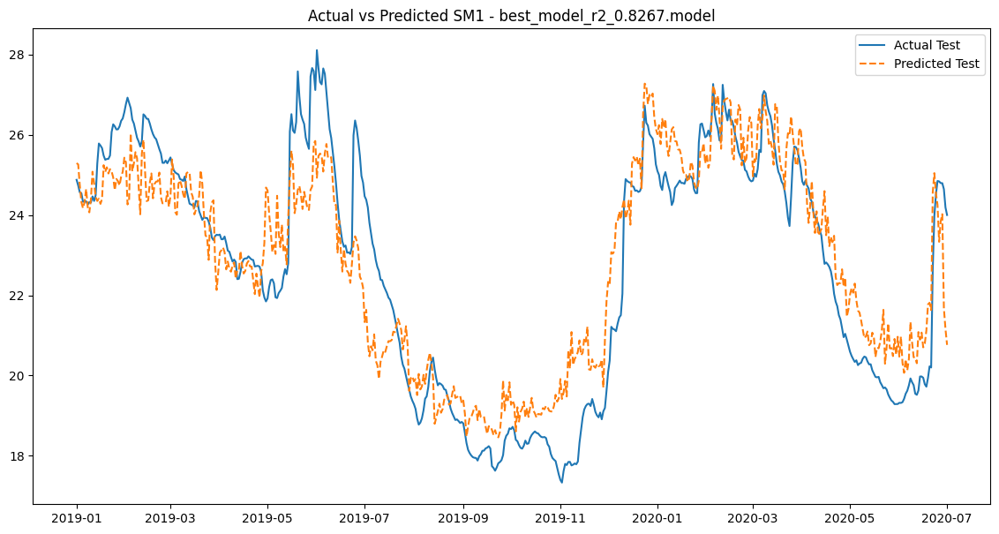

<Figure size 12000x24000 with 0 Axes>

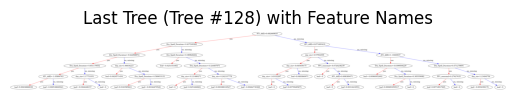

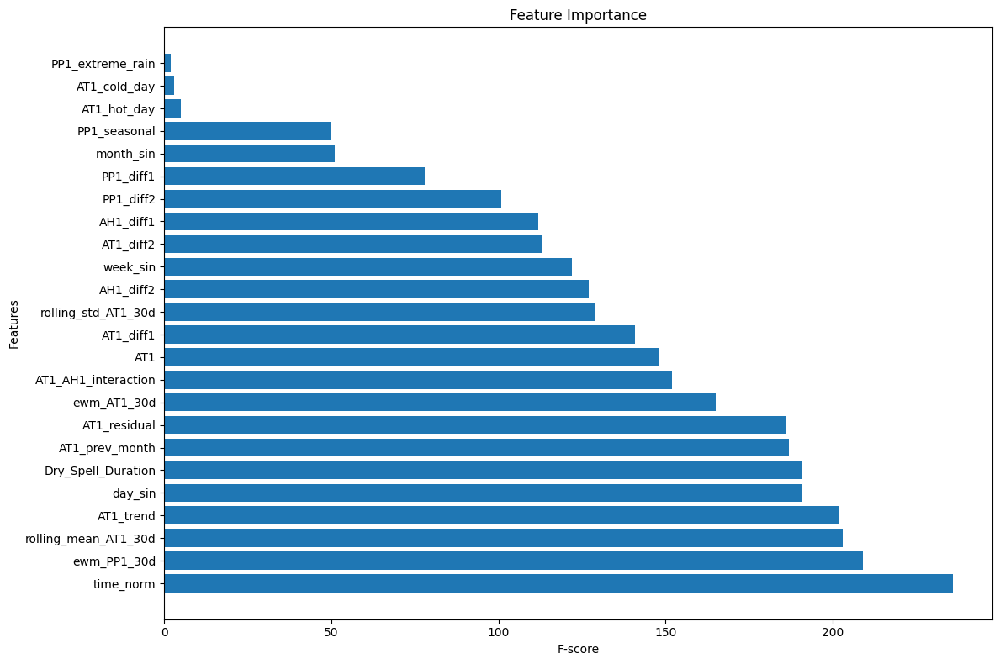

In [ ]:
# Extract feature names
feature_names = df_features.columns.tolist()
# Create a feature map file for XGBoost visualization
fmap_file = 'xgb.fmap'
with open(fmap_file, 'w') as f:
    for i, feature_name in enumerate(feature_names):
        f.write(f'{i}\t{feature_name}\tq\n')

print(f"Feature map file created: {fmap_file}")
print("Feature mapping:")
for i, name in enumerate(feature_names):
    print(f"f{i} -> {name}")

# Load and evaluate saved models
for model_file in os.listdir(model_dir):
    if model_file.endswith('.model'):
        print(f"\nLoading model: {model_file}")
        model_path = os.path.join(model_dir, model_file)
        model = xgb.Booster()
        model.load_model(model_path)
        
        # Prepare DMatrix for predictions
        dtest = xgb.DMatrix(test, label=y_test)
        
        # Make predictions
        y_test_pred = model.predict(dtest)
        
        # Evaluate performance
        r2_test = r2_score(y_test, y_test_pred)
        rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred))
        mse = mean_squared_error(y_test, y_test_pred)
        print(f"Model: {model_file}")
        print(f"Test R²: {r2_test:.4f}")
        print(f"Test RMSE: {rmse_test:.4f}")
        print(f"Test MSE: {mse:.4f}")       
        
        # Plot predictions vs actual
        plt.figure(figsize=(14, 7))
        plt.plot(y_test.index, y_test, label='Actual Test')
        plt.plot(y_test.index, y_test_pred, label='Predicted Test', linestyle='--')
        plt.legend()
        plt.title(f'Actual vs Predicted SM1 - {model_file}')
        plt.show()

        # Get the number of trees in the model
        num_trees = len(model.get_dump())
        if num_trees > 0:
            # Plot the last tree using the feature map file
            plt.figure(figsize=(40, 80), dpi=300)
            xgb.plot_tree(model, num_trees=num_trees-1, fmap=fmap_file)
            plt.title(f"Last Tree (Tree #{num_trees-1}) with Feature Names")
            plt.show()
            
            # Get feature importance
            importance = model.get_score(fmap=fmap_file, importance_type='weight')
            importance = {k: v for k, v in sorted(importance.items(), key=lambda item: item[1], reverse=True)}
            plt.figure(figsize=(12, 8))
            plt.barh(list(importance.keys()), list(importance.values()))
            plt.title('Feature Importance')
            plt.xlabel('F-score')
            plt.ylabel('Features')
            plt.tight_layout()
            plt.show()
        else:
            print("No trees found in the model")